# **1. Title and Introduction**

## **UK Road Casualty Analysis: Mid-Year 2022**

### **Introduction**

In this analysis, we dive into the UK's road casualty statistics for the mid-year of 2022, a comprehensive dataset that sheds light on the circumstances and outcomes of road accidents across the country. Our objectives are manifold: to understand the patterns and trends of road accidents, identify high-risk factors contributing to casualties, and evaluate the effectiveness of current road safety measures.

The dataset encompasses detailed records of accidents, including information on the casualties, vehicles involved, and the context of each incident. By meticulously analyzing this dataset, we aim to uncover insights that can inform policy decisions, enhance road safety strategies, and ultimately reduce the incidence and severity of road accidents in the UK.

A crucial aspect of our analysis involves creating new, focused datasets from the original comprehensive collection. This process will allow us to hone in on specific areas of interest, such as the impact of demographic factors on accident outcomes, the relationship between casualty types and severity, and patterns within different geographic locations. Through this targeted analysis, we seek to provide actionable recommendations and contribute to the ongoing efforts to improve road safety for all.*

# **2. Setup and Configuration**

This section is dedicated to preparing our analysis environment. It involves importing the necessary Python libraries that will enable us to load, process, and analyze the road casualty dataset effectively.

## **Importing necessary libraries**

In [1]:
# Core libraries for data manipulation and visualization
import pandas as pd  # Data manipulation
import numpy as np  # Numerical operations
import seaborn as sns  # Data visualization
import matplotlib.pyplot as plt  # Data visualization
import warnings  # Ignore warnings

# Configuration settings
%matplotlib inline
warnings.filterwarnings("ignore")  # Ignore warnings to keep the notebook clean
plt.style.use('ggplot')  # Optional: for nicer plots
sns.set_theme(style="whitegrid")  # Optional: for consistent plot styling


# **3. Data Loading**

In this section, we load the dataset into our Jupyter notebook for analysis. The dataset contains detailed records of road casualties in the UK for the year 2022. It is stored in a CSV file and includes various attributes such as the date of the accident, location, characteristics of the casualties, and more. Loading this data correctly is crucial for our subsequent analysis steps. We use the pandas library, which provides the `read_csv` function, making it straightforward to import CSV files into a DataFrame. After loading, we'll display the first few rows of the dataset to ensure it's loaded correctly and to give us a preliminary view of the data structure.

In [2]:
# Specify the path to the dataset file
dataset_path = 'dft-road-casualty-statistics-casualty-provisional-mid-year-unvalidated-2022.csv'

# Load the dataset into a pandas DataFrame
# pd.read_csv() is used here because our data is in CSV (Comma Separated Values) format,
# making it straightforward to load with pandas, which is a powerful library for data manipulation and analysis.
df = pd.read_csv(dataset_path)

# Display the first few rows of the DataFrame to confirm successful loading and to get an initial sense of the data structure.
# This is a good practice to quickly verify that the data appears as expected and is ready for further analysis.
df.head()

,status,accident_index,accident_year,accident_reference,vehicle_reference,casualty_reference,casualty_class,sex_of_casualty,age_of_casualty,age_band_of_casualty,casualty_severity,pedestrian_location,pedestrian_movement,car_passenger,bus_or_coach_passenger,pedestrian_road_maintenance_worker,casualty_type,casualty_home_area_type,casualty_imd_decile,lsoa_of_casualty
0,Unvalidated,2022070151244,2022,070151244,2,1,1,2,46,8,3,0,0,0,0,0,9,1,9,E01033378
1,Unvalidated,2022070152668,2022,070152668,1,1,1,1,30,6,3,0,0,0,0,0,9,1,2,E01018551
2,Unvalidated,2022070154696,2022,070154696,1,1,1,2,58,9,3,0,0,0,0,0,9,1,10,E01006134
3,Unvalidated,2022070154696,2022,070154696,2,3,1,2,78,11,3,0,0,0,0,0,9,2,10,E01018724
4,Unvalidated,2022070154696,2022,070154696,3,2,1,1,63,9,3,0,0,0,0,0,9,3,7,W01000578


In [3]:
# Display the shape of the DataFrame
print(df.shape)


(61352, 20)


## Data Dictionary

To better understand the dataset and facilitate our analysis, below is a detailed description of each column present in the dataset. This "data dictionary" serves as a reference for what each column represents, ensuring clarity throughout our analysis.

- **Status**: The status of the accident (e.g., reported, under investigation).
- **Accident_Index**: A unique identifier for each reported accident.
- **Accident_Year**: The year in which the accident occurred.
- **Accident_Reference**: A reference number associated with the accident.
- **Vehicle_Reference**: A reference number for the involved vehicle in the accident.
- **Casualty_Reference**: A reference number for the casualty involved in the accident.
- **Casualty_Class**: Indicates the class of the casualty (e.g., driver, passenger, pedestrian).
- **Sex_of_Casualty**: The gender of the casualty (male or female).
- **Age_of_Casualty**: The age of the casualty.
- **Age_Band_of_Casualty**: Age group to which the casualty belongs (e.g., 0-5, 6-10, 11-15).
- **Casualty_Severity**: The severity of the casualty's injuries (e.g., fatal, serious, slight).
- **Pedestrian_Location**: The location of the pedestrian at the time of the accident.
- **Pedestrian_Movement**: The movement of the pedestrian during the accident.
- **Car_Passenger**: Indicates whether the casualty was a car passenger at the time of the accident (yes or no).
- **Bus_or_Coach_Passenger**: Indicates whether the casualty was a bus or coach passenger (yes or no).
- **Pedestrian_Road_Maintenance_Worker**: Indicates whether the casualty was a road maintenance worker (yes or no).
- **Casualty_Type**: The type of casualty (e.g., driver/rider, passenger, pedestrian).
- **Casualty_Home_Area_Type**: The type of area in which the casualty resides (e.g., urban, rural).
- **Casualty_IMD_Decile**: The IMD decile of the area where the casualty resides (a measure of deprivation).
- **LSOA_of_Casualty**: The Lower Layer Super Output Area (LSOA) associated with the casualty's location.


## **Details :**
| Field Name                  | Code | Meaning                         |
|-----------------------------|------|---------------------------------|
| **Casualty Class**          | 1    | Driver or rider                 |
|                             | 2    | Passenger                       |
|                             | 3    | Pedestrian                      |
| **Sex of Casualty**         | 1    | Male                            |
|                             | 2    | Female                          |
|                             | 9    | Unknown (self-reported)         |
|                             | -1   | Data missing or out of range    |
| **Casualty Severity**       | 1    | Fatal                           |
|                             | 2    | Serious                         |
|                             | 3    | Slight                          |
| **Casualty Home Area Type** | 1    | Urban area                      |
|                             | 2    | Small town                      |
|                             | 3    | Rural                           |
|                             | -1   | Data missing or out of range    |
| **Age Band of Casualty**    | 1    | 0-5 years                       |
|                             | 2    | 6-10 years                       |
|                                         | 3    | 11-15 years                                   |
|                                         | 4    | 16-20 years                                   |
|                                         | 5    | 21-25 years                                   |
|                                         | 6    | 26-35 years                                   |
|                                         | 7    | 36-45 years                                   |
|                                         | 8    | 46-55 years                                   |
|                                         | 9    | 56-65 years                                   |
|                                         | 10   | 66-75 years                                   |
|                                         | 11   | Over 75 years                                 |
|                             | -1   | Data missing or out of range    |
| **Pedestrian Location** | 0    | Not a Pedestrian                                                        |
|                       | 1    | Crossing on pedestrian crossing facility                                |
|                       | 2    | Crossing in zig-zag approach lines                                      |
|                       | 3    | Crossing in zig-zag exit lines                                          |
|                       | 4    | Crossing elsewhere within 50m. of pedestrian crossing                   |
|                       | 5    | In carriageway, crossing elsewhere                                      |
|                       | 6    | On footway or verge                                                     |
|                       | 7    | On refuge, central island or central reservation                        |
|                       | 8    | In centre of carriageway - not on refuge, island or central reservation |
|                       | 9    | In carriageway, not crossing                                            |
|                       | 10   | Unknown or other                                                        |
|                       | -1   | Data missing or out of range                                            |
| **Pedestrian Movement** | 0    | Not a Pedestrian                                                        |
|                       | 1    | Crossing from driver's nearside                                         |
|                       | 2    | Crossing from nearside - masked by parked or stationary vehicle         |
|                       | 3    | Crossing from driver's offside                                          |
|                       | 4    | Crossing from offside - masked by parked or stationary vehicle          |
|                       | 5    | In carriageway, stationary - not crossing (standing or playing)         |
|                       | 6    | In carriageway, stationary - not crossing (masked by parked vehicle)    |
|                       | 7    | Walking along in carriageway, facing traffic                            |
|                       | 8    | Walking along in carriageway, back to traffic                           |
|                       | 9    | Unknown or other                                                        |
|                       | -1   | Data missing or out of range                                            |
| **Car Passenger**                       | 0    | Not a car passenger                           |
|                                         | 1    | Front seat passenger                          |
|                                         | 2    | Rear seat passenger                           |
|                                         | 9    | unknown (self reported)                           |
|                                         | -1    | Data missing or out of range                           |
| **Bus or Coach Passenger**              | 0    | Not a bus or coach passenger |
|                                         | 1    | Boarding                |
|                                         | 2    | Alighting               |
|                                         | 3    | Standing passenger      |
|                                         | 4    | Seated passenger        |
|                                         | 9    | Unknown (self reported) |
|                                         | -1   | Data missing or out of range |
| **Pedestrian Road Maintenance Worker**  | 0    | No / Not applicable     |
|                                         | 1    | Yes                     |
|                                         | 2    | Not Known               |
|                                         | 3    | Probable                |
|                                         | -1   | Data missing or out of range |
| **Casualty Type**                       | 0    | Pedestrian                                                         |
|                                         | 1    | Cyclist                                                            |
|                                         | 2    | Motorcycle 50cc and under rider or passenger                       |
|                                         | 3    | Motorcycle 125cc and under rider or passenger                      |
|                                         | 4    | Motorcycle over 125cc and up to 500cc rider or passenger           |
|                                         | 5    | Motorcycle over 500cc rider or passenger                           |
|                                         | 8    | Taxi/Private hire car occupant                                     |
|                                         | 9    | Car occupant                                                       |
|                                         | 10   | Minibus (8 - 16 passenger seats) occupant                         |
|                                         | 11   | Bus or coach occupant (17 or more pass seats)                      |
|                                         | 16   | Horse rider                                                        |
|                                         | 17   | Agricultural vehicle occupant                                      |
|                                         | 18   | Tram occupant                                                      |
|                                         | 19   | Van / Goods vehicle (3.5 tonnes mgw or under) occupant             |
|                                         | 20   | Goods vehicle (over 3.5t. and under 7.5t.) occupant                |
|                                         | 21   | Goods vehicle (7.5 tonnes mgw and over) occupant                   |
|                                         | 22   | Mobility scooter rider                                             |
|                                         | 23   | Electric motorcycle rider or passenger                             |
|                                         | 90   | Other vehicle occupant                                             |
|                                         | 97   | Motorcycle - unknown cc rider or passenger                         |
|                                         | 98   | Goods vehicle (unknown weight) occupant                            |
|                                         | 99   | Unknown vehicle type (self rep only)                               |
|                                         | 103  | Motorcycle - Scooter (1979-1998)                                   |
|                                         | 104  | Motorcycle (1979-1998)                                             |
|                                         | 105  | Motorcycle - Combination (1979-1998)                               |
|                                         | 106  | Motorcycle over 125cc (1999-2004)                                  |
|                                         | 108  | Taxi (excluding private hire cars) (1979-2004)                     |
|                                         | 109  | Car (including private hire cars) (1979-2004)                      |
|                                         | 110  | Minibus/Motor caravan (1979-1998)                                  |
|                                         | 113  | Goods over 3.5 tonnes (1979-1998)                                  |
|                                         | -1   | Data missing or out of range                                       |
| **Casualty Home Area Type**             | 1    | Urban area                                    |
|                                         | 2    | Small town                                    |
|                                         | 3    | Rural                                   |
|                                         | -1    | Data missing or out of range                                         |
| **Casualty IMD Decile** | 1    | Most deprived 10%          |
|                       | 2    | More deprived 10-20%       |
|                       | 3    | More deprived 20-30%       |
|                       | 4    | More deprived 30-40%       |
|                       | 5    | More deprived 40-50%       |
|                       | 6    | Less deprived 40-50%       |
|                       | 7    | Less deprived 30-40%       |
|                       | 8    | Less deprived 20-30%       |
|                       | 9    | Less deprived 10-20%       |
|                       | 10   | Least deprived 10%         |
|                       | -1   | Data missing or out of range |

# **4. Data Overview**


With the dataset successfully loaded into our DataFrame, we now proceed to a preliminary examination. This overview aims to familiarize ourselves with the dataset's basic properties, including the types of data it contains, the range and distribution of values, and any immediately apparent inconsistencies or missing values. Such an understanding is crucial for informing our subsequent data cleaning, preprocessing, and analysis steps.


In [4]:
# Display the DataFrame's overall information, including column names, non-null counts, and data types
print("\nDataFrame Information:")
df.info()



DataFrame Information:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 61352 entries, 0 to 61351
Data columns (total 20 columns):
 #   Column                              Non-Null Count  Dtype 
---  ------                              --------------  ----- 
 0   status                              61352 non-null  object
 1   accident_index                      61352 non-null  object
 2   accident_year                       61352 non-null  int64 
 3   accident_reference                  61352 non-null  object
 4   vehicle_reference                   61352 non-null  int64 
 5   casualty_reference                  61352 non-null  int64 
 6   casualty_class                      61352 non-null  int64 
 7   sex_of_casualty                     61352 non-null  int64 
 8   age_of_casualty                     61352 non-null  int64 
 9   age_band_of_casualty                61352 non-null  int64 
 10  casualty_severity                   61352 non-null  int64 
 11  pedestrian_location           

#### DataFrame Summary

The dataset comprises 61,352 entries, each representing a unique road accident incident, spanning across 20 columns that detail various aspects of each accident. These columns include identifiers (e.g., `accident_index`), demographic information (e.g., `age_of_casualty`, `sex_of_casualty`), details about the accident's nature (e.g., `casualty_severity`, `vehicle_reference`), and location data (e.g., `lsoa_of_casualty`). The data types are primarily integers (`int64`) for quantitative attributes and objects (`object`) for categorical or textual attributes, indicating a mix of numerical and categorical data. There are no missing values in any of the columns, suggesting a complete dataset ready for analysis.


In [5]:
# Generate descriptive statistics that summarize the central tendency, dispersion, and shape of the dataset's numerical features
print("\nDescriptive Statistics:")
display(df.describe().T)



Descriptive Statistics:


,count,mean,std,min,25%,50%,75%,max
accident_year,61352.0,2022.000000,0.000000,2022.0,2022.0,2022.0,2022.0,2022.0
vehicle_reference,61352.0,1.450368,1.109855,1.0,1.0,1.0,2.0,227.0
casualty_reference,61352.0,1.333779,0.981507,1.0,1.0,1.0,1.0,148.0
casualty_class,61352.0,1.482299,0.735614,1.0,1.0,1.0,2.0,3.0
sex_of_casualty,61352.0,1.368790,0.534536,-1.0,1.0,1.0,2.0,9.0
age_of_casualty,61352.0,36.670312,19.574357,-1.0,22.0,34.0,50.0,101.0
age_band_of_casualty,61352.0,6.288157,2.463082,-1.0,5.0,6.0,8.0,11.0
casualty_severity,61352.0,2.783039,0.442318,1.0,3.0,3.0,3.0,3.0
pedestrian_location,61352.0,0.800316,2.197167,0.0,0.0,0.0,0.0,10.0
pedestrian_movement,61352.0,0.645325,2.009611,0.0,0.0,0.0,0.0,9.0


#### Descriptive Statistics Analysis

The descriptive statistics reveal several insights into our dataset:
- **Consistent Year**: The `accident_year` column shows all incidents occurred in 2022, underscoring the dataset's focus on a single year.
- **Vehicle and Casualty References**: Both show a wide range of values, indicating multiple vehicles and casualties per accident in some cases.
- **Casualty Class and Severity**: Most casualties fall into the first class, and the majority have a severity rating of 3, suggesting non-fatal injuries are more common.
- **Age of Casualties**: Ranges from -1 (likely indicating missing data) to 101 years old, with a mean age around 37, pointing to a broad age distribution among casualties.
- **Pedestrian Data**: Most values are zero, implying a smaller proportion of incidents involving pedestrians.
- **Negative Values**: Columns like `sex_of_casualty`, `age_of_casualty`, and others contain -1, indicating potential data entry errors or placeholders for missing information.
- **Casualty Type**: Shows a diverse range, from 1 to 98, reflecting a wide variety of casualty types involved in accidents.

This summary provides a foundation for identifying data quality issues (e.g., negative values) and understanding the dataset's scope and limitations.


In [6]:
# Check for missing values across the dataset
print("\nMissing Values in the Dataset:")
display(df.isnull().sum())



Missing Values in the Dataset:


status                                0
accident_index                        0
accident_year                         0
accident_reference                    0
vehicle_reference                     0
casualty_reference                    0
casualty_class                        0
sex_of_casualty                       0
age_of_casualty                       0
age_band_of_casualty                  0
casualty_severity                     0
pedestrian_location                   0
pedestrian_movement                   0
car_passenger                         0
bus_or_coach_passenger                0
pedestrian_road_maintenance_worker    0
casualty_type                         0
casualty_home_area_type               0
casualty_imd_decile                   0
lsoa_of_casualty                      0
dtype: int64

#### Missing Values Analysis

All columns in the dataset have zero missing values, indicating a complete dataset without the need for imputation or removal of missing data. This simplifies the preprocessing phase, allowing for direct progression to further analysis.


In [176]:
# Display the number of unique values in each column of the DataFrame
df.nunique()


status                                    1
accident_index                        48283
accident_year                             1
accident_reference                    48283
vehicle_reference                        11
casualty_reference                       18
casualty_class                            3
sex_of_casualty                           4
age_of_casualty                         102
age_band_of_casualty                     12
casualty_severity                         3
pedestrian_location                      11
pedestrian_movement                      10
car_passenger                             5
bus_or_coach_passenger                    7
pedestrian_road_maintenance_worker        4
casualty_type                            22
casualty_home_area_type                   4
casualty_imd_decile                      11
lsoa_of_casualty                      23841
dtype: int64

#### Analysis of Unique Values Across Columns

The output from `df.nunique()` provides critical insights into our dataset's diversity and potential redundancy among its features. Notably:

- **Columns with a Single Unique Value**: Columns such as `status` and `accident_year` have only a single unique value. These columns do not contribute variability to our dataset and are therefore candidates for removal as they do not influence our analysis outcomes. The lack of variability suggests these features do not differentiate between records in any meaningful way for the purposes of our analysis.

- **Unique Identifiers**: Columns like `accident_index` and `accident_reference` have a high count of unique values, matching closely with the total number of records in our dataset. This observation confirms their role as unique identifiers for each accident reported. Unique identifiers are crucial for tracking individual records but are typically not used in predictive modeling due to their nature of being unique to each row.

- **Potential Categorical Variables**: Columns such as `casualty_class`, `sex_of_casualty`, `casualty_severity`, and `casualty_home_area_type` show a relatively small number of unique values, indicating these are categorical variables. Categorical variables are essential for analysis as they often represent distinct groups or classifications within the data, such as types of road users involved in accidents or the severity of their injuries.

- **Diversity in Data**: The `age_of_casualty` and `lsoa_of_casualty` columns exhibit a wide range of unique values. `age_of_casualty` reflects the diverse ages of individuals involved in accidents, while `lsoa_of_casualty` indicates a broad geographical spread of accidents across various locations. Such diversity is beneficial for detailed analysis and understanding patterns across different demographics and areas.

#### Recommendations:
- **Remove Redundant Columns**: Consider dropping columns with only a single unique value to simplify the dataset and focus on more informative features.
- **Maintain Unique Identifiers for Record Tracking**: While not useful for modeling, unique identifiers like `accident_index` and `accident_reference` are essential for data management and should be retained for record-keeping and analysis.
- **Leverage Categorical Variables**: Categorical variables should be further explored to understand their impact on accident outcomes and potentially used in predictive modeling after appropriate encoding.
- **Further Investigate Diverse Columns**: Columns with a high diversity of values warrant deeper analysis to uncover trends, patterns, and potential correlations within the dataset.

This analysis underscores the importance of a thorough initial review of the dataset's features to guide preprocessing decisions and ensure a focused, informative analysis process.


In [177]:
# Check for duplicated rows in the DataFrame
has_duplicates = df.duplicated().any()

# Display whether any duplicate rows exist
print(f"Are there any duplicated rows in the dataset? {has_duplicates}")


Are there any duplicated rows in the dataset? False


In [178]:
# Display sample values for categorical columns
for col in df.select_dtypes(include=['object']).columns:
    print(f"{col} sample values:", df[col].unique()[:5])


status sample values: ['Unvalidated']
accident_index sample values: ['2022070151244' '2022070152668' '2022070154696' '2022070155214'
 '2022070155656']
accident_reference sample values: ['070151244' '070152668' '070154696' '070155214' '070155656']
lsoa_of_casualty sample values: ['E01033378' 'E01018551' 'E01006134' 'E01018724' 'W01000578']


#### Sample Values for Categorical Columns

Exploring sample values for some of the categorical columns in our dataset offers initial insights into the nature and variety of data we're working with:

- **Status**: All records are marked as `Unvalidated`, indicating that the data might be preliminary and could require validation for accuracy in certain use cases.

- **Accident Index and Reference**: The `accident_index` and `accident_reference` columns show unique identifiers for each accident, suggesting a detailed and individualized record system. Sample values such as `2022070151244` and `070151244` respectively, highlight the structured format of these identifiers.

- **LSOA of Casualty**: The `lsoa_of_casualty` column provides geographical identifiers, such as `E01033378` and `E01018551`, pointing to the specific Lower Layer Super Output Areas where the casualties reside. This geographical granularity supports in-depth regional analysis and spatial trends exploration.

These samples underscore the dataset's comprehensive tracking of accident details, from validation status to precise location data, laying a foundation for nuanced analysis.


In [179]:
# Define a threshold for the maximum number of unique values to display
max_unique_values_to_display = 20

# Iterate through each column in the DataFrame
for column in df.columns:
    unique_values = df[column].unique()
    if len(unique_values) <= max_unique_values_to_display:
        print(f"{column} unique values ({len(unique_values)}): {unique_values}")
    else:
        # Corrected multi-line string concatenation for readability
        print(f"{column} has more than {max_unique_values_to_display} unique values. " +
              f"Displaying the first {max_unique_values_to_display}: {unique_values[:max_unique_values_to_display]}")


status unique values (1): ['Unvalidated']
accident_index has more than 20 unique values. Displaying the first 20: ['2022070151244' '2022070152668' '2022070154696' '2022070155214'
 '2022070155656' '2022070156916' '2022070163458' '2022070171945'
 '2022070172152' '2022070178065' '2022070188838' '2022070208889'
 '2022070211738' '2022070221069' '2022070222206' '2022070227136'
 '2022070227147' '2022070230394' '2022070231809' '2022070231956']
accident_year unique values (1): [2022]
accident_reference has more than 20 unique values. Displaying the first 20: ['070151244' '070152668' '070154696' '070155214' '070155656' '070156916'
 '070163458' '070171945' '070172152' '070178065' '070188838' '070208889'
 '070211738' '070221069' '070222206' '070227136' '070227147' '070230394'
 '070231809' '070231956']
vehicle_reference unique values (11): [  2   1   3   4   5   8   6   9 227   7  61]
casualty_reference unique values (18): [  1   3   2   4   5   6   7   8   9  10  11  12  14  15  13  16  22 148]
ca

#### **Checking accident_index column**

In [180]:
# Check for duplicate 'accident_index' values in the DataFrame
if df['accident_index'].duplicated().any():
    print("There are duplicated values in the 'accident_index' column.")
else:
    print("No duplicated values in the 'accident_index' column. Each accident is unique.")


There are duplicated values in the 'accident_index' column.


The presence of duplicated values in the 'accident_index' column suggests that some accident records may be listed more than once, highlighting the need for careful review. To preserve the accuracy of our analysis, we must address these duplicates by either removing them or consolidating their information into singular, comprehensive entries.


# **5. Data Cleaning and Preprocessing**

Before diving into analysis, we'll clean and preprocess our data to ensure accuracy and efficiency. This step includes handling missing values, encoding categorical variables, normalizing numerical data, and feature engineering. Our aim is to prepare a refined dataset that's ready for thorough exploration and modeling.


### **I) Importing necessary libraries**

In [181]:
from sklearn.preprocessing import LabelEncoder, MinMaxScaler, StandardScaler  # Data encoding and scaling
from sklearn.compose import ColumnTransformer  # For applying transformations to DataFrame columns

## **II) Creating new Dataframe**

In [182]:
df_copy = df.copy()

## **Remove duplicate rows**

In [183]:
# Remove duplicate rows, keeping the first occurrence
df_copy.drop_duplicates('accident_index', keep='first', inplace=True)
df_copy.shape

(48283, 20)

By removing duplicate entries based on the 'accident_index' and retaining only the first occurrence of each, we've streamlined our dataset to 48,283 unique accident records, ensuring a cleaner and more accurate basis for analysis.


## **III) Processing 'LSOA of Casualty' Column**

### **Initial Label Encoding**

In [184]:
# Initialize the LabelEncoder
le = LabelEncoder()

# Apply LabelEncoder to the 'lsoa_of_casualty' column to transform all values into numeric labels
df_copy['lsoa_of_casualty_encoded'] = le.fit_transform(df_copy['lsoa_of_casualty'])

# This encoding is an initial transformation, preparing the column for further custom processing


### **Custom Conversion of LSOA Codes**

In [185]:
# Cell Title: Custom Numeric Conversion of LSOA Codes

# Define a function to convert LSOA codes based on specific rules
def convert_lsoa_to_numeric(lsoa_code):
    if lsoa_code == "-1":  # Handle the "-1" case explicitly
        return -1
    prefix_mapping = {'W': 1, 'E': 2}  # Define mapping for prefixes
    if lsoa_code[0] in prefix_mapping:
        # Construct a numeric value from the prefix and the rest of the code
        return int(str(prefix_mapping[lsoa_code[0]]) + lsoa_code[1:])
    return None  # Handle unexpected cases

# Apply the custom conversion to the 'lsoa_of_casualty' column
df_copy['lsoa_of_casualty_numeric'] = df_copy['lsoa_of_casualty'].apply(convert_lsoa_to_numeric)

# Comment: This step customizes the numeric conversion of LSOA codes, assigning specific numbers to prefixes and concatenating them with the numeric part of the codes.


### **Calculating Frequencies of LSOA Codes**

In [186]:
# Cell Title: Frequency Calculation for LSOA Codes

# Calculate the frequency of each LSOA code in the dataset
frequencies = df_copy['lsoa_of_casualty'].value_counts()

# Map these frequencies back to the original DataFrame
df_copy['lsoa_of_casualty_freq'] = df_copy['lsoa_of_casualty'].map(frequencies)

# Comment: This step enriches the dataset with the frequency of occurrence of each LSOA code, potentially useful for analysis that considers the commonality of locations.


### **Reapplying Label Encoding Post-Conversion**

In [187]:
# Cell Title: Reapplying Label Encoding Post-Custom Conversion

# Reinitialize the LabelEncoder for consistency after custom processing
le = LabelEncoder()

# Reapply LabelEncoder to the custom-converted 'lsoa_of_casualty_numeric' column
df_copy['lsoa_of_casualty_final_encoded'] = le.fit_transform(df_copy['lsoa_of_casualty_numeric'])

# Comment: This final encoding step ensures that the custom-converted LSOA codes are in a format suitable for modeling, represented as contiguous integer labels.


### **Displaying the DataFrame**

In [188]:
# Cell Title: Display Modified DataFrame

# Display the first few rows of the DataFrame to review the changes
df_copy.head()

# Comment: This cell provides a quick look at the DataFrame after applying the various processing steps to the 'lsoa_of_casualty' column, including the initial label encoding, custom conversion to numeric values, frequency calculation, and the final label encoding.


,status,accident_index,accident_year,accident_reference,vehicle_reference,casualty_reference,casualty_class,sex_of_casualty,age_of_casualty,age_band_of_casualty,...,bus_or_coach_passenger,pedestrian_road_maintenance_worker,casualty_type,casualty_home_area_type,casualty_imd_decile,lsoa_of_casualty,lsoa_of_casualty_encoded,lsoa_of_casualty_numeric,lsoa_of_casualty_freq,lsoa_of_casualty_final_encoded
0,Unvalidated,2022070151244,2022,070151244,2,1,1,2,46,8,...,0,0,9,1,9,E01033378,21016,201033378,2,21787
1,Unvalidated,2022070152668,2022,070152668,1,1,1,1,30,6,...,0,0,9,1,2,E01018551,11938,201018551,4,12709
2,Unvalidated,2022070154696,2022,070154696,1,1,1,2,58,9,...,0,0,9,1,10,E01006134,4577,201006134,1,5348
8,Unvalidated,2022070155214,2022,070155214,2,1,1,1,74,10,...,0,0,1,3,5,E01018444,11873,201018444,3,12644
9,Unvalidated,2022070155656,2022,070155656,1,1,1,1,50,8,...,0,0,9,1,8,E01018443,11872,201018443,3,12643


## **VI) Removing some columns**

In [248]:
# List of columns to be removed
columns_to_drop = ['status', 'accident_index','accident_reference','accident_year' ,'lsoa_of_casualty']

# The 'status' column is removed because it contains only a single unique value ('Unvalidated') across all rows,
# which does not contribute any meaningful variance or information useful for analysis or predictive modeling.
# Similarly, the 'accident_year' column is removed because our dataset is focused on a specific year (2022),
# making this column redundant as it does not vary across the dataset.

# Drop specified columns from df_copy
df_copy.drop(columns=columns_to_drop, axis=1, inplace=True)
df_copy.head()

KeyError: "['status', 'accident_index', 'accident_reference', 'accident_year', 'lsoa_of_casualty'] not found in axis"

## **V) Converting -1 values to NaN**

In [250]:
# Replace -1 values with NaN across the entire DataFrame
df_copy.replace(-1, np.nan, inplace=True)


In [251]:
df_copy['sex_of_casualty'].replace(9, np.nan, inplace=True)
df_copy_with_full_column['sex_of_casualty'].replace(9, np.nan, inplace=True)

In [253]:
df_copy.head()

,vehicle_reference,casualty_reference,casualty_class,sex_of_casualty,age_of_casualty,age_band_of_casualty,casualty_severity,pedestrian_location,pedestrian_movement,car_passenger,bus_or_coach_passenger,pedestrian_road_maintenance_worker,casualty_type,casualty_home_area_type,casualty_imd_decile,lsoa_of_casualty_encoded,lsoa_of_casualty_numeric,lsoa_of_casualty_freq,lsoa_of_casualty_final_encoded
0,2,1,1,2.0,46.0,8.0,3,0,0,0.0,0.0,0.0,9.0,1.0,9.0,21016,201033378.0,2,21787
1,1,1,1,1.0,30.0,6.0,3,0,0,0.0,0.0,0.0,9.0,1.0,2.0,11938,201018551.0,4,12709
2,1,1,1,2.0,58.0,9.0,3,0,0,0.0,0.0,0.0,9.0,1.0,10.0,4577,201006134.0,1,5348
8,2,1,1,1.0,74.0,10.0,2,0,0,0.0,0.0,0.0,1.0,3.0,5.0,11873,201018444.0,3,12644
9,1,1,1,1.0,50.0,8.0,3,0,0,0.0,0.0,0.0,9.0,1.0,8.0,11872,201018443.0,3,12643


# **6. Creating New Datasets**

## **Apply Mapping Function**

In [254]:
def apply_mappings(dataframe):  

    dataframe_ = dataframe.copy()
    # Mapping for 'Casualty Class'
    casualty_class_mapping = {1: 'Driver or rider', 2: 'Passenger', 3: 'Pedestrian'}
    
    # Mapping for 'Sex of Casualty'
    sex_of_casualty_mapping = {1: 'Male', 2: 'Female', 9: 'Unknown', -1: 'Data missing or out of range'}
    
    # Mapping for 'Casualty Severity'
    casualty_severity_mapping = {1: 'Fatal', 2: 'Serious', 3: 'Slight'}
    
    # Mapping for 'Casualty Home Area Type'
    casualty_home_area_type_mapping = {1: 'Urban area', 2: 'Small town', 3: 'Rural', -1: 'Data missing or out of range'}
    
    # Mapping for 'Age Band of Casualty'
    age_band_of_casualty_mapping = {
        1: ' a 0-5 years', 2: 'b 6-10 years', 3: 'c 11-15 years', 4: 'd 16-20 years', 
        5: 'e 21-25 years', 6: 'f 26-35 years', 7: 'g 36-45 years', 8: 'h 46-55 years', 
        9: 'i 56-65 years', 10: 'j 66-75 years', 11: 'k Over 75 years', -1: 'l Data missing or out of range'
    }
    
    # Mapping for 'Pedestrian Location'
    pedestrian_location_mapping = {
        0: 'Not a Pedestrian', 1: 'Crossing on pedestrian crossing facility', 2: 'Crossing in zig-zag approach lines',
        3: 'Crossing in zig-zag exit lines', 4: 'Crossing elsewhere within 50m. of pedestrian crossing',
        5: 'In carriageway, crossing elsewhere', 6: 'On footway or verge', 7: 'On refuge, central island or central reservation',
        8: 'In centre of carriageway - not on refuge, island or central reservation', 9: 'In carriageway, not crossing',
        10: 'Unknown or other', -1: 'Data missing or out of range'
    }
    
    # Mapping for 'Pedestrian Movement'
    pedestrian_movement_mapping = {
        0: 'Not a Pedestrian',
        1: 'Crossing from driver\'s nearside',
        2: 'Crossing from nearside - masked by parked or stationary vehicle',
        3: 'Crossing from driver\'s offside',
        4: 'Crossing from offside - masked by parked or stationary vehicle',
        5: 'In carriageway, stationary - not crossing (standing or playing)',
        6: 'In carriageway, stationary - not crossing (masked by parked vehicle)',
        7: 'Walking along in carriageway, facing traffic',
        8: 'Walking along in carriageway, back to traffic',
        9: 'Unknown or other',
        -1: 'Data missing or out of range'
    }
    
    # Mapping for 'Car Passenger'
    car_passenger_mapping = {
        0: 'Not a car passenger',
        1: 'Front seat passenger',
        2: 'Rear seat passenger',
        9: 'Unknown (self reported)',
        -1: 'Data missing or out of range'
    }
    
    # Mapping for 'Bus or Coach Passenger'
    bus_or_coach_passenger_mapping = {
        0: 'Not a bus or coach passenger',
        1: 'Boarding',
        2: 'Alighting',
        3: 'Standing passenger',
        4: 'Seated passenger',
        9: 'Unknown (self reported)',
        -1: 'Data missing or out of range'
    }
    
    # Mapping for 'Pedestrian Road Maintenance Worker'
    pedestrian_road_maintenance_worker_mapping = {
        0: 'No / Not applicable',
        1: 'Yes',
        2: 'Not Known',
        3: 'Probable',
        -1: 'Data missing or out of range'
    }
    
    casualty_type_mapping = {
        0: 'Pedestrian',
        1: 'Cyclist',
        2: 'Motorcycle 50cc and under rider or passenger',
        3: 'Motorcycle 125cc and under rider or passenger',
        4: 'Motorcycle over 125cc and up to 500cc rider or passenger',
        5: 'Motorcycle over 500cc rider or passenger',
        8: 'Taxi/Private hire car occupant',
        9: 'Car occupant',
        10: 'Minibus (8 - 16 passenger seats) occupant',
        11: 'Bus or coach occupant (17 or more pass seats)',
        16: 'Horse rider',
        17: 'Agricultural vehicle occupant',
        18: 'Tram occupant',
        19: 'Van / Goods vehicle (3.5 tonnes mgw or under) occupant',
        20: 'Goods vehicle (over 3.5t. and under 7.5t.) occupant',
        21: 'Goods vehicle (7.5 tonnes mgw and over) occupant',
        22: 'Mobility scooter rider',
        23: 'Electric motorcycle rider or passenger',
        90: 'Other vehicle occupant',
        97: 'Motorcycle - unknown cc rider or passenger',
        98: 'Goods vehicle (unknown weight) occupant',
        99: 'Unknown vehicle type (self rep only)',
        103: 'Motorcycle - Scooter (1979-1998)',
        104: 'Motorcycle (1979-1998)',
        105: 'Motorcycle - Combination (1979-1998)',
        106: 'Motorcycle over 125cc (1999-2004)',
        108: 'Taxi (excluding private hire cars) (1979-2004)',
        109: 'Car (including private hire cars) (1979-2004)',
        110: 'Minibus/Motor caravan (1979-1998)',
        113: 'Goods over 3.5 tonnes (1979-1998)',
        -1: 'Data missing or out of range'
    }
    
    casualty_home_area_type_mapping = {
        1: 'Urban area',
        2: 'Small town',
        3: 'Rural',
        -1: 'Data missing or out of range'
    }
    
    
    
    
    dataframe_['casualty_class'] = dataframe_['casualty_class'].replace(casualty_class_mapping)
    dataframe_['sex_of_casualty'] = dataframe_['sex_of_casualty'].replace(sex_of_casualty_mapping)
    dataframe_['casualty_severity'] = dataframe_['casualty_severity'].replace(casualty_severity_mapping)
    dataframe_['casualty_home_area_type'] = dataframe_['casualty_home_area_type'].replace(casualty_home_area_type_mapping)
    dataframe_['pedestrian_location'] = dataframe_['pedestrian_location'].replace(pedestrian_location_mapping)
    dataframe_['age_band_of_casualty'] = dataframe_['age_band_of_casualty'].replace(age_band_of_casualty_mapping)
    dataframe_['pedestrian_movement'] = dataframe_['pedestrian_movement'].replace(pedestrian_movement_mapping)
    dataframe_['car_passenger'] = dataframe_['car_passenger'].replace(car_passenger_mapping)
    dataframe_['bus_or_coach_passenger'] = dataframe_['bus_or_coach_passenger'].replace(bus_or_coach_passenger_mapping)
    dataframe_['pedestrian_road_maintenance_worker'] = dataframe_['pedestrian_road_maintenance_worker'].replace(pedestrian_road_maintenance_worker_mapping)
    dataframe_['casualty_type'] = dataframe_['casualty_type'].replace(casualty_type_mapping)
    dataframe_['casualty_home_area_type'] = dataframe_['casualty_home_area_type'].replace(casualty_home_area_type_mapping)

    return dataframe_

## **Fatal & Serious Function**

In [255]:
def fatal_serious(dataframe):
    dataframe_ = dataframe.copy()
    # Filter the dataframe for fatal (1) and serious (2) casualties based on numeric codes
    dataframe_fatal_serious = dataframe_[dataframe_['casualty_severity'].isin([1, 2])]
    
    # Apply mappings to the filtered dataframe to create a labeled version
    dataframe_fatal_serious_labeled = apply_mappings(dataframe_fatal_serious.copy())
    
    # Print shapes for verification
    print("Original (numeric codes) shape:", dataframe_fatal_serious.shape)
    print("Labeled version shape:", dataframe_fatal_serious_labeled.shape)
    
    # It seems you intended to return dataframe_fatal_serious and dataframe_fatal_serious_labeled
    # Instead of df_fatal_serious (which seems undefined in this context) and dataframe_fatal_serious_lebeled
    return dataframe_fatal_serious, dataframe_fatal_serious_labeled


In [256]:
def fatal(dataframe):
    dataframe_ = dataframe.copy()
    # Filter the dataframe for only fatal casualties, indicated by the code '1'
    dataframe_fatal = dataframe_[dataframe_['casualty_severity'] == 1]
    
    # Assuming 'apply_mappings' function is correctly defined to handle the mapping from numeric codes to labels
    dataframe_fatal_labeled = apply_mappings(dataframe_fatal)

    print("Original (numeric codes) shape:", dataframe_fatal.shape)
    print("Labeled version shape:", dataframe_fatal_labeled.shape)
    
    return dataframe_fatal, dataframe_fatal_labeled


## **Labeled Dataframe**

In [257]:
df_labeled = apply_mappings(df_copy)
df_labeled.head()

,vehicle_reference,casualty_reference,casualty_class,sex_of_casualty,age_of_casualty,age_band_of_casualty,casualty_severity,pedestrian_location,pedestrian_movement,car_passenger,bus_or_coach_passenger,pedestrian_road_maintenance_worker,casualty_type,casualty_home_area_type,casualty_imd_decile,lsoa_of_casualty_encoded,lsoa_of_casualty_numeric,lsoa_of_casualty_freq,lsoa_of_casualty_final_encoded
0,2,1,Driver or rider,Female,46.0,h 46-55 years,Slight,Not a Pedestrian,Not a Pedestrian,Not a car passenger,Not a bus or coach passenger,No / Not applicable,Car occupant,Urban area,9.0,21016,201033378.0,2,21787
1,1,1,Driver or rider,Male,30.0,f 26-35 years,Slight,Not a Pedestrian,Not a Pedestrian,Not a car passenger,Not a bus or coach passenger,No / Not applicable,Car occupant,Urban area,2.0,11938,201018551.0,4,12709
2,1,1,Driver or rider,Female,58.0,i 56-65 years,Slight,Not a Pedestrian,Not a Pedestrian,Not a car passenger,Not a bus or coach passenger,No / Not applicable,Car occupant,Urban area,10.0,4577,201006134.0,1,5348
8,2,1,Driver or rider,Male,74.0,j 66-75 years,Serious,Not a Pedestrian,Not a Pedestrian,Not a car passenger,Not a bus or coach passenger,No / Not applicable,Cyclist,Rural,5.0,11873,201018444.0,3,12644
9,1,1,Driver or rider,Male,50.0,h 46-55 years,Slight,Not a Pedestrian,Not a Pedestrian,Not a car passenger,Not a bus or coach passenger,No / Not applicable,Car occupant,Urban area,8.0,11872,201018443.0,3,12643


## **Pedestrian Dataframe**

In [258]:
# Creating a DataFrame that contains only pedestrian casualties
df_pedestrians = df_copy[df_copy['casualty_class'] == 3]

# Display the first few rows of the pedestrian-only DataFrame
print(df_pedestrians.shape)
df_pedestrians.head()

(8422, 19)


,vehicle_reference,casualty_reference,casualty_class,sex_of_casualty,age_of_casualty,age_band_of_casualty,casualty_severity,pedestrian_location,pedestrian_movement,car_passenger,bus_or_coach_passenger,pedestrian_road_maintenance_worker,casualty_type,casualty_home_area_type,casualty_imd_decile,lsoa_of_casualty_encoded,lsoa_of_casualty_numeric,lsoa_of_casualty_freq,lsoa_of_casualty_final_encoded
11,1,1,3,1.0,79.0,11.0,3,5,2,0.0,0.0,0.0,0.0,1.0,10.0,8276,201012452.0,1,9047
28,1,1,3,1.0,24.0,5.0,3,10,9,0.0,0.0,0.0,0.0,NaN,NaN,0,NaN,5902,0
35,1,1,3,1.0,14.0,3.0,3,9,8,0.0,0.0,0.0,0.0,1.0,5.0,5371,201007459.0,4,6142
47,1,1,3,2.0,5.0,1.0,3,5,3,0.0,0.0,0.0,0.0,1.0,1.0,8608,201012895.0,2,9379
48,1,1,3,1.0,42.0,7.0,3,9,9,0.0,0.0,0.0,0.0,1.0,1.0,8814,201013196.0,3,9585


In [259]:
df_pedestrians_labeled = apply_mappings(df_pedestrians)
print(df_pedestrians_labeled.shape)
df_pedestrians_labeled.head()

(8422, 19)


,vehicle_reference,casualty_reference,casualty_class,sex_of_casualty,age_of_casualty,age_band_of_casualty,casualty_severity,pedestrian_location,pedestrian_movement,car_passenger,bus_or_coach_passenger,pedestrian_road_maintenance_worker,casualty_type,casualty_home_area_type,casualty_imd_decile,lsoa_of_casualty_encoded,lsoa_of_casualty_numeric,lsoa_of_casualty_freq,lsoa_of_casualty_final_encoded
11,1,1,Pedestrian,Male,79.0,k Over 75 years,Slight,"In carriageway, crossing elsewhere",Crossing from nearside - masked by parked or s...,Not a car passenger,Not a bus or coach passenger,No / Not applicable,Pedestrian,Urban area,10.0,8276,201012452.0,1,9047
28,1,1,Pedestrian,Male,24.0,e 21-25 years,Slight,Unknown or other,Unknown or other,Not a car passenger,Not a bus or coach passenger,No / Not applicable,Pedestrian,NaN,NaN,0,NaN,5902,0
35,1,1,Pedestrian,Male,14.0,c 11-15 years,Slight,"In carriageway, not crossing","Walking along in carriageway, back to traffic",Not a car passenger,Not a bus or coach passenger,No / Not applicable,Pedestrian,Urban area,5.0,5371,201007459.0,4,6142
47,1,1,Pedestrian,Female,5.0,a 0-5 years,Slight,"In carriageway, crossing elsewhere",Crossing from driver's offside,Not a car passenger,Not a bus or coach passenger,No / Not applicable,Pedestrian,Urban area,1.0,8608,201012895.0,2,9379
48,1,1,Pedestrian,Male,42.0,g 36-45 years,Slight,"In carriageway, not crossing",Unknown or other,Not a car passenger,Not a bus or coach passenger,No / Not applicable,Pedestrian,Urban area,1.0,8814,201013196.0,3,9585


### **Fatal & Serious**

In [260]:
# Assuming df_pedestrians is your DataFrame filtered for pedestrians
# And fatal_serious is defined as in the previous correction

df_pedestrians_FS, df_pedestrians_FS_labeled = fatal_serious(df_pedestrians)


Original (numeric codes) shape: (2570, 19)
Labeled version shape: (2570, 19)


### **Fatal**

In [261]:
# Assuming df_pedestrians is your DataFrame filtered for pedestrians
# And fatal is defined as in the previous correction

df_pedestrians_fatal, df_pedestrians_fatal_labeled = fatal(df_pedestrians)


Original (numeric codes) shape: (170, 19)
Labeled version shape: (170, 19)


## **Car driver Dataframe**

In [262]:
# Creating a DataFrame for driver casualties based on 'casualty_class' and 'casualty_type' columns
df_drivers = df_copy[(df_copy['casualty_class'] == 1) & (df_copy['casualty_type'] == 9)]

# Display the shape and the first few rows of the driver-only DataFrame
print(df_drivers.shape)
df_drivers.head()


(18825, 19)


,vehicle_reference,casualty_reference,casualty_class,sex_of_casualty,age_of_casualty,age_band_of_casualty,casualty_severity,pedestrian_location,pedestrian_movement,car_passenger,bus_or_coach_passenger,pedestrian_road_maintenance_worker,casualty_type,casualty_home_area_type,casualty_imd_decile,lsoa_of_casualty_encoded,lsoa_of_casualty_numeric,lsoa_of_casualty_freq,lsoa_of_casualty_final_encoded
0,2,1,1,2.0,46.0,8.0,3,0,0,0.0,0.0,0.0,9.0,1.0,9.0,21016,201033378.0,2,21787
1,1,1,1,1.0,30.0,6.0,3,0,0,0.0,0.0,0.0,9.0,1.0,2.0,11938,201018551.0,4,12709
2,1,1,1,2.0,58.0,9.0,3,0,0,0.0,0.0,0.0,9.0,1.0,10.0,4577,201006134.0,1,5348
9,1,1,1,1.0,50.0,8.0,3,0,0,0.0,0.0,0.0,9.0,1.0,8.0,11872,201018443.0,3,12643
14,1,1,1,1.0,50.0,8.0,2,0,0,0.0,0.0,0.0,9.0,1.0,3.0,8277,201012454.0,2,9048


In [263]:
df_drivers_labeled = apply_mappings(df_drivers)
df_drivers_labeled.head()

,vehicle_reference,casualty_reference,casualty_class,sex_of_casualty,age_of_casualty,age_band_of_casualty,casualty_severity,pedestrian_location,pedestrian_movement,car_passenger,bus_or_coach_passenger,pedestrian_road_maintenance_worker,casualty_type,casualty_home_area_type,casualty_imd_decile,lsoa_of_casualty_encoded,lsoa_of_casualty_numeric,lsoa_of_casualty_freq,lsoa_of_casualty_final_encoded
0,2,1,Driver or rider,Female,46.0,h 46-55 years,Slight,Not a Pedestrian,Not a Pedestrian,Not a car passenger,Not a bus or coach passenger,No / Not applicable,Car occupant,Urban area,9.0,21016,201033378.0,2,21787
1,1,1,Driver or rider,Male,30.0,f 26-35 years,Slight,Not a Pedestrian,Not a Pedestrian,Not a car passenger,Not a bus or coach passenger,No / Not applicable,Car occupant,Urban area,2.0,11938,201018551.0,4,12709
2,1,1,Driver or rider,Female,58.0,i 56-65 years,Slight,Not a Pedestrian,Not a Pedestrian,Not a car passenger,Not a bus or coach passenger,No / Not applicable,Car occupant,Urban area,10.0,4577,201006134.0,1,5348
9,1,1,Driver or rider,Male,50.0,h 46-55 years,Slight,Not a Pedestrian,Not a Pedestrian,Not a car passenger,Not a bus or coach passenger,No / Not applicable,Car occupant,Urban area,8.0,11872,201018443.0,3,12643
14,1,1,Driver or rider,Male,50.0,h 46-55 years,Serious,Not a Pedestrian,Not a Pedestrian,Not a car passenger,Not a bus or coach passenger,No / Not applicable,Car occupant,Urban area,3.0,8277,201012454.0,2,9048


### **Fatal & Serious**

In [264]:
# Assuming df_drivers is your DataFrame filtered for drivers
# And fatal_serious is defined as in the previous correction

df_drivers_FS, df_drivers_FS_labeled = fatal_serious(df_drivers)


Original (numeric codes) shape: (2563, 19)
Labeled version shape: (2563, 19)


### **Fatal**

In [265]:
# Assuming df_drivers is your DataFrame filtered for drivers
# And fatal is defined as in the previous correction

df_drivers_fatal, df_drivers_fatal_labeled = fatal(df_drivers)


Original (numeric codes) shape: (219, 19)
Labeled version shape: (219, 19)


## **Motorcycle Dataframe**

In [266]:
# Creating a DataFrame for motorcycle casualties based on the 'casualty_type' column
# This includes specific codes related to motorcycles and their riders or passengers
df_motorcycle = df_copy[df_copy['casualty_type'].isin([ 2, 3, 4, 5, 97])]

# Display the first few rows of the motorcycle-only DataFrame
print(df_motorcycle.shape)
df_motorcycle.head()

(7168, 19)


,vehicle_reference,casualty_reference,casualty_class,sex_of_casualty,age_of_casualty,age_band_of_casualty,casualty_severity,pedestrian_location,pedestrian_movement,car_passenger,bus_or_coach_passenger,pedestrian_road_maintenance_worker,casualty_type,casualty_home_area_type,casualty_imd_decile,lsoa_of_casualty_encoded,lsoa_of_casualty_numeric,lsoa_of_casualty_freq,lsoa_of_casualty_final_encoded
27,1,1,1,1.0,20.0,4.0,3,0,0,0.0,0.0,0.0,2.0,1.0,10.0,11861,201018419.0,1,12632
51,1,1,1,1.0,18.0,4.0,2,0,0,0.0,0.0,0.0,2.0,1.0,6.0,8921,201013334.0,1,9692
65,1,1,1,NaN,NaN,NaN,3,0,0,0.0,0.0,0.0,3.0,NaN,NaN,0,NaN,5902,0
81,1,1,1,1.0,38.0,7.0,3,0,0,0.0,0.0,0.0,5.0,1.0,1.0,17874,201027874.0,1,18645
97,1,1,1,1.0,25.0,5.0,3,0,0,0.0,0.0,0.0,2.0,1.0,9.0,17858,201027844.0,1,18629


In [267]:
# Creating a DataFrame for motorcycle casualties based on the 'casualty_type' column
# This includes specific codes related to motorcycles and their riders or passengers
df_motorcycle_labeled = apply_mappings(df_motorcycle)
df_motorcycle_labeled.head()


,vehicle_reference,casualty_reference,casualty_class,sex_of_casualty,age_of_casualty,age_band_of_casualty,casualty_severity,pedestrian_location,pedestrian_movement,car_passenger,bus_or_coach_passenger,pedestrian_road_maintenance_worker,casualty_type,casualty_home_area_type,casualty_imd_decile,lsoa_of_casualty_encoded,lsoa_of_casualty_numeric,lsoa_of_casualty_freq,lsoa_of_casualty_final_encoded
27,1,1,Driver or rider,Male,20.0,d 16-20 years,Slight,Not a Pedestrian,Not a Pedestrian,Not a car passenger,Not a bus or coach passenger,No / Not applicable,Motorcycle 50cc and under rider or passenger,Urban area,10.0,11861,201018419.0,1,12632
51,1,1,Driver or rider,Male,18.0,d 16-20 years,Serious,Not a Pedestrian,Not a Pedestrian,Not a car passenger,Not a bus or coach passenger,No / Not applicable,Motorcycle 50cc and under rider or passenger,Urban area,6.0,8921,201013334.0,1,9692
65,1,1,Driver or rider,NaN,NaN,NaN,Slight,Not a Pedestrian,Not a Pedestrian,Not a car passenger,Not a bus or coach passenger,No / Not applicable,Motorcycle 125cc and under rider or passenger,NaN,NaN,0,NaN,5902,0
81,1,1,Driver or rider,Male,38.0,g 36-45 years,Slight,Not a Pedestrian,Not a Pedestrian,Not a car passenger,Not a bus or coach passenger,No / Not applicable,Motorcycle over 500cc rider or passenger,Urban area,1.0,17874,201027874.0,1,18645
97,1,1,Driver or rider,Male,25.0,e 21-25 years,Slight,Not a Pedestrian,Not a Pedestrian,Not a car passenger,Not a bus or coach passenger,No / Not applicable,Motorcycle 50cc and under rider or passenger,Urban area,9.0,17858,201027844.0,1,18629


### **Fatal & Serious**

In [268]:
# Assuming df_motorcycle is your DataFrame filtered for motorcycle
# And fatal_serious is defined as in the previous correction

df_motorcycle_FS, df_motorcycle_FS_labeled = fatal_serious(df_motorcycle)


Original (numeric codes) shape: (2330, 19)
Labeled version shape: (2330, 19)


### **Fatal**

In [269]:
# Assuming df_drivers is your DataFrame filtered for motorcycle
# And fatal is defined as in the previous correction

df_motorcycle_fatal, df_motorcycle_fatal_labeled = fatal(df_motorcycle)


Original (numeric codes) shape: (140, 19)
Labeled version shape: (140, 19)


## **Cyclist Dataframe**

In [270]:
# Creating a DataFrame for cyclist casualties based on the 'casualty_type' column
df_cyclist = df_copy[df_copy['casualty_type'] == 1]

# Display the first few rows of the cyclist-only DataFrame
print(df_cyclist.shape)
df_cyclist.head()


(7005, 19)


,vehicle_reference,casualty_reference,casualty_class,sex_of_casualty,age_of_casualty,age_band_of_casualty,casualty_severity,pedestrian_location,pedestrian_movement,car_passenger,bus_or_coach_passenger,pedestrian_road_maintenance_worker,casualty_type,casualty_home_area_type,casualty_imd_decile,lsoa_of_casualty_encoded,lsoa_of_casualty_numeric,lsoa_of_casualty_freq,lsoa_of_casualty_final_encoded
8,2,1,1,1.0,74.0,10.0,2,0,0,0.0,0.0,0.0,1.0,3.0,5.0,11873,201018444.0,3,12644
10,2,1,1,1.0,46.0,8.0,2,0,0,0.0,0.0,0.0,1.0,1.0,3.0,11902,201018482.0,3,12673
12,1,1,1,1.0,13.0,3.0,3,0,0,0.0,0.0,0.0,1.0,1.0,8.0,8303,201012499.0,1,9074
16,2,1,1,1.0,45.0,7.0,3,0,0,0.0,0.0,0.0,1.0,1.0,4.0,11849,201018402.0,1,12620
22,2,1,1,1.0,30.0,6.0,2,0,0,0.0,0.0,0.0,1.0,1.0,8.0,11872,201018443.0,3,12643


In [271]:
# Creating a DataFrame for cyclist casualties based on the 'casualty_type' column
df_cyclist_labeled = apply_mappings(df_cyclist)
# Display the first few rows of the cyclist-only DataFrame
df_cyclist_labeled.head()


,vehicle_reference,casualty_reference,casualty_class,sex_of_casualty,age_of_casualty,age_band_of_casualty,casualty_severity,pedestrian_location,pedestrian_movement,car_passenger,bus_or_coach_passenger,pedestrian_road_maintenance_worker,casualty_type,casualty_home_area_type,casualty_imd_decile,lsoa_of_casualty_encoded,lsoa_of_casualty_numeric,lsoa_of_casualty_freq,lsoa_of_casualty_final_encoded
8,2,1,Driver or rider,Male,74.0,j 66-75 years,Serious,Not a Pedestrian,Not a Pedestrian,Not a car passenger,Not a bus or coach passenger,No / Not applicable,Cyclist,Rural,5.0,11873,201018444.0,3,12644
10,2,1,Driver or rider,Male,46.0,h 46-55 years,Serious,Not a Pedestrian,Not a Pedestrian,Not a car passenger,Not a bus or coach passenger,No / Not applicable,Cyclist,Urban area,3.0,11902,201018482.0,3,12673
12,1,1,Driver or rider,Male,13.0,c 11-15 years,Slight,Not a Pedestrian,Not a Pedestrian,Not a car passenger,Not a bus or coach passenger,No / Not applicable,Cyclist,Urban area,8.0,8303,201012499.0,1,9074
16,2,1,Driver or rider,Male,45.0,g 36-45 years,Slight,Not a Pedestrian,Not a Pedestrian,Not a car passenger,Not a bus or coach passenger,No / Not applicable,Cyclist,Urban area,4.0,11849,201018402.0,1,12620
22,2,1,Driver or rider,Male,30.0,f 26-35 years,Serious,Not a Pedestrian,Not a Pedestrian,Not a car passenger,Not a bus or coach passenger,No / Not applicable,Cyclist,Urban area,8.0,11872,201018443.0,3,12643


### **Fatal & Serious**

In [272]:
# Assuming df_cyclist is your DataFrame filtered for cyclist
# And fatal_serious is defined as in the previous correction

df_cyclist_FS, df_cyclist_FS_labeled = fatal_serious(df_cyclist)


Original (numeric codes) shape: (1709, 19)
Labeled version shape: (1709, 19)


### **Fatal**

In [273]:
# Assuming df_drivers is your DataFrame filtered for cyclist
# And fatal is defined as in the previous correction

df_cyclist_fatal, df_cyclist_fatal_labeled = fatal(df_cyclist)


Original (numeric codes) shape: (36, 19)
Labeled version shape: (36, 19)


## **Passenger Dataframe**

In [274]:
# Creating a DataFrame for passenger casualties based on the 'casualty_class' column
df_passenger = df_copy[df_copy['casualty_class'] == 2 ]

# Display the first few rows of the passenger-only DataFrame
print(df_passenger.shape)
df_passenger.head()

(4307, 19)


,vehicle_reference,casualty_reference,casualty_class,sex_of_casualty,age_of_casualty,age_band_of_casualty,casualty_severity,pedestrian_location,pedestrian_movement,car_passenger,bus_or_coach_passenger,pedestrian_road_maintenance_worker,casualty_type,casualty_home_area_type,casualty_imd_decile,lsoa_of_casualty_encoded,lsoa_of_casualty_numeric,lsoa_of_casualty_freq,lsoa_of_casualty_final_encoded
13,1,1,2,2.0,48.0,8.0,3,0,0,1.0,0.0,0.0,9.0,1.0,4.0,11802,201018329.0,1,12573
34,3,1,2,2.0,16.0,4.0,2,0,0,NaN,0.0,0.0,9.0,1.0,1.0,5675,201008008.0,2,6446
37,1,1,2,1.0,19.0,4.0,3,0,0,1.0,0.0,0.0,9.0,1.0,1.0,5493,201007645.0,3,6264
43,1,1,2,2.0,84.0,11.0,3,0,0,1.0,0.0,0.0,9.0,3.0,6.0,8633,201012933.0,1,9404
54,1,1,2,2.0,21.0,5.0,3,0,0,1.0,0.0,0.0,9.0,1.0,6.0,8659,201012979.0,1,9430


In [275]:
# Creating a DataFrame for passenger casualties based on the 'casualty_class' column
df_passenger_labeled = apply_mappings(df_passenger)

# Display the first few rows of the passenger-only DataFrame
df_passenger_labeled.head()


,vehicle_reference,casualty_reference,casualty_class,sex_of_casualty,age_of_casualty,age_band_of_casualty,casualty_severity,pedestrian_location,pedestrian_movement,car_passenger,bus_or_coach_passenger,pedestrian_road_maintenance_worker,casualty_type,casualty_home_area_type,casualty_imd_decile,lsoa_of_casualty_encoded,lsoa_of_casualty_numeric,lsoa_of_casualty_freq,lsoa_of_casualty_final_encoded
13,1,1,Passenger,Female,48.0,h 46-55 years,Slight,Not a Pedestrian,Not a Pedestrian,Front seat passenger,Not a bus or coach passenger,No / Not applicable,Car occupant,Urban area,4.0,11802,201018329.0,1,12573
34,3,1,Passenger,Female,16.0,d 16-20 years,Serious,Not a Pedestrian,Not a Pedestrian,NaN,Not a bus or coach passenger,No / Not applicable,Car occupant,Urban area,1.0,5675,201008008.0,2,6446
37,1,1,Passenger,Male,19.0,d 16-20 years,Slight,Not a Pedestrian,Not a Pedestrian,Front seat passenger,Not a bus or coach passenger,No / Not applicable,Car occupant,Urban area,1.0,5493,201007645.0,3,6264
43,1,1,Passenger,Female,84.0,k Over 75 years,Slight,Not a Pedestrian,Not a Pedestrian,Front seat passenger,Not a bus or coach passenger,No / Not applicable,Car occupant,Rural,6.0,8633,201012933.0,1,9404
54,1,1,Passenger,Female,21.0,e 21-25 years,Slight,Not a Pedestrian,Not a Pedestrian,Front seat passenger,Not a bus or coach passenger,No / Not applicable,Car occupant,Urban area,6.0,8659,201012979.0,1,9430


### **Fatal & Serious**

In [276]:
# Assuming df_passenger is your DataFrame filtered for passenger
# And fatal_serious is defined as in the previous correction

df_passenger_FS, df_passenger_FS_labeled = fatal_serious(df_passenger)


Original (numeric codes) shape: (716, 19)
Labeled version shape: (716, 19)


### **Fatal**

In [277]:
# Assuming df_drivers is your DataFrame filtered for passenger
# And fatal is defined as in the previous correction

df_passenger_fatal, df_passenger_fatal_labeled = fatal(df_passenger)


Original (numeric codes) shape: (35, 19)
Labeled version shape: (35, 19)


## **Rural Dataframe**

In [278]:
# Assuming df_copy is your original DataFrame and it includes the 'casualty_home_area_type' column
# with '3' representing casualties from Rural areas

# Creating a DataFrame for casualties from rural areas based on the 'casualty_home_area_type' column
df_rural = df_copy[df_copy['casualty_home_area_type'] == 3]

# Display the shape and the first few rows of the DataFrame for rural area casualties
print(df_rural.shape)
df_rural.head()


(4409, 19)


,vehicle_reference,casualty_reference,casualty_class,sex_of_casualty,age_of_casualty,age_band_of_casualty,casualty_severity,pedestrian_location,pedestrian_movement,car_passenger,bus_or_coach_passenger,pedestrian_road_maintenance_worker,casualty_type,casualty_home_area_type,casualty_imd_decile,lsoa_of_casualty_encoded,lsoa_of_casualty_numeric,lsoa_of_casualty_freq,lsoa_of_casualty_final_encoded
8,2,1,1,1.0,74.0,10.0,2,0,0,0.0,0.0,0.0,1.0,3.0,5.0,11873,201018444.0,3,12644
29,1,1,1,1.0,18.0,4.0,3,0,0,0.0,0.0,0.0,9.0,3.0,5.0,11791,201018308.0,1,12562
43,1,1,2,2.0,84.0,11.0,3,0,0,1.0,0.0,0.0,9.0,3.0,6.0,8633,201012933.0,1,9404
73,1,1,1,2.0,36.0,7.0,3,0,0,0.0,0.0,0.0,9.0,3.0,5.0,8873,201013274.0,4,9644
80,2,1,2,2.0,51.0,8.0,3,0,0,1.0,0.0,0.0,9.0,3.0,6.0,17820,201027780.0,2,18591


In [279]:
# Assuming 'apply_mappings' function is correctly defined to handle the mapping from numeric codes to labels
df_rural_labeled = apply_mappings(df_rural)

# Display the first few rows of the labeled rural area DataFrame
df_rural_labeled.head()


,vehicle_reference,casualty_reference,casualty_class,sex_of_casualty,age_of_casualty,age_band_of_casualty,casualty_severity,pedestrian_location,pedestrian_movement,car_passenger,bus_or_coach_passenger,pedestrian_road_maintenance_worker,casualty_type,casualty_home_area_type,casualty_imd_decile,lsoa_of_casualty_encoded,lsoa_of_casualty_numeric,lsoa_of_casualty_freq,lsoa_of_casualty_final_encoded
8,2,1,Driver or rider,Male,74.0,j 66-75 years,Serious,Not a Pedestrian,Not a Pedestrian,Not a car passenger,Not a bus or coach passenger,No / Not applicable,Cyclist,Rural,5.0,11873,201018444.0,3,12644
29,1,1,Driver or rider,Male,18.0,d 16-20 years,Slight,Not a Pedestrian,Not a Pedestrian,Not a car passenger,Not a bus or coach passenger,No / Not applicable,Car occupant,Rural,5.0,11791,201018308.0,1,12562
43,1,1,Passenger,Female,84.0,k Over 75 years,Slight,Not a Pedestrian,Not a Pedestrian,Front seat passenger,Not a bus or coach passenger,No / Not applicable,Car occupant,Rural,6.0,8633,201012933.0,1,9404
73,1,1,Driver or rider,Female,36.0,g 36-45 years,Slight,Not a Pedestrian,Not a Pedestrian,Not a car passenger,Not a bus or coach passenger,No / Not applicable,Car occupant,Rural,5.0,8873,201013274.0,4,9644
80,2,1,Passenger,Female,51.0,h 46-55 years,Slight,Not a Pedestrian,Not a Pedestrian,Front seat passenger,Not a bus or coach passenger,No / Not applicable,Car occupant,Rural,6.0,17820,201027780.0,2,18591


### **Fatal & Serious**

In [280]:
df_rural_FS, df_rural_FS_labeled = fatal_serious(df_rural)


Original (numeric codes) shape: (1090, 19)
Labeled version shape: (1090, 19)


### **Fatal**

In [281]:
# Assuming df_drivers is your DataFrame filtered for drivers
# And fatal is defined as in the previous correction

df_rural_fatal, df_rural_fatal_labeled = fatal(df_rural)


Original (numeric codes) shape: (95, 19)
Labeled version shape: (95, 19)


## **Small town Dataframe**

In [282]:
# Assuming df_copy is your original DataFrame and it includes the 'casualty_home_area_type' column
# with '2' representing casualties from Small towns

# Creating a DataFrame for casualties from small towns based on the 'casualty_home_area_type' column
df_small_town = df_copy[df_copy['casualty_home_area_type'] == 2]

# Display the shape and the first few rows of the DataFrame for small town casualties
print(df_small_town.shape)
df_small_town.head()


(3416, 19)


,vehicle_reference,casualty_reference,casualty_class,sex_of_casualty,age_of_casualty,age_band_of_casualty,casualty_severity,pedestrian_location,pedestrian_movement,car_passenger,bus_or_coach_passenger,pedestrian_road_maintenance_worker,casualty_type,casualty_home_area_type,casualty_imd_decile,lsoa_of_casualty_encoded,lsoa_of_casualty_numeric,lsoa_of_casualty_freq,lsoa_of_casualty_final_encoded
41,1,1,1,2.0,19.0,4.0,2,0,0,0.0,0.0,0.0,9.0,2.0,1.0,8725,201013080.0,1,9496
62,1,2,2,1.0,86.0,11.0,2,0,0,2.0,0.0,0.0,9.0,2.0,10.0,8654,201012972.0,4,9425
66,1,1,1,2.0,35.0,6.0,3,0,0,0.0,0.0,0.0,9.0,2.0,3.0,8864,201013259.0,3,9635
71,1,1,3,1.0,17.0,4.0,2,5,1,0.0,0.0,0.0,0.0,2.0,10.0,8654,201012972.0,4,9425
84,1,1,2,2.0,32.0,6.0,3,0,0,1.0,0.0,0.0,9.0,2.0,5.0,0,NaN,5902,0


In [283]:
# Assuming 'apply_mappings' function is correctly defined to handle the mapping from numeric codes to labels
df_small_town_labeled = apply_mappings(df_small_town)

# Display the first few rows of the labeled small town DataFrame
df_small_town_labeled.head()


,vehicle_reference,casualty_reference,casualty_class,sex_of_casualty,age_of_casualty,age_band_of_casualty,casualty_severity,pedestrian_location,pedestrian_movement,car_passenger,bus_or_coach_passenger,pedestrian_road_maintenance_worker,casualty_type,casualty_home_area_type,casualty_imd_decile,lsoa_of_casualty_encoded,lsoa_of_casualty_numeric,lsoa_of_casualty_freq,lsoa_of_casualty_final_encoded
41,1,1,Driver or rider,Female,19.0,d 16-20 years,Serious,Not a Pedestrian,Not a Pedestrian,Not a car passenger,Not a bus or coach passenger,No / Not applicable,Car occupant,Small town,1.0,8725,201013080.0,1,9496
62,1,2,Passenger,Male,86.0,k Over 75 years,Serious,Not a Pedestrian,Not a Pedestrian,Rear seat passenger,Not a bus or coach passenger,No / Not applicable,Car occupant,Small town,10.0,8654,201012972.0,4,9425
66,1,1,Driver or rider,Female,35.0,f 26-35 years,Slight,Not a Pedestrian,Not a Pedestrian,Not a car passenger,Not a bus or coach passenger,No / Not applicable,Car occupant,Small town,3.0,8864,201013259.0,3,9635
71,1,1,Pedestrian,Male,17.0,d 16-20 years,Serious,"In carriageway, crossing elsewhere",Crossing from driver's nearside,Not a car passenger,Not a bus or coach passenger,No / Not applicable,Pedestrian,Small town,10.0,8654,201012972.0,4,9425
84,1,1,Passenger,Female,32.0,f 26-35 years,Slight,Not a Pedestrian,Not a Pedestrian,Front seat passenger,Not a bus or coach passenger,No / Not applicable,Car occupant,Small town,5.0,0,NaN,5902,0


### **Fatal & Serious**

In [284]:
df_small_town_FS, df_small_town_FS_labeled = fatal_serious(df_small_town)


Original (numeric codes) shape: (864, 19)
Labeled version shape: (864, 19)


### **Fatal**

In [285]:
# Assuming df_drivers is your DataFrame filtered for small_town
# And fatal is defined as in the previous correction

df_small_town_fatal, df_small_town_fatal_labeled = fatal(df_small_town)


Original (numeric codes) shape: (69, 19)
Labeled version shape: (69, 19)


## **Female Dataframe**

In [286]:
# Creating a DataFrame for female casualties based on the 'sex_of_casualty' column
df_female = df_copy[df_copy['sex_of_casualty'] == 2 ]

# Display the first few rows of the female-only DataFrame
print(df_female.shape)
df_female.head()


(17214, 19)


,vehicle_reference,casualty_reference,casualty_class,sex_of_casualty,age_of_casualty,age_band_of_casualty,casualty_severity,pedestrian_location,pedestrian_movement,car_passenger,bus_or_coach_passenger,pedestrian_road_maintenance_worker,casualty_type,casualty_home_area_type,casualty_imd_decile,lsoa_of_casualty_encoded,lsoa_of_casualty_numeric,lsoa_of_casualty_freq,lsoa_of_casualty_final_encoded
0,2,1,1,2.0,46.0,8.0,3,0,0,0.0,0.0,0.0,9.0,1.0,9.0,21016,201033378.0,2,21787
2,1,1,1,2.0,58.0,9.0,3,0,0,0.0,0.0,0.0,9.0,1.0,10.0,4577,201006134.0,1,5348
13,1,1,2,2.0,48.0,8.0,3,0,0,1.0,0.0,0.0,9.0,1.0,4.0,11802,201018329.0,1,12573
20,1,1,1,2.0,50.0,8.0,3,0,0,0.0,0.0,0.0,9.0,1.0,2.0,8279,201012457.0,3,9050
24,2,1,1,2.0,33.0,6.0,3,0,0,0.0,0.0,0.0,9.0,1.0,1.0,8317,201012520.0,2,9088


In [287]:
# Creating a DataFrame for female casualties based on the 'sex_of_casualty' column
df_female_labeled = apply_mappings(df_female)

# Display the first few rows of the female-only DataFrame
df_female_labeled.head()

,vehicle_reference,casualty_reference,casualty_class,sex_of_casualty,age_of_casualty,age_band_of_casualty,casualty_severity,pedestrian_location,pedestrian_movement,car_passenger,bus_or_coach_passenger,pedestrian_road_maintenance_worker,casualty_type,casualty_home_area_type,casualty_imd_decile,lsoa_of_casualty_encoded,lsoa_of_casualty_numeric,lsoa_of_casualty_freq,lsoa_of_casualty_final_encoded
0,2,1,Driver or rider,Female,46.0,h 46-55 years,Slight,Not a Pedestrian,Not a Pedestrian,Not a car passenger,Not a bus or coach passenger,No / Not applicable,Car occupant,Urban area,9.0,21016,201033378.0,2,21787
2,1,1,Driver or rider,Female,58.0,i 56-65 years,Slight,Not a Pedestrian,Not a Pedestrian,Not a car passenger,Not a bus or coach passenger,No / Not applicable,Car occupant,Urban area,10.0,4577,201006134.0,1,5348
13,1,1,Passenger,Female,48.0,h 46-55 years,Slight,Not a Pedestrian,Not a Pedestrian,Front seat passenger,Not a bus or coach passenger,No / Not applicable,Car occupant,Urban area,4.0,11802,201018329.0,1,12573
20,1,1,Driver or rider,Female,50.0,h 46-55 years,Slight,Not a Pedestrian,Not a Pedestrian,Not a car passenger,Not a bus or coach passenger,No / Not applicable,Car occupant,Urban area,2.0,8279,201012457.0,3,9050
24,2,1,Driver or rider,Female,33.0,f 26-35 years,Slight,Not a Pedestrian,Not a Pedestrian,Not a car passenger,Not a bus or coach passenger,No / Not applicable,Car occupant,Urban area,1.0,8317,201012520.0,2,9088


### **Fatal & Serious**

In [288]:
# Assuming df_female is your DataFrame filtered for female
# And fatal_serious is defined as in the previous correction

df_female_FS, df_female_FS_labeled = fatal_serious(df_female)


Original (numeric codes) shape: (3036, 19)
Labeled version shape: (3036, 19)


### **Fatal**

In [289]:
# Assuming df_drivers is your DataFrame filtered for female
# And fatal is defined as in the previous correction

df_female_fatal, df_female_fatal_labeled = fatal(df_female)


Original (numeric codes) shape: (139, 19)
Labeled version shape: (139, 19)


## **Workers Dataframe**

In [290]:
# Creating a DataFrame for road maintenance worker casualties based on the 'pedestrian_road_maintenance_worker' column
df_workers = df_copy[df_copy['pedestrian_road_maintenance_worker'] == 1]

# Display the shape and the first few rows of the DataFrame for road maintenance workers
print(df_workers.shape)
df_workers.head()

(101, 19)


,vehicle_reference,casualty_reference,casualty_class,sex_of_casualty,age_of_casualty,age_band_of_casualty,casualty_severity,pedestrian_location,pedestrian_movement,car_passenger,bus_or_coach_passenger,pedestrian_road_maintenance_worker,casualty_type,casualty_home_area_type,casualty_imd_decile,lsoa_of_casualty_encoded,lsoa_of_casualty_numeric,lsoa_of_casualty_freq,lsoa_of_casualty_final_encoded
269,1,1,3,2.0,19.0,4.0,3,8,1,0.0,0.0,1.0,0.0,1.0,3.0,7235,201010836.0,3,8006
289,1,1,3,1.0,14.0,3.0,3,10,1,0.0,0.0,1.0,0.0,1.0,4.0,7763,201011597.0,2,8534
456,1,1,3,1.0,9.0,2.0,3,5,1,0.0,0.0,1.0,0.0,1.0,5.0,7635,201011409.0,2,8406
562,1,1,3,1.0,55.0,8.0,3,8,9,0.0,0.0,1.0,0.0,1.0,1.0,6959,201010455.0,2,7730
2101,1,1,3,1.0,28.0,6.0,3,9,5,0.0,0.0,1.0,0.0,1.0,2.0,5488,201007638.0,1,6259


In [291]:
# Applying the mapping function to the road maintenance worker casualties DataFrame
df_workers_labeled = apply_mappings(df_workers)

# Display the first few rows of the labeled DataFrame for road maintenance worker casualties
df_workers_labeled.head()


,vehicle_reference,casualty_reference,casualty_class,sex_of_casualty,age_of_casualty,age_band_of_casualty,casualty_severity,pedestrian_location,pedestrian_movement,car_passenger,bus_or_coach_passenger,pedestrian_road_maintenance_worker,casualty_type,casualty_home_area_type,casualty_imd_decile,lsoa_of_casualty_encoded,lsoa_of_casualty_numeric,lsoa_of_casualty_freq,lsoa_of_casualty_final_encoded
269,1,1,Pedestrian,Female,19.0,d 16-20 years,Slight,"In centre of carriageway - not on refuge, isla...",Crossing from driver's nearside,Not a car passenger,Not a bus or coach passenger,Yes,Pedestrian,Urban area,3.0,7235,201010836.0,3,8006
289,1,1,Pedestrian,Male,14.0,c 11-15 years,Slight,Unknown or other,Crossing from driver's nearside,Not a car passenger,Not a bus or coach passenger,Yes,Pedestrian,Urban area,4.0,7763,201011597.0,2,8534
456,1,1,Pedestrian,Male,9.0,b 6-10 years,Slight,"In carriageway, crossing elsewhere",Crossing from driver's nearside,Not a car passenger,Not a bus or coach passenger,Yes,Pedestrian,Urban area,5.0,7635,201011409.0,2,8406
562,1,1,Pedestrian,Male,55.0,h 46-55 years,Slight,"In centre of carriageway - not on refuge, isla...",Unknown or other,Not a car passenger,Not a bus or coach passenger,Yes,Pedestrian,Urban area,1.0,6959,201010455.0,2,7730
2101,1,1,Pedestrian,Male,28.0,f 26-35 years,Slight,"In carriageway, not crossing","In carriageway, stationary - not crossing (sta...",Not a car passenger,Not a bus or coach passenger,Yes,Pedestrian,Urban area,2.0,5488,201007638.0,1,6259


### **Fatal & Serious**

In [292]:
# Applying the fatal_serious function to get dataframes for fatal and serious road maintenance worker casualties
df_workers_FS, df_workers_FS_labeled = fatal_serious(df_workers)


Original (numeric codes) shape: (24, 19)
Labeled version shape: (24, 19)


### **Fatal**

In [293]:
# Assuming df_drivers is your DataFrame filtered for workers
# And fatal is defined as in the previous correction

df_workers_fatal, df_workers_fatal_labeled = fatal(df_workers)


Original (numeric codes) shape: (2, 19)
Labeled version shape: (2, 19)


## **Casualty reference Dataframe**

In [294]:
# Filtering the DataFrame to include only accidents where the casualty reference is greater than 2
df_casualty_ref_gt_2 = df_copy[df_copy['casualty_reference'] > 2]

# Display the first few rows of the filtered DataFrame
print(df_casualty_ref_gt_2.shape)
df_casualty_ref_gt_2.head()

(266, 19)


,vehicle_reference,casualty_reference,casualty_class,sex_of_casualty,age_of_casualty,age_band_of_casualty,casualty_severity,pedestrian_location,pedestrian_movement,car_passenger,bus_or_coach_passenger,pedestrian_road_maintenance_worker,casualty_type,casualty_home_area_type,casualty_imd_decile,lsoa_of_casualty_encoded,lsoa_of_casualty_numeric,lsoa_of_casualty_freq,lsoa_of_casualty_final_encoded
117,1,3,2,2.0,17.0,4.0,3,0,0,1.0,0.0,0.0,9.0,3.0,6.0,17820,201027780.0,2,18591
263,1,3,2,1.0,12.0,3.0,3,0,0,1.0,0.0,0.0,9.0,1.0,10.0,7444,201011132.0,1,8215
402,2,3,2,2.0,45.0,7.0,3,0,0,1.0,0.0,0.0,9.0,1.0,2.0,20881,201033097.0,2,21652
675,1,3,1,2.0,48.0,8.0,3,0,0,0.0,0.0,0.0,9.0,1.0,1.0,4169,201005319.0,1,4940
1038,1,3,1,1.0,29.0,6.0,3,0,0,0.0,0.0,0.0,9.0,1.0,2.0,11430,201017709.0,3,12201


In [295]:
# Filtering the DataFrame to include only accidents where the casualty reference is greater than 2
df_casualty_ref_gt_2_labeled = apply_mappings(df_casualty_ref_gt_2)

# Display the first few rows of the filtered DataFrame
df_casualty_ref_gt_2_labeled.head()

,vehicle_reference,casualty_reference,casualty_class,sex_of_casualty,age_of_casualty,age_band_of_casualty,casualty_severity,pedestrian_location,pedestrian_movement,car_passenger,bus_or_coach_passenger,pedestrian_road_maintenance_worker,casualty_type,casualty_home_area_type,casualty_imd_decile,lsoa_of_casualty_encoded,lsoa_of_casualty_numeric,lsoa_of_casualty_freq,lsoa_of_casualty_final_encoded
117,1,3,Passenger,Female,17.0,d 16-20 years,Slight,Not a Pedestrian,Not a Pedestrian,Front seat passenger,Not a bus or coach passenger,No / Not applicable,Car occupant,Rural,6.0,17820,201027780.0,2,18591
263,1,3,Passenger,Male,12.0,c 11-15 years,Slight,Not a Pedestrian,Not a Pedestrian,Front seat passenger,Not a bus or coach passenger,No / Not applicable,Car occupant,Urban area,10.0,7444,201011132.0,1,8215
402,2,3,Passenger,Female,45.0,g 36-45 years,Slight,Not a Pedestrian,Not a Pedestrian,Front seat passenger,Not a bus or coach passenger,No / Not applicable,Car occupant,Urban area,2.0,20881,201033097.0,2,21652
675,1,3,Driver or rider,Female,48.0,h 46-55 years,Slight,Not a Pedestrian,Not a Pedestrian,Not a car passenger,Not a bus or coach passenger,No / Not applicable,Car occupant,Urban area,1.0,4169,201005319.0,1,4940
1038,1,3,Driver or rider,Male,29.0,f 26-35 years,Slight,Not a Pedestrian,Not a Pedestrian,Not a car passenger,Not a bus or coach passenger,No / Not applicable,Car occupant,Urban area,2.0,11430,201017709.0,3,12201


## **Vehicle without number 1 Dataframe**

In [296]:
# Creating a DataFrame excluding records where vehicle reference number is 1
df_vehicle_no_1 = df_copy[df_copy['vehicle_reference'] != 1]

# Display the first few rows of the DataFrame without vehicle number 1
print(df_vehicle_no_1.shape)
df_vehicle_no_1.head()

(16547, 19)


,vehicle_reference,casualty_reference,casualty_class,sex_of_casualty,age_of_casualty,age_band_of_casualty,casualty_severity,pedestrian_location,pedestrian_movement,car_passenger,bus_or_coach_passenger,pedestrian_road_maintenance_worker,casualty_type,casualty_home_area_type,casualty_imd_decile,lsoa_of_casualty_encoded,lsoa_of_casualty_numeric,lsoa_of_casualty_freq,lsoa_of_casualty_final_encoded
0,2,1,1,2.0,46.0,8.0,3,0,0,0.0,0.0,0.0,9.0,1.0,9.0,21016,201033378.0,2,21787
8,2,1,1,1.0,74.0,10.0,2,0,0,0.0,0.0,0.0,1.0,3.0,5.0,11873,201018444.0,3,12644
10,2,1,1,1.0,46.0,8.0,2,0,0,0.0,0.0,0.0,1.0,1.0,3.0,11902,201018482.0,3,12673
16,2,1,1,1.0,45.0,7.0,3,0,0,0.0,0.0,0.0,1.0,1.0,4.0,11849,201018402.0,1,12620
22,2,1,1,1.0,30.0,6.0,2,0,0,0.0,0.0,0.0,1.0,1.0,8.0,11872,201018443.0,3,12643


In [297]:
# Creating a DataFrame excluding records where vehicle reference number is 1
df_vehicle_no_1_labeled = apply_mappings(df_vehicle_no_1)

# Display the first few rows of the DataFrame without vehicle number 1
df_vehicle_no_1_labeled.head()

,vehicle_reference,casualty_reference,casualty_class,sex_of_casualty,age_of_casualty,age_band_of_casualty,casualty_severity,pedestrian_location,pedestrian_movement,car_passenger,bus_or_coach_passenger,pedestrian_road_maintenance_worker,casualty_type,casualty_home_area_type,casualty_imd_decile,lsoa_of_casualty_encoded,lsoa_of_casualty_numeric,lsoa_of_casualty_freq,lsoa_of_casualty_final_encoded
0,2,1,Driver or rider,Female,46.0,h 46-55 years,Slight,Not a Pedestrian,Not a Pedestrian,Not a car passenger,Not a bus or coach passenger,No / Not applicable,Car occupant,Urban area,9.0,21016,201033378.0,2,21787
8,2,1,Driver or rider,Male,74.0,j 66-75 years,Serious,Not a Pedestrian,Not a Pedestrian,Not a car passenger,Not a bus or coach passenger,No / Not applicable,Cyclist,Rural,5.0,11873,201018444.0,3,12644
10,2,1,Driver or rider,Male,46.0,h 46-55 years,Serious,Not a Pedestrian,Not a Pedestrian,Not a car passenger,Not a bus or coach passenger,No / Not applicable,Cyclist,Urban area,3.0,11902,201018482.0,3,12673
16,2,1,Driver or rider,Male,45.0,g 36-45 years,Slight,Not a Pedestrian,Not a Pedestrian,Not a car passenger,Not a bus or coach passenger,No / Not applicable,Cyclist,Urban area,4.0,11849,201018402.0,1,12620
22,2,1,Driver or rider,Male,30.0,f 26-35 years,Serious,Not a Pedestrian,Not a Pedestrian,Not a car passenger,Not a bus or coach passenger,No / Not applicable,Cyclist,Urban area,8.0,11872,201018443.0,3,12643


### **Fatal & Serious**

In [298]:
# Assuming df_vehicle_no_1 is your DataFrame filtered for vehicle
# And fatal_serious is defined as in the previous correction

df_vehicle_no_1_FS, df_vehicle_no_1_FS_labeled = fatal_serious(df_vehicle_no_1)


Original (numeric codes) shape: (3025, 19)
Labeled version shape: (3025, 19)


### **Fatal Dataframe**

In [299]:
# Assuming df_copy is your DataFrame filtered for fatal

df_fatal, df_fatal_labeled = fatal(df_copy)


Original (numeric codes) shape: (642, 19)
Labeled version shape: (642, 19)


## **High-Frequency LSOA Dataframes**

In [300]:
def extract_top_1500_lsoa_areas(df):
    # Filter out rows where 'lsoa_of_casualty_numeric' is NaN
    df_nonan = df.dropna(subset=['lsoa_of_casualty_numeric'])
    
    # Sort by 'lsoa_of_casualty_freq' in descending order, select the top 1500, and reset index
    top_1500_areas = df_nonan.sort_values(by='lsoa_of_casualty_freq', ascending=False).head(1500).reset_index(drop=True)
    return top_1500_areas

# Apply the updated function to each of your dataframes
# Make sure the DataFrame names here match the ones you're using in your project
df_pedestrians_top_1500 = extract_top_1500_lsoa_areas(df_pedestrians)
df_drivers_top_1500 = extract_top_1500_lsoa_areas(df_drivers)
df_passengers_top_1500 = extract_top_1500_lsoa_areas(df_passenger)
df_motorcycles_top_1500 = extract_top_1500_lsoa_areas(df_motorcycle)
df_cyclist_top_1500 = extract_top_1500_lsoa_areas(df_cyclist)  # Assuming this DataFrame exists

# Now, you have updated DataFrames that contain the top 1500 LSOA areas with the most repetitive casualty frequencies
# for pedestrians, drivers, passengers, motorcycles, and cyclists, with NaN values for 'lsoa_of_casualty_numeric' excluded
# and the indices of these DataFrames have been reset for easier reference.

df_pedestrians_top_1500_labeled = apply_mappings(df_pedestrians_top_1500)
df_drivers_top_1500_labeled = apply_mappings(df_drivers_top_1500)
df_passengers_top_1500_labeled = apply_mappings(df_passengers_top_1500)
df_motorcycles_top_1500_labeled = apply_mappings(df_motorcycles_top_1500)
df_cyclist_top_1500_labeled = apply_mappings(df_cyclist_top_1500)

## **Fatal & Serious Dataframe**

In [301]:
# Creating a DataFrame for casualties where the casualty severity is either "Fatal" or "Serious"
df_fatal_serious = df_copy[df_copy['casualty_severity'].isin([2, 1])]

# Display the first few rows of the DataFrame for fatal and serious casualties
print(df_fatal_serious.shape)
df_fatal_serious.head()


(10410, 19)


,vehicle_reference,casualty_reference,casualty_class,sex_of_casualty,age_of_casualty,age_band_of_casualty,casualty_severity,pedestrian_location,pedestrian_movement,car_passenger,bus_or_coach_passenger,pedestrian_road_maintenance_worker,casualty_type,casualty_home_area_type,casualty_imd_decile,lsoa_of_casualty_encoded,lsoa_of_casualty_numeric,lsoa_of_casualty_freq,lsoa_of_casualty_final_encoded
8,2,1,1,1.0,74.0,10.0,2,0,0,0.0,0.0,0.0,1.0,3.0,5.0,11873,201018444.0,3,12644
10,2,1,1,1.0,46.0,8.0,2,0,0,0.0,0.0,0.0,1.0,1.0,3.0,11902,201018482.0,3,12673
14,1,1,1,1.0,50.0,8.0,2,0,0,0.0,0.0,0.0,9.0,1.0,3.0,8277,201012454.0,2,9048
22,2,1,1,1.0,30.0,6.0,2,0,0,0.0,0.0,0.0,1.0,1.0,8.0,11872,201018443.0,3,12643
34,3,1,2,2.0,16.0,4.0,2,0,0,NaN,0.0,0.0,9.0,1.0,1.0,5675,201008008.0,2,6446


In [302]:
# Creating a DataFrame for casualties where the casualty severity is either "Fatal" or "Serious"
df_fatal_serious_labeled = apply_mappings(df_fatal_serious)

# Display the first few rows of the DataFrame for fatal and serious casualties
df_fatal_serious_labeled.head()

,vehicle_reference,casualty_reference,casualty_class,sex_of_casualty,age_of_casualty,age_band_of_casualty,casualty_severity,pedestrian_location,pedestrian_movement,car_passenger,bus_or_coach_passenger,pedestrian_road_maintenance_worker,casualty_type,casualty_home_area_type,casualty_imd_decile,lsoa_of_casualty_encoded,lsoa_of_casualty_numeric,lsoa_of_casualty_freq,lsoa_of_casualty_final_encoded
8,2,1,Driver or rider,Male,74.0,j 66-75 years,Serious,Not a Pedestrian,Not a Pedestrian,Not a car passenger,Not a bus or coach passenger,No / Not applicable,Cyclist,Rural,5.0,11873,201018444.0,3,12644
10,2,1,Driver or rider,Male,46.0,h 46-55 years,Serious,Not a Pedestrian,Not a Pedestrian,Not a car passenger,Not a bus or coach passenger,No / Not applicable,Cyclist,Urban area,3.0,11902,201018482.0,3,12673
14,1,1,Driver or rider,Male,50.0,h 46-55 years,Serious,Not a Pedestrian,Not a Pedestrian,Not a car passenger,Not a bus or coach passenger,No / Not applicable,Car occupant,Urban area,3.0,8277,201012454.0,2,9048
22,2,1,Driver or rider,Male,30.0,f 26-35 years,Serious,Not a Pedestrian,Not a Pedestrian,Not a car passenger,Not a bus or coach passenger,No / Not applicable,Cyclist,Urban area,8.0,11872,201018443.0,3,12643
34,3,1,Passenger,Female,16.0,d 16-20 years,Serious,Not a Pedestrian,Not a Pedestrian,NaN,Not a bus or coach passenger,No / Not applicable,Car occupant,Urban area,1.0,5675,201008008.0,2,6446


#  **7. Data Visualization**

### **Plot Functions**

In [303]:
import textwrap

def wrap_labels(ax, width, break_long_words=False):
    """Wrap x-axis labels to multiple lines if they are too long."""
    labels = []
    for label in ax.get_xticklabels():
        text = label.get_text()
        wrapped_label = "\n".join(textwrap.wrap(text, width=width, break_long_words=break_long_words))
        labels.append(wrapped_label)
    ax.set_xticklabels(labels, rotation=90, ha='center', fontsize=8)

def plot_count_plots(columns, data):
    import textwrap
    
    for col in columns:
        plt.figure(figsize=(10, 6))
        sorted_order = sorted(data[col].dropna().unique())
        ax = sns.countplot(x=col, data=data, palette='viridis', order=sorted_order)
        plt.title(f'Distribution of {col}', fontsize=16)
        plt.xlabel(col, fontsize=14)
        plt.ylabel('Count', fontsize=14)
        
        # Call wrap_labels to adjust label text
        wrap_labels(ax, width=25)  # Adjust 'width' as needed for your labels
        
        plt.tight_layout()
        plt.show()


def plot_age_of_casualty_count(data):
    plt.figure(figsize=(15, 10))  # Adjusting figure size to accommodate numerous unique values
    sns.countplot(x='age_of_casualty', data=data, palette='viridis', order=sorted(data['age_of_casualty'].dropna().unique()))
    plt.title('Distribution of Age of Casualty', fontsize=16)
    plt.xlabel('Age of Casualty', fontsize=5)
    plt.ylabel('Count', fontsize=14)
    plt.xticks(rotation=90)  # Rotate x-axis labels vertically
    plt.tight_layout()
    plt.show()
    

# Function for plotting a histogram
def plot_histogram(column, data):
    plt.figure(figsize=(10, 4))
    sns.histplot(data=data, x=column, bins=20, kde=True, color='skyblue')
    plt.title(f'{column} Distribution')
    plt.xlabel(column)
    plt.ylabel('Frequency')
    plt.show()


# Function for plotting a boxplot
def plot_boxplot(column, data):
    plt.figure(figsize=(8, 4))
    sns.boxplot(data=data, x=column, color='lightgreen')
    plt.title(f'{column} Distribution')
    plt.xlabel(column)
    plt.show()


# Function for plotting a pie chart
def plot_pie_chart(column, data):
    counts = data[column].value_counts()
    plt.figure(figsize=(8, 8))
    plt.pie(counts, labels=counts.index, autopct='%1.1f%%', startangle=140, colors=sns.color_palette('pastel'))
    plt.title(f'{column} Distribution')
    plt.show()


# Function for plotting a scatter plot
def plot_scatter_plot(x_column, y_column, hue, data):
    plt.figure(figsize=(8, 6))
    sns.scatterplot(data=data, x=x_column, y=y_column, hue=hue, palette='viridis', alpha=0.6)
    plt.title(f'{x_column} vs. {y_column} by {hue}')
    plt.xlabel(x_column)
    plt.ylabel(y_column)
    plt.show()


# Function for plotting correlation matrix heatmap
def plot_correlation_heatmap_(columns, data):
    corr_matrix = data[columns].corr()
    plt.figure(figsize=(8, 6))
    sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')
    plt.title('Correlation Matrix')
    plt.show()


# Violin Plot for Age of Casualty by Casualty Severity
def plot_violinplot(x_column, y_column, data):
    plt.figure(figsize=(8, 6))
    sns.violinplot(data=data, x=x_column, y=y_column , palette='Set3')
    plt.xlabel(x_column)
    plt.ylabel(y_column)
    plt.show()


# Function to create a pair plot for selected features
def plot_pairplot(df, features, hue, palette='coolwarm'):
    sns.pairplot(df[features], hue=hue, palette=palette)
    plt.show()


# Function to create a boxplot comparing casualty severity by casualty class
def plot_boxplot_(df, x_col, y_col, palette='Set2'):
    plt.figure(figsize=(8, 6))
    sns.boxplot(data=df, x=x_col, y=y_col, palette=palette)
    plt.title(f'{y_col} by {x_col}')
    plt.xlabel(x_col)
    plt.ylabel(y_col)
    plt.show()


# Define a function to create a correlation heatmap
def plot_correlation_heatmap(data, figsize=(8, 6), cmap='coolwarm'):
    correlation_matrix = data.corr()
    plt.figure(figsize=figsize)
    sns.heatmap(correlation_matrix, annot=True, cmap=cmap)
    plt.title('Correlation Heatmap')
    plt.show()
    

In [304]:
# Define columns for count plots
plot_cols = [
    'age_band_of_casualty','vehicle_reference', 'casualty_reference', 'casualty_class',
    'sex_of_casualty', 'casualty_severity', 'pedestrian_location', 'pedestrian_movement',
    'car_passenger','bus_or_coach_passenger', 'pedestrian_road_maintenance_worker',
    'casualty_type', 'casualty_home_area_type', 'casualty_imd_decile'
]


def plot_function(dataframe):
    """
    Executes various plotting functions designed for dataframes with original data,
    such as df_copy, where categories might be represented as numeric codes. This function
    focuses on visualizing numerical distributions and relationships, suitable for
    datasets where categories are encoded numerically.
    
    Parameters:
    - dataframe: DataFrame with original (often numeric-coded) data.
    """
    # Visualize the distribution of casualty ages with a histogram, offering insights into the age profile of casualties.
    plot_histogram('age_of_casualty', dataframe)
    
    # Display a boxplot for the age of casualties to identify median, quartiles, and potential outliers in age distribution.
    plot_boxplot('age_of_casualty', dataframe)
    
    # Generate a scatter plot to explore the relationship between the age of casualties and their severity, colored by sex.
    plot_scatter_plot('age_of_casualty', 'casualty_severity', 'sex_of_casualty', dataframe)
    
    # Visualize the distribution of casualty severity by age with a violin plot, combining aspects of boxplots and kernel density plots.
    plot_violinplot('casualty_severity', 'age_of_casualty', dataframe)
    
    # Create a pair plot to examine pairwise relationships and distributions among selected features, colored by sex for additional context.
   # plot_pairplot(dataframe, features=['age_of_casualty', 'casualty_severity', 'casualty_imd_decile', 'sex_of_casualty'], hue='sex_of_casualty')
    
    # Generate a boxplot comparing the ages of casualties across different casualty classes, providing insights into age trends by class.
    plot_boxplot_(dataframe, x_col='casualty_class', y_col='age_of_casualty')
    
    # Produce a heatmap visualizing the correlation matrix of selected features, helping identify potential relationships between variables.
    plot_correlation_heatmap(dataframe)



def plot_function_labeled(dataframe):
    """
    Executes various plotting functions designed for dataframes with labeled data,
    such as df_labeled, where categories are represented as strings. This function
    is tailored for visualizing the distribution of categorical data with human-readable
    labels, enhancing interpretability of plots like count plots and pie charts.
    
    Parameters:
    - dataframe: DataFrame with labeled data.
    """
    # Plot a count plot for the age of casualty, showcasing the distribution across different age bands.

    plot_age_of_casualty_count(dataframe)


    # Generate count plots for a predefined list of columns to visualize the distribution of various categorical features.
    plot_count_plots(plot_cols, dataframe)
    
    # Create a pie chart to display the proportion of casualties by home area type, providing insights into geographical distribution.
    plot_pie_chart('casualty_home_area_type', dataframe)


In [305]:
dataframes = [
    (df_copy, "df_copy", df_labeled, "df_labeled"),
    (df_fatal, "df_fatal", df_fatal_labeled, "df_fatal_labeled"),
    (df_fatal_serious, "df_fatal_serious", df_fatal_serious_labeled, "df_fatal_serious_labeled"),
    (df_pedestrians, "df_pedestrians", df_pedestrians_labeled, "df_pedestrians_labeled"),
    (df_pedestrians_FS, "df_pedestrians_FS", df_pedestrians_FS_labeled, "df_pedestrians_FS_labeled"),
    (df_pedestrians_fatal, "df_pedestrians_fatal", df_pedestrians_fatal_labeled, "df_pedestrians_fatal_labeled"),
    (df_drivers, "df_drivers", df_drivers_labeled, "df_drivers_labeled"),
    (df_drivers_FS, "df_drivers_FS", df_drivers_FS_labeled, "df_drivers_FS_labeled"),
    (df_drivers_fatal, "df_drivers_fatal", df_drivers_fatal_labeled, "df_drivers_fatal_labeled"),
    (df_motorcycle, "df_motorcycle", df_motorcycle_labeled, "df_motorcycle_labeled"),
    (df_motorcycle_FS, "df_motorcycle_FS", df_motorcycle_FS_labeled, "df_motorcycle_FS_labeled"),
    (df_motorcycle_fatal, "df_motorcycle_fatal", df_motorcycle_fatal_labeled, "df_motorcycle_fatal_labeled"),
    (df_passenger, "df_passenger", df_passenger_labeled, "df_passenger_labeled"),
    (df_passenger_FS, "df_passenger_FS", df_passenger_FS_labeled, "df_passenger_FS_labeled"),
    (df_passenger_fatal, "df_passenger_fatal", df_passenger_fatal_labeled, "df_passenger_fatal_labeled"),
    (df_female, "df_female", df_female_labeled, "df_female_labeled"),
    (df_female_FS, "df_female_FS", df_female_FS_labeled, "df_female_FS_labeled"),
    (df_female_fatal, "df_female_fatal", df_female_fatal_labeled, "df_female_fatal_labeled"),
    (df_workers, "df_workers", df_workers_labeled, "df_workers_labeled"),
    (df_workers_FS, "df_workers_FS", df_workers_FS_labeled, "df_workers_FS_labeled"),
    (df_workers_fatal, "df_workers_fatal", df_workers_fatal_labeled, "df_workers_fatal_labeled"),
    (df_vehicle_no_1, "df_vehicle_no_1", df_vehicle_no_1_labeled, "df_vehicle_no_1_labeled"),
    (df_vehicle_no_1_FS, "df_vehicle_no_1_FS", df_vehicle_no_1_FS_labeled, "df_vehicle_no_1_FS_labeled"),
    (df_casualty_ref_gt_2, "df_casualty_ref_gt_2", df_casualty_ref_gt_2_labeled, "df_casualty_ref_gt_2_labeled"),
    (df_pedestrians_top_1500, "df_pedestrians_top_1500", df_pedestrians_top_1500_labeled, "df_pedestrians_top_1500_labeled"),
    (df_drivers_top_1500, "df_drivers_top_1500", df_drivers_top_1500_labeled, "df_drivers_top_1500_labeled"), 
    (df_motorcycles_top_1500, "df_motorcycles_top_1500", df_motorcycles_top_1500_labeled, "df_motorcycles_top_1500_labeled"), 
    (df_cyclist_top_1500, "df_cyclist_top_1500", df_cyclist_top_1500_labeled, "df_cyclist_top_1500_labeled"), 
    (df_passengers_top_1500, "df_passengers_top_1500", df_passengers_top_1500_labeled, "df_passengers_top_1500_labeled"),  

]

def plot_all_dataframes(dataframe_pairs):
    """
    Iterates over a list of dataframe pairs, plotting each using the specified plotting functions.
    Each pair consists of an original dataframe, its labeled counterpart, and their names.
    """
    for (df_original, df_original_name, df_labeled, df_labeled_name) in dataframe_pairs:
        print(f"Plotting for Labeled DataFrame: {df_labeled_name}")
        plot_function_labeled(df_labeled)  # Assuming plot_function_labeled is defined for labeled data

        print(f"Plotting for Original DataFrame: {df_original_name}")
        plot_function(df_original)  # Assuming plot_function is defined for original data
        
        print("-" * 200)  # Separator for readability


## **Plot the Dataframes**

Plotting for Labeled DataFrame: df_labeled


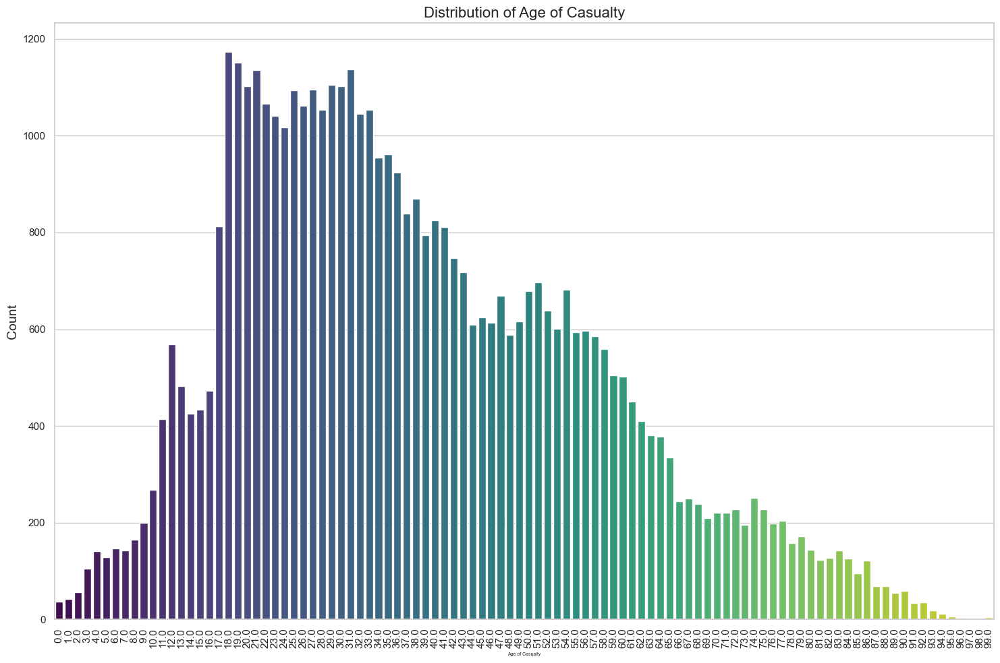

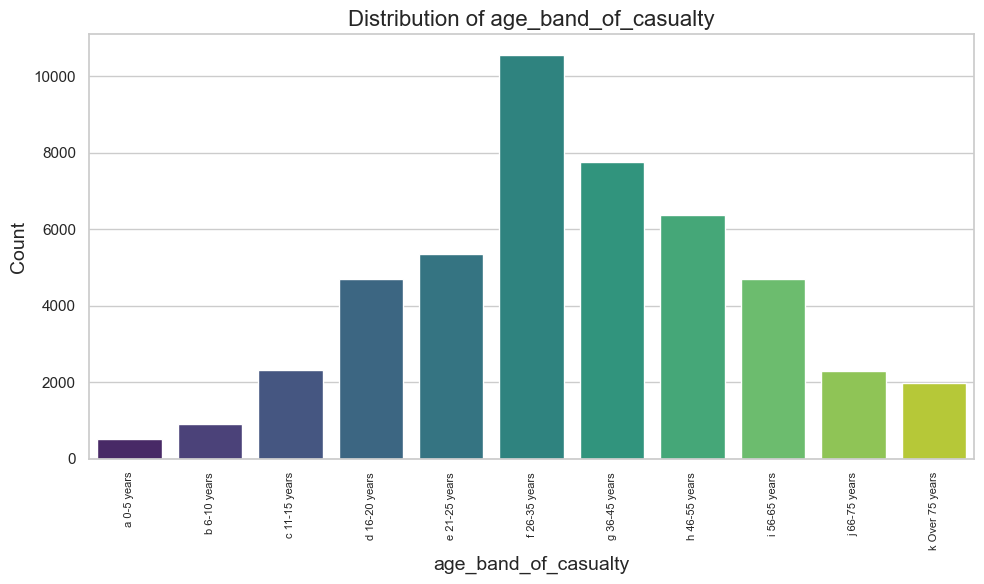

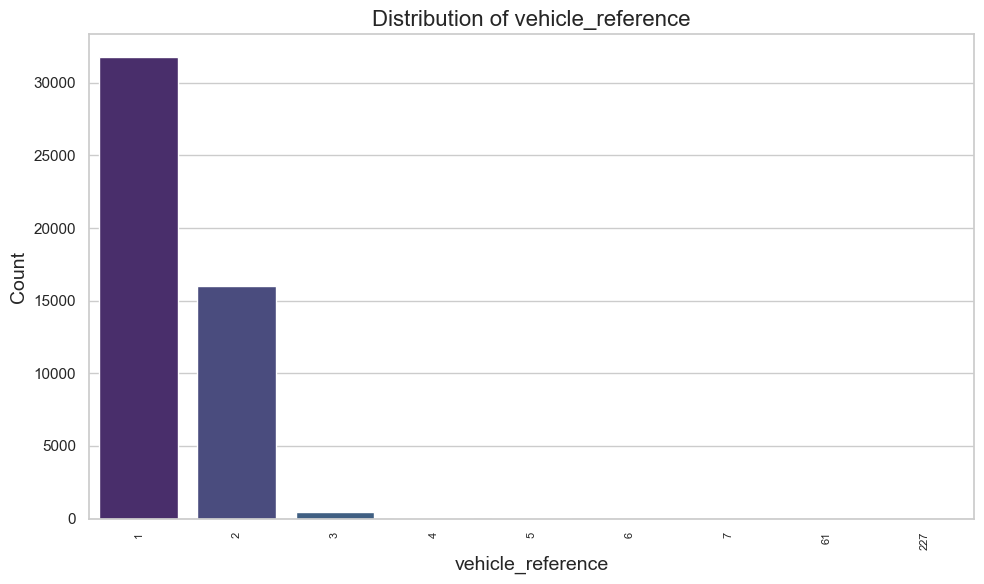

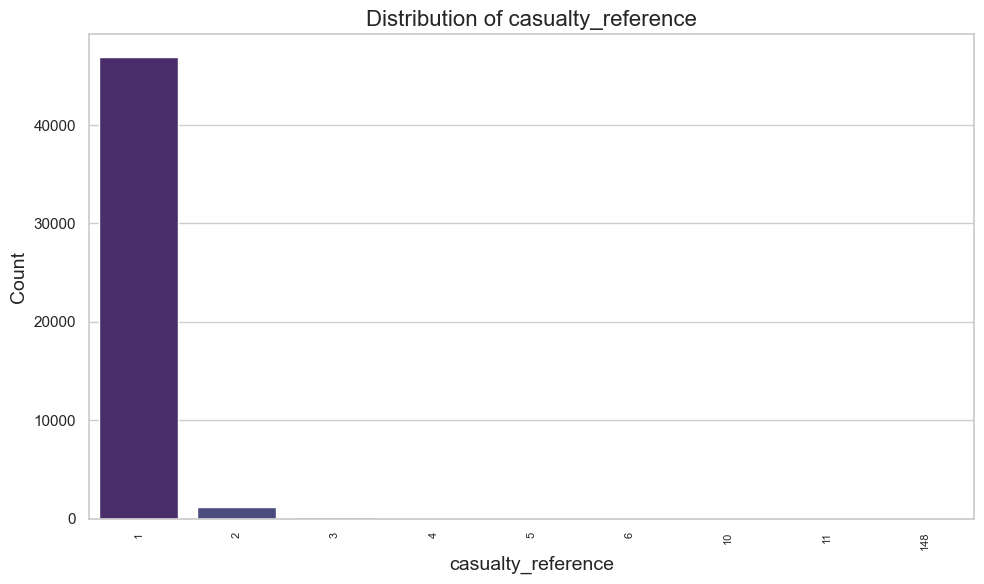

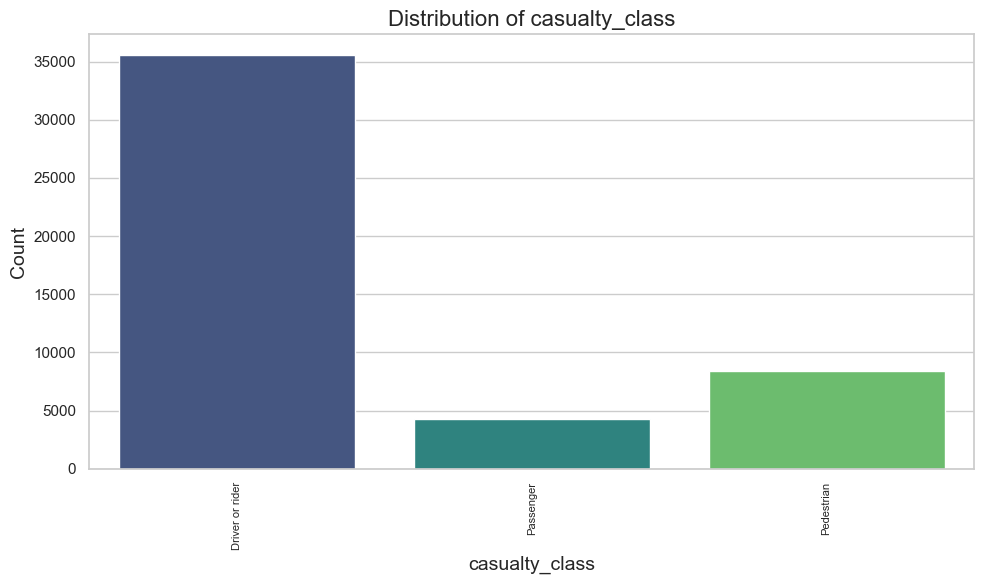

...

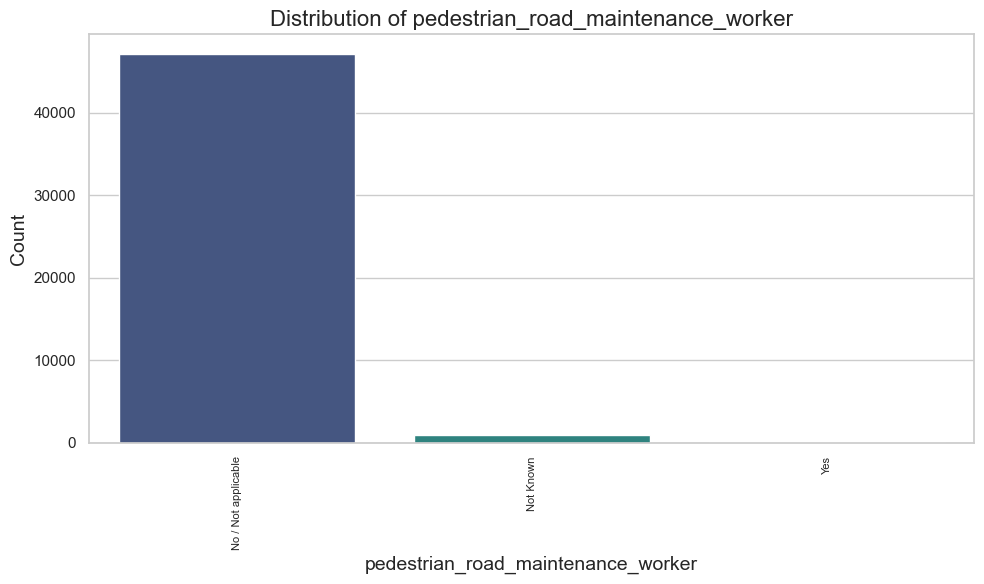

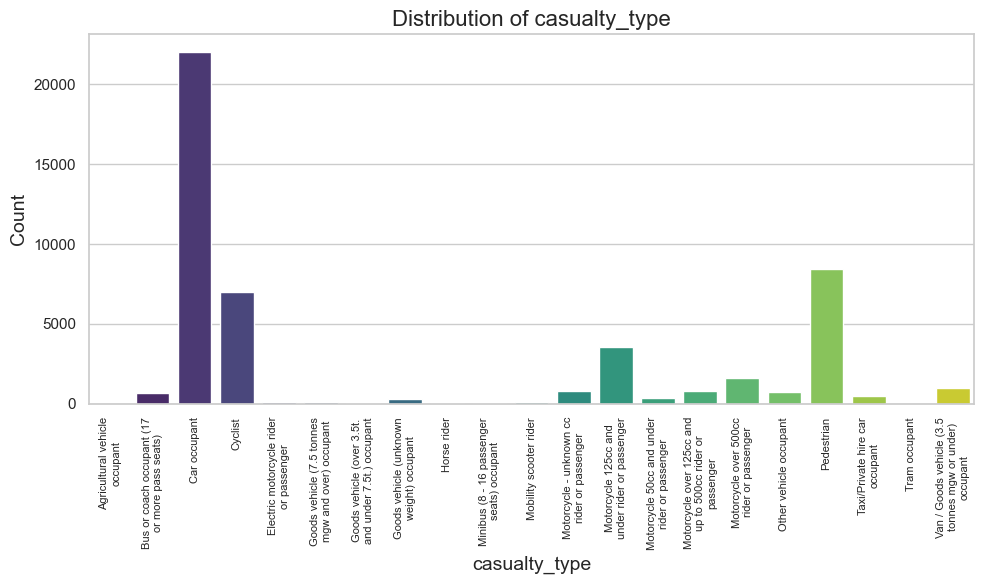

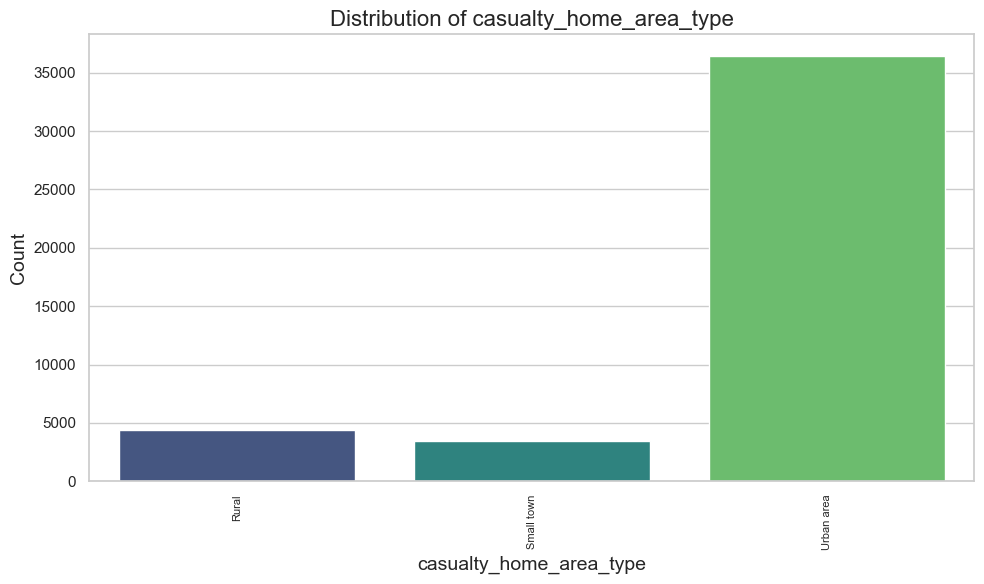

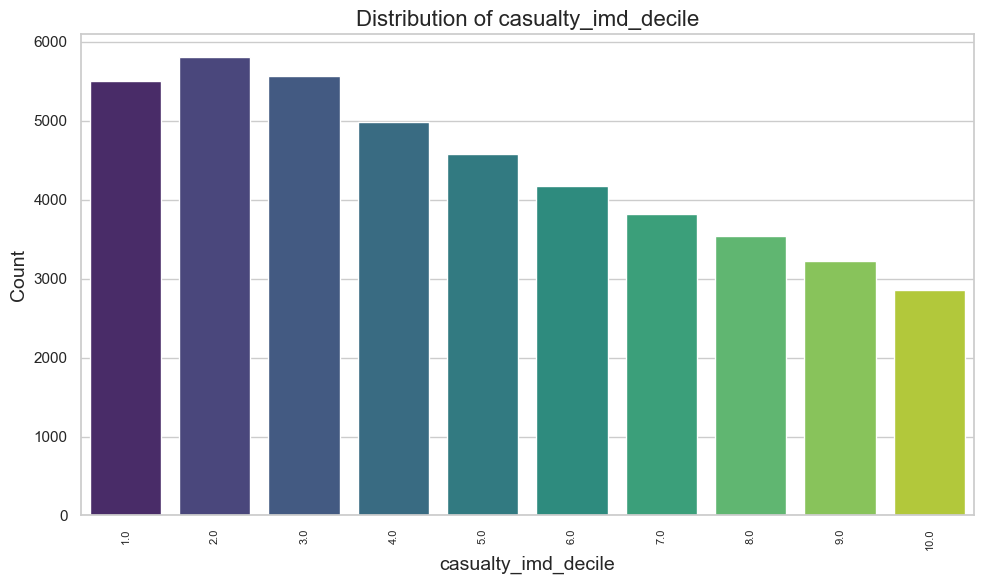

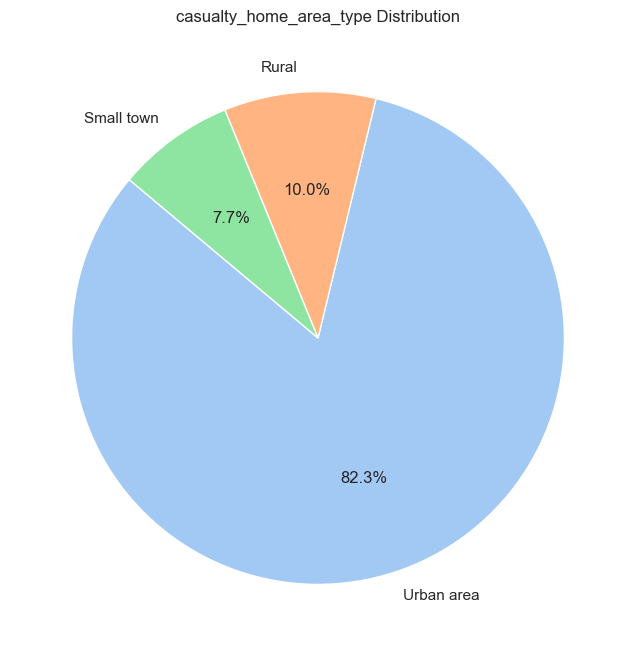

Plotting for Original DataFrame: df_copy


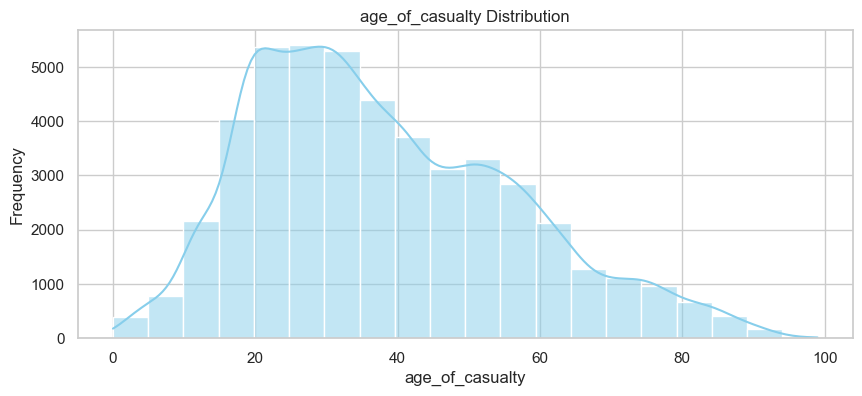

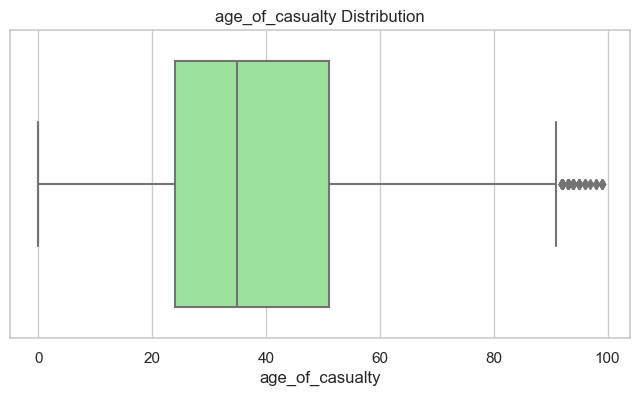

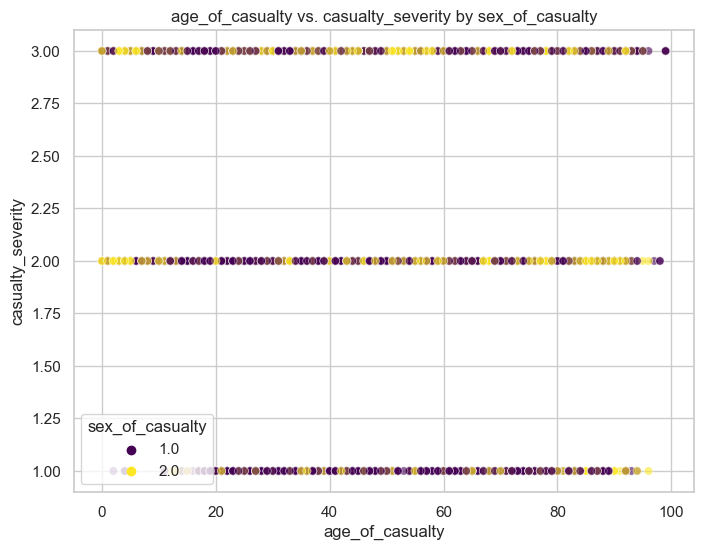

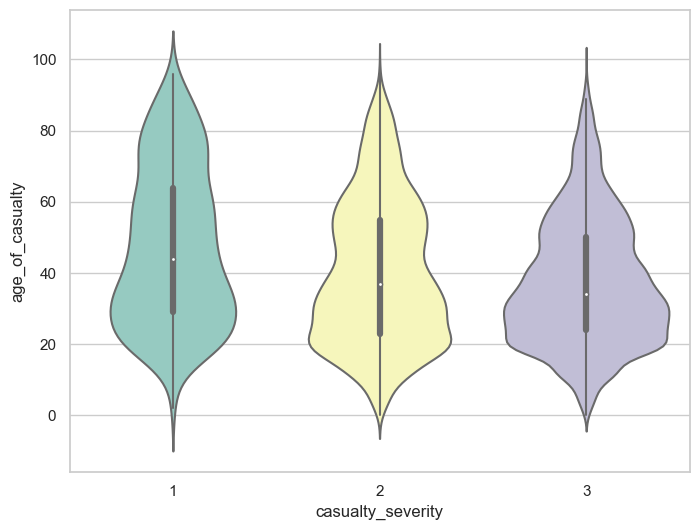

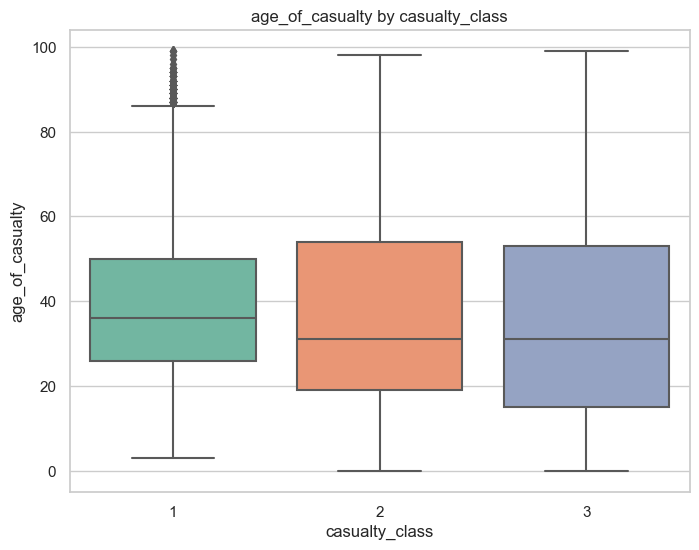

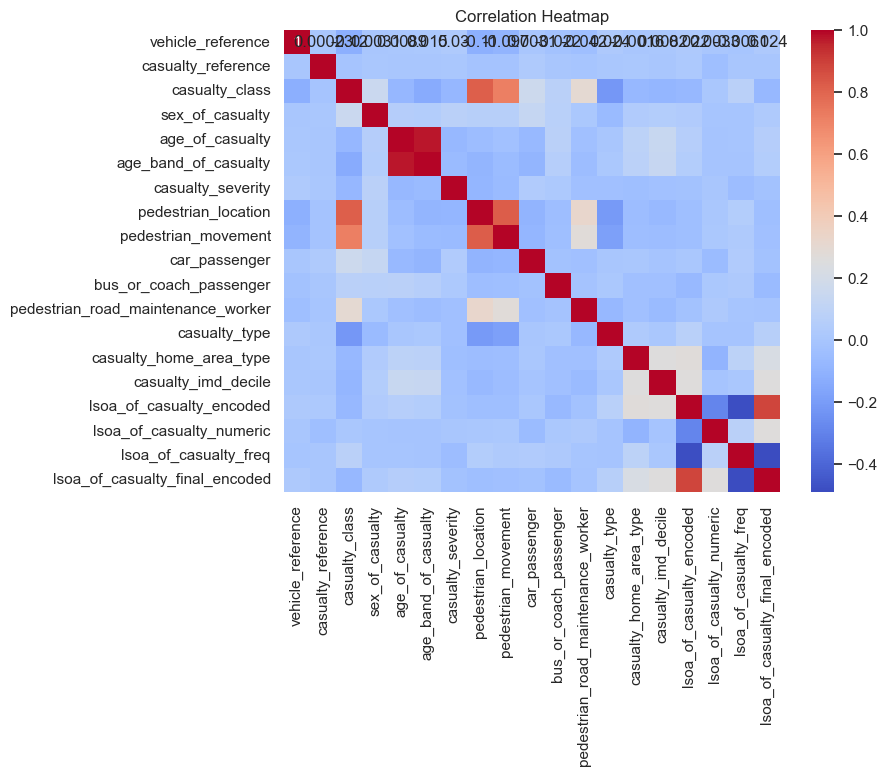

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
Plotting for Labeled DataFrame: df_fatal_labeled


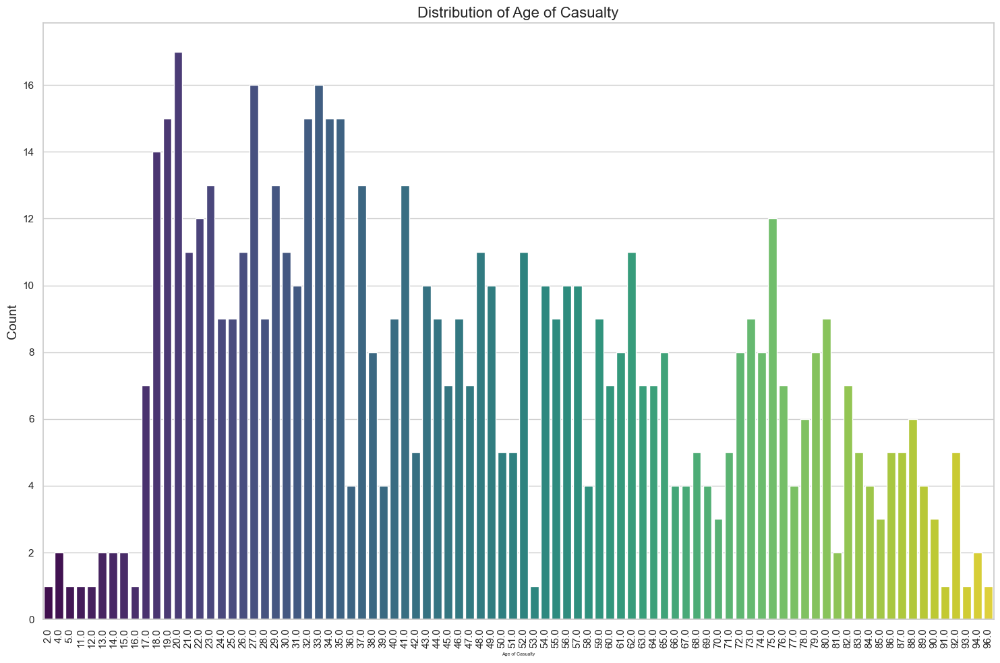

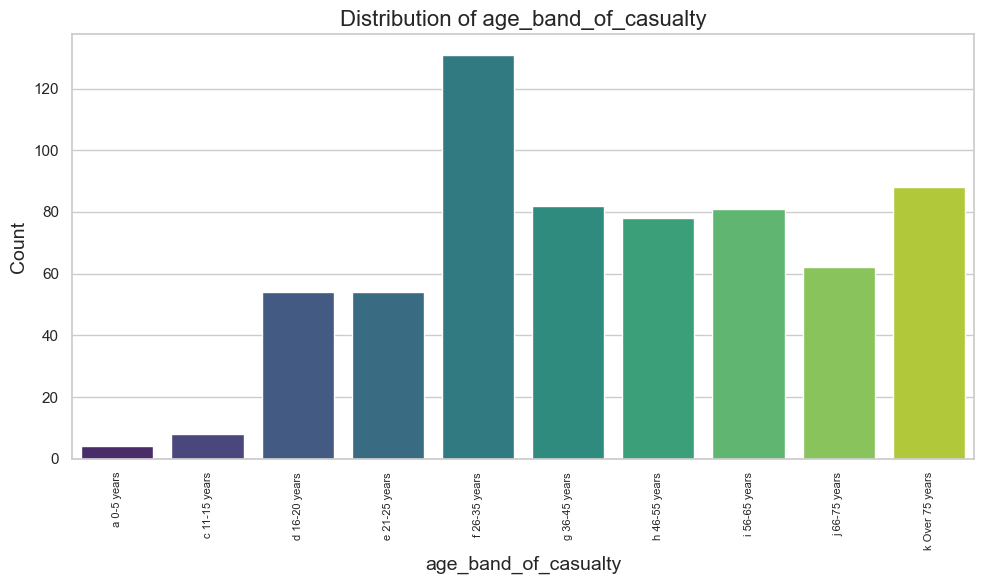

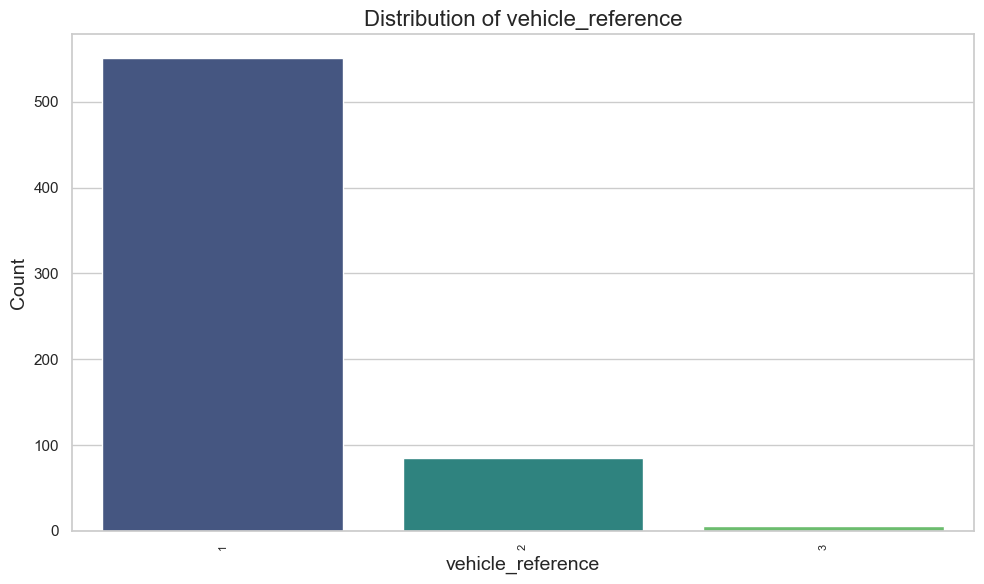

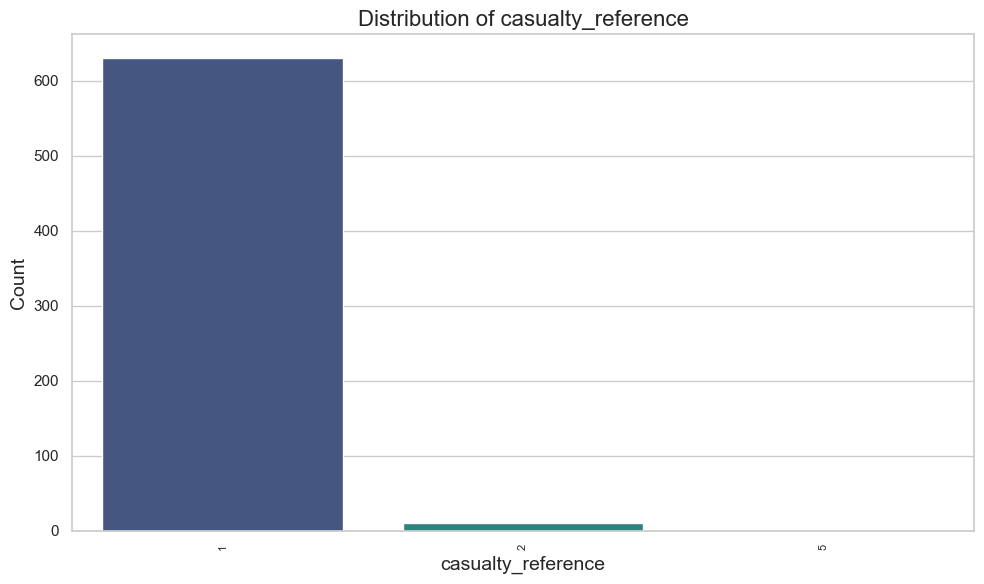

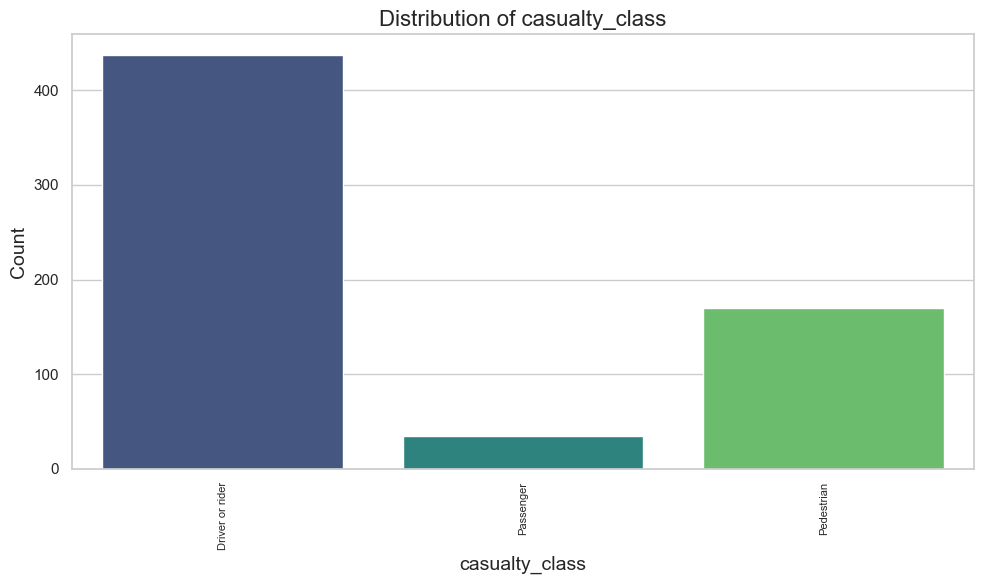

...

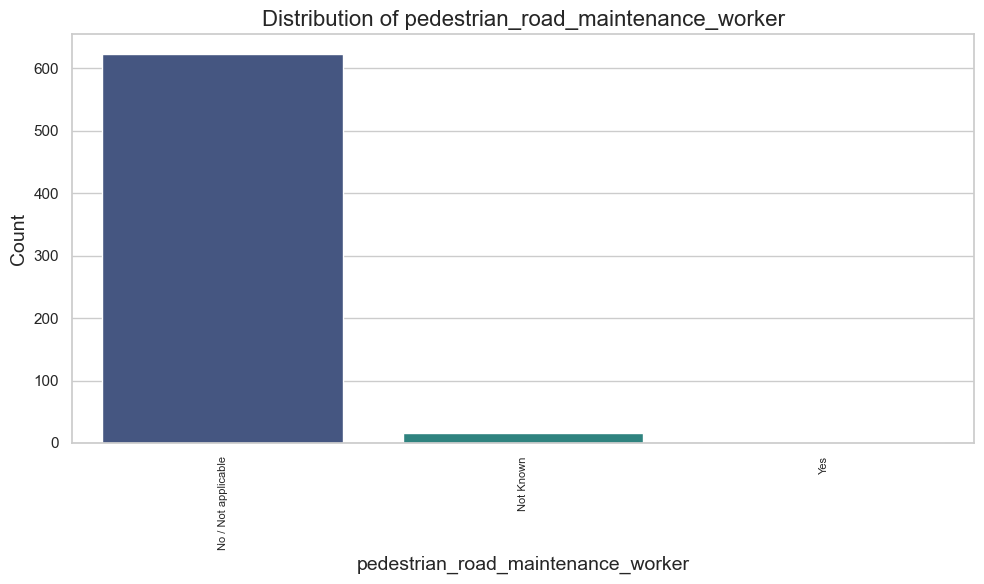

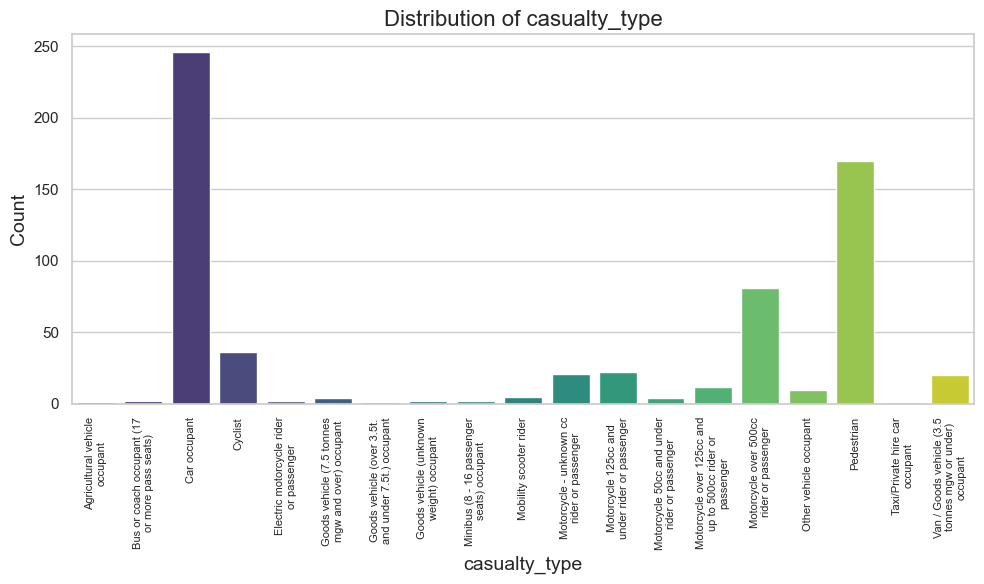

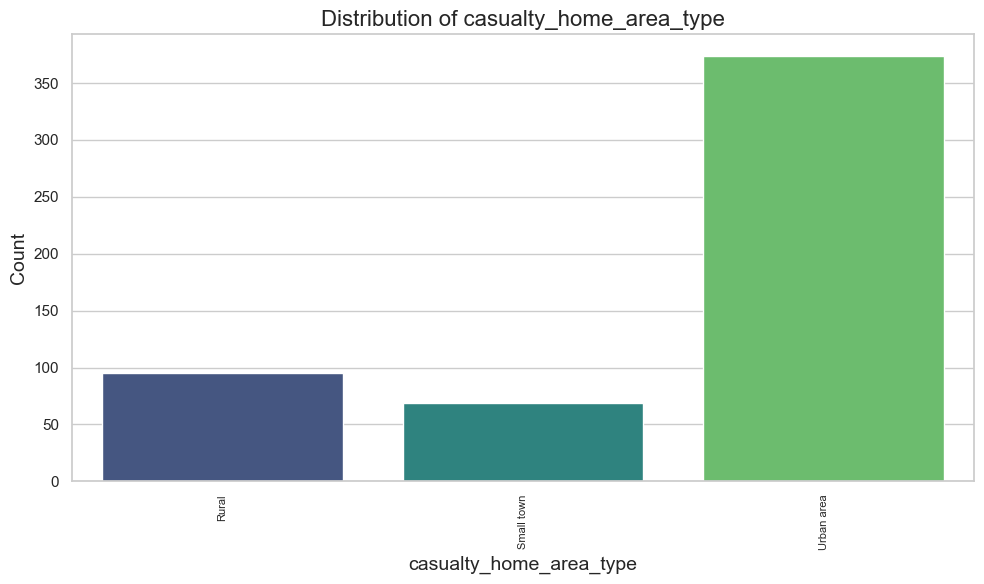

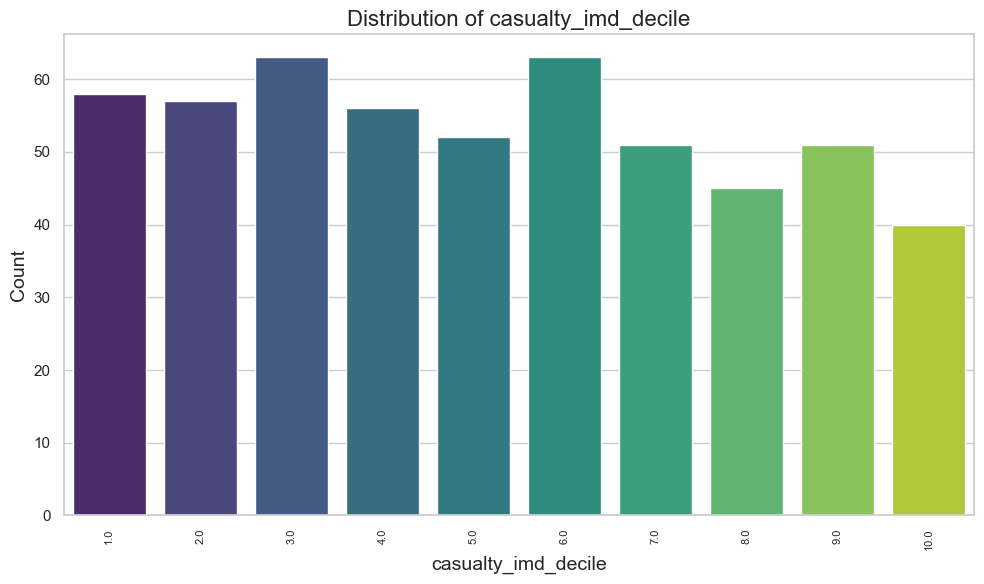

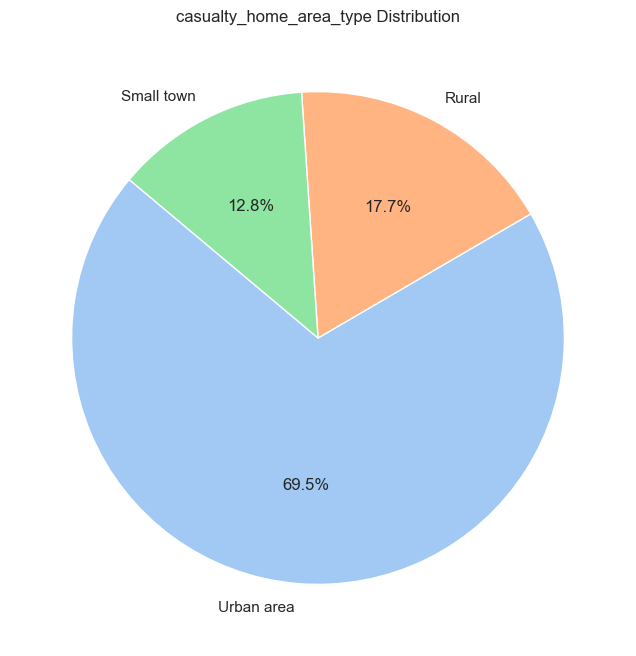

Plotting for Original DataFrame: df_fatal


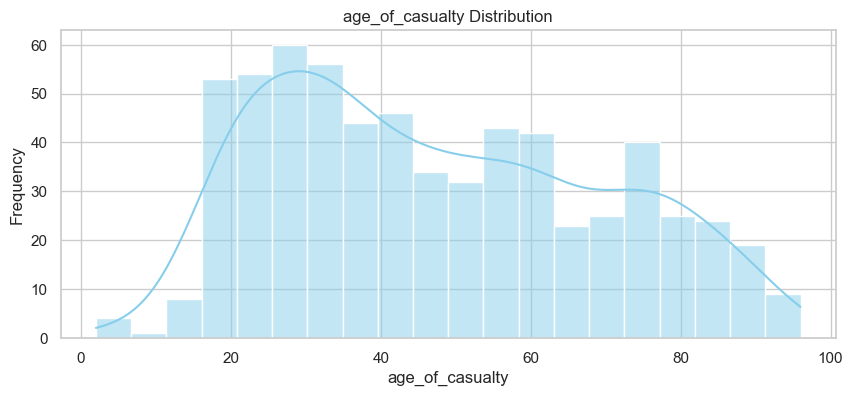

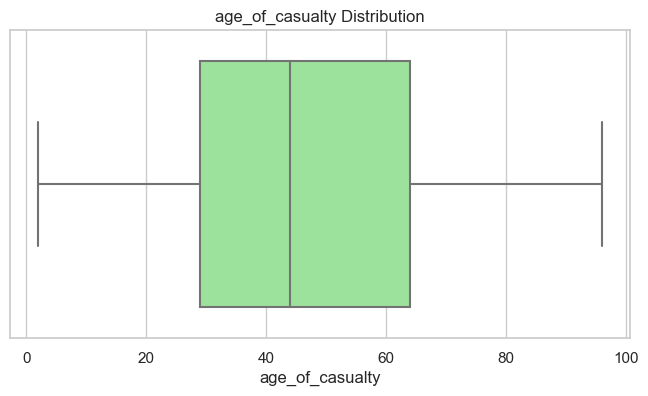

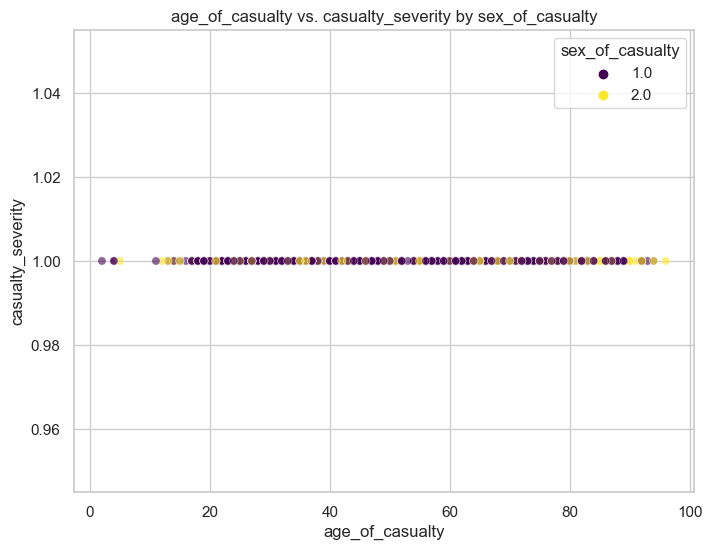

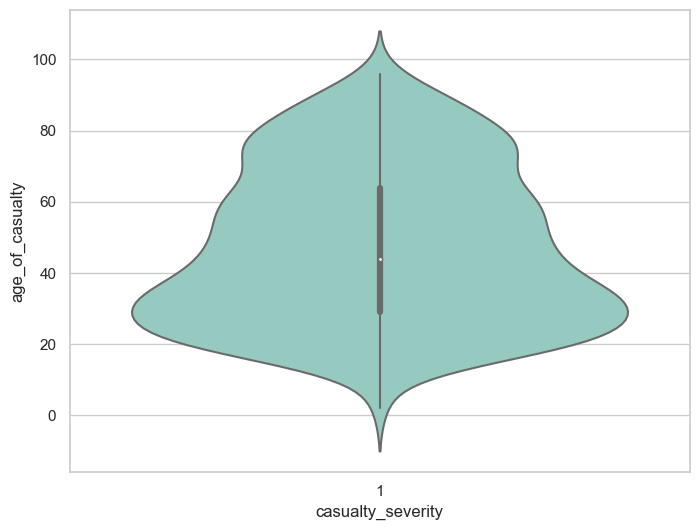

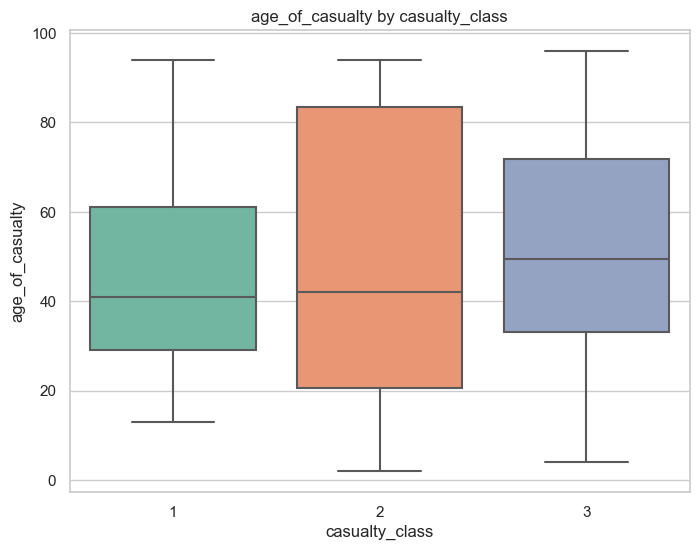

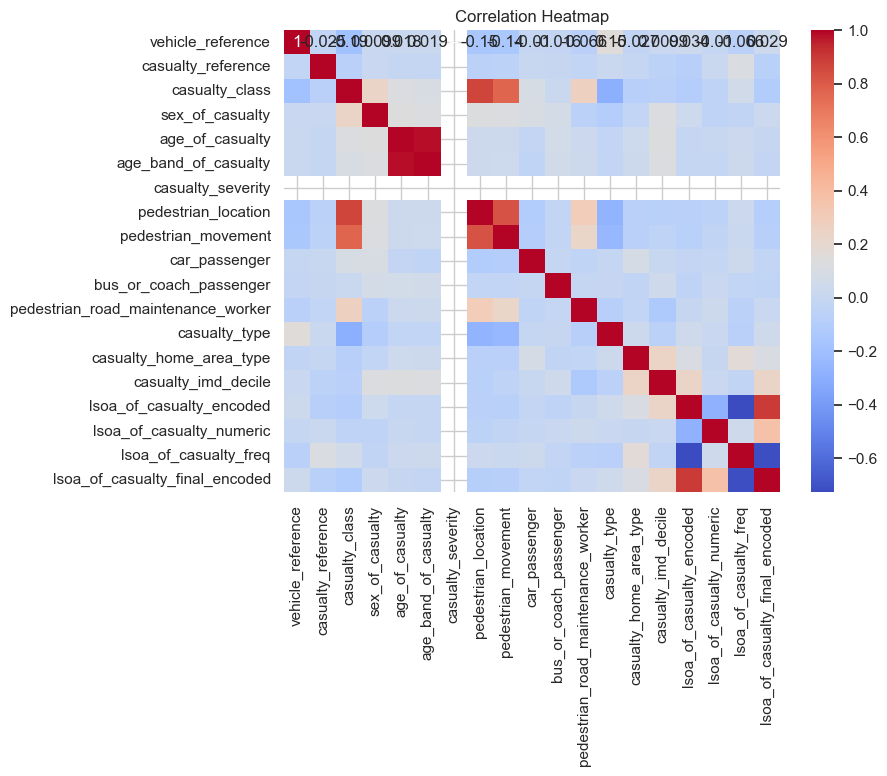

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
Plotting for Labeled DataFrame: df_fatal_serious_labeled


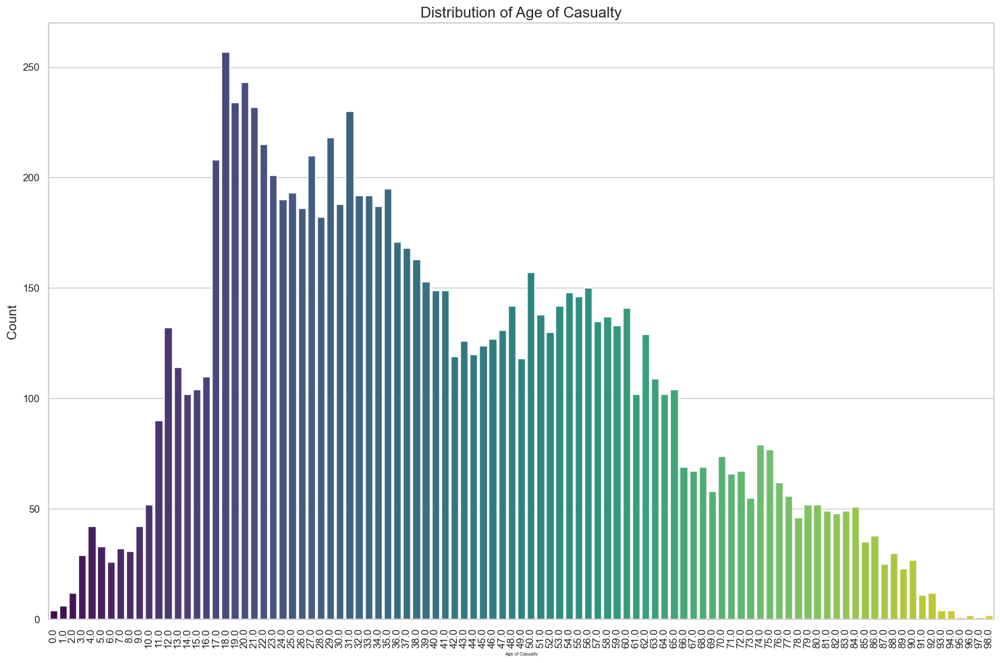

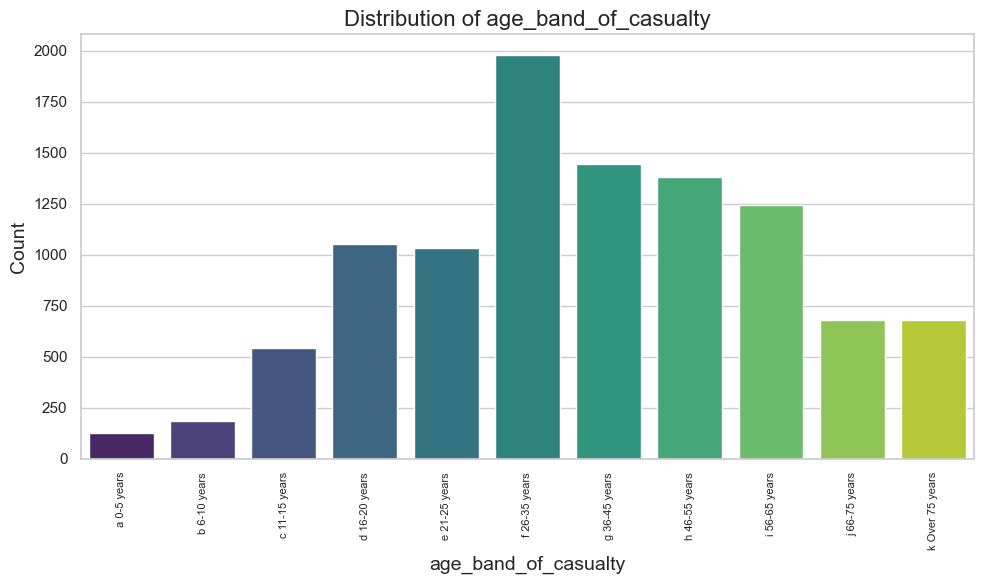

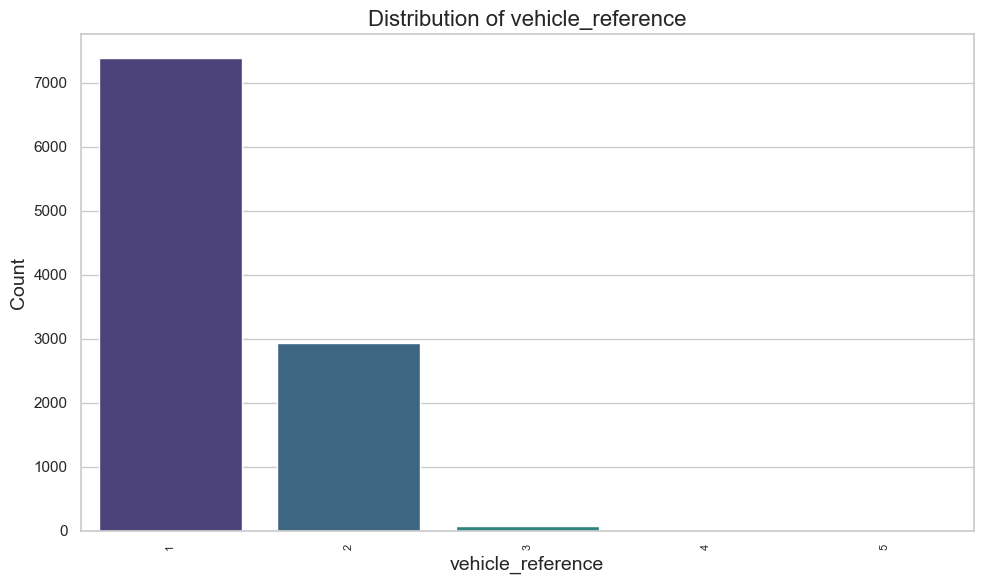

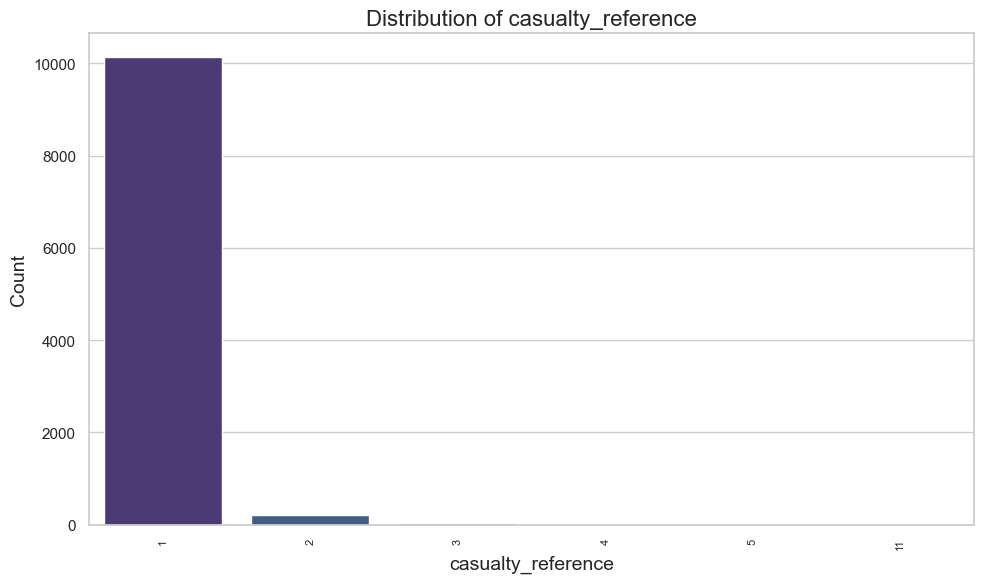

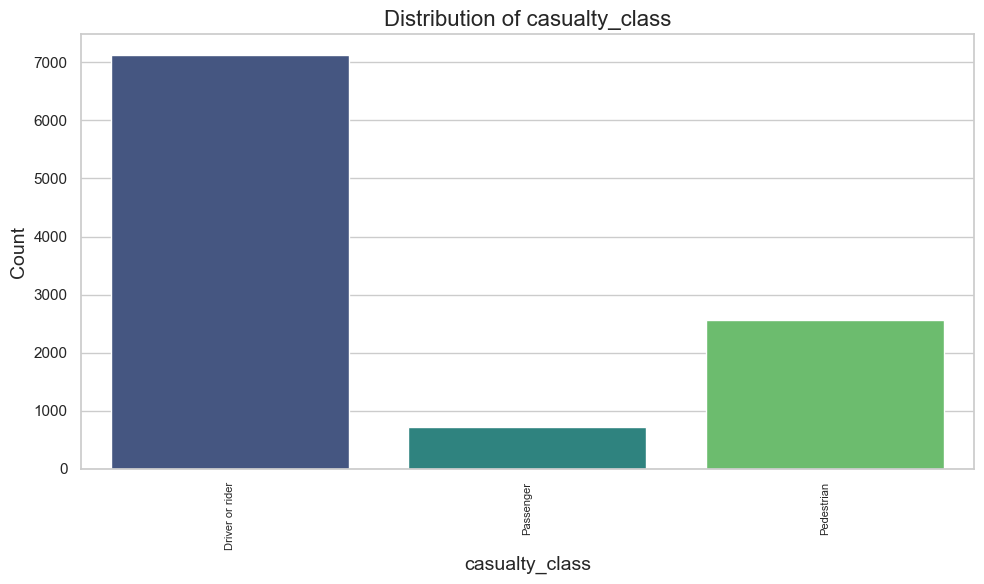

...

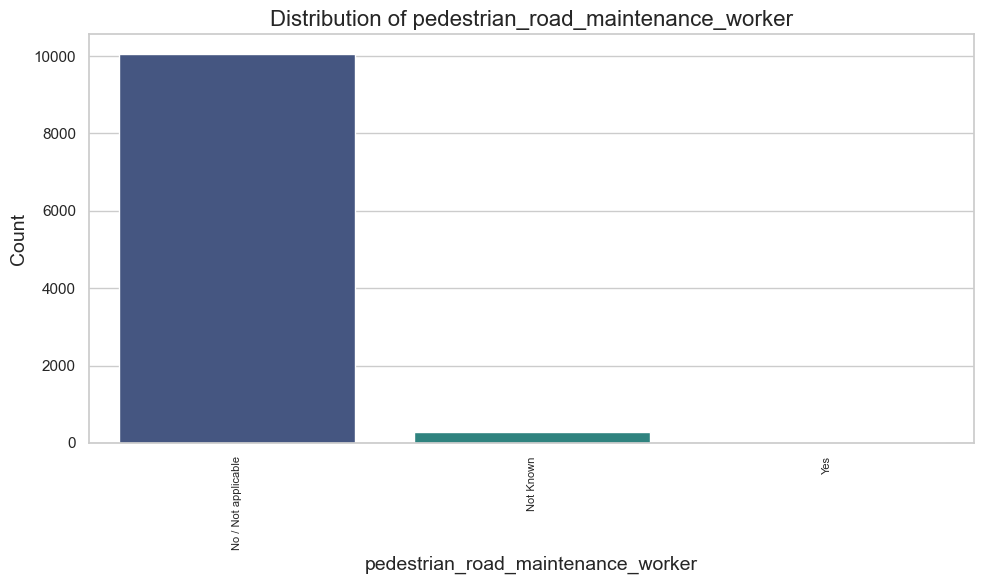

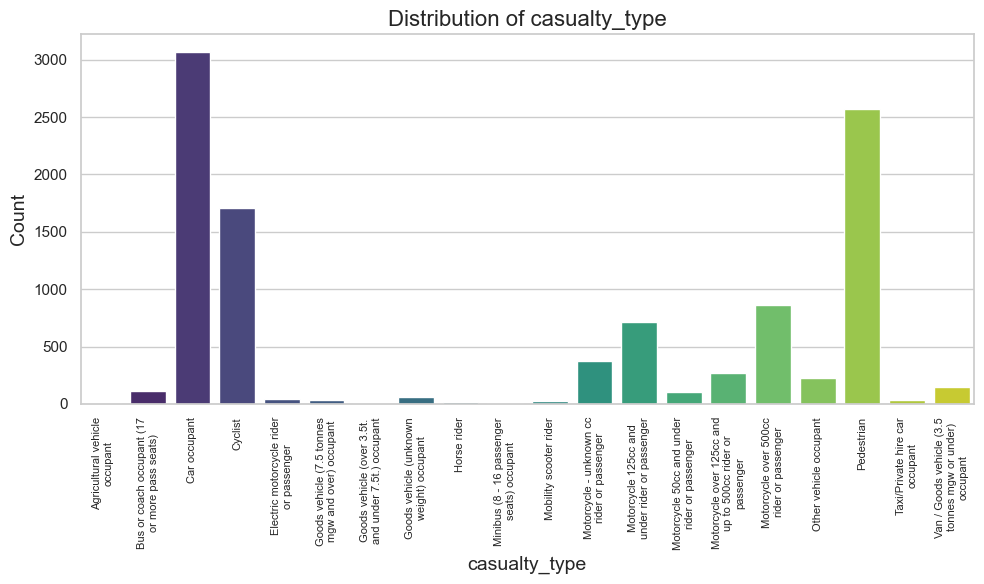

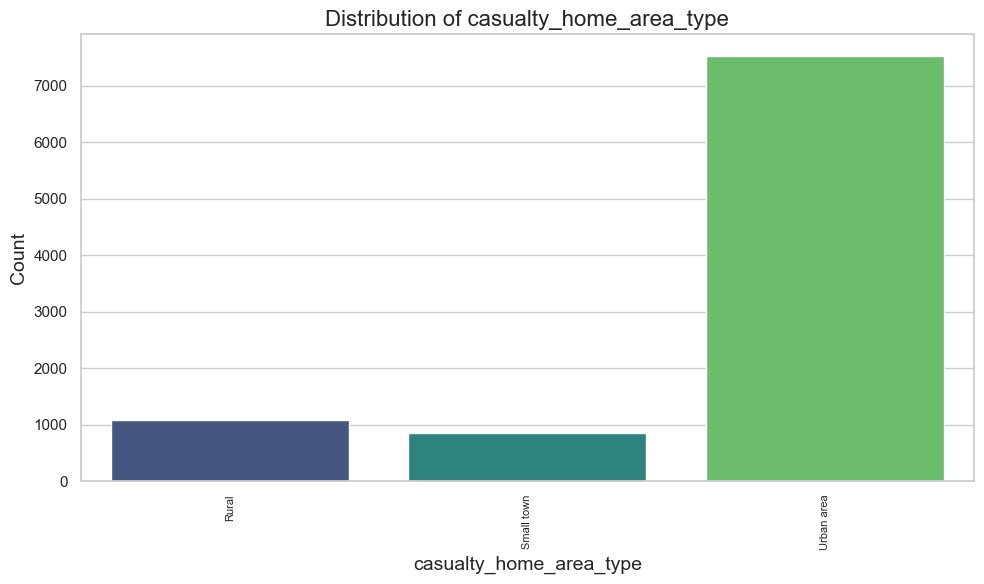

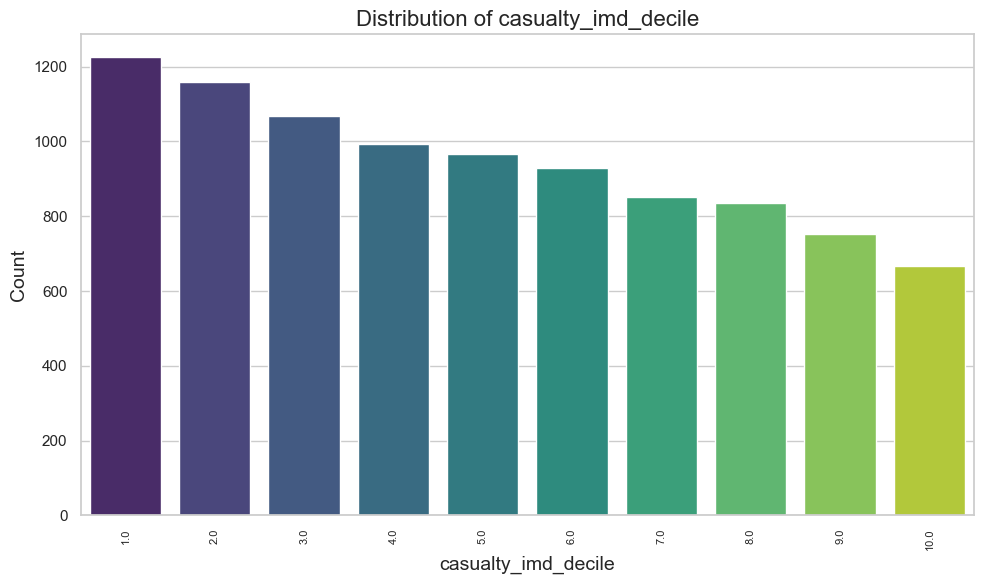

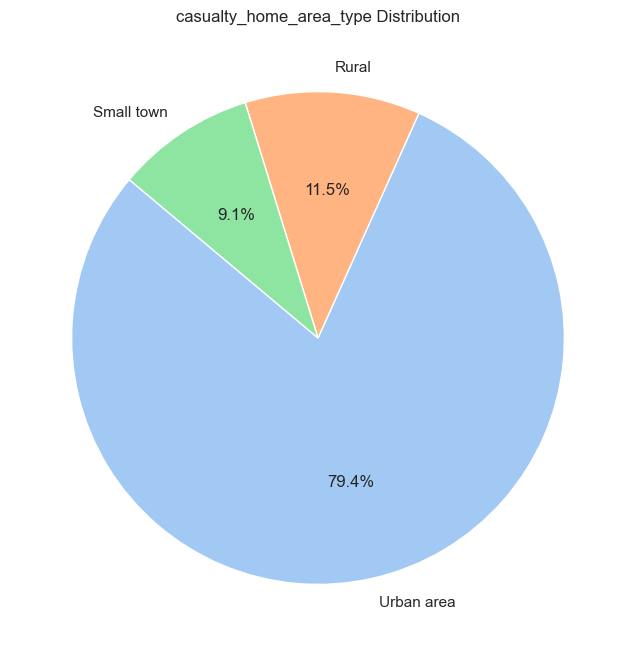

Plotting for Original DataFrame: df_fatal_serious


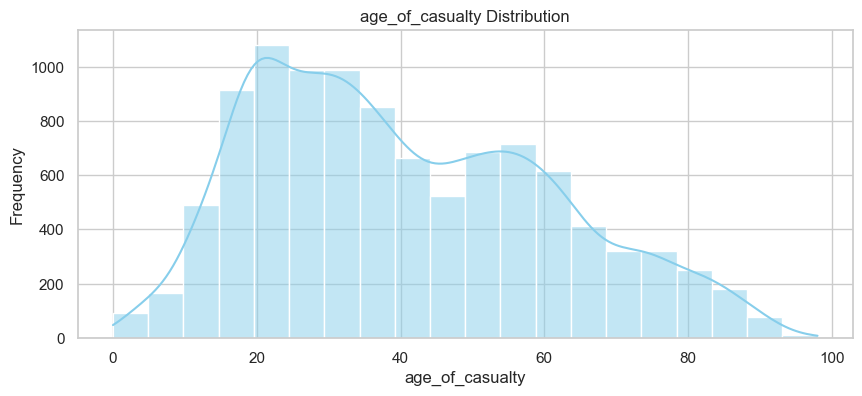

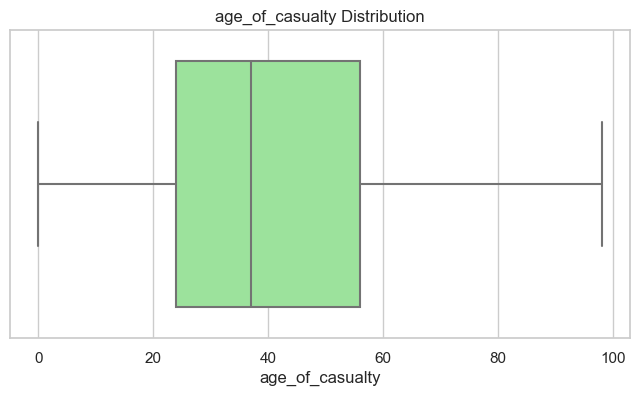

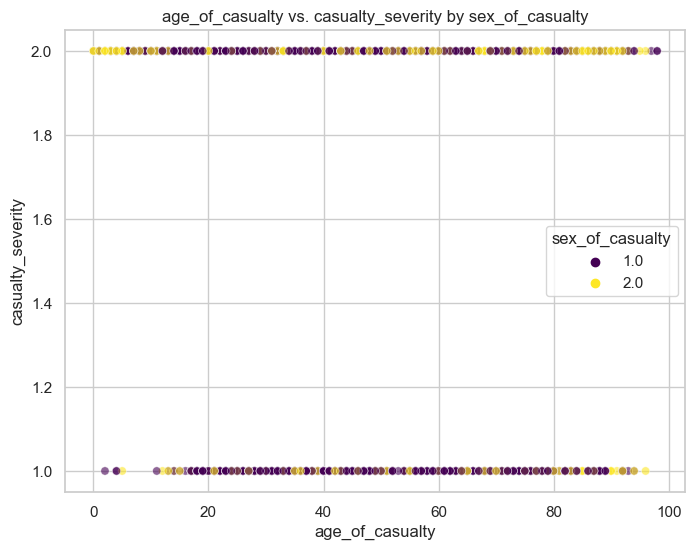

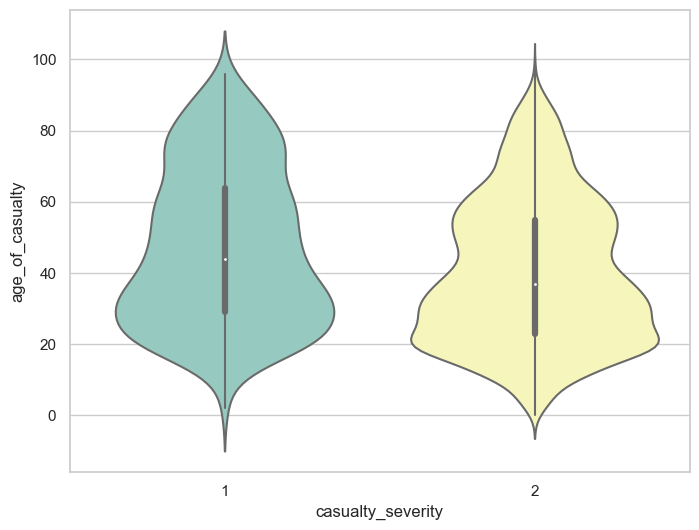

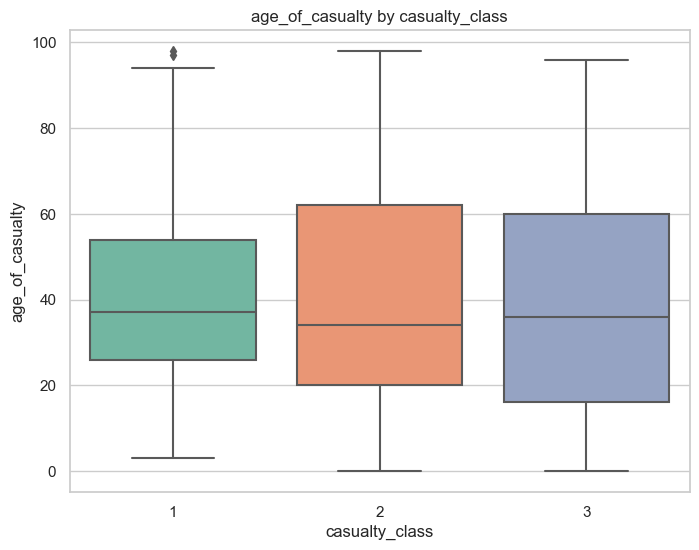

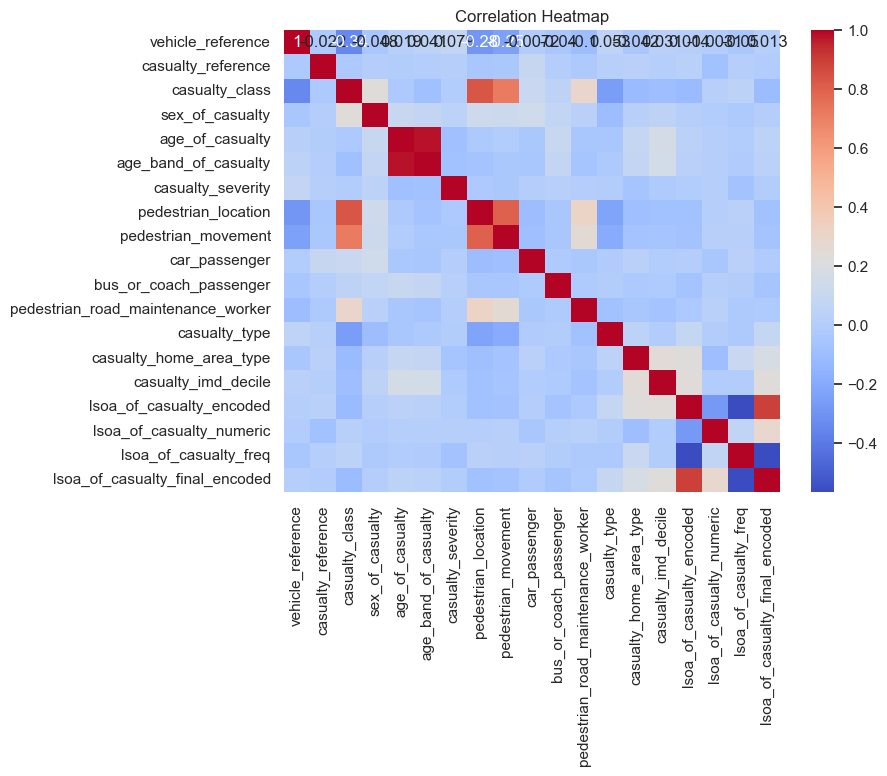

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
Plotting for Labeled DataFrame: df_pedestrians_labeled


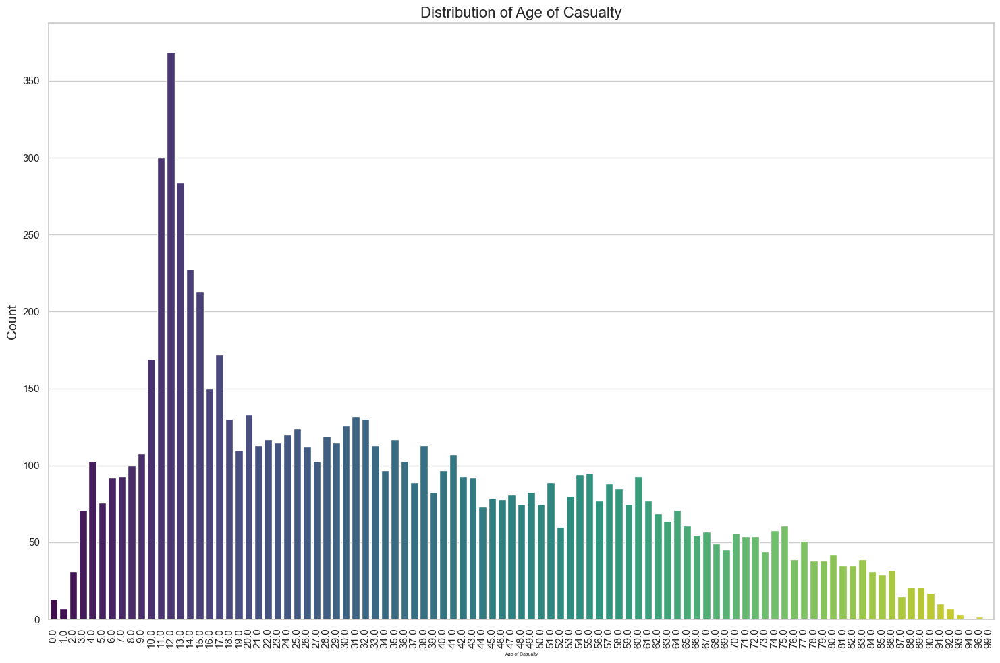

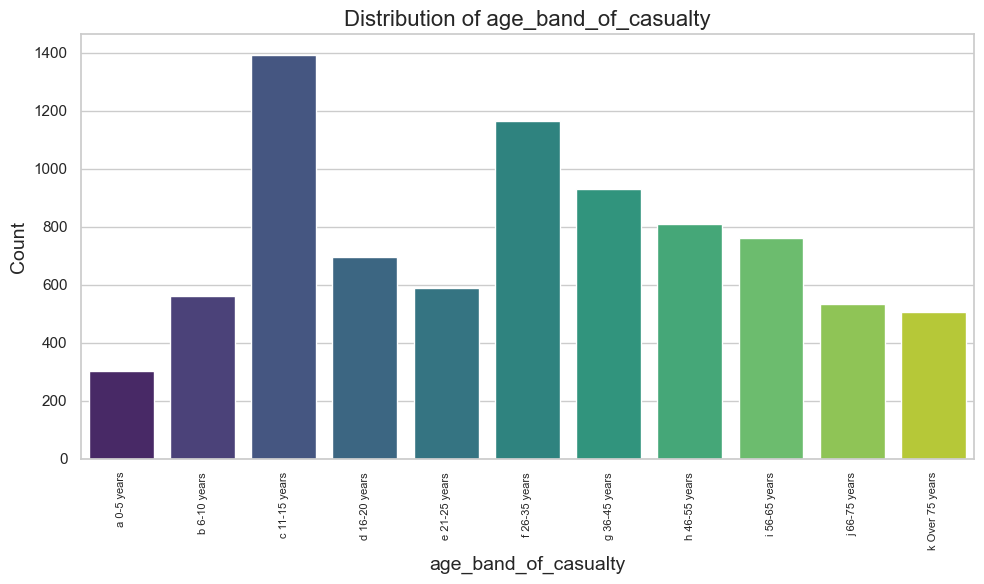

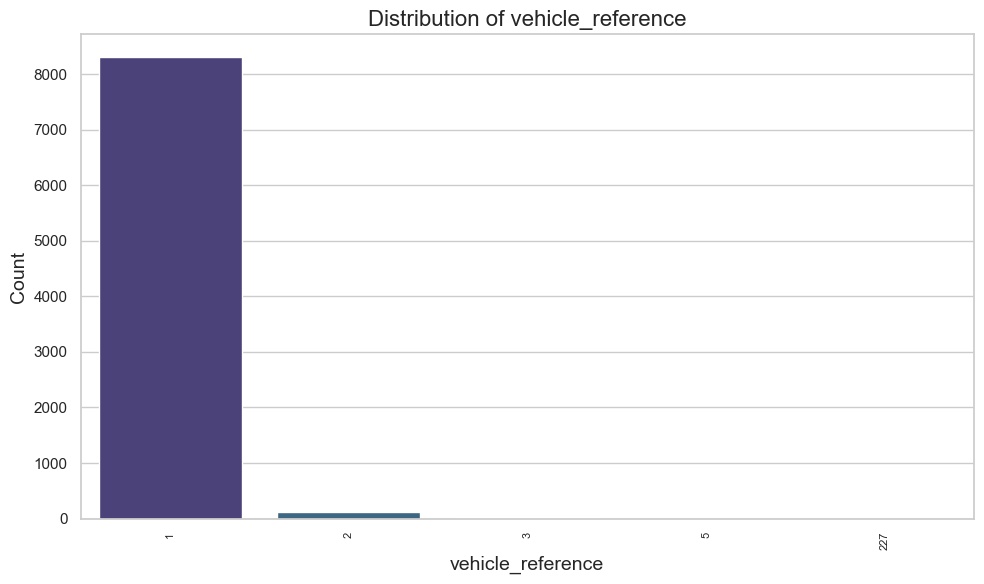

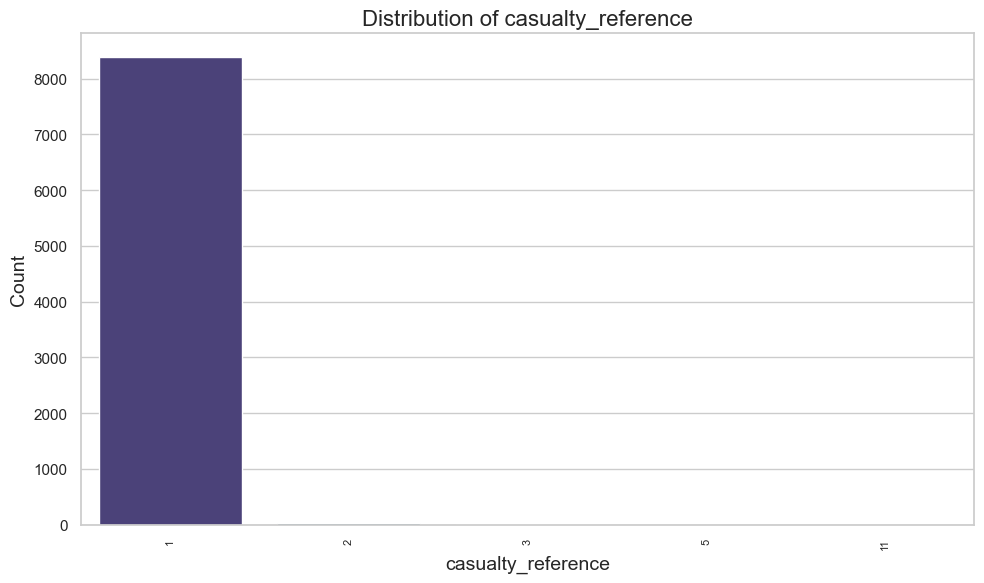

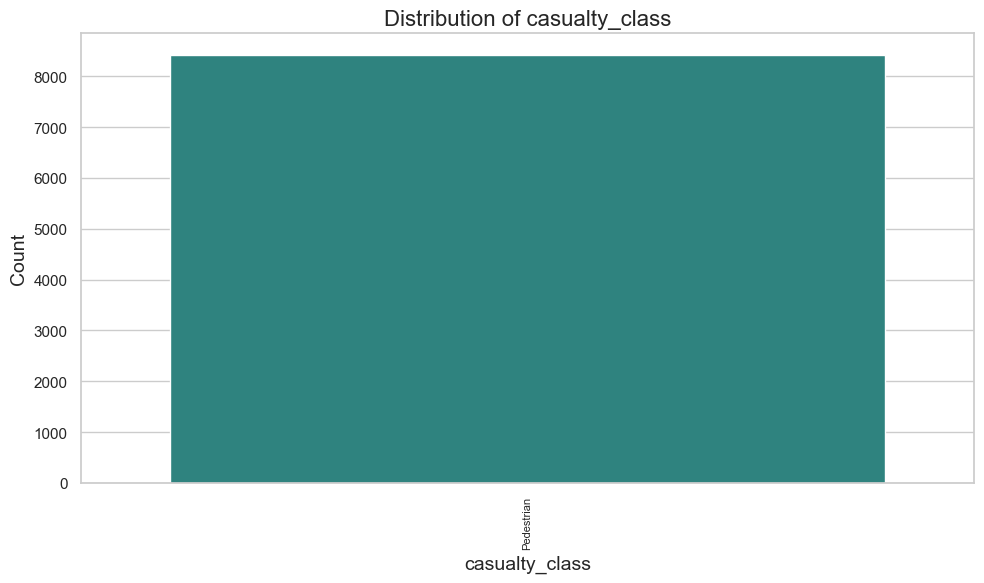

...

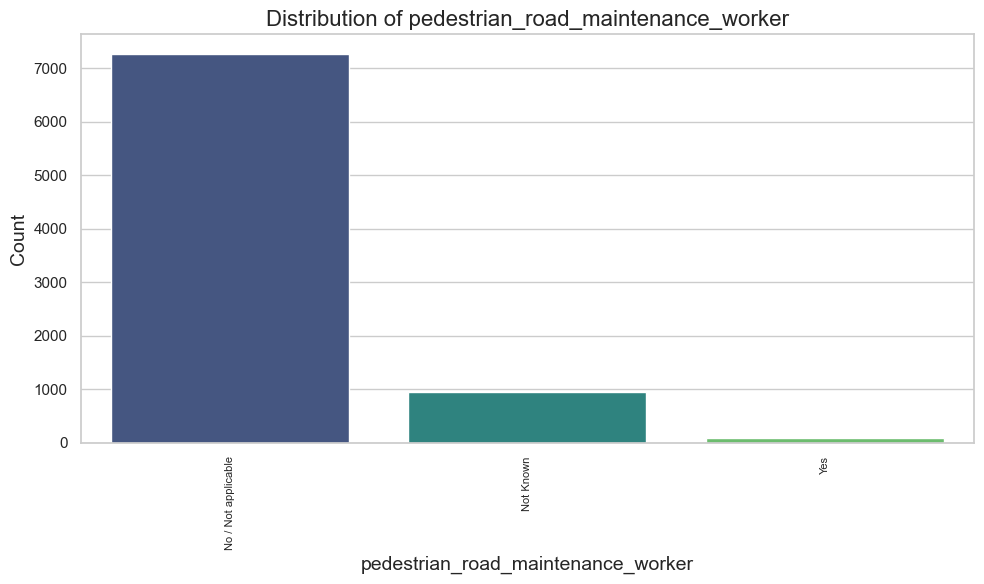

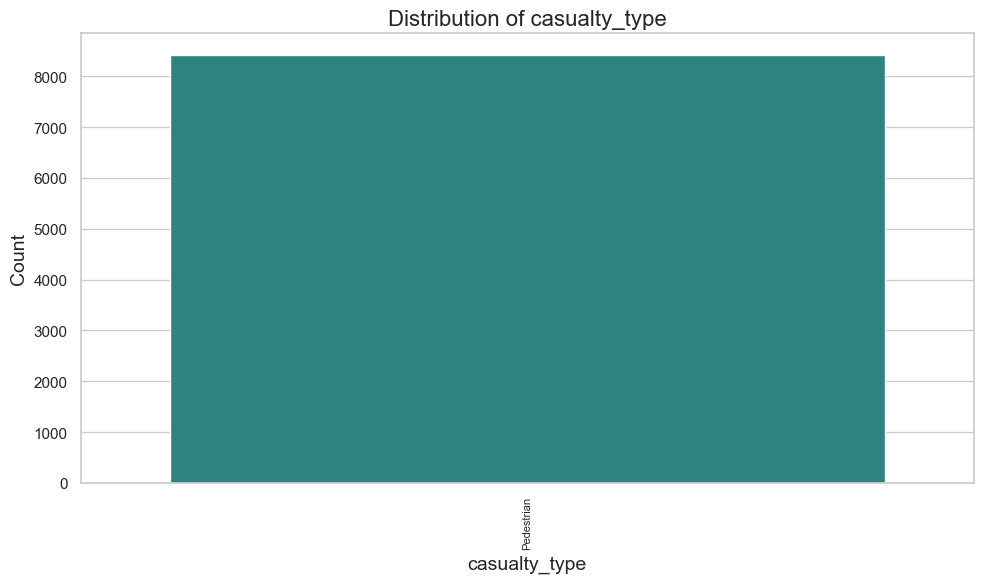

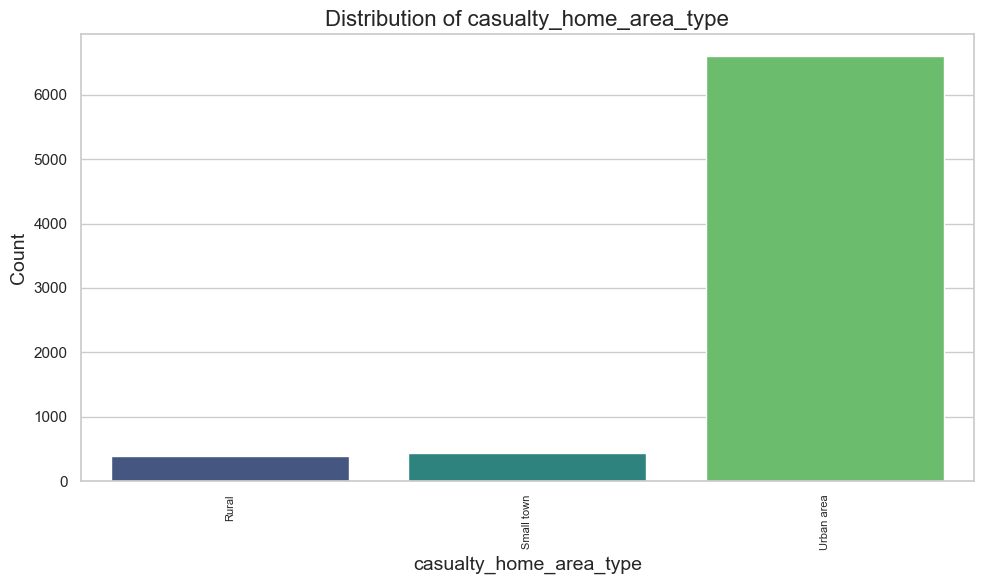

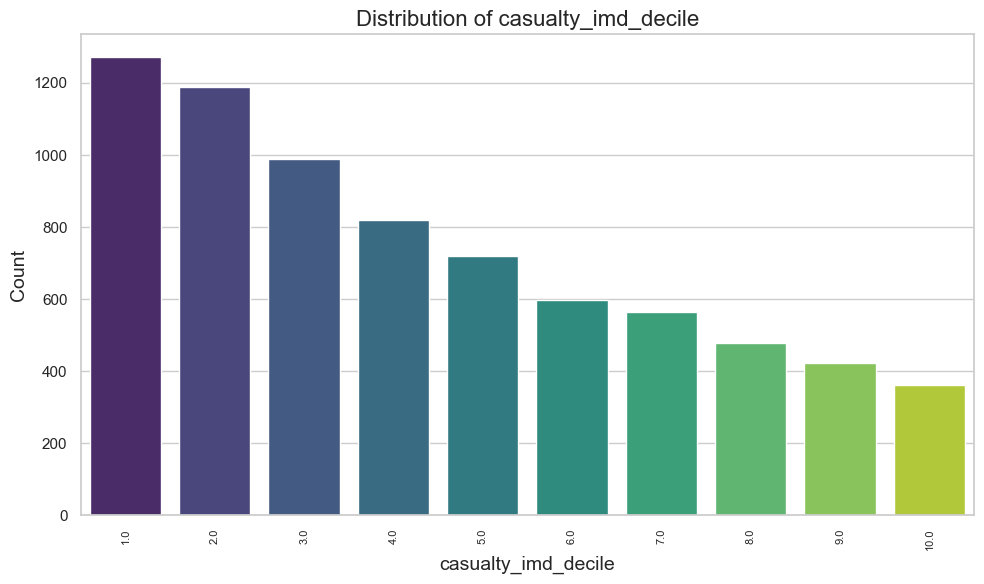

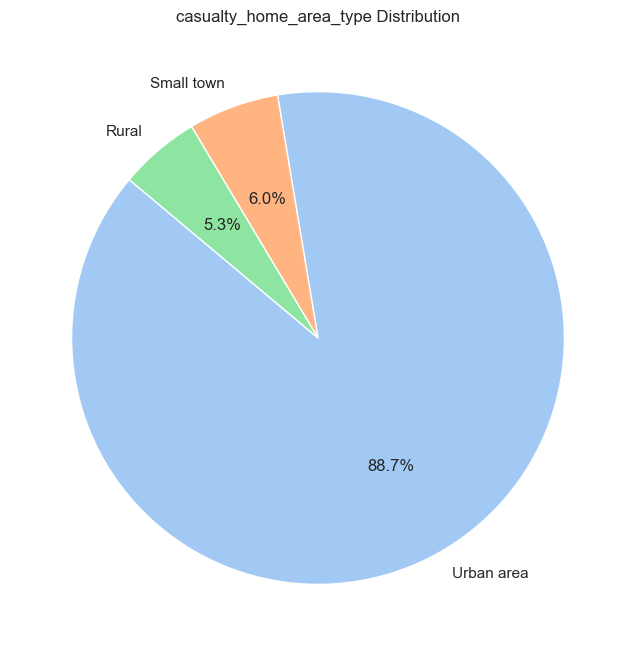

Plotting for Original DataFrame: df_pedestrians


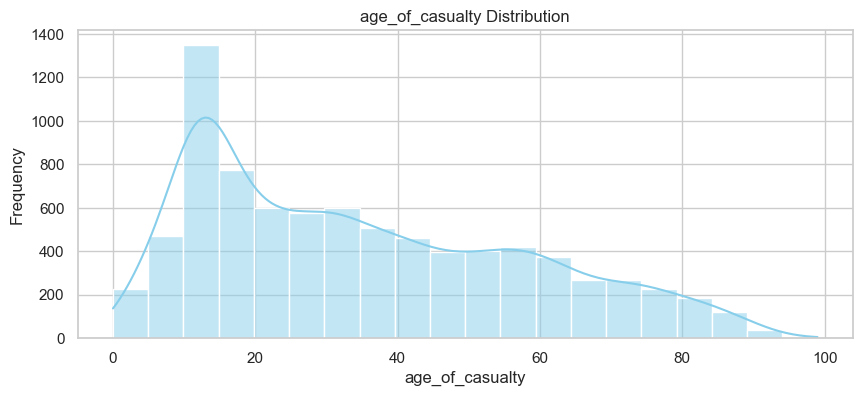

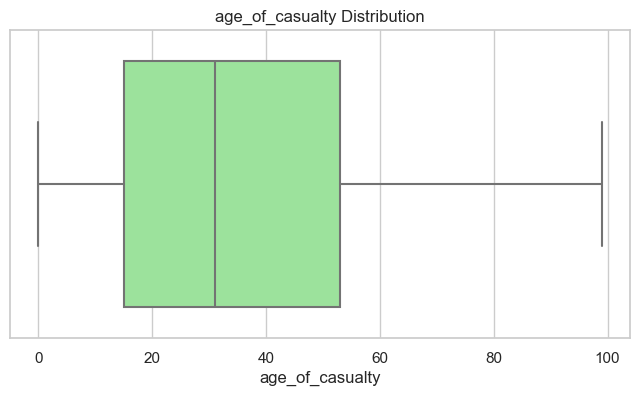

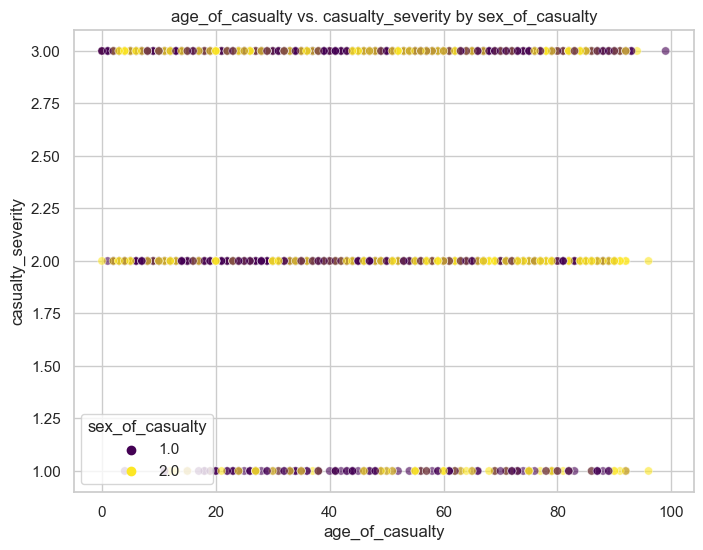

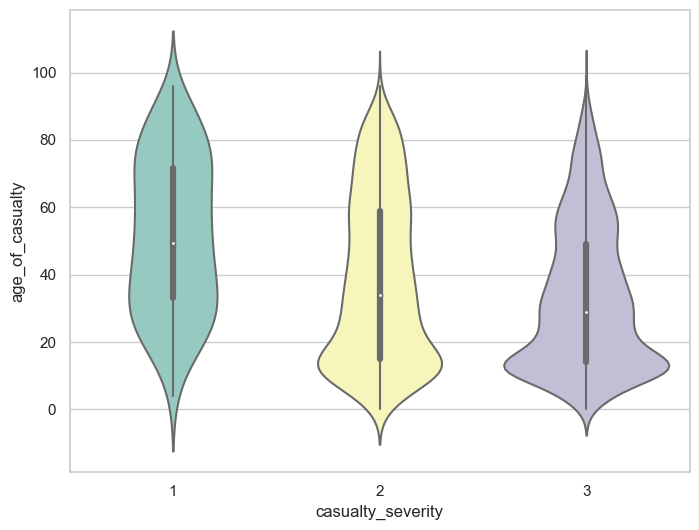

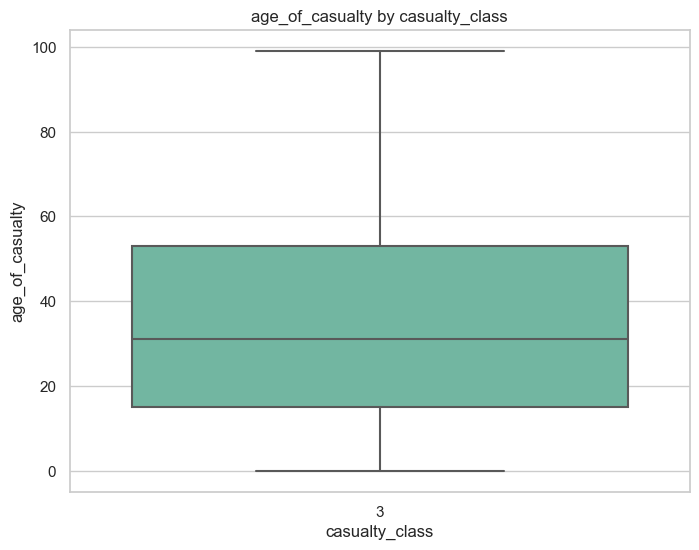

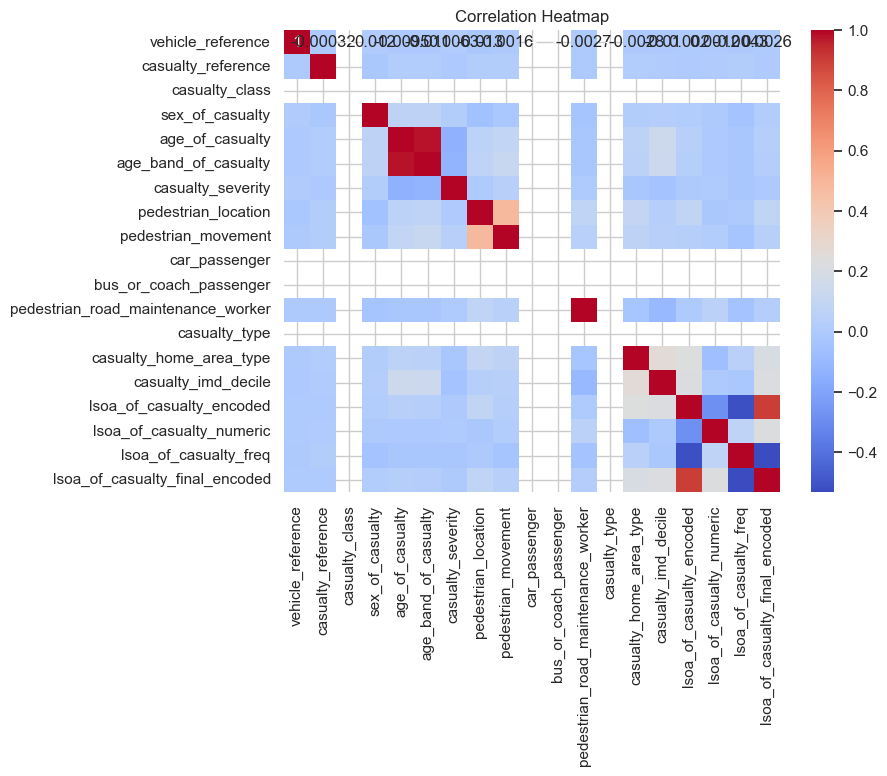

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
Plotting for Labeled DataFrame: df_pedestrians_FS_labeled


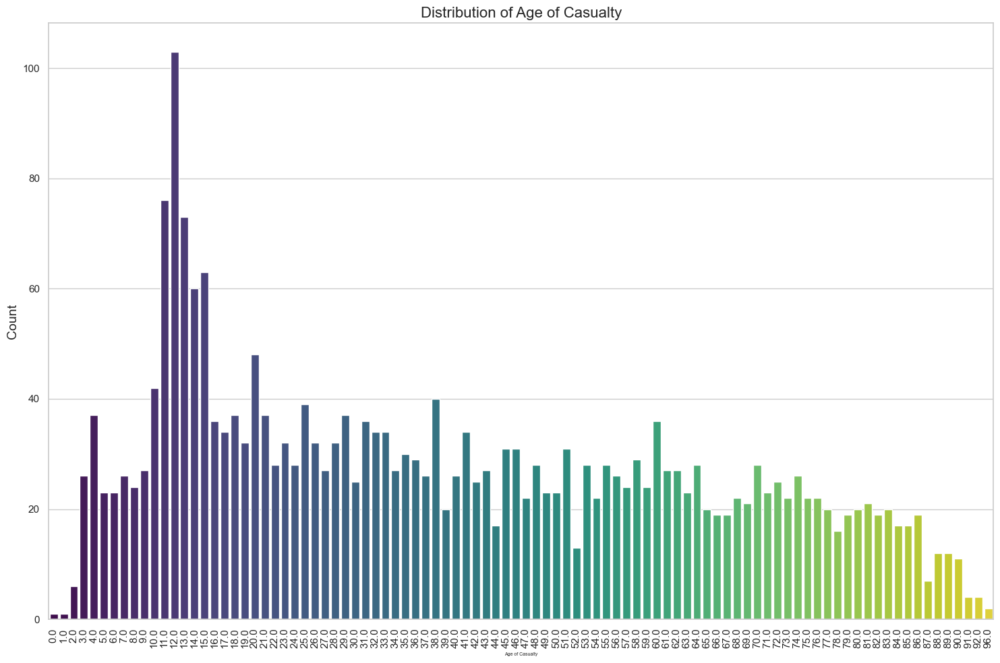

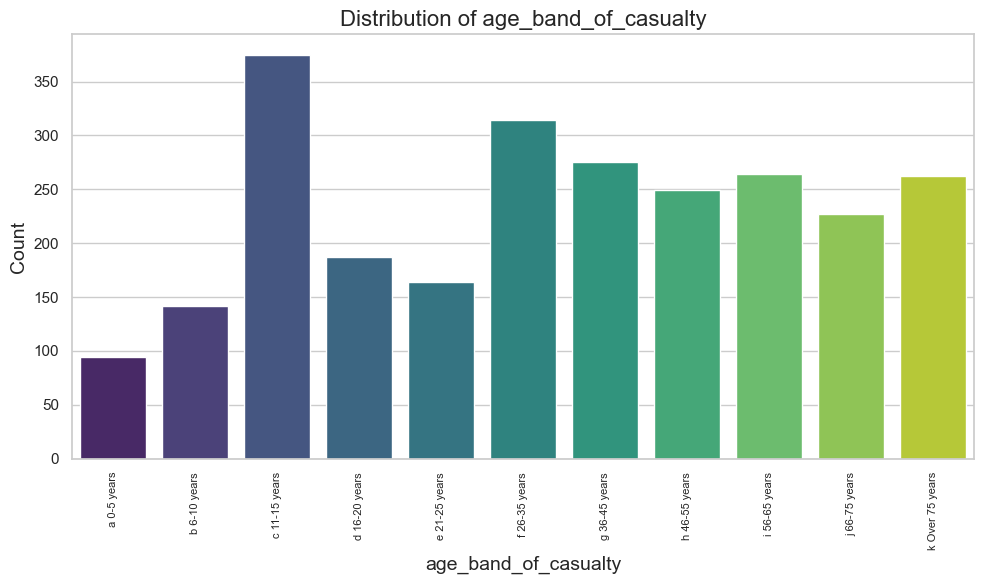

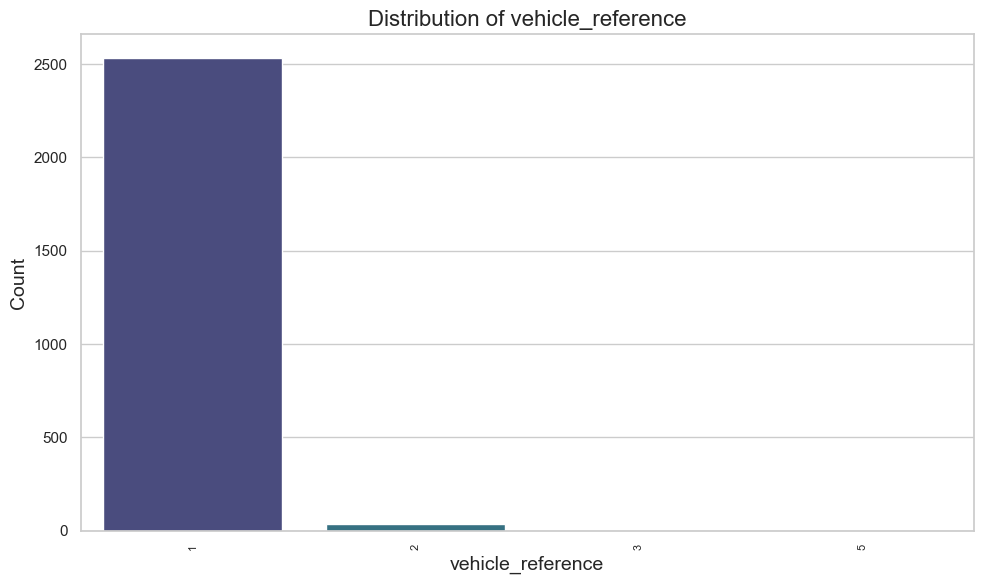

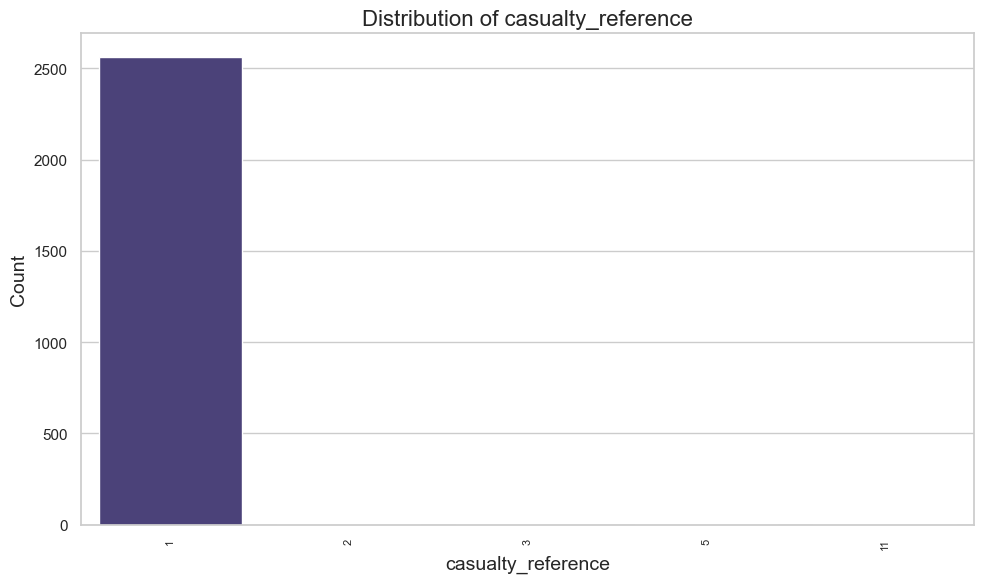

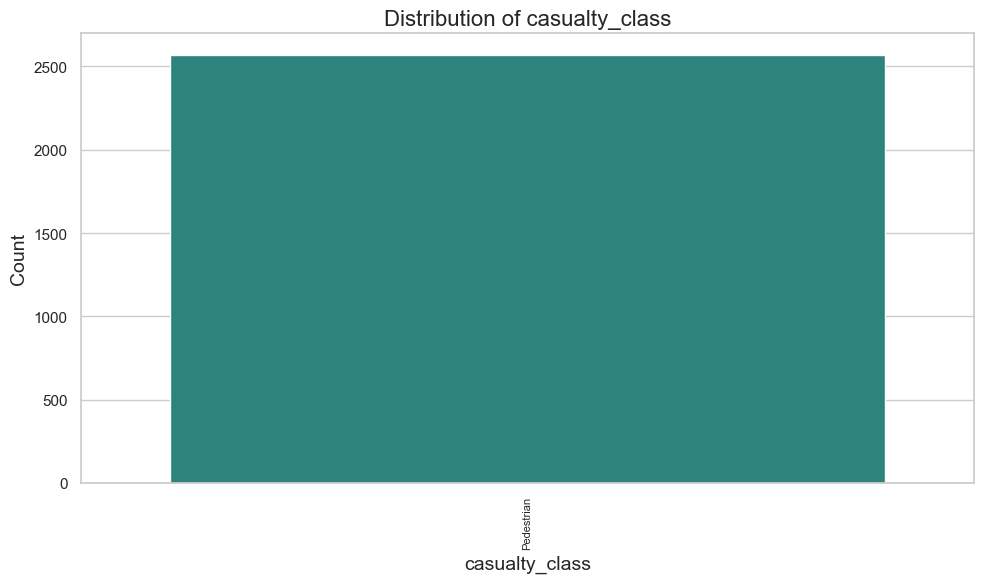

...

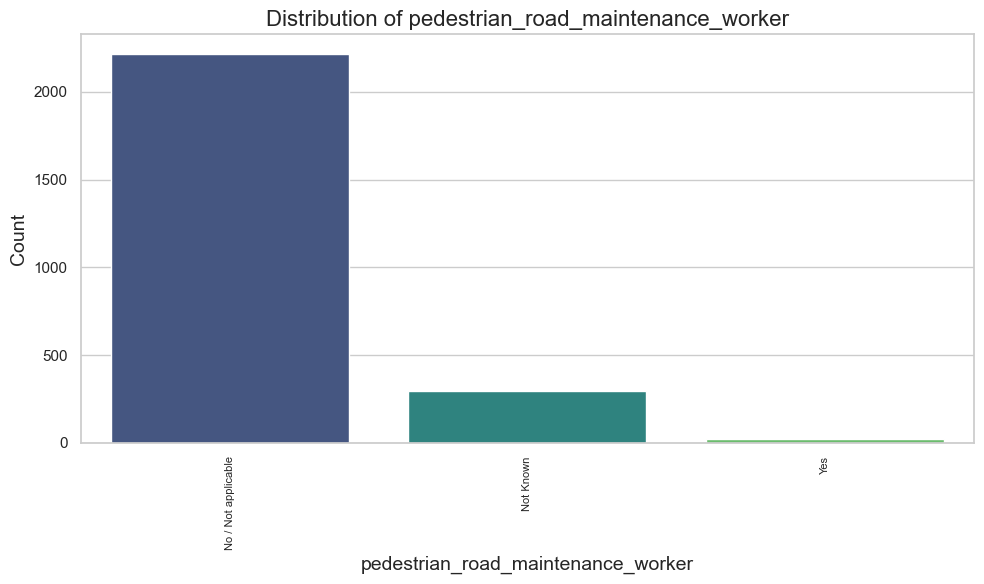

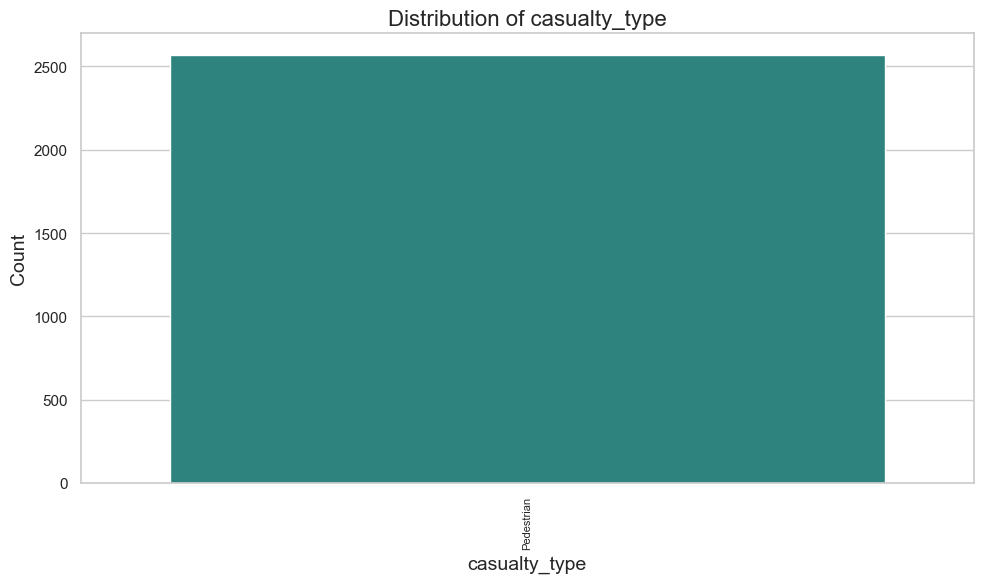

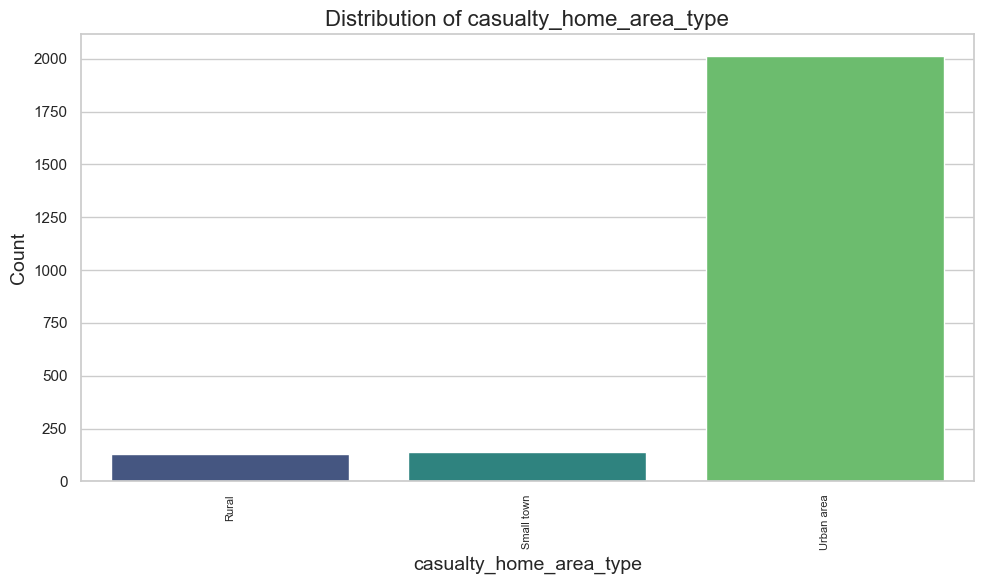

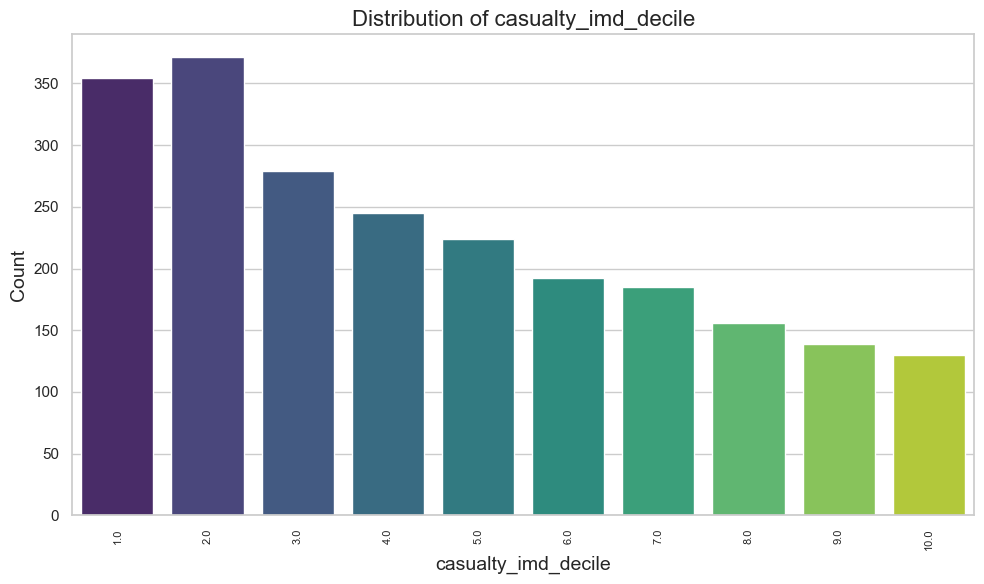

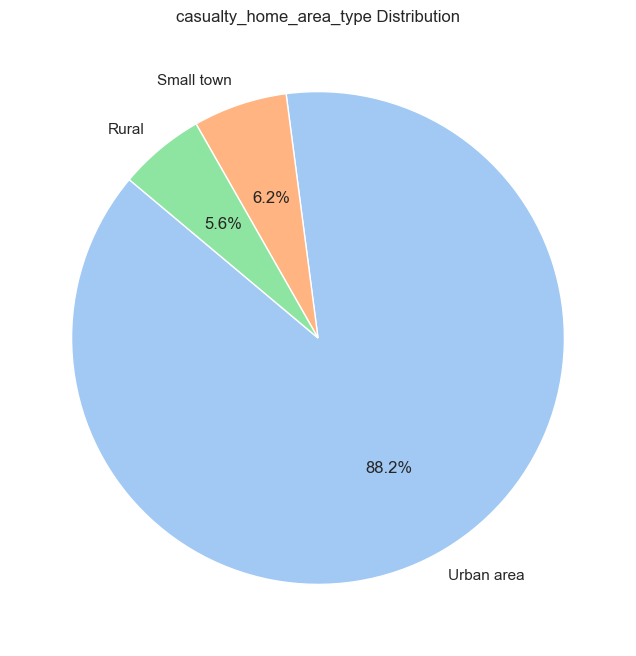

Plotting for Original DataFrame: df_pedestrians_FS


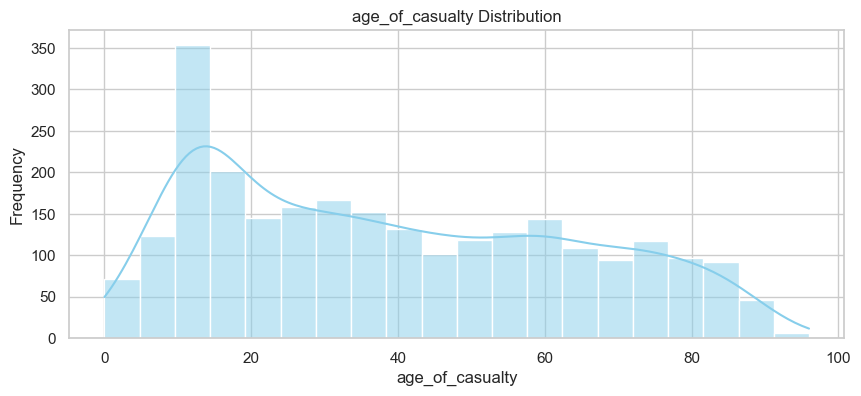

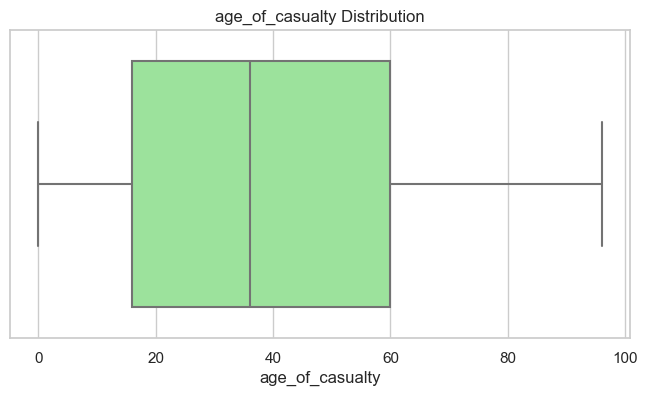

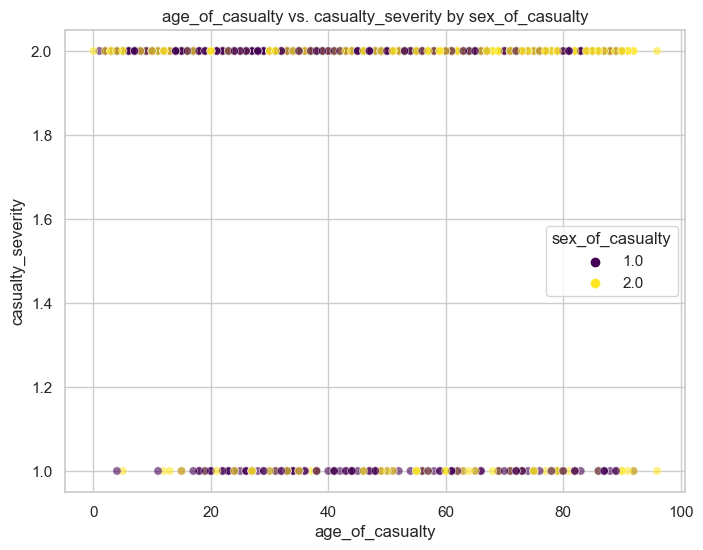

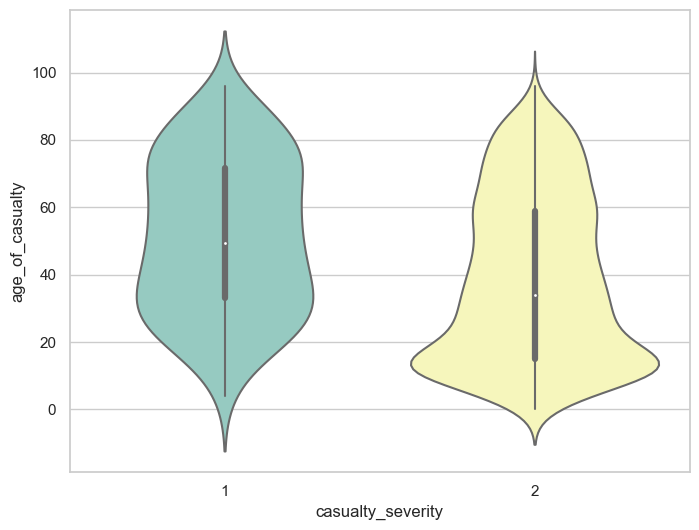

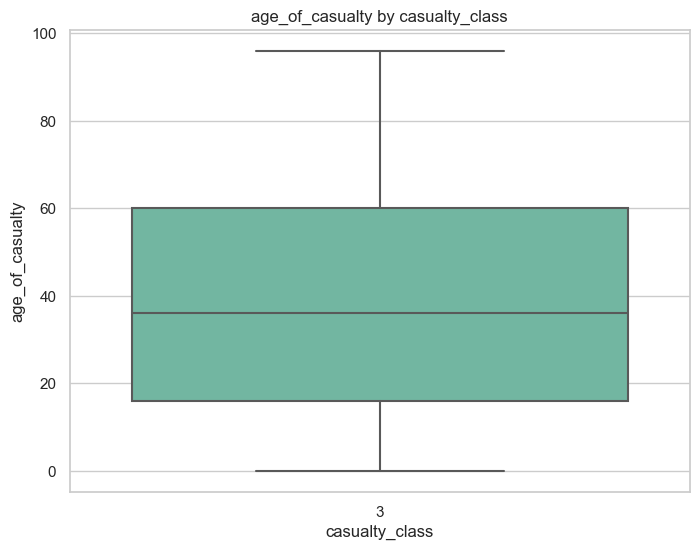

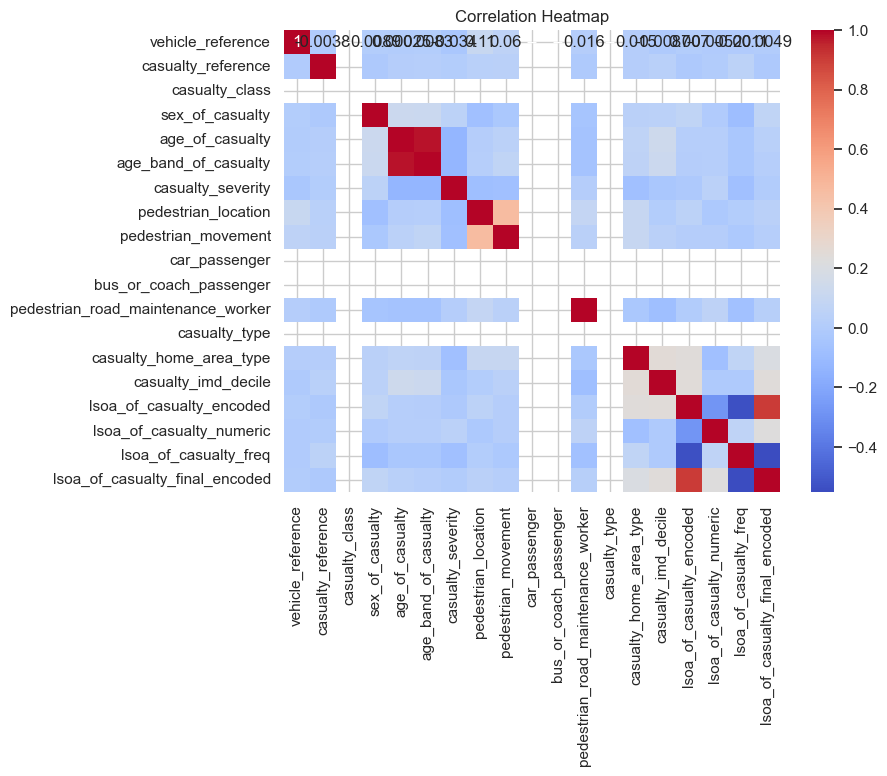

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
Plotting for Labeled DataFrame: df_pedestrians_fatal_labeled


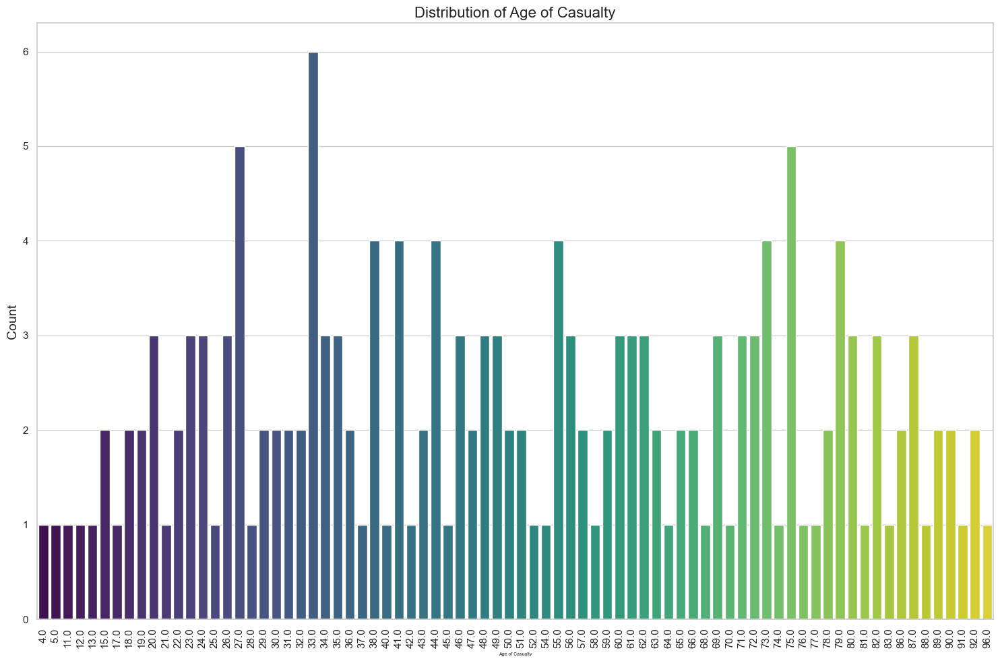

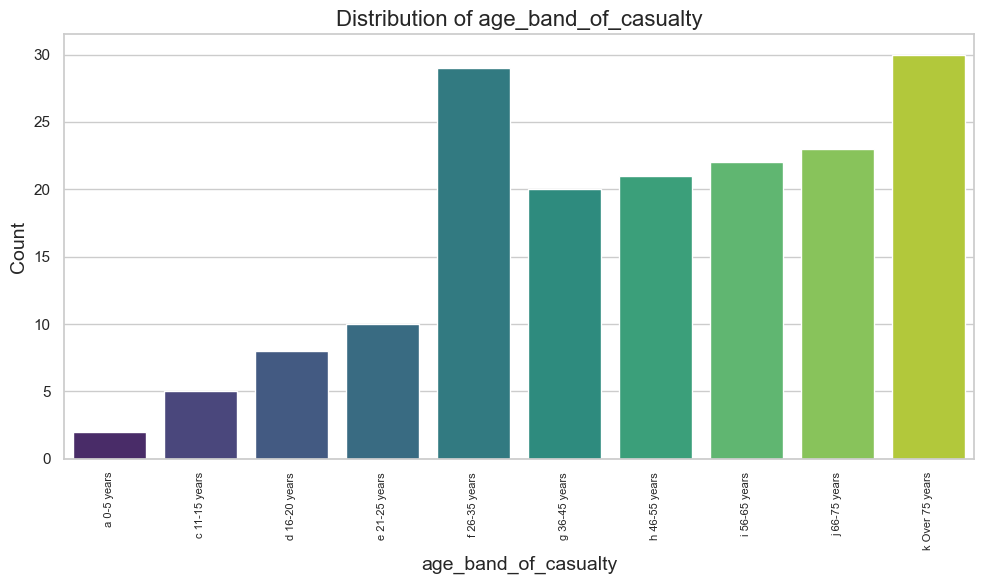

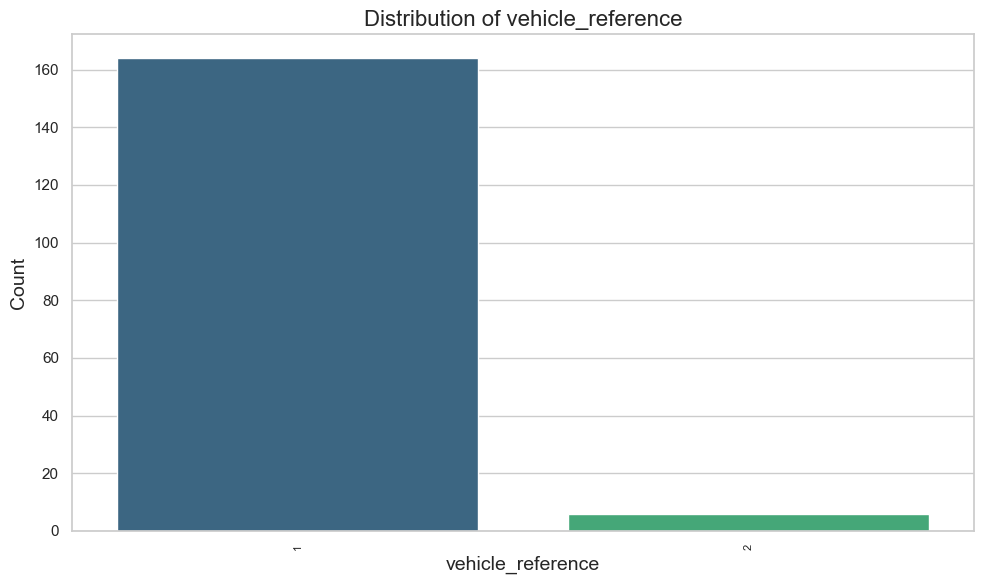

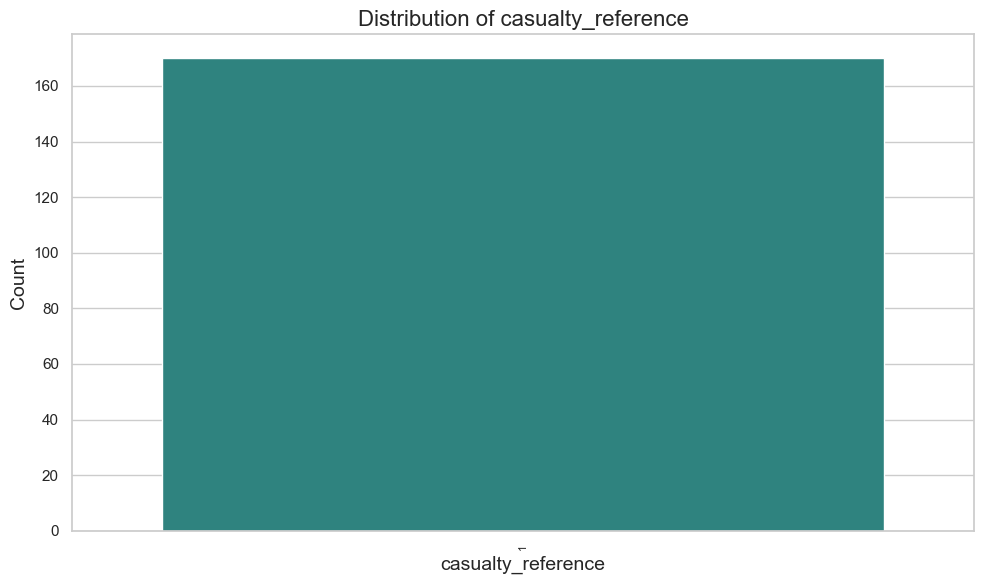

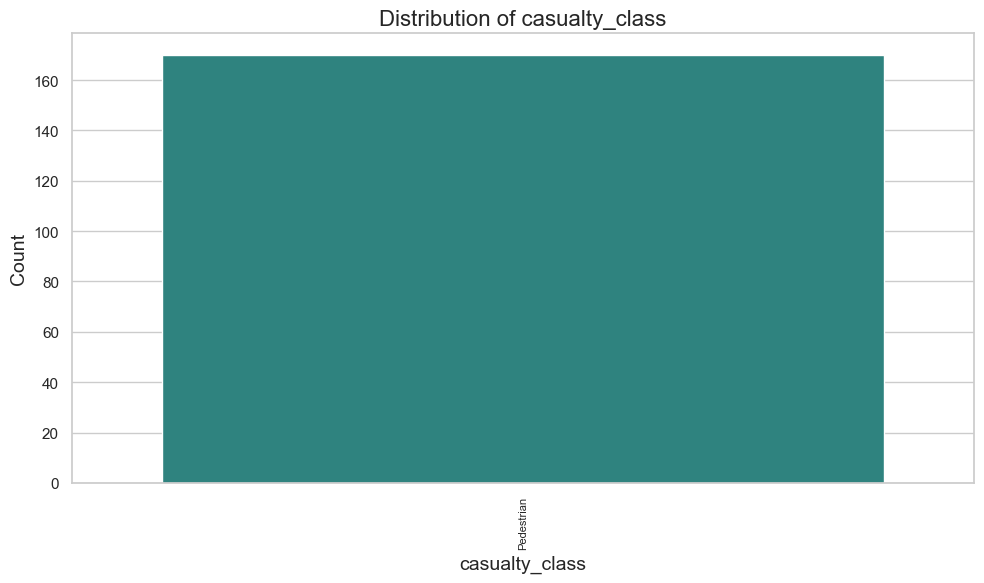

...

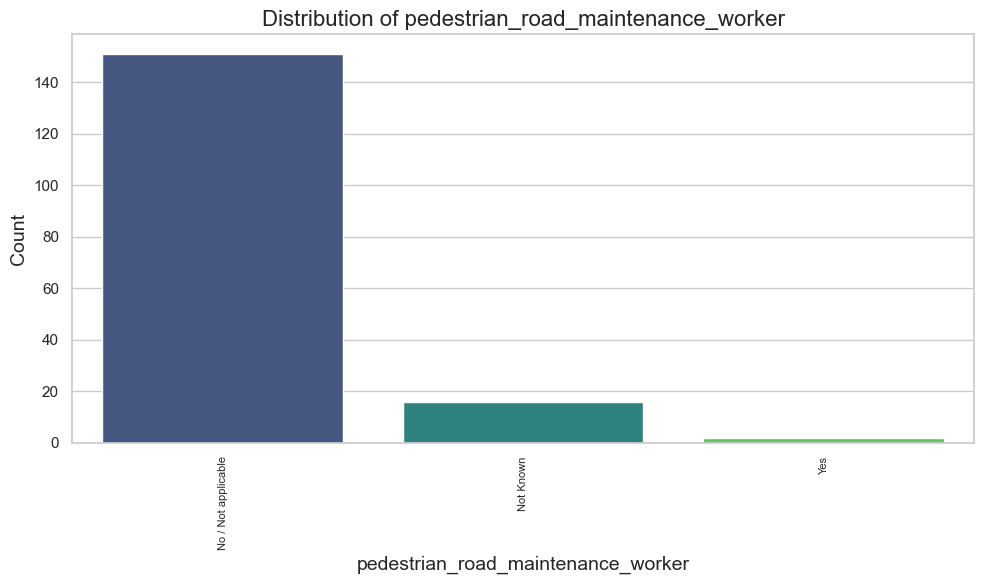

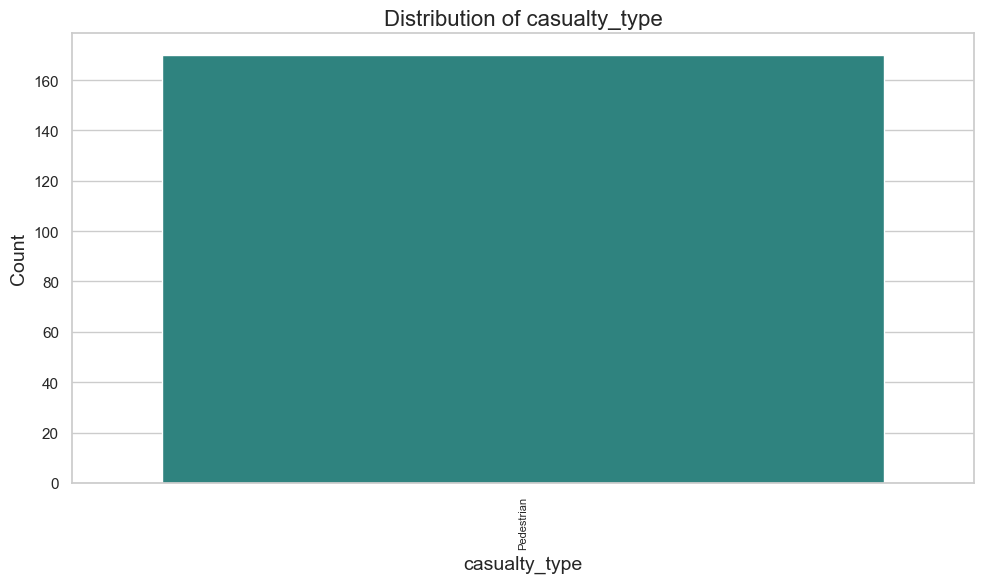

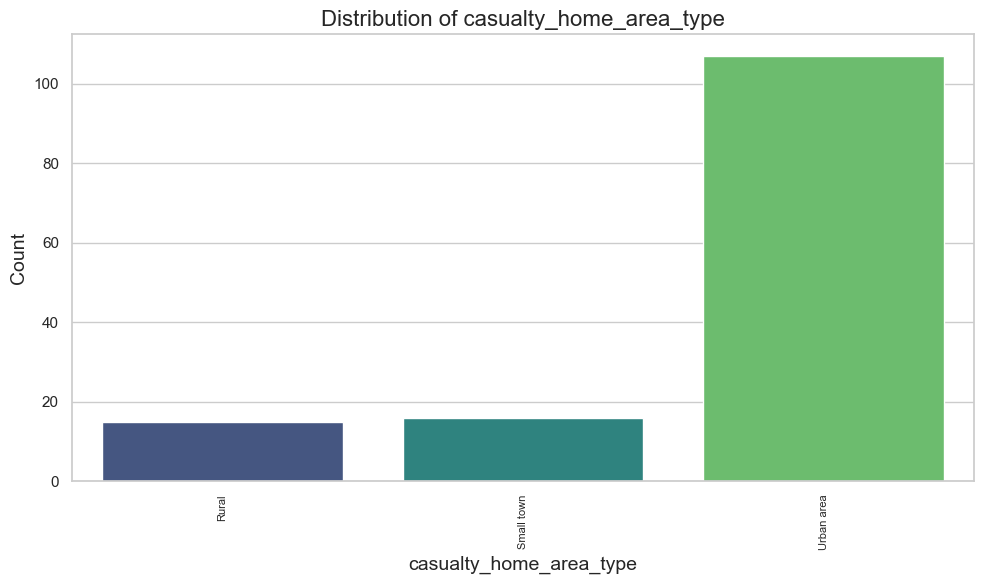

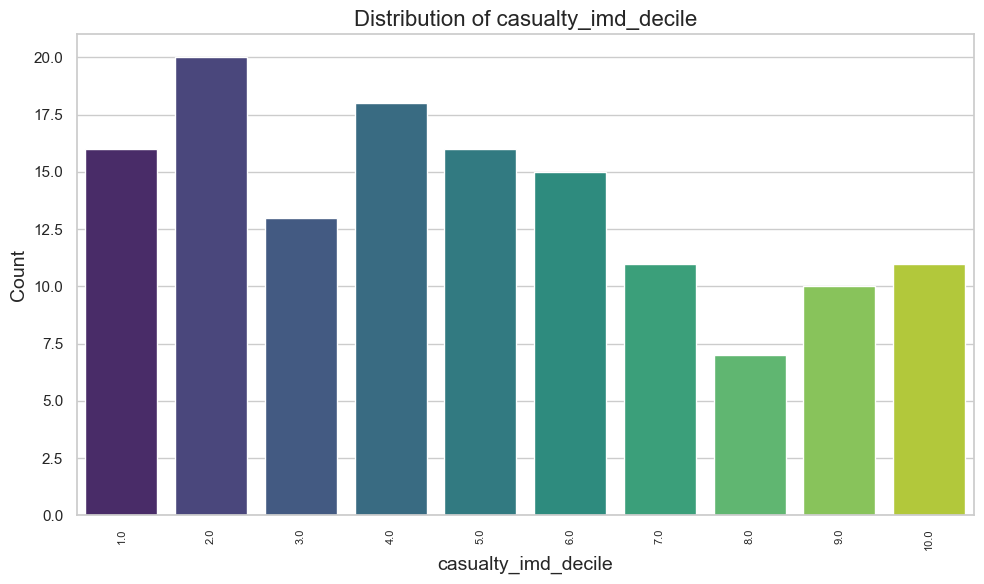

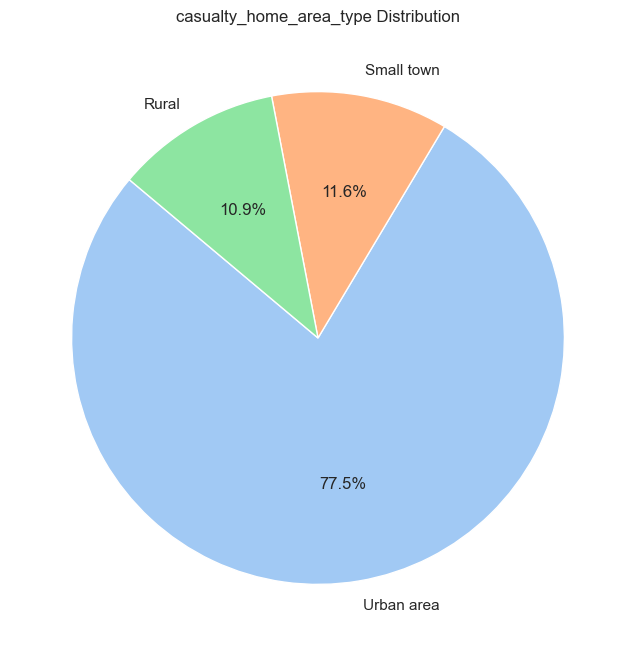

Plotting for Original DataFrame: df_pedestrians_fatal


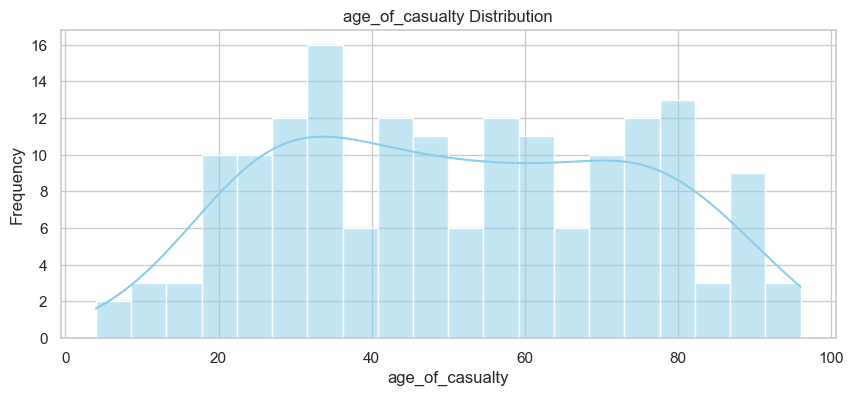

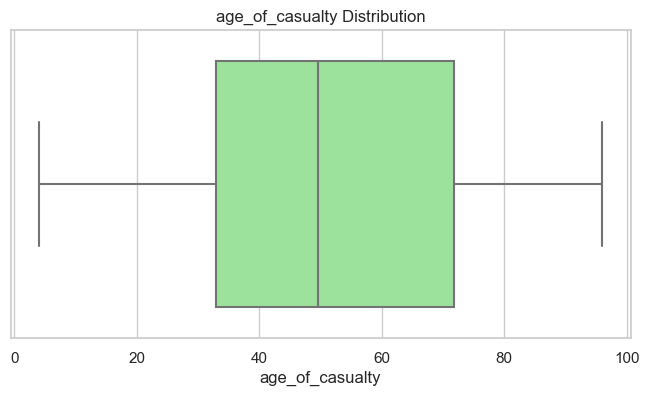

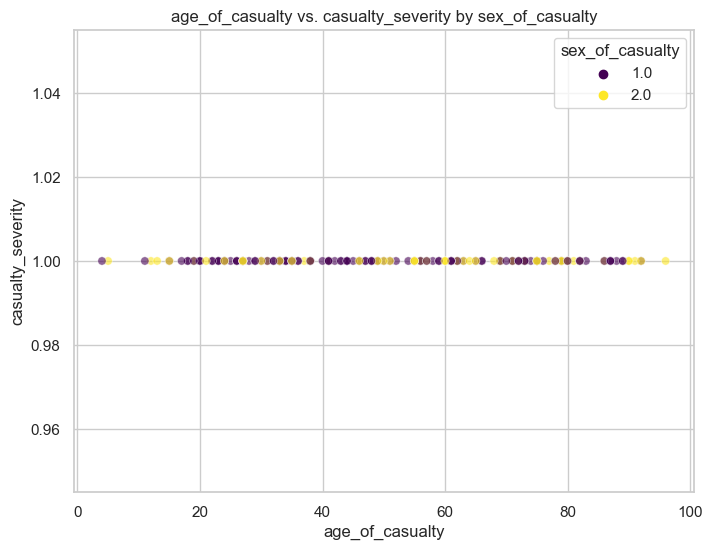

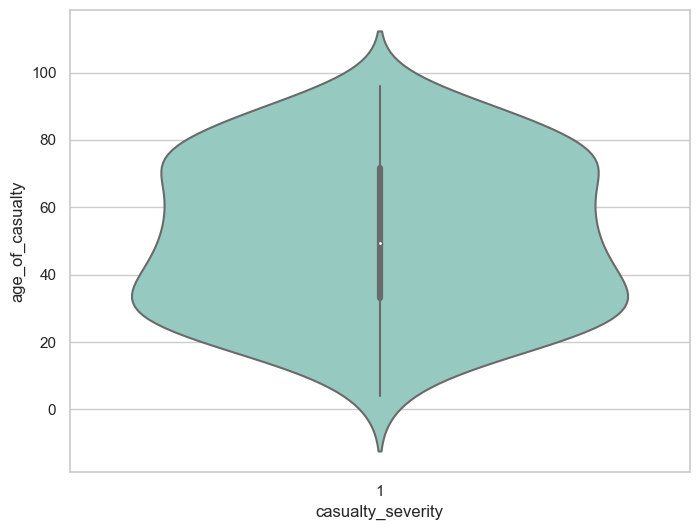

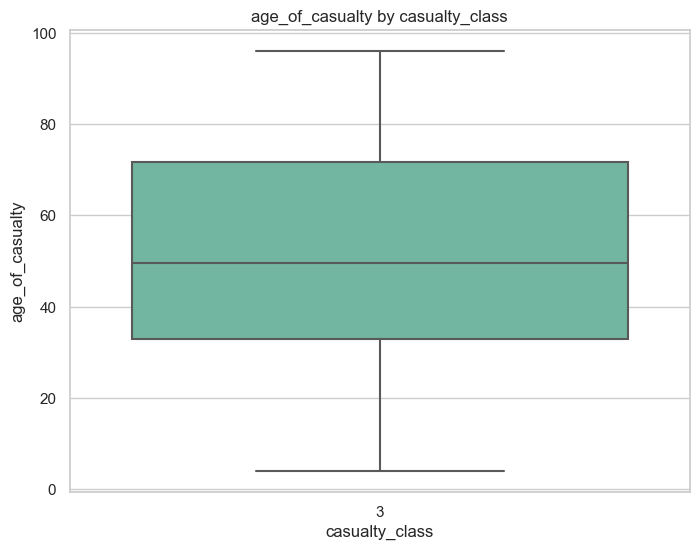

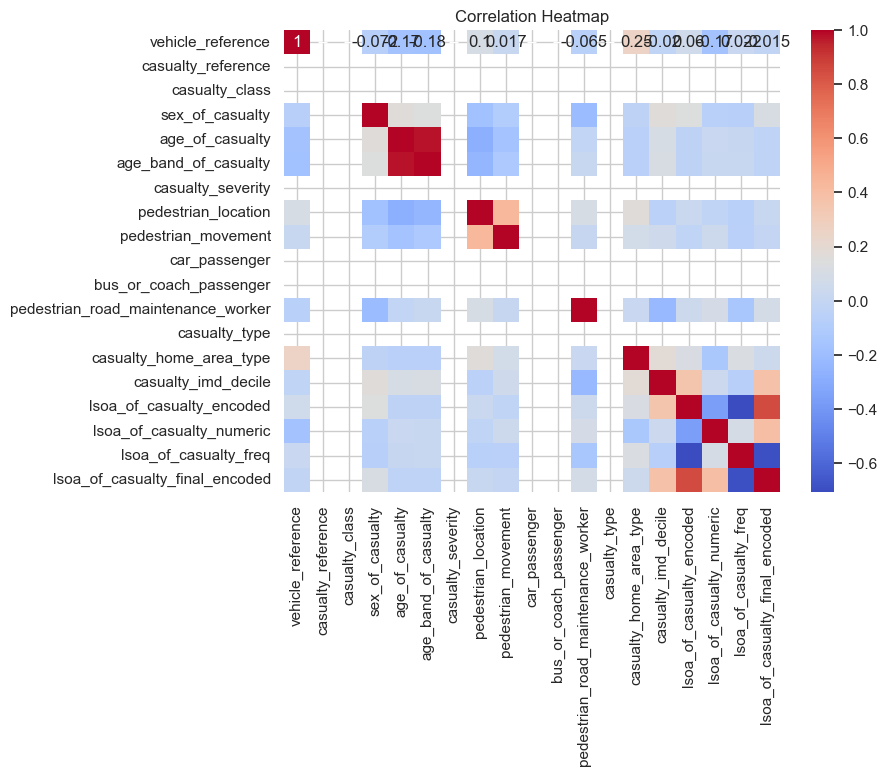

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
Plotting for Labeled DataFrame: df_drivers_labeled


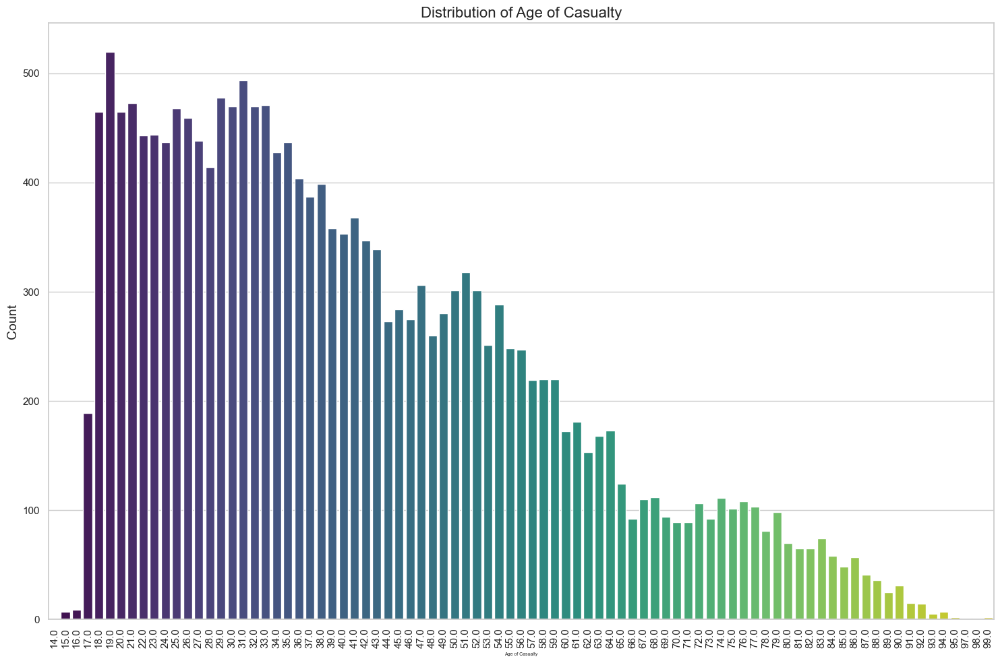

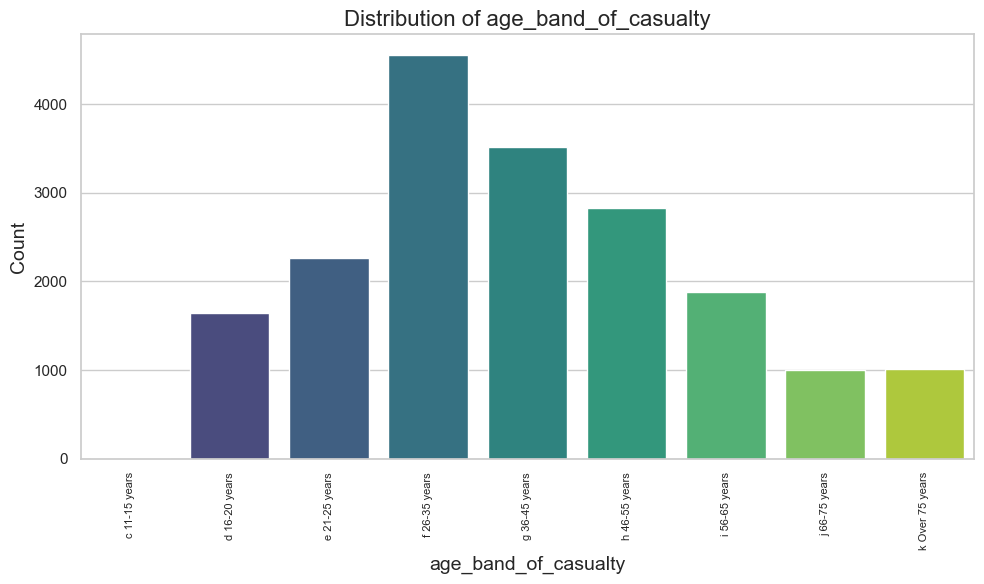

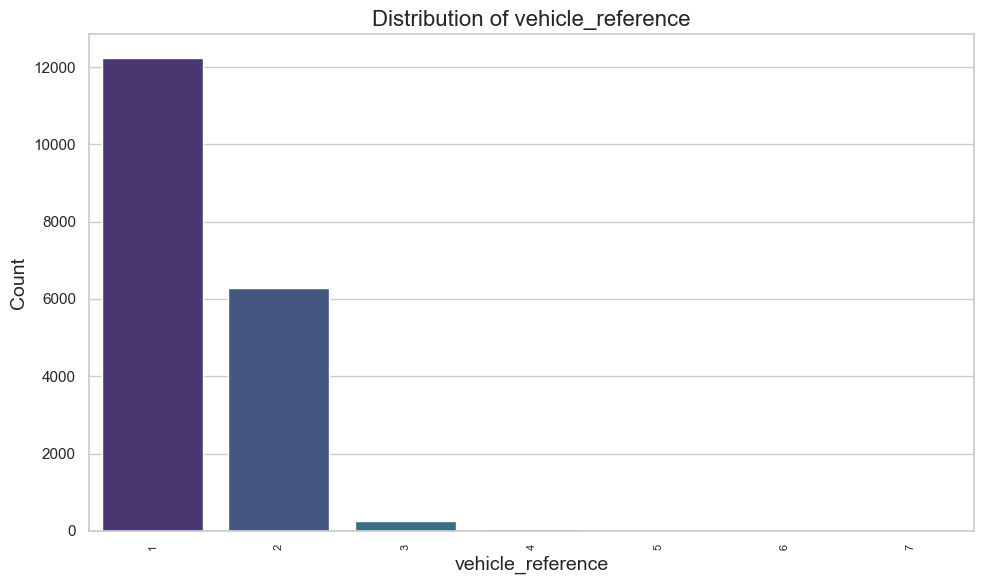

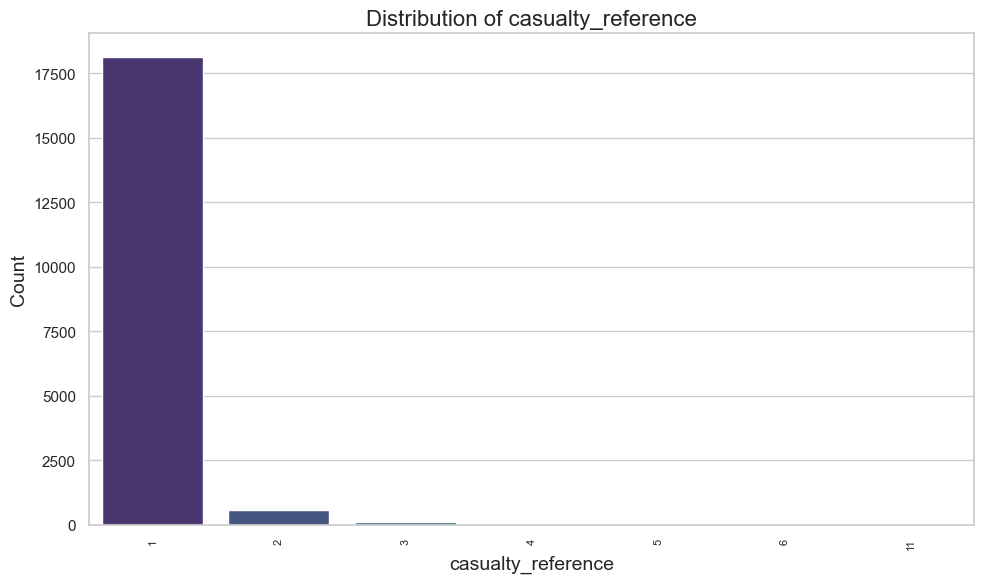

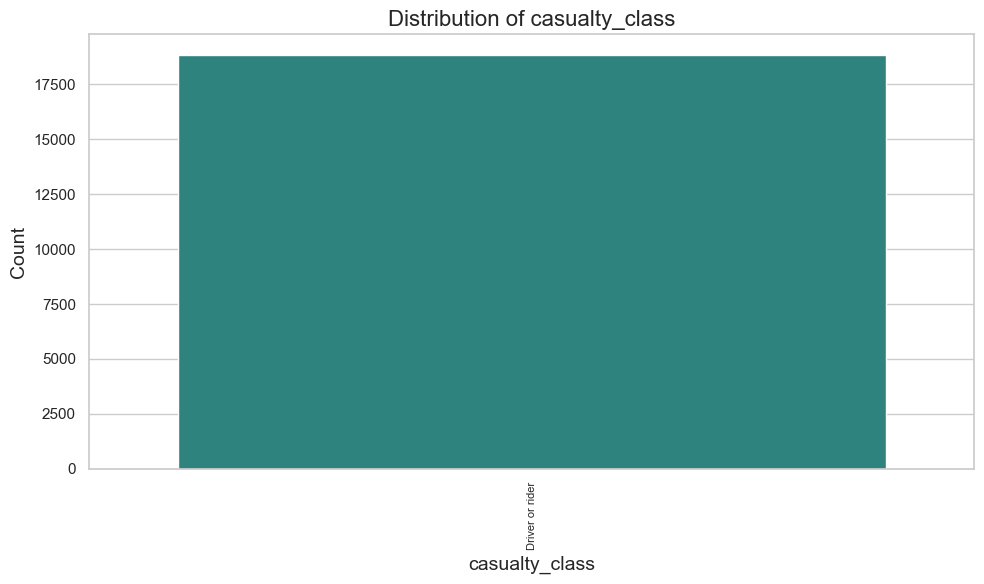

...

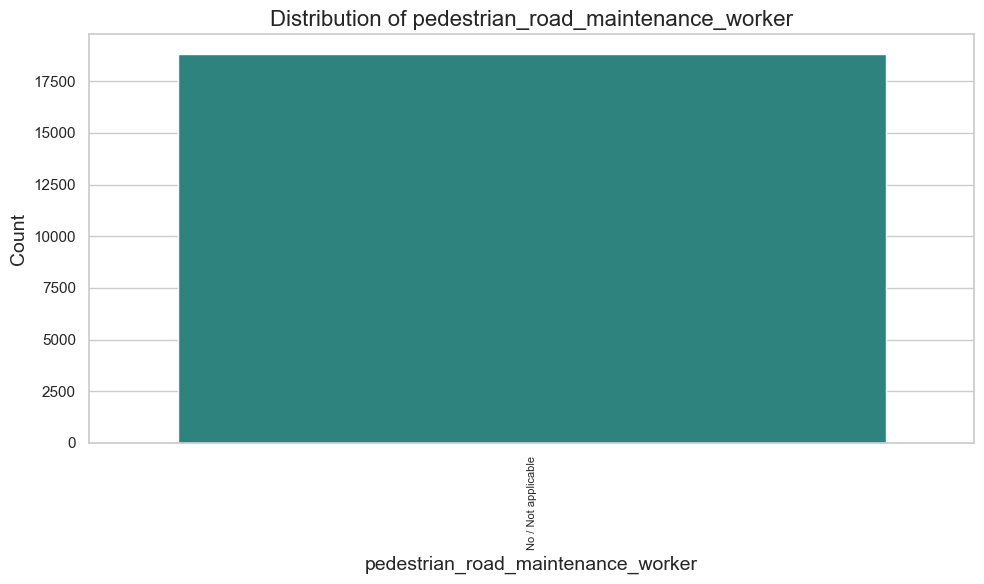

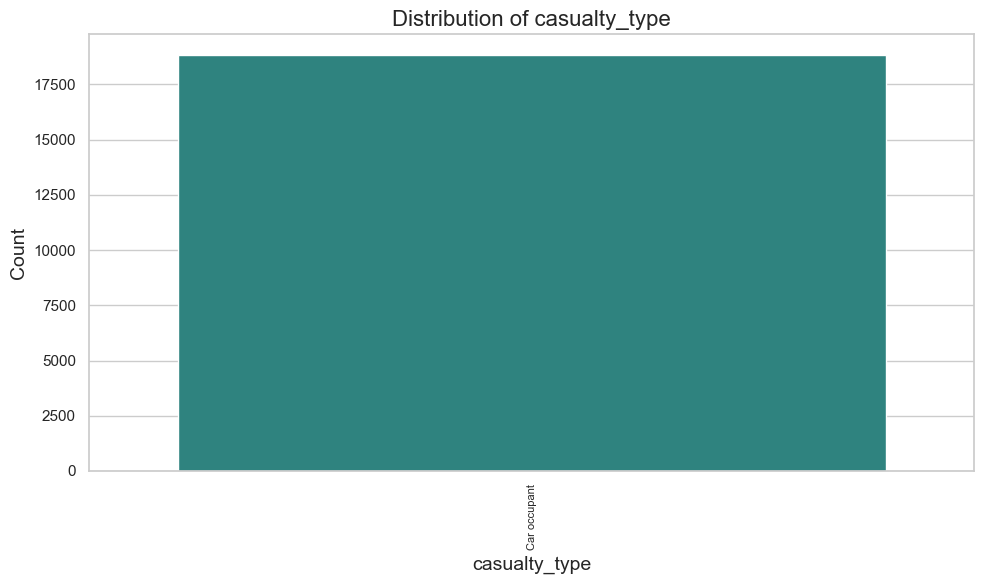

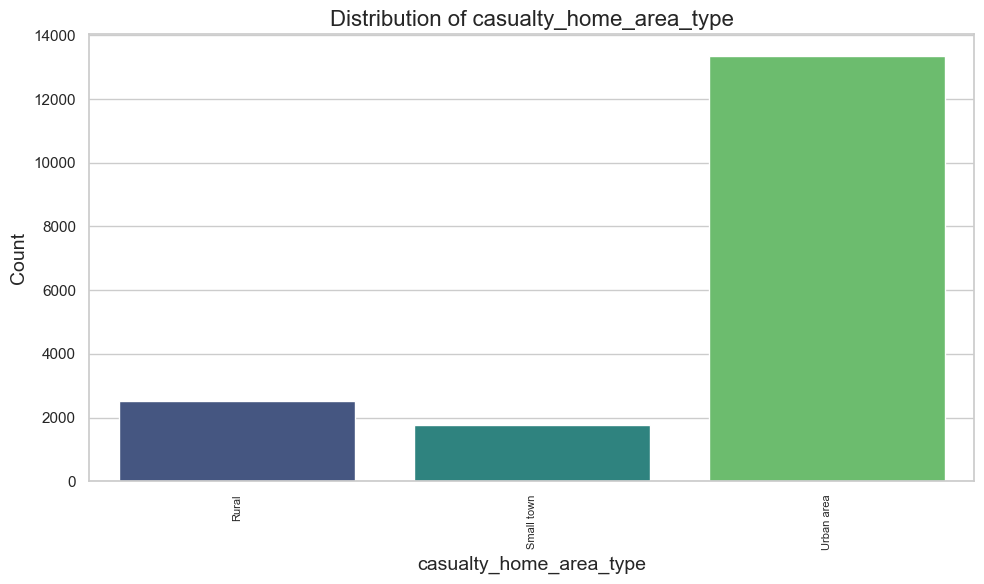

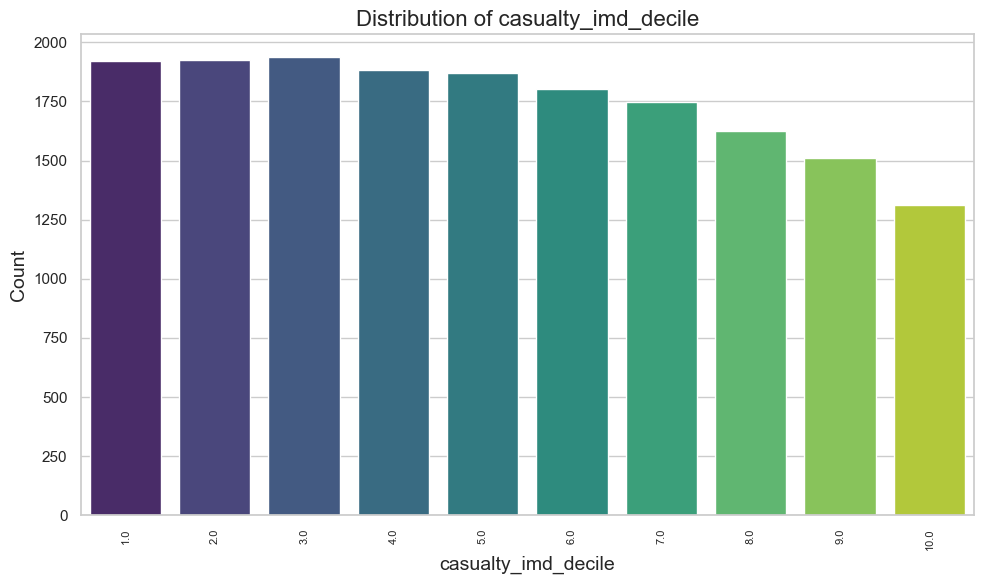

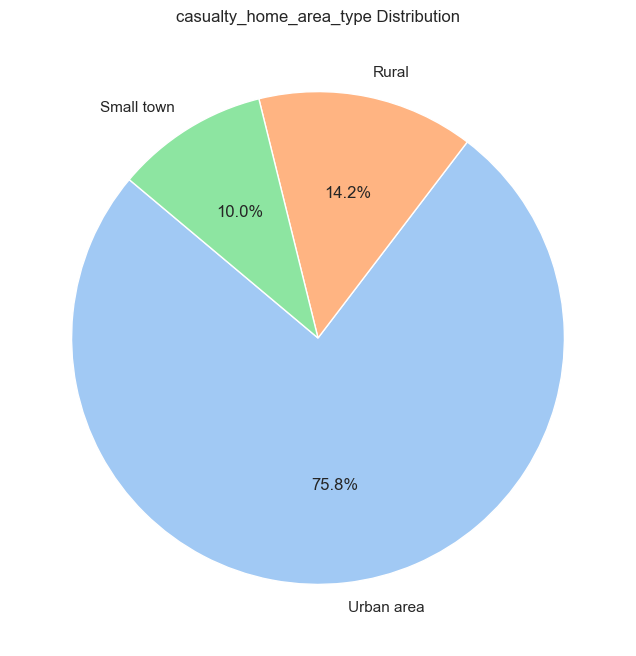

Plotting for Original DataFrame: df_drivers


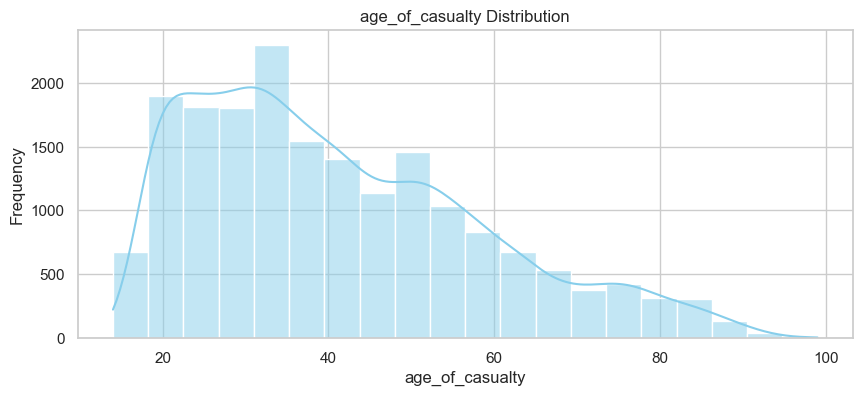

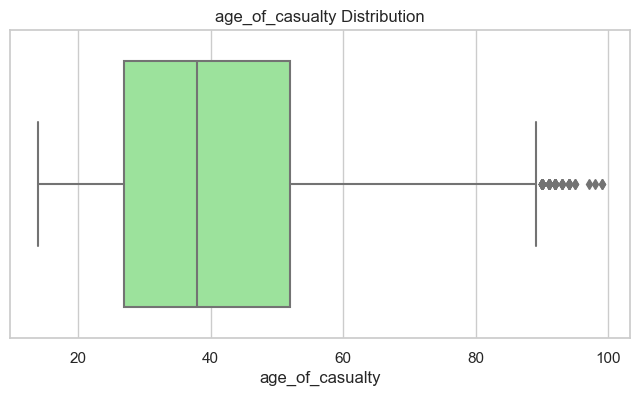

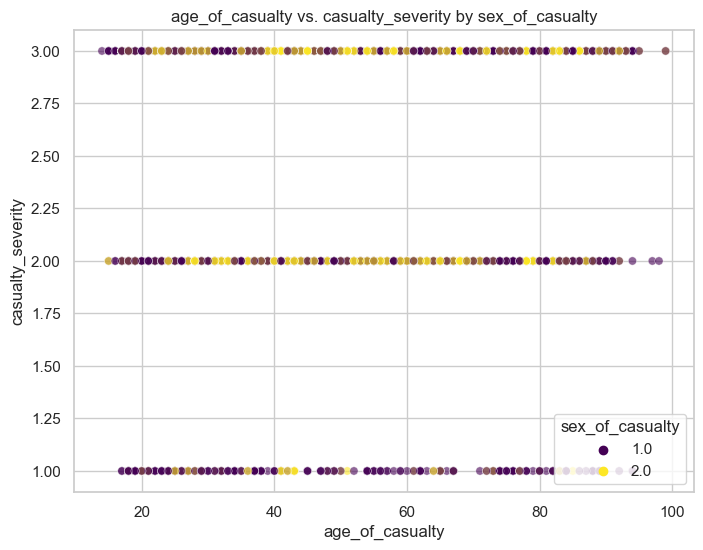

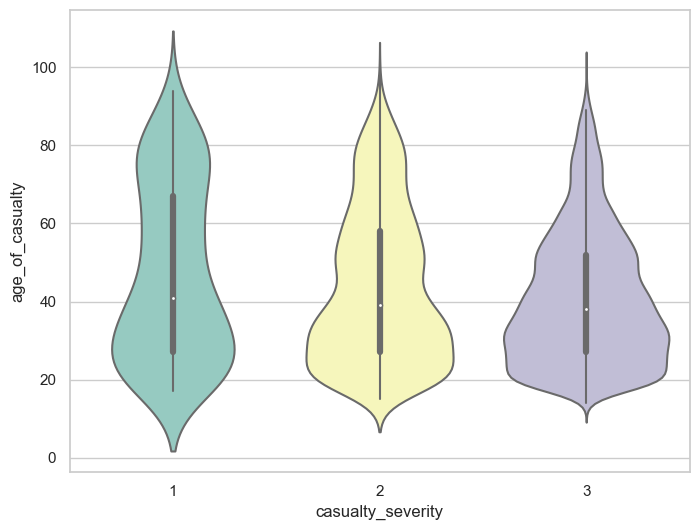

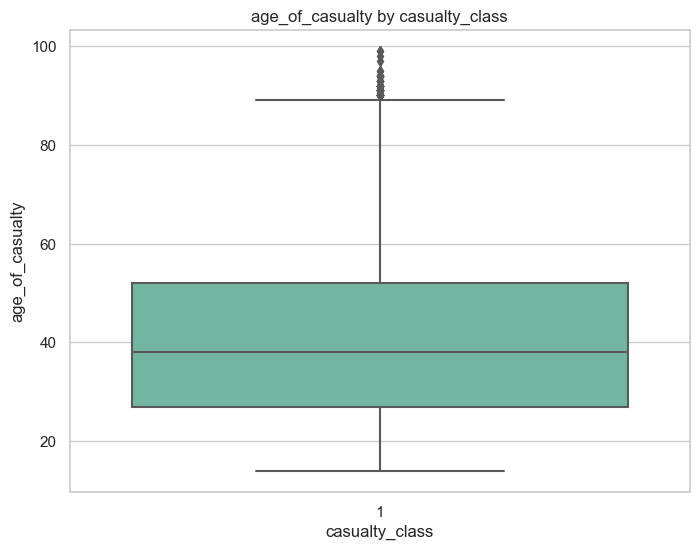

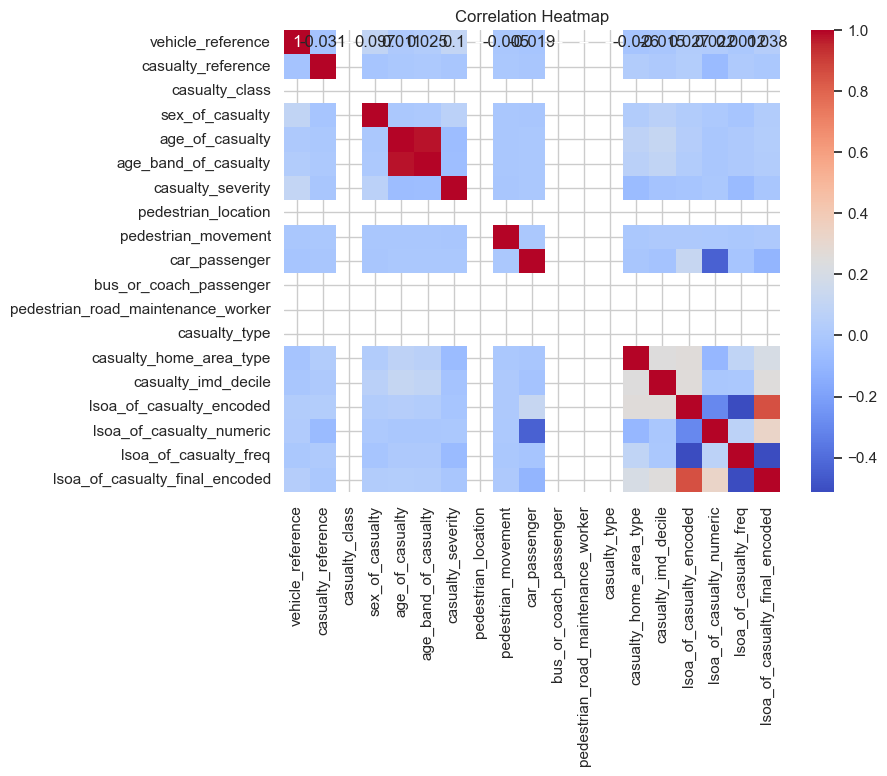

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
Plotting for Labeled DataFrame: df_drivers_FS_labeled


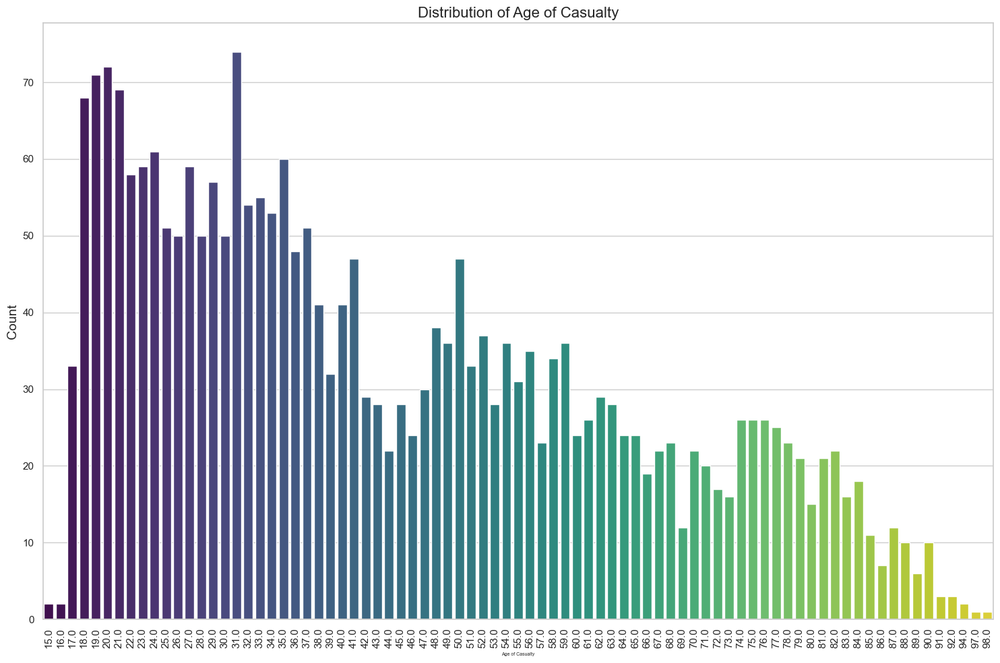

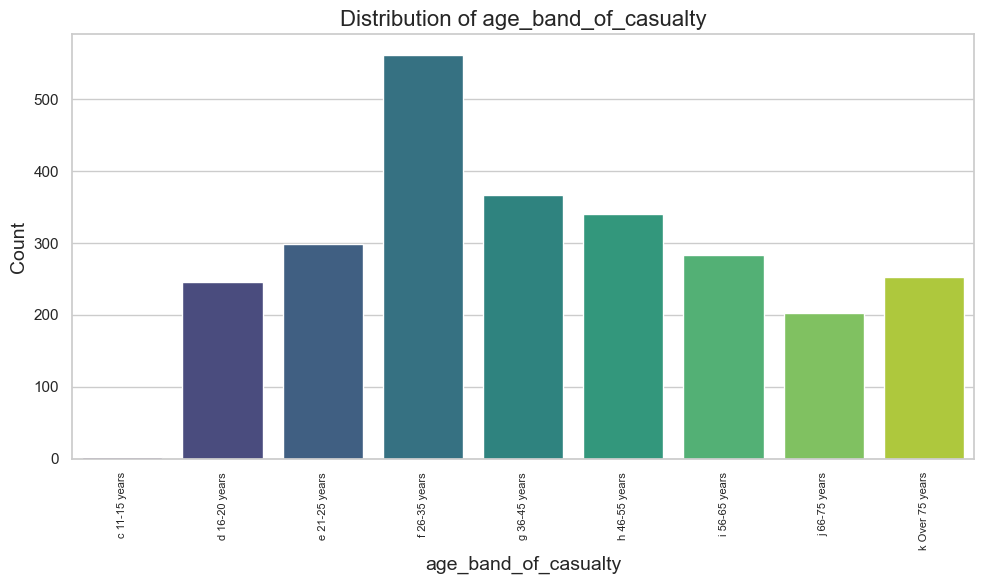

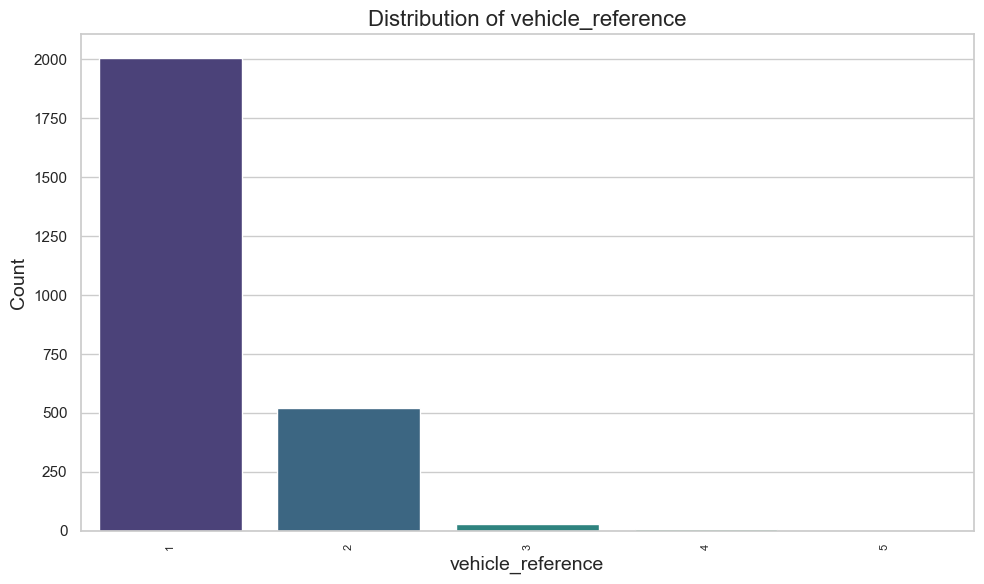

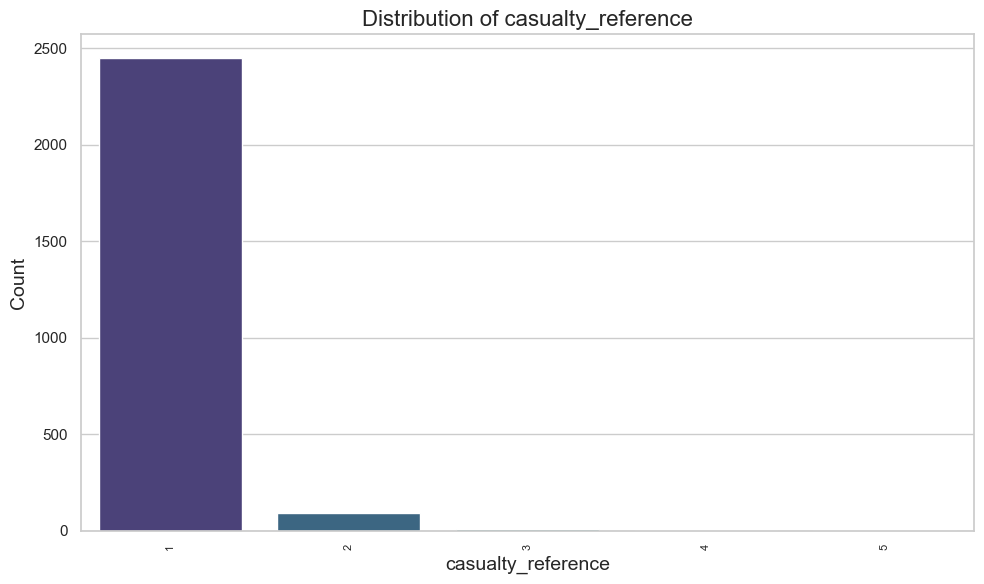

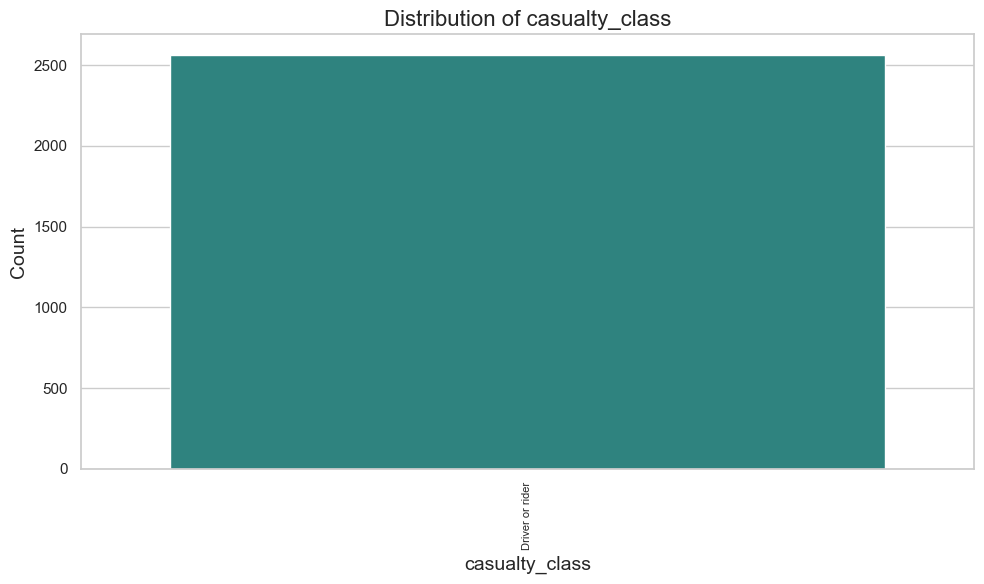

...

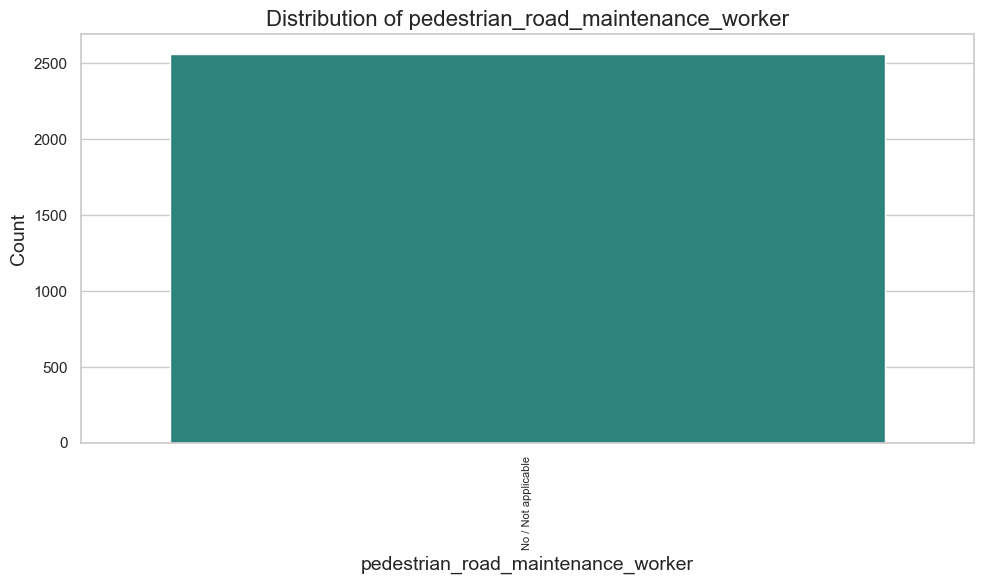

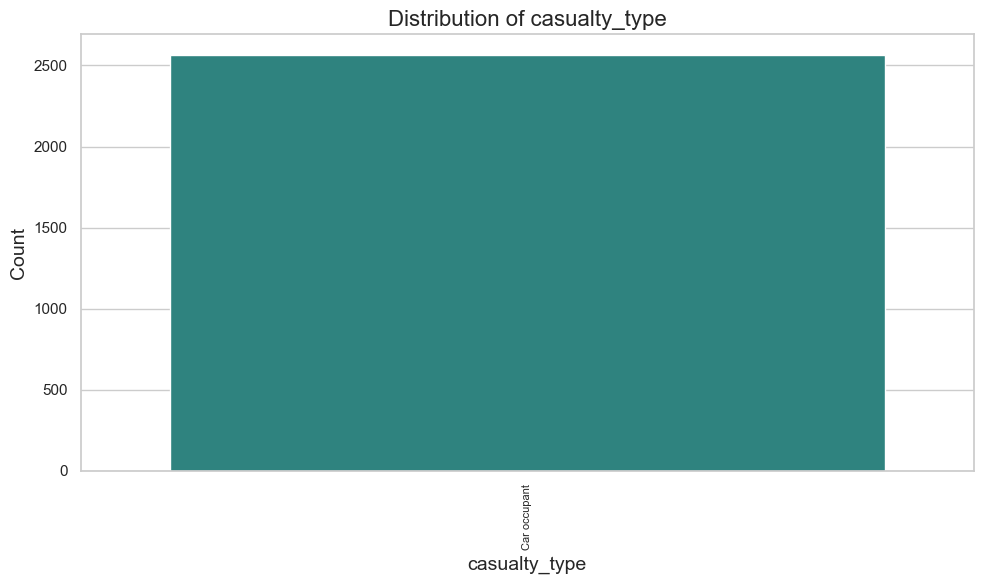

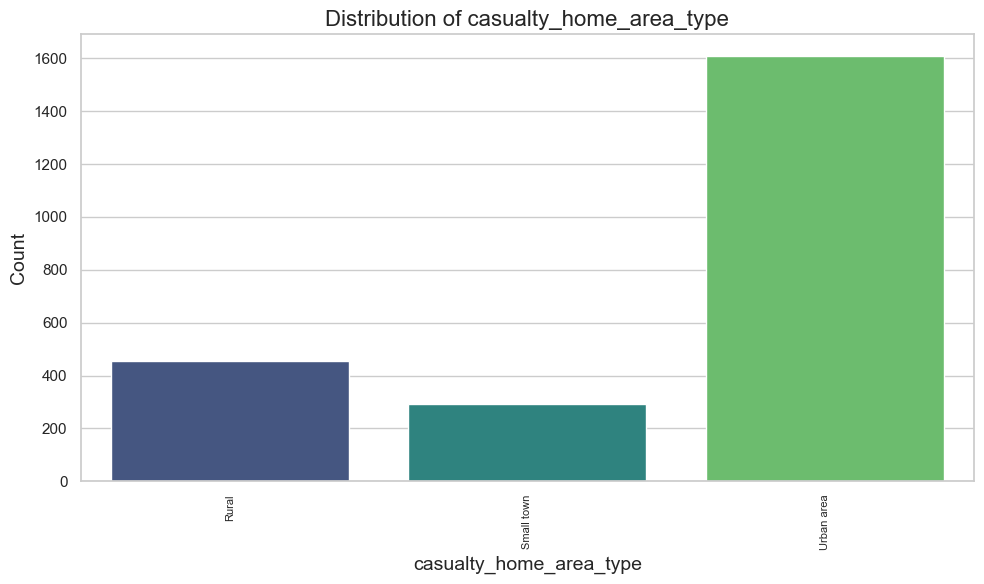

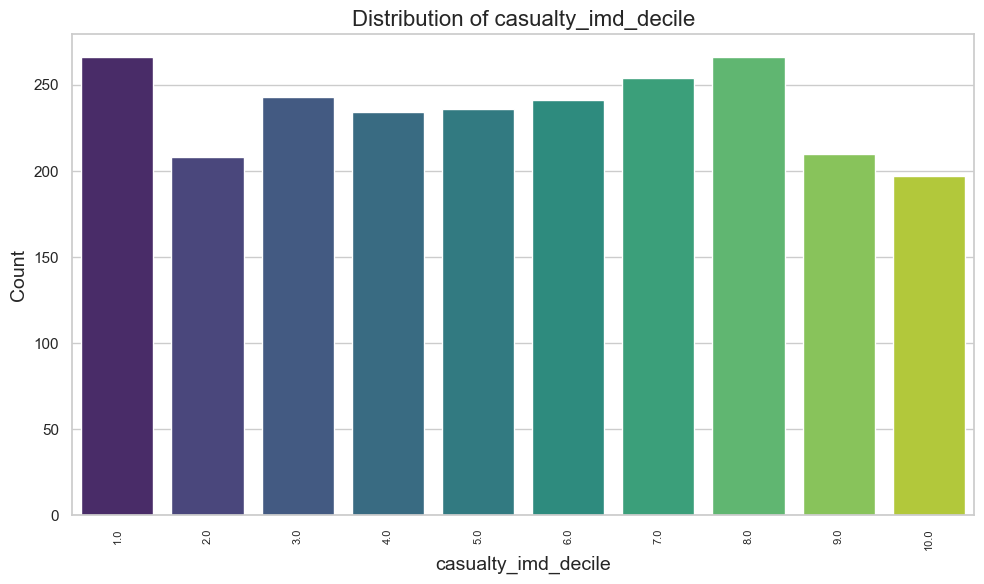

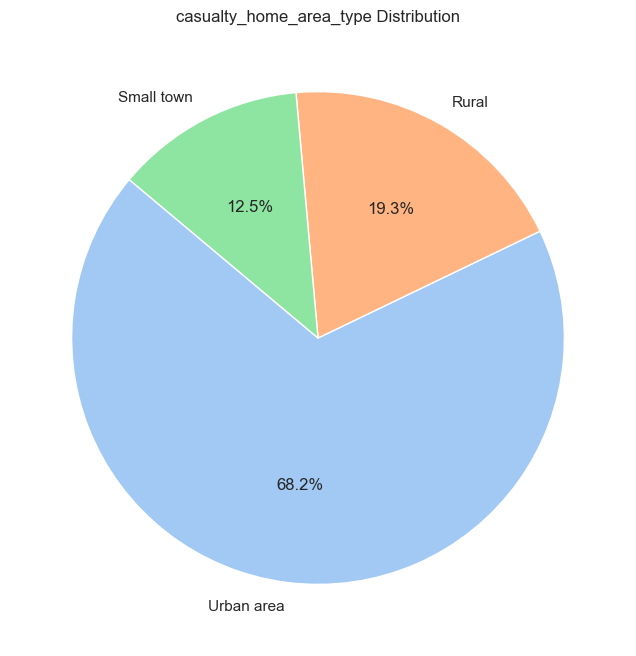

Plotting for Original DataFrame: df_drivers_FS


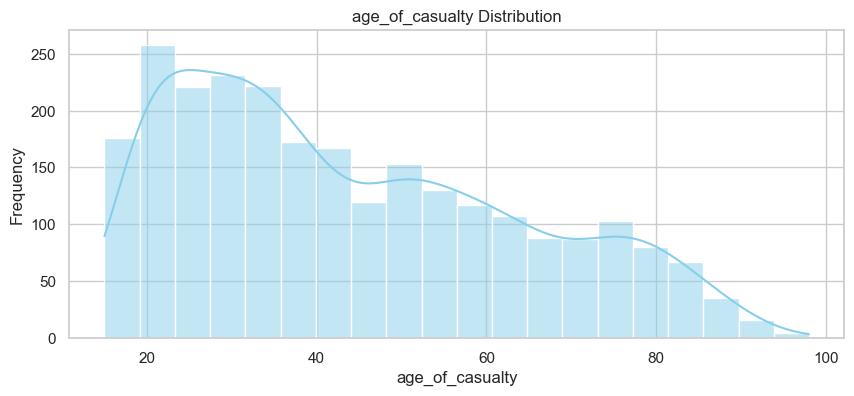

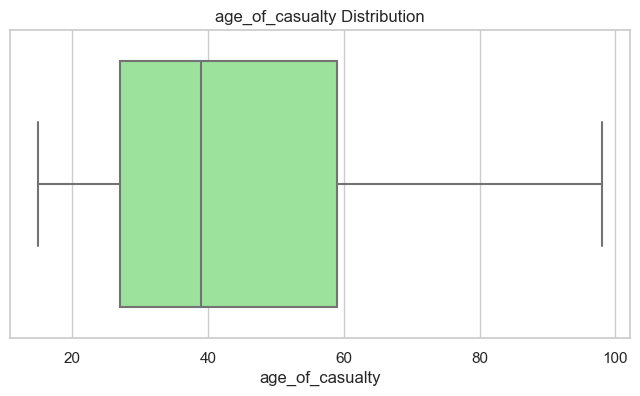

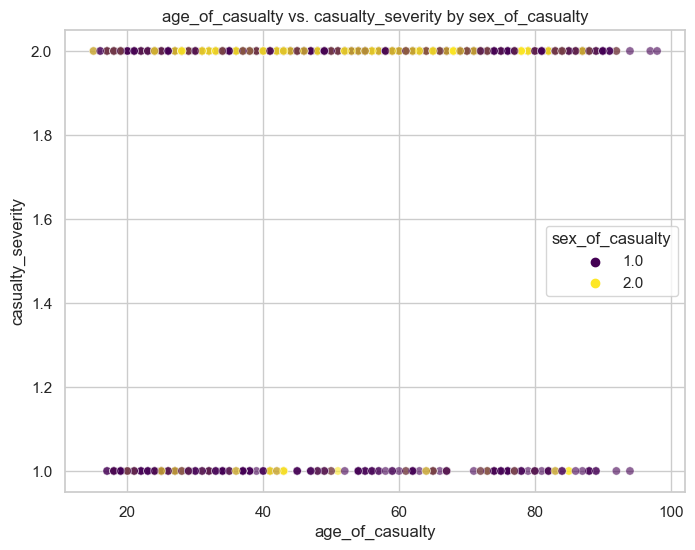

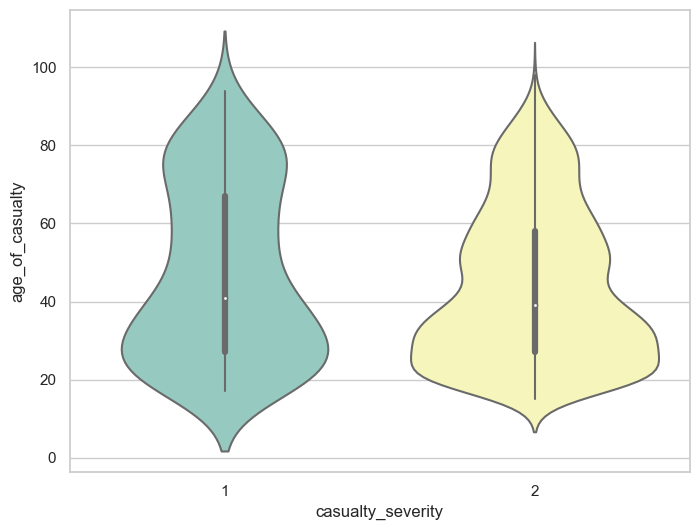

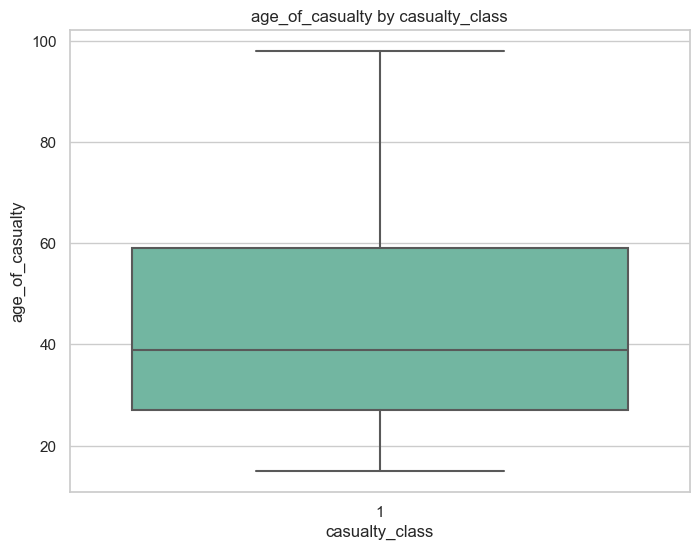

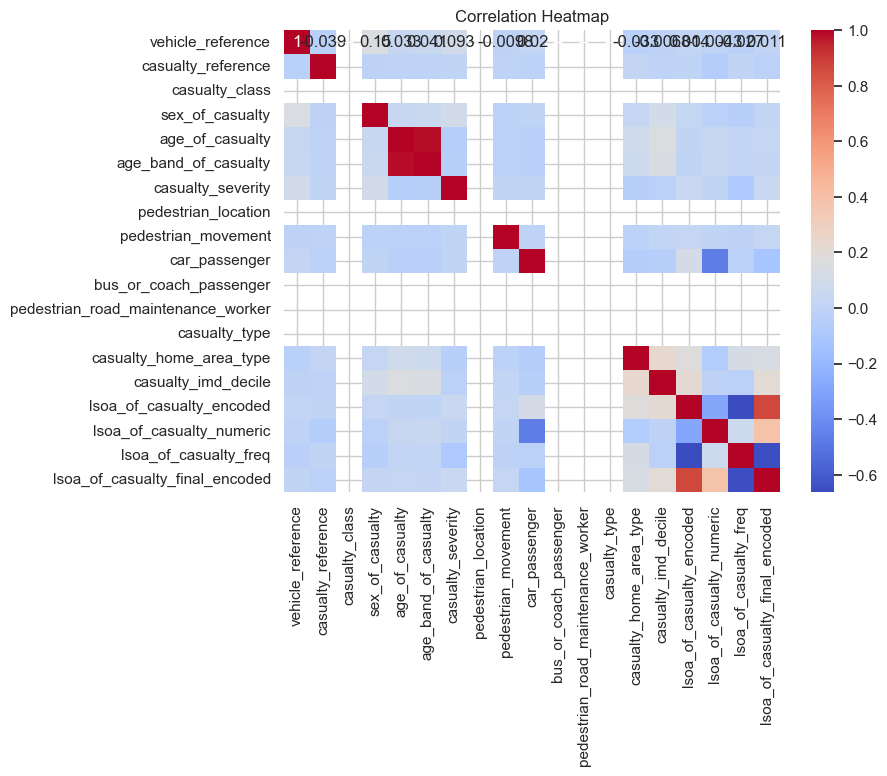

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
Plotting for Labeled DataFrame: df_drivers_fatal_labeled


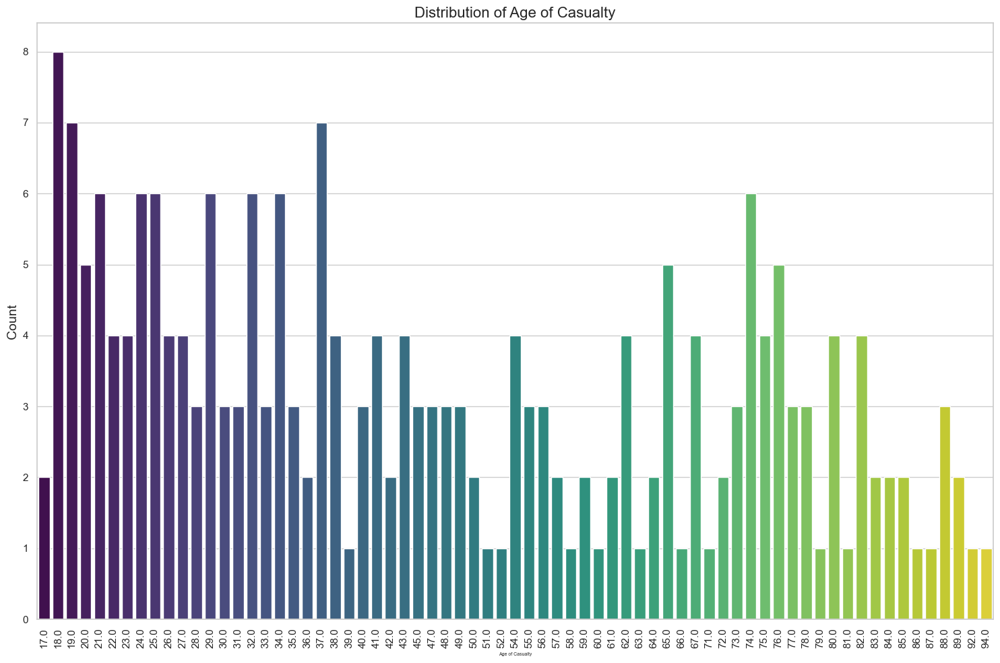

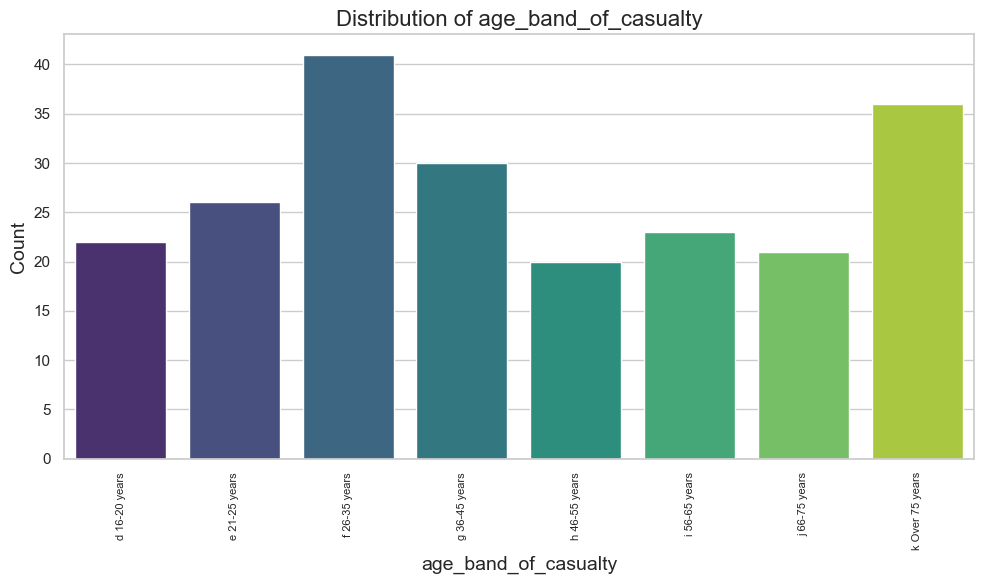

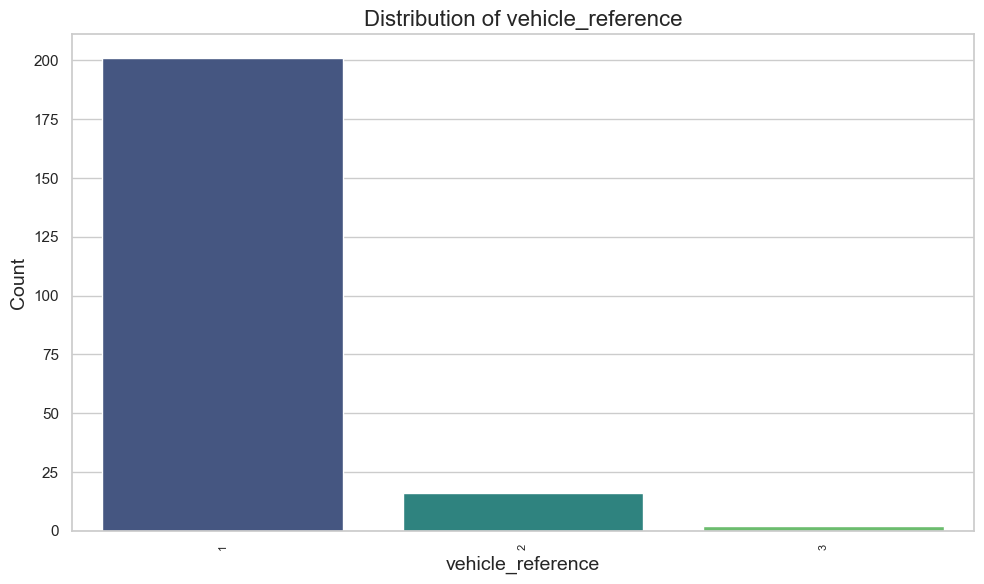

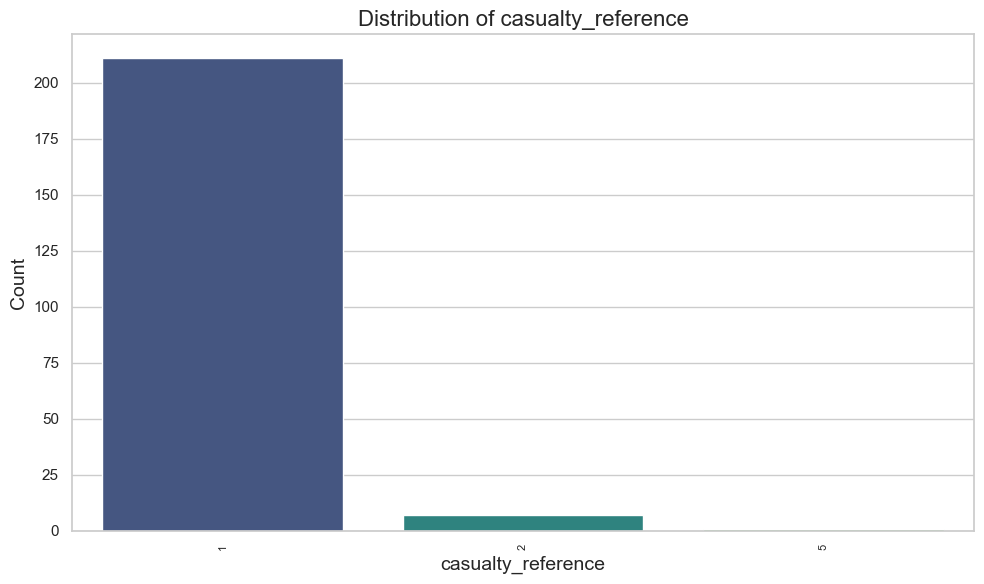

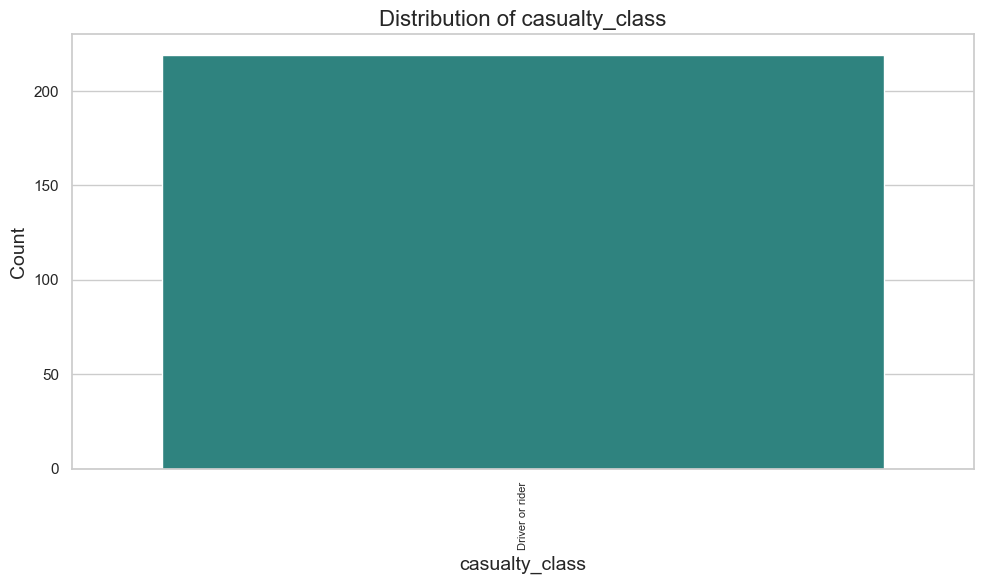

...

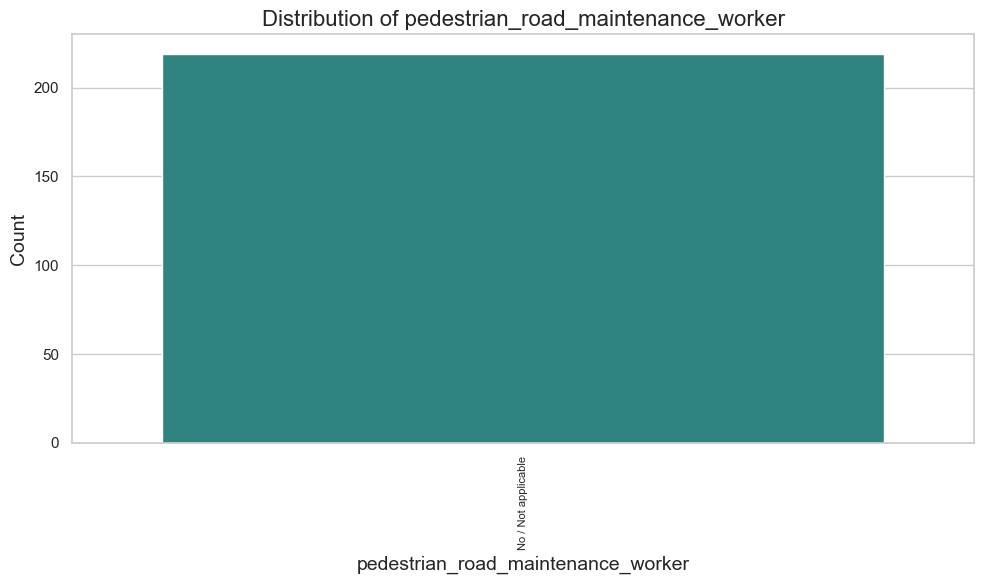

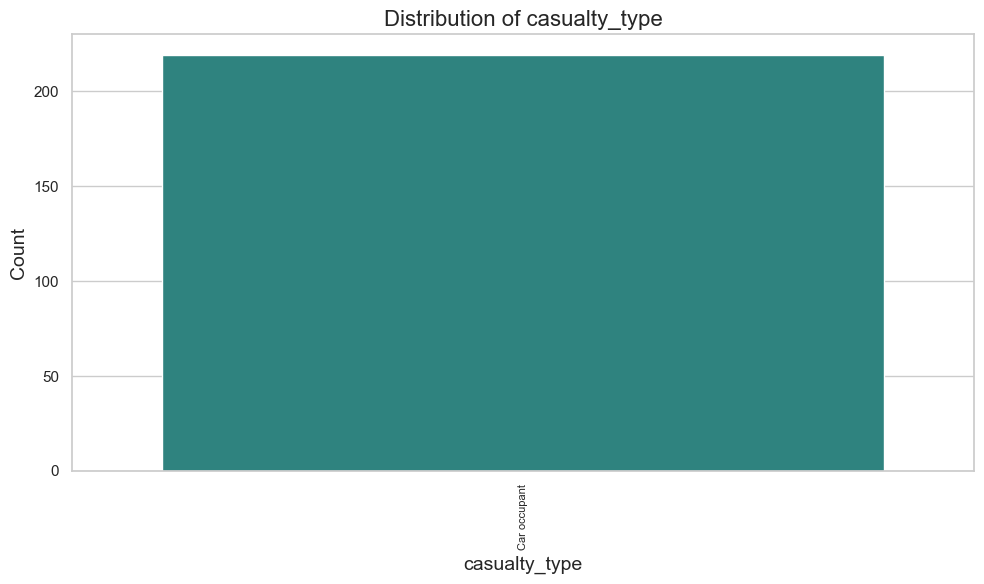

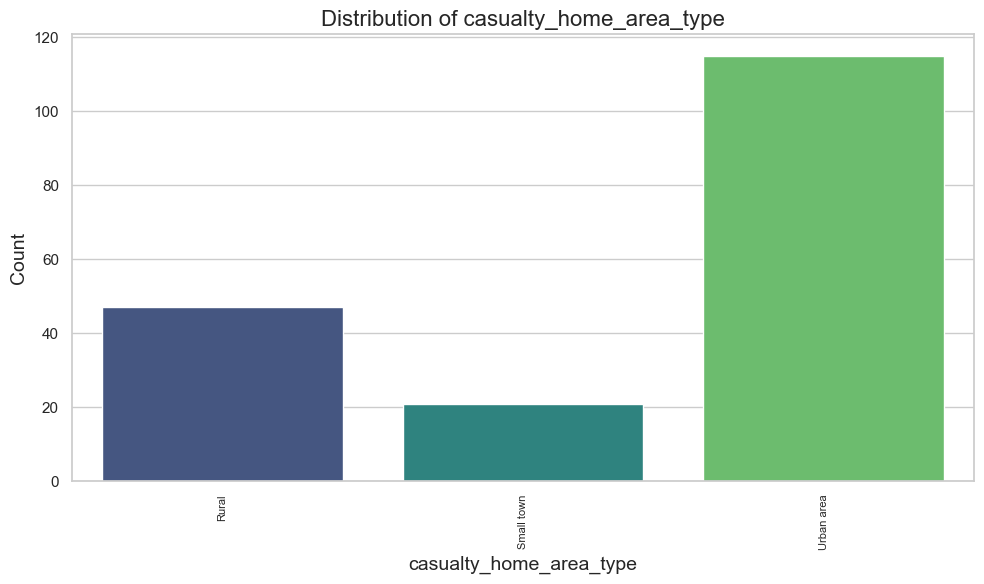

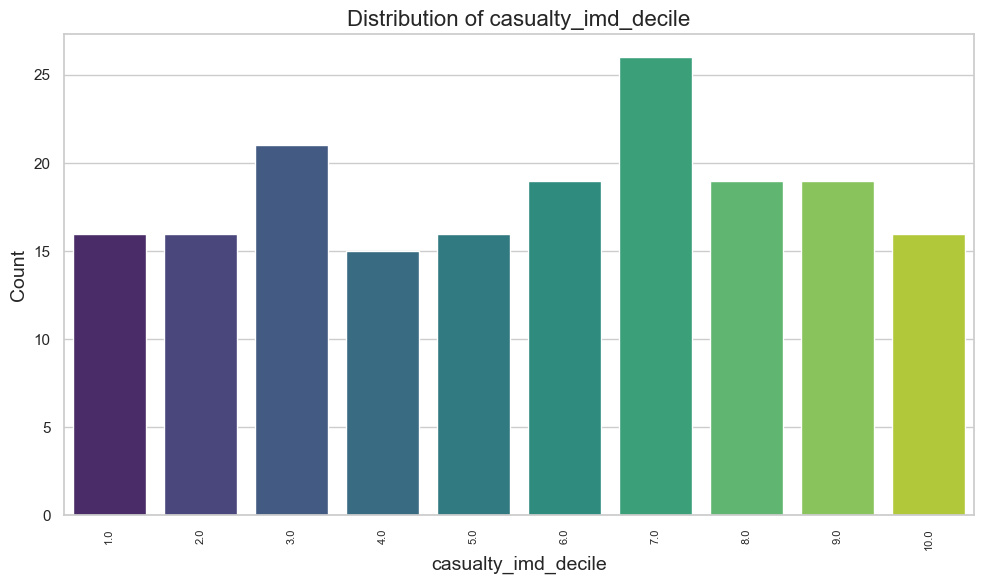

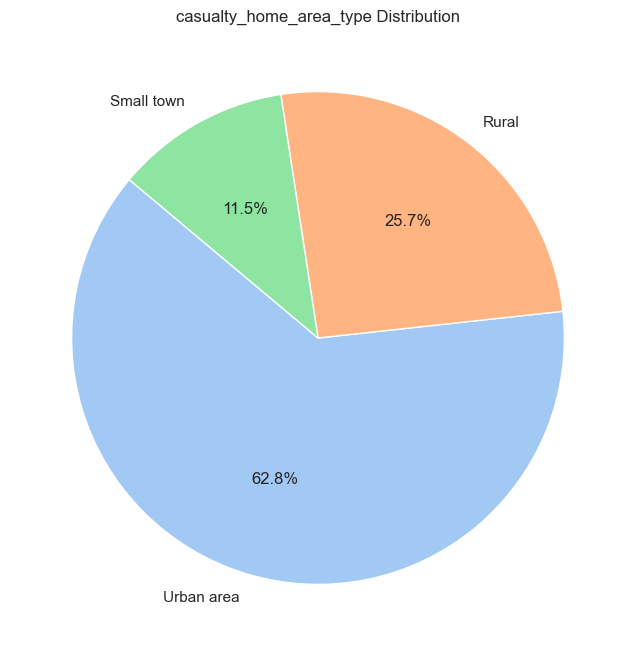

Plotting for Original DataFrame: df_drivers_fatal


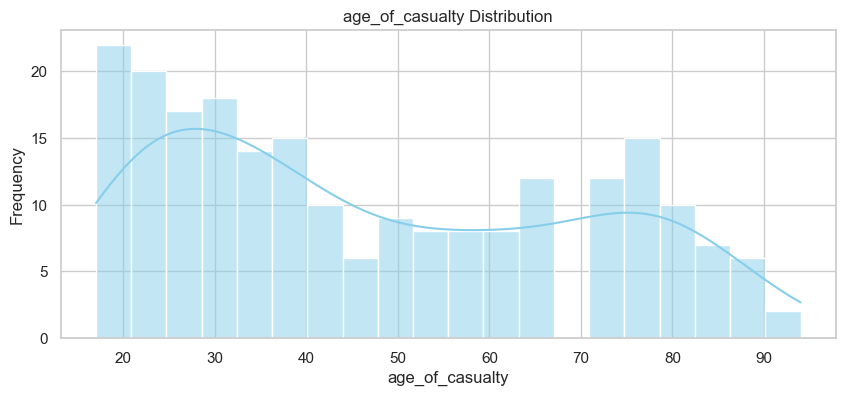

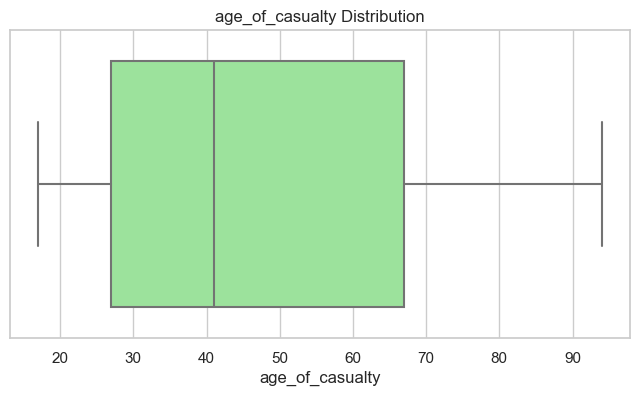

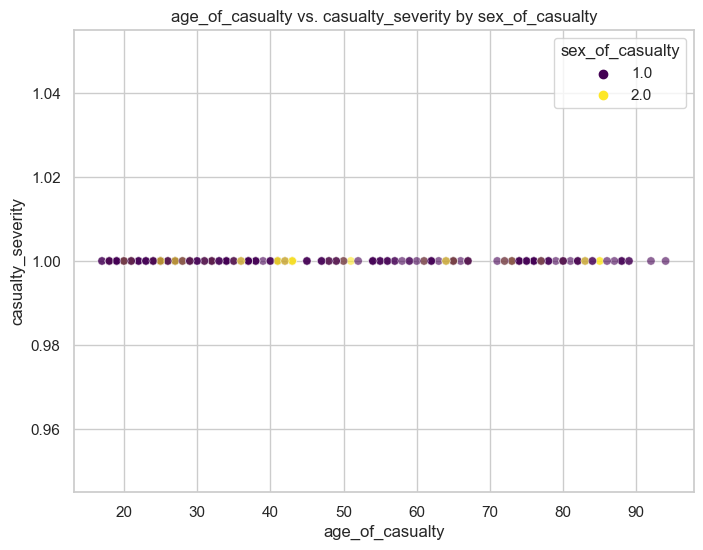

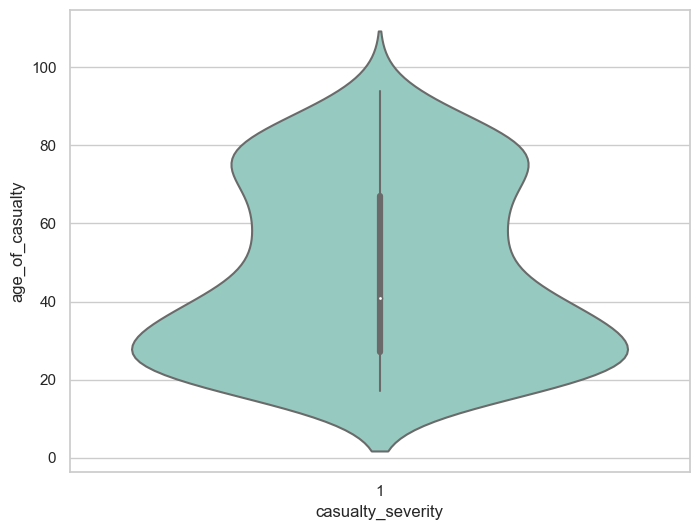

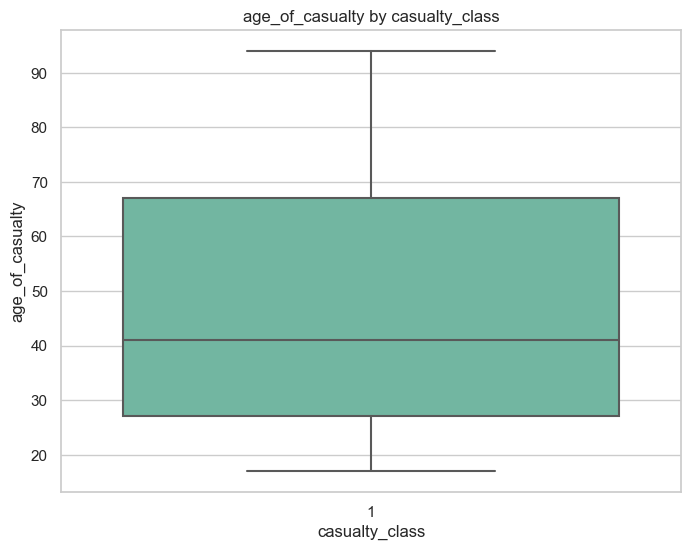

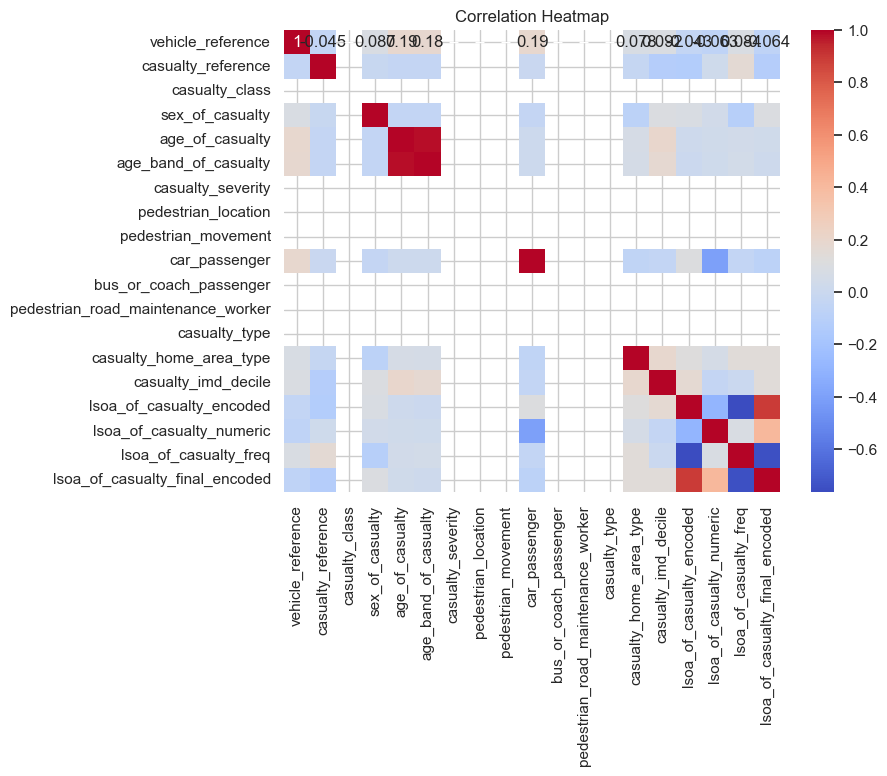

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
Plotting for Labeled DataFrame: df_motorcycle_labeled


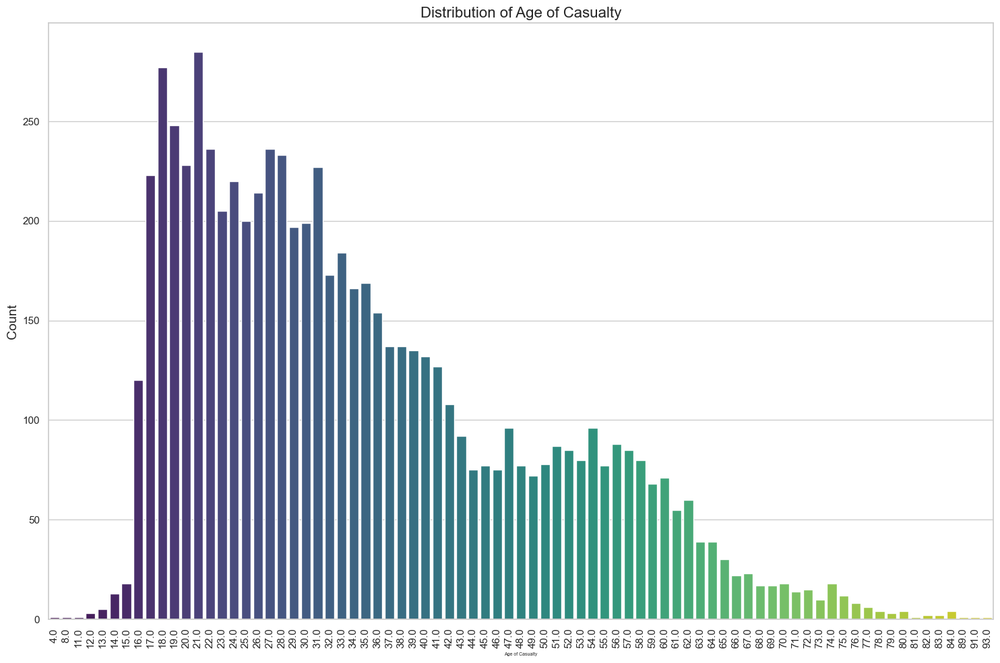

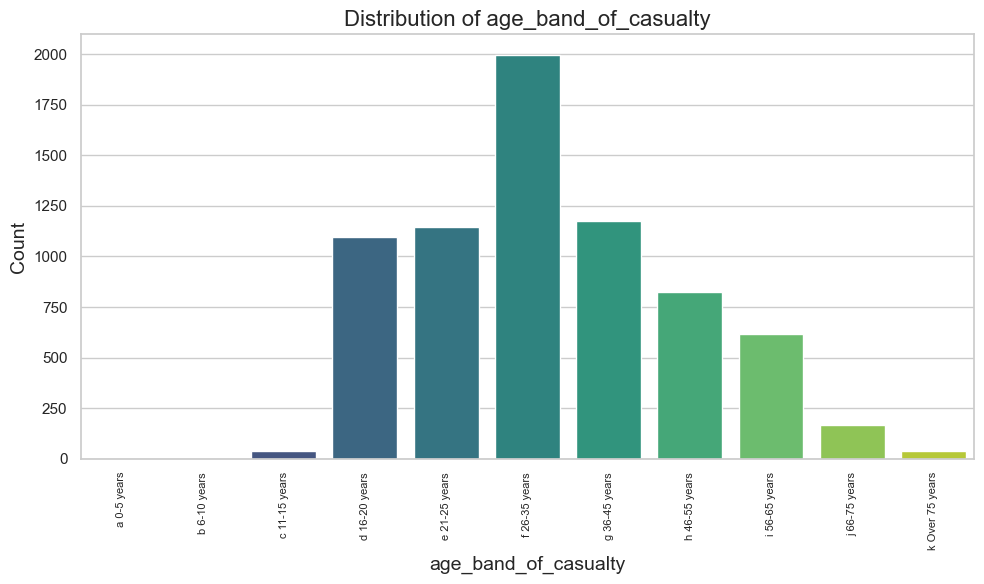

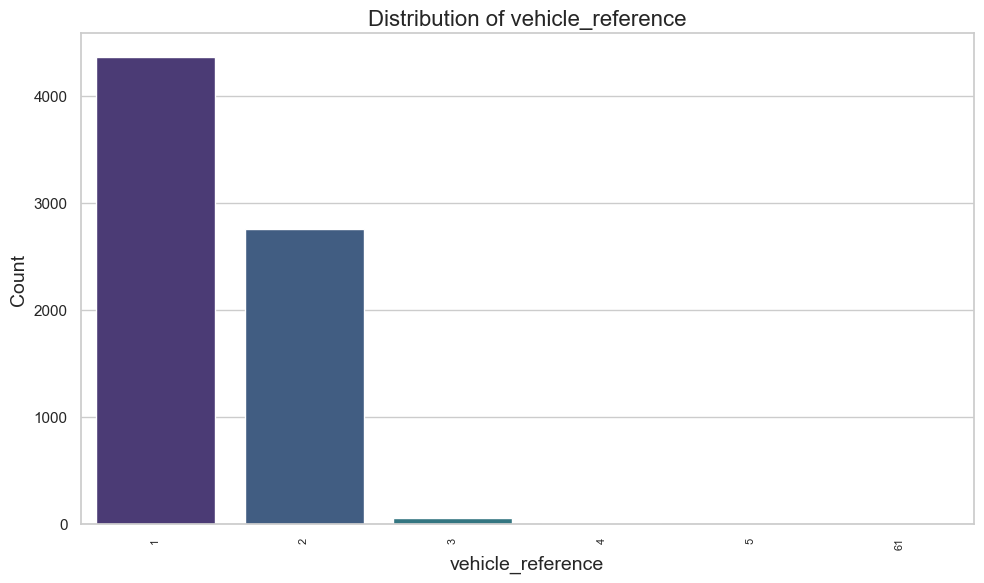

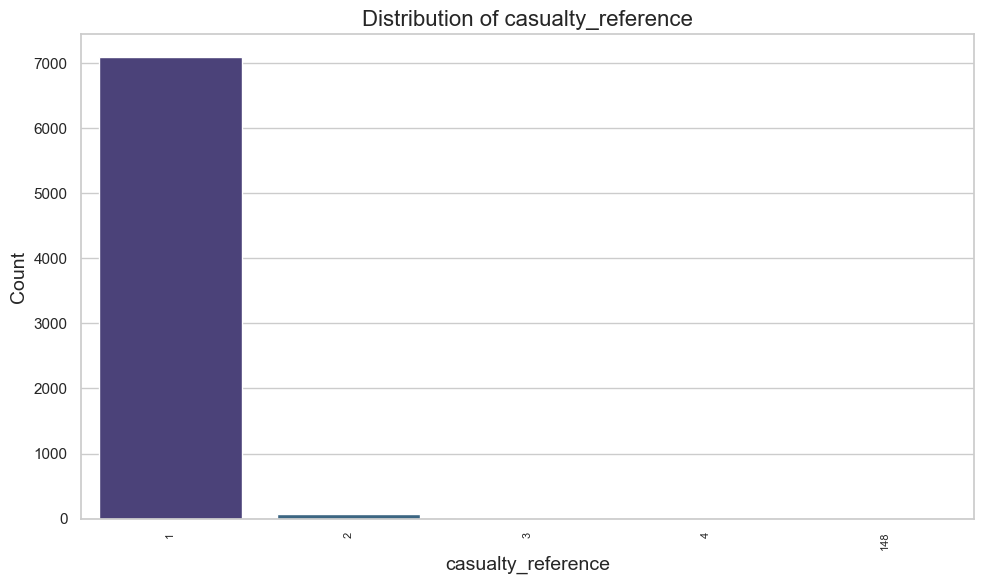

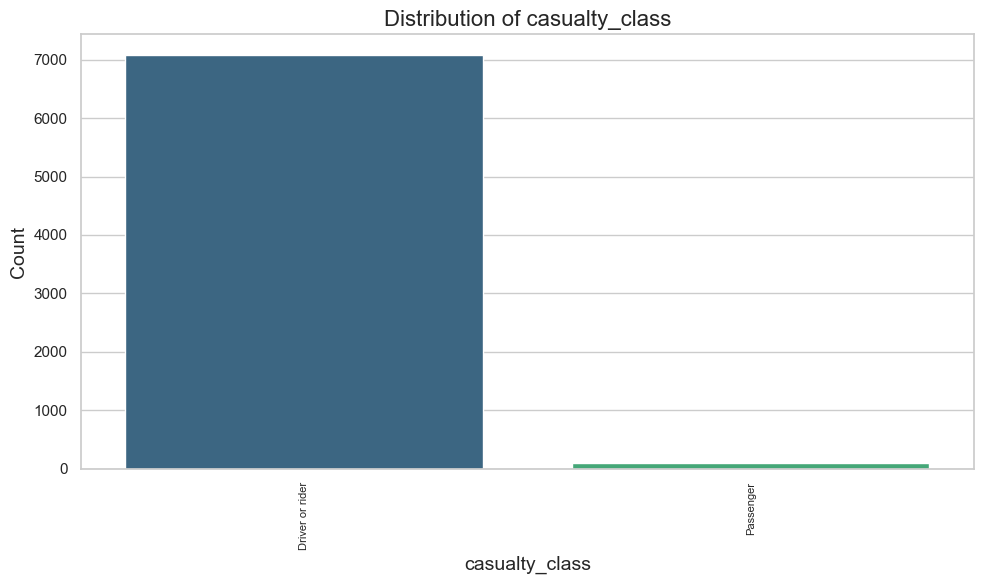

...

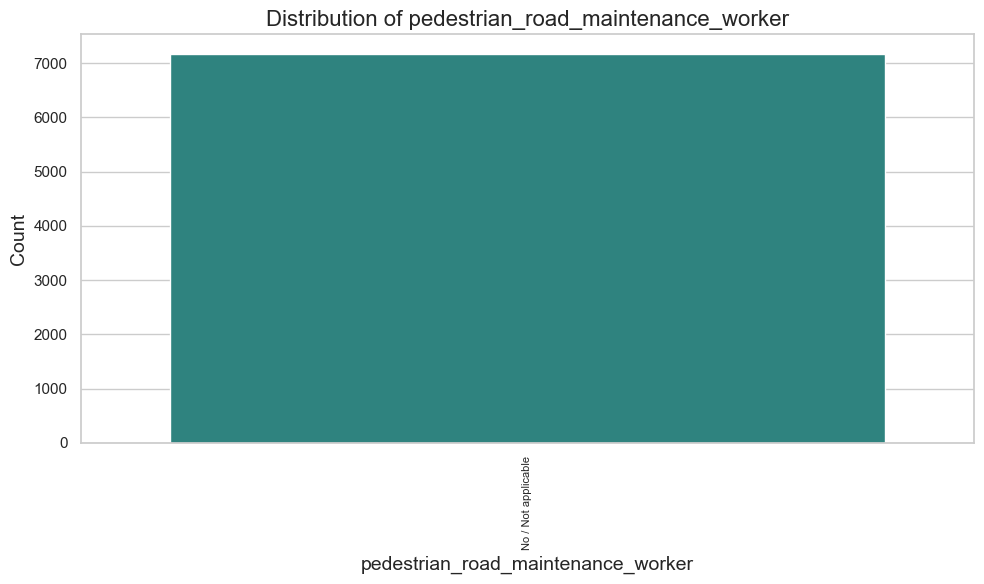

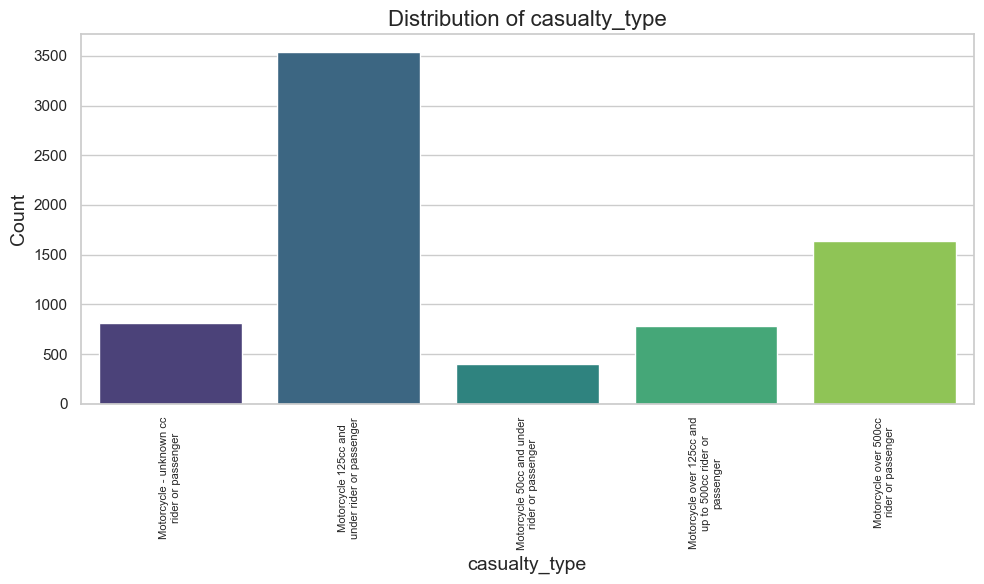

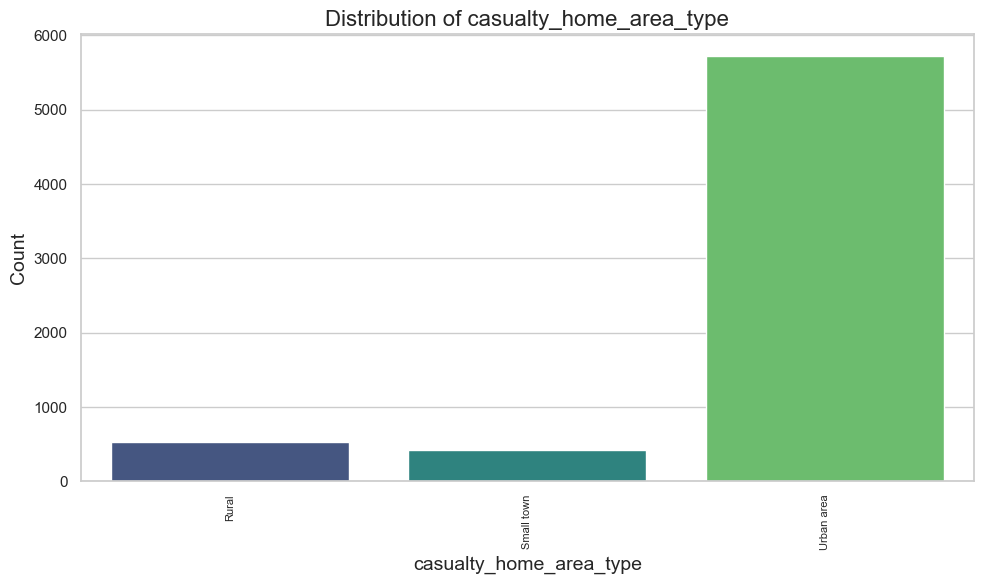

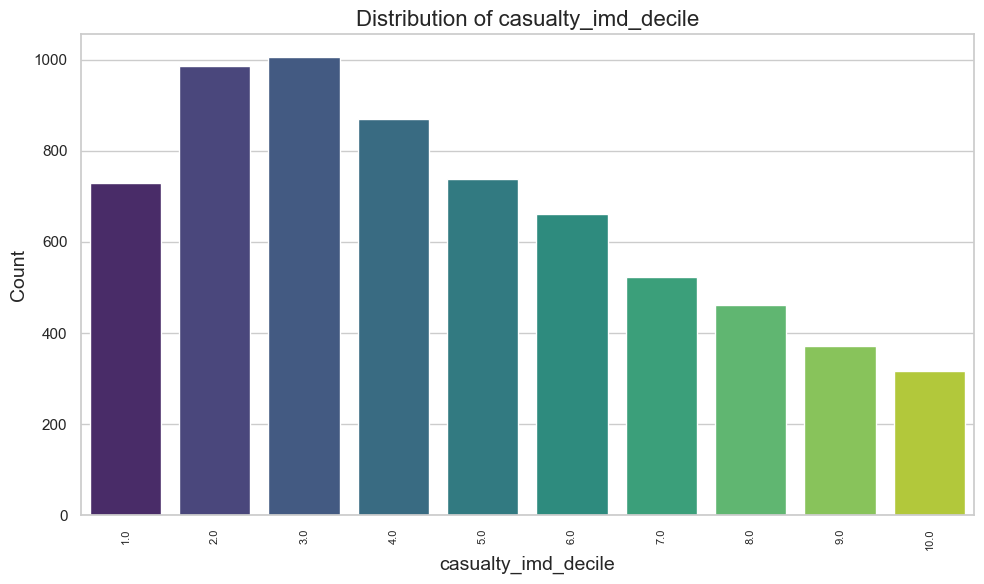

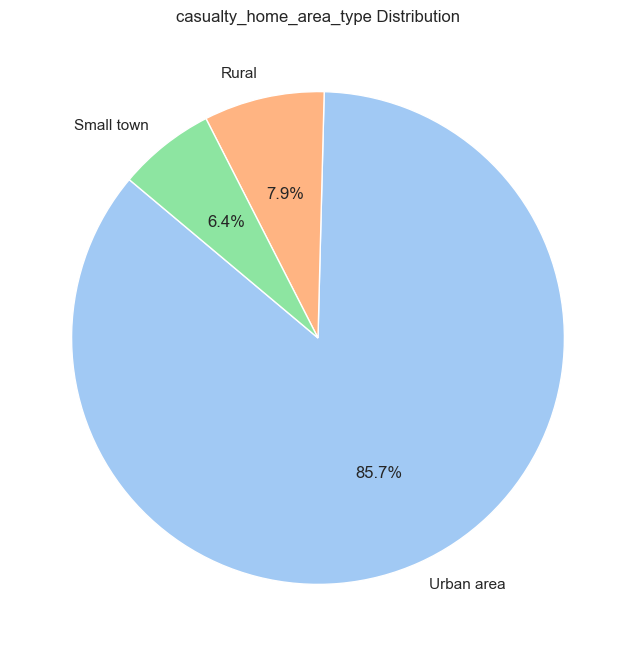

Plotting for Original DataFrame: df_motorcycle


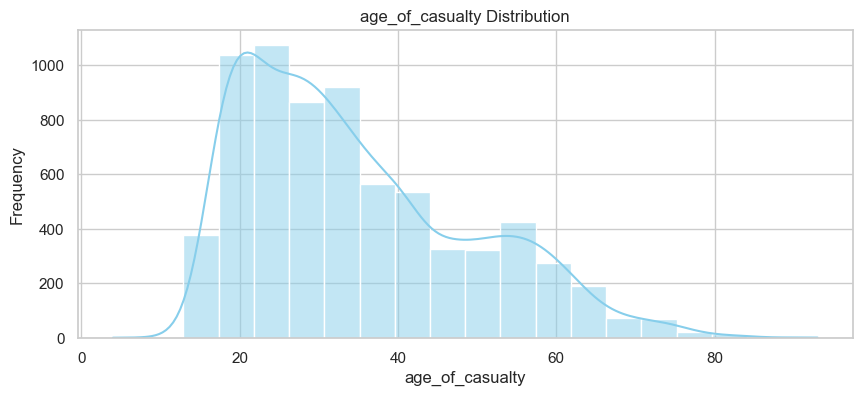

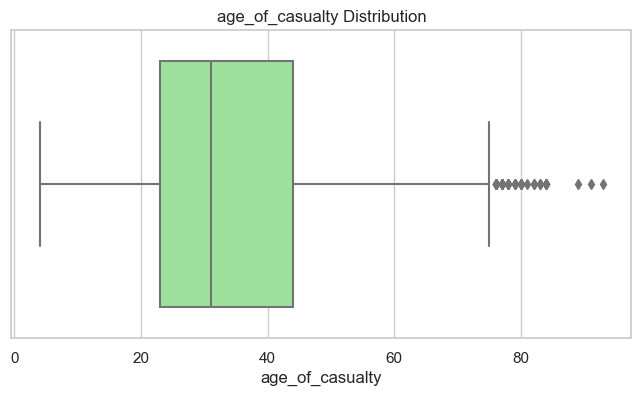

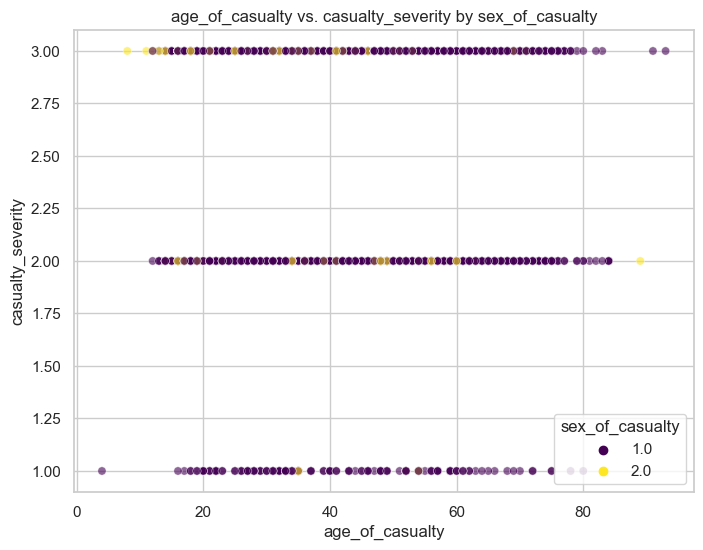

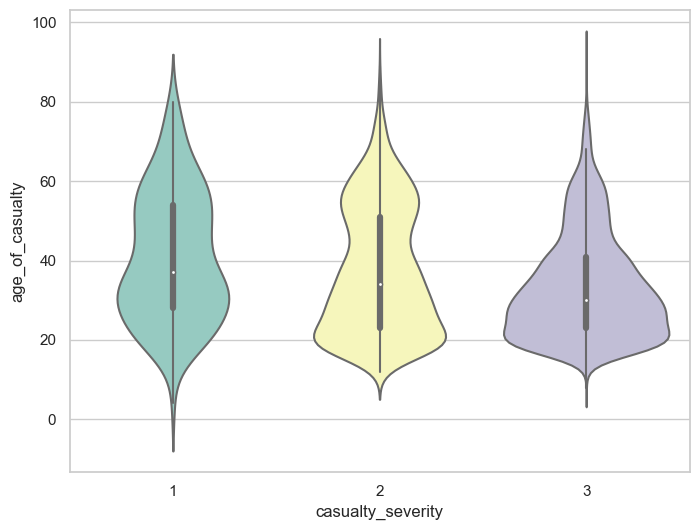

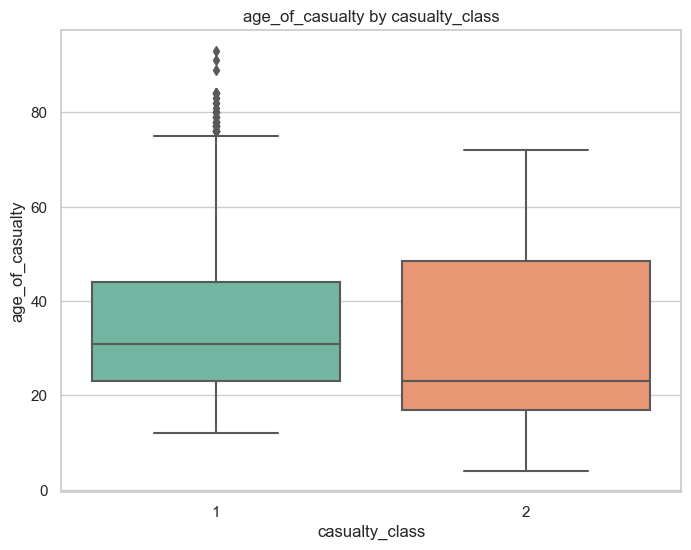

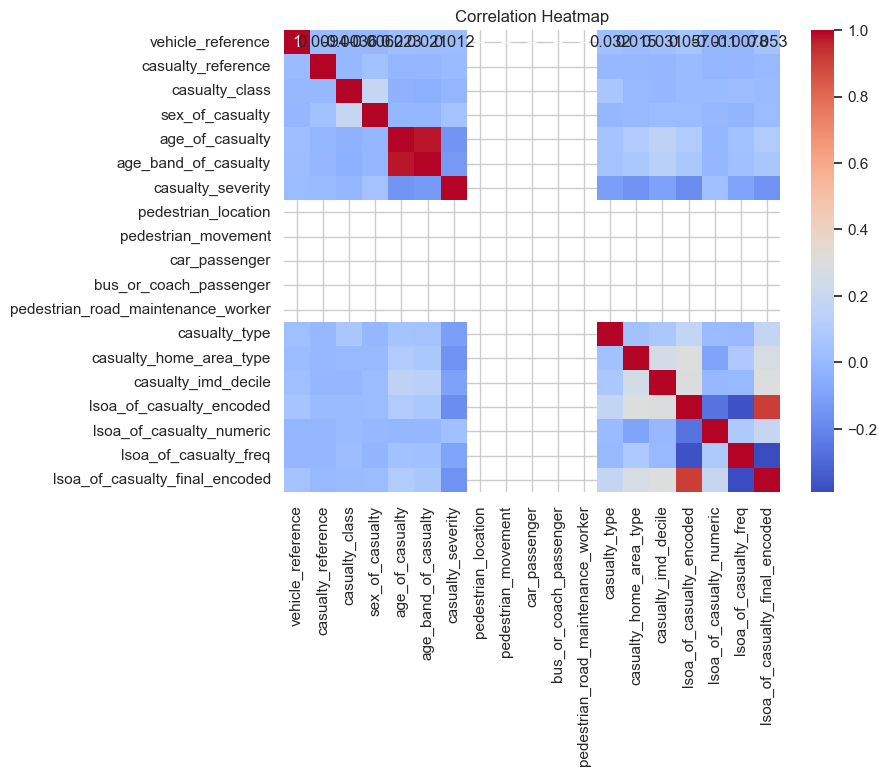

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
Plotting for Labeled DataFrame: df_motorcycle_FS_labeled


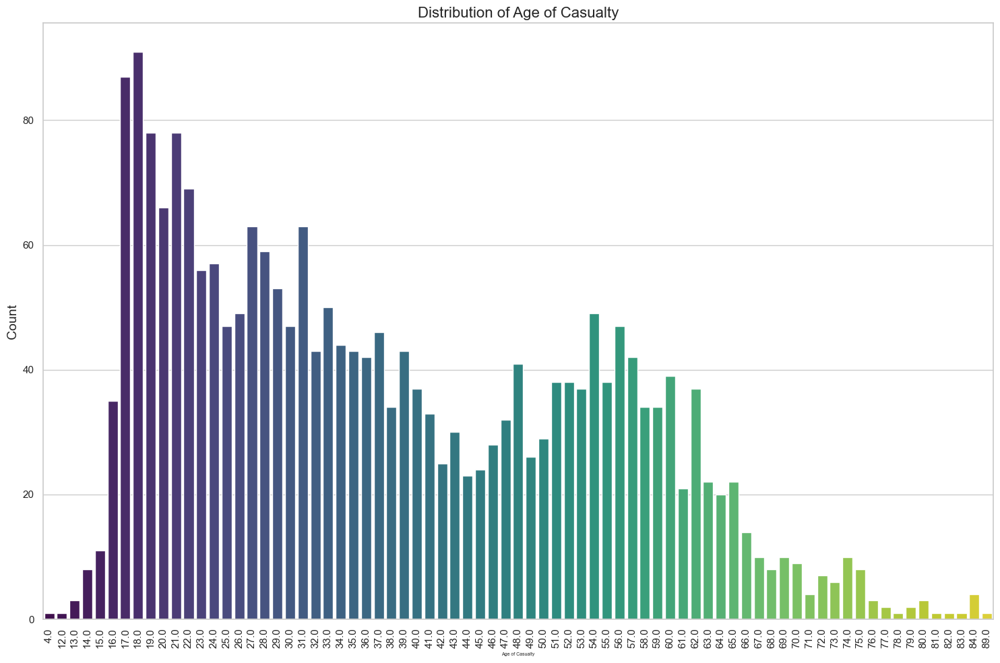

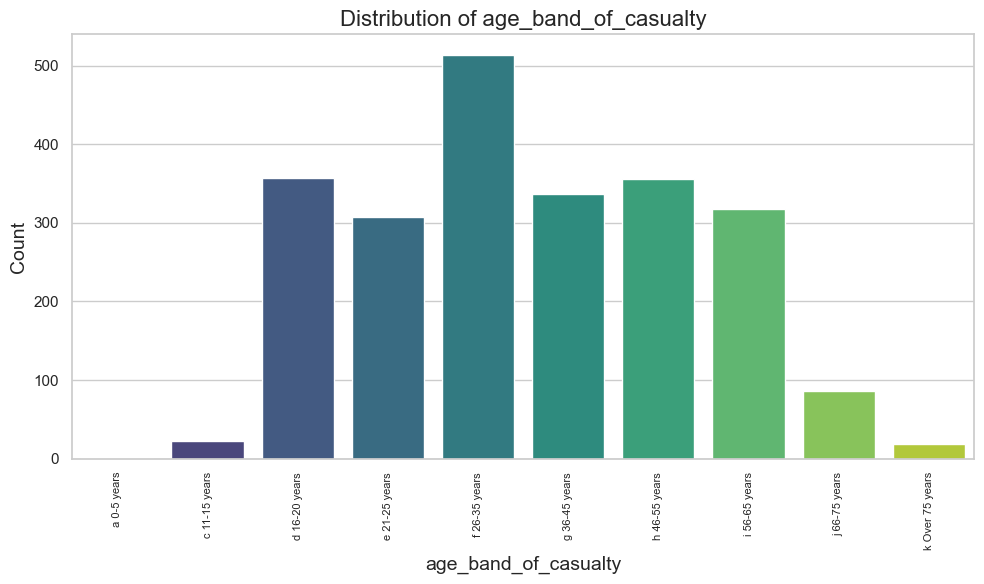

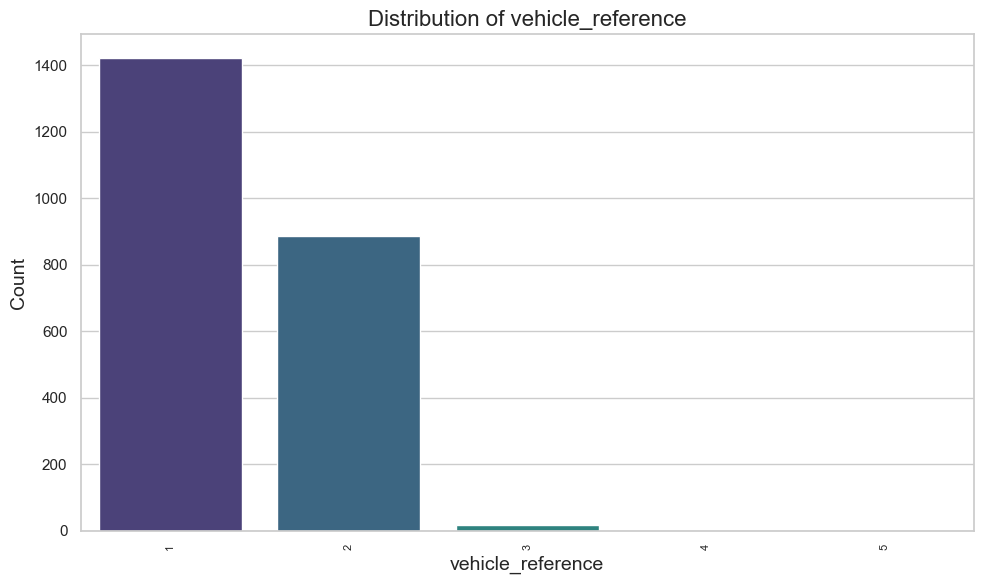

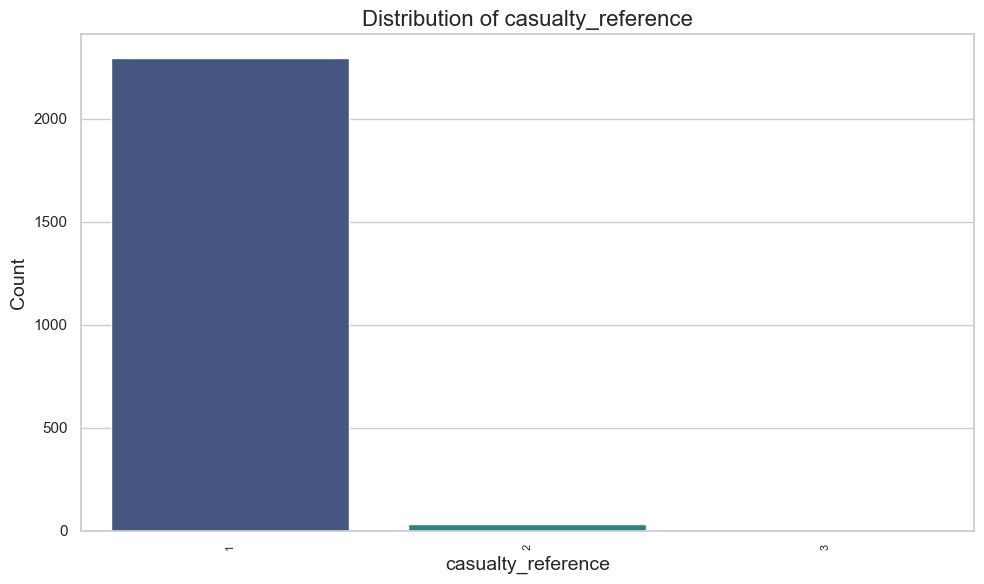

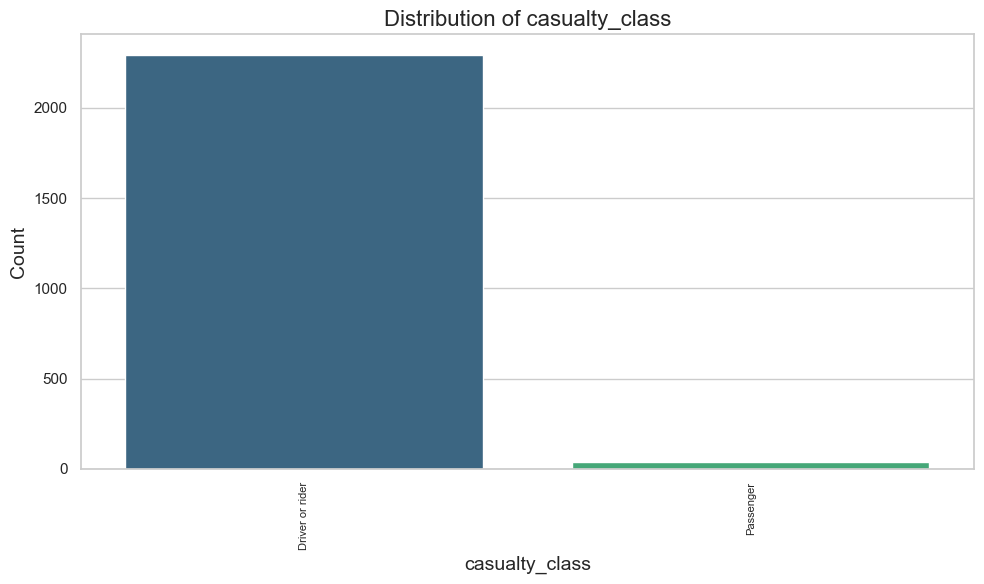

...

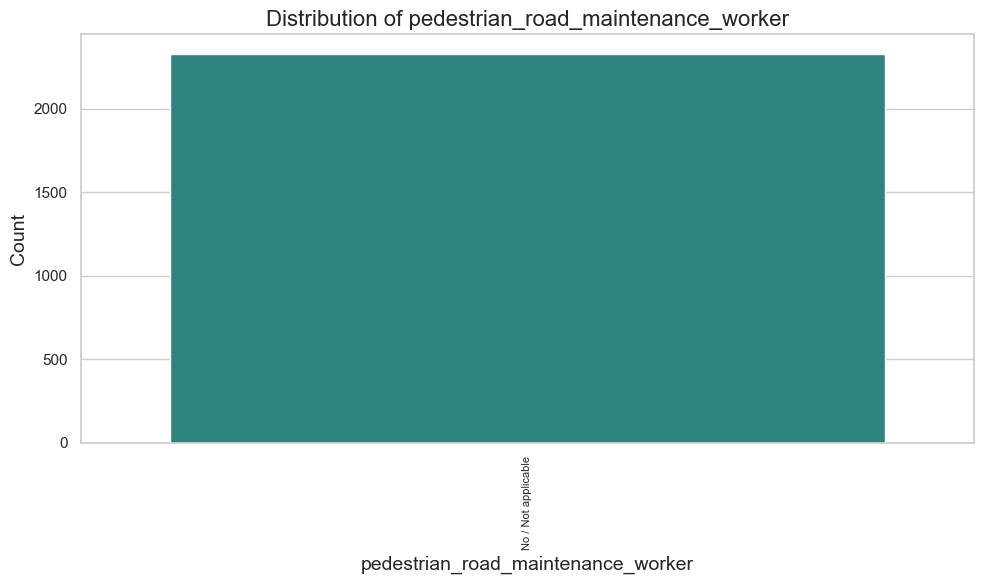

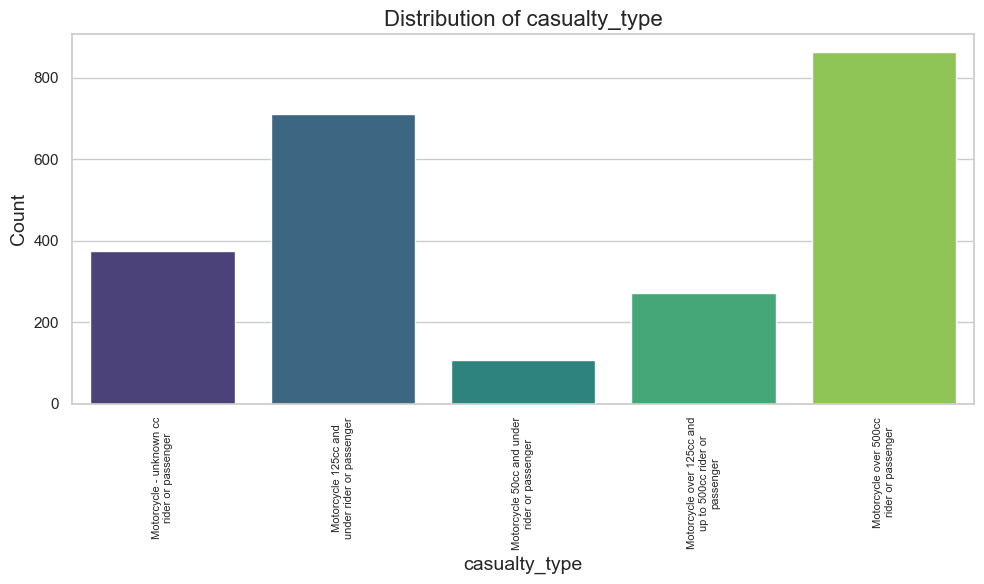

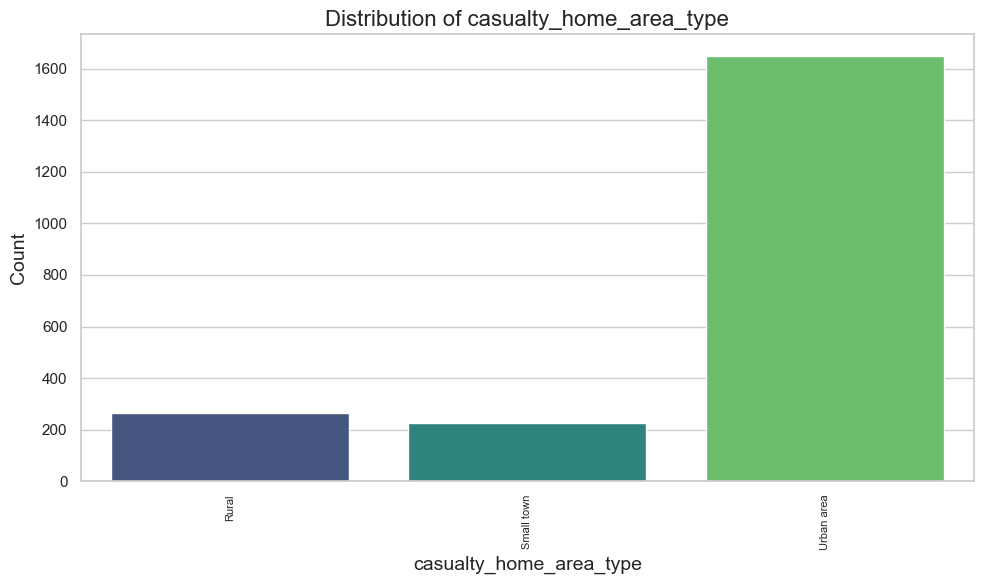

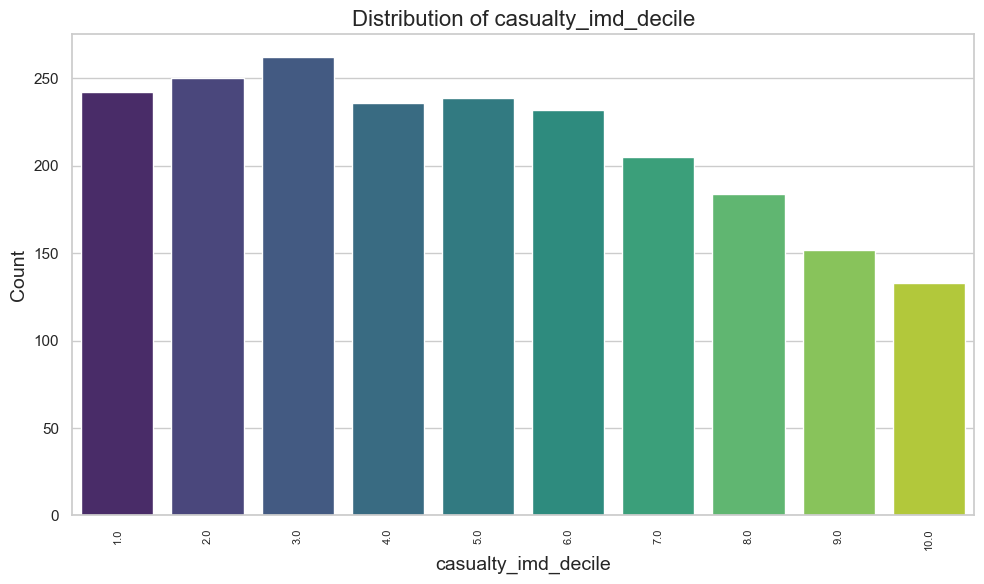

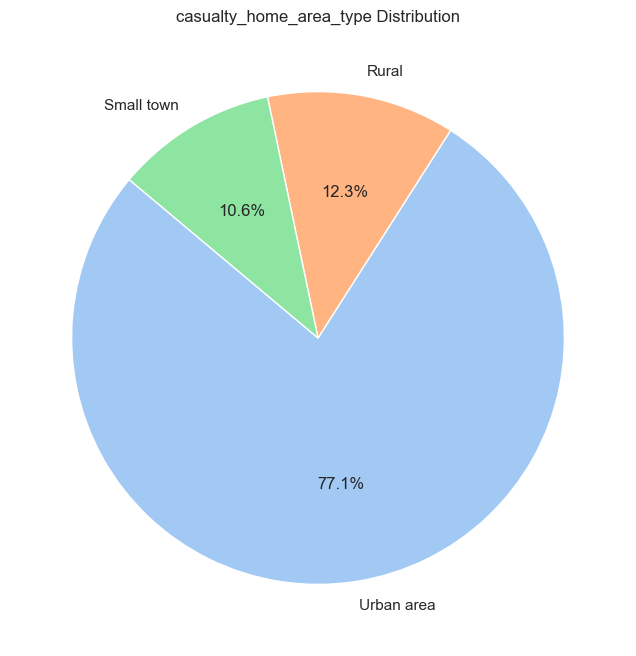

Plotting for Original DataFrame: df_motorcycle_FS


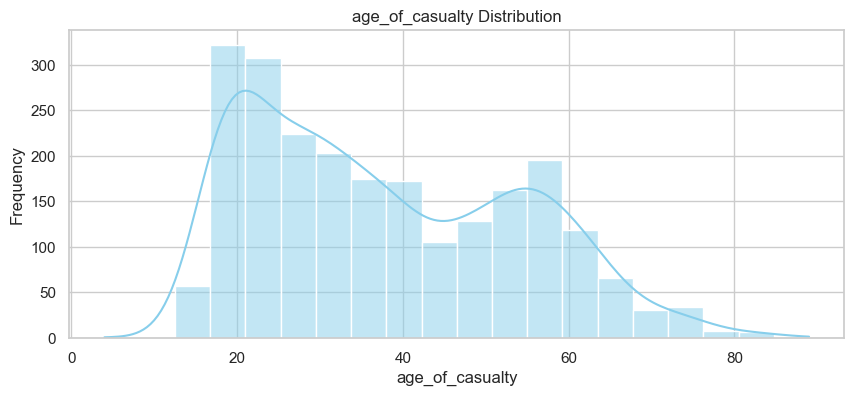

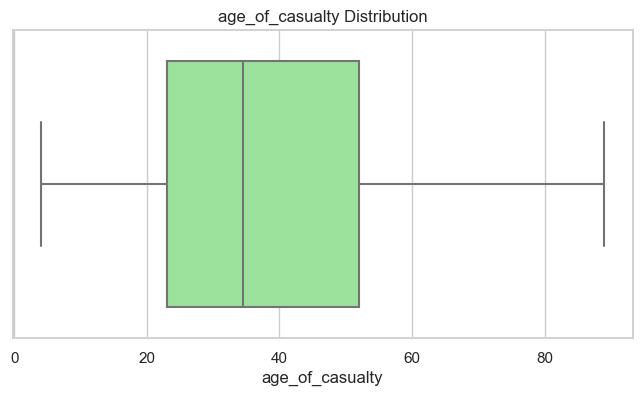

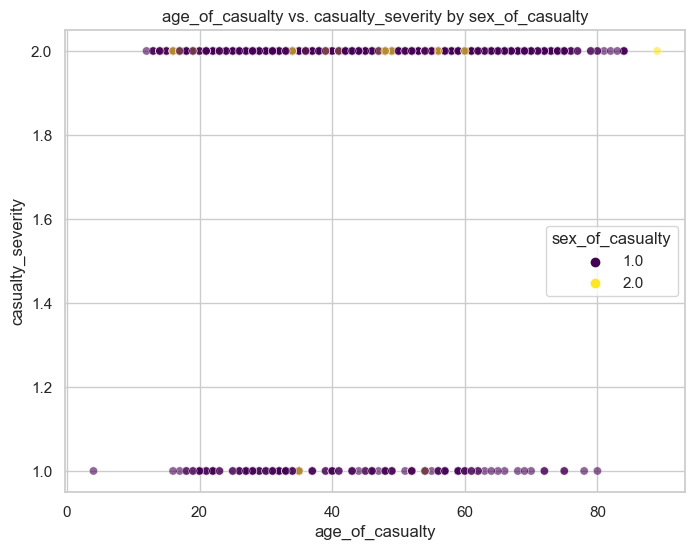

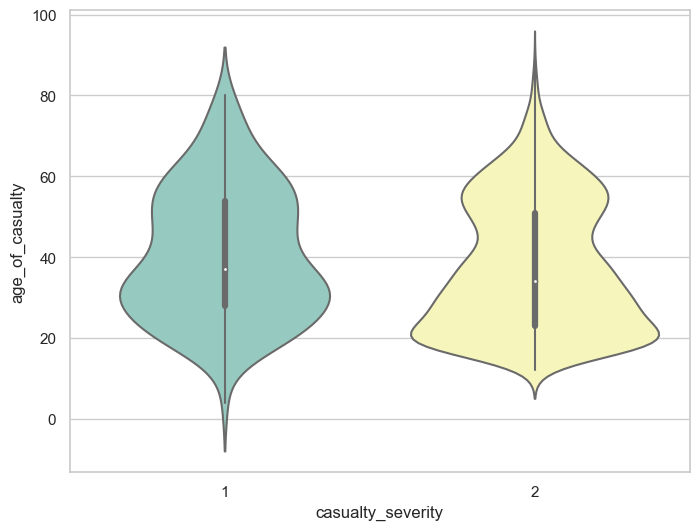

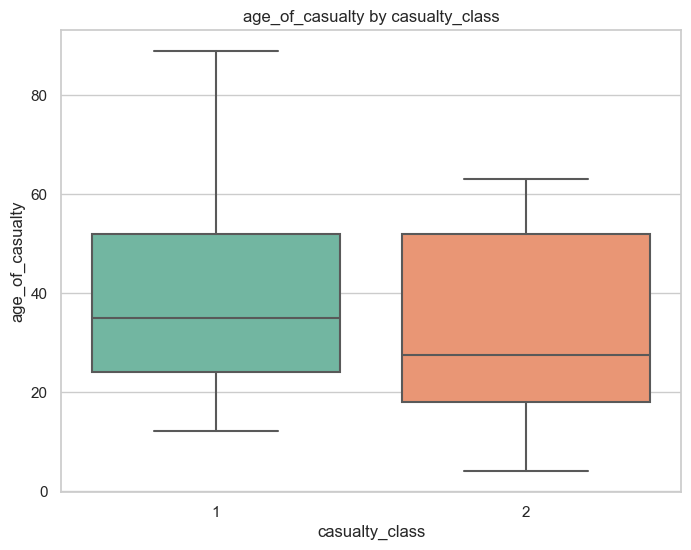

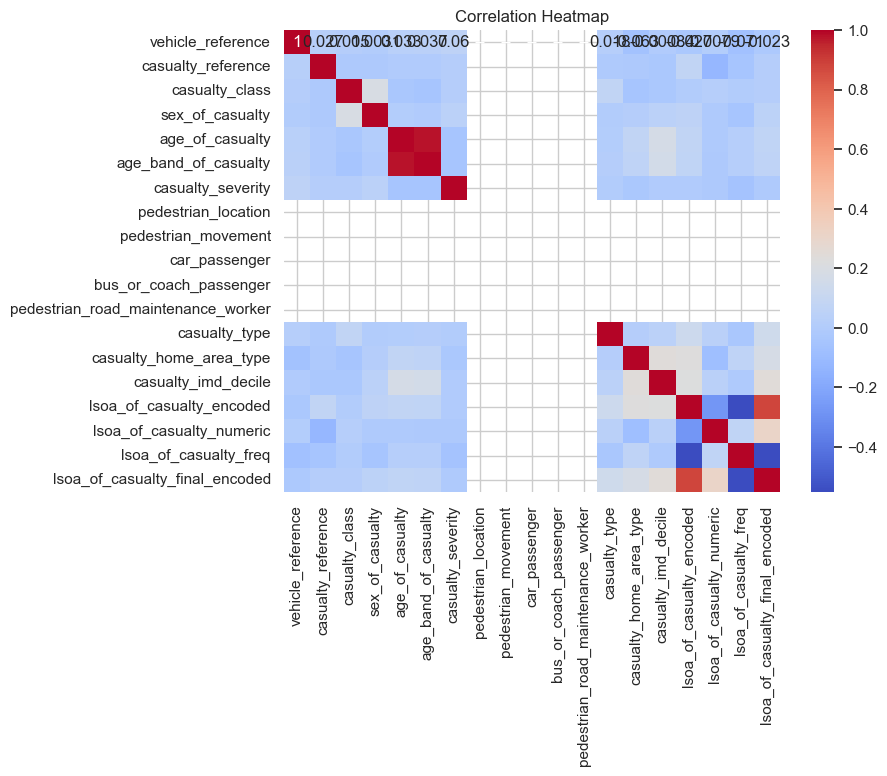

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
Plotting for Labeled DataFrame: df_motorcycle_fatal_labeled


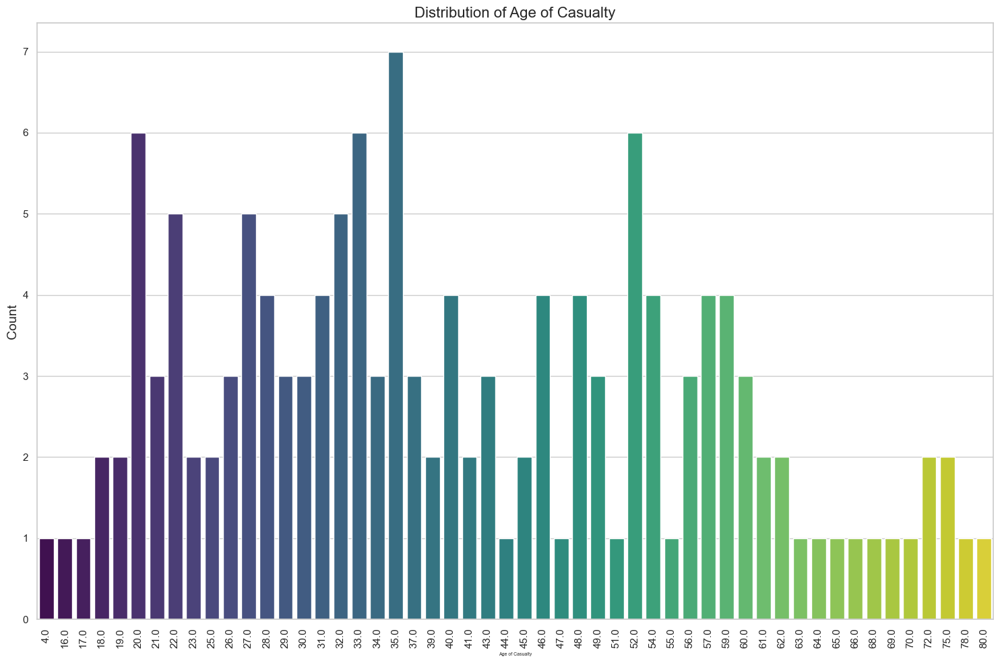

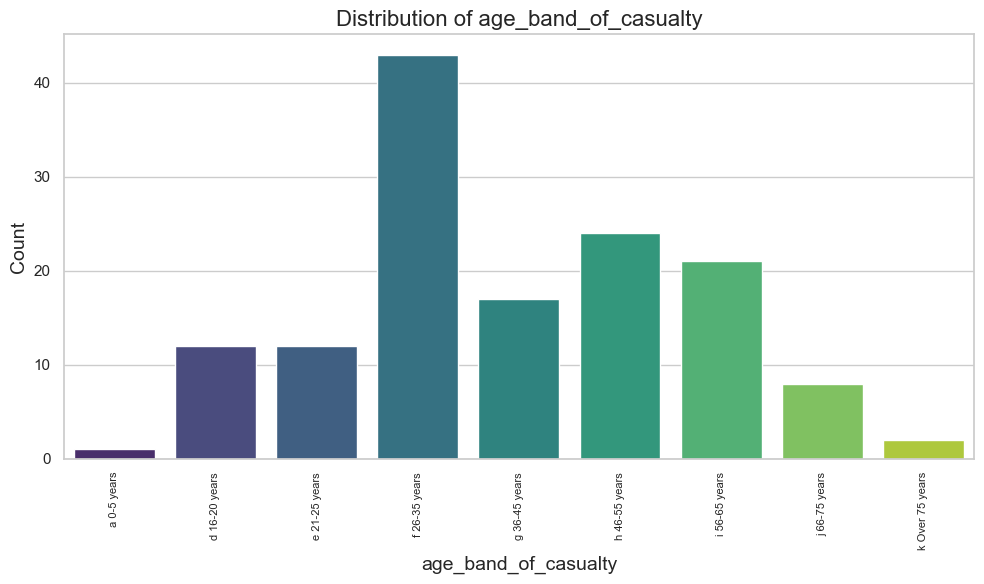

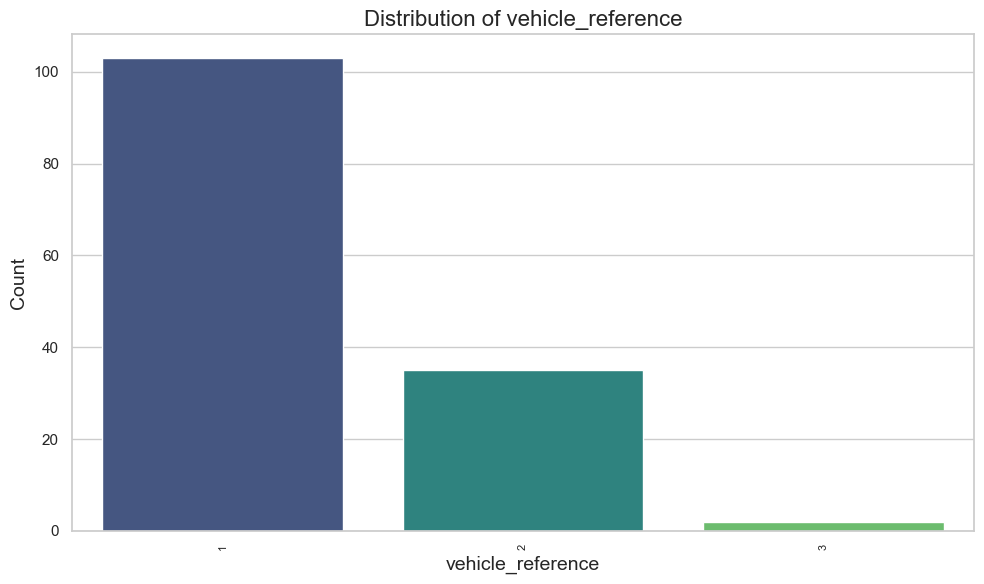

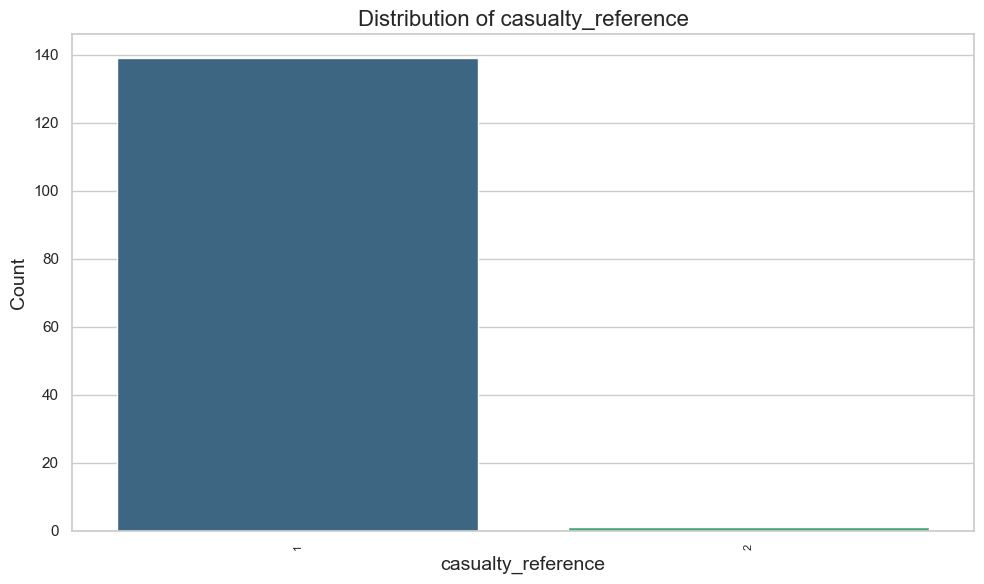

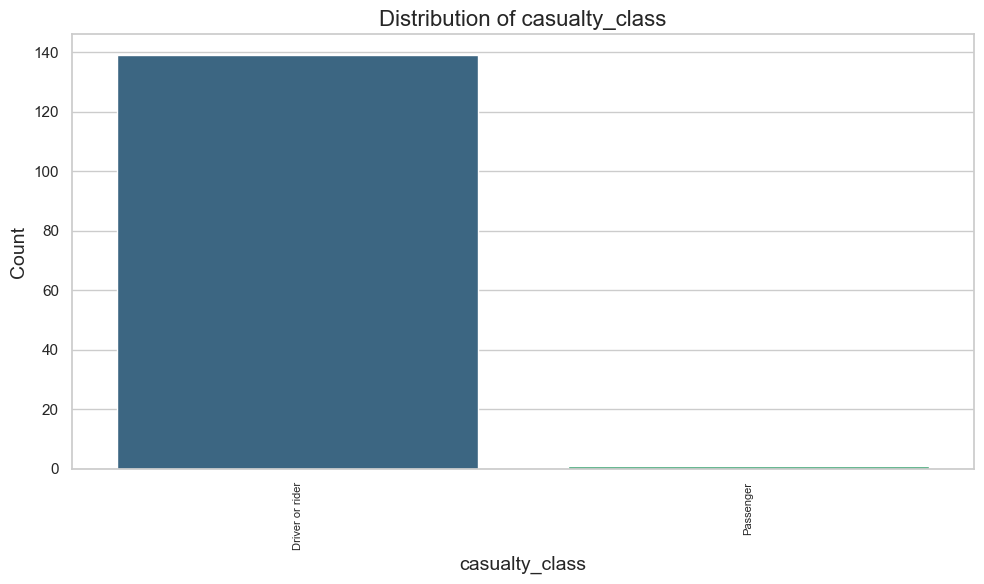

...

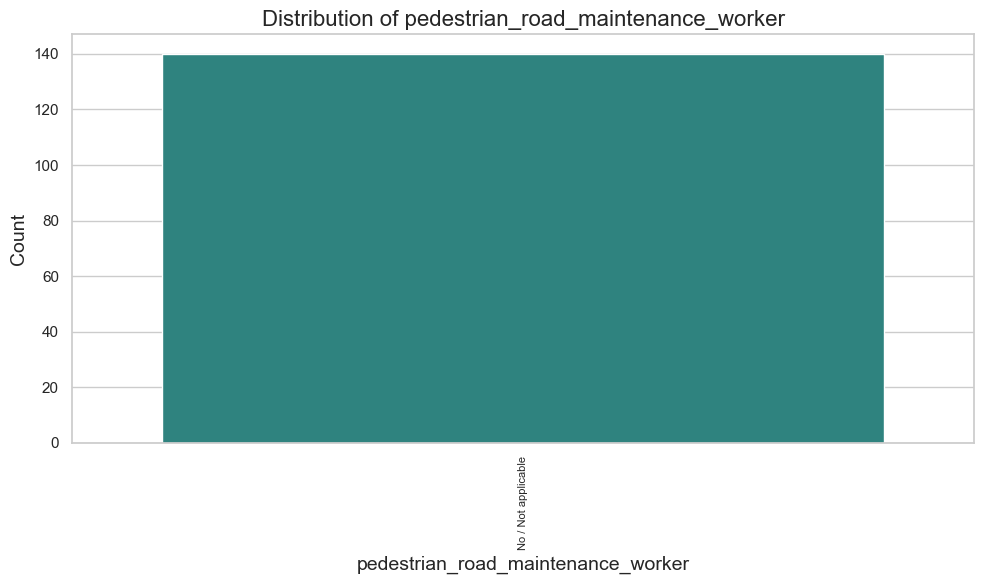

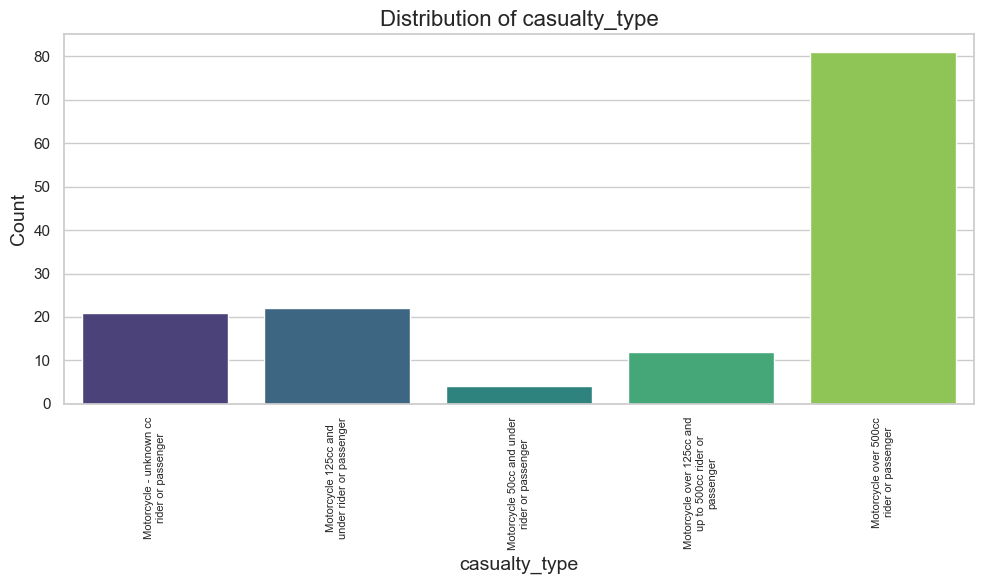

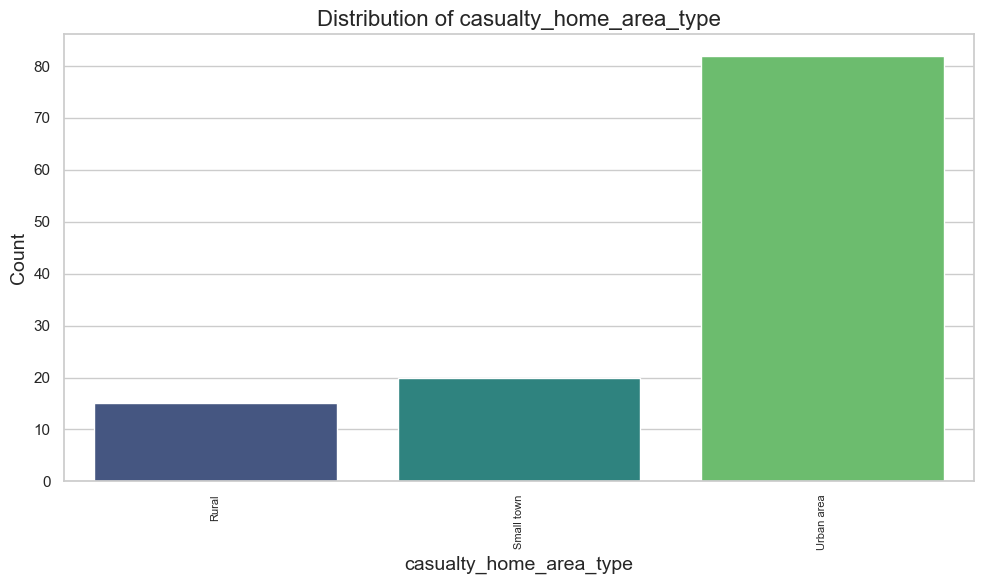

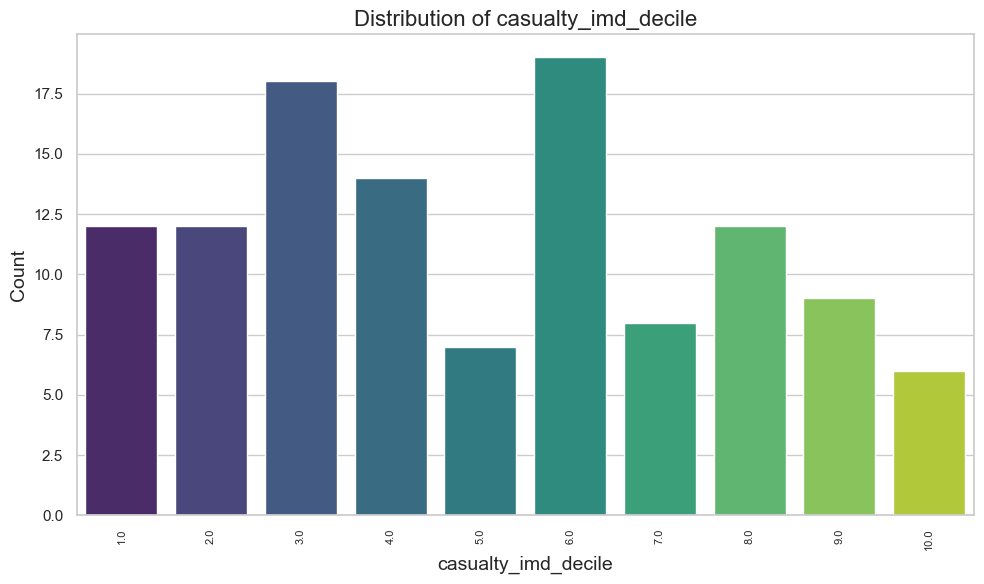

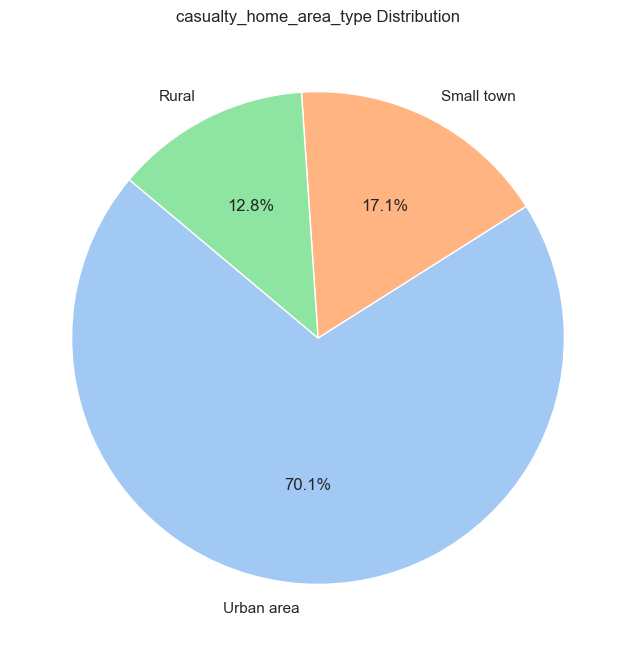

Plotting for Original DataFrame: df_motorcycle_fatal


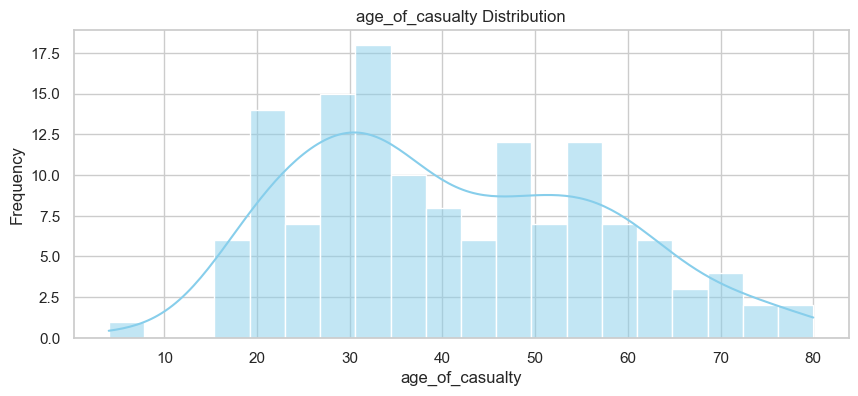

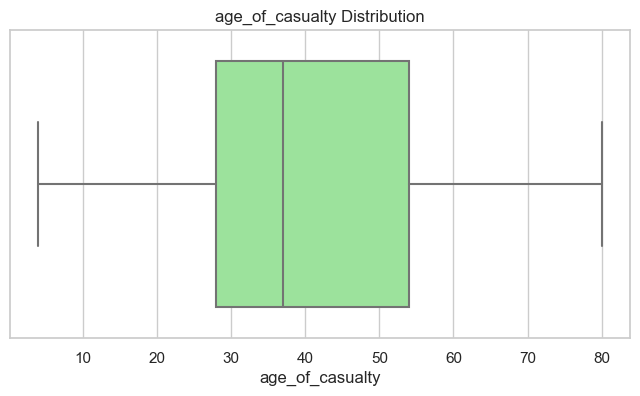

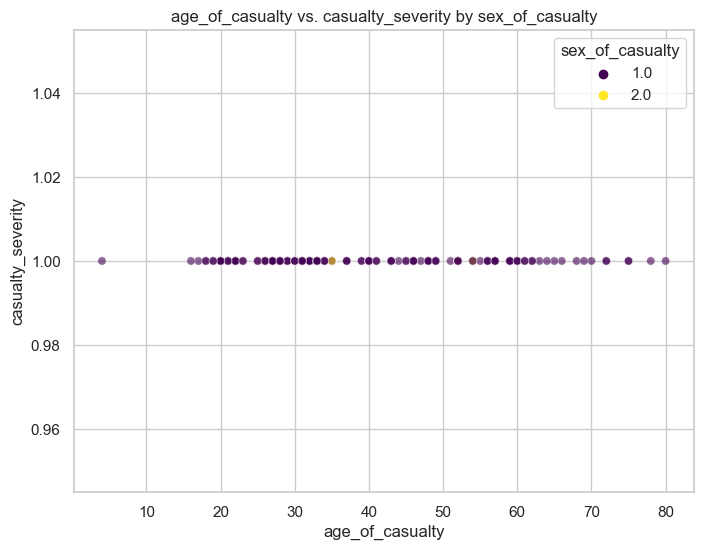

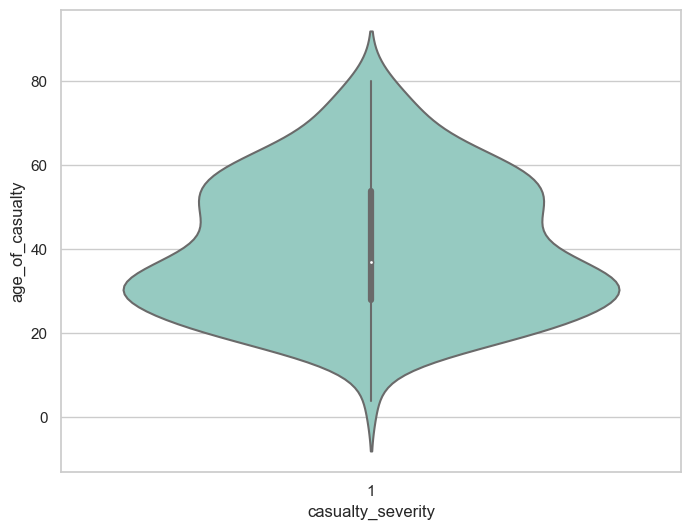

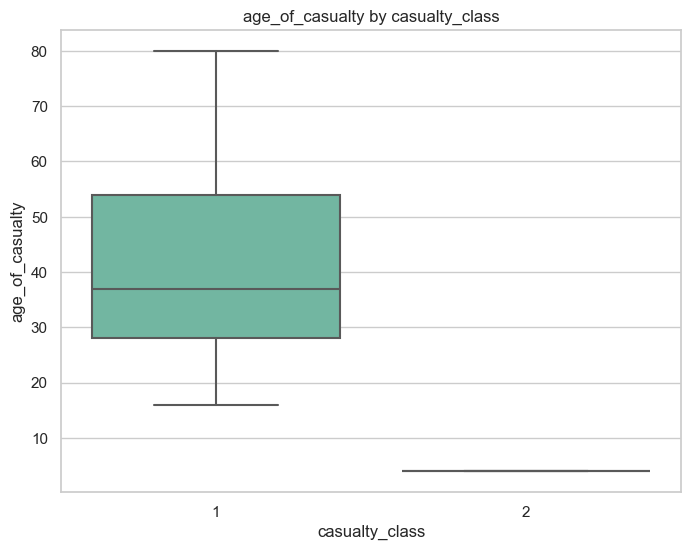

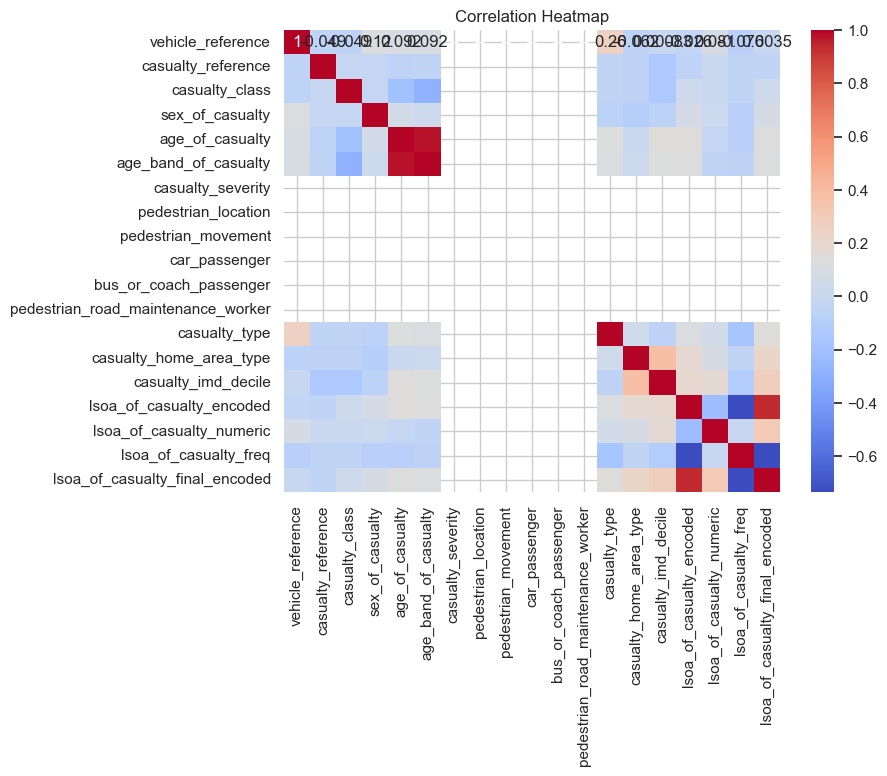

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
Plotting for Labeled DataFrame: df_passenger_labeled


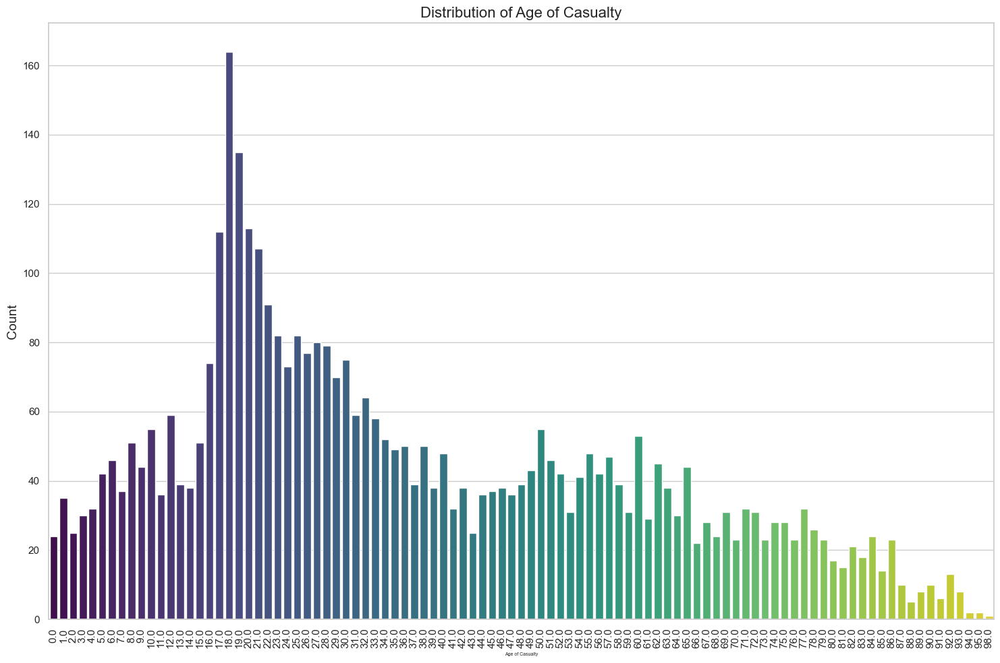

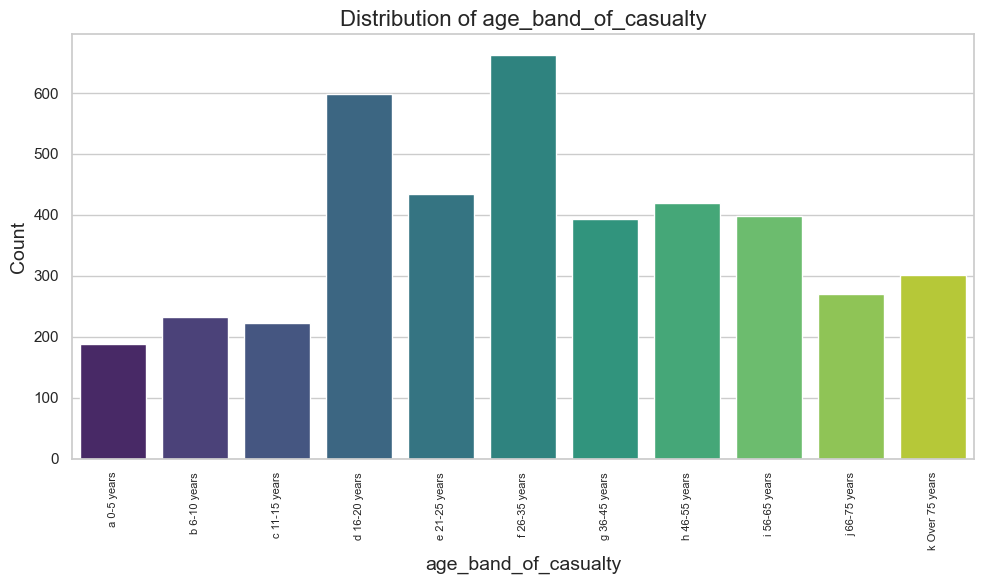

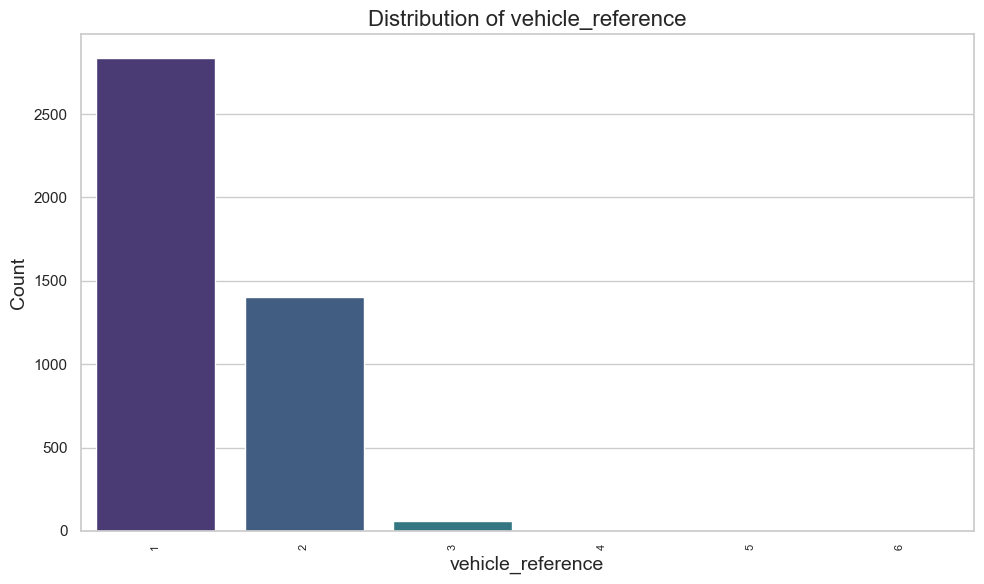

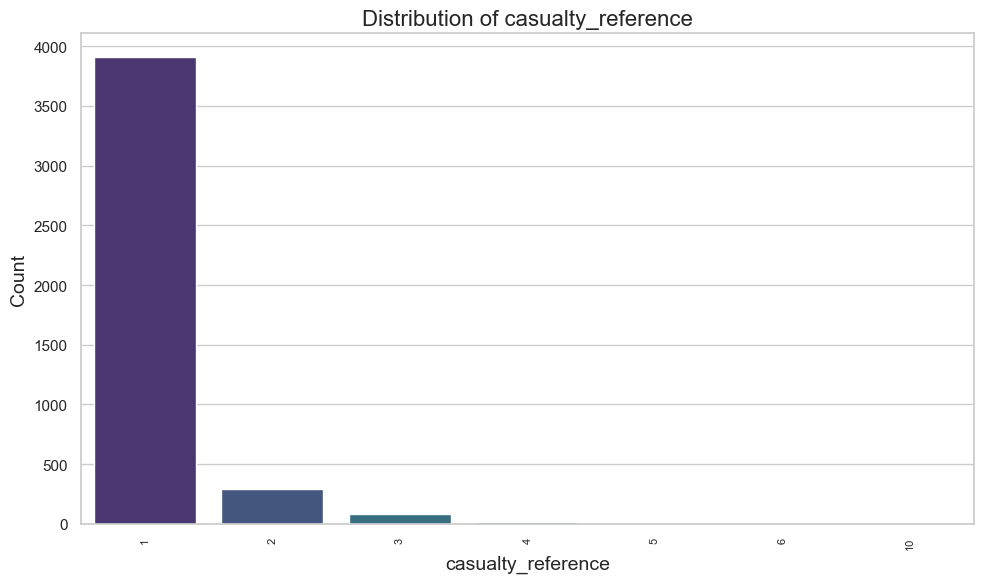

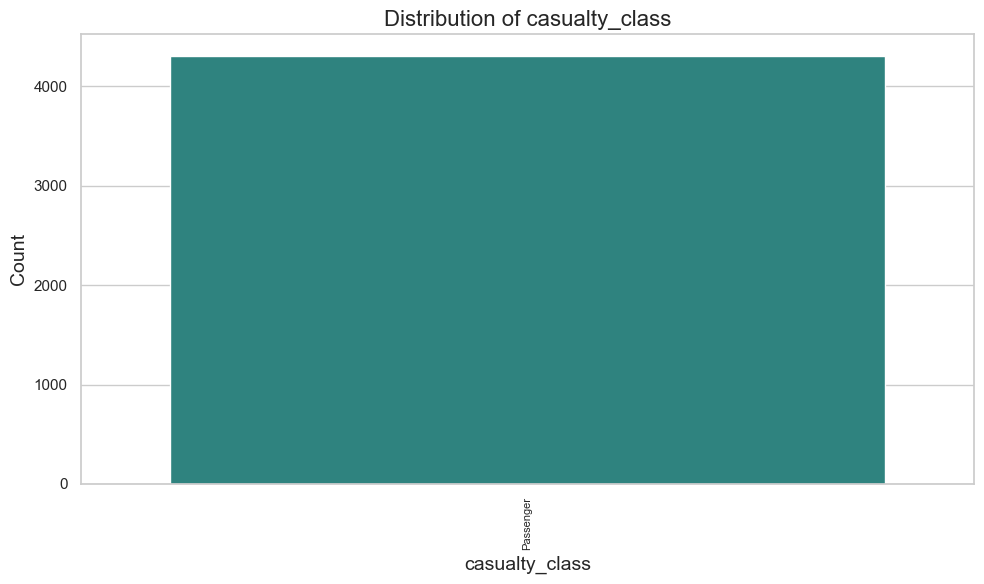

...

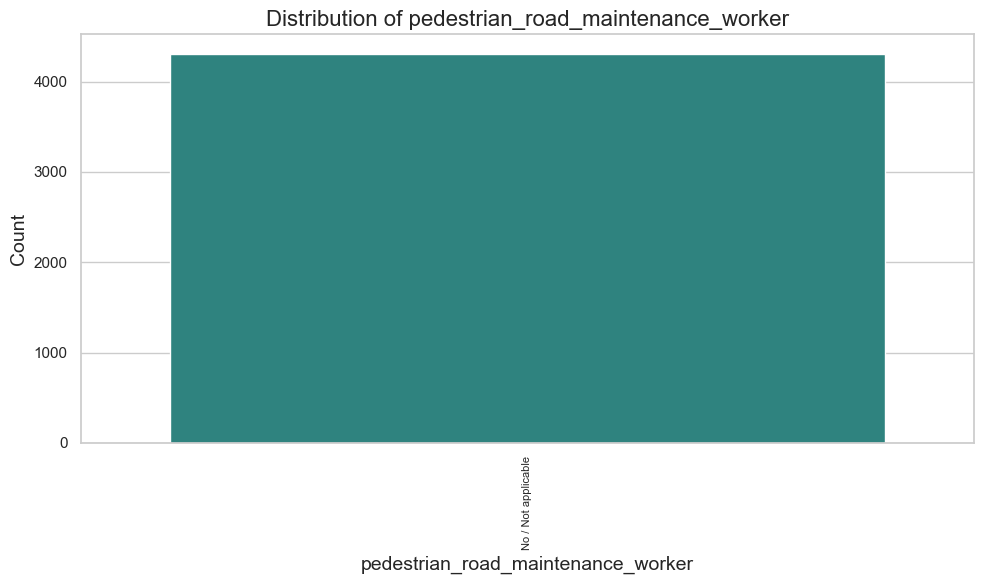

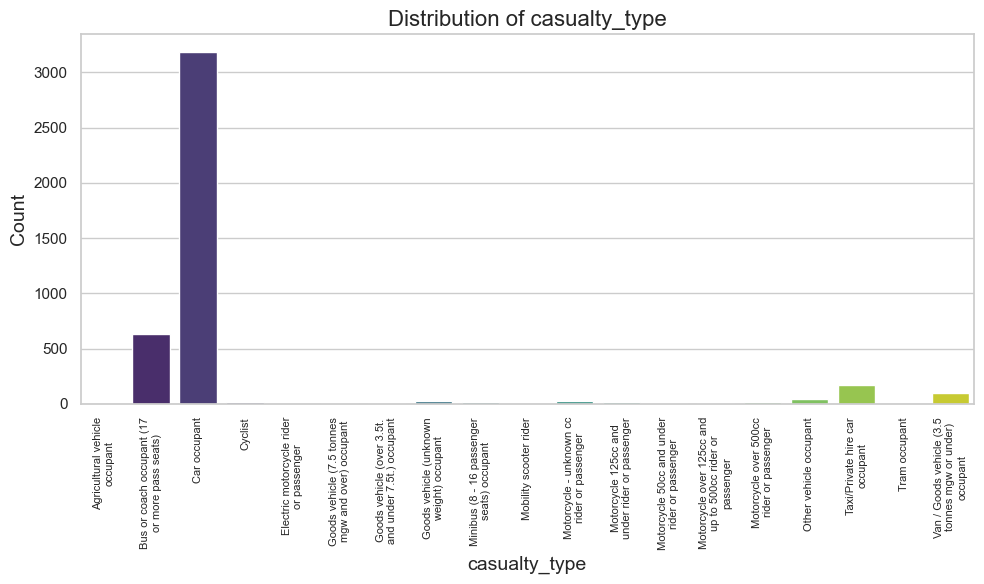

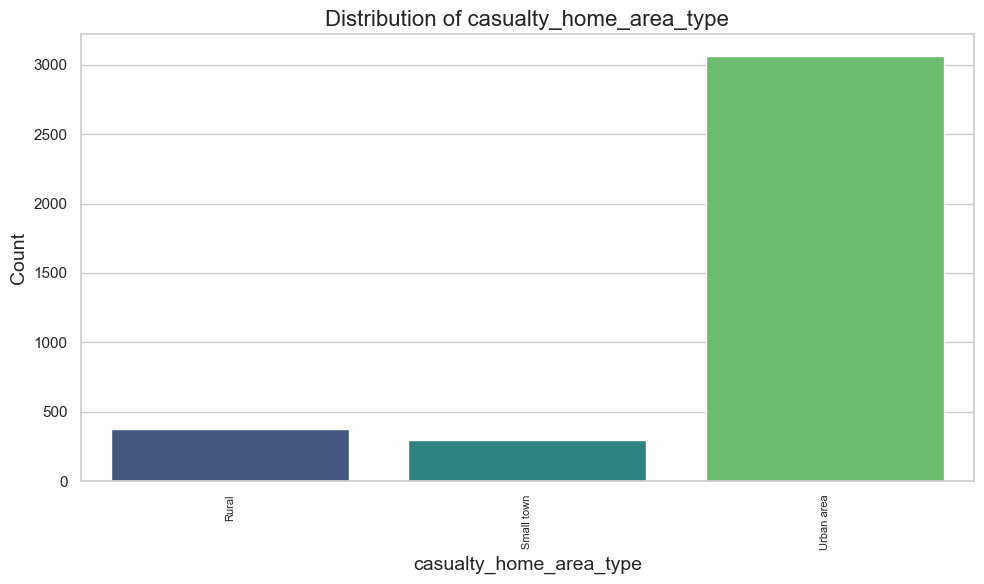

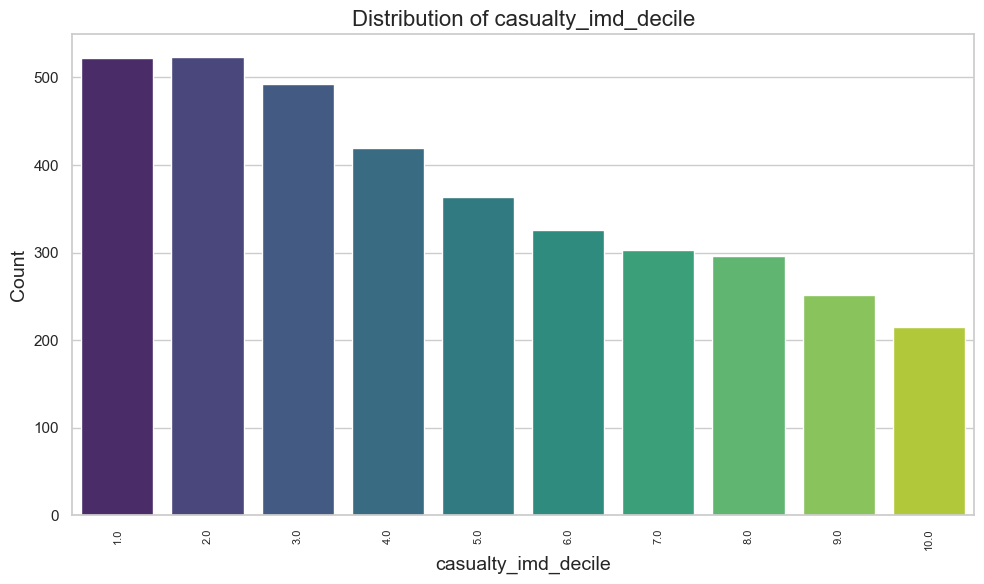

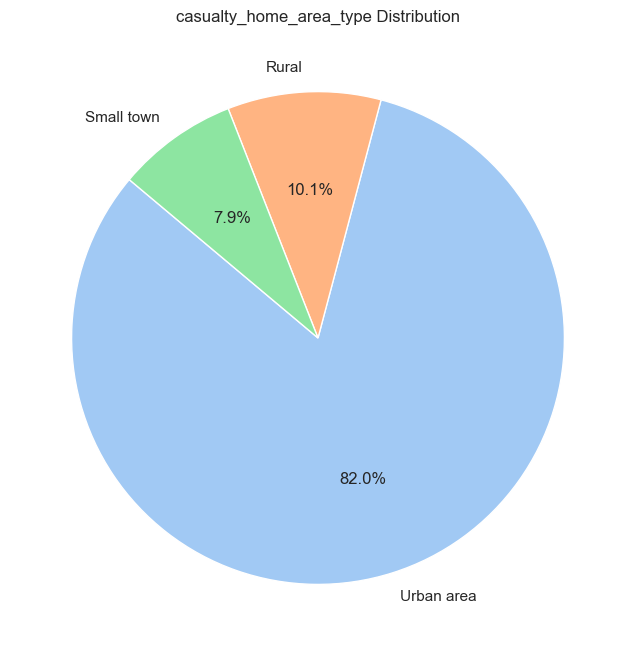

Plotting for Original DataFrame: df_passenger


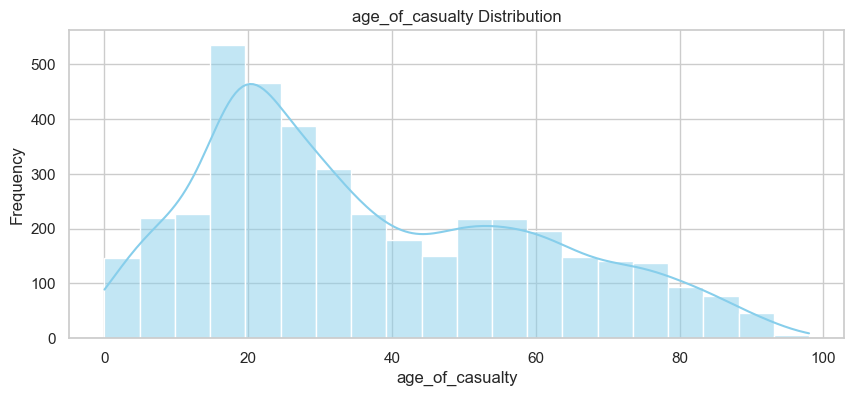

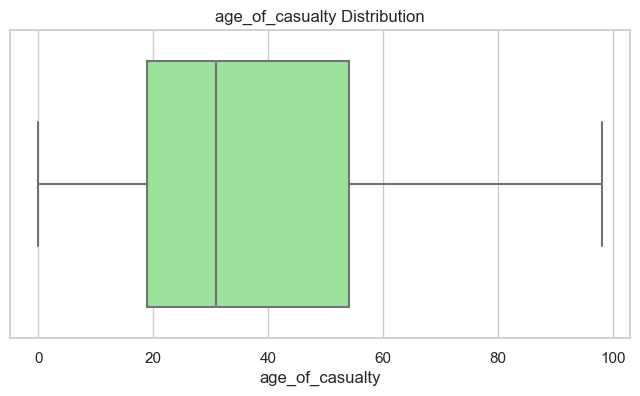

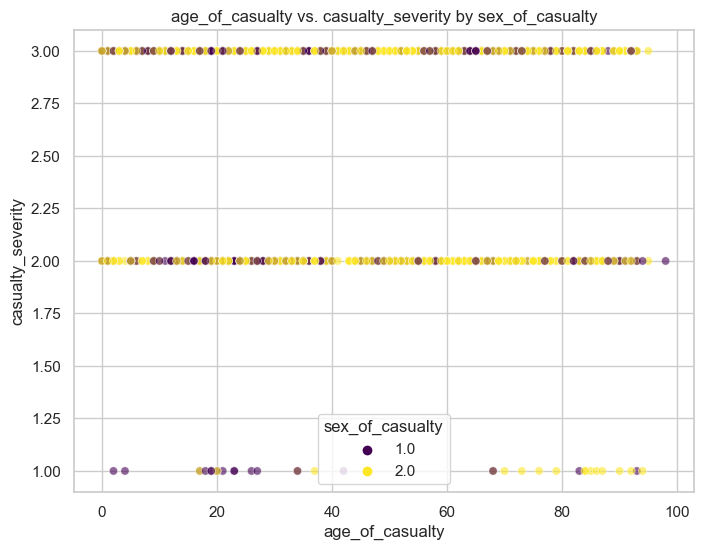

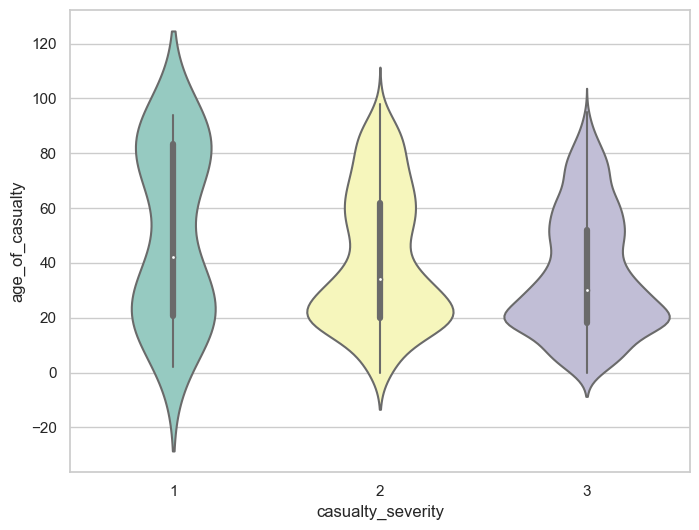

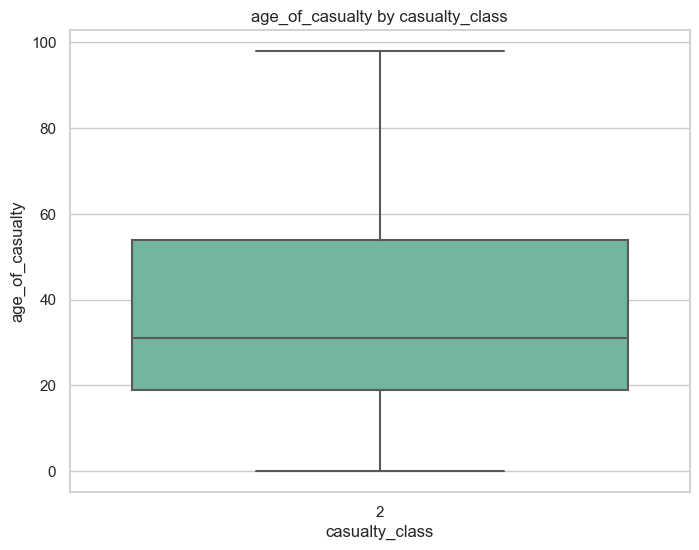

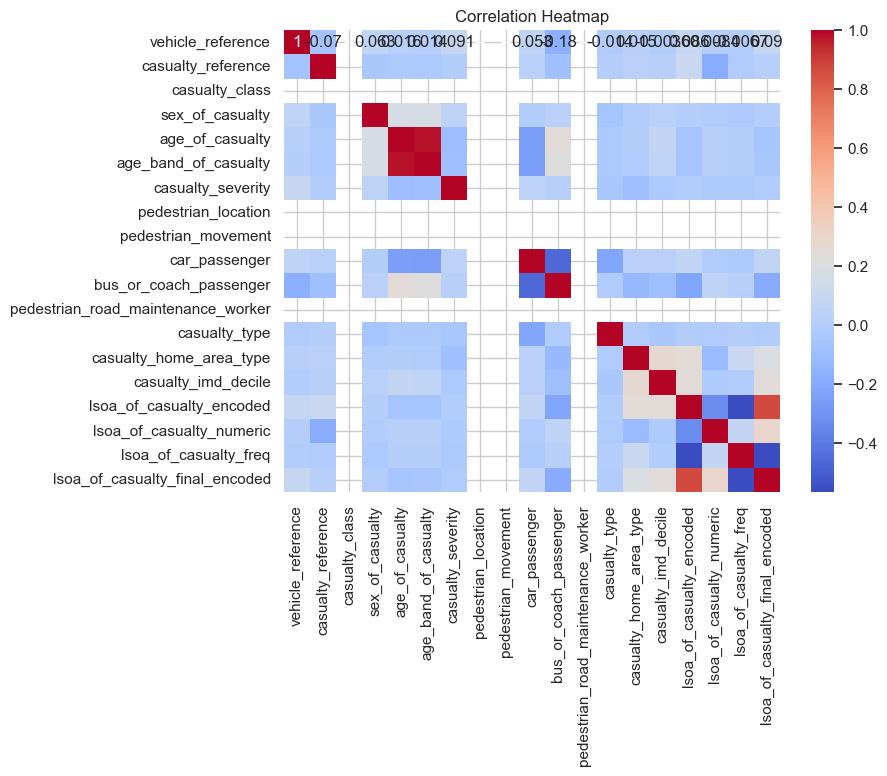

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
Plotting for Labeled DataFrame: df_passenger_FS_labeled


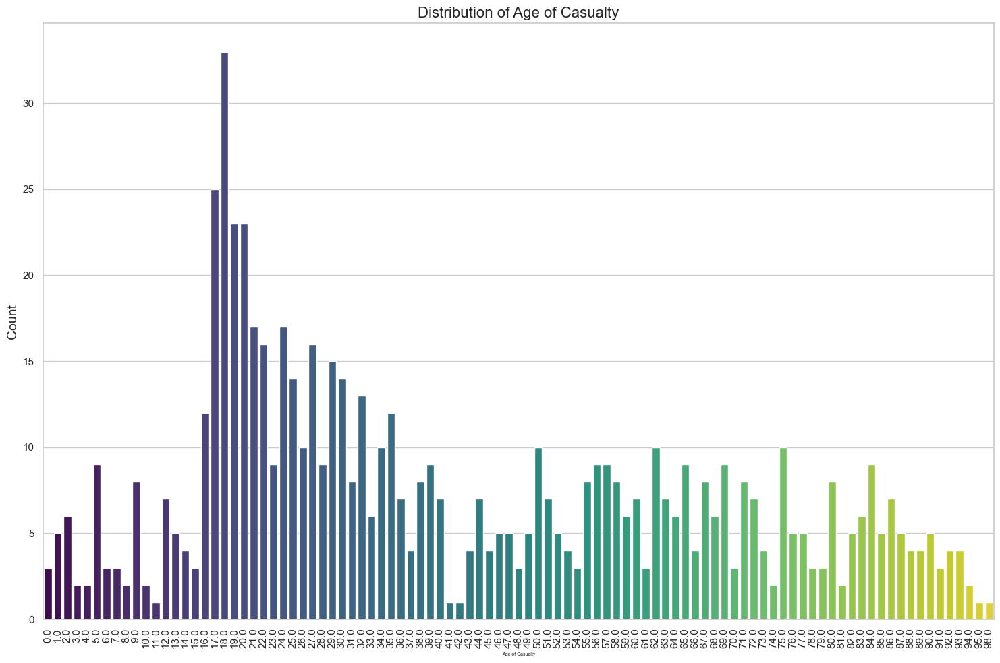

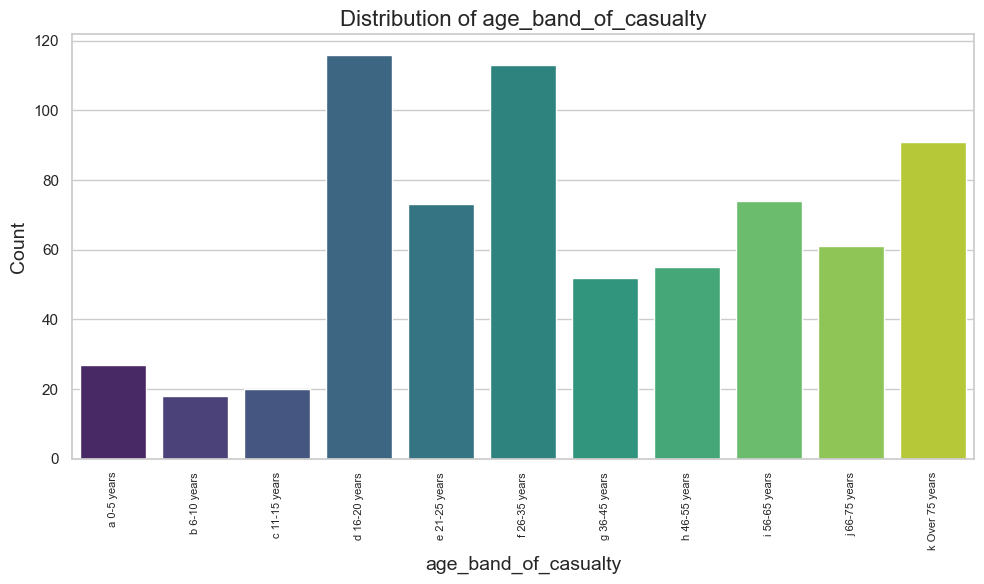

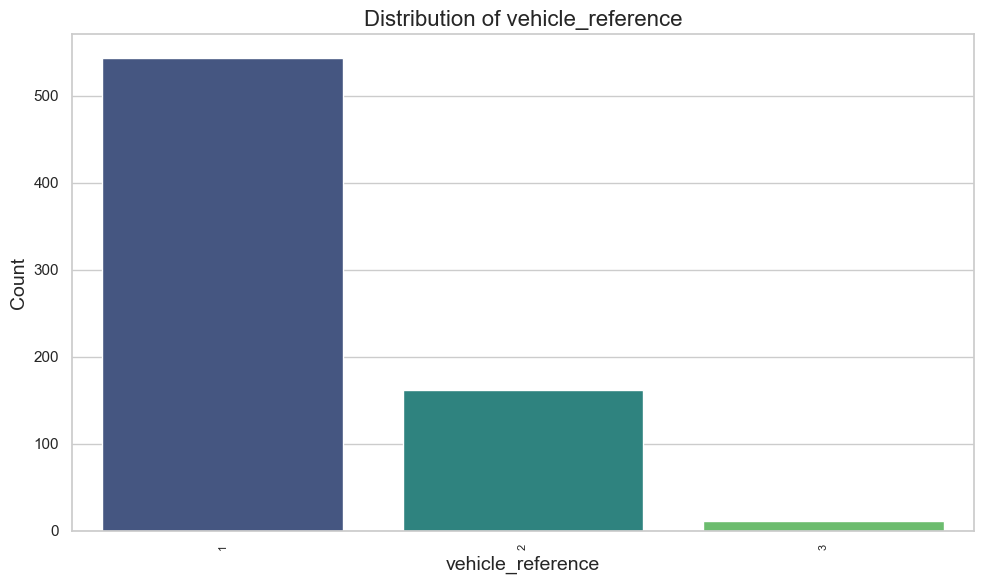

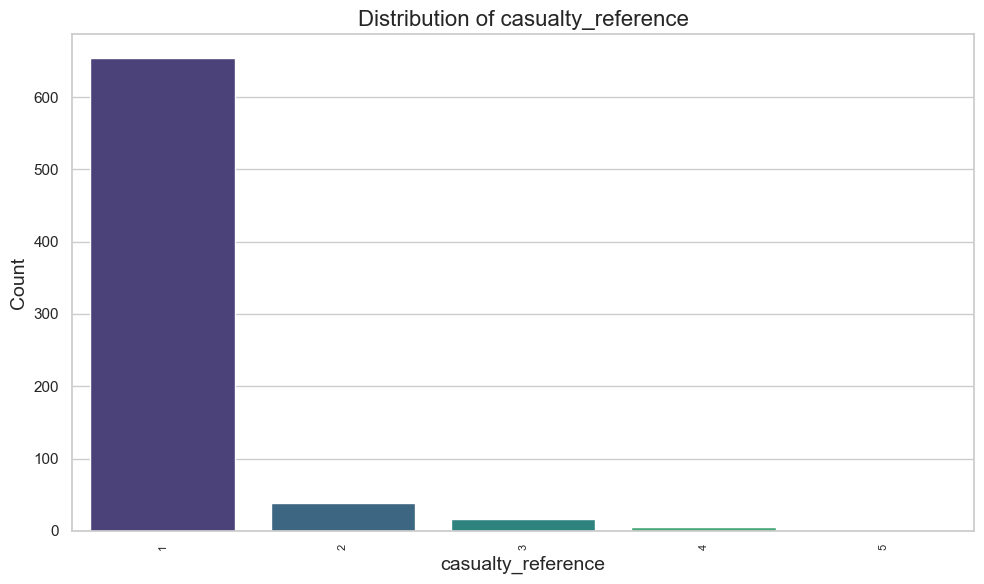

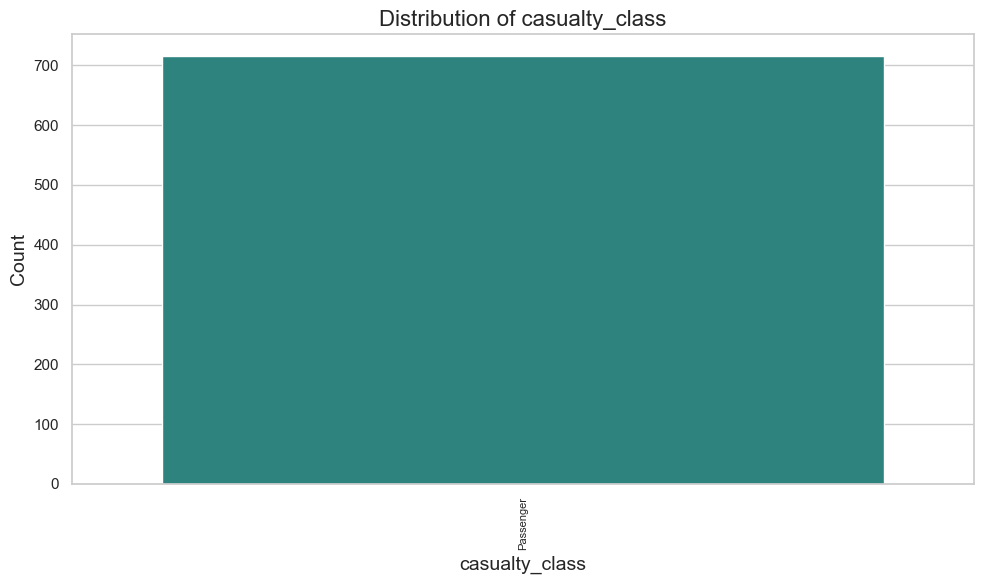

...

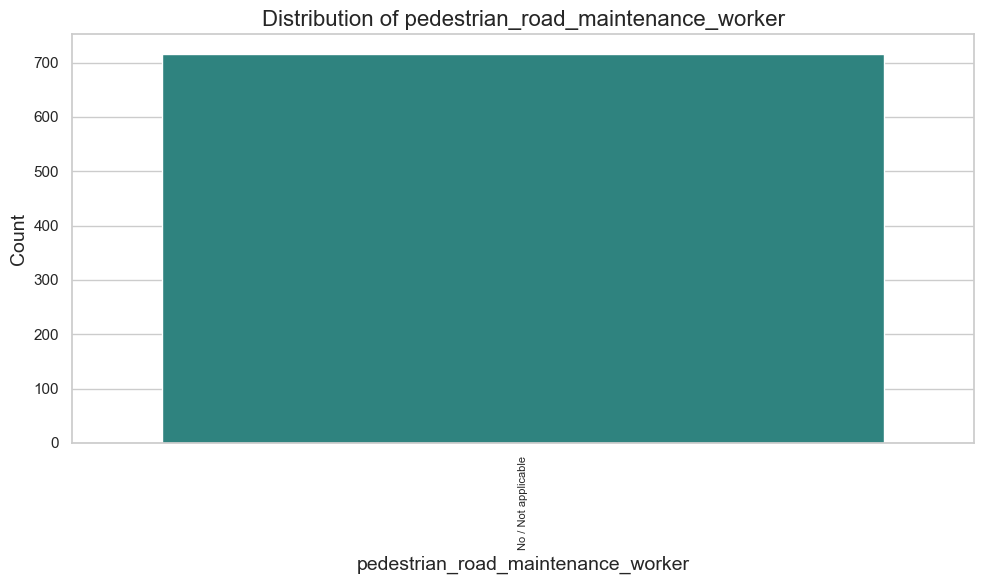

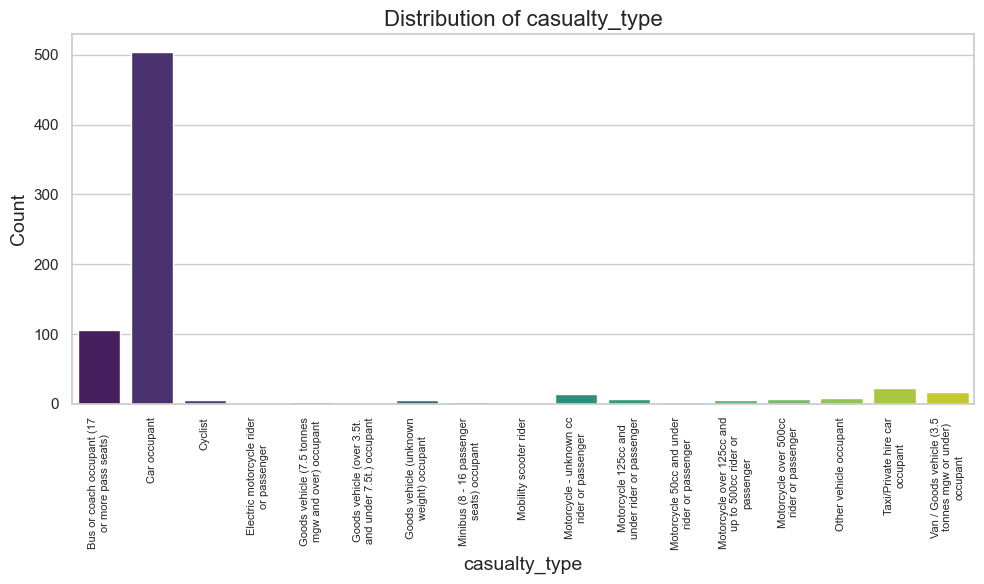

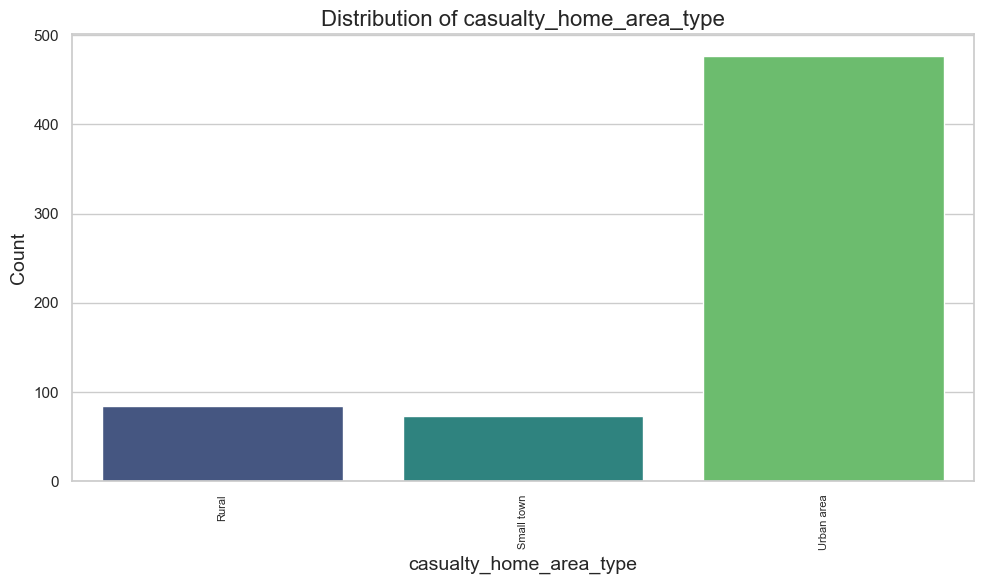

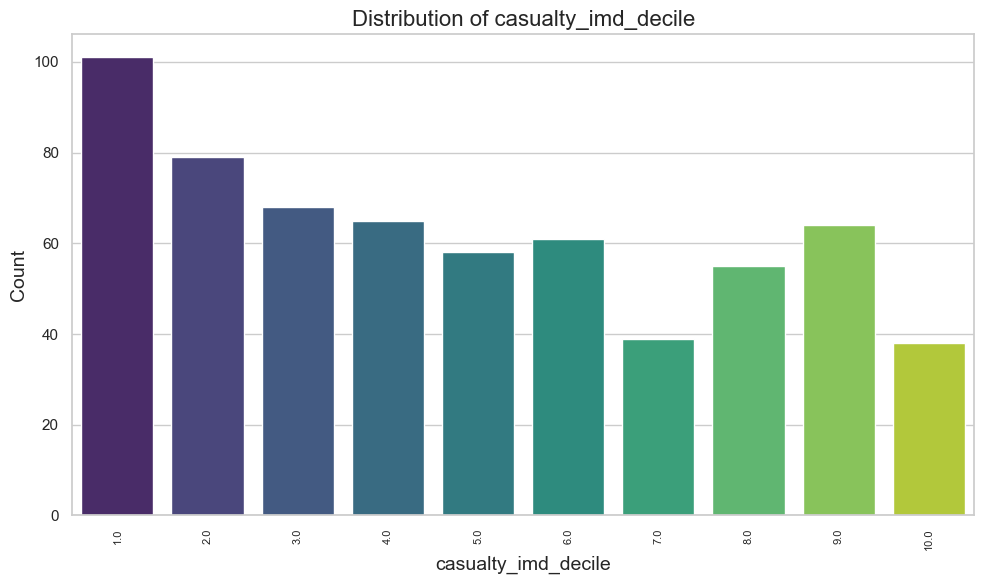

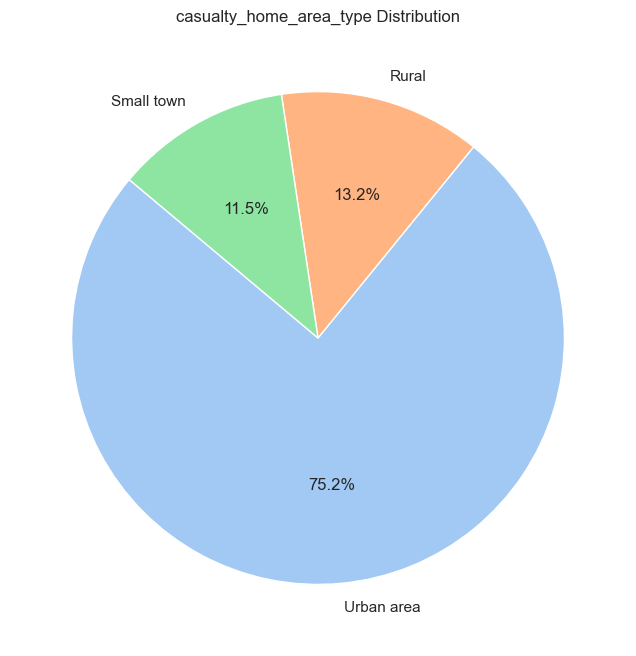

Plotting for Original DataFrame: df_passenger_FS


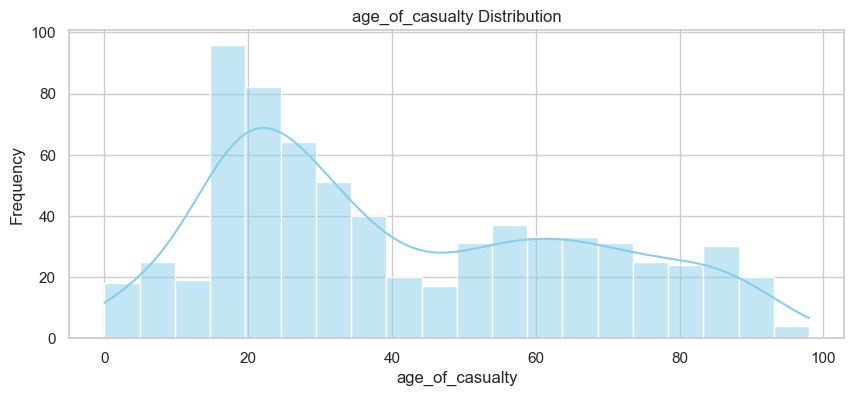

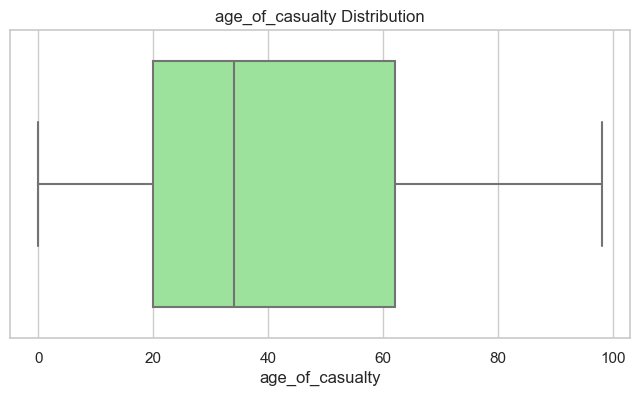

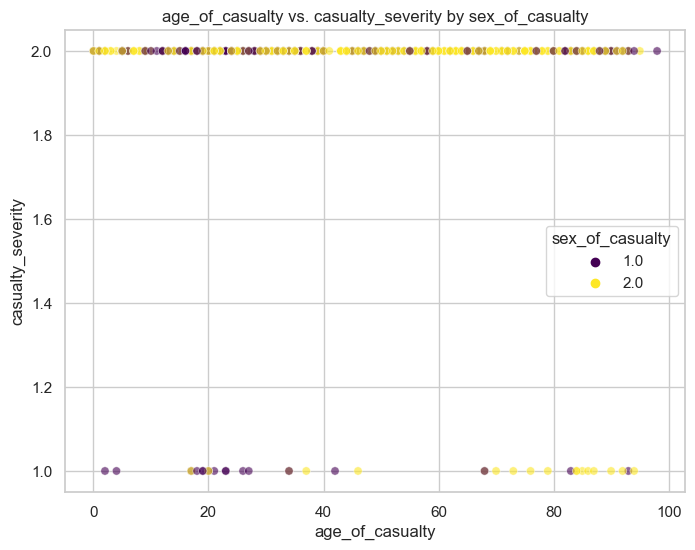

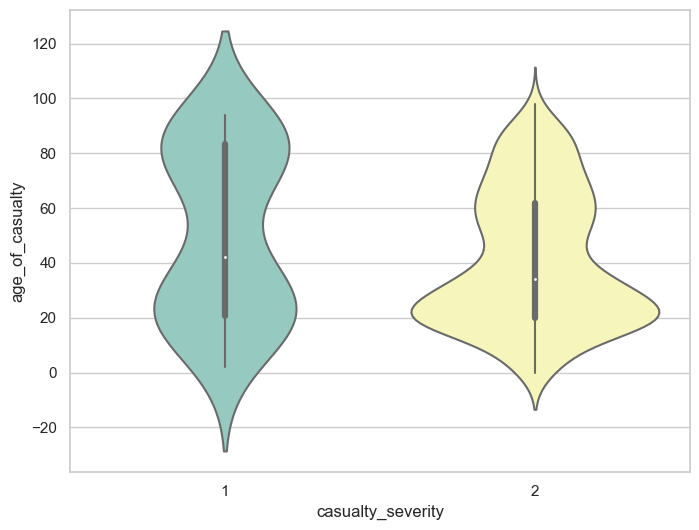

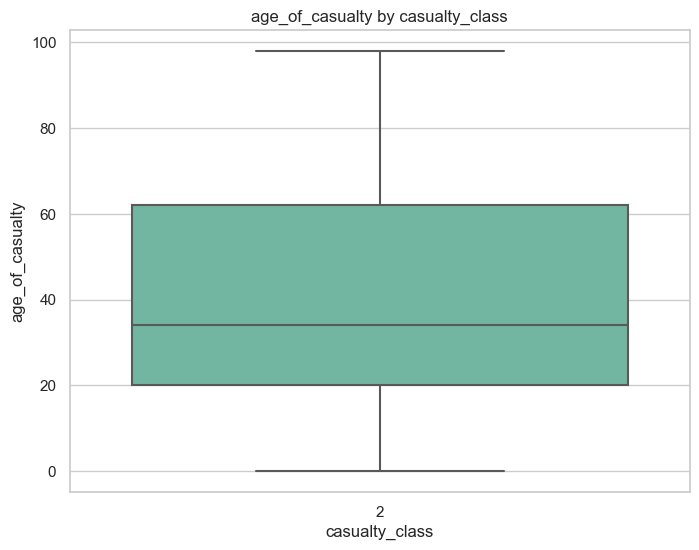

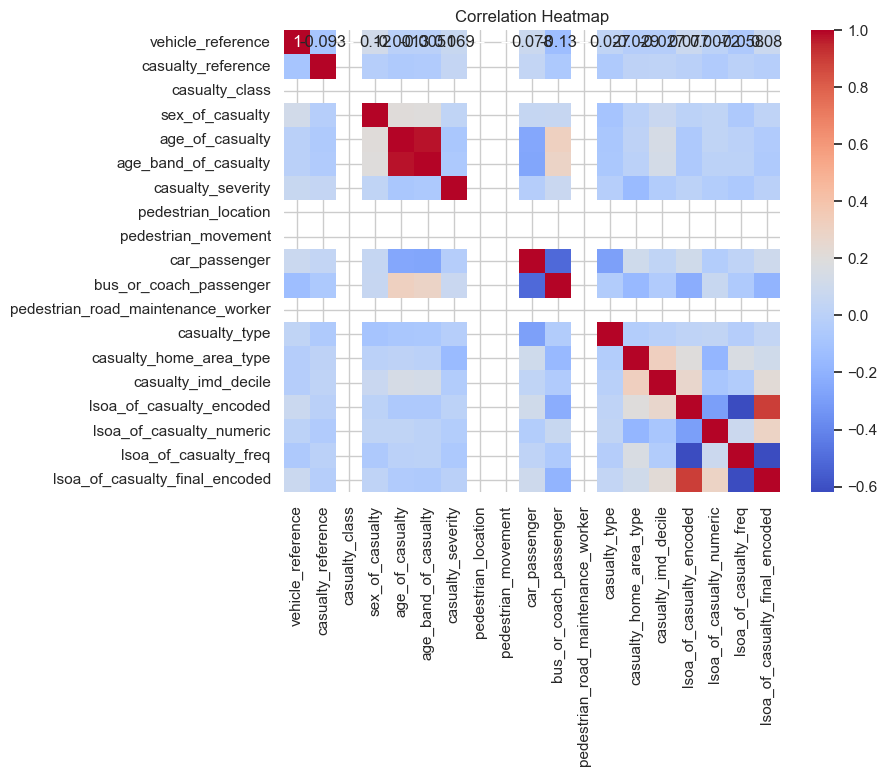

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
Plotting for Labeled DataFrame: df_passenger_fatal_labeled


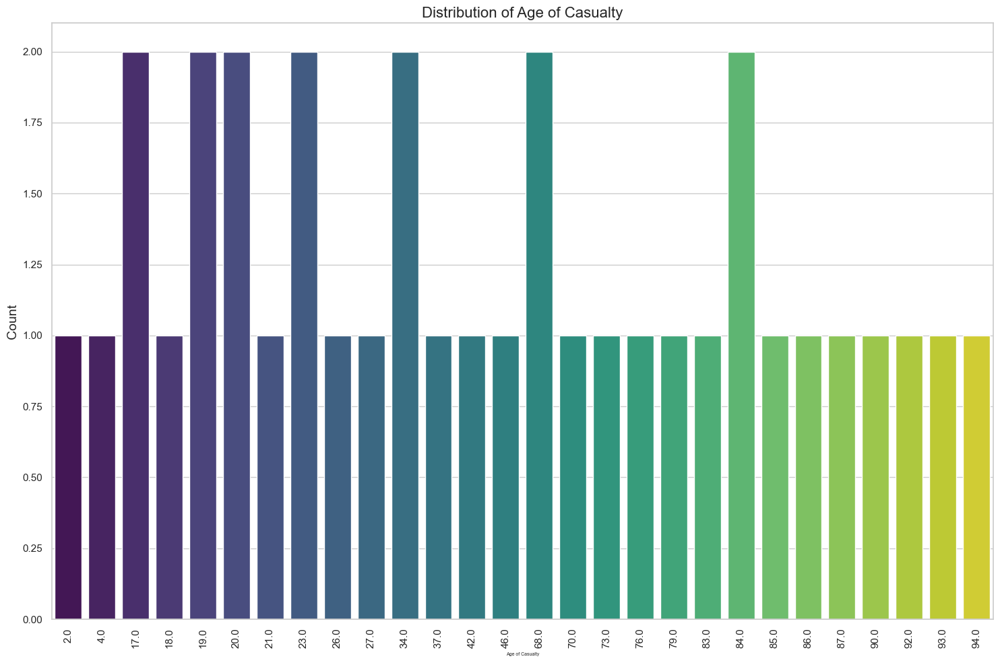

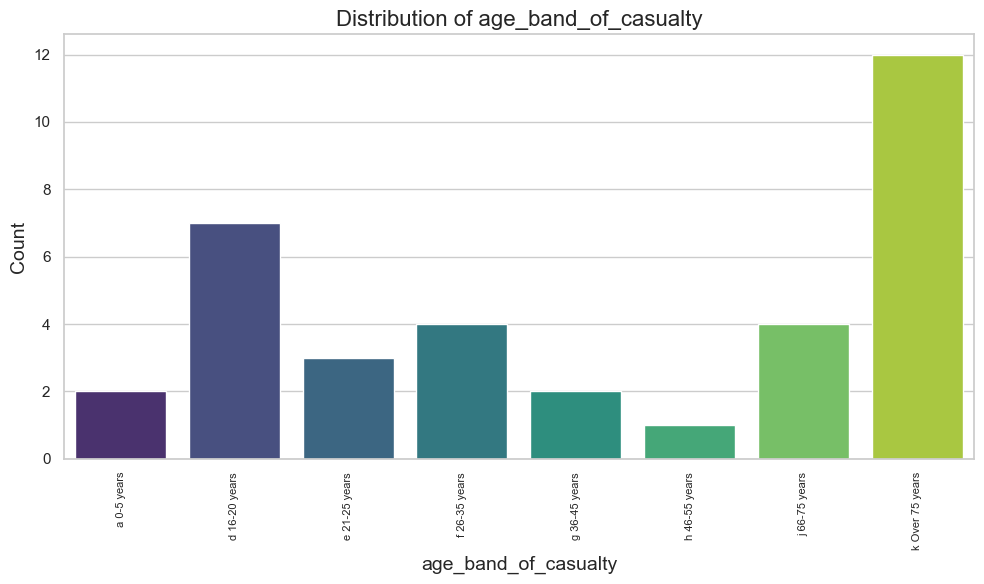

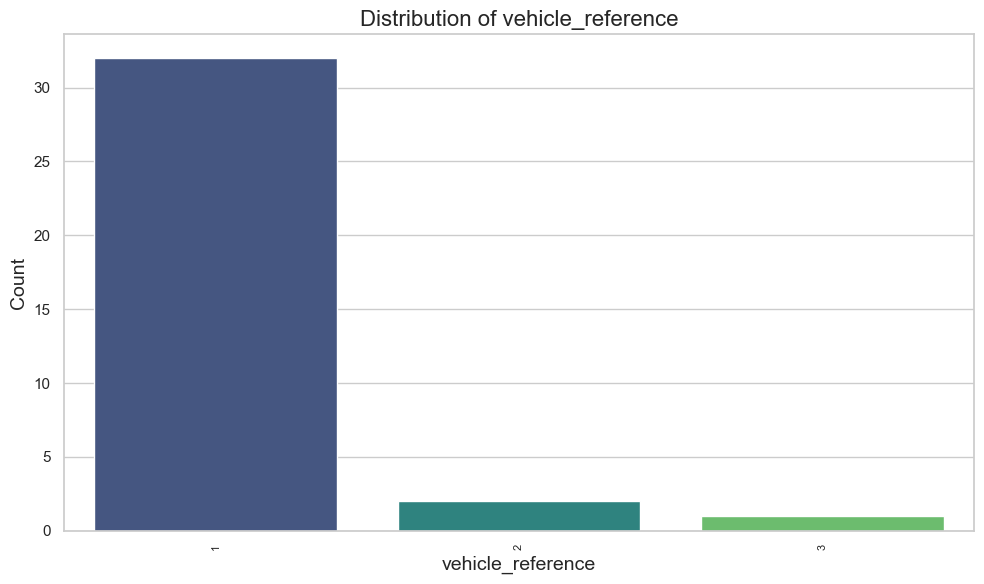

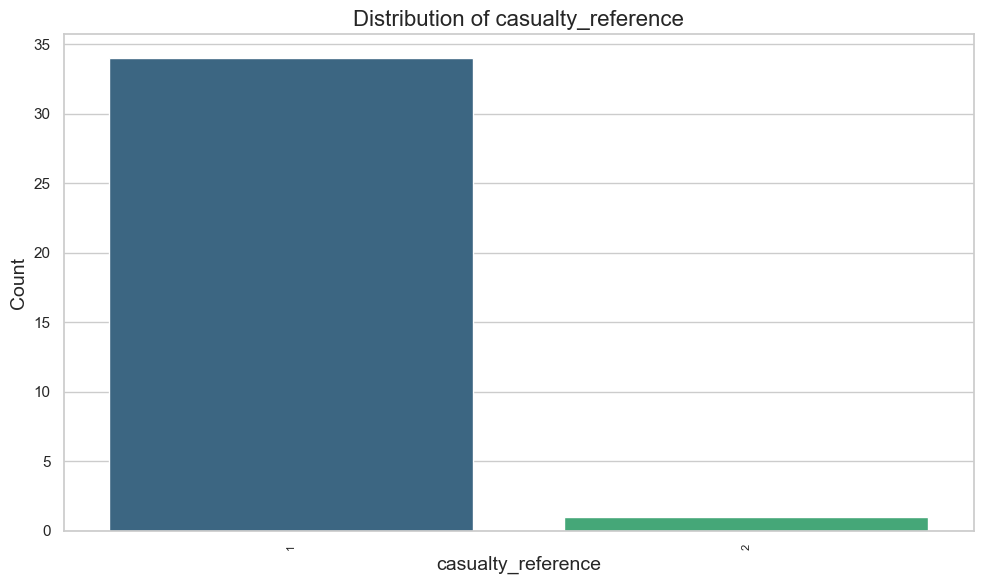

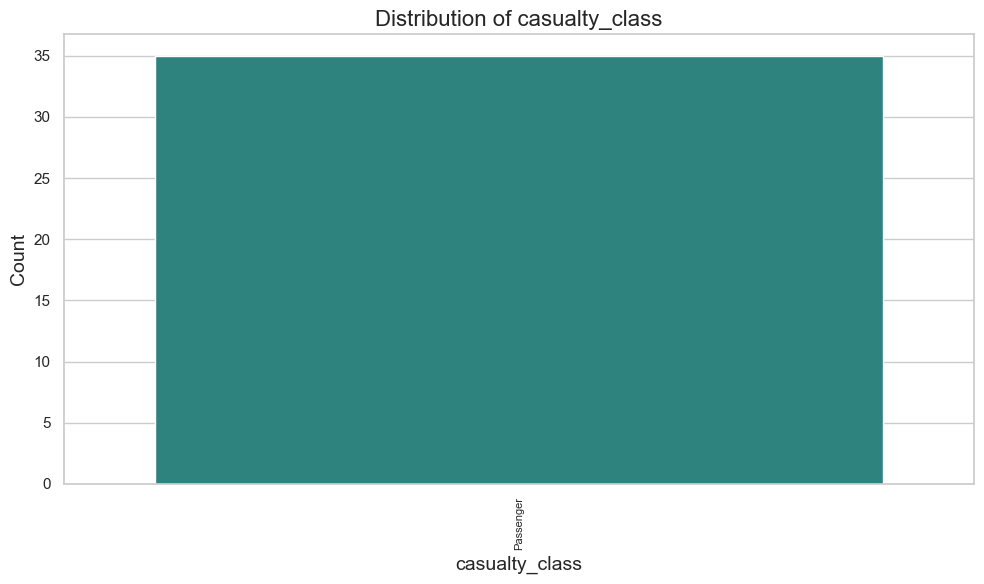

...

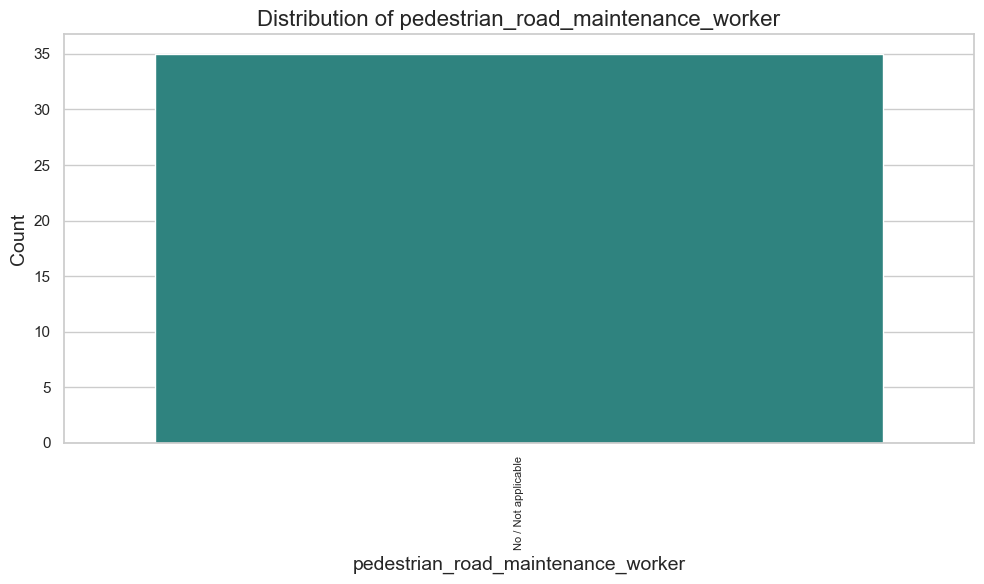

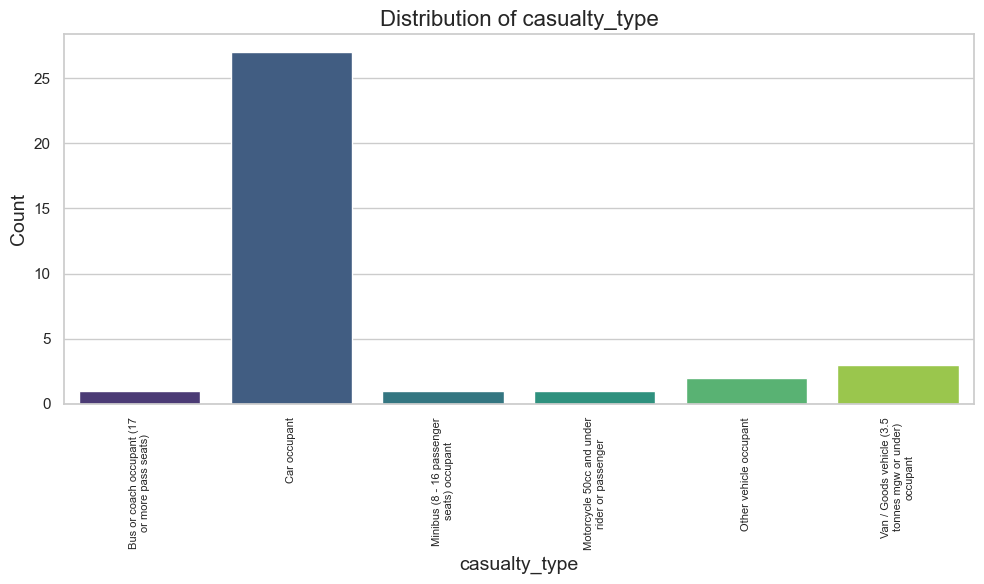

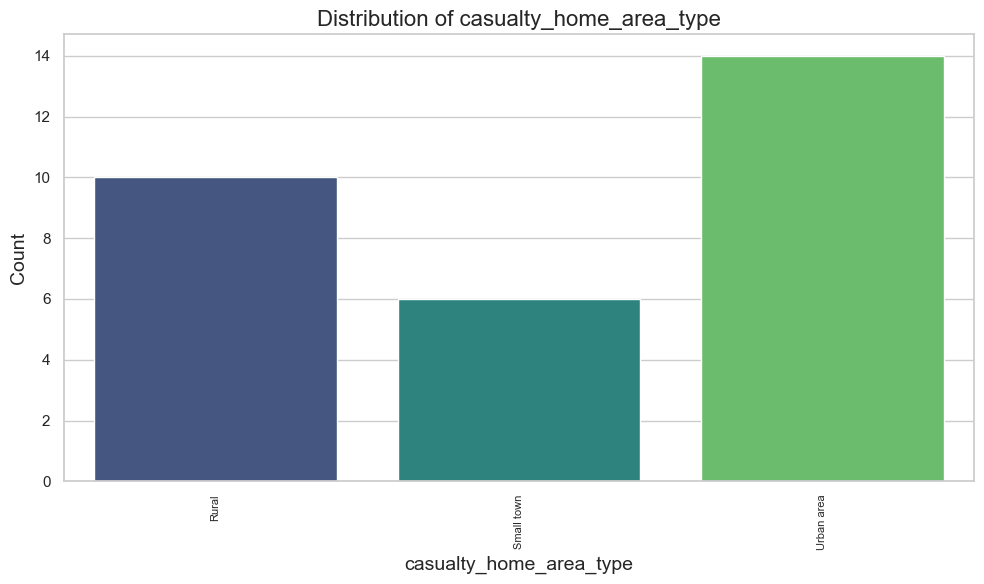

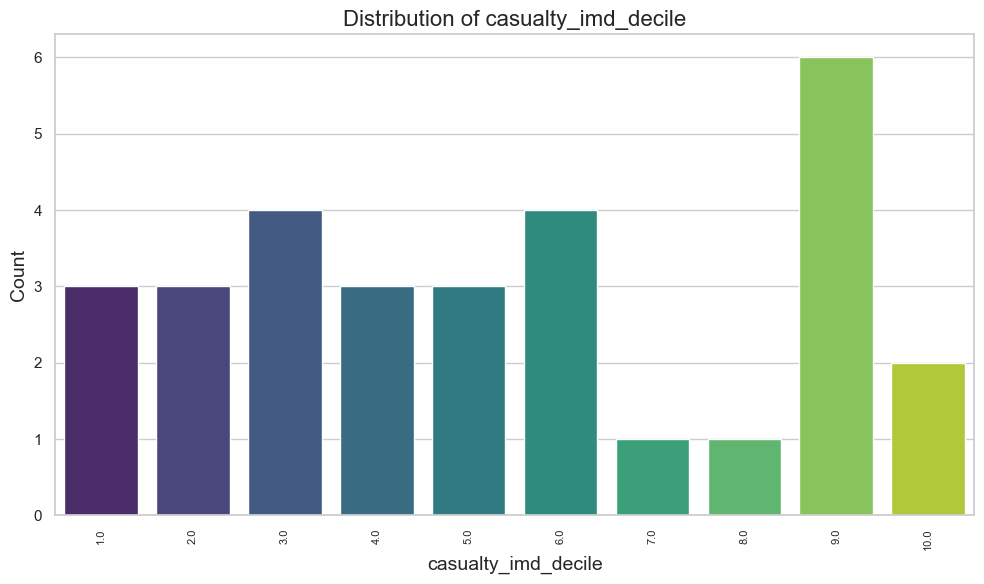

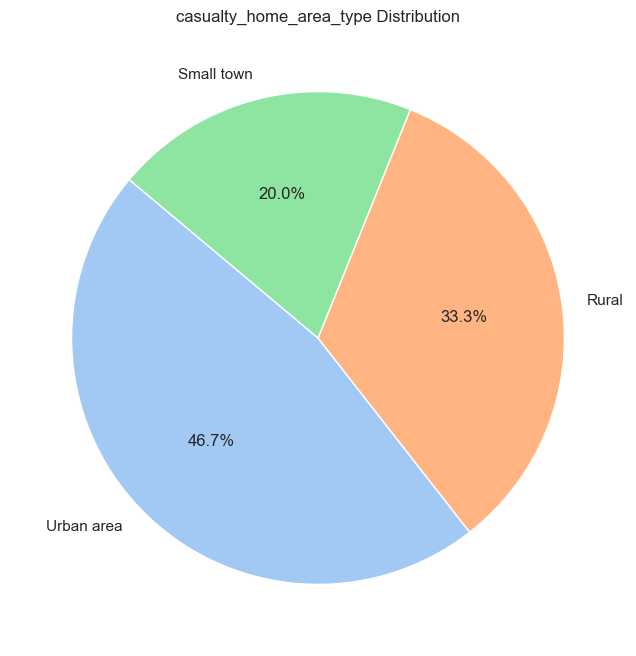

Plotting for Original DataFrame: df_passenger_fatal


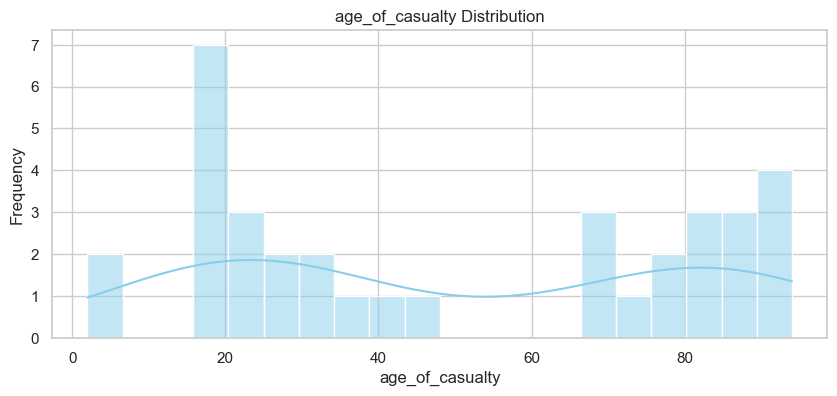

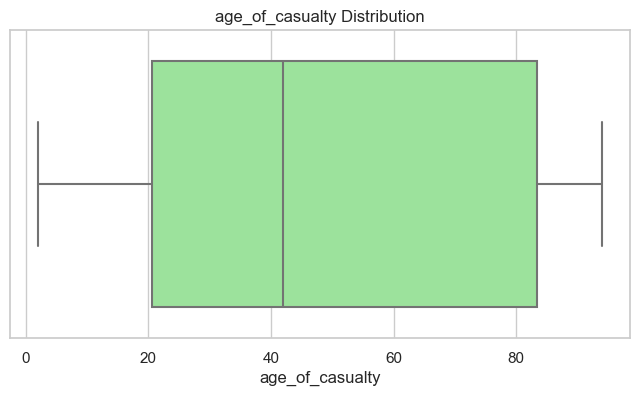

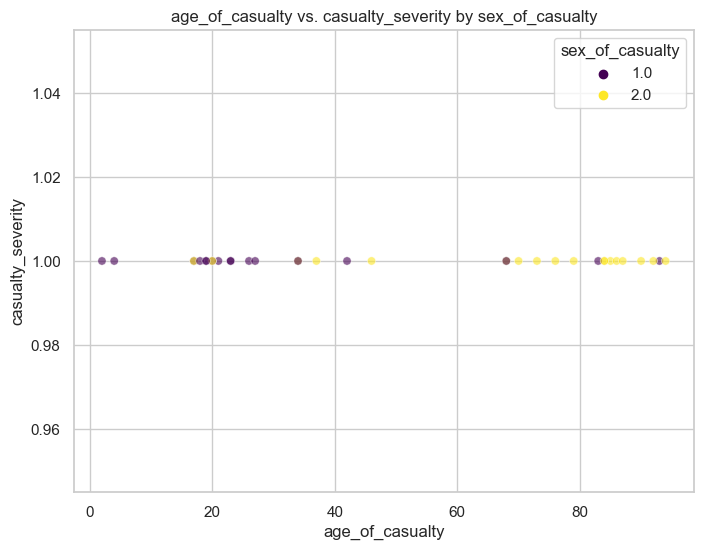

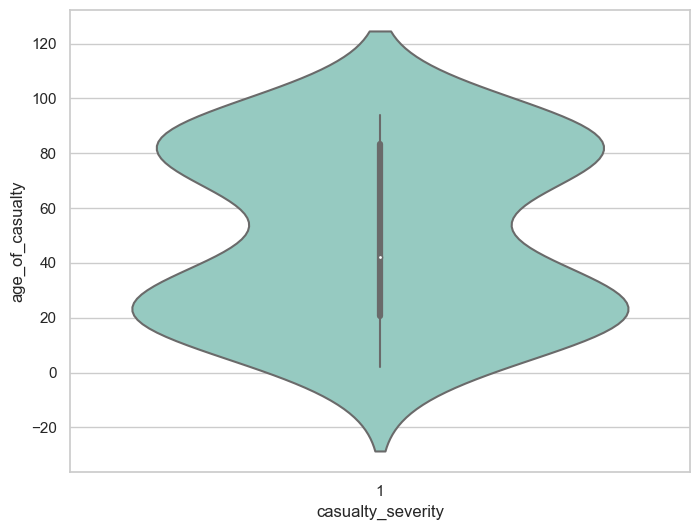

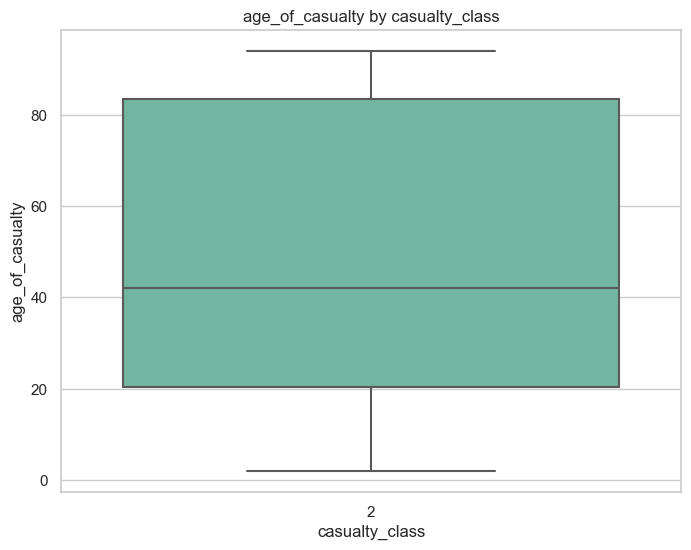

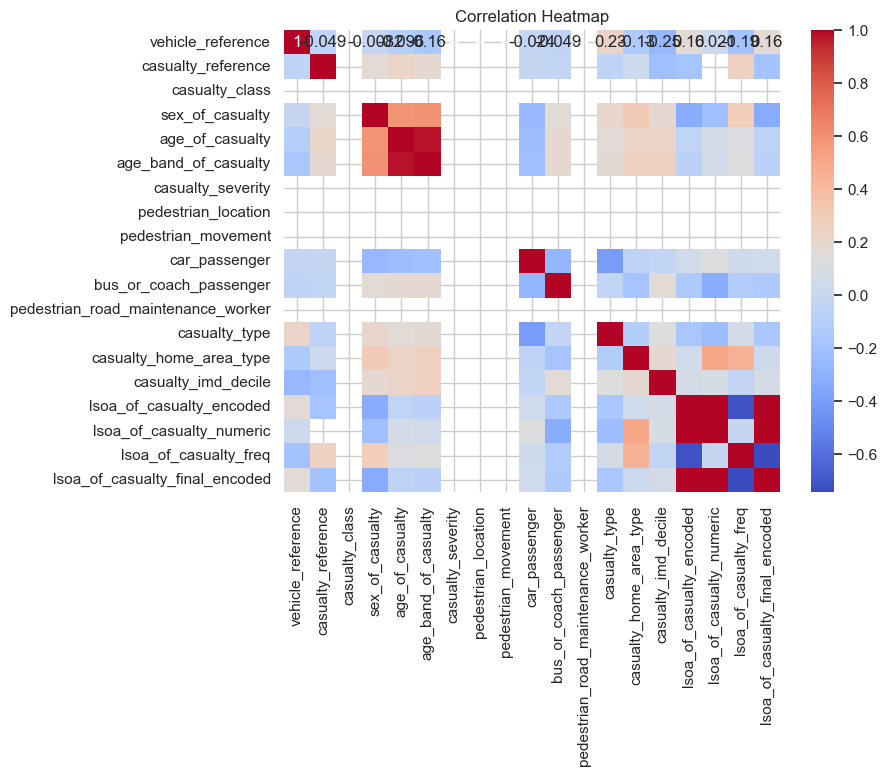

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
Plotting for Labeled DataFrame: df_female_labeled


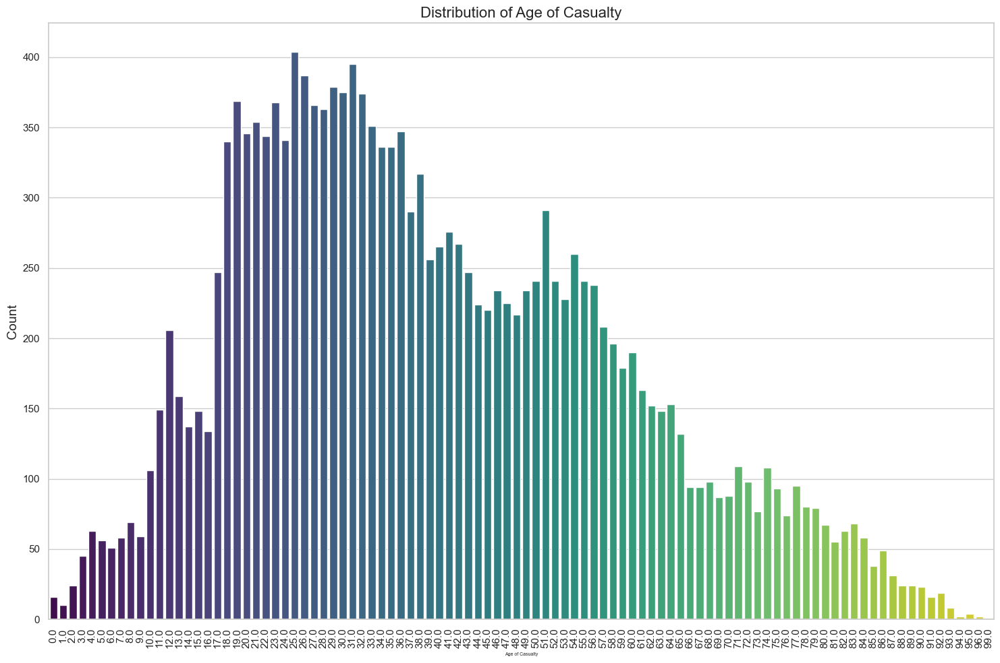

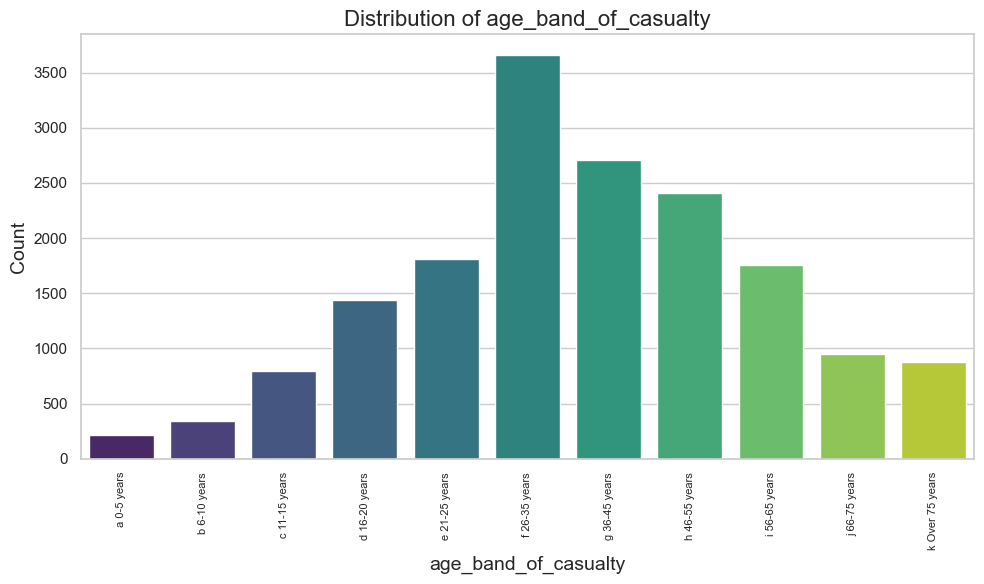

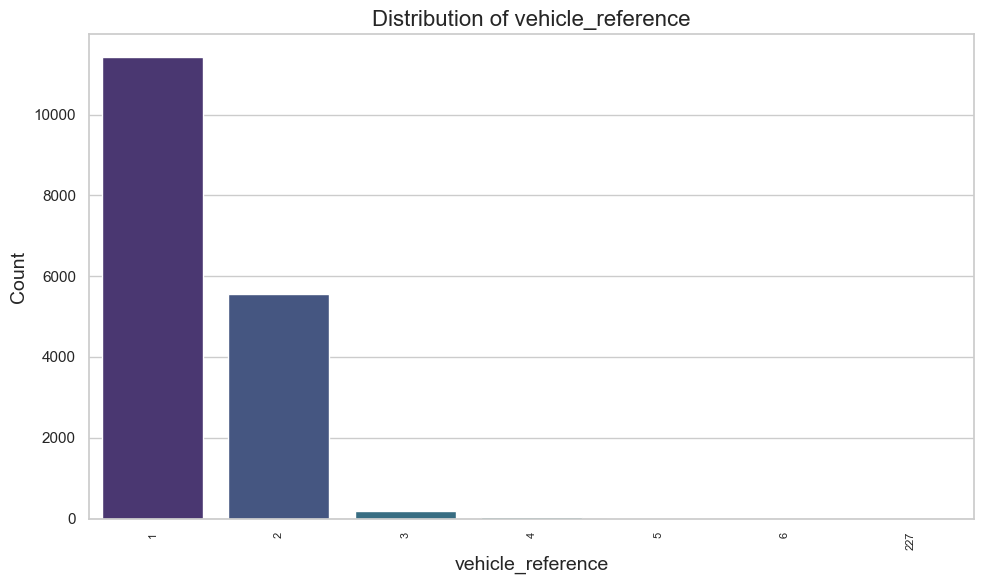

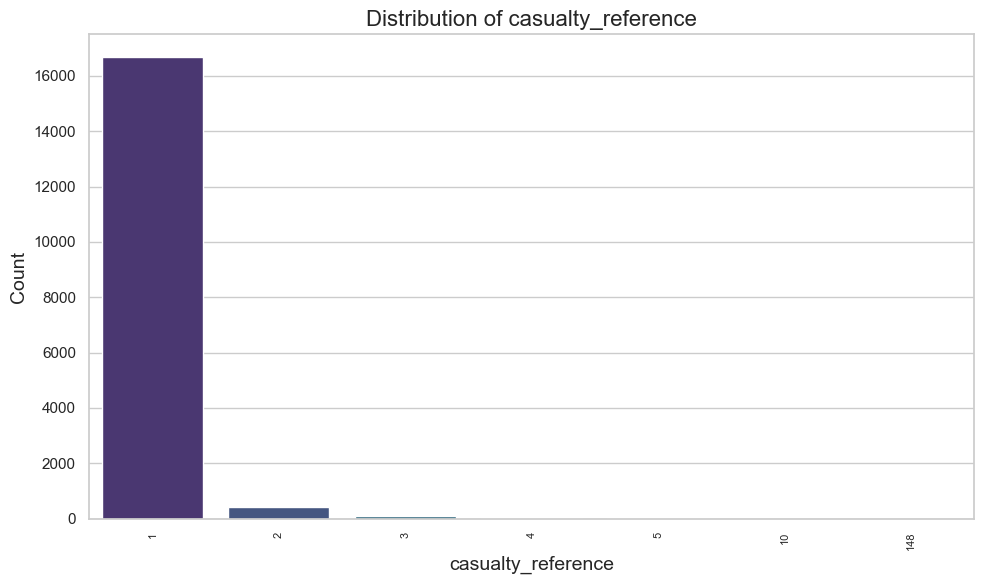

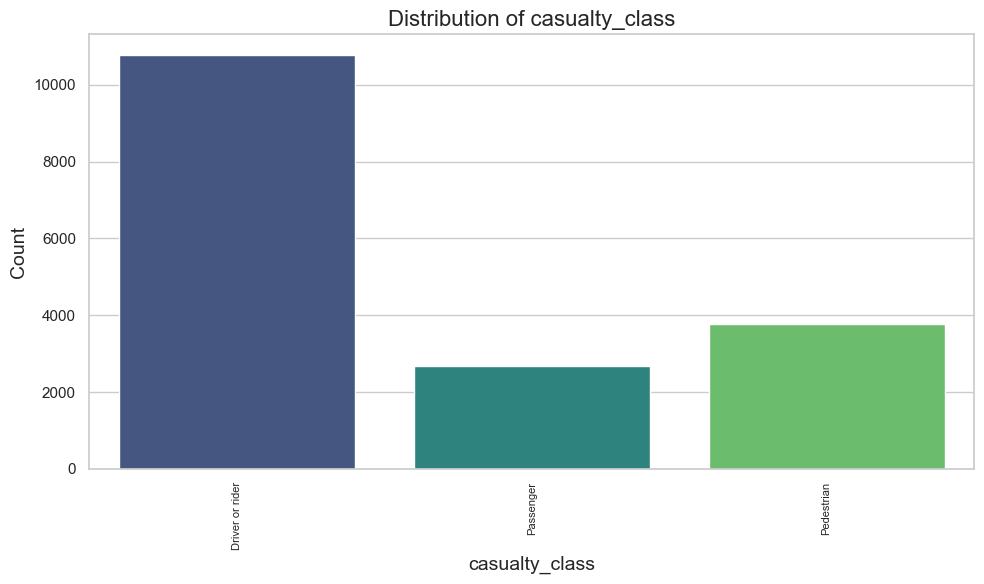

...

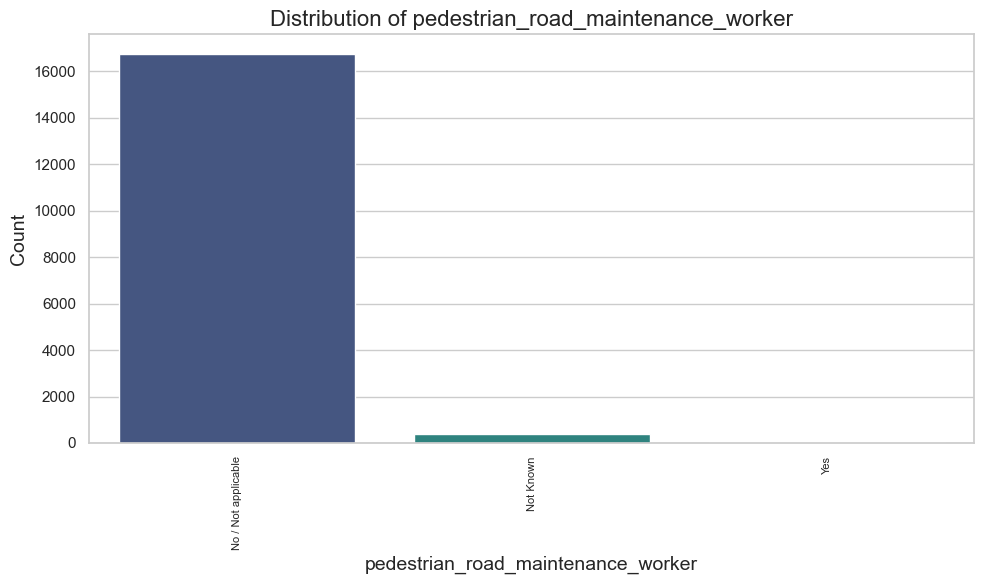

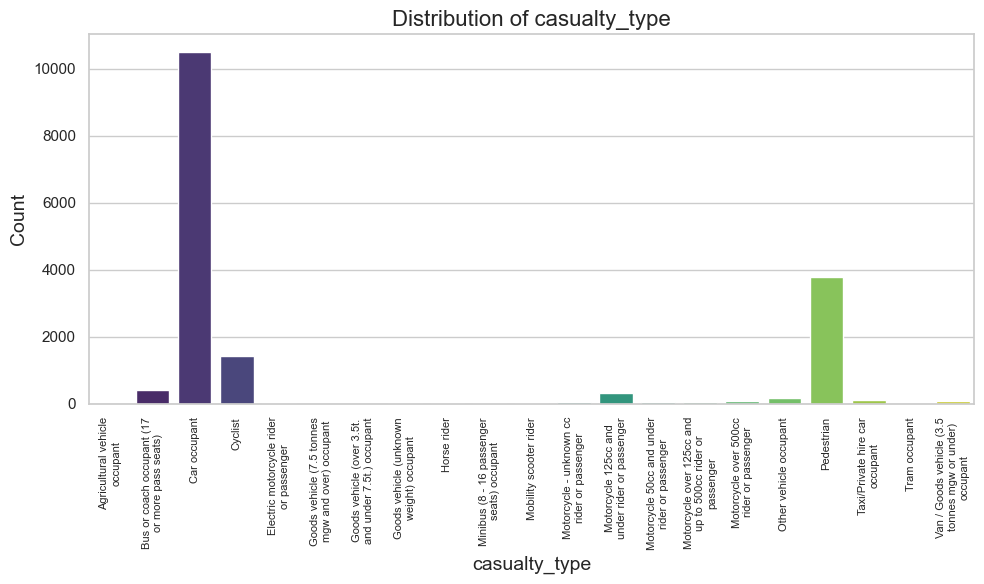

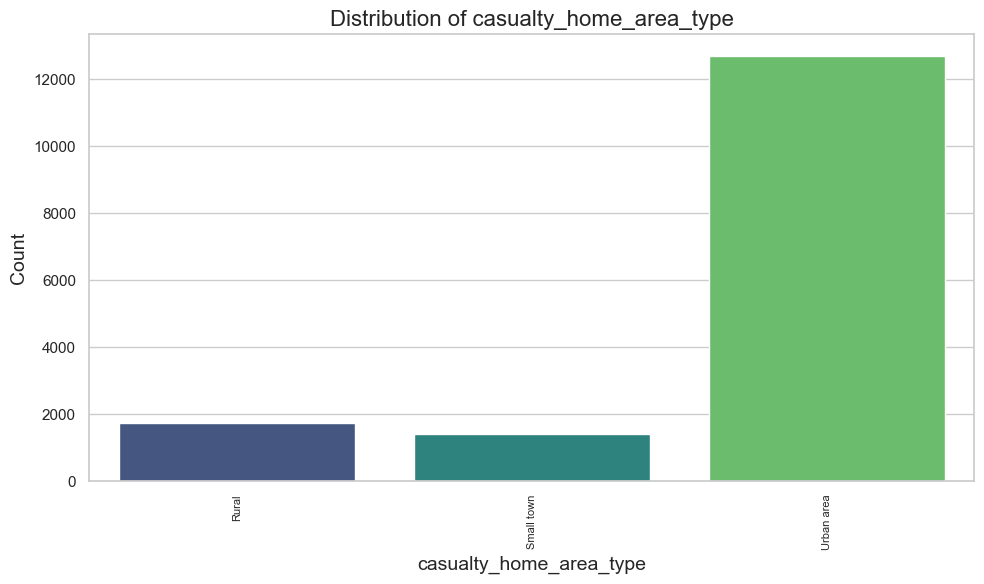

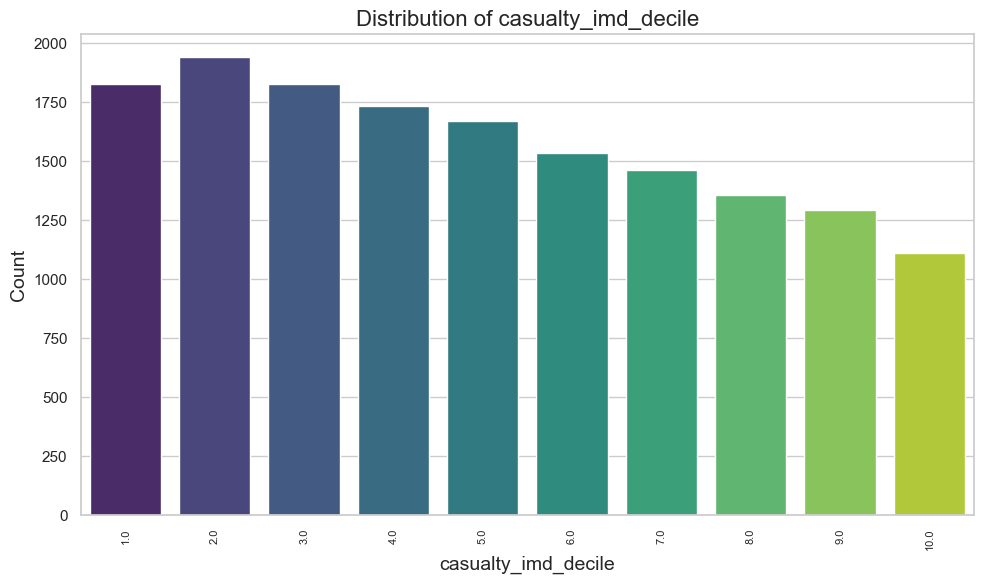

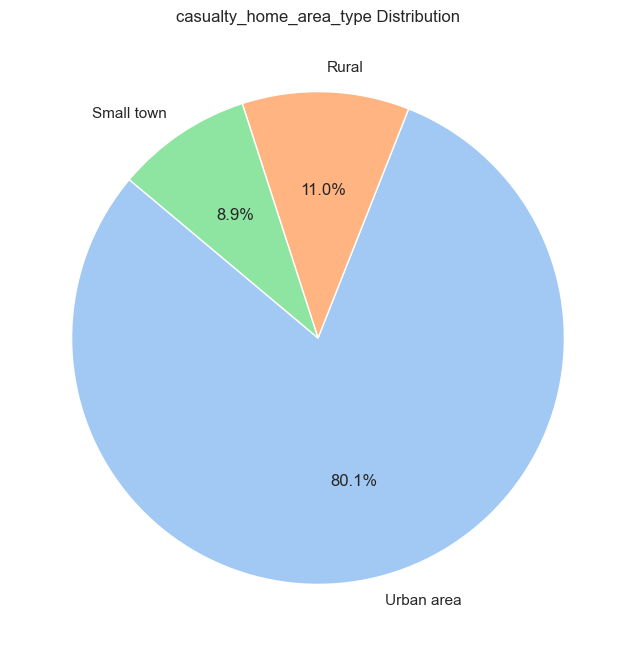

Plotting for Original DataFrame: df_female


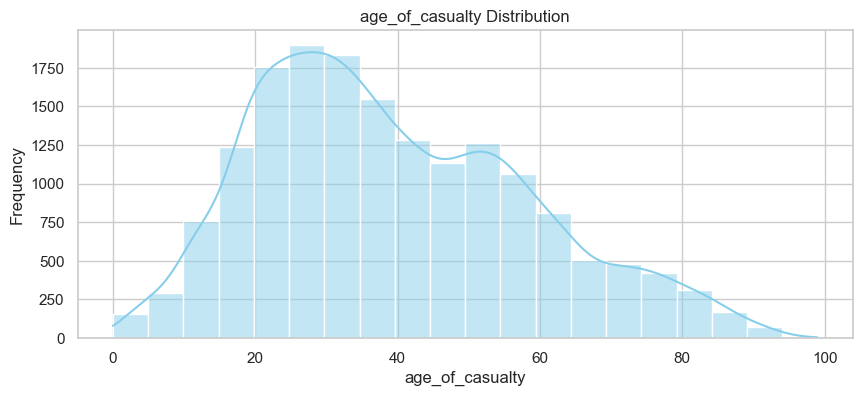

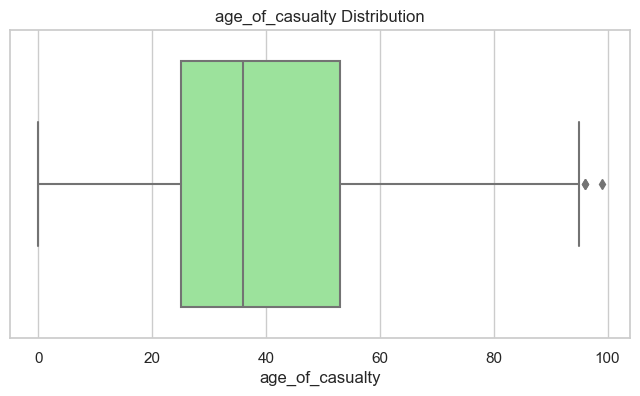

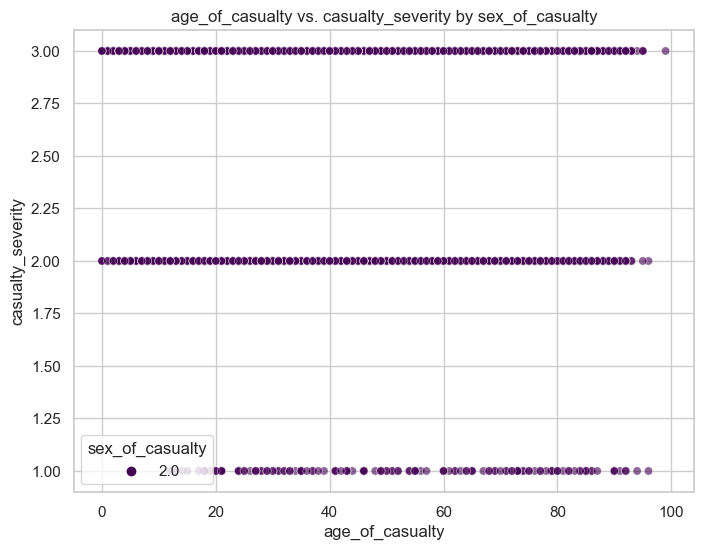

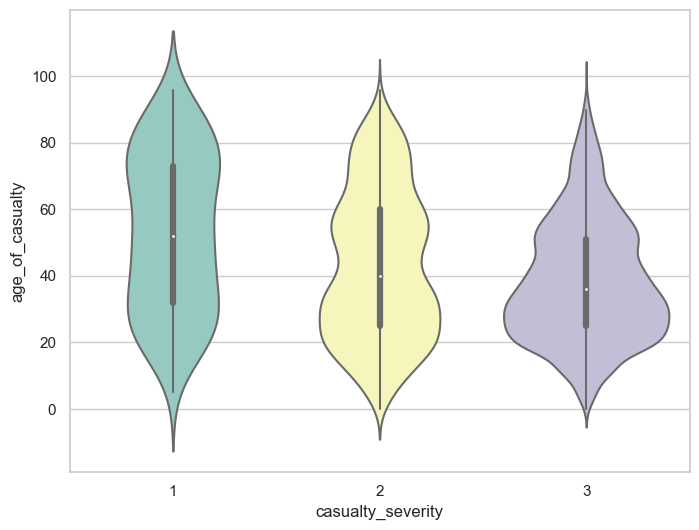

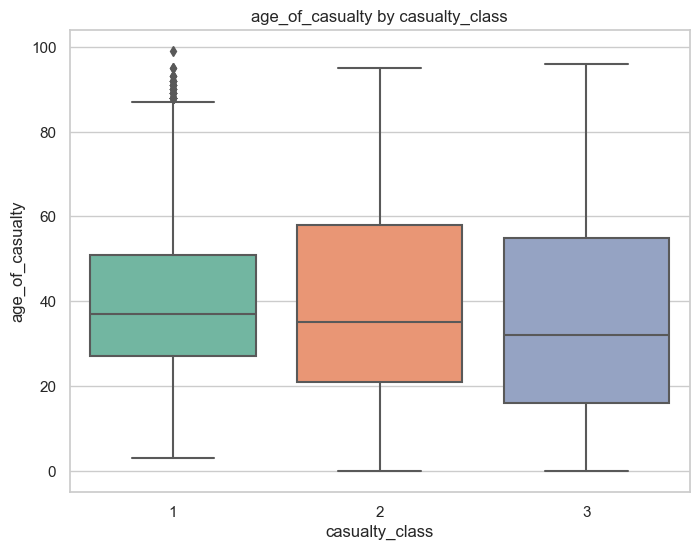

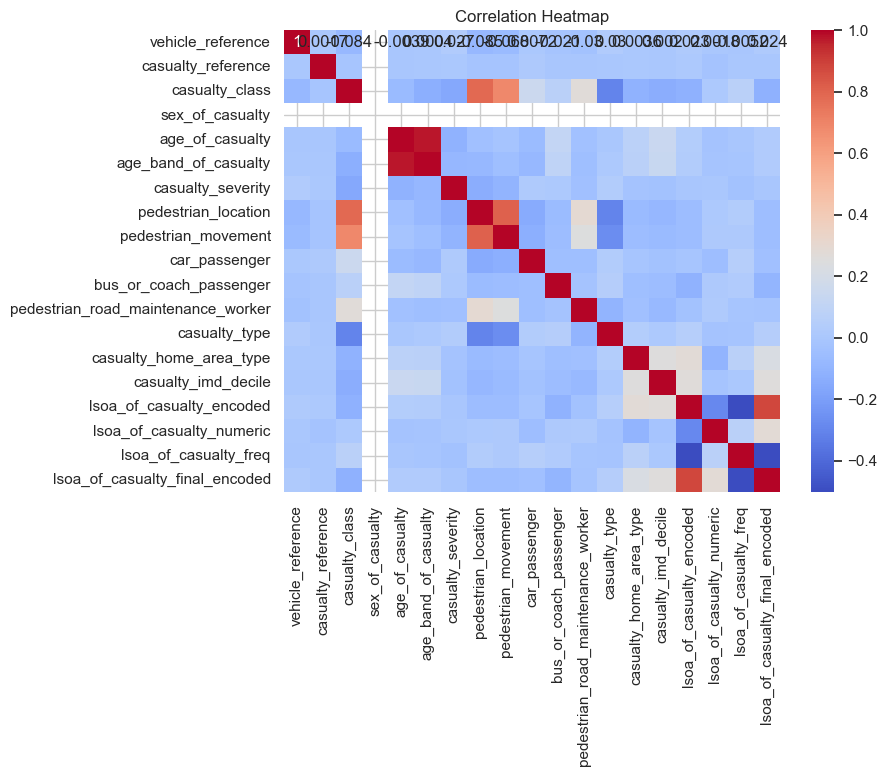

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
Plotting for Labeled DataFrame: df_female_FS_labeled


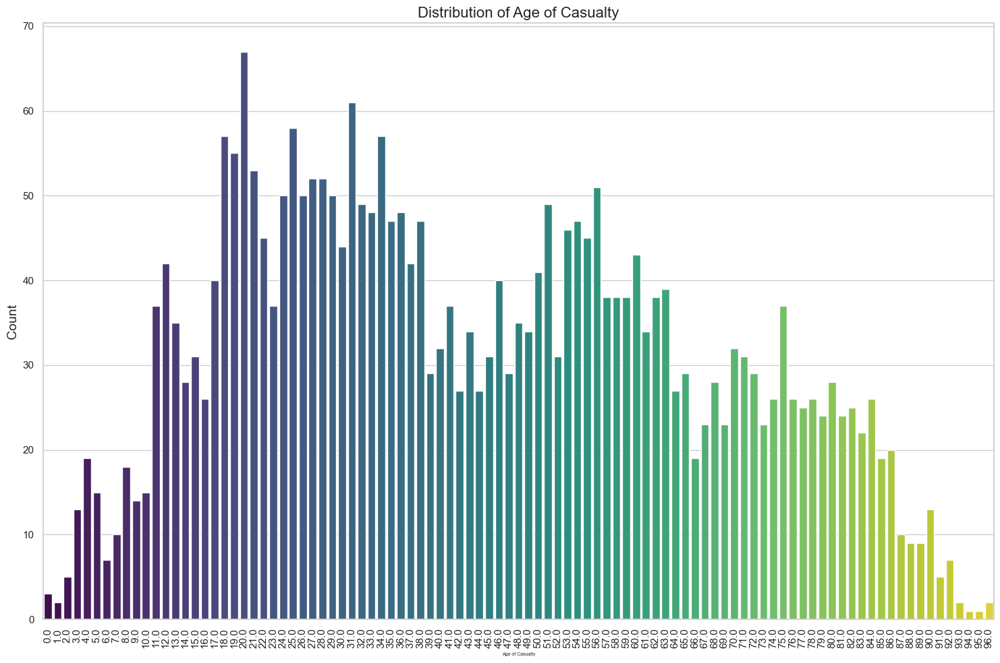

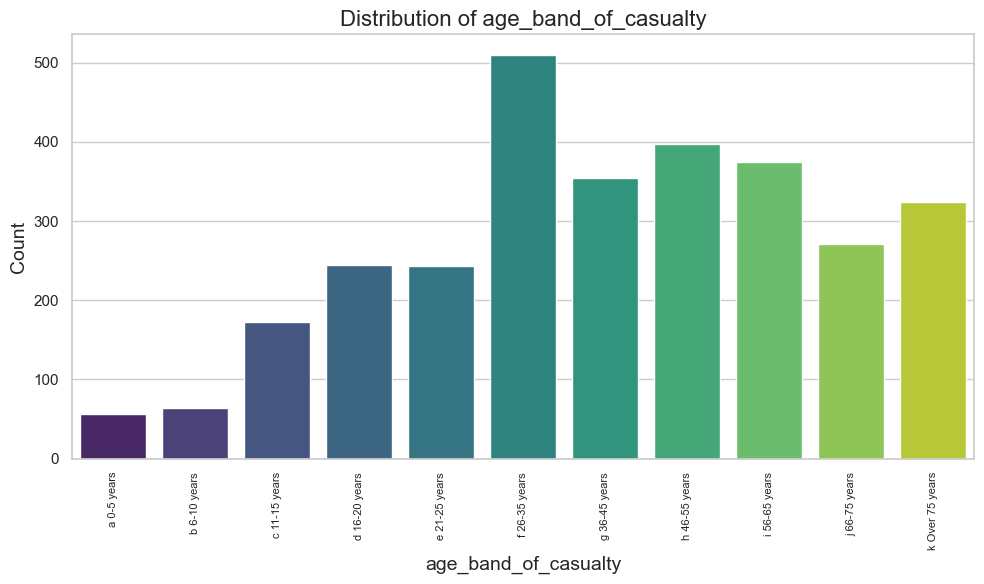

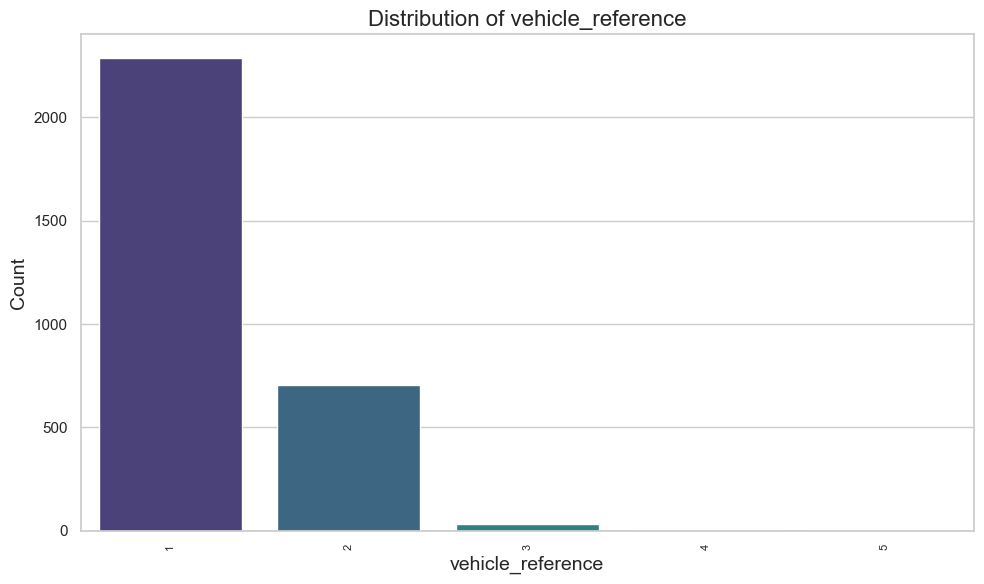

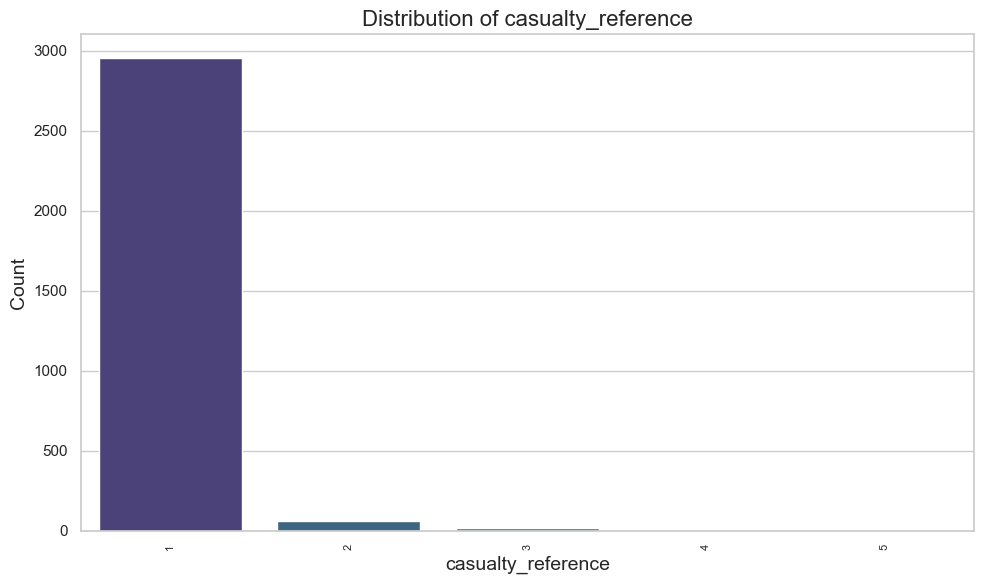

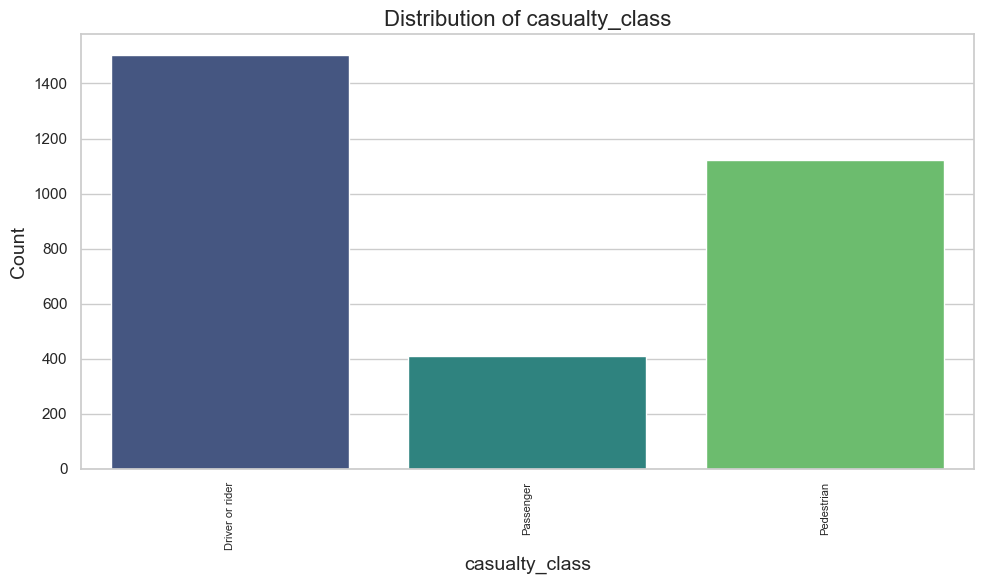

...

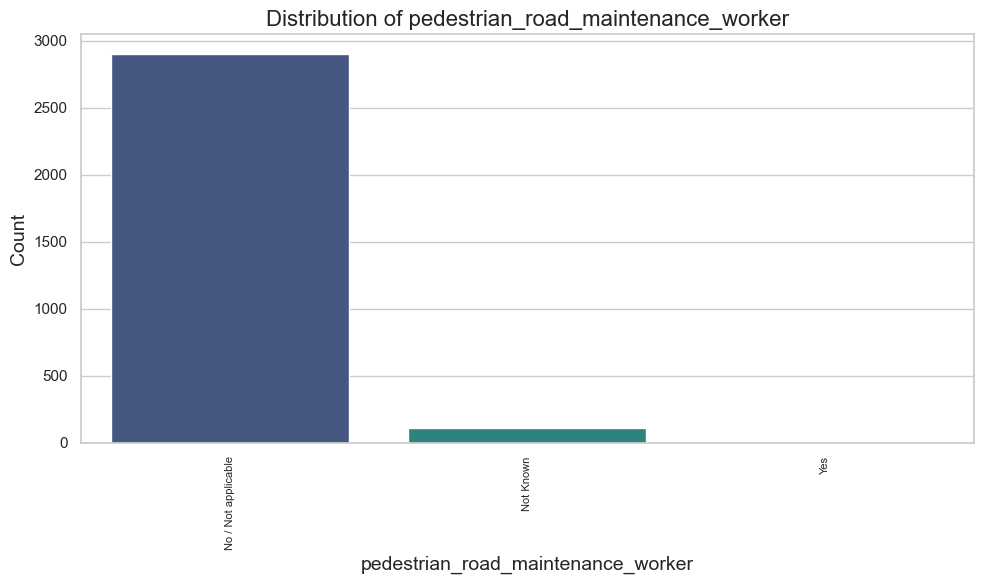

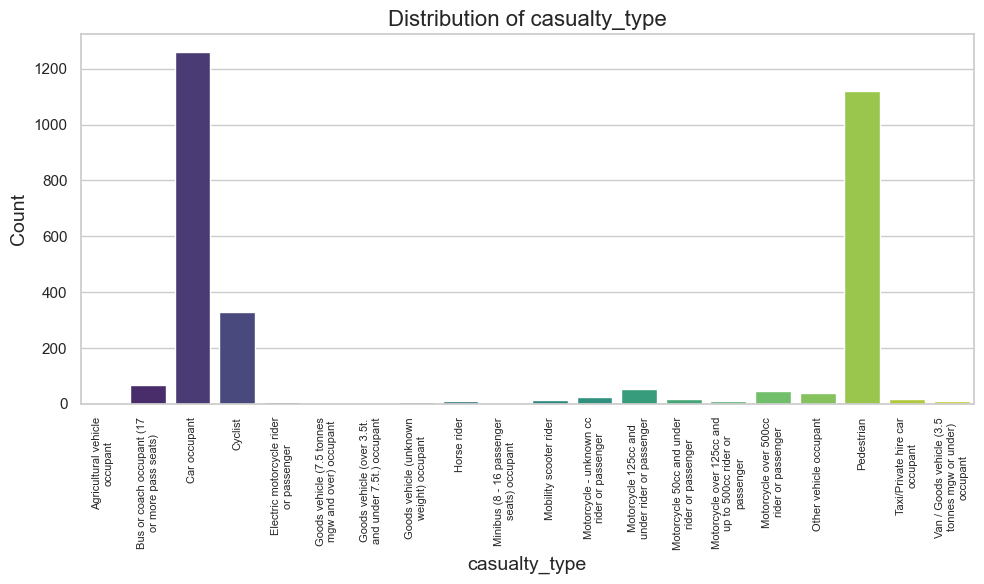

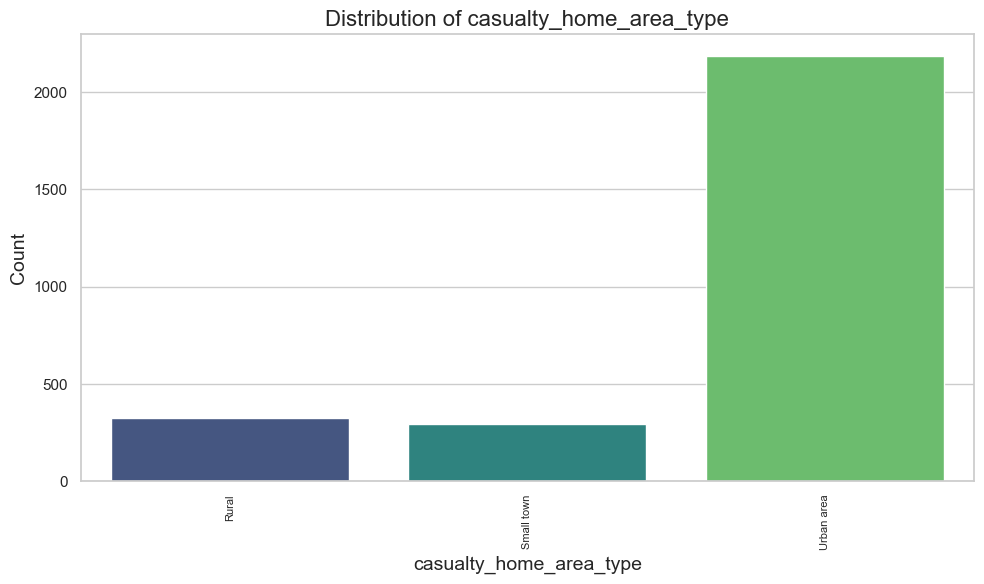

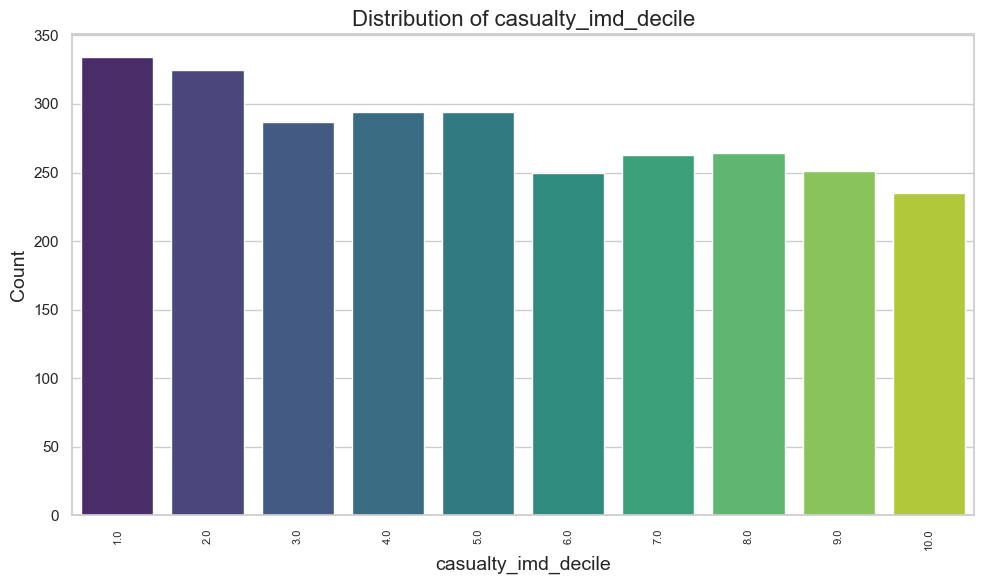

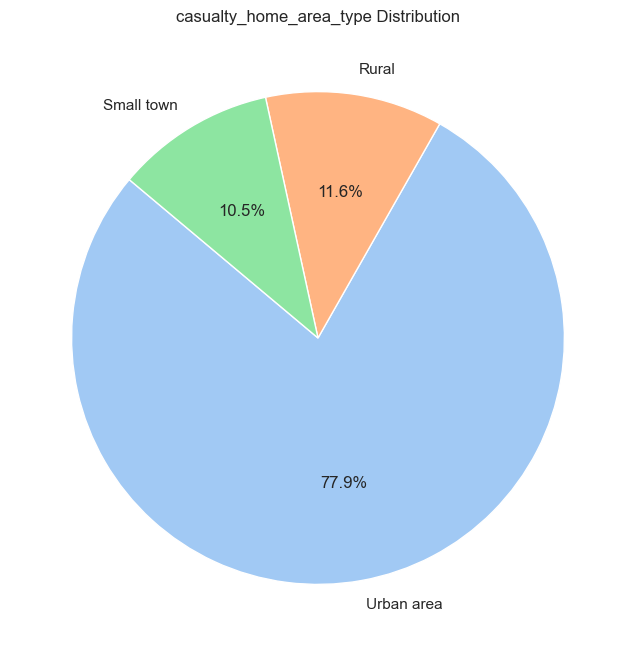

Plotting for Original DataFrame: df_female_FS


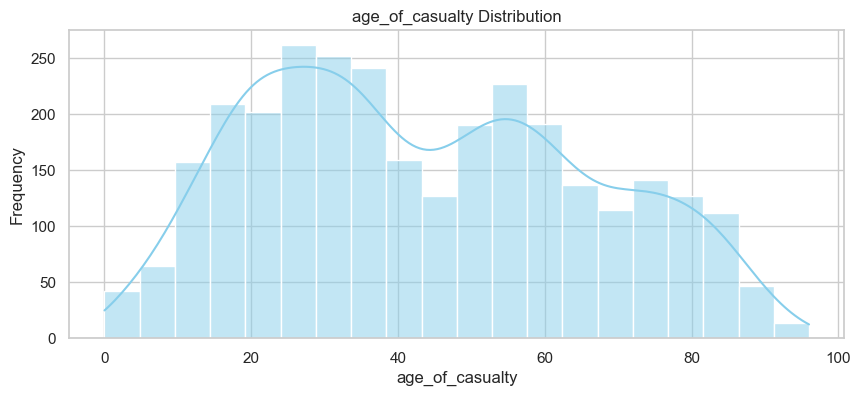

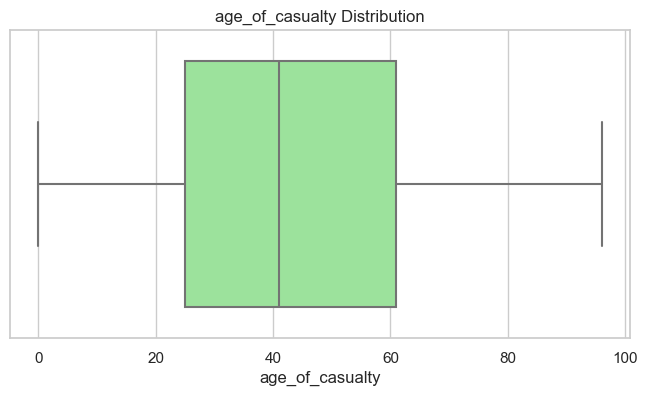

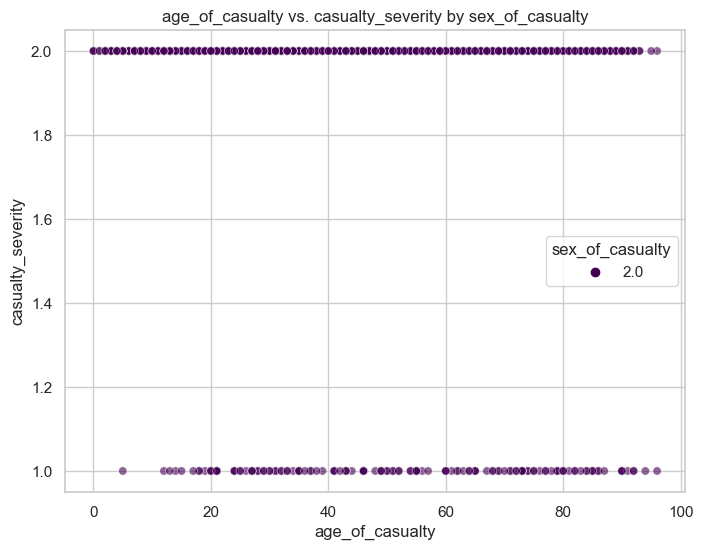

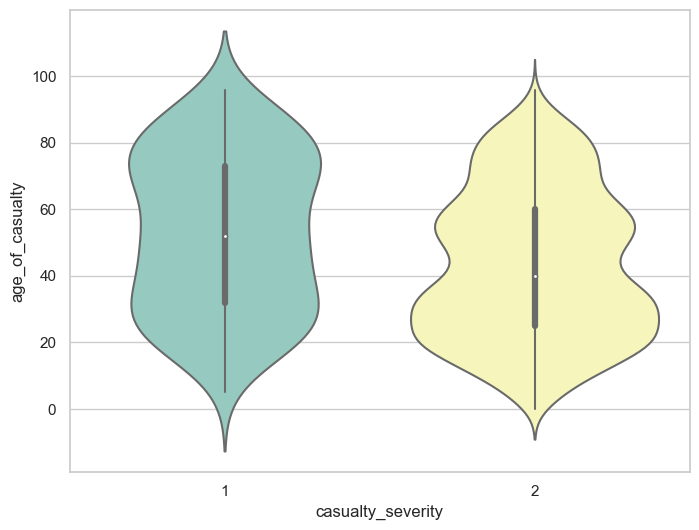

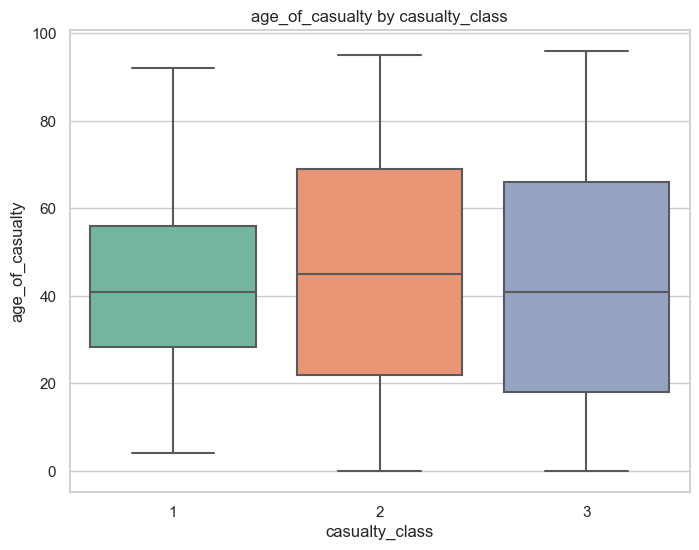

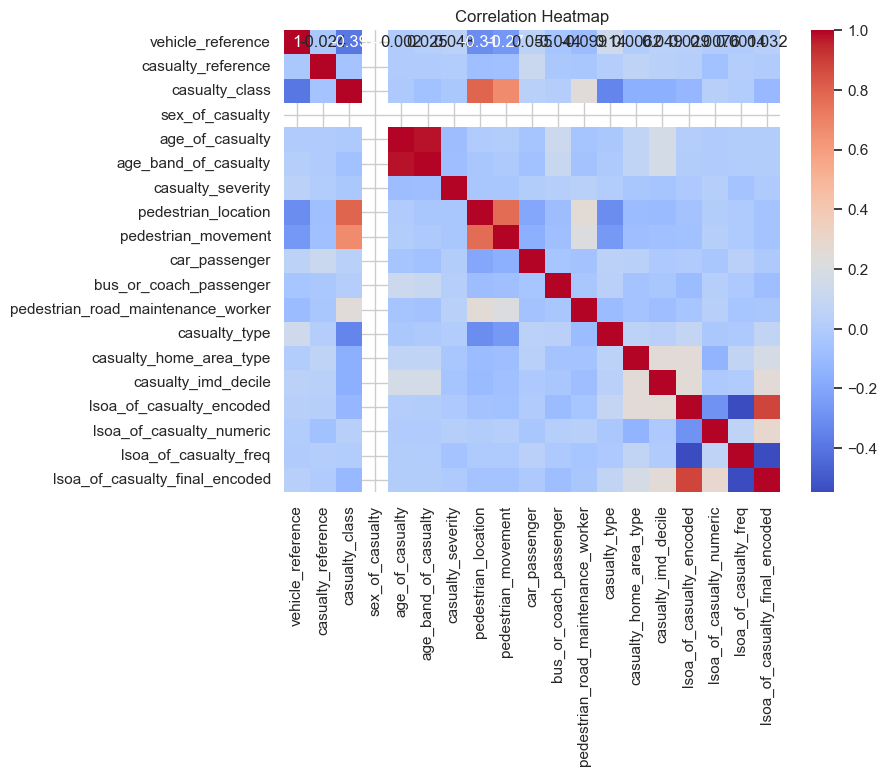

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
Plotting for Labeled DataFrame: df_female_fatal_labeled


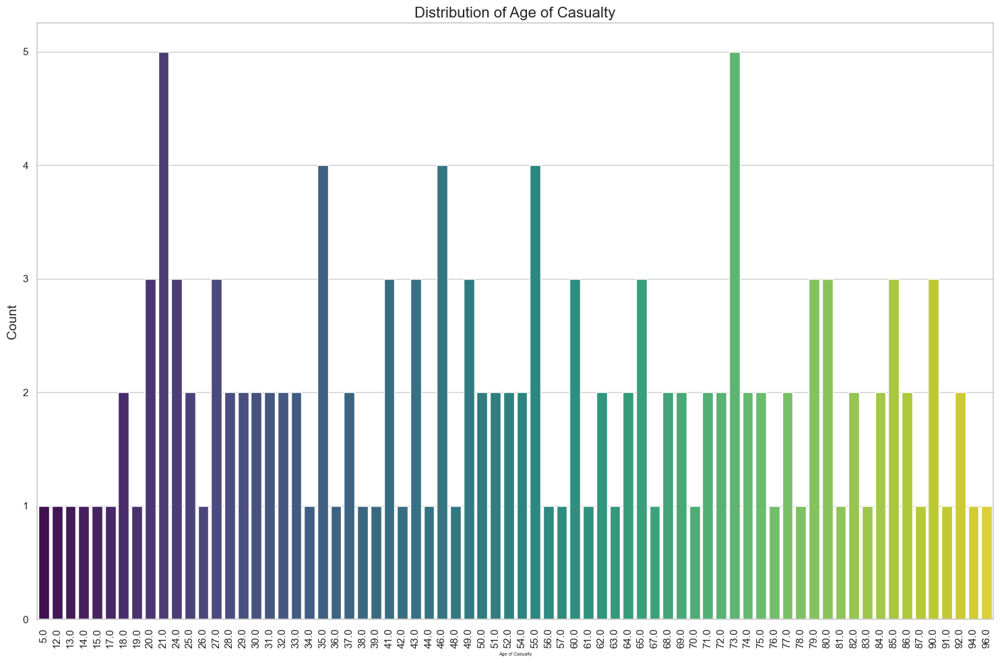

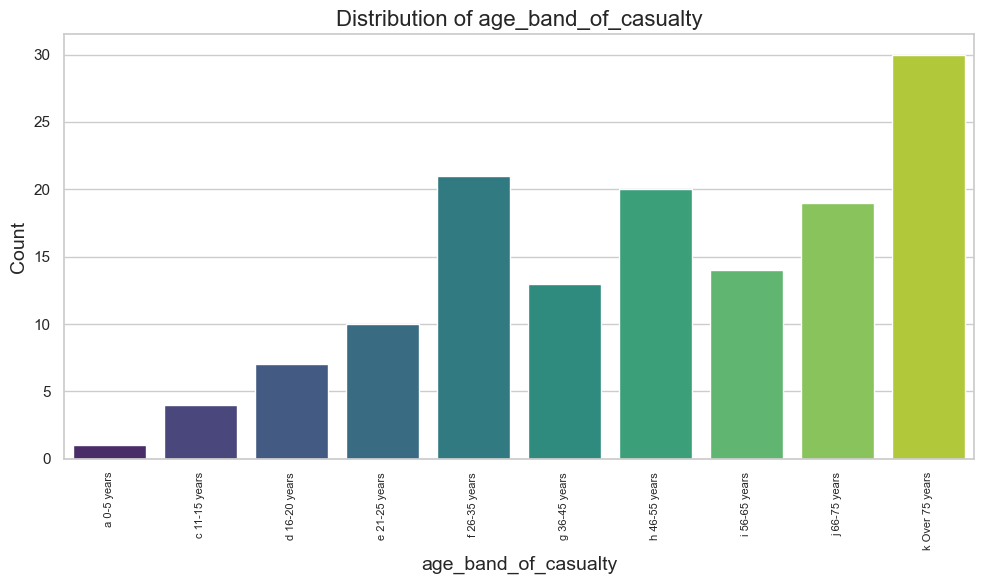

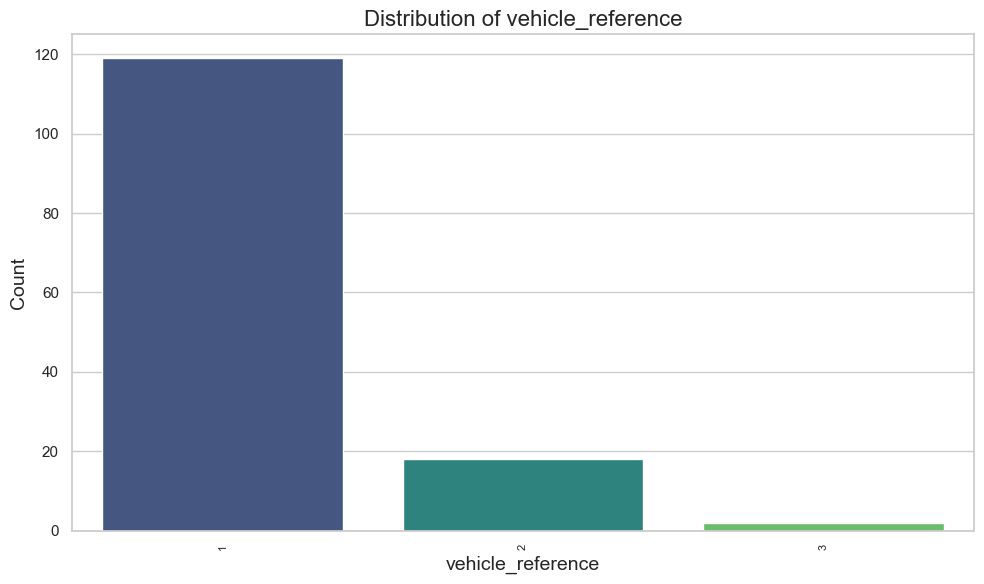

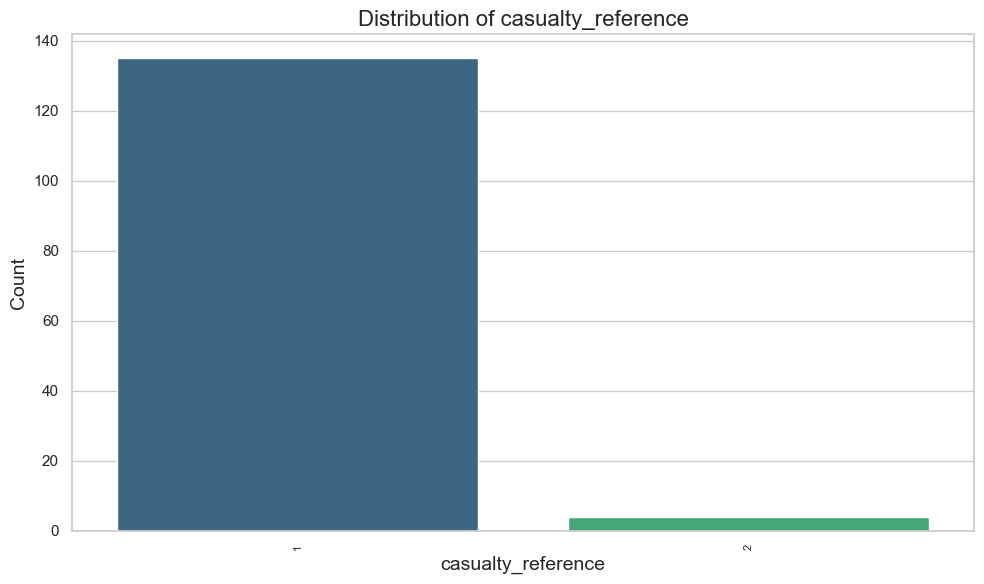

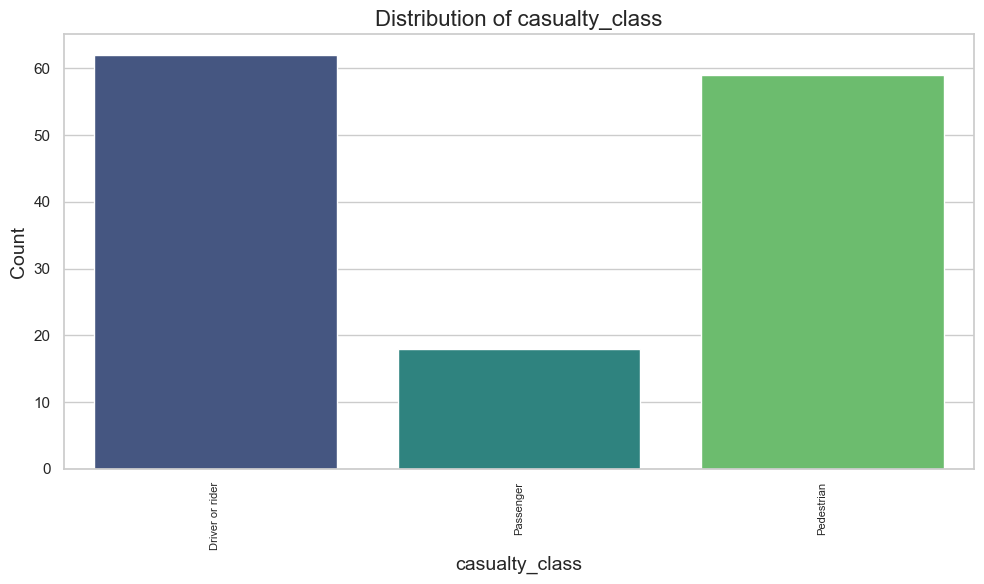

...

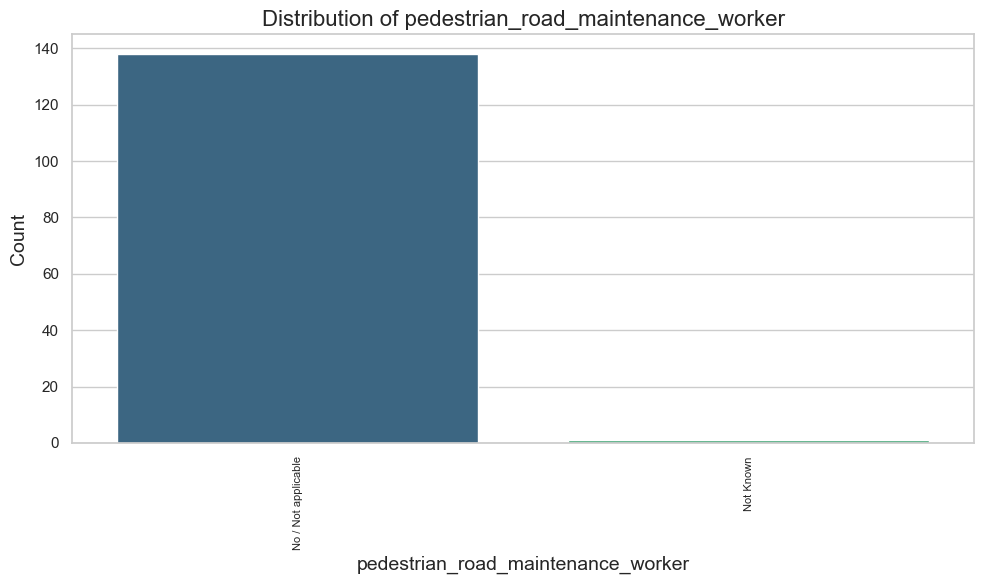

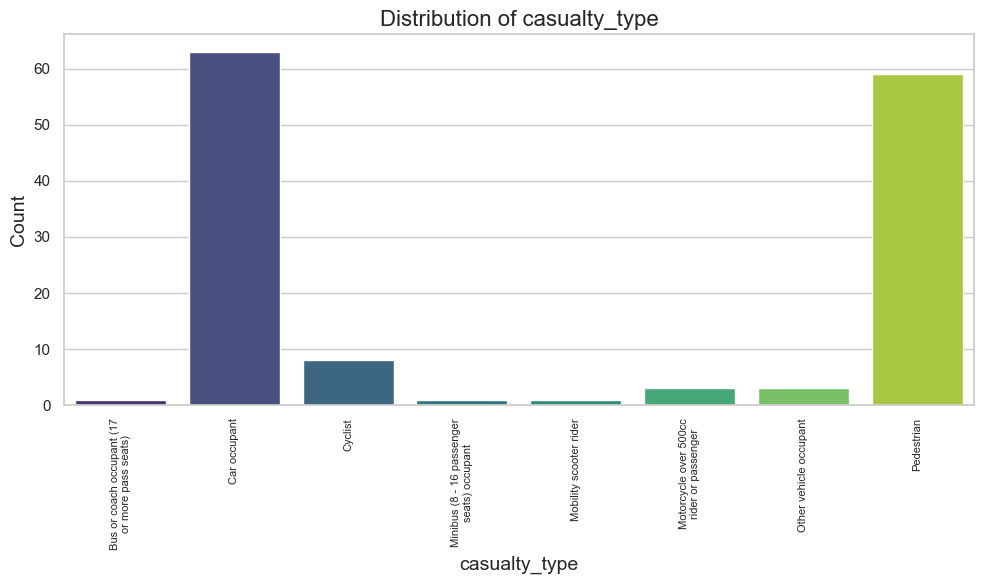

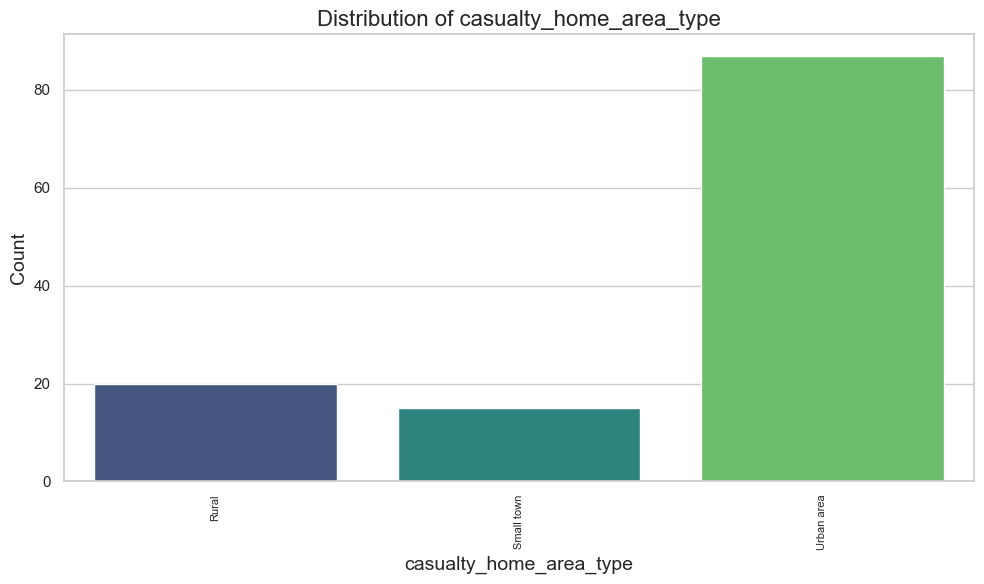

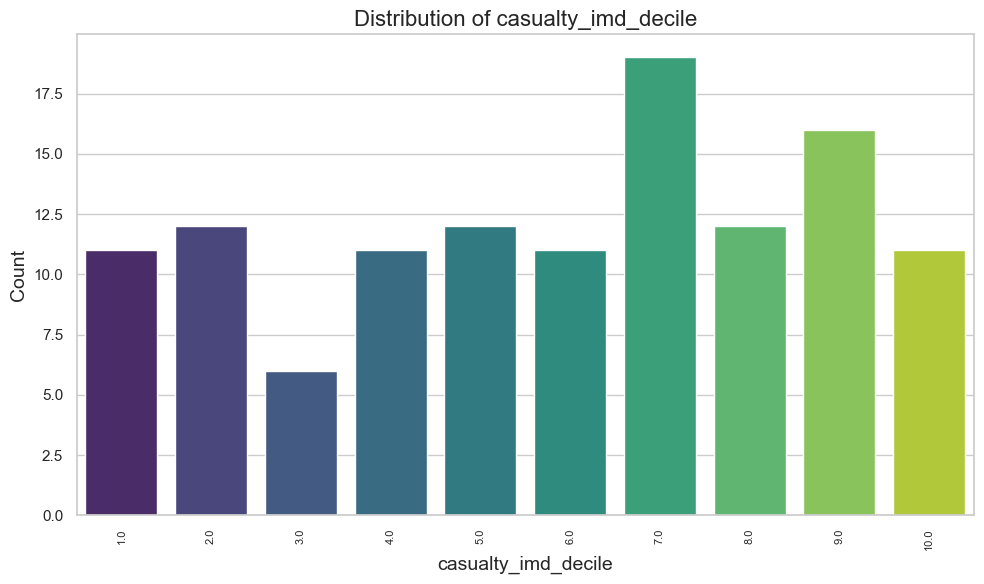

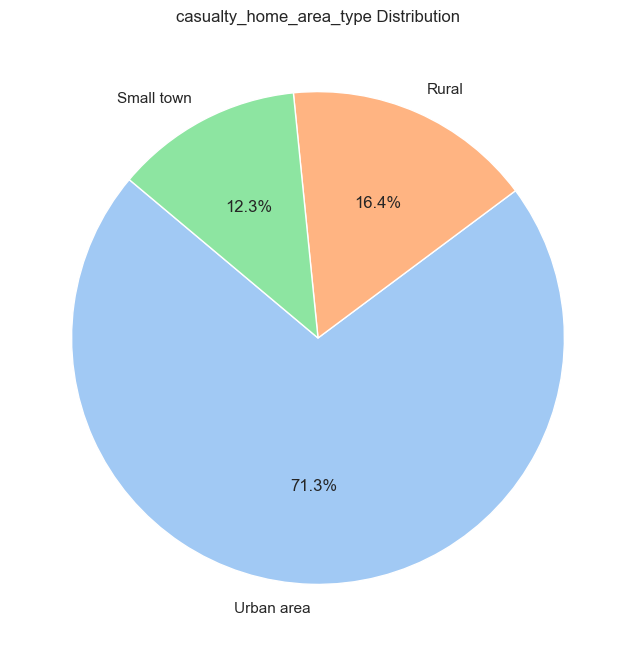

Plotting for Original DataFrame: df_female_fatal


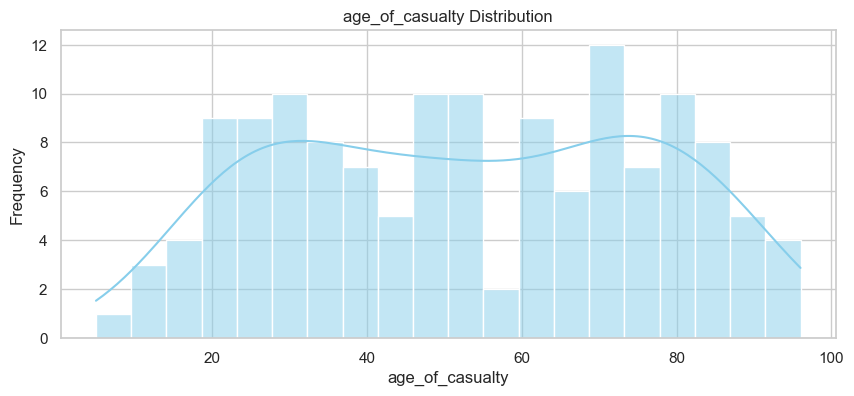

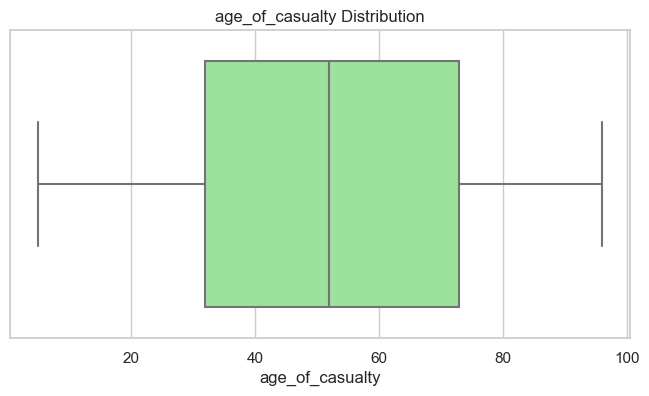

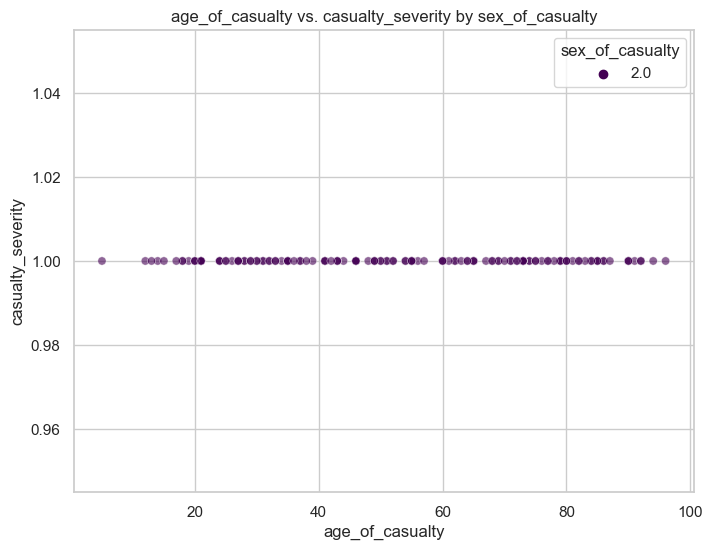

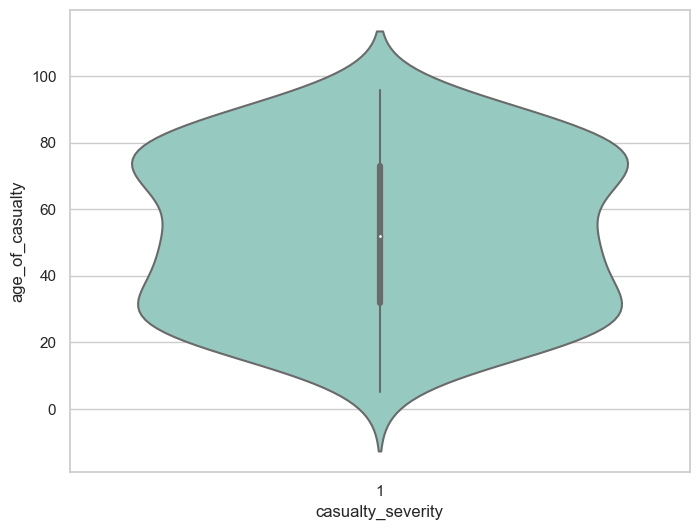

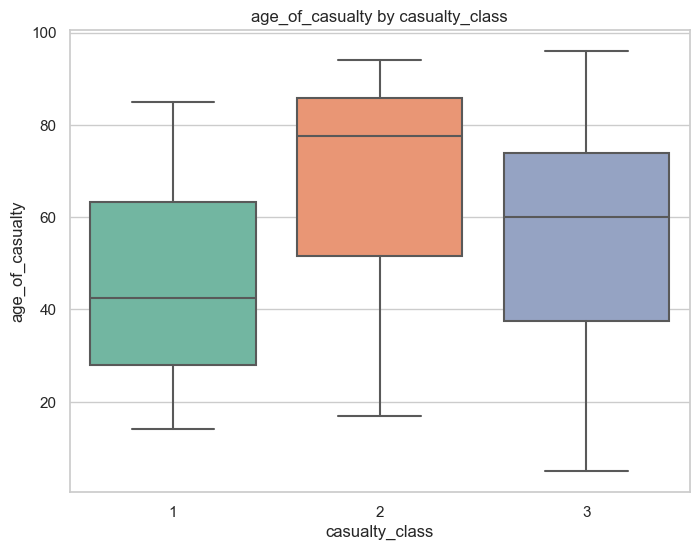

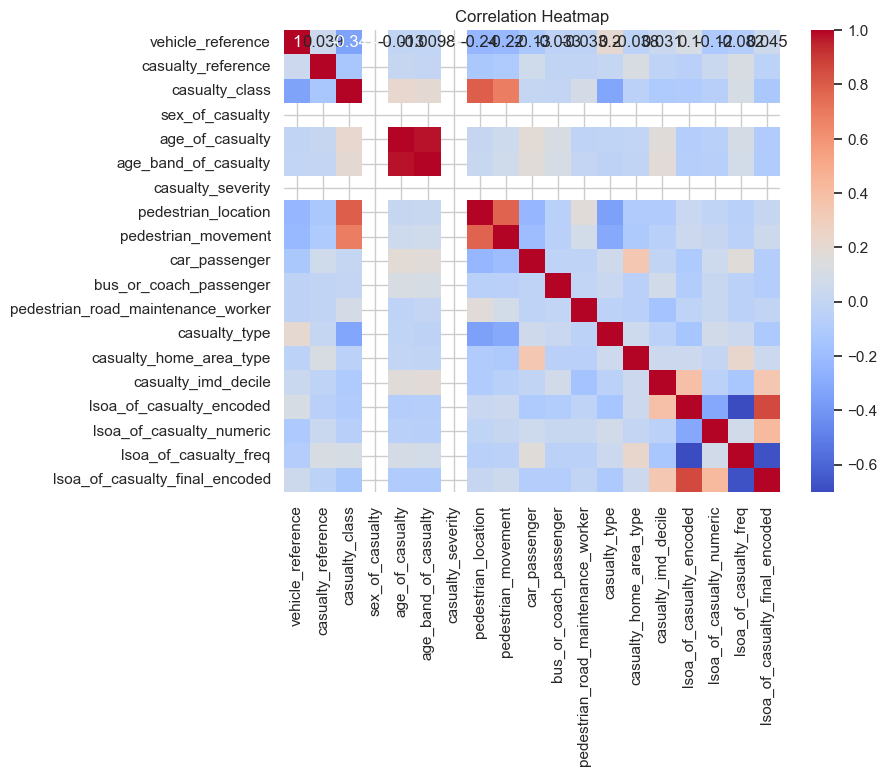

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
Plotting for Labeled DataFrame: df_workers_labeled


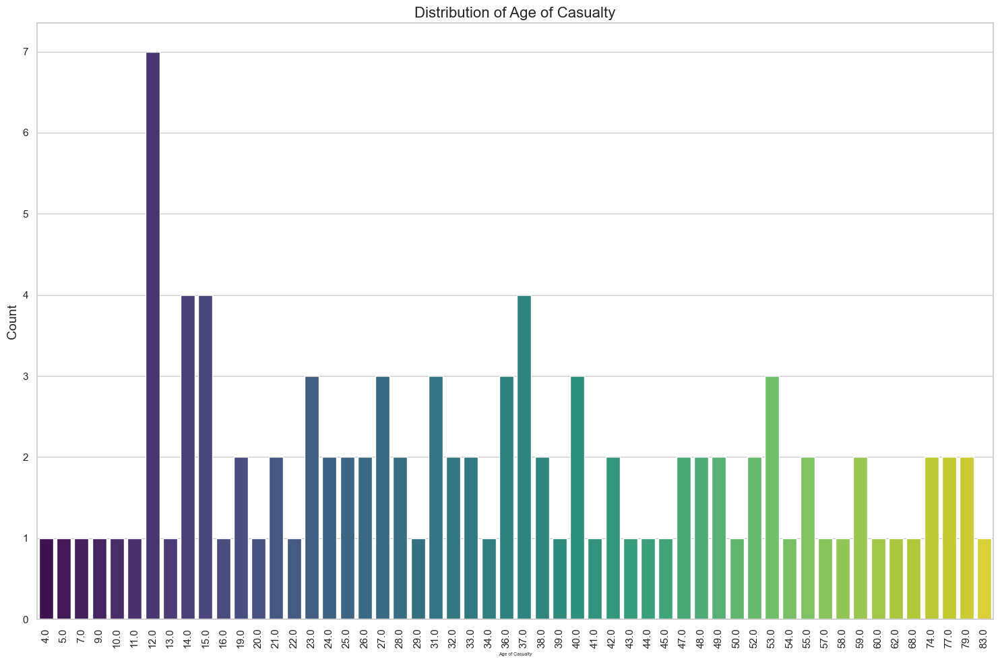

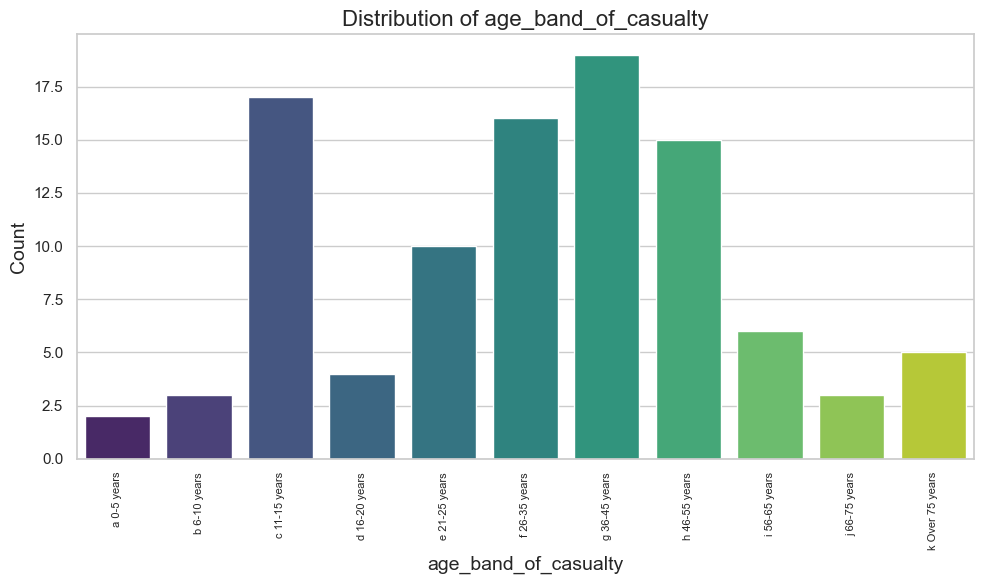

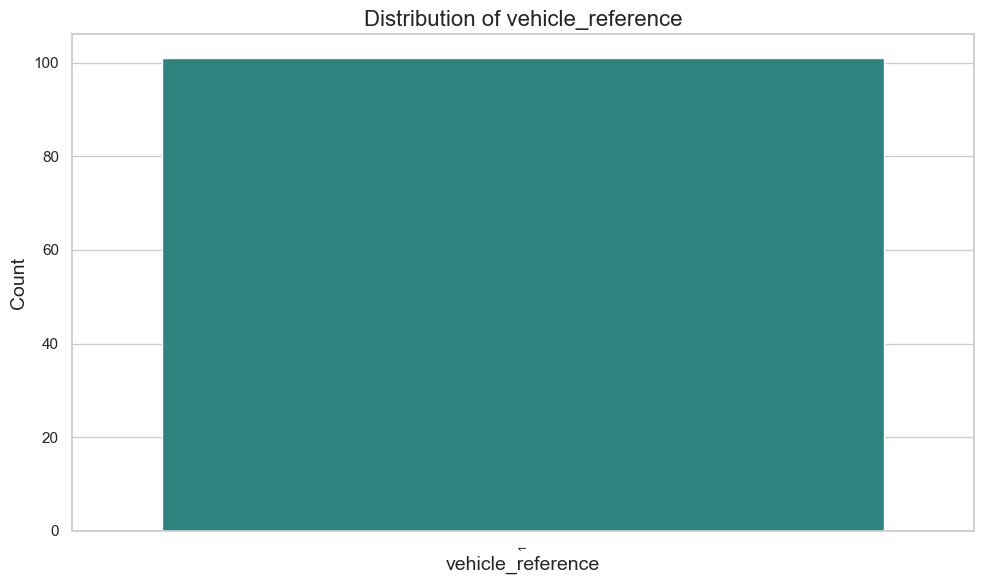

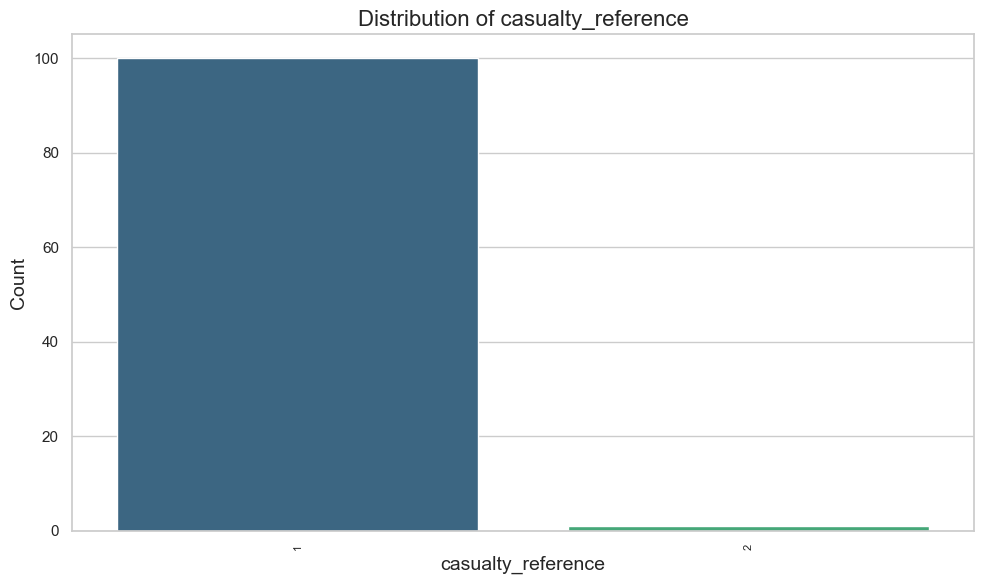

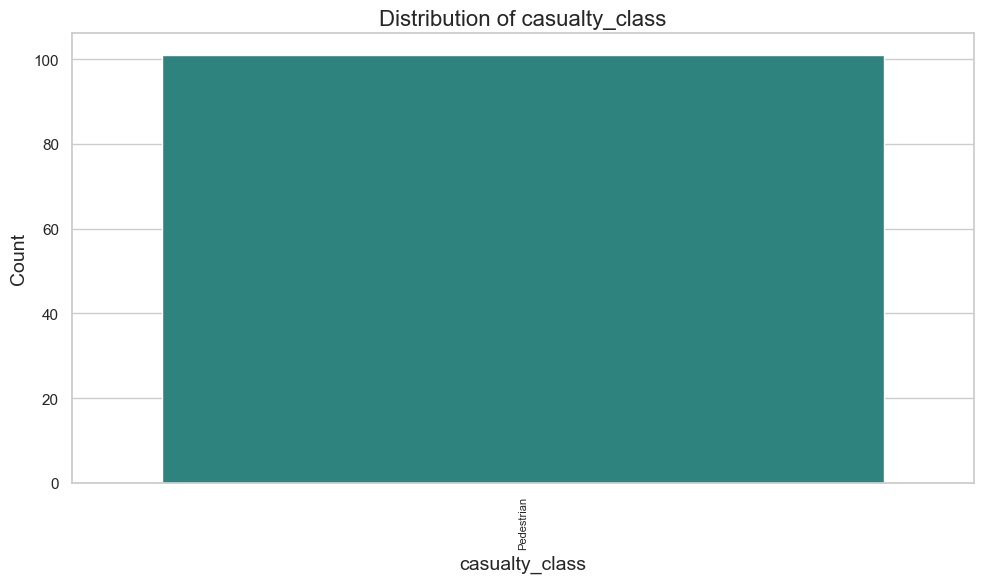

...

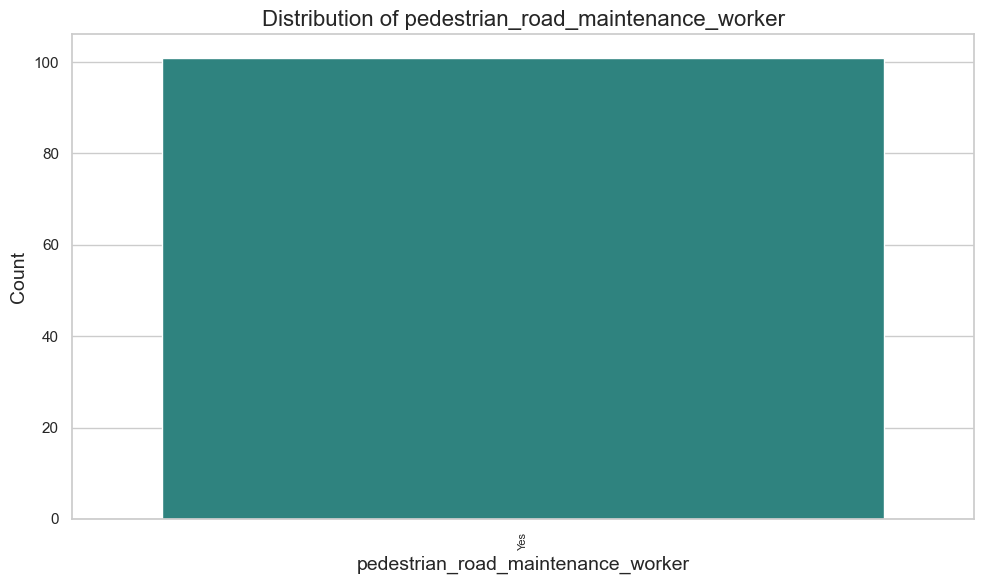

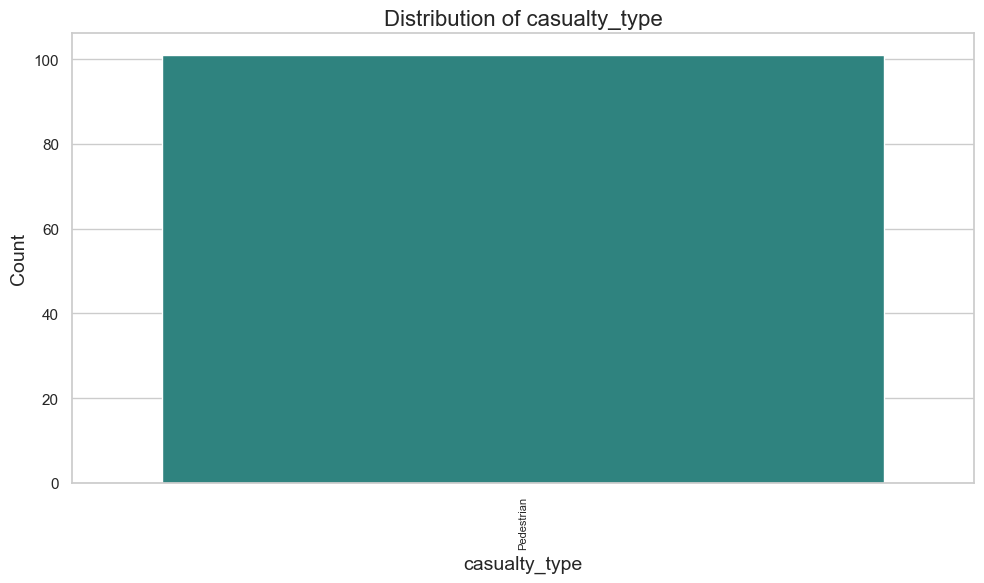

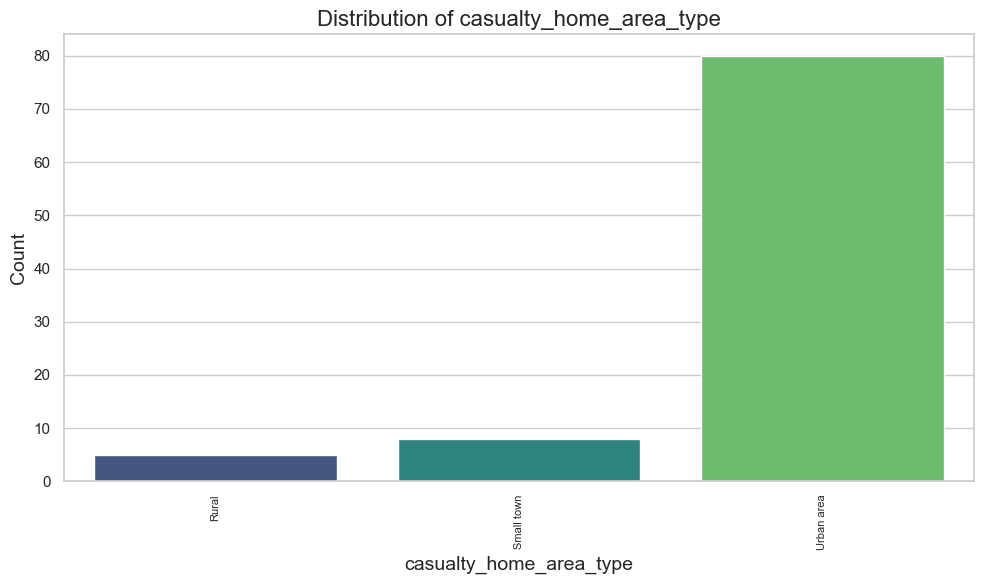

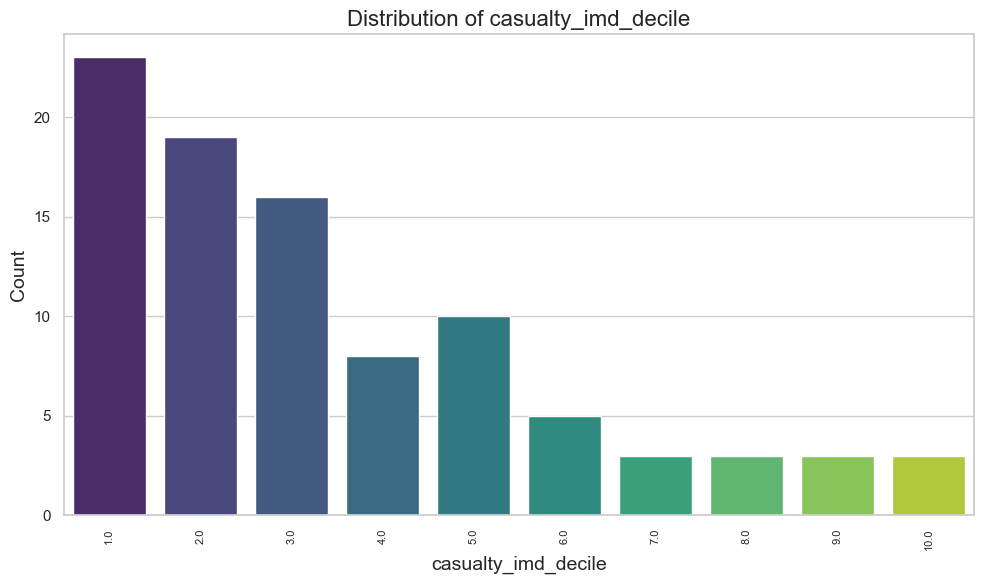

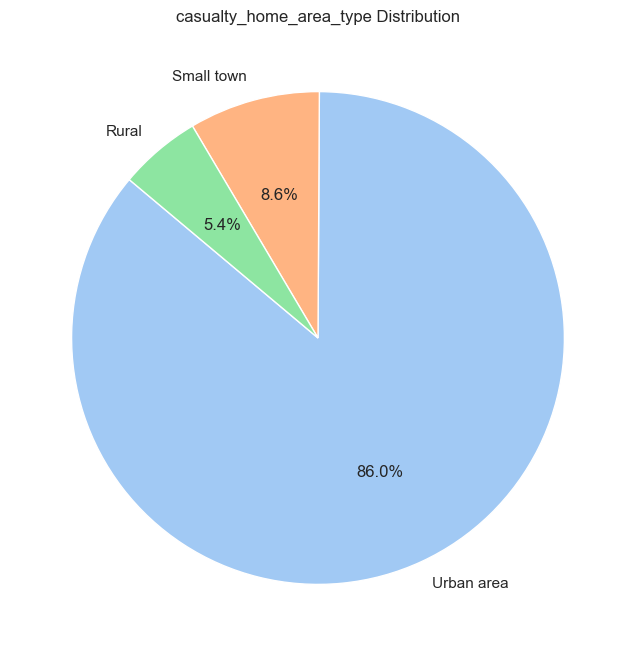

Plotting for Original DataFrame: df_workers


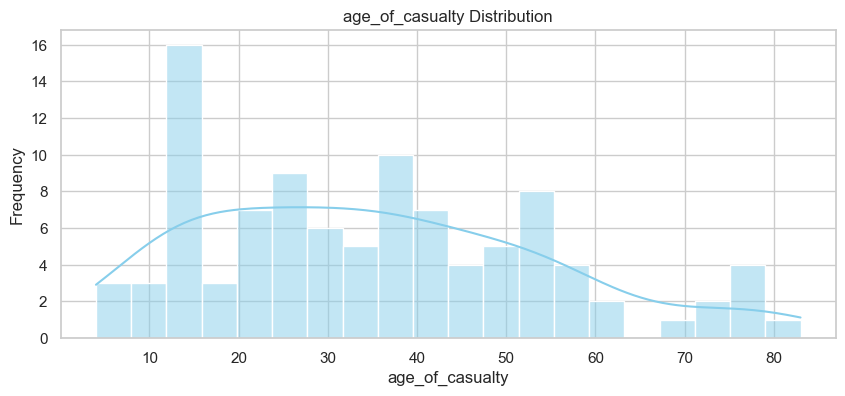

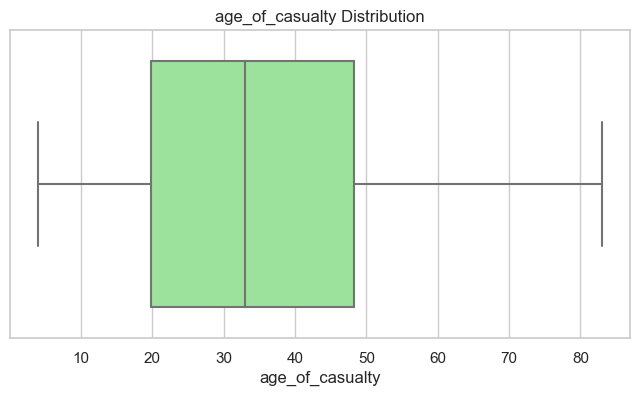

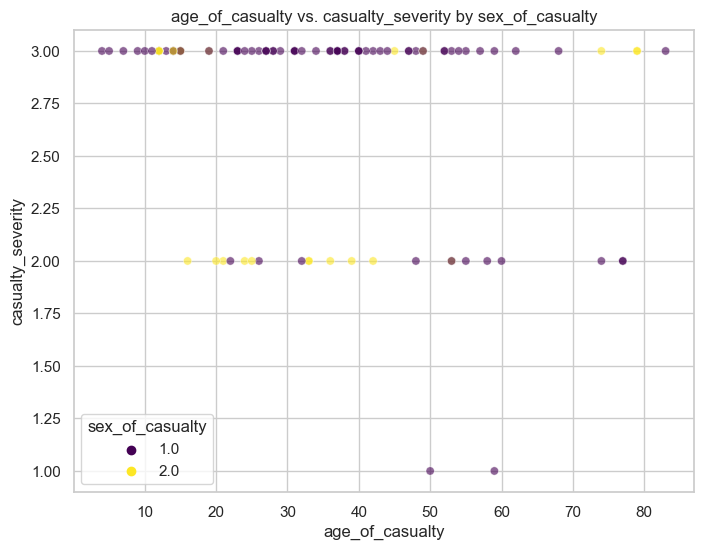

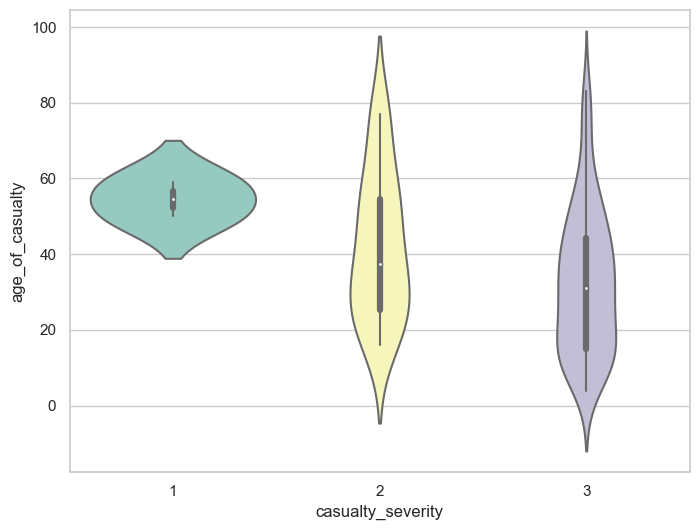

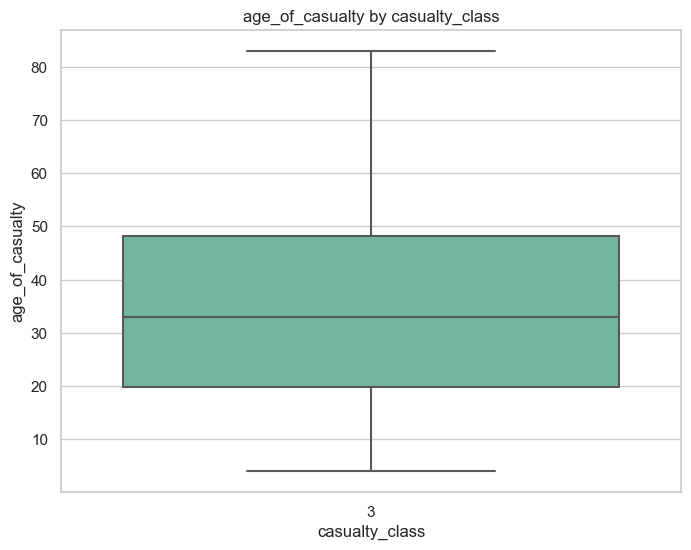

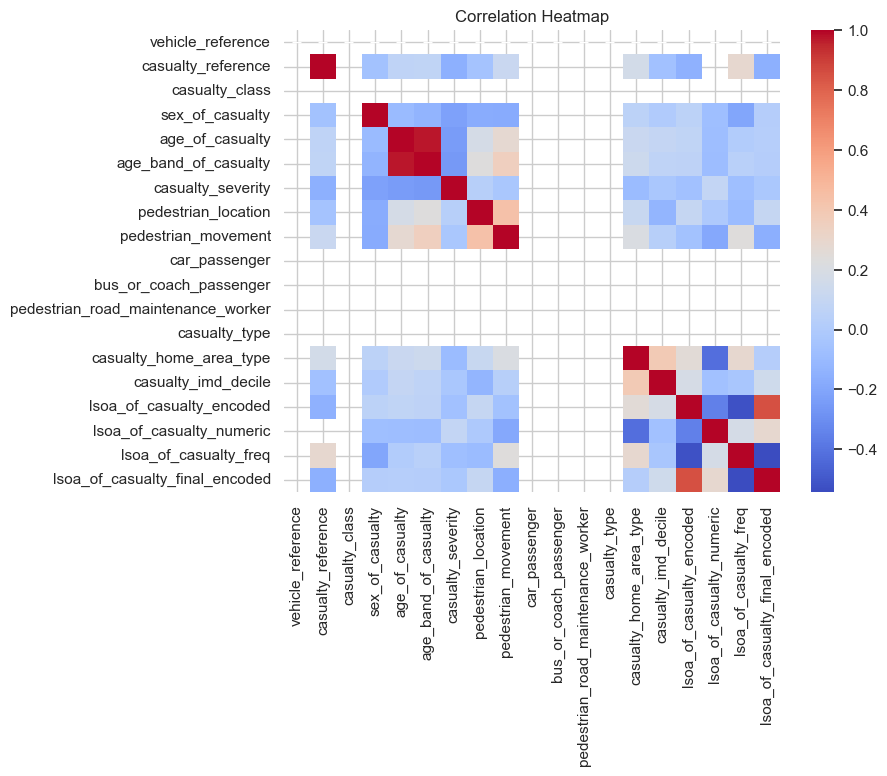

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
Plotting for Labeled DataFrame: df_workers_FS_labeled


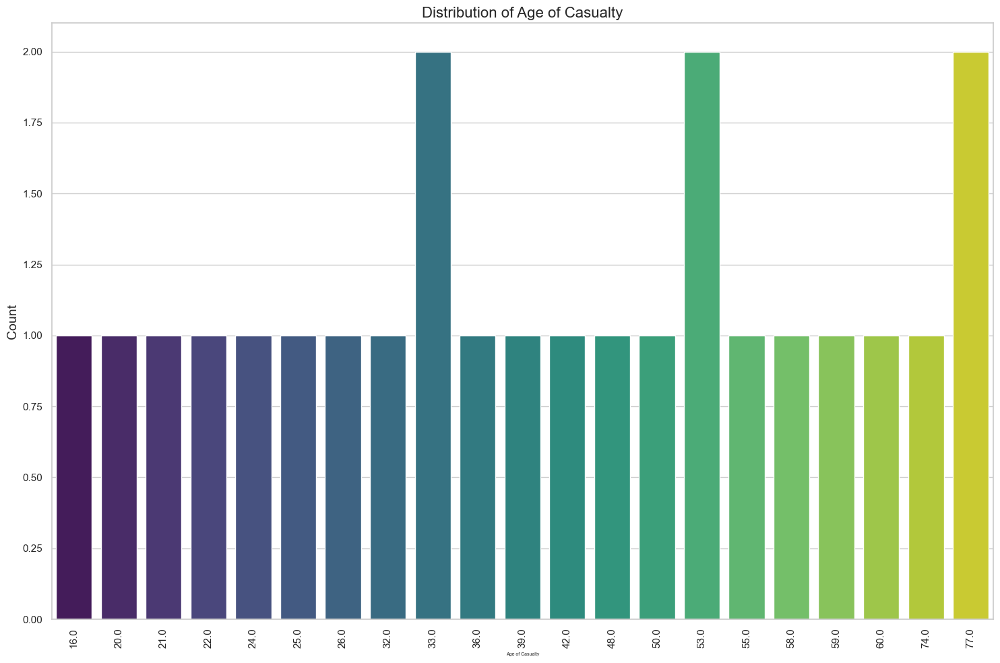

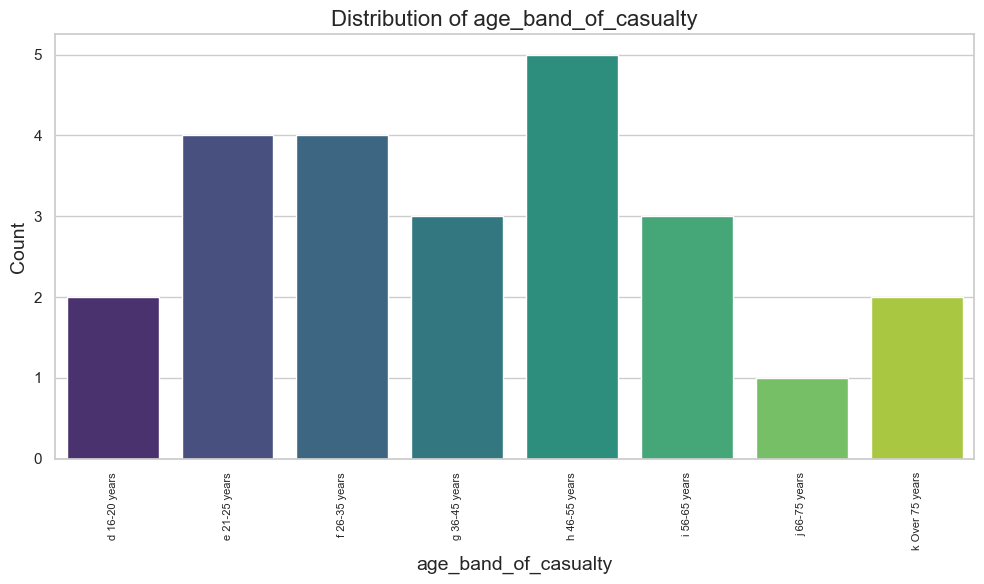

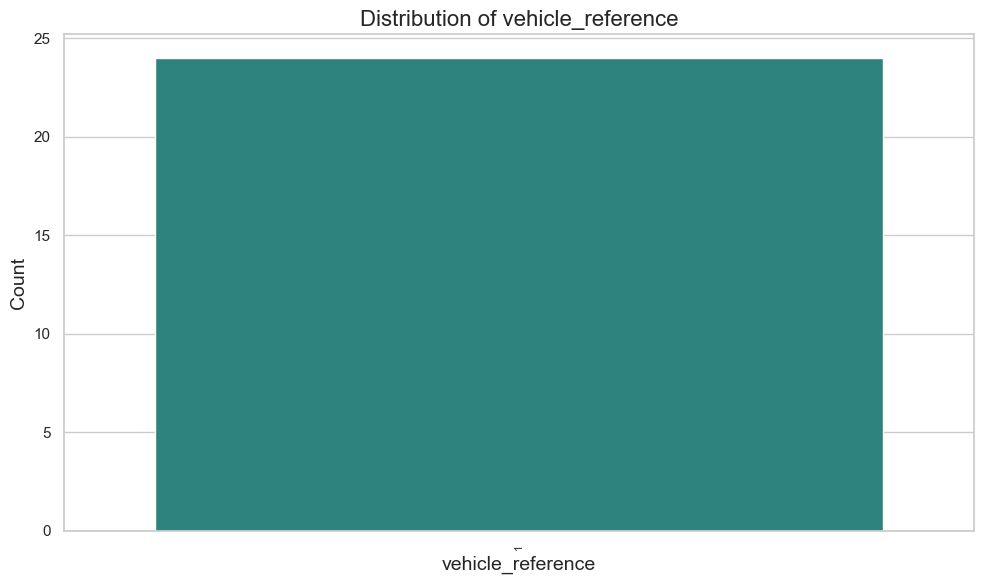

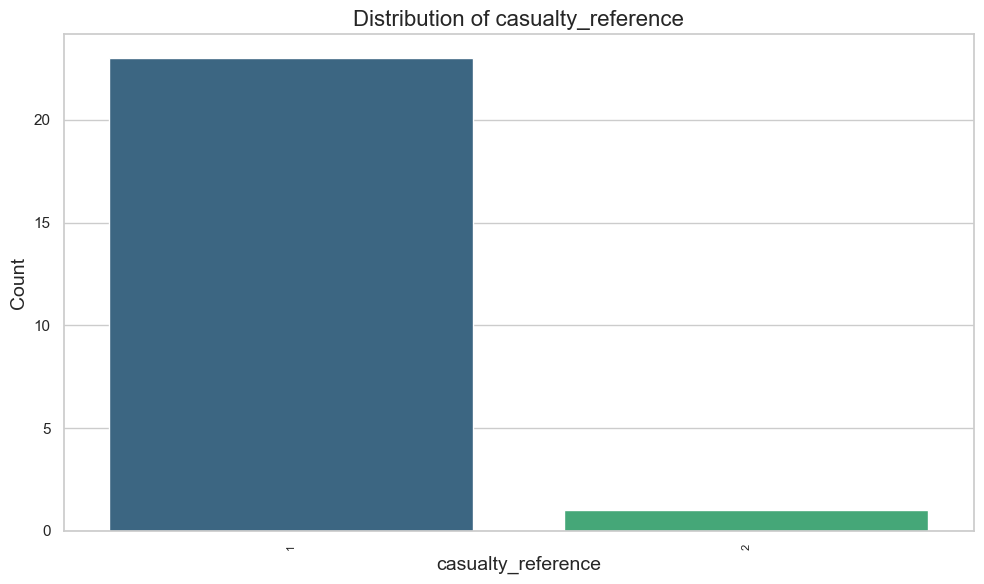

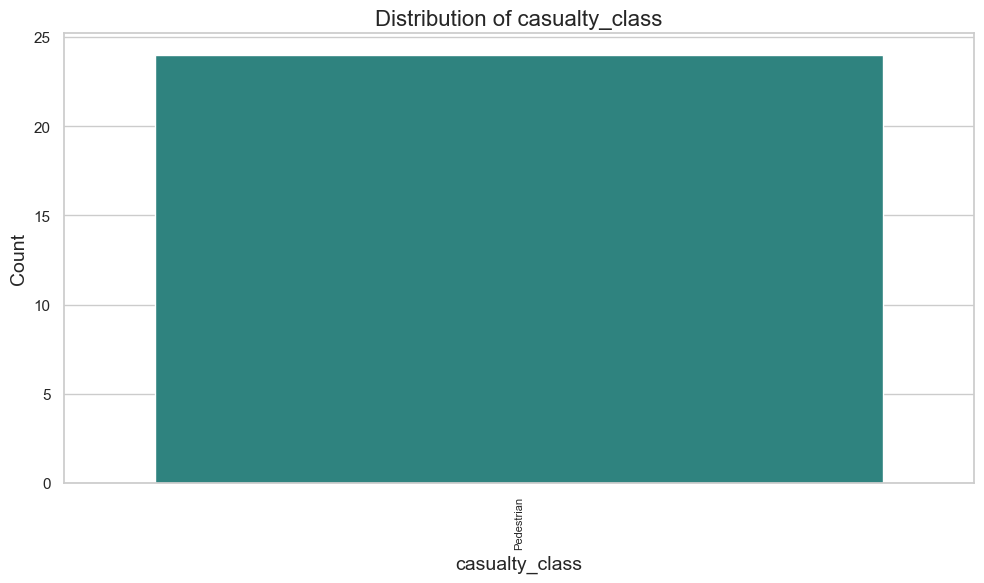

...

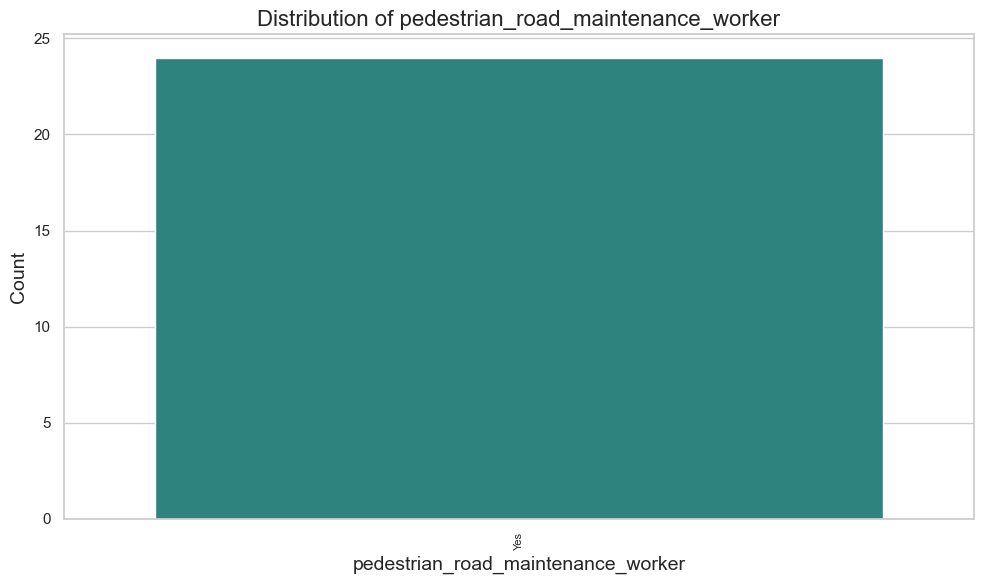

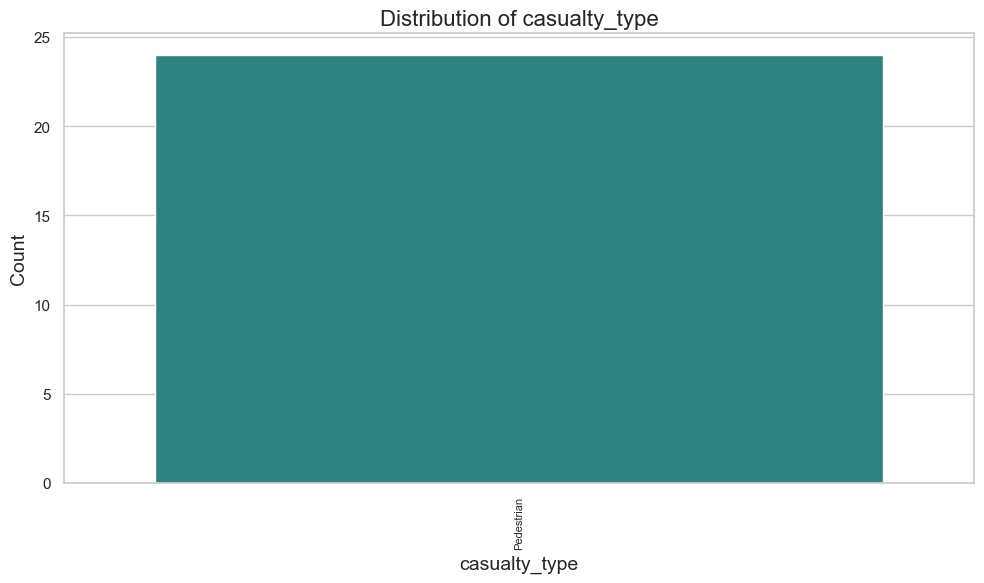

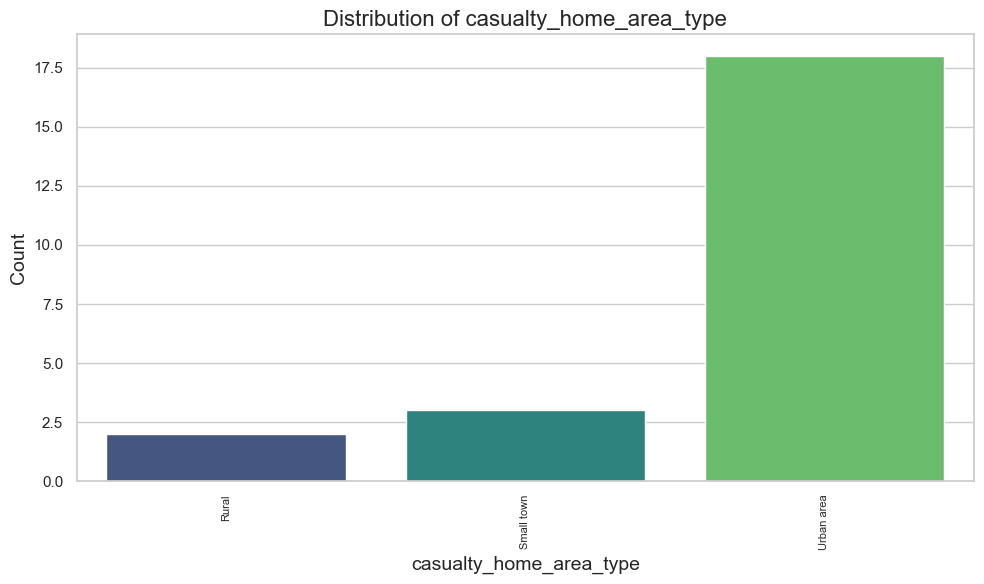

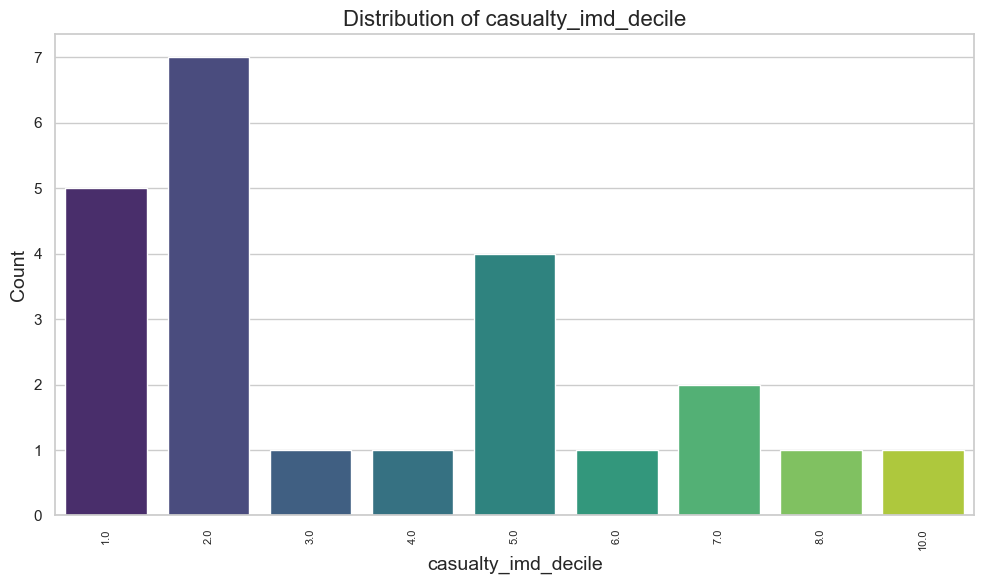

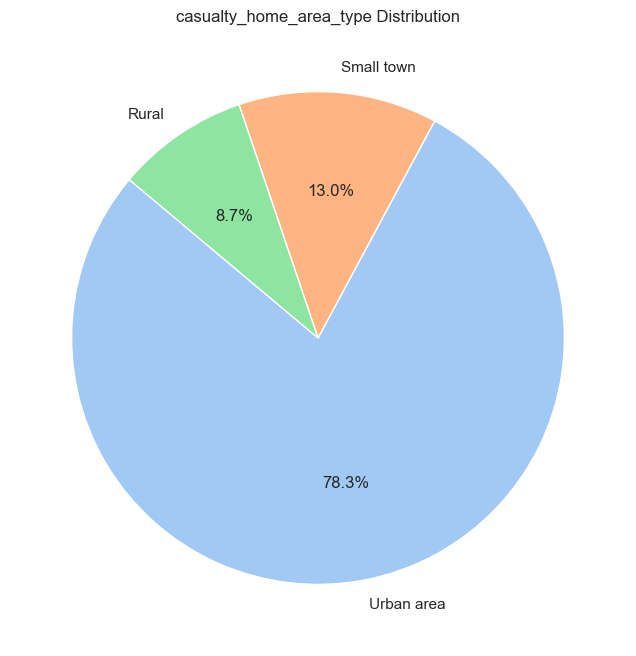

Plotting for Original DataFrame: df_workers_FS


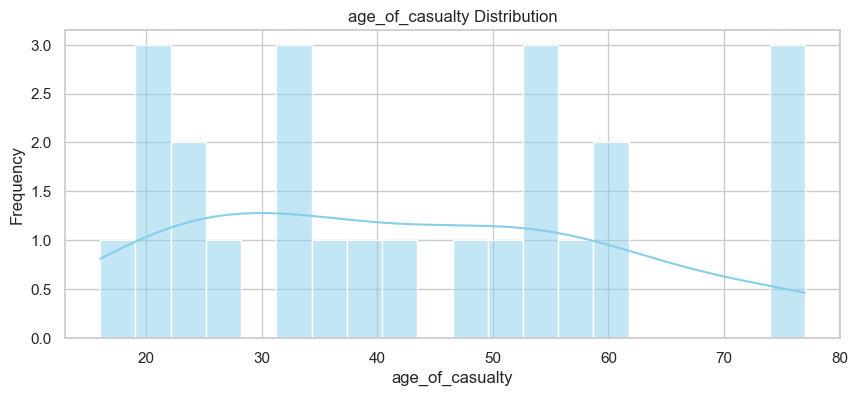

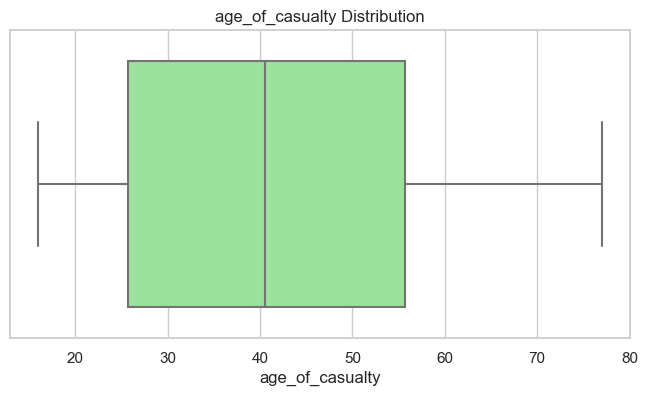

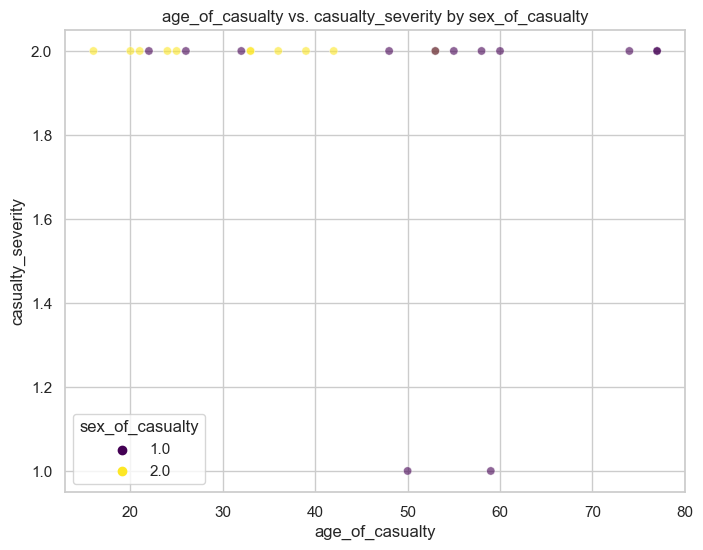

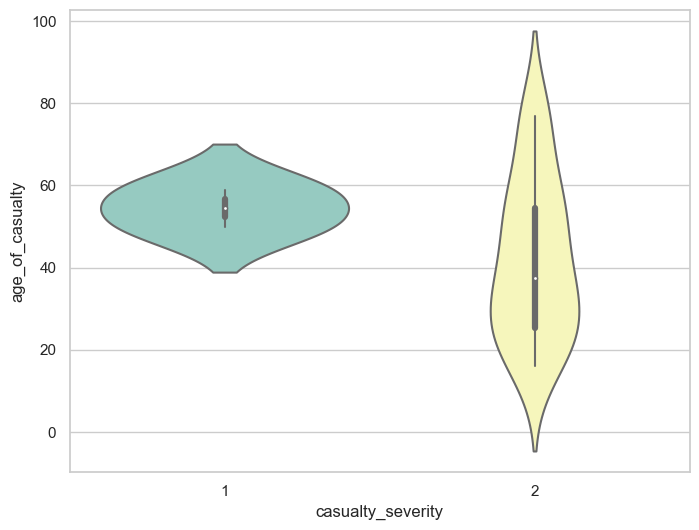

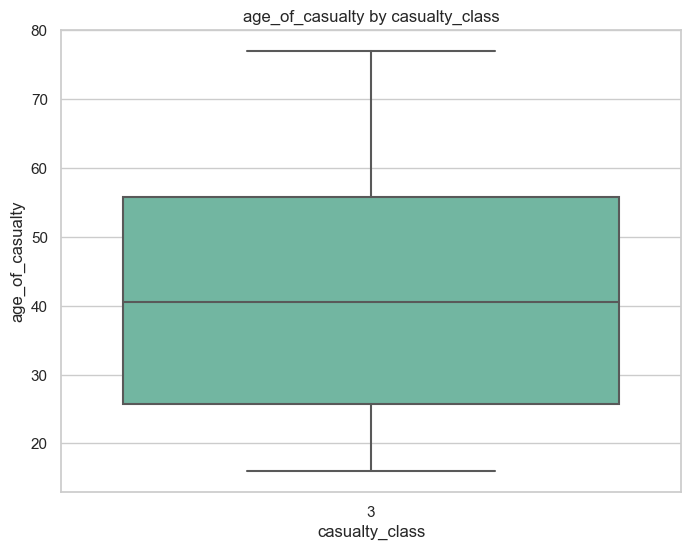

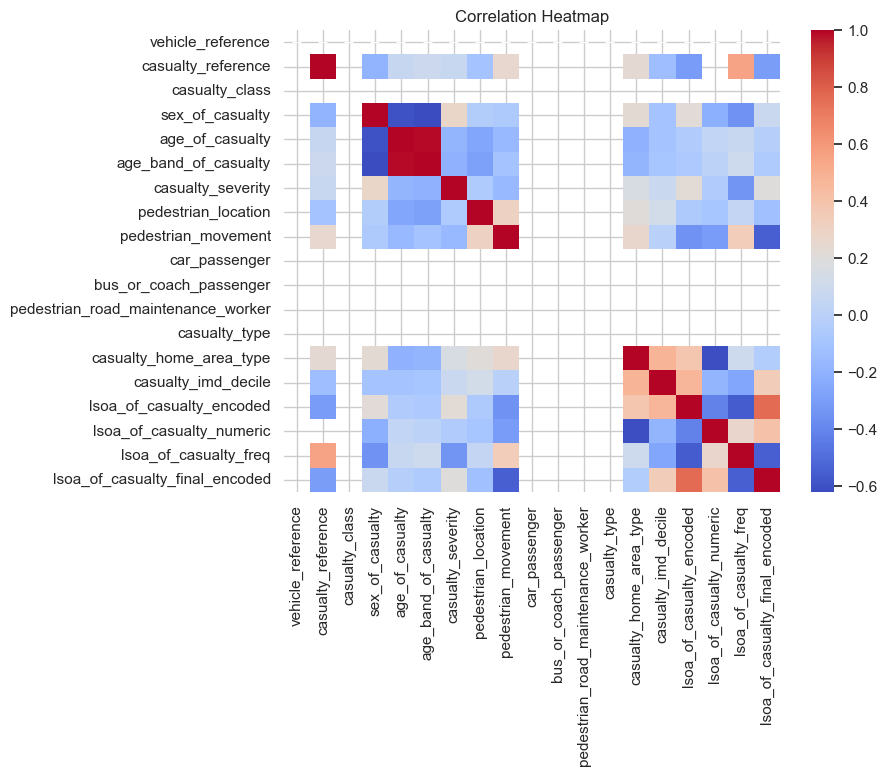

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
Plotting for Labeled DataFrame: df_workers_fatal_labeled


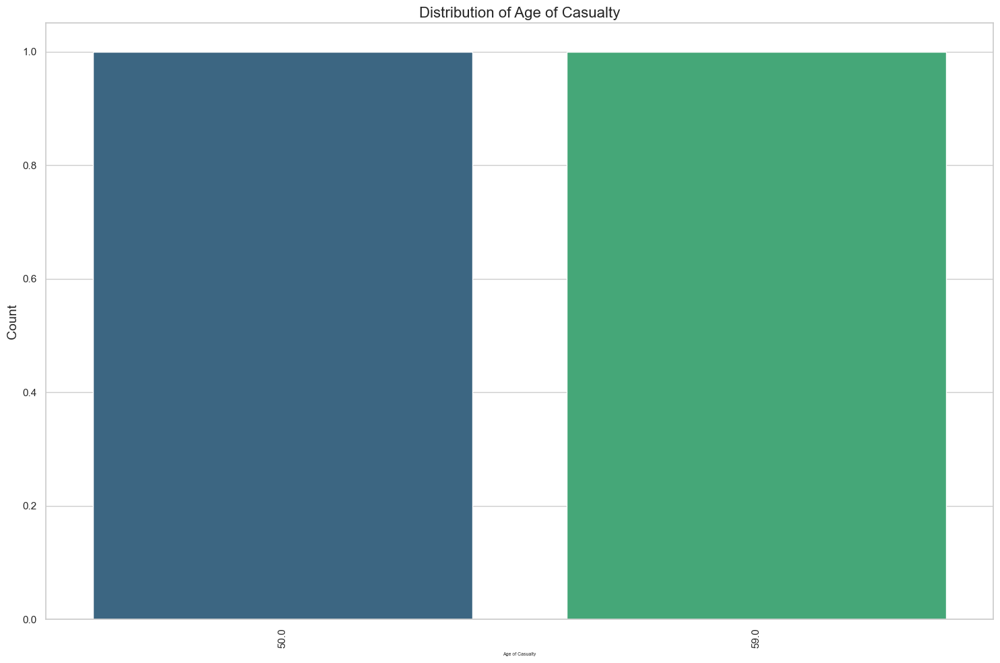

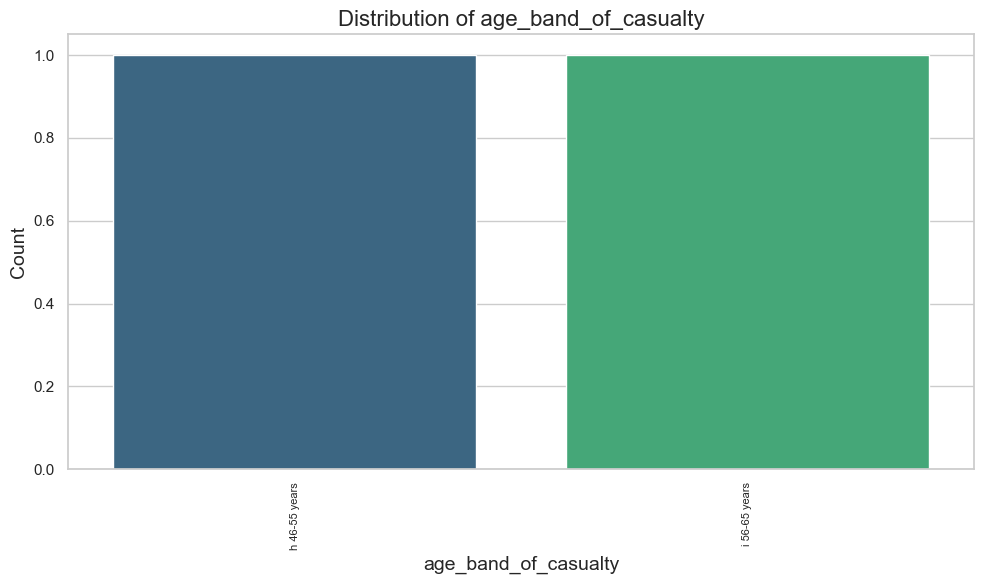

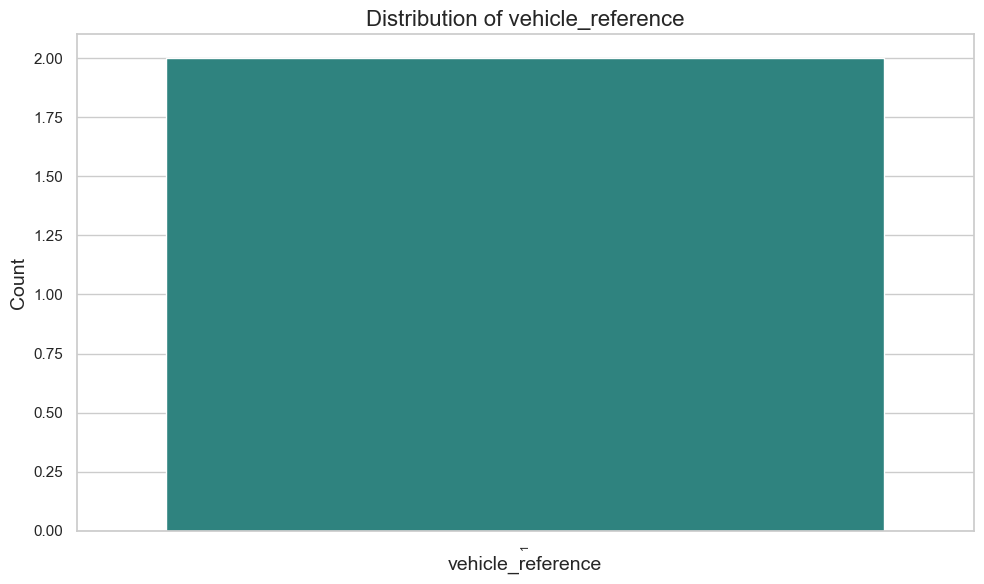

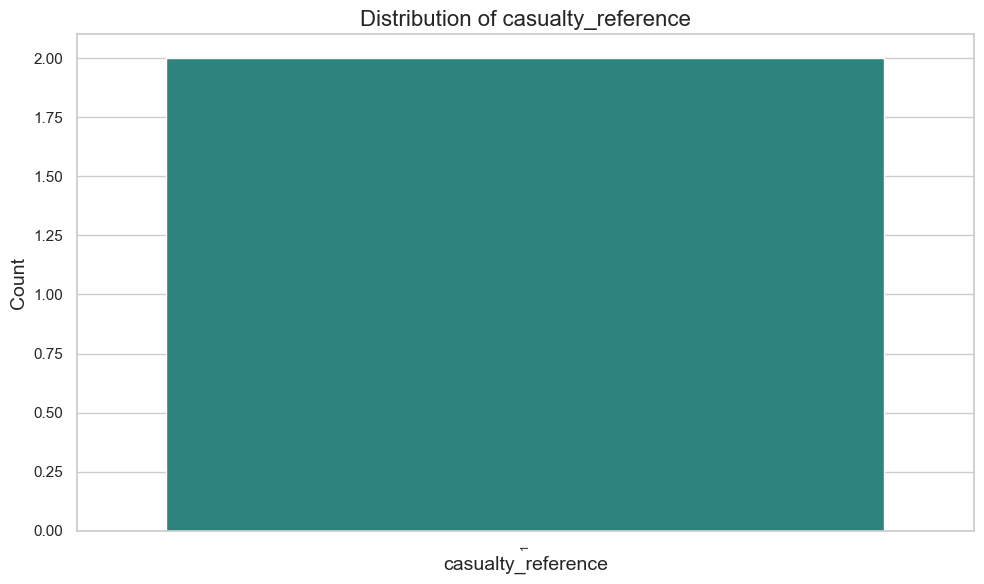

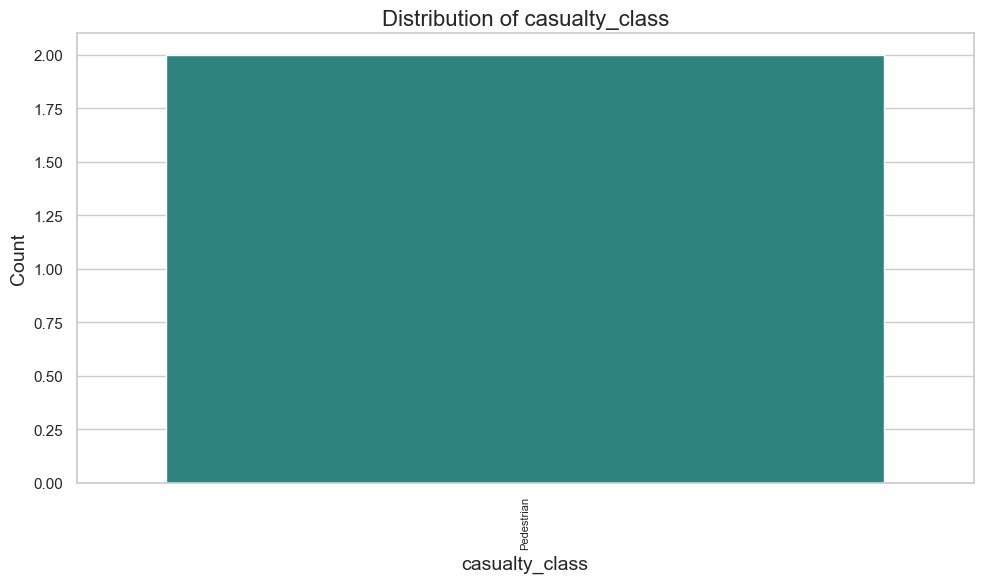

...

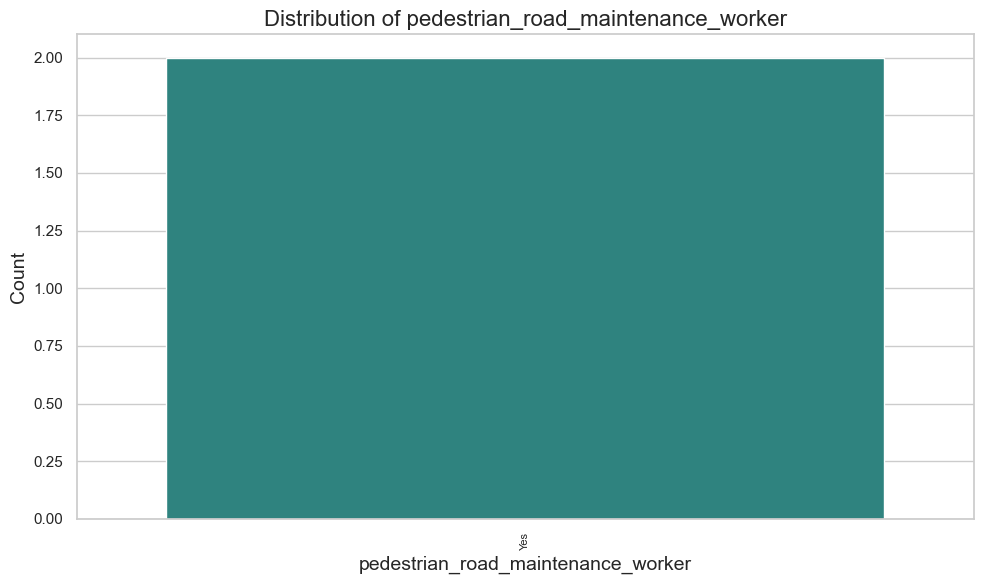

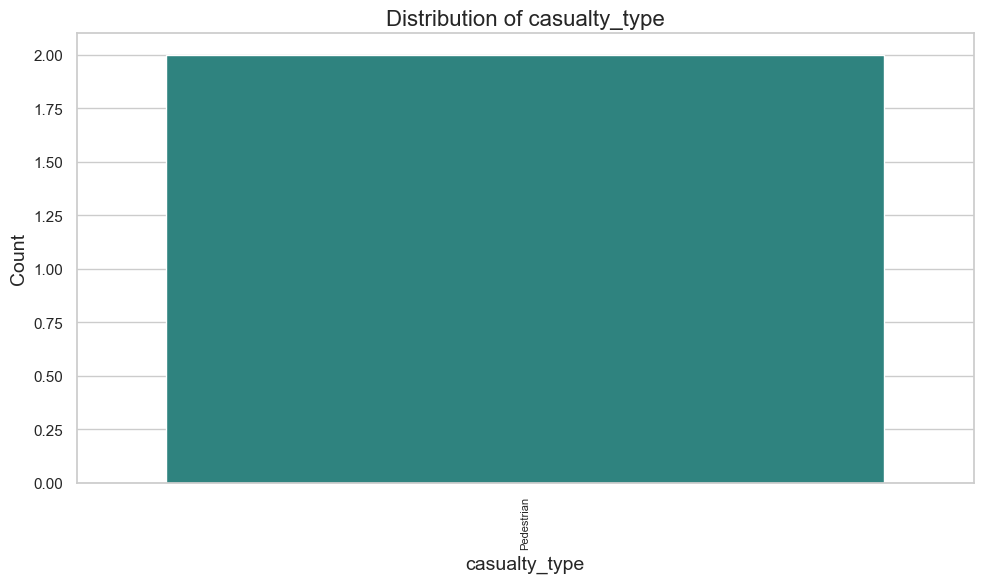

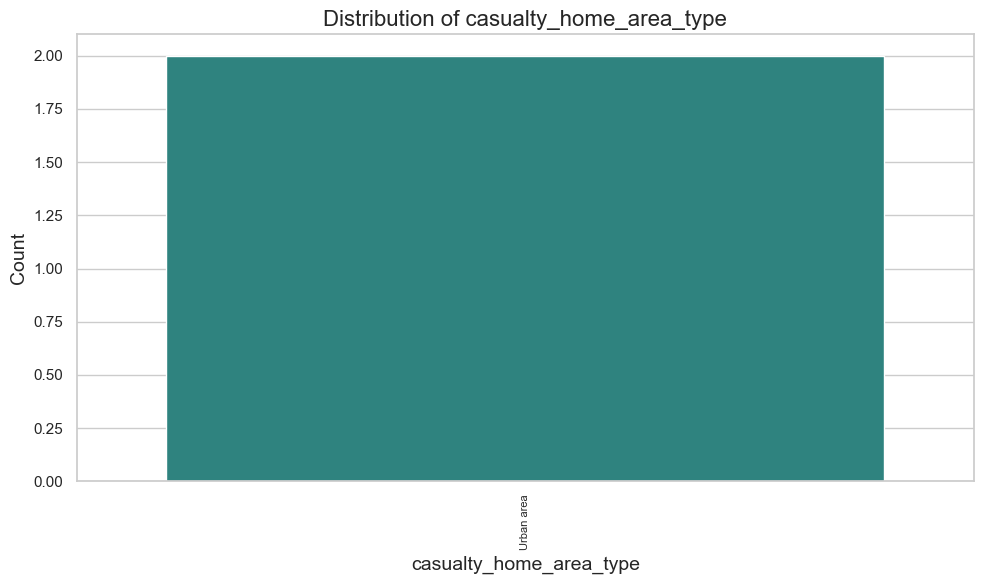

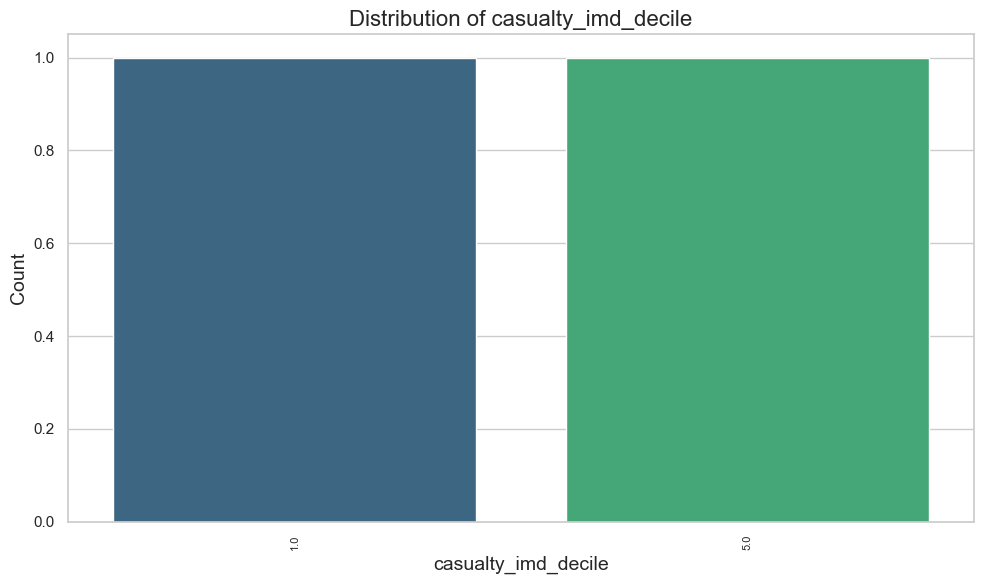

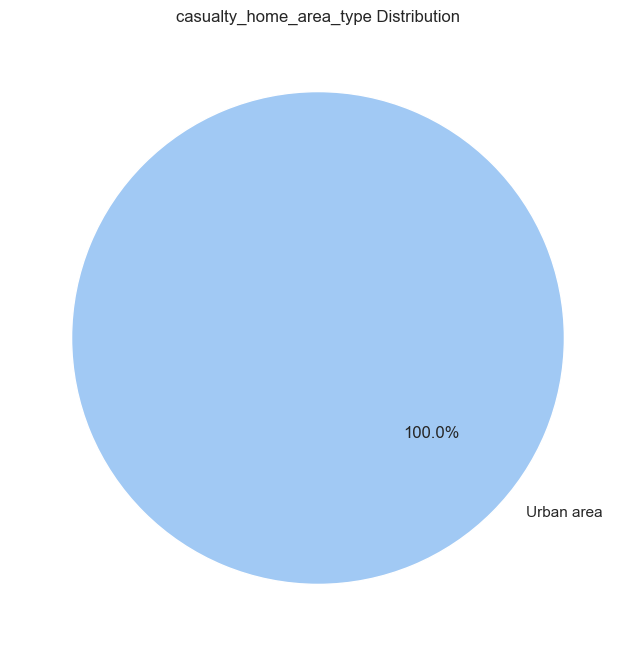

Plotting for Original DataFrame: df_workers_fatal


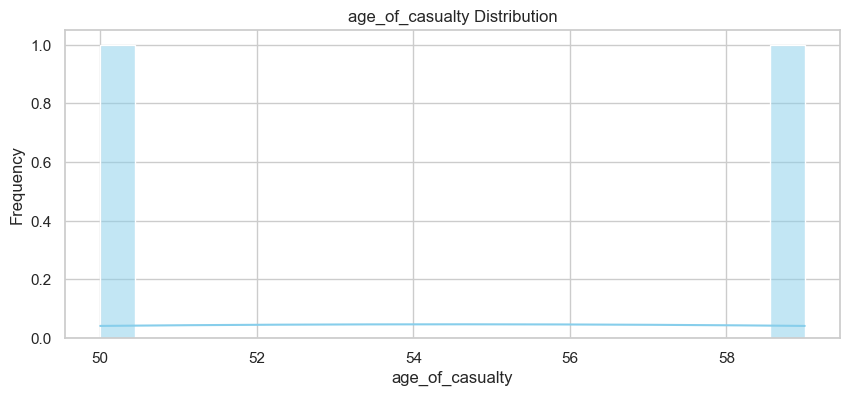

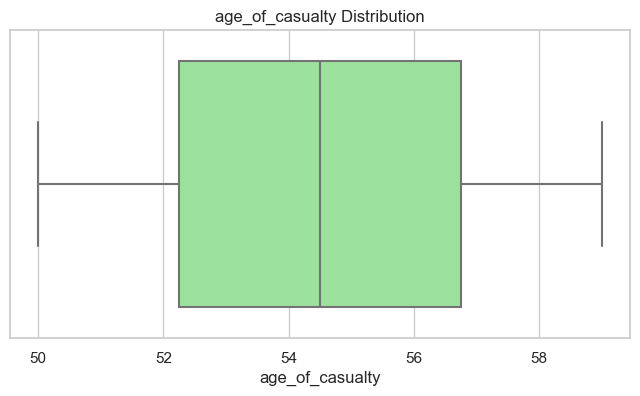

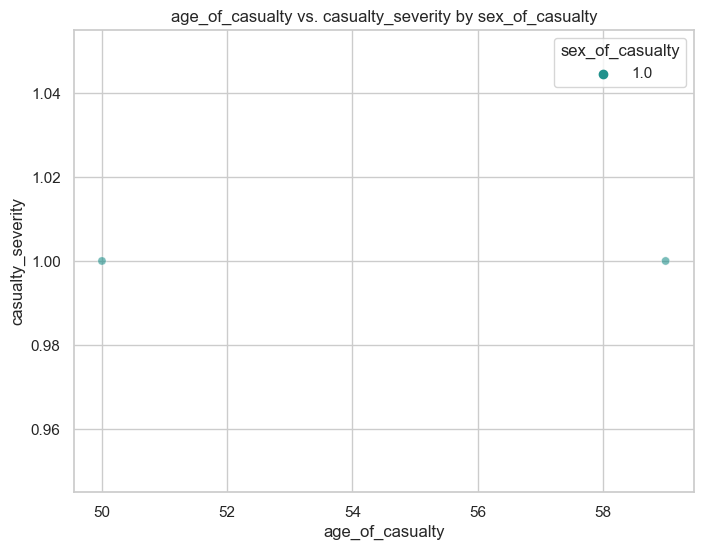

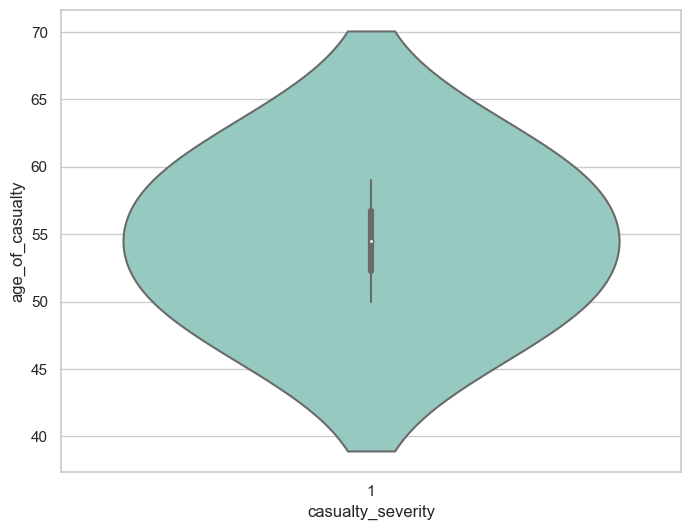

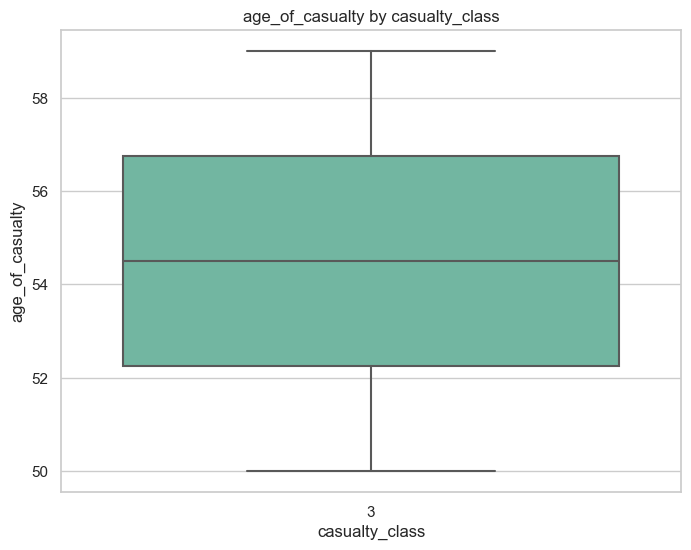

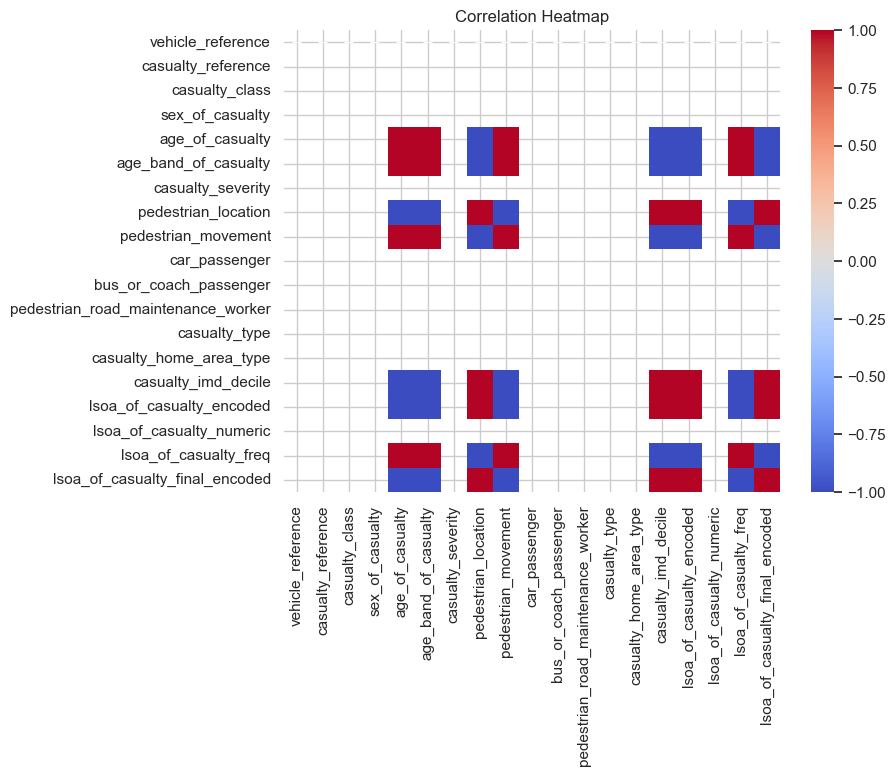

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
Plotting for Labeled DataFrame: df_vehicle_no_1_labeled


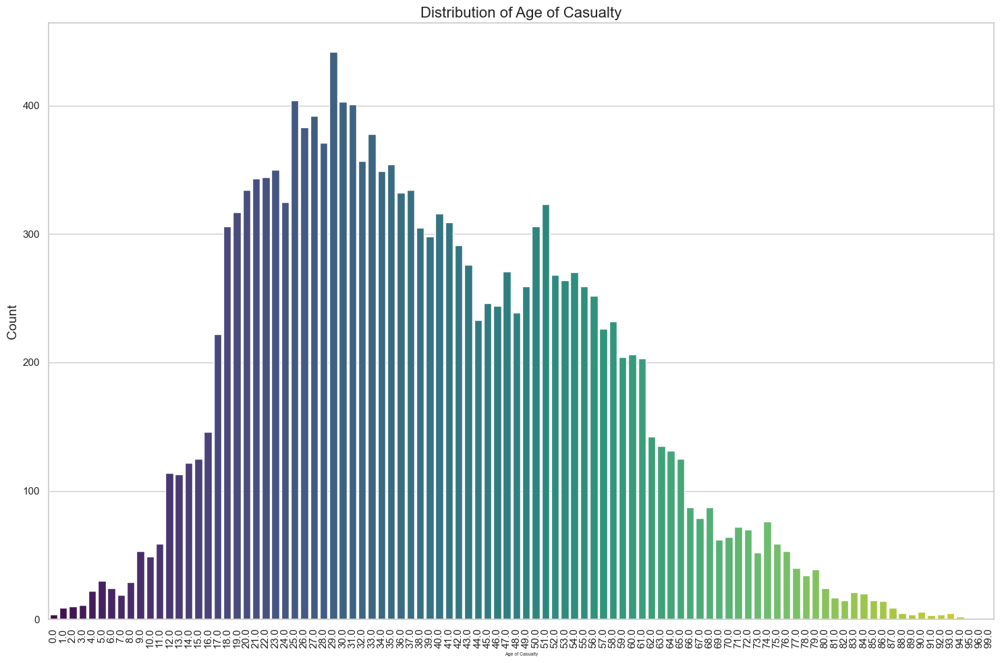

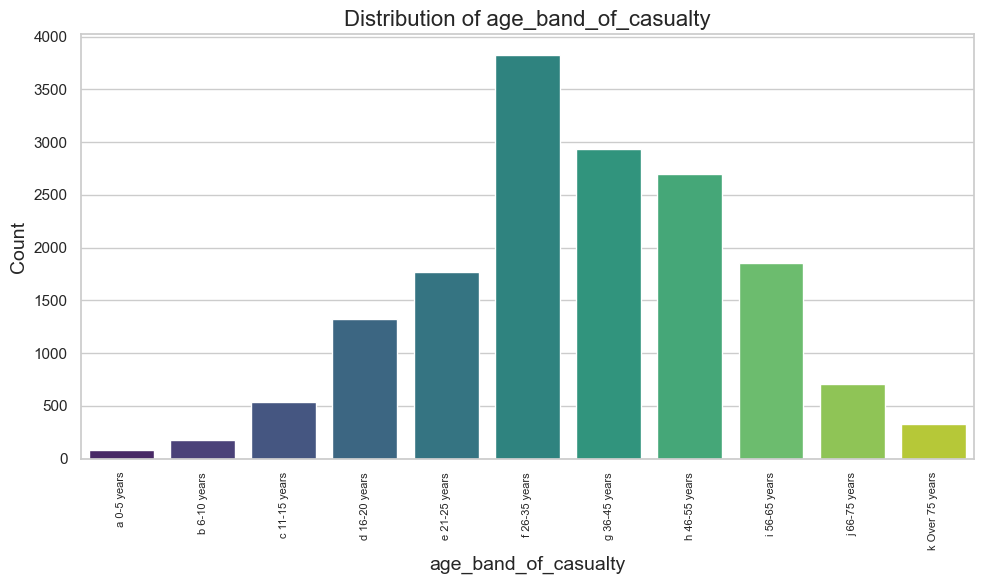

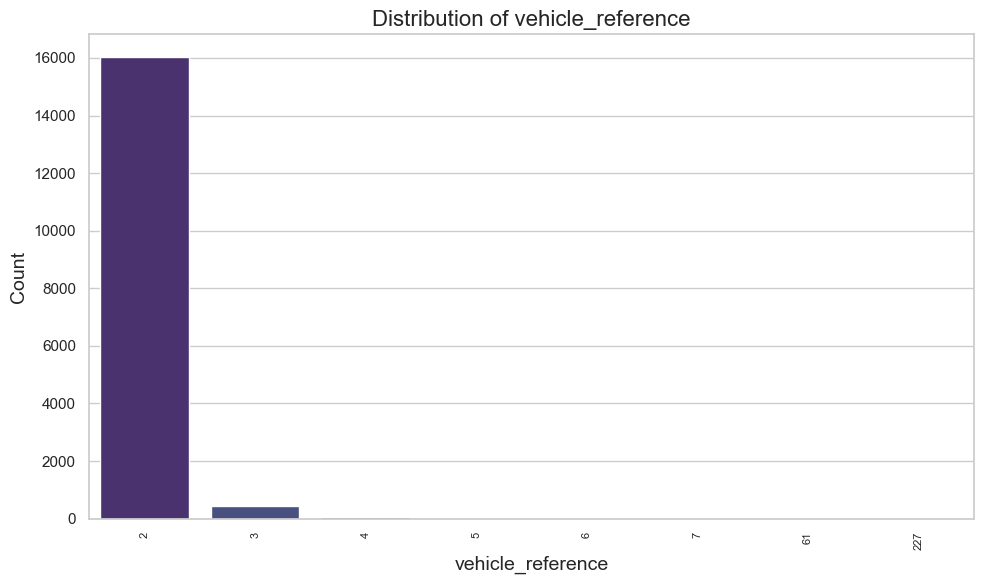

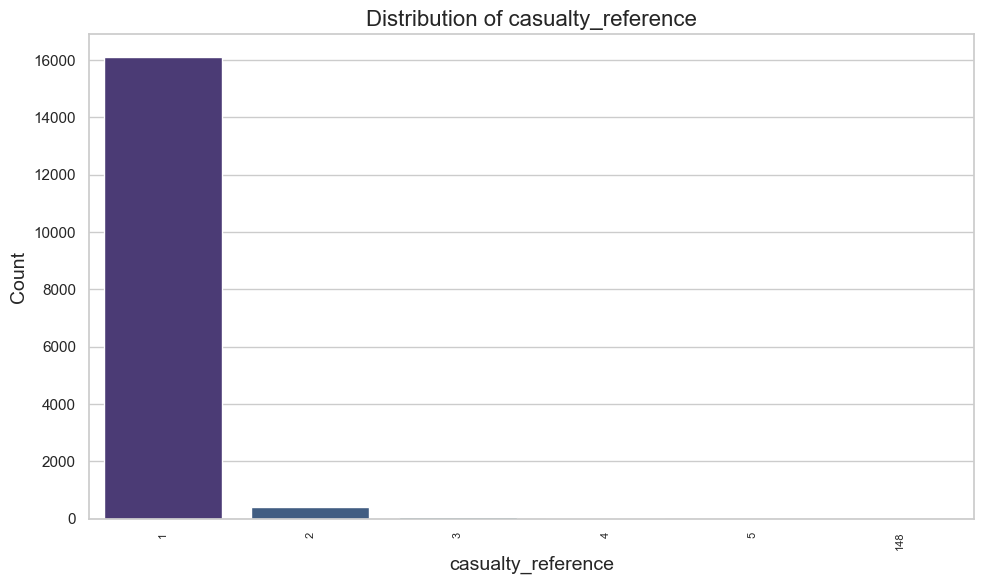

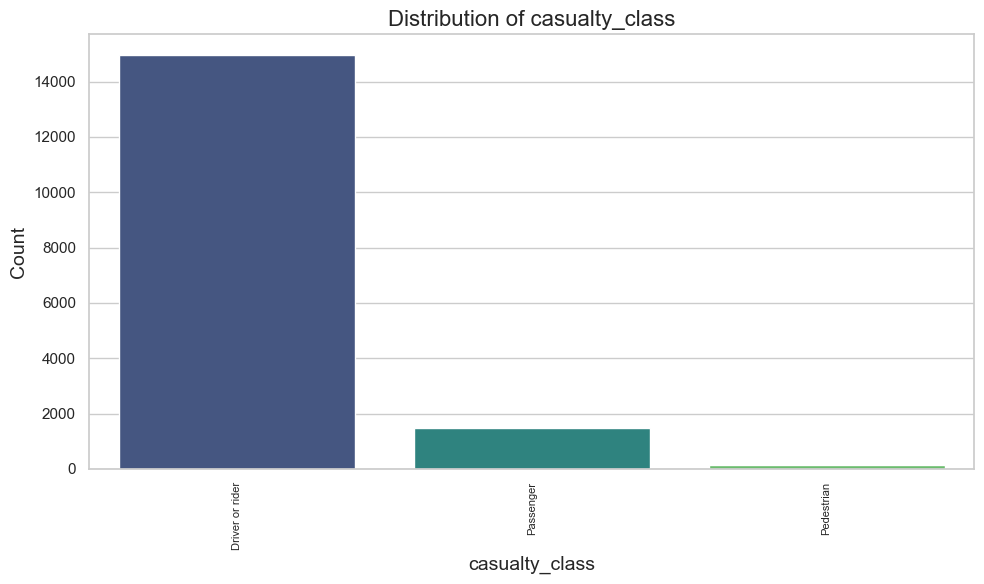

...

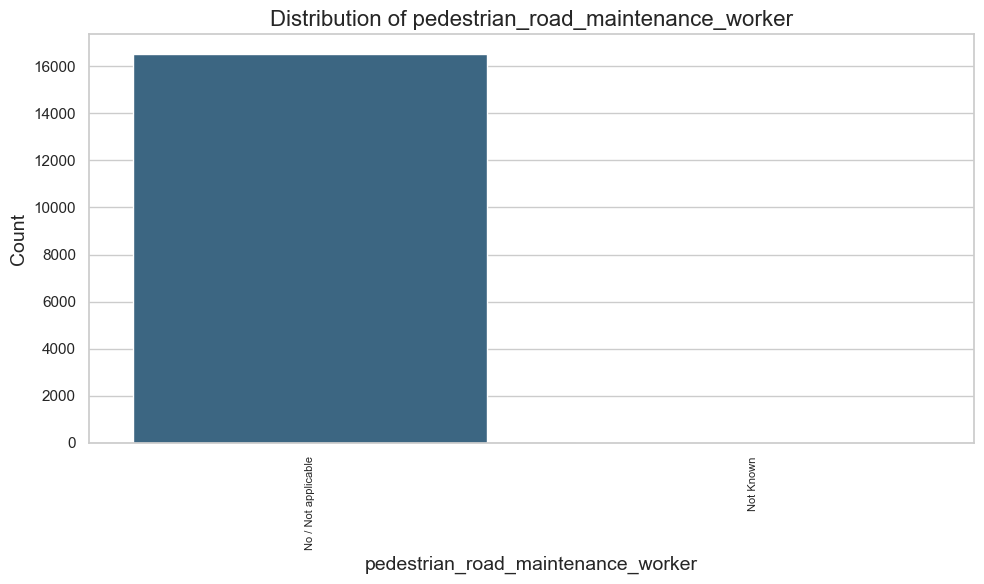

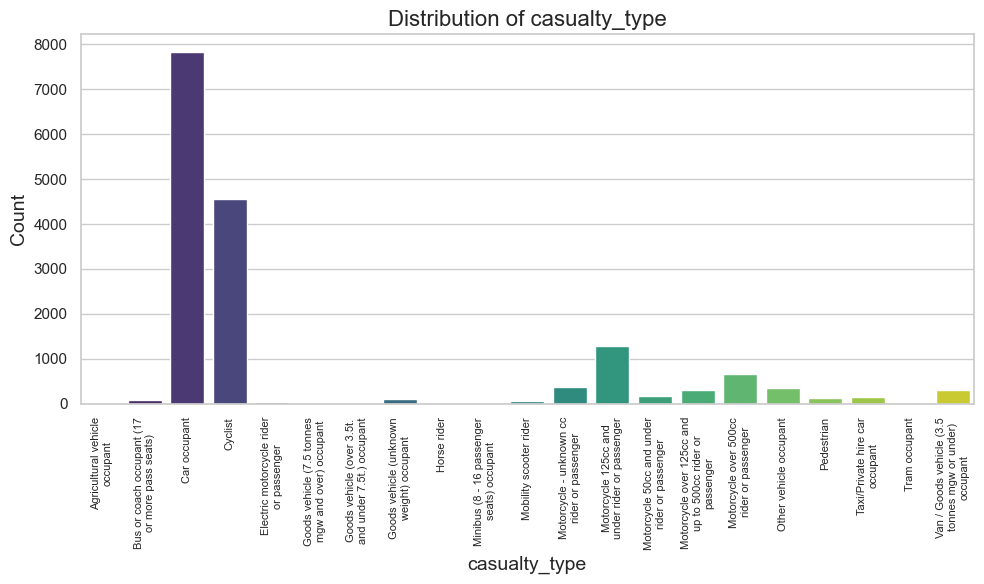

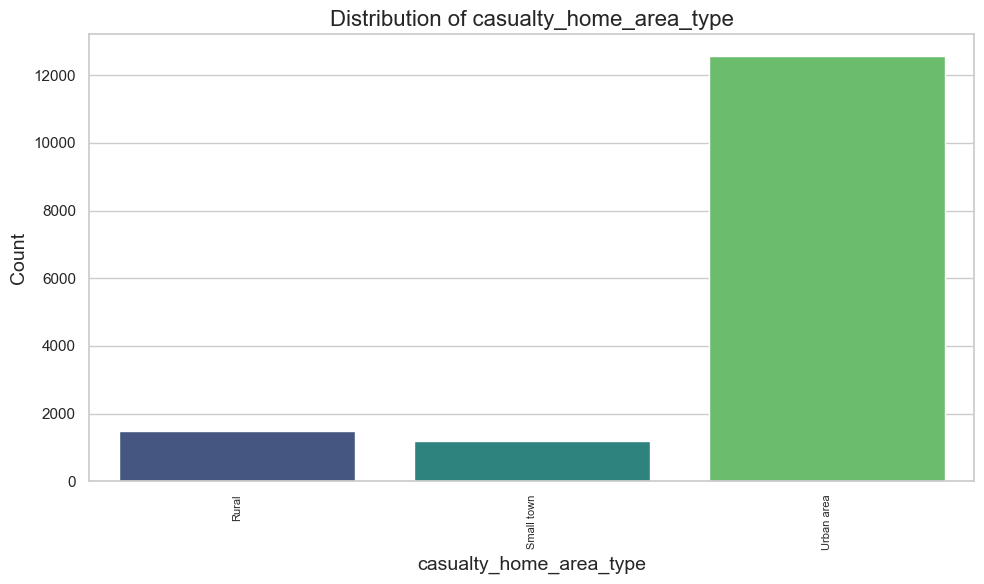

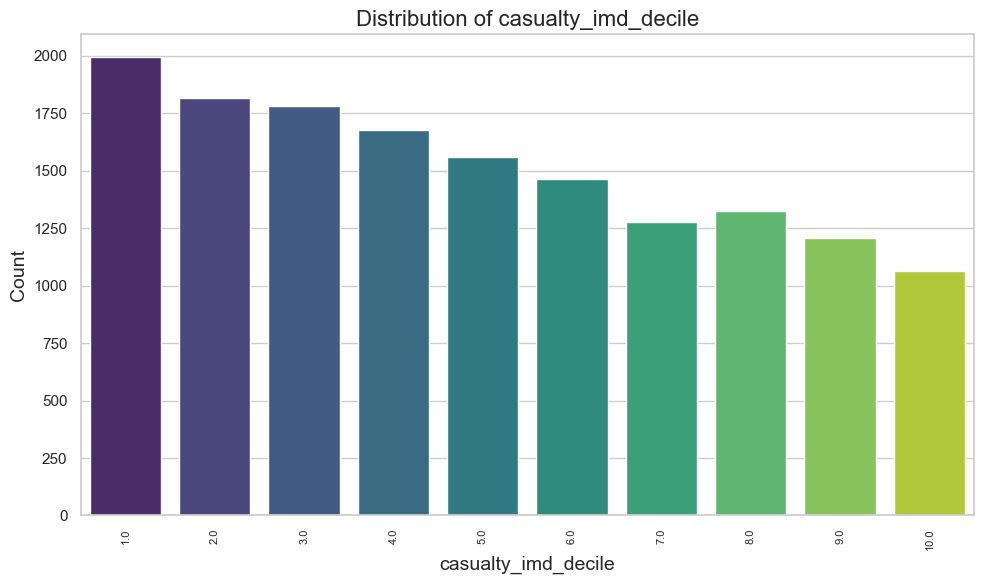

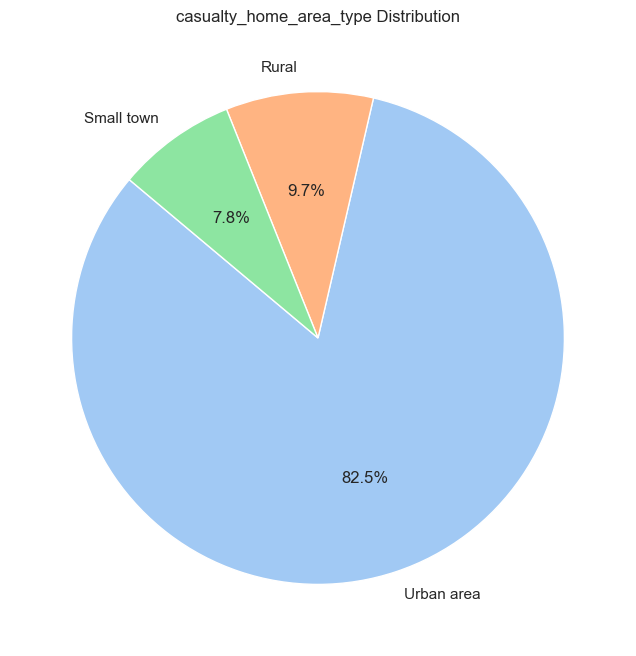

Plotting for Original DataFrame: df_vehicle_no_1


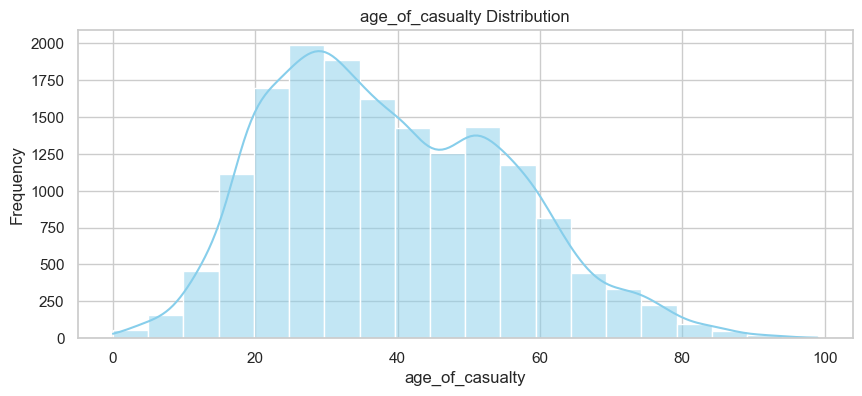

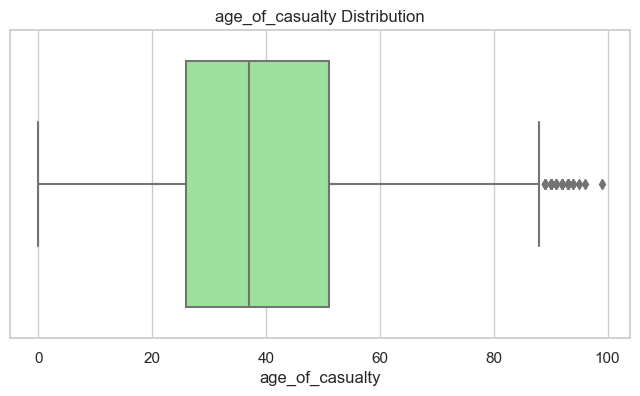

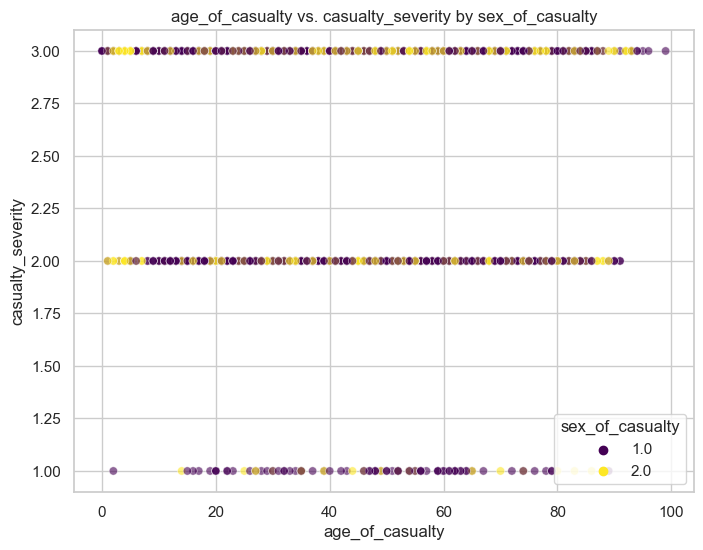

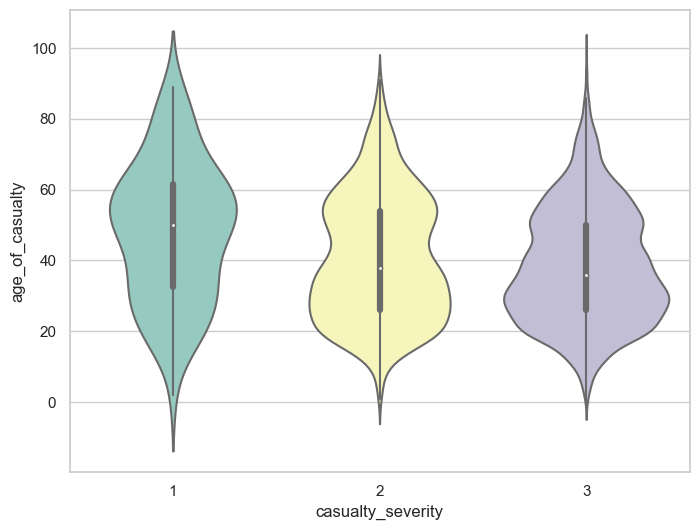

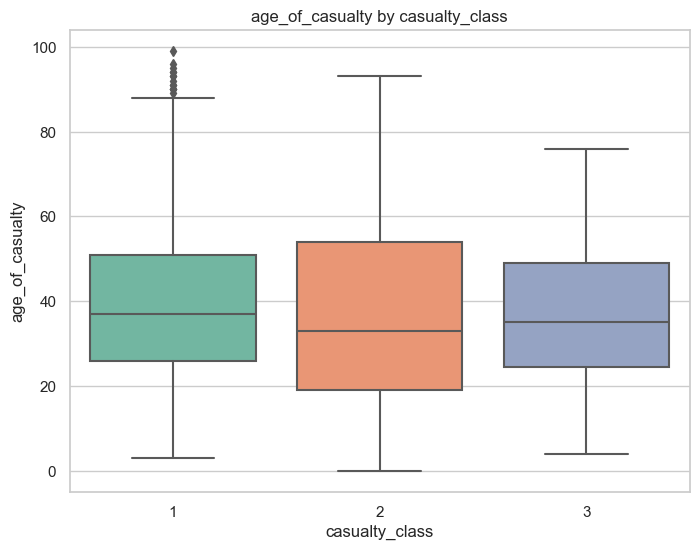

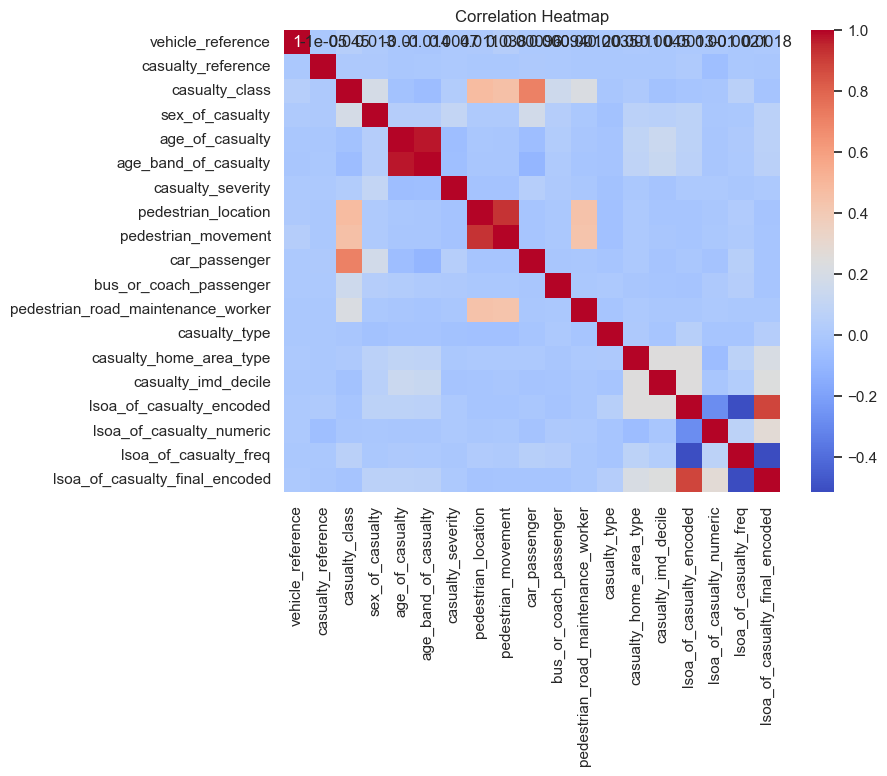

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
Plotting for Labeled DataFrame: df_vehicle_no_1_FS_labeled


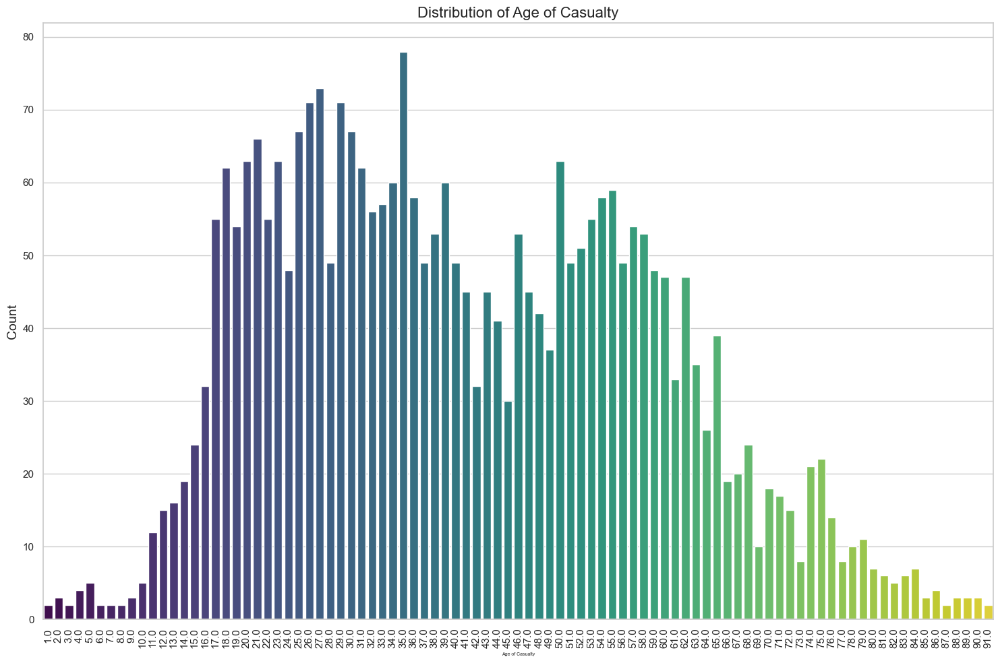

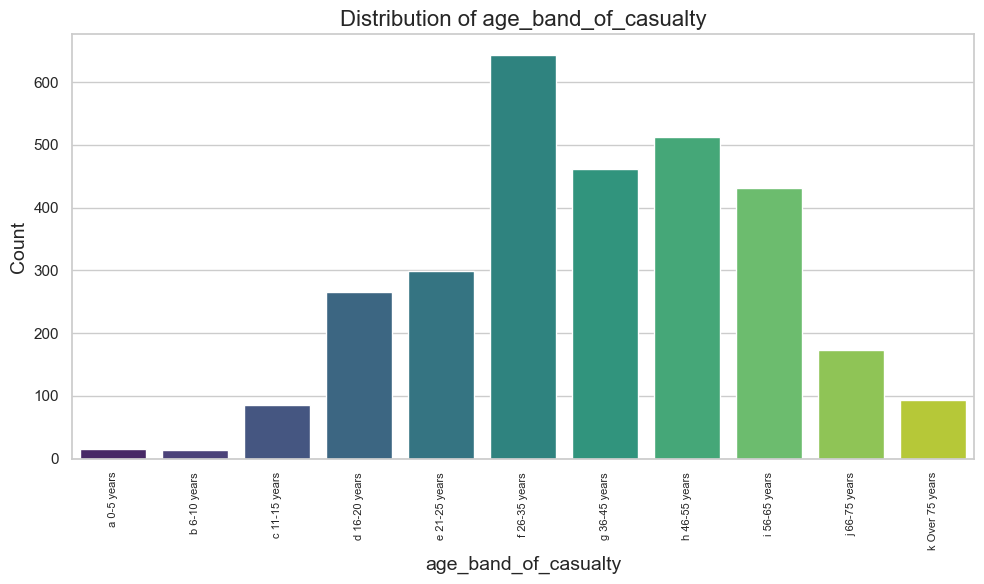

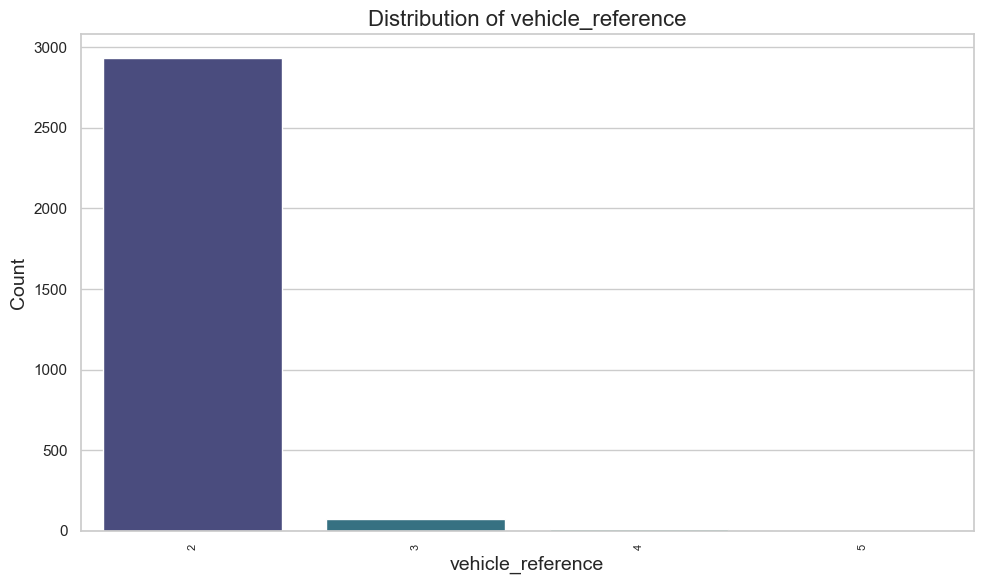

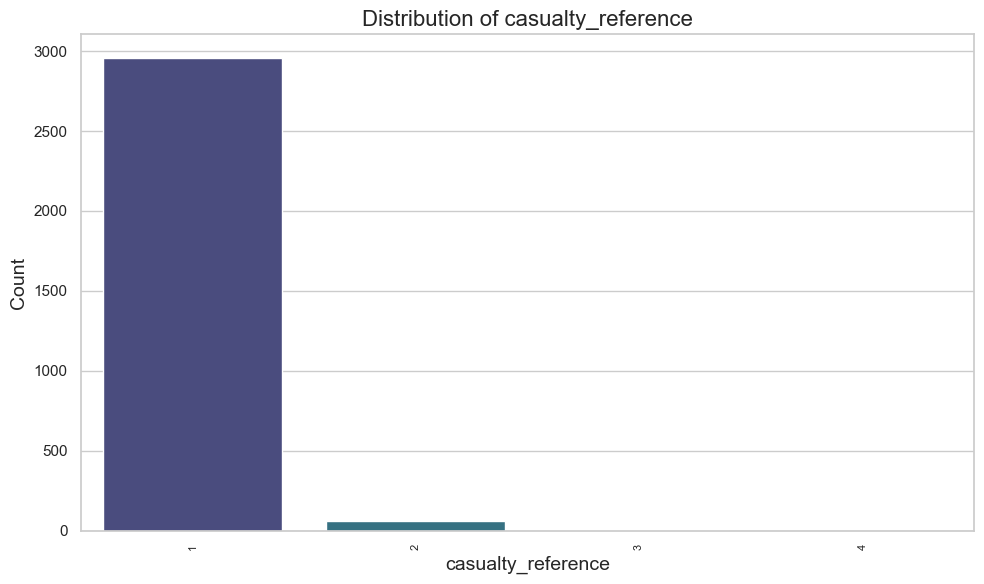

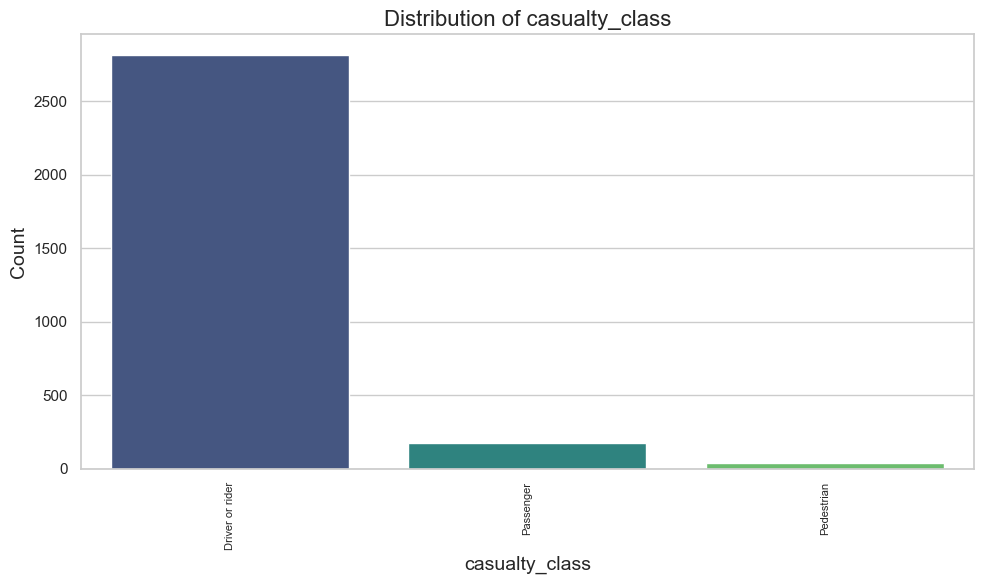

...

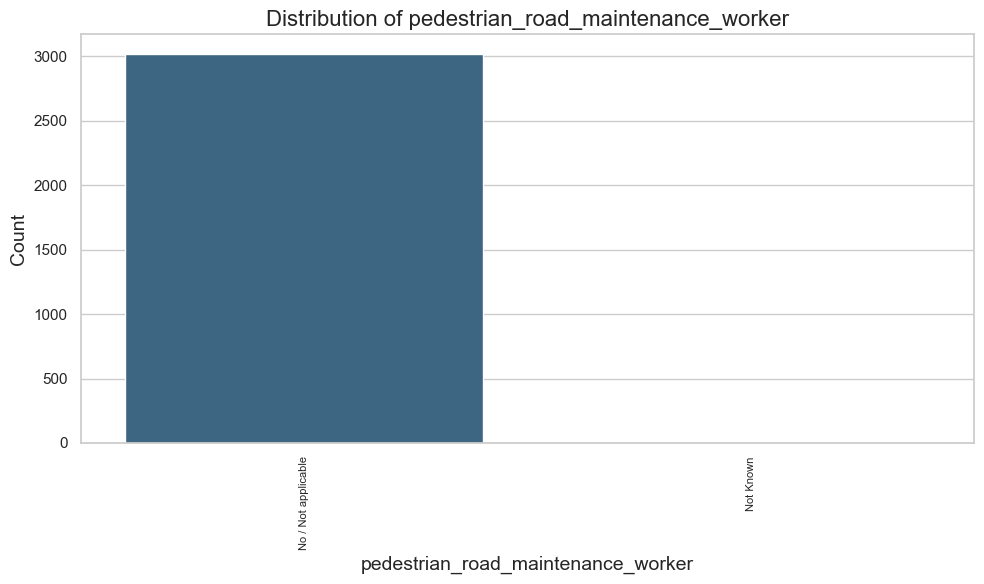

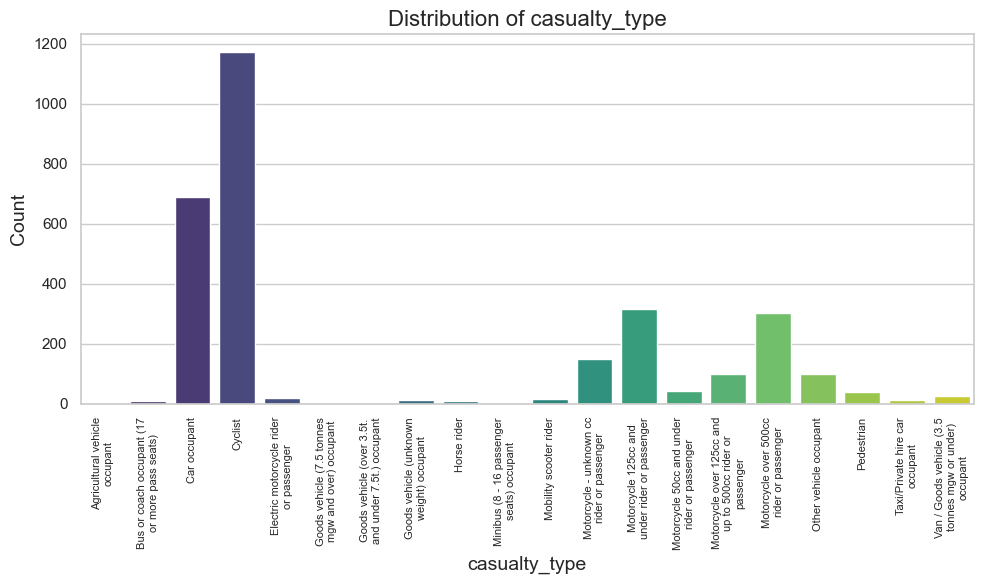

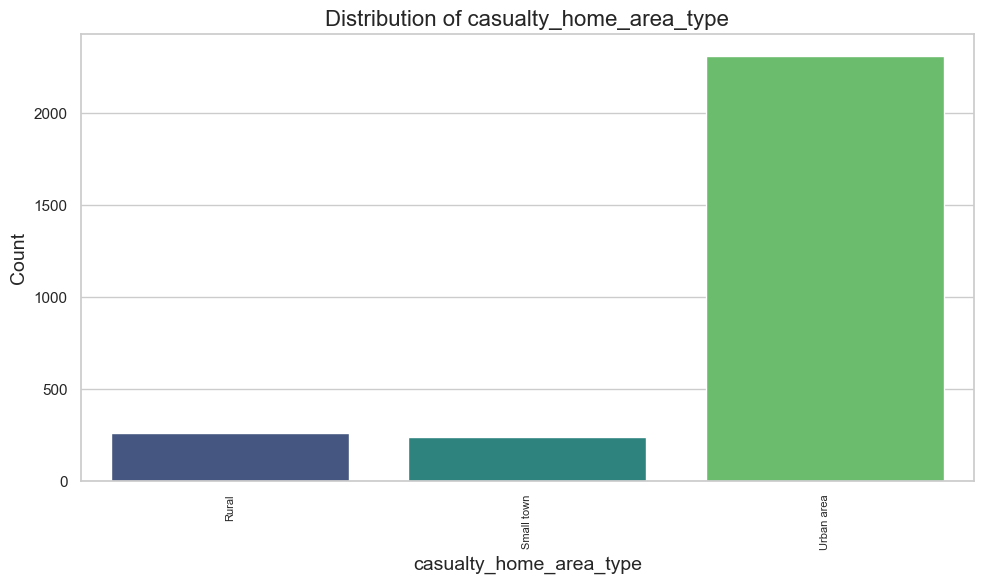

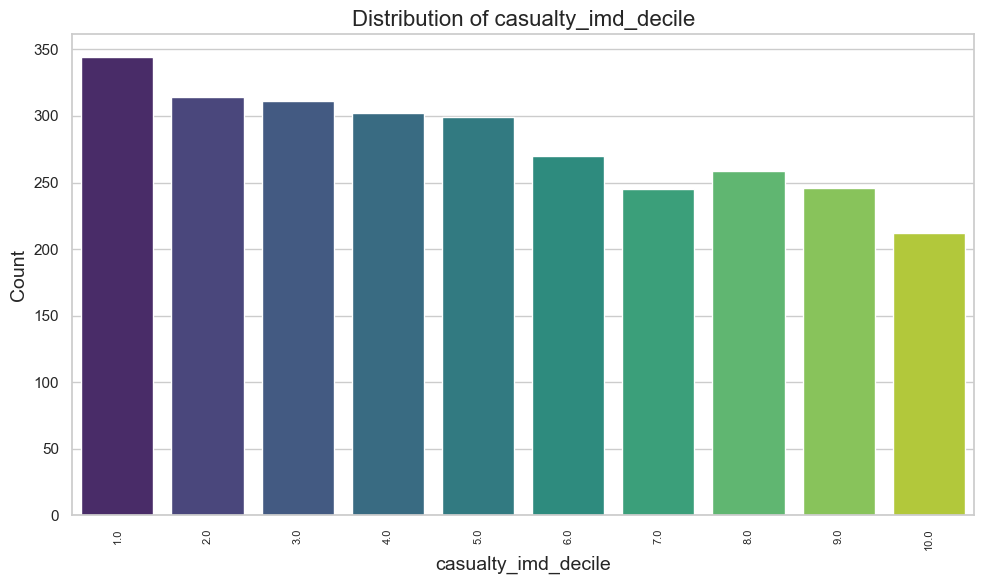

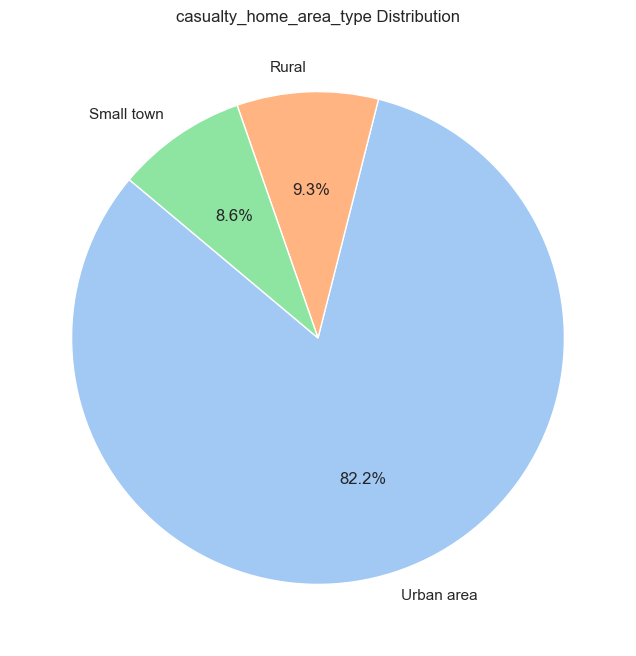

Plotting for Original DataFrame: df_vehicle_no_1_FS


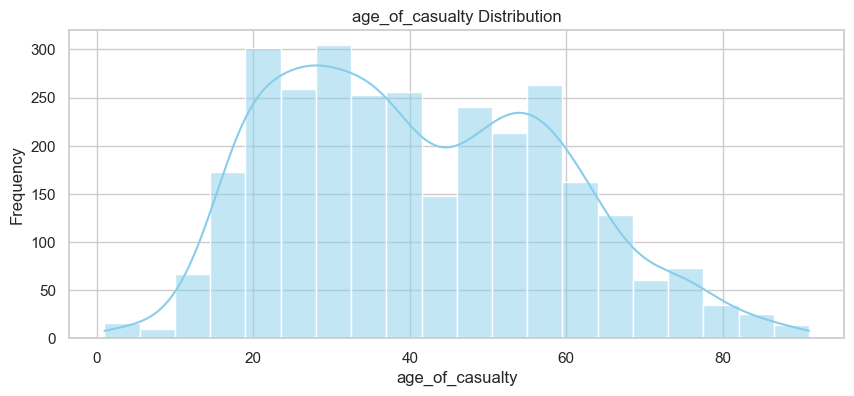

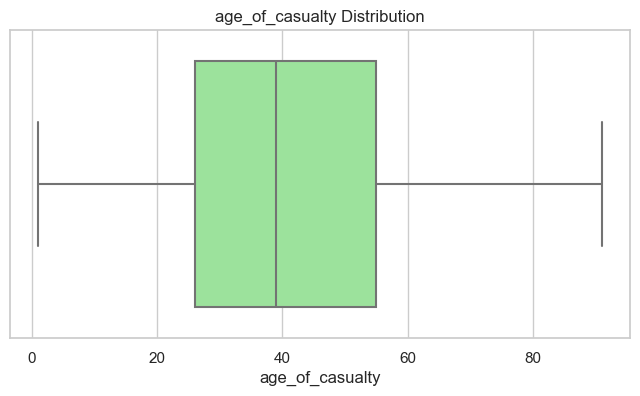

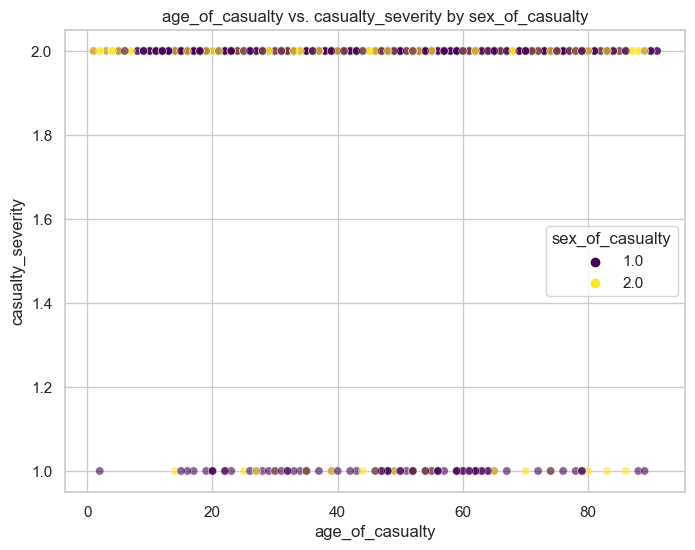

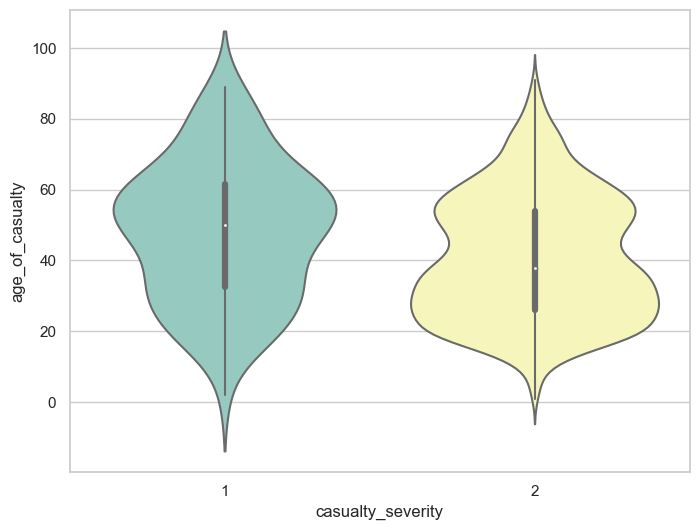

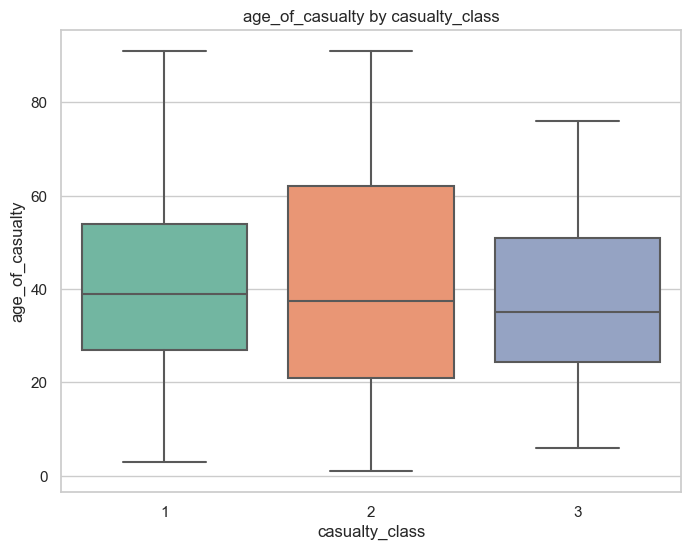

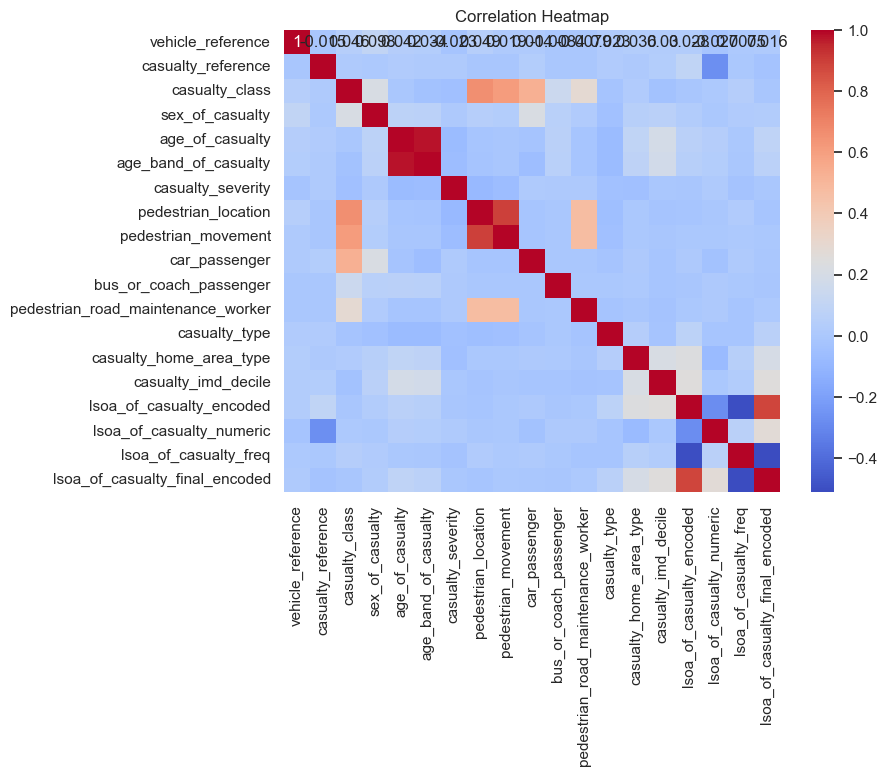

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
Plotting for Labeled DataFrame: df_casualty_ref_gt_2_labeled


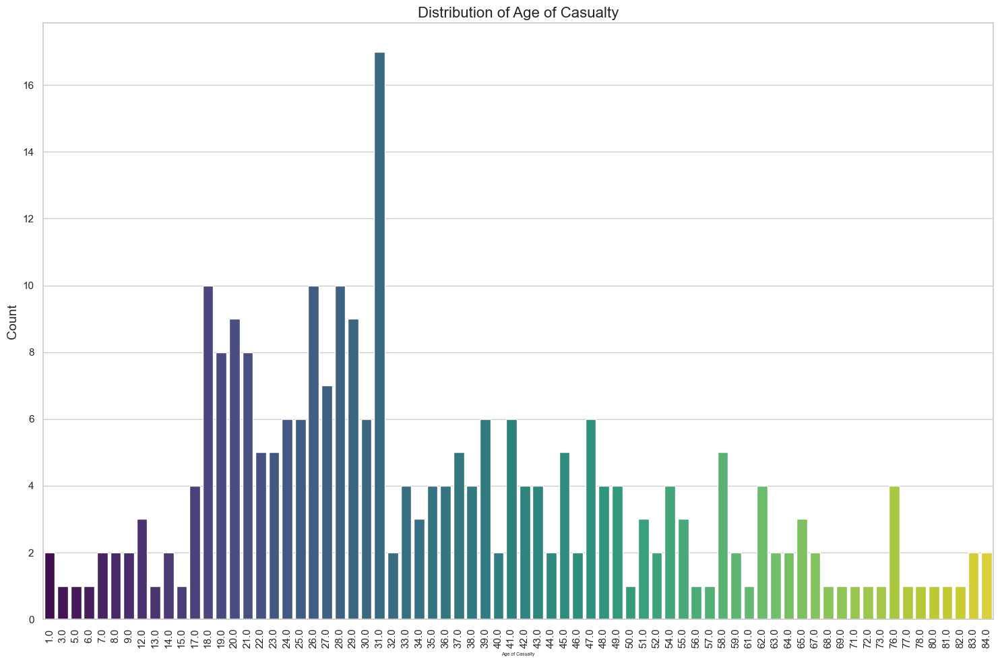

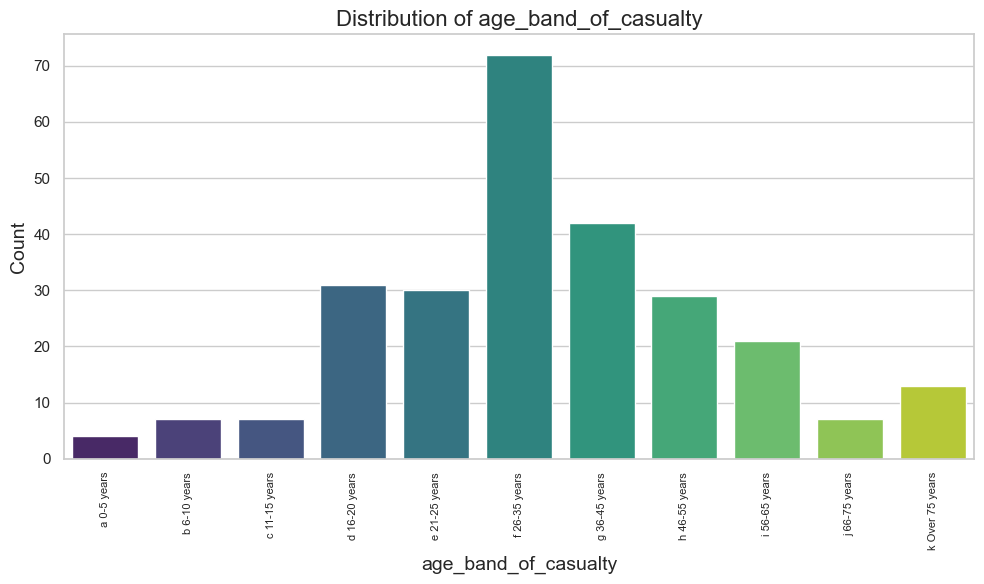

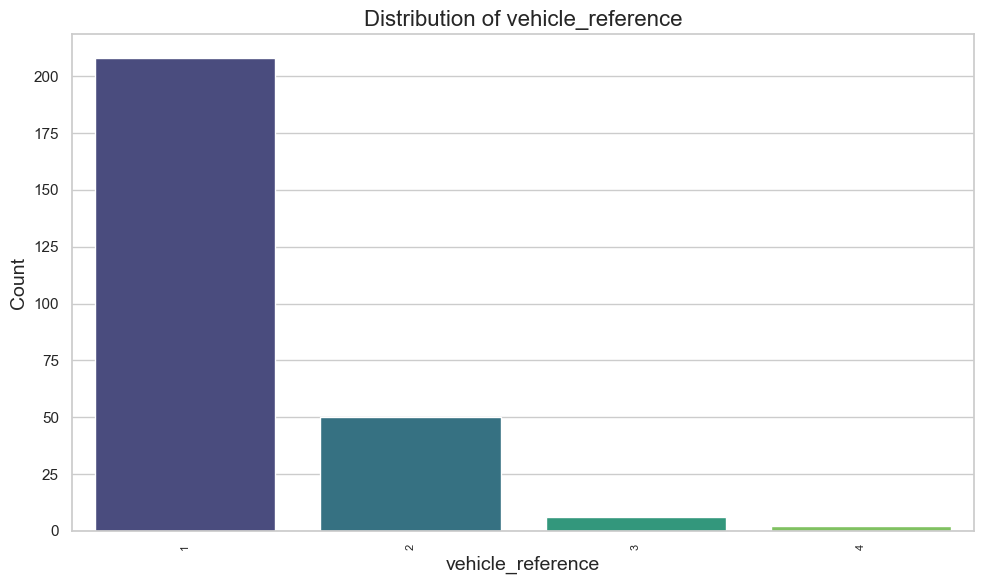

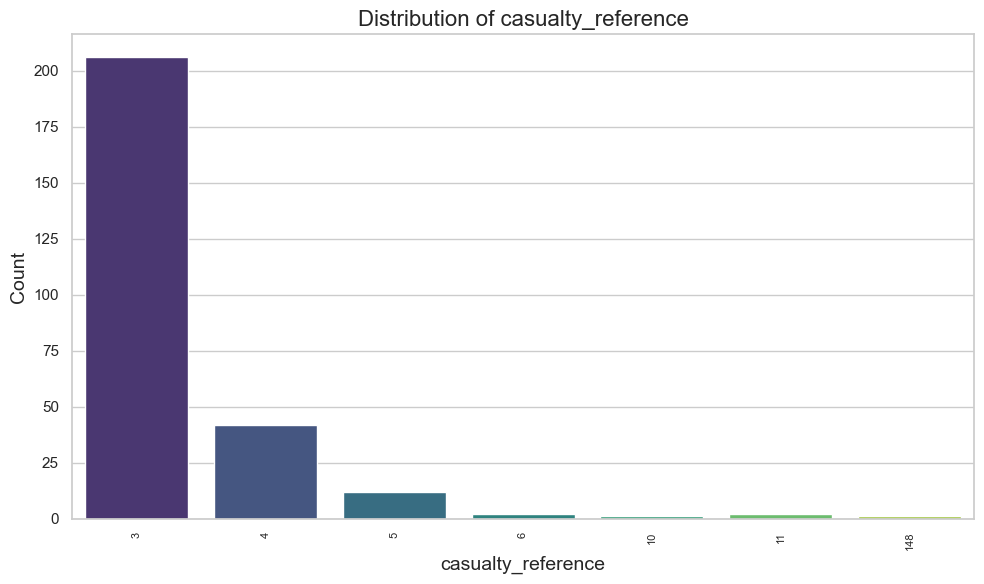

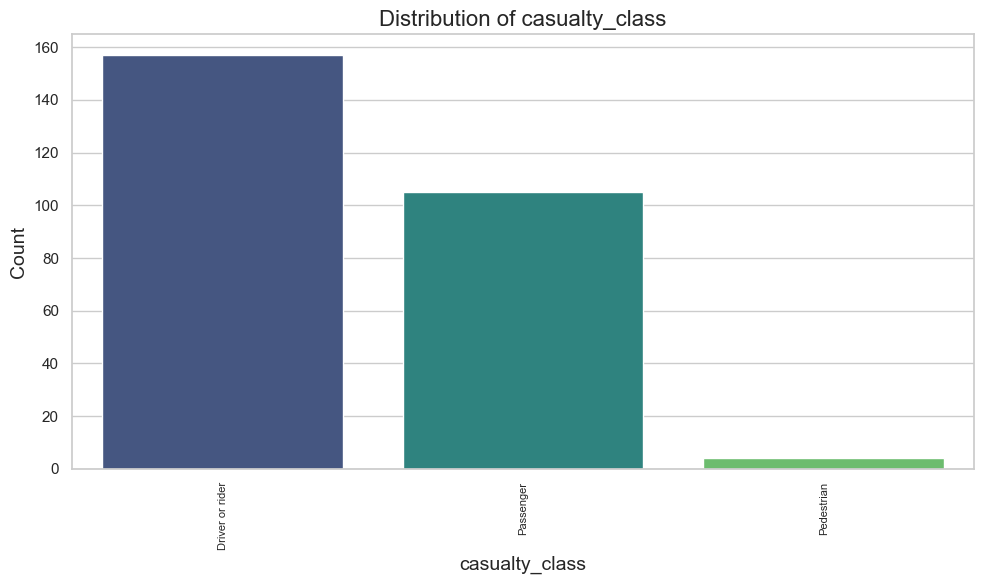

...

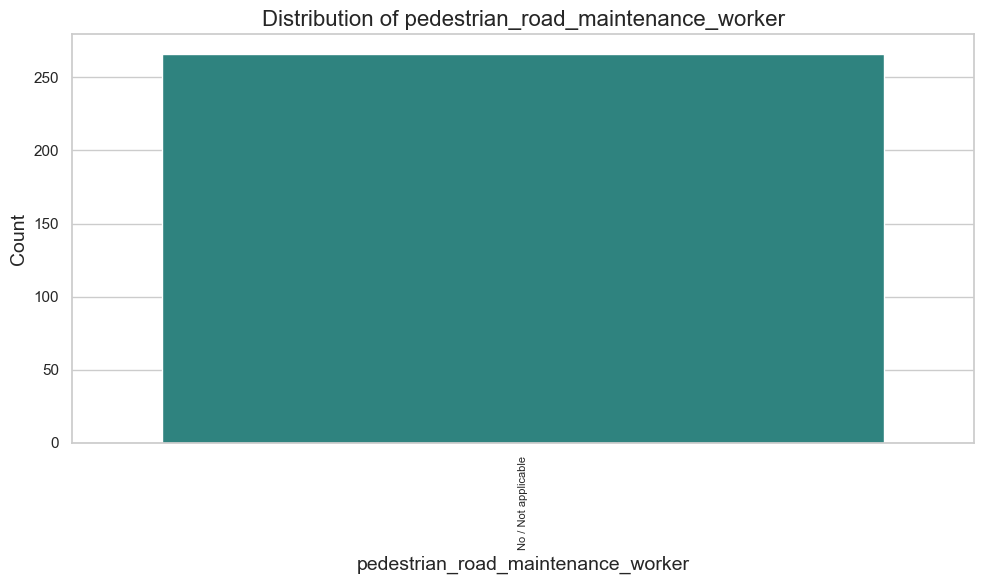

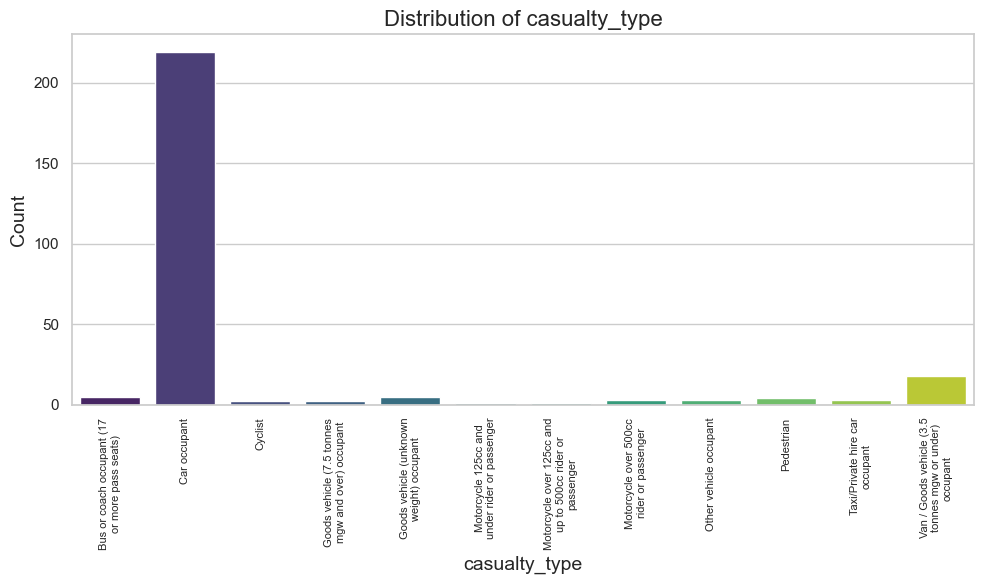

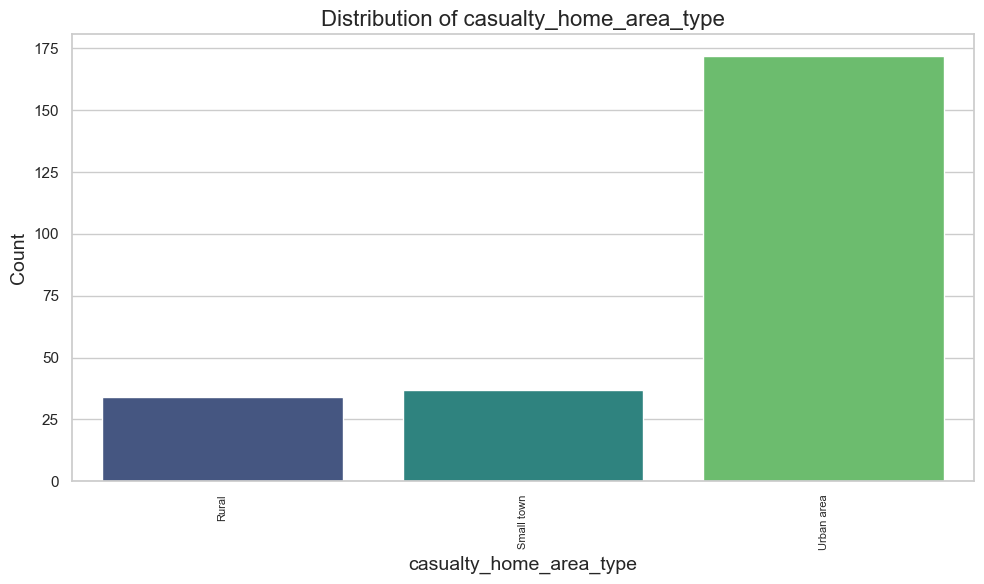

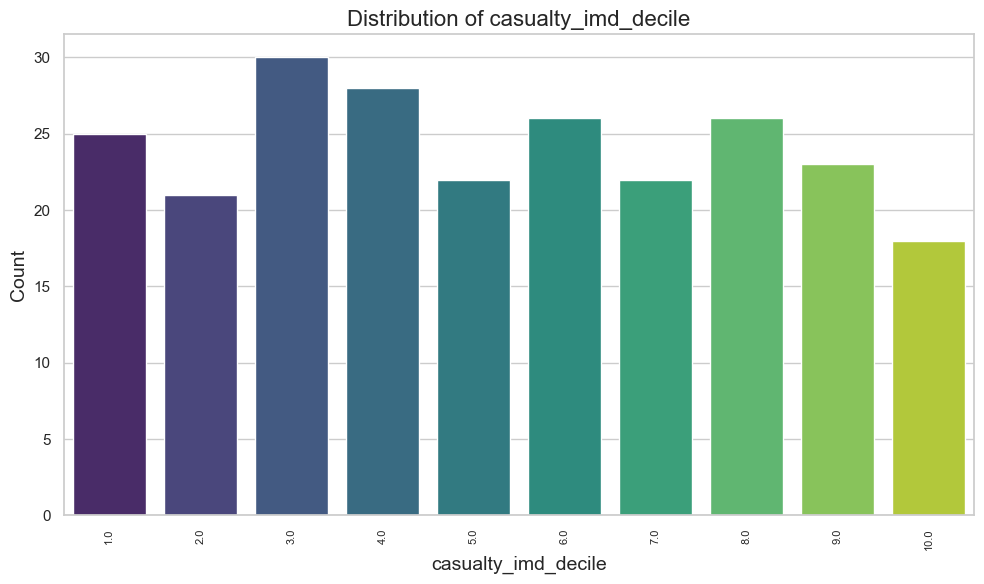

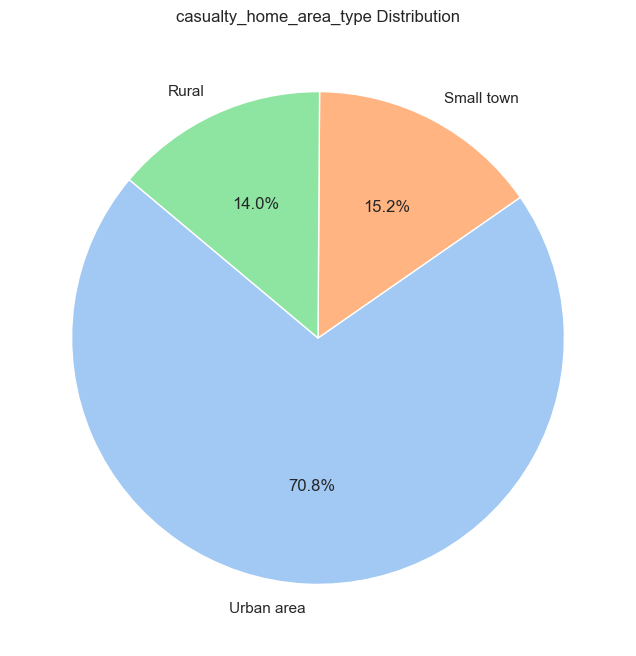

Plotting for Original DataFrame: df_casualty_ref_gt_2


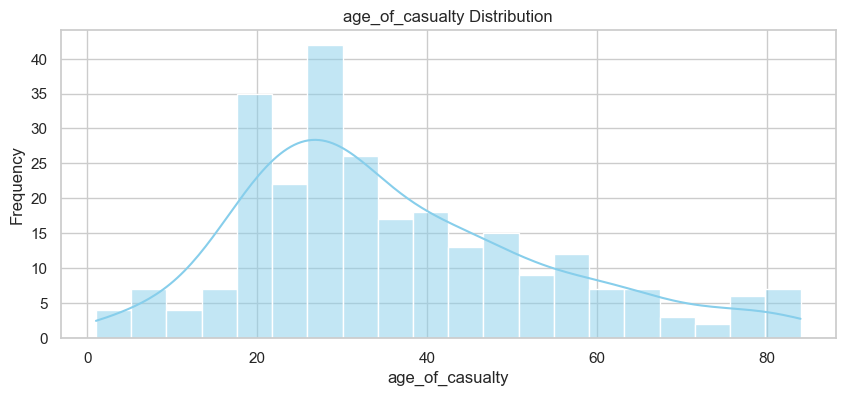

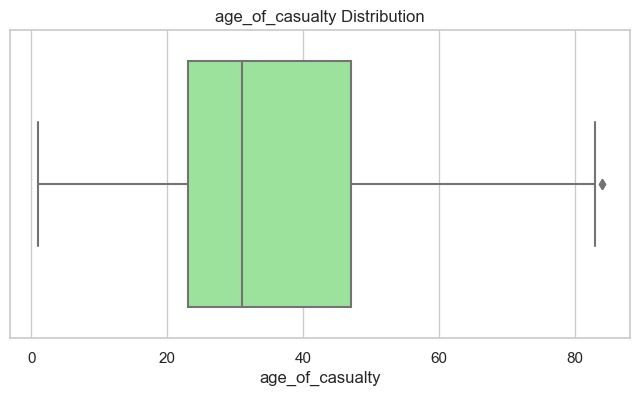

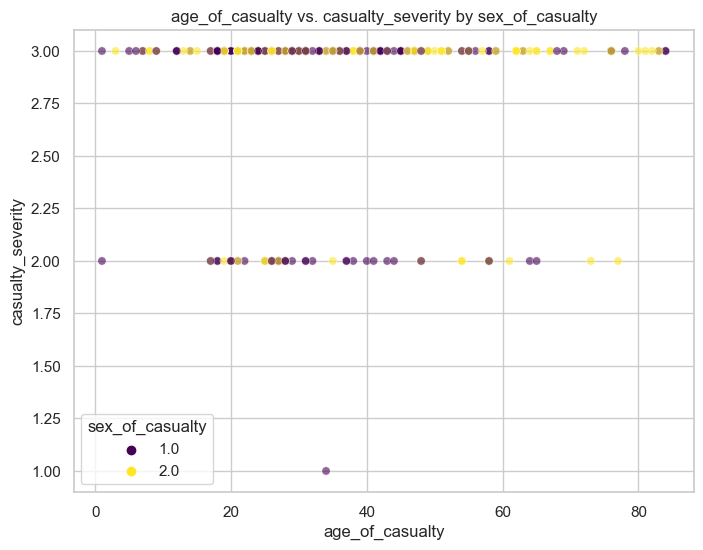

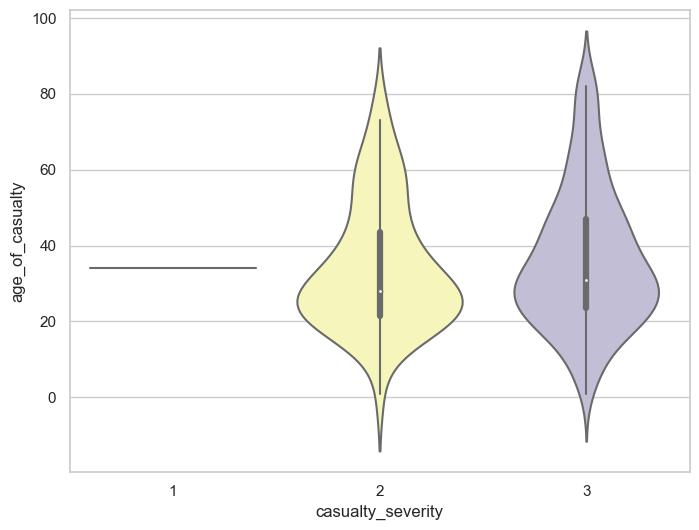

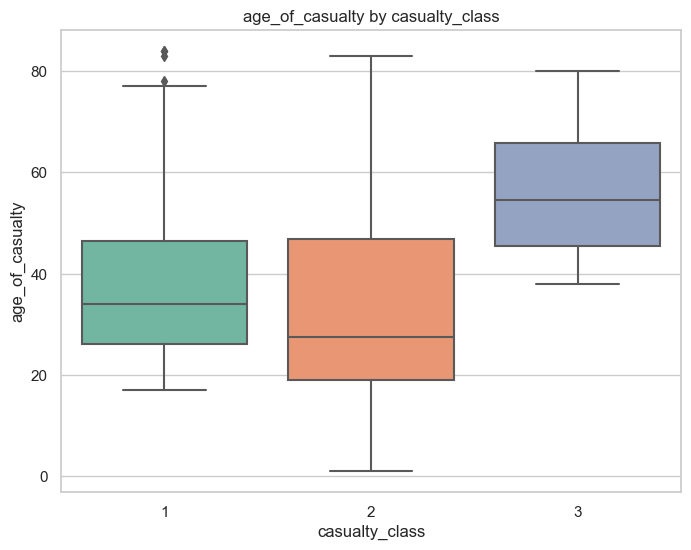

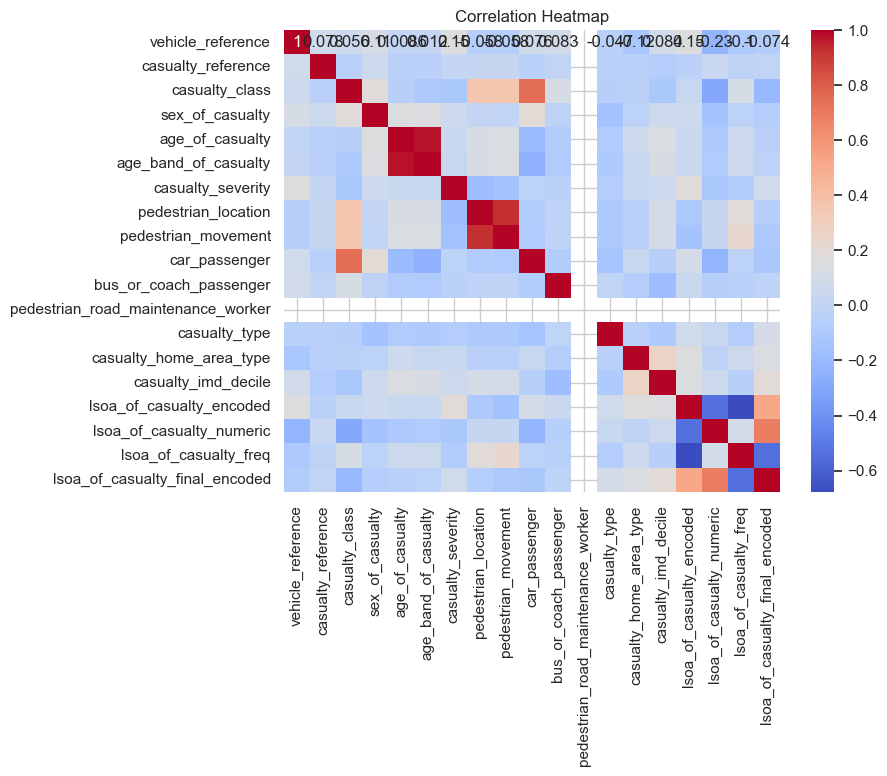

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
Plotting for Labeled DataFrame: df_pedestrians_top_1500_labeled


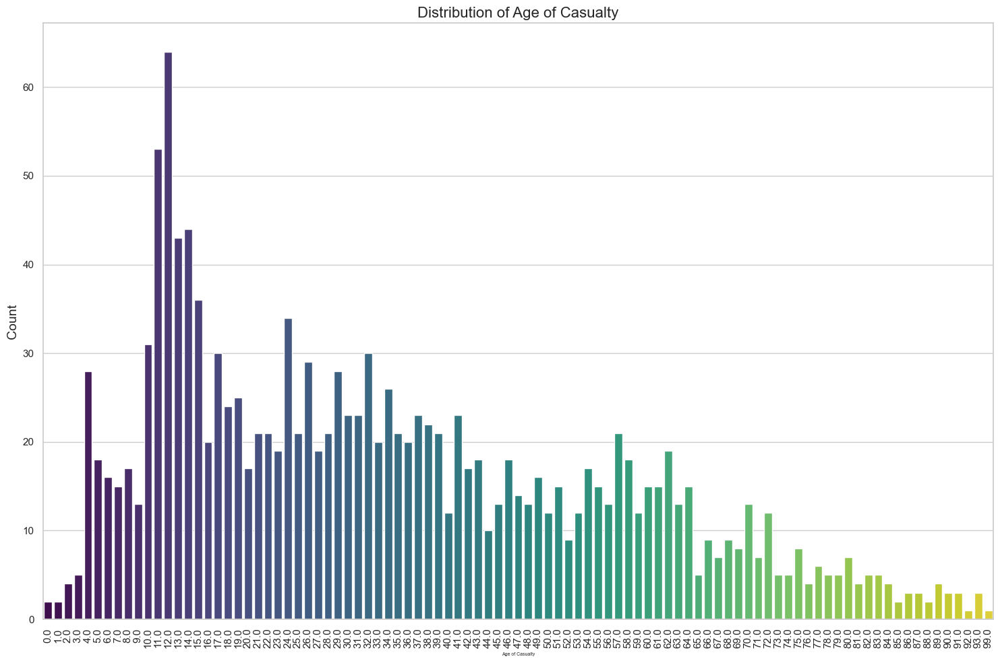

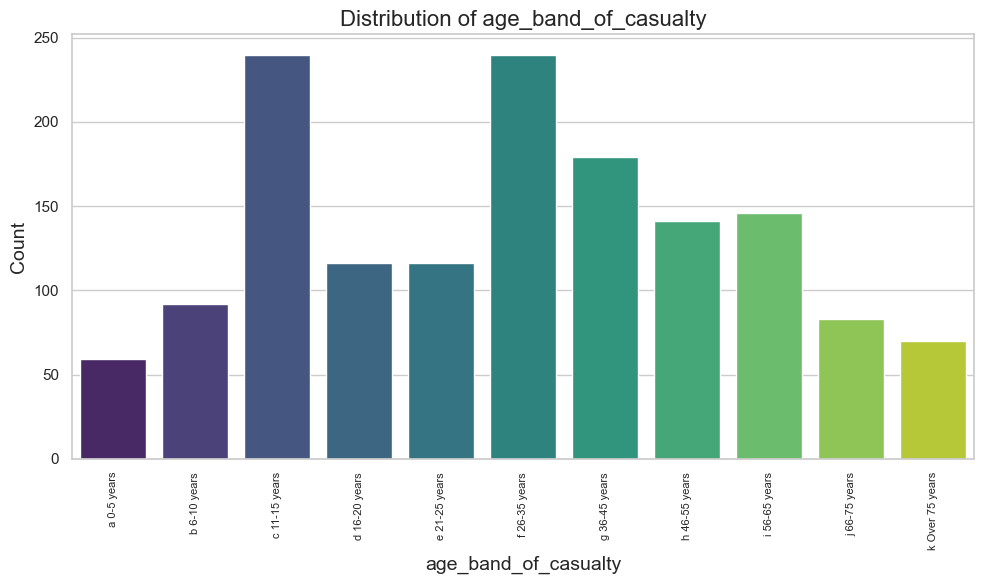

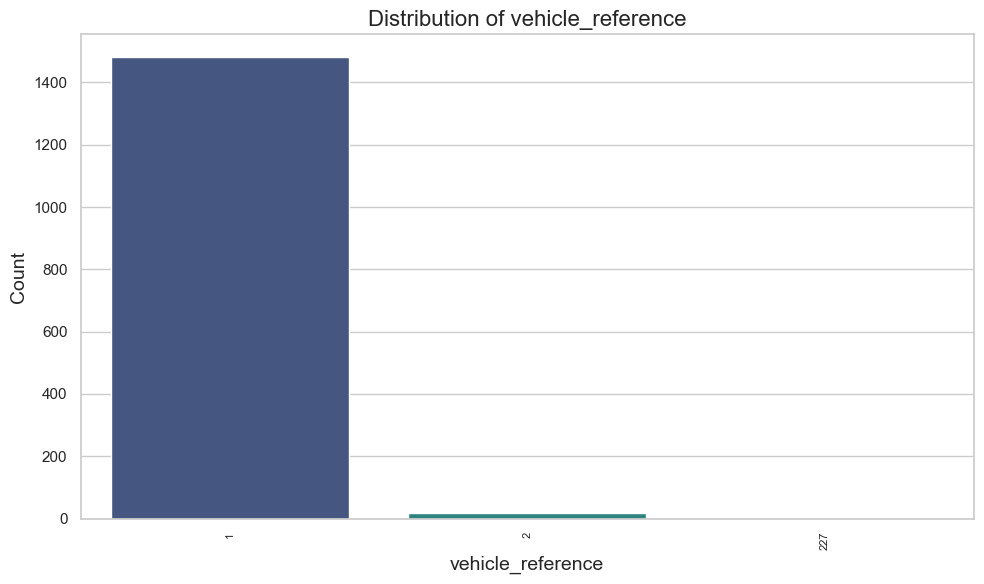

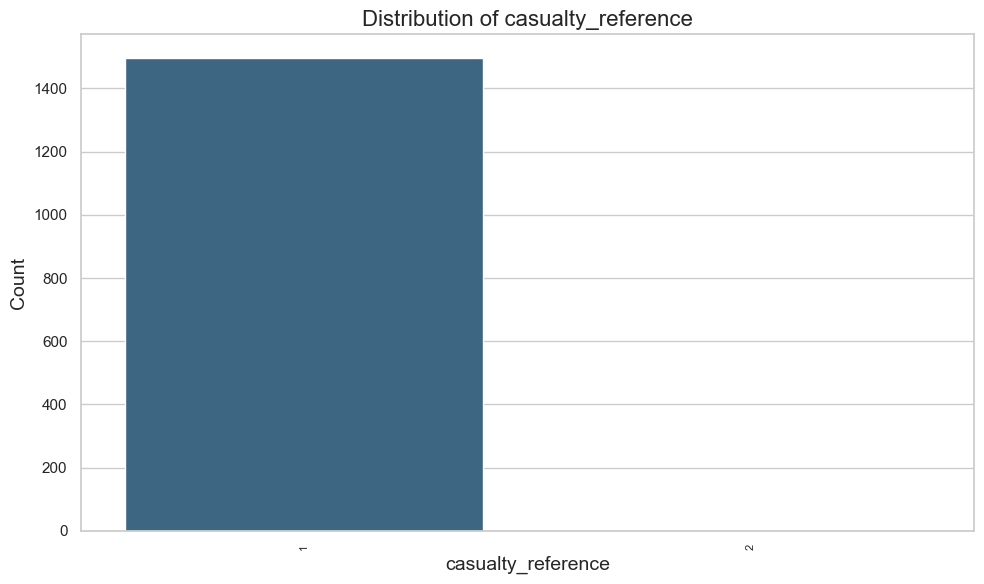

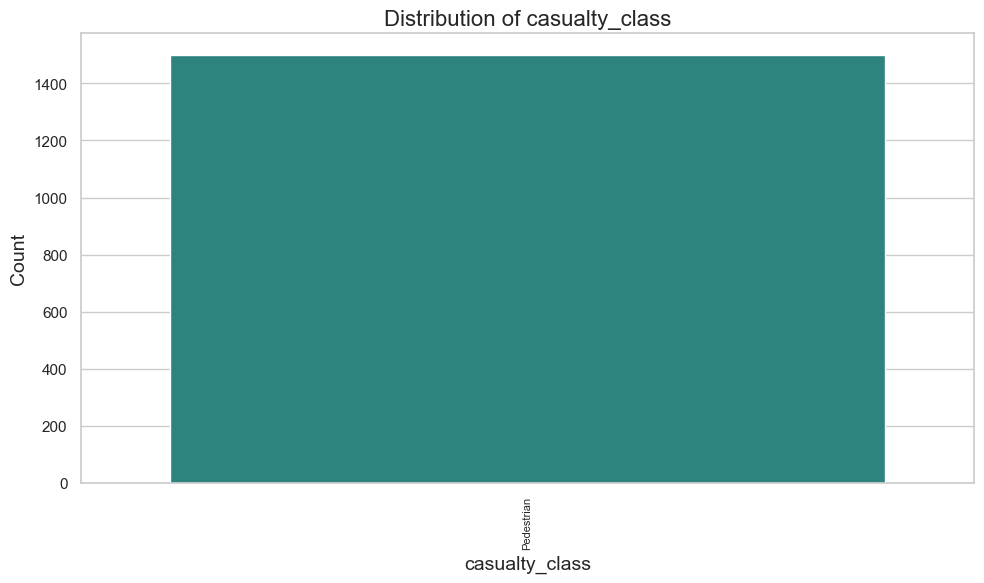

...

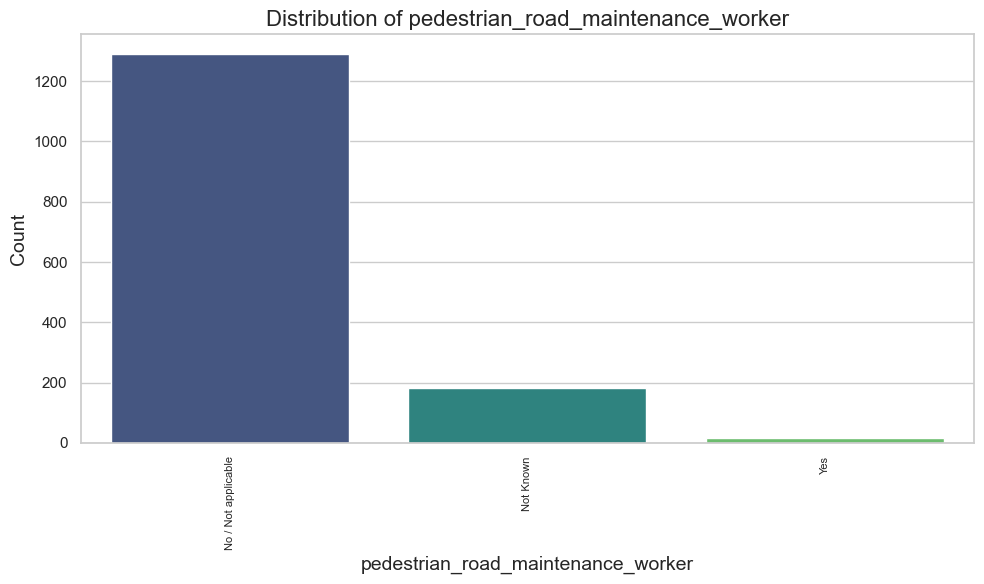

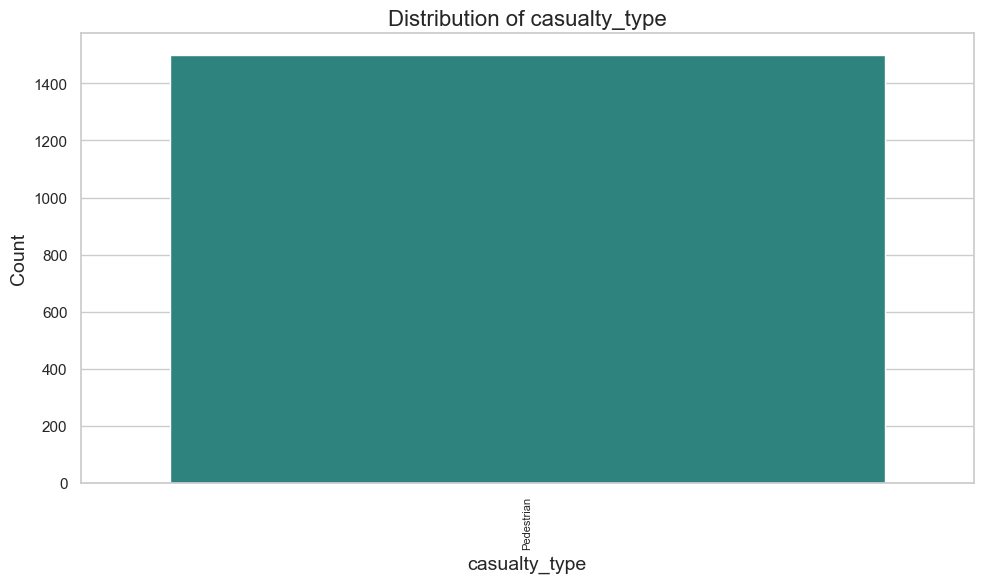

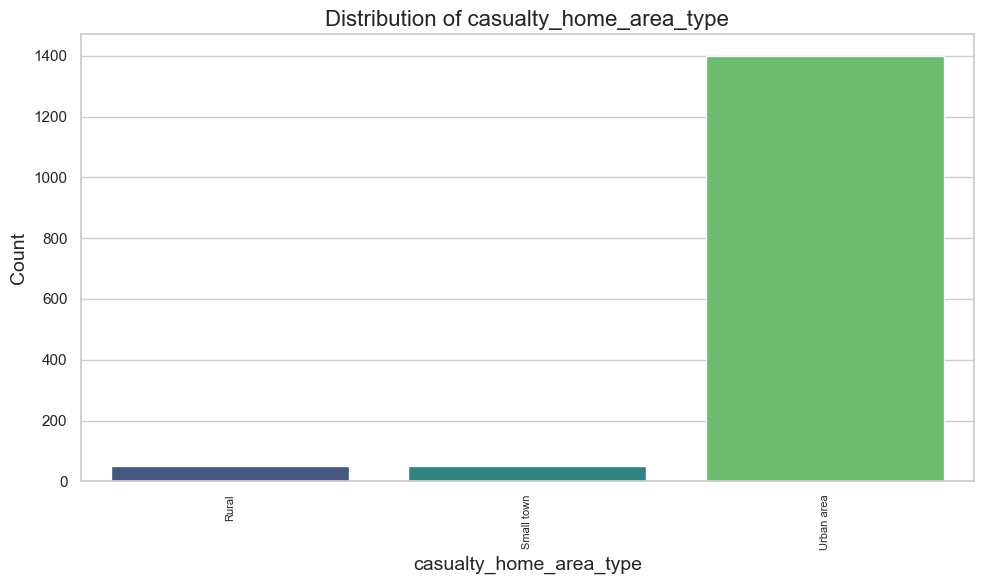

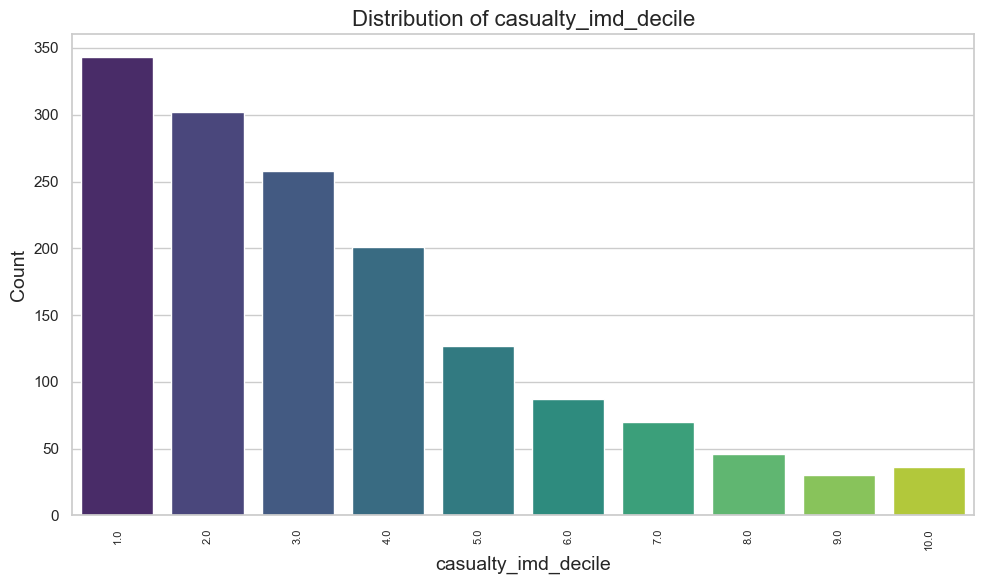

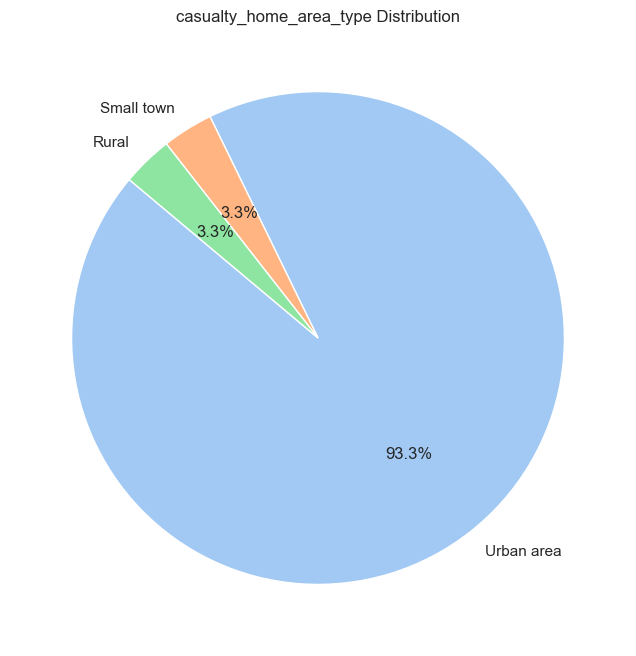

Plotting for Original DataFrame: df_pedestrians_top_1500


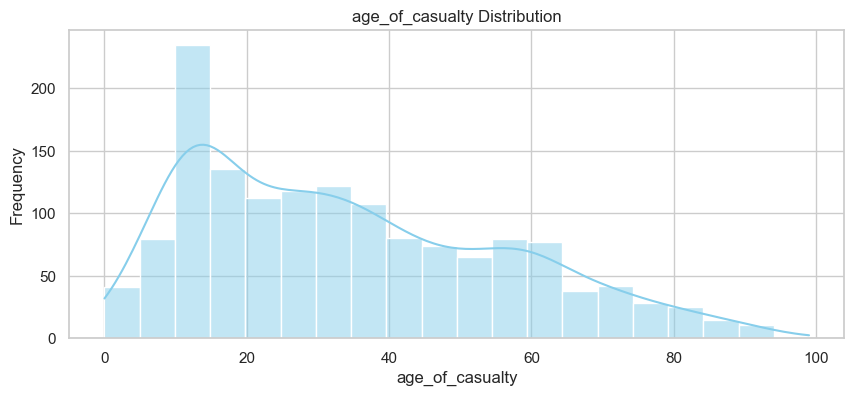

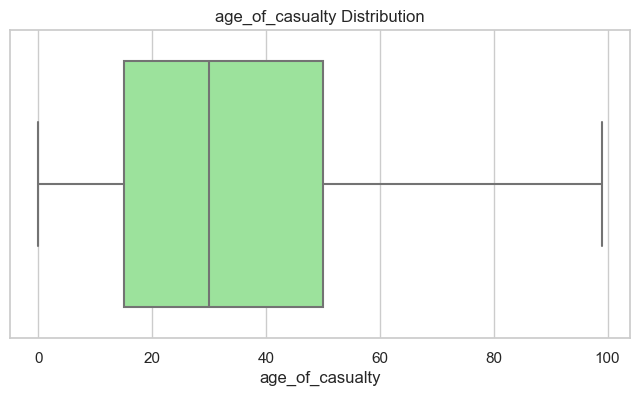

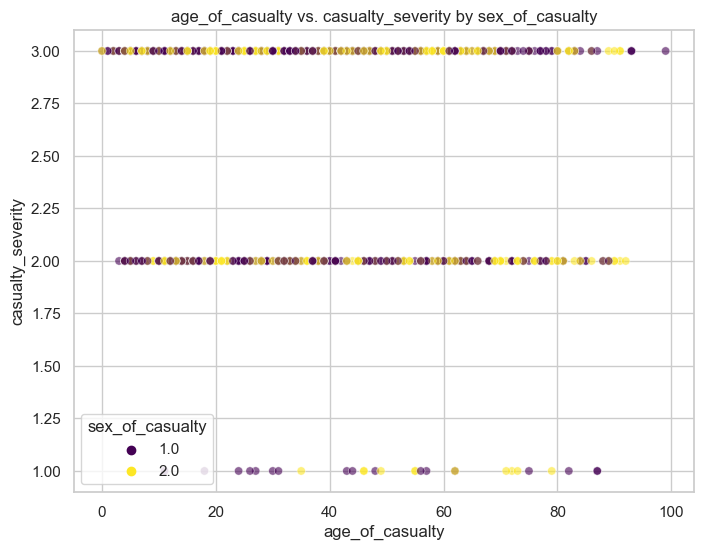

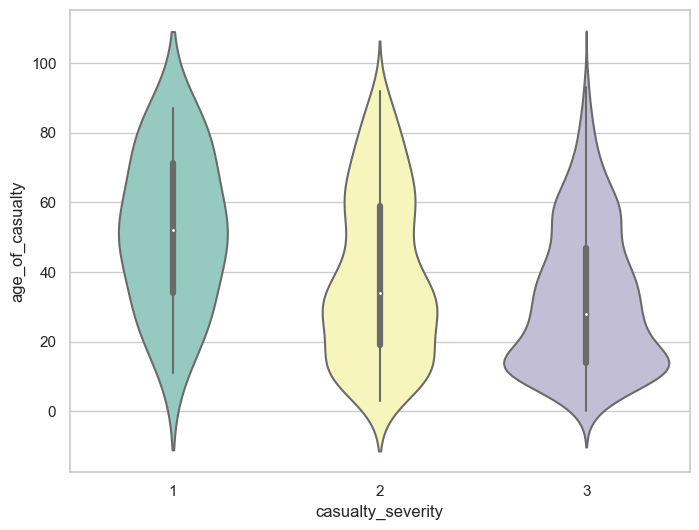

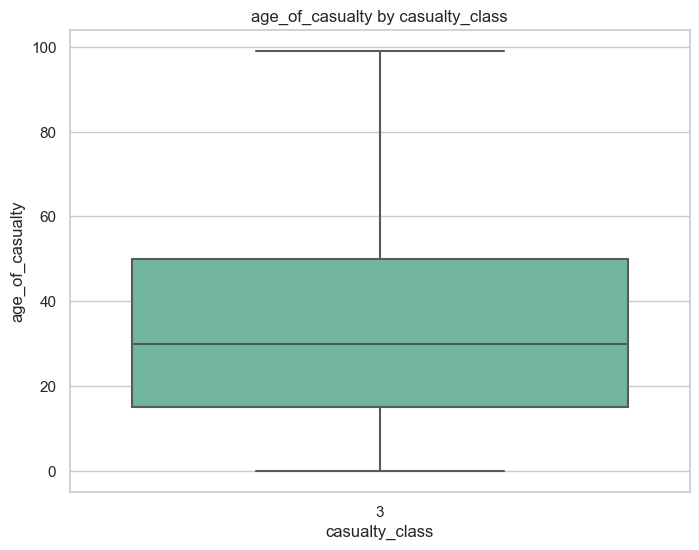

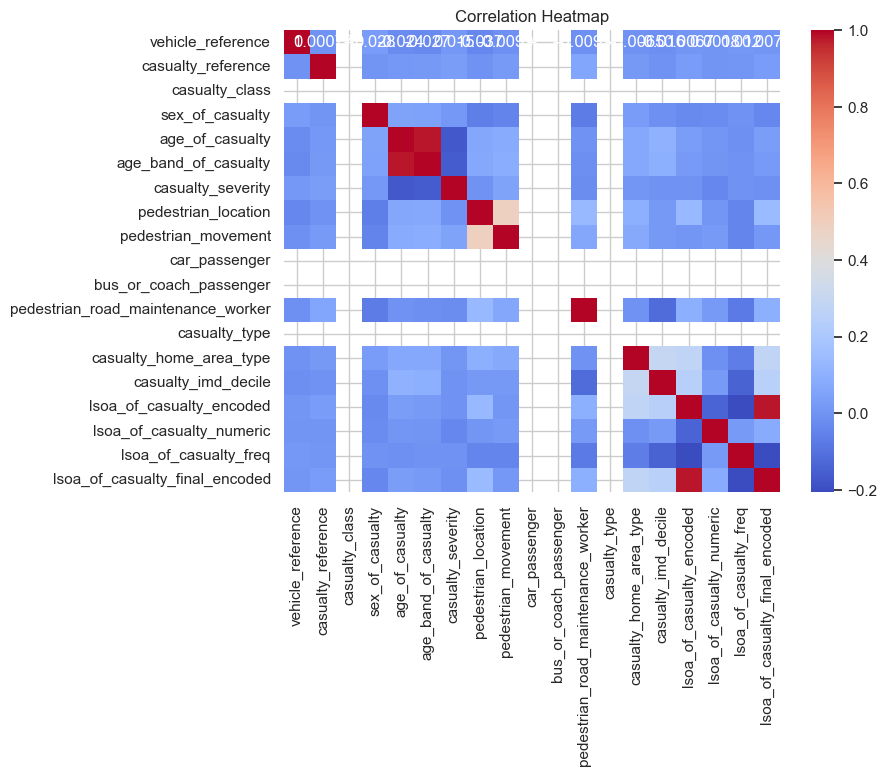

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
Plotting for Labeled DataFrame: df_drivers_top_1500_labeled


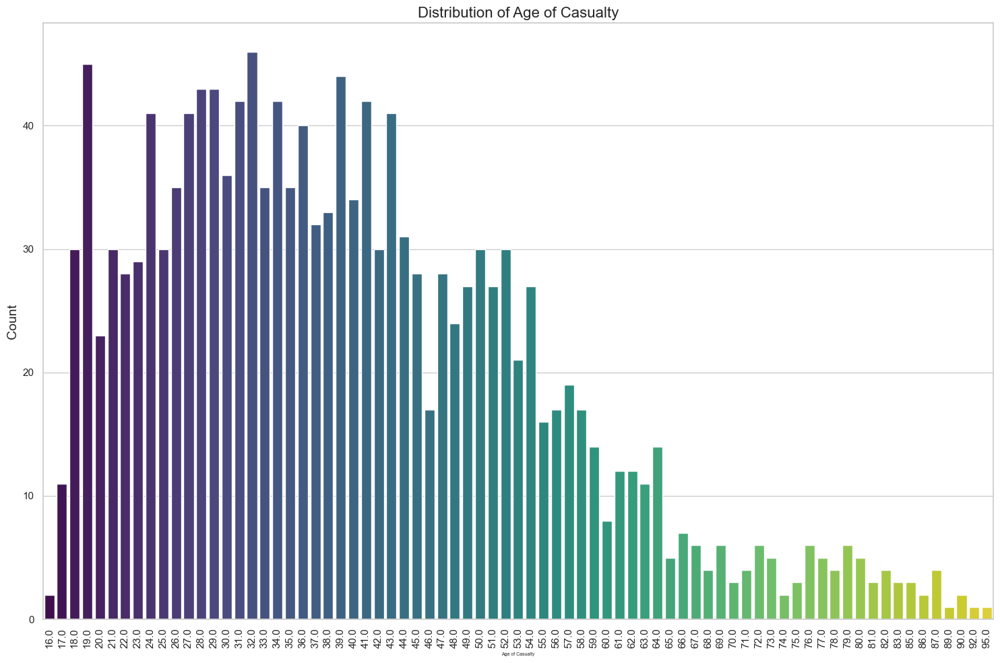

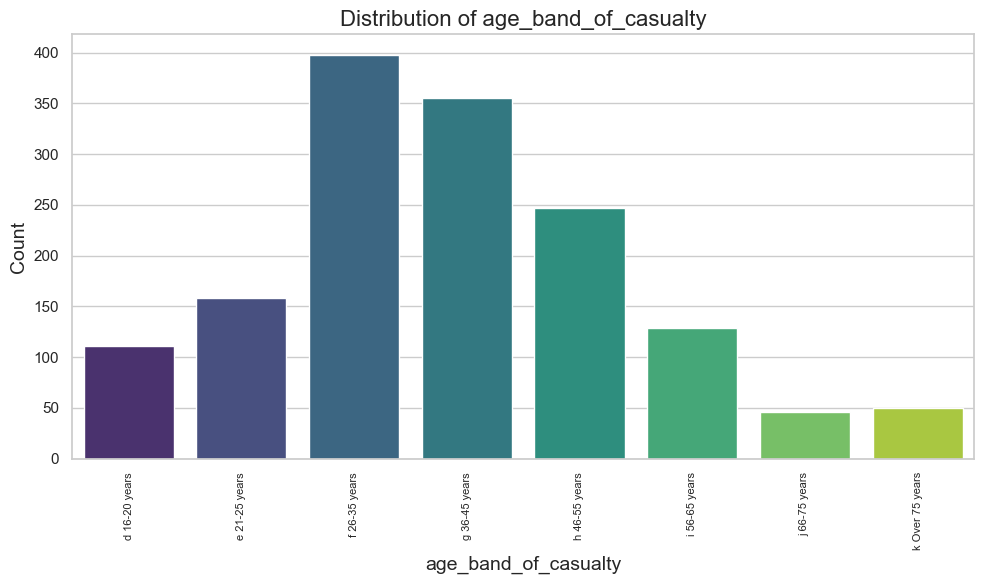

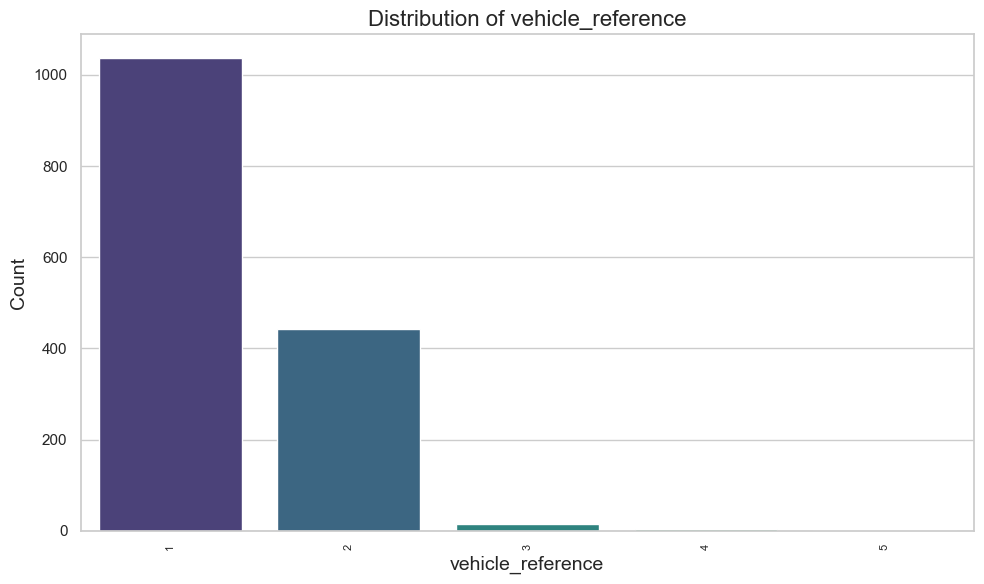

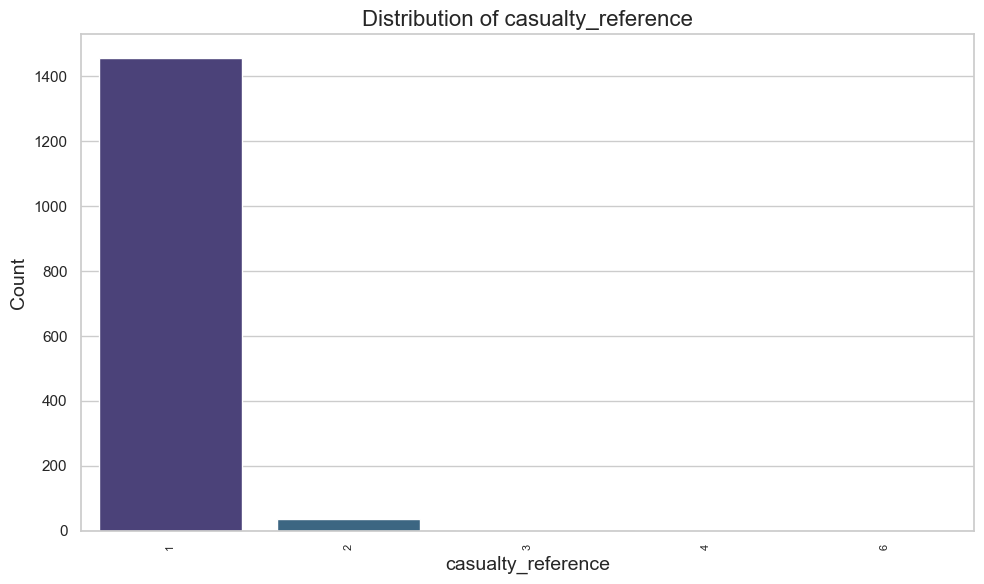

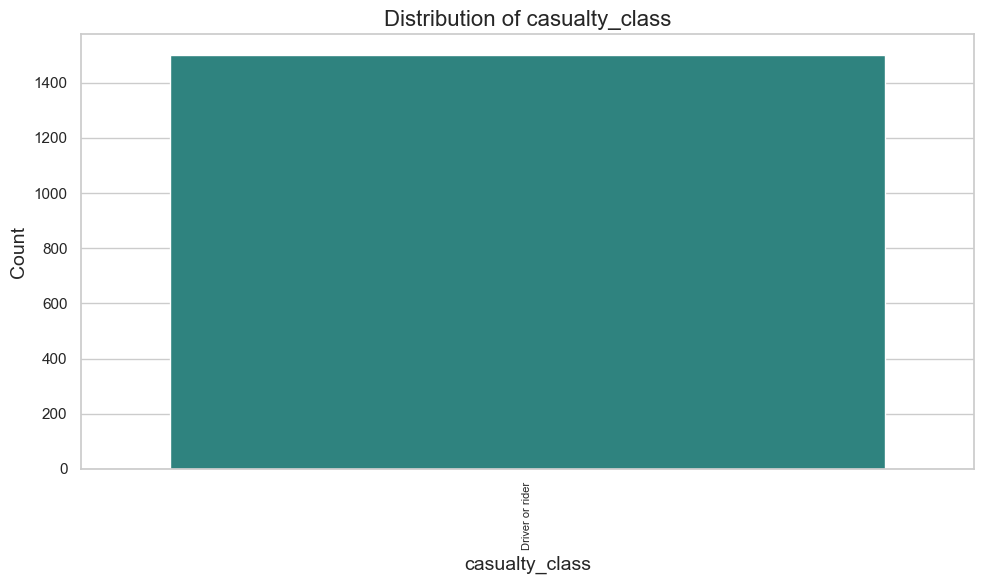

...

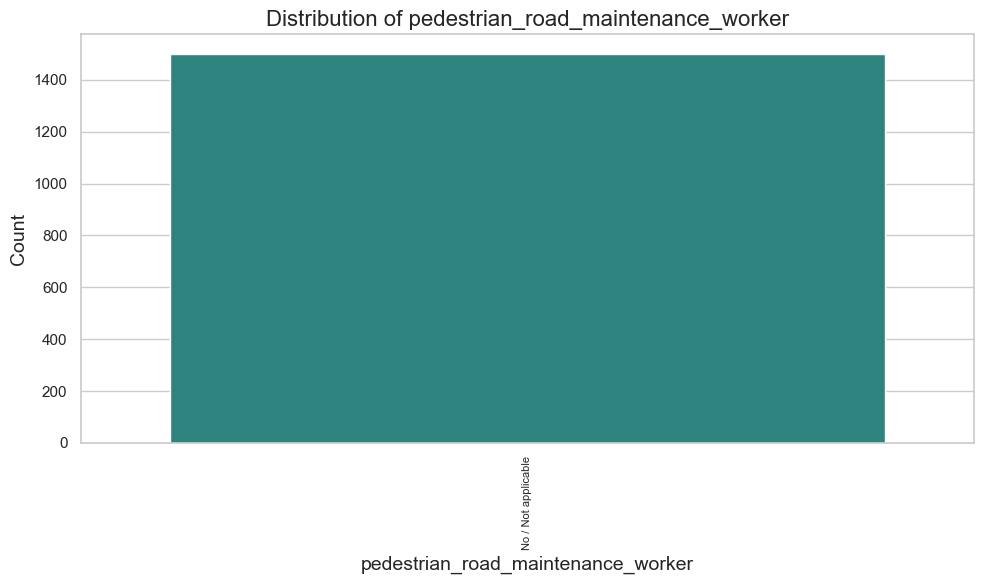

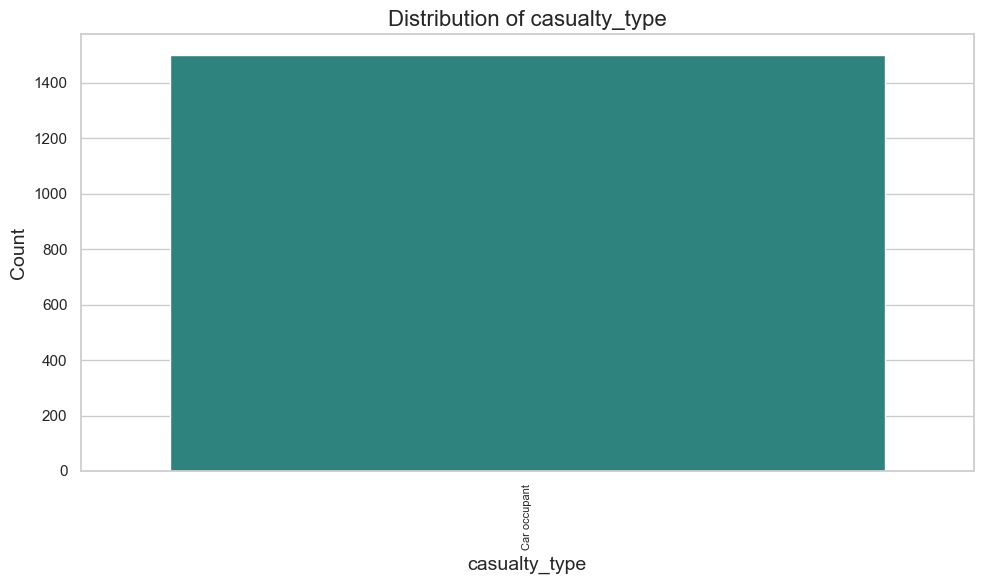

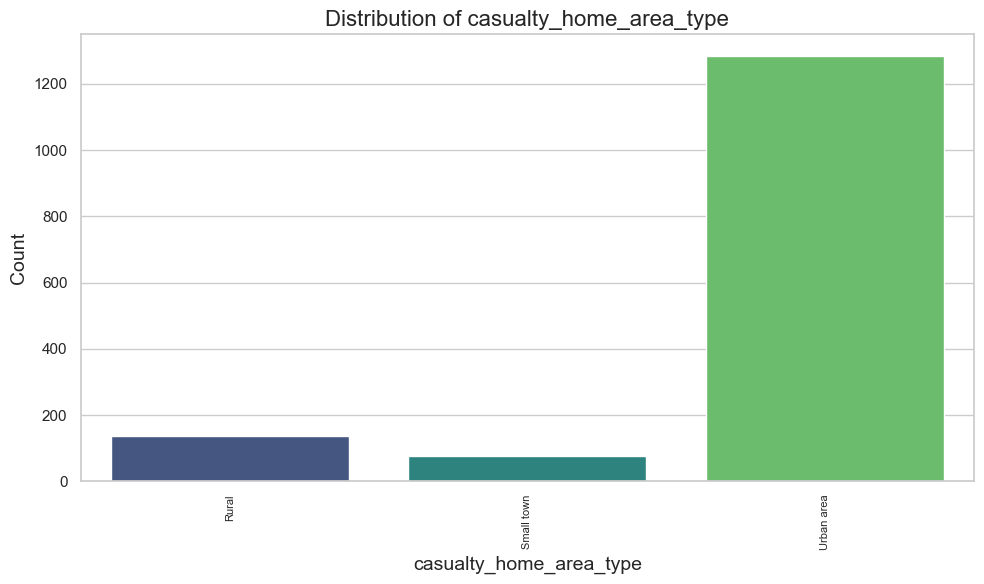

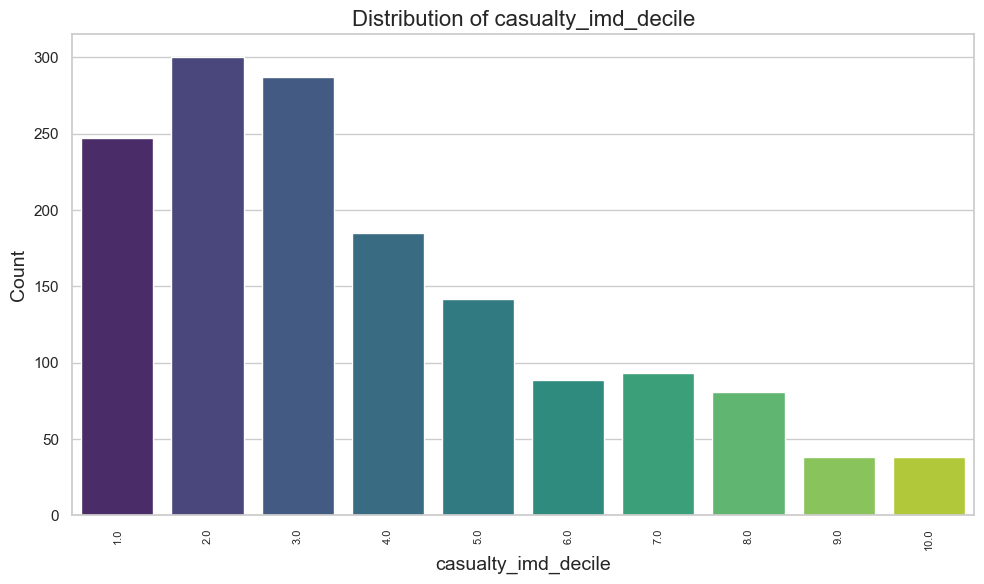

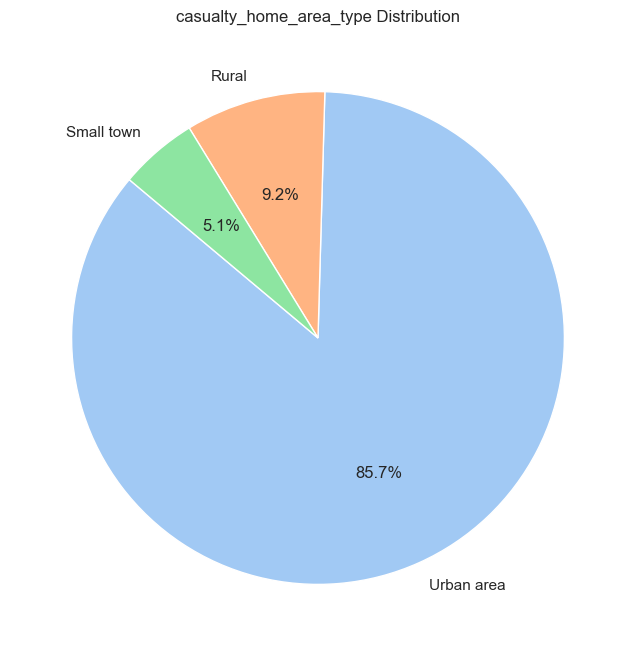

Plotting for Original DataFrame: df_drivers_top_1500


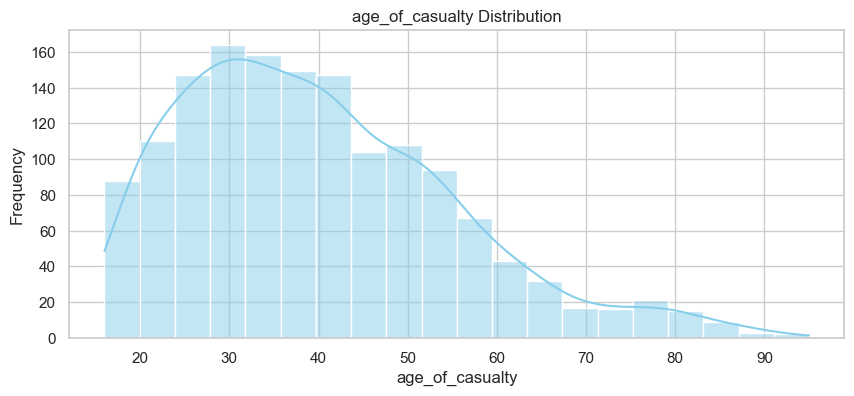

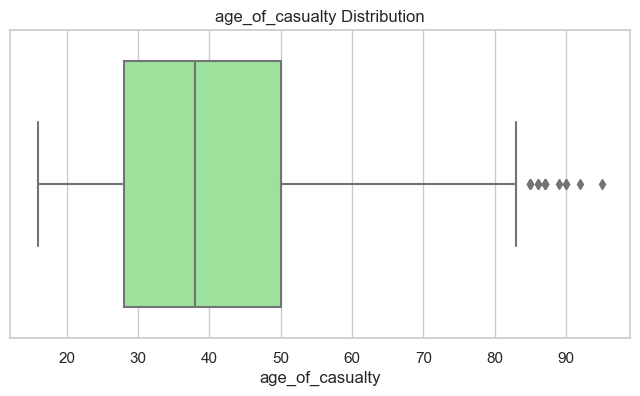

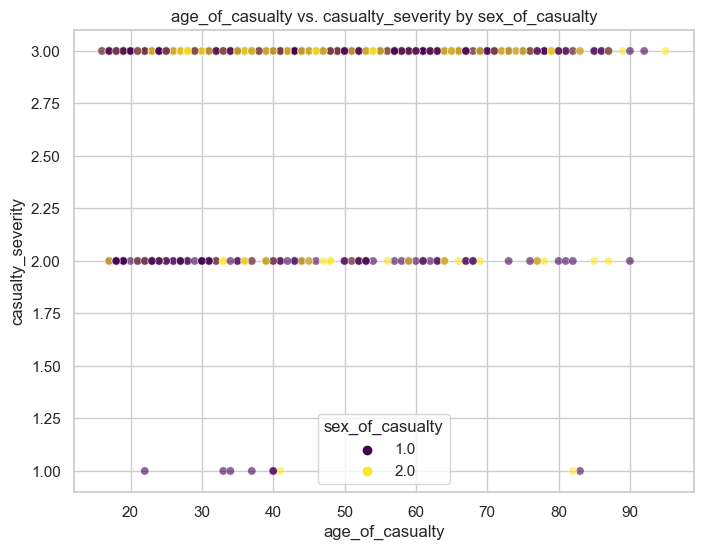

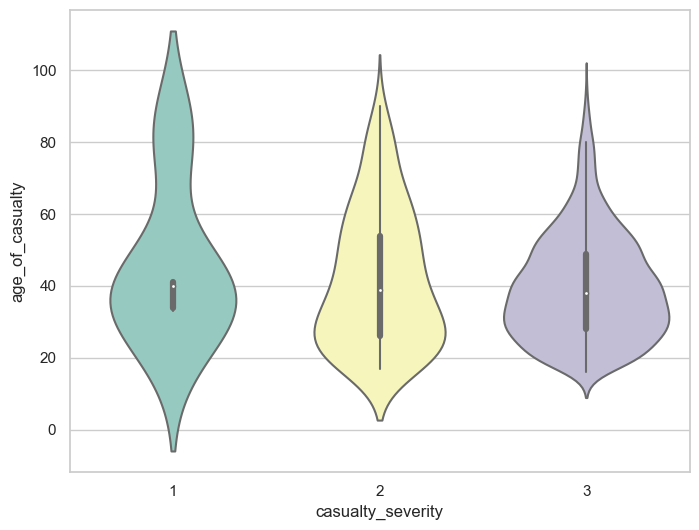

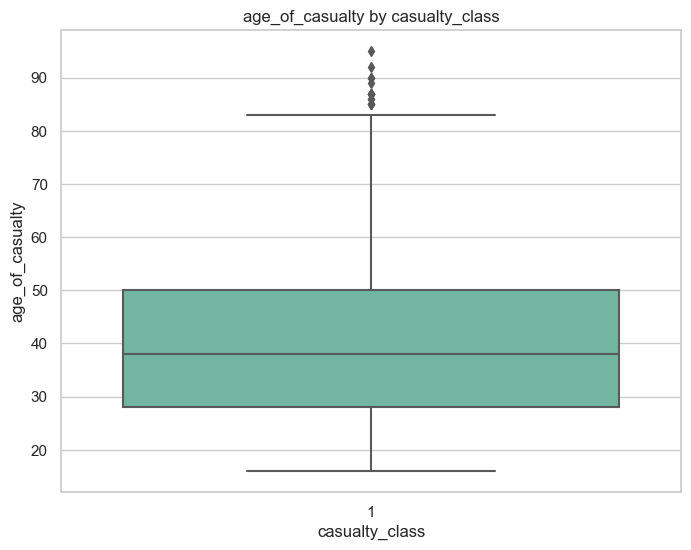

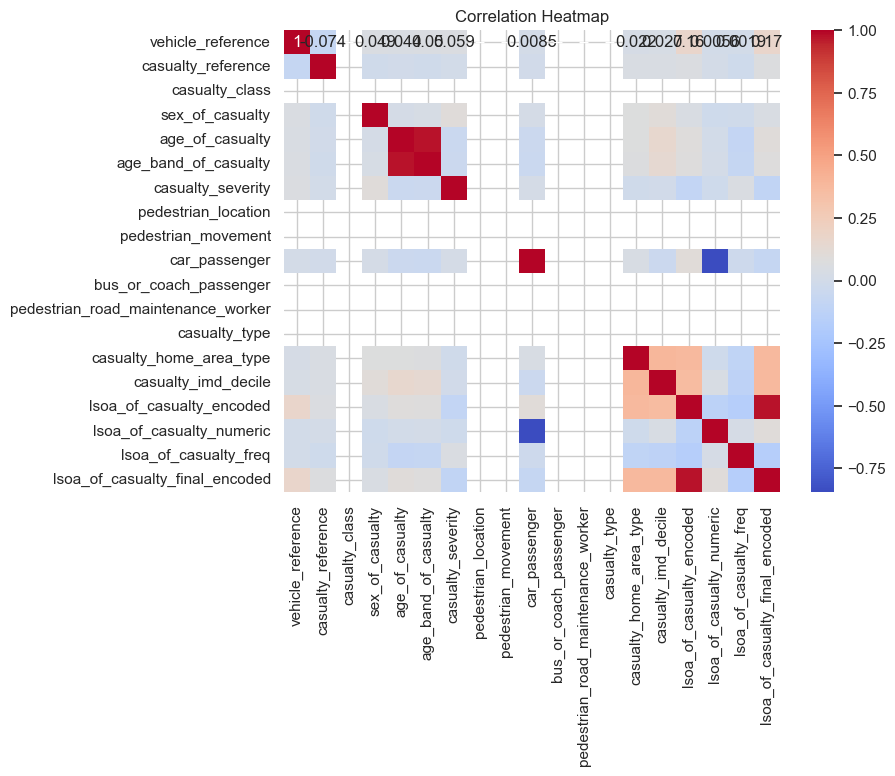

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
Plotting for Labeled DataFrame: df_motorcycles_top_1500_labeled


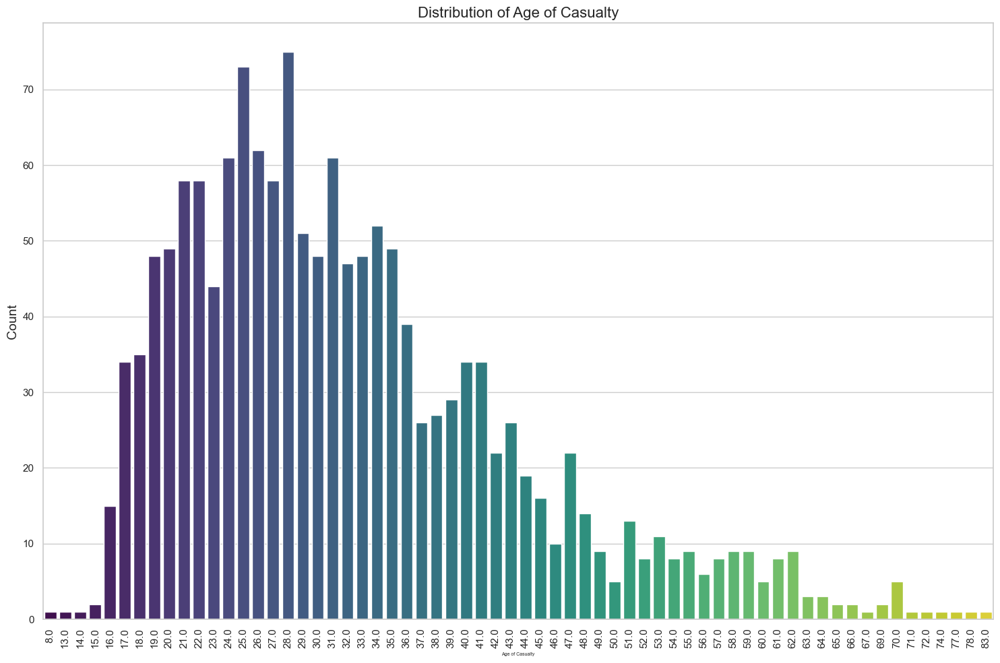

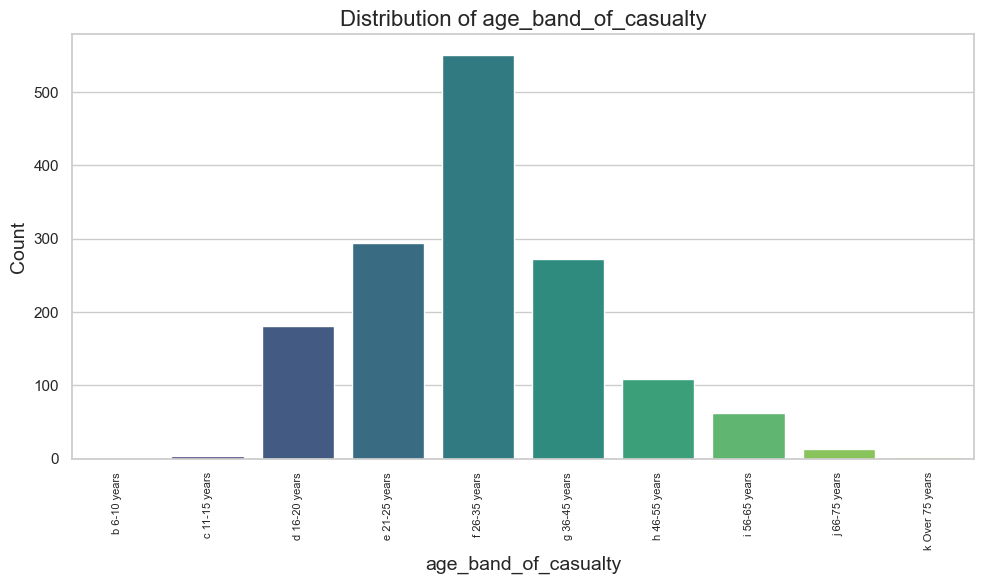

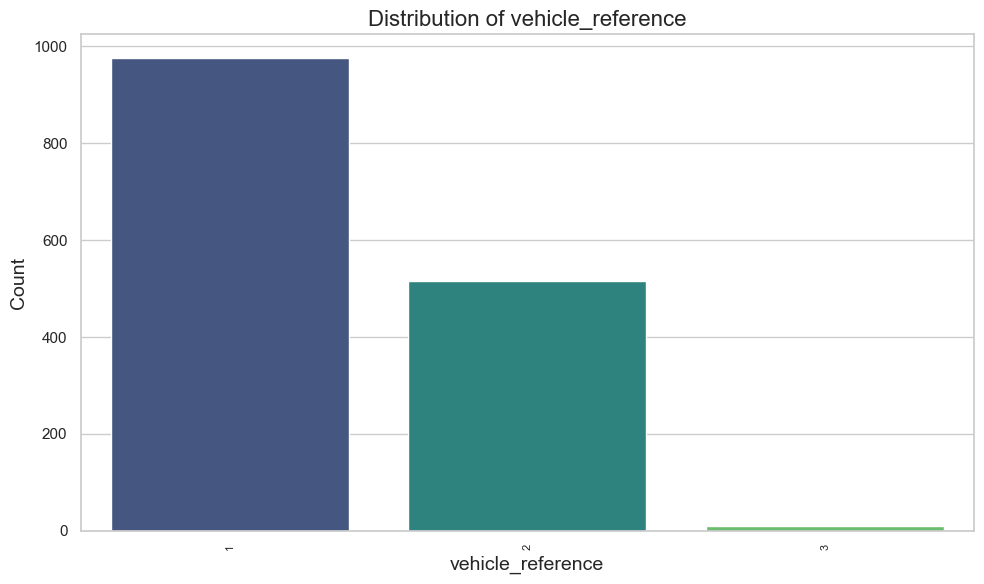

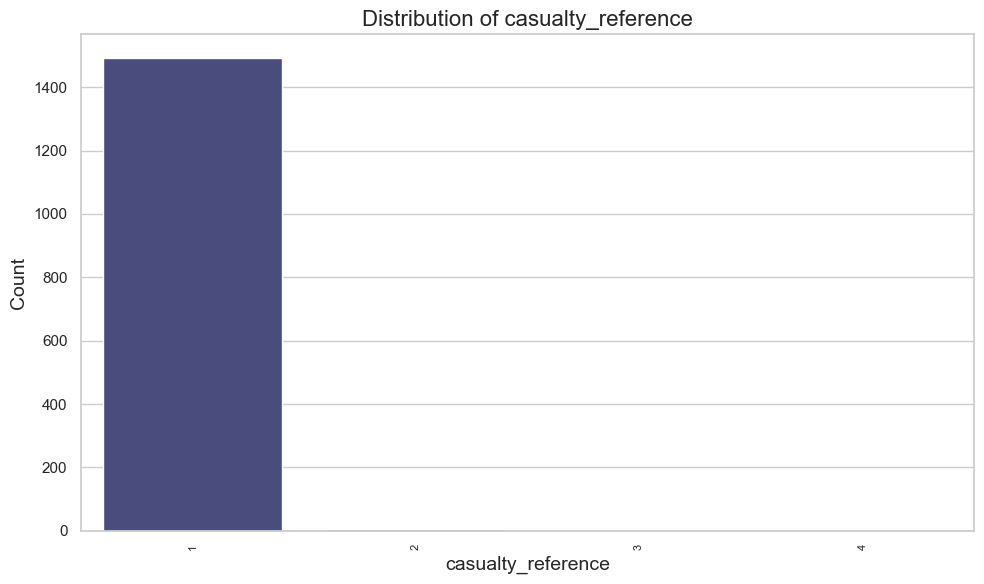

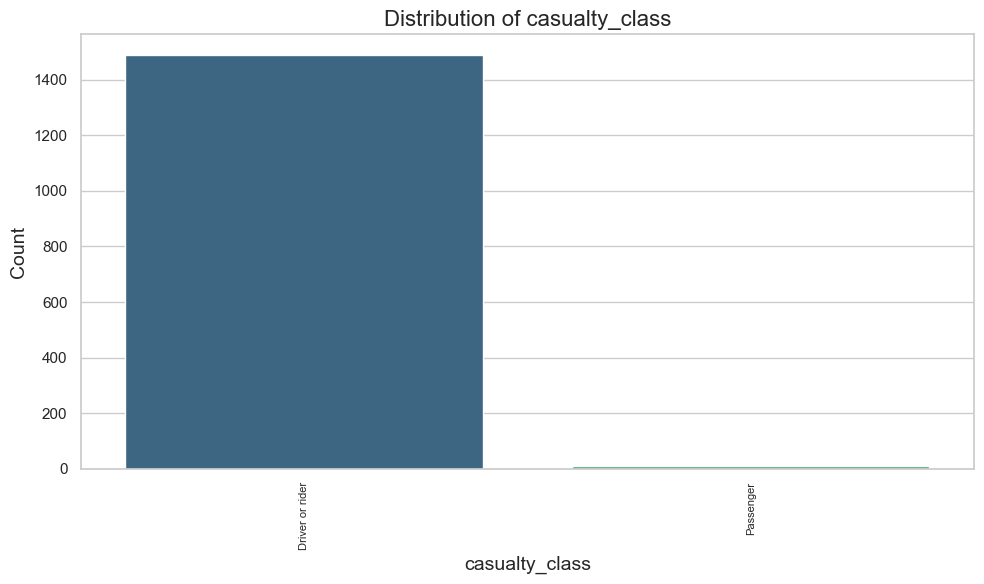

...

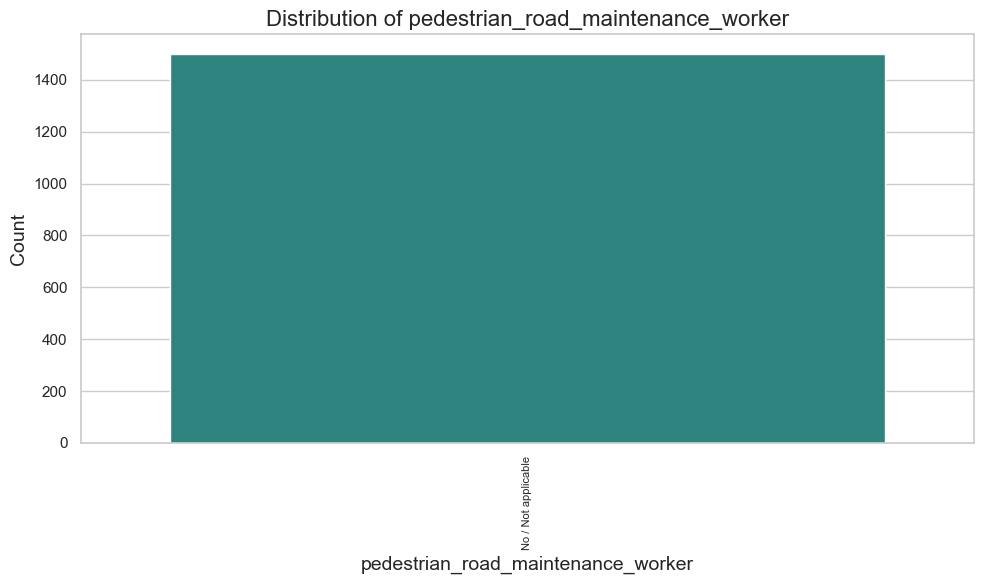

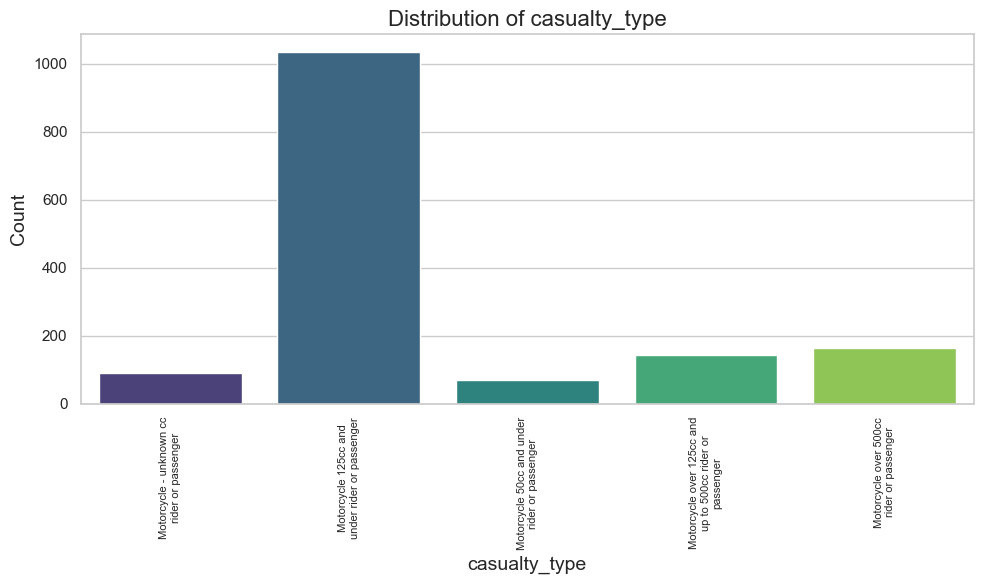

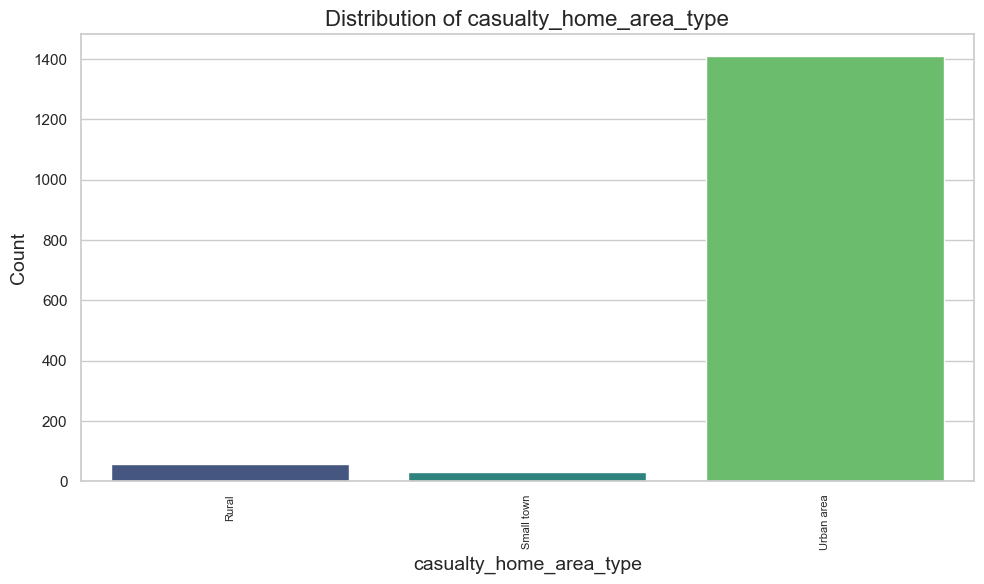

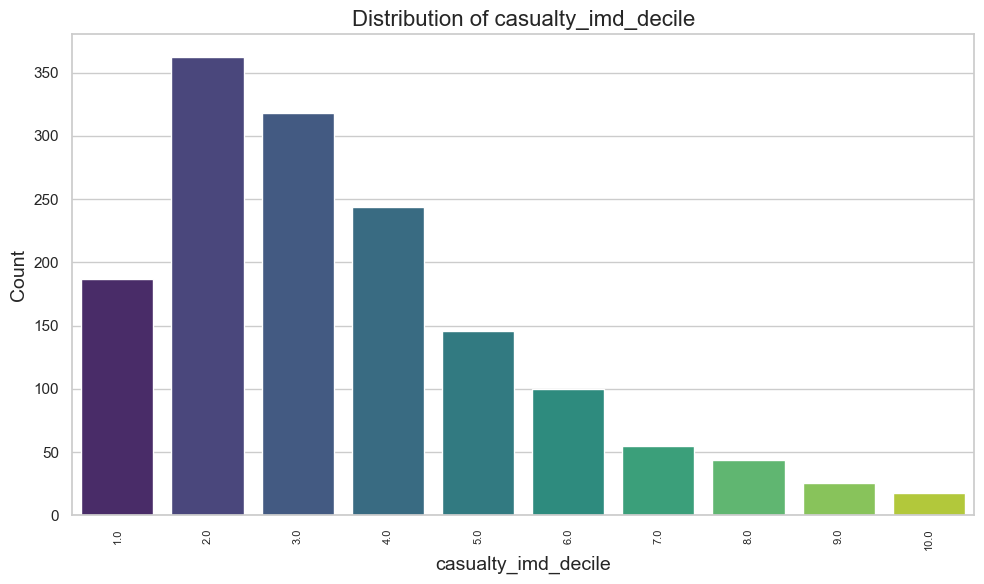

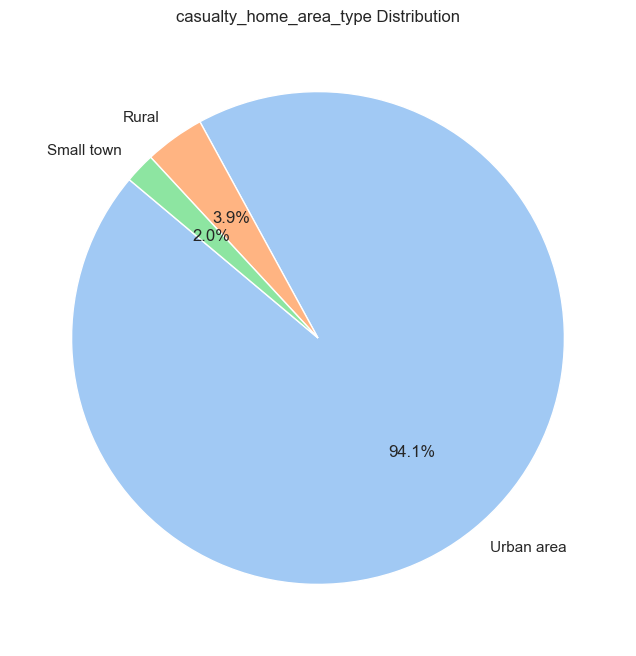

Plotting for Original DataFrame: df_motorcycles_top_1500


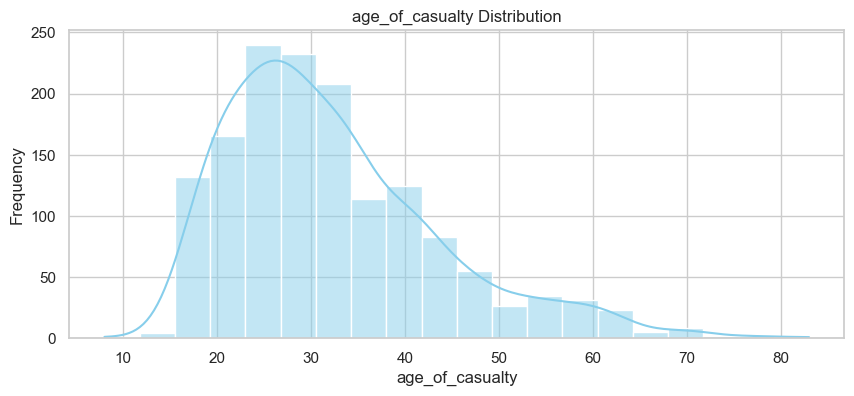

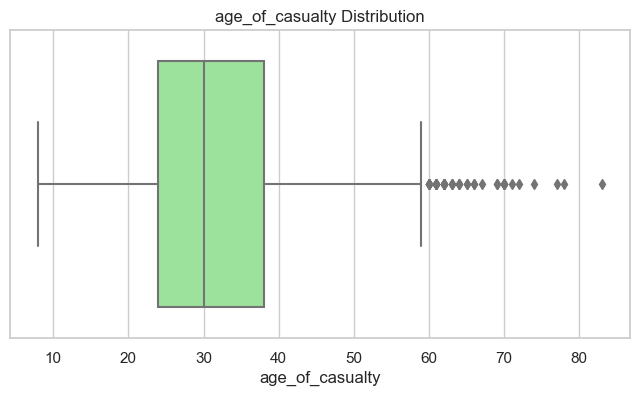

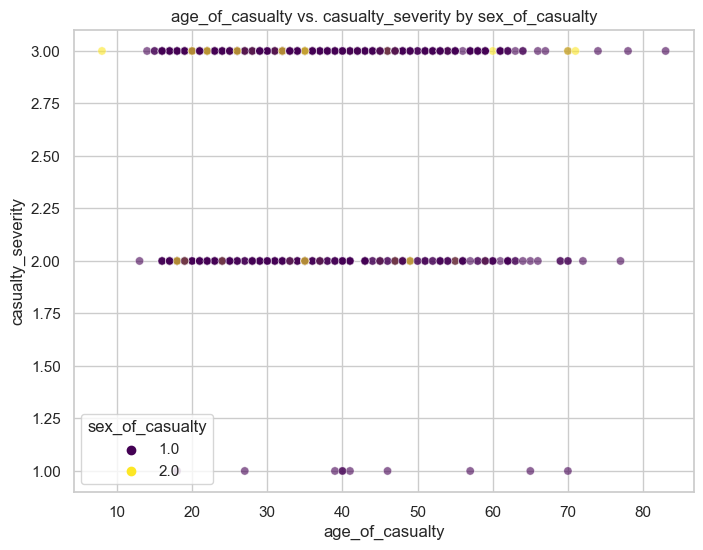

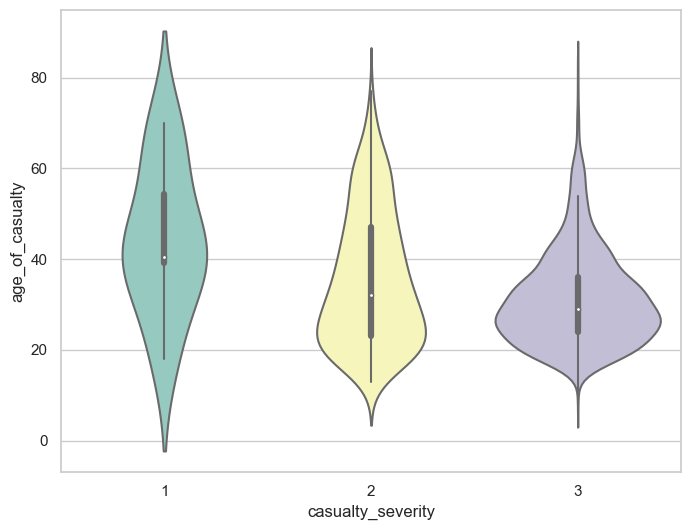

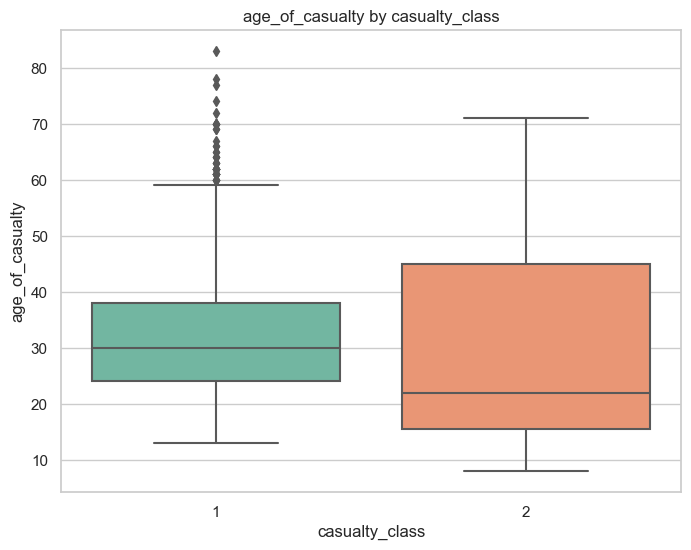

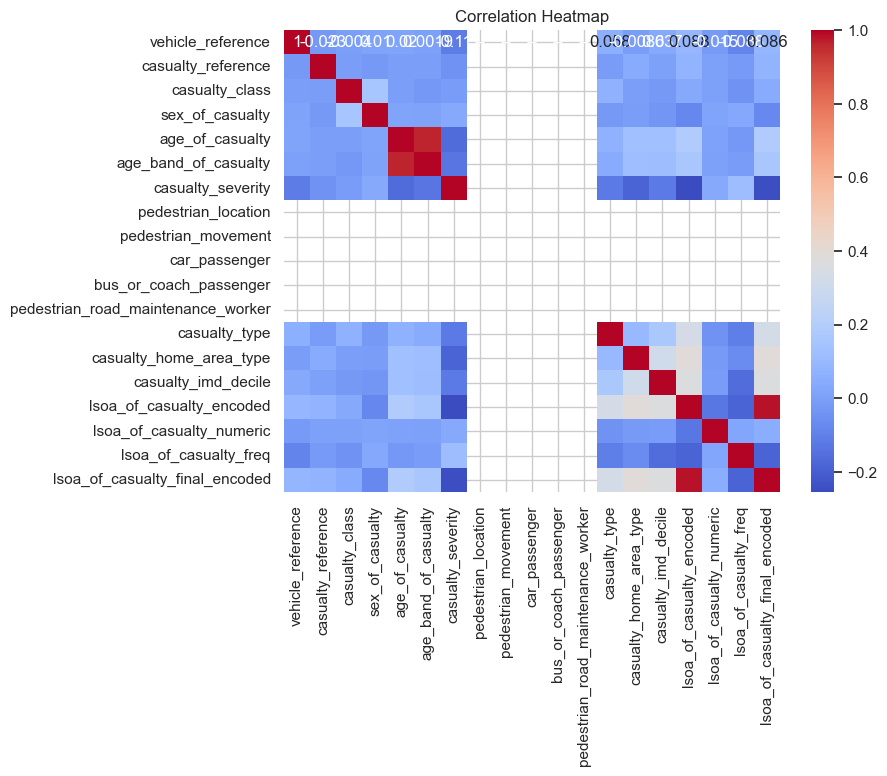

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
Plotting for Labeled DataFrame: df_cyclist_top_1500_labeled


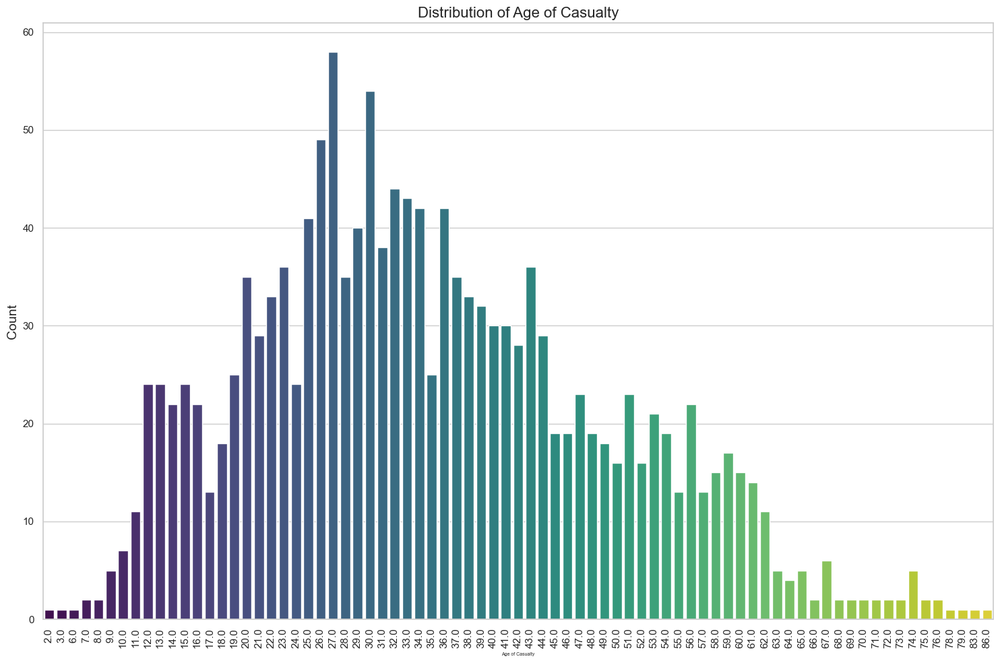

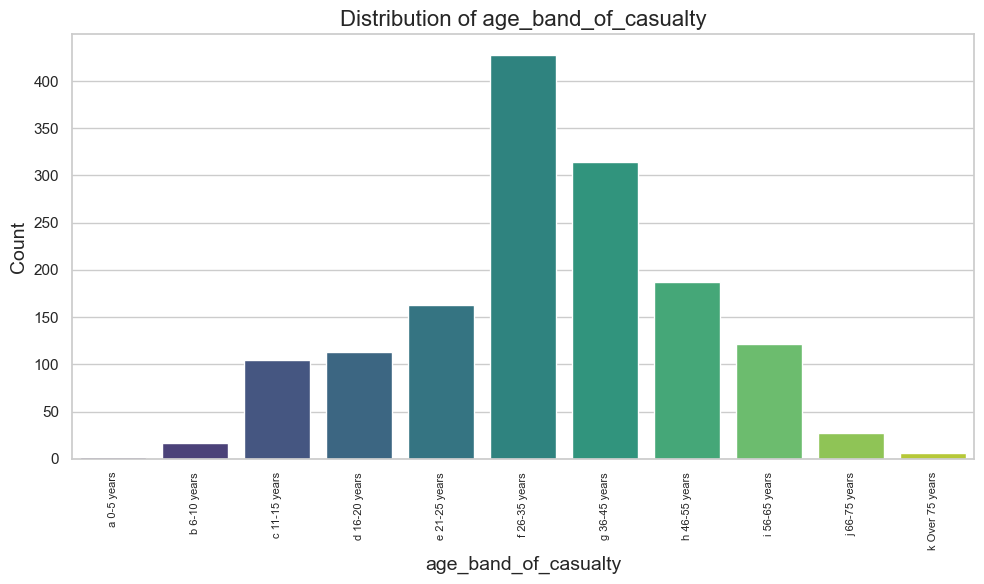

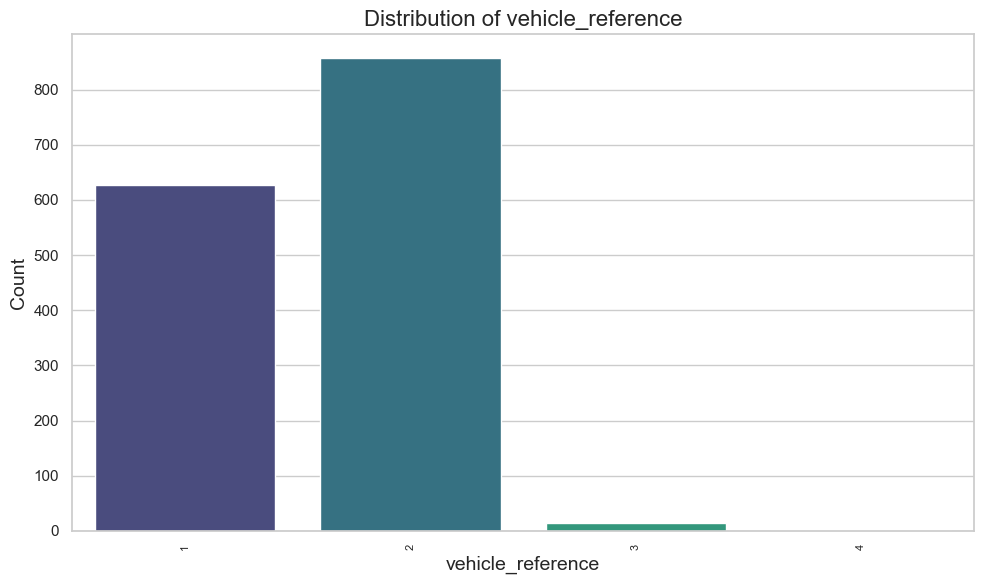

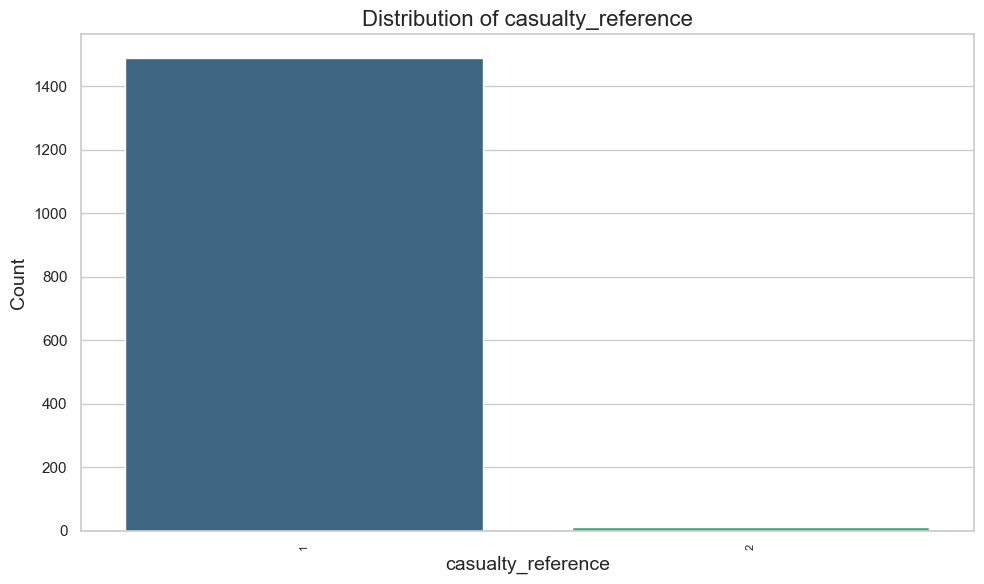

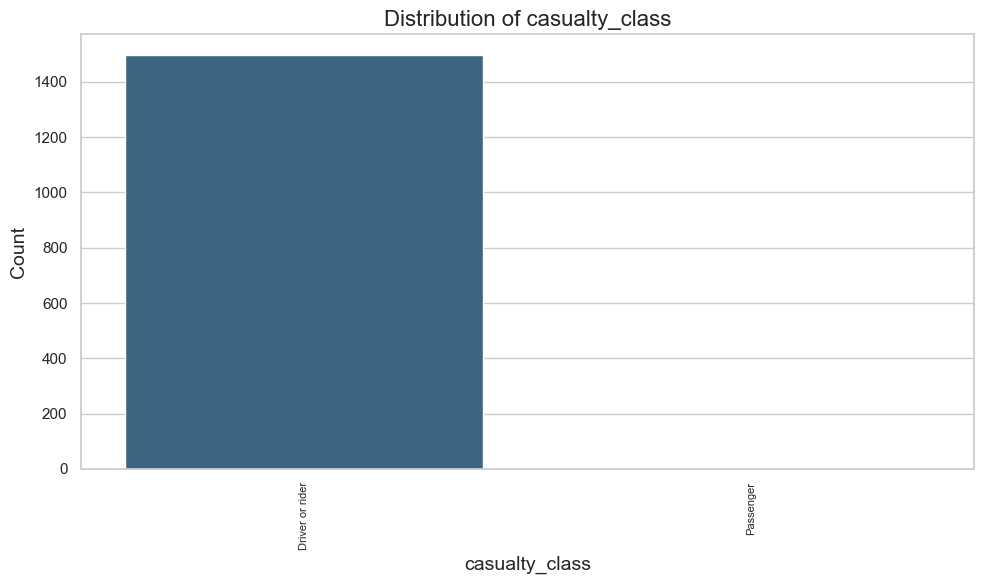

...

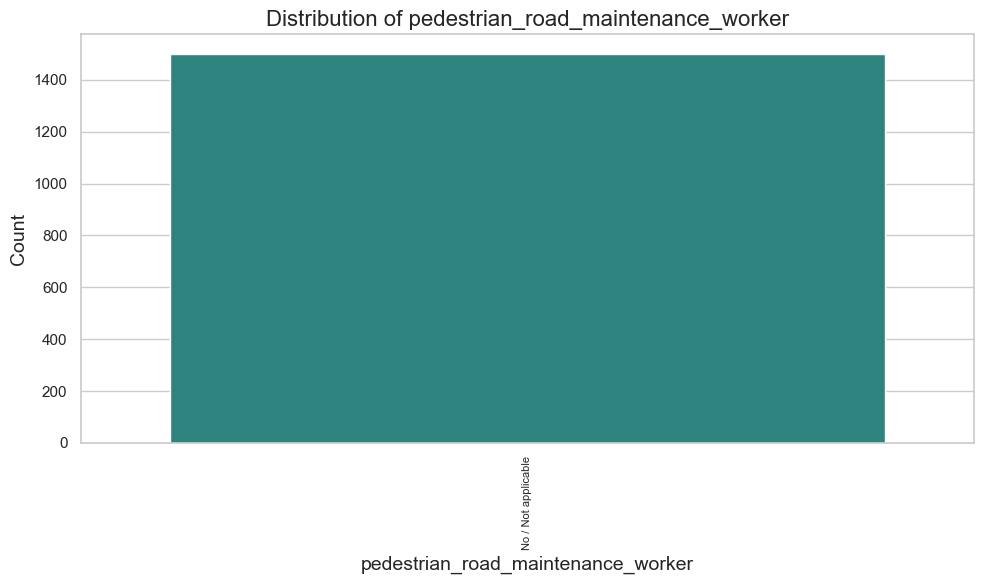

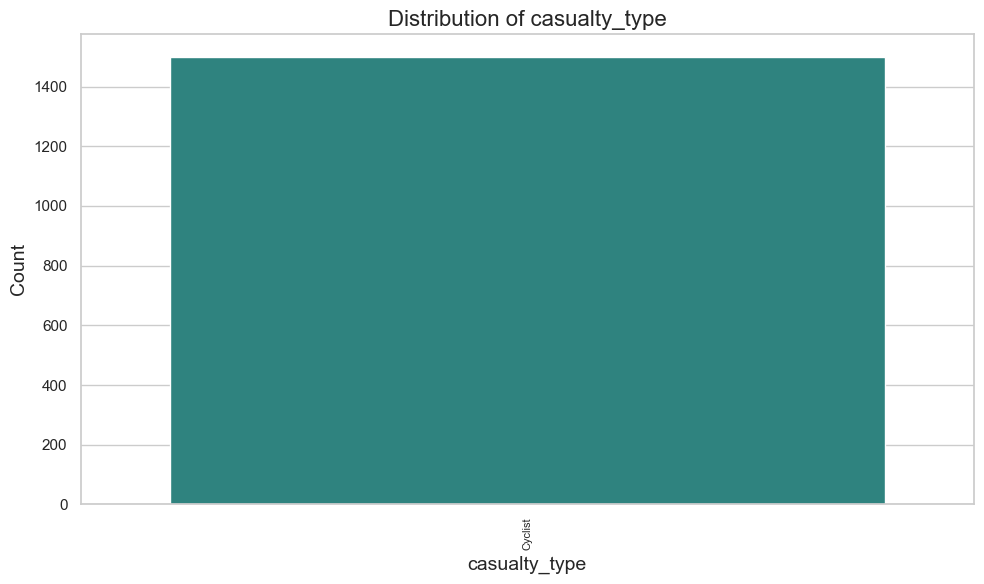

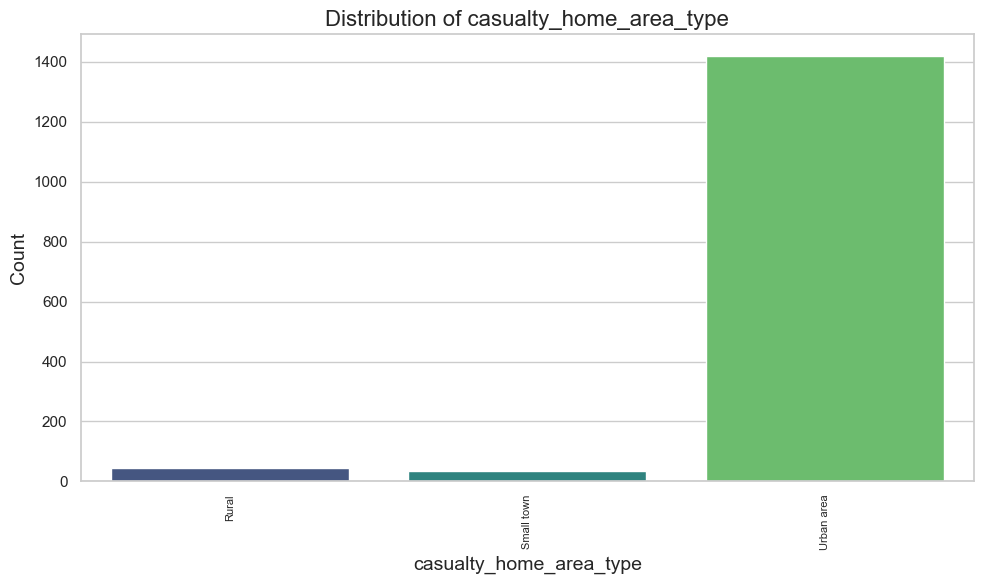

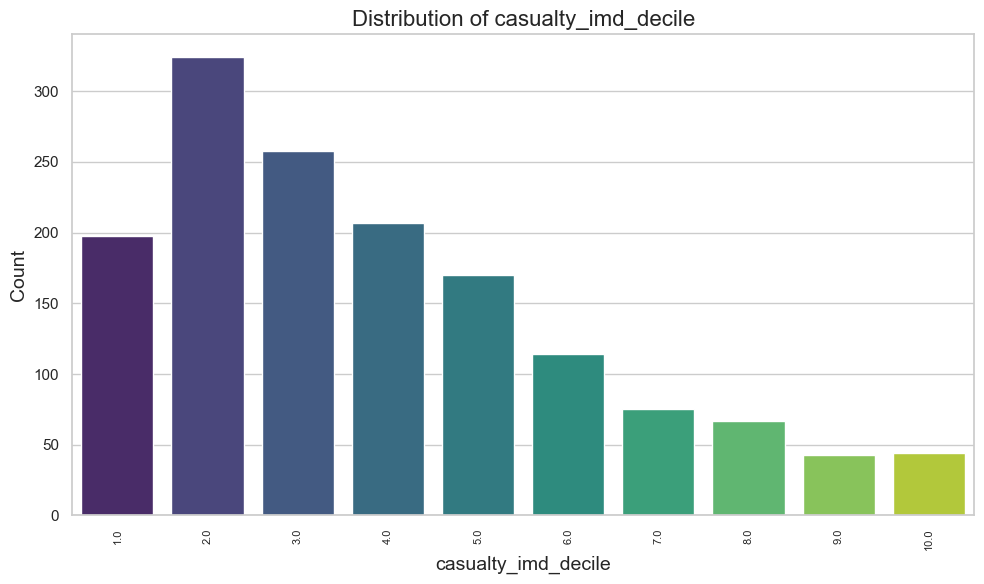

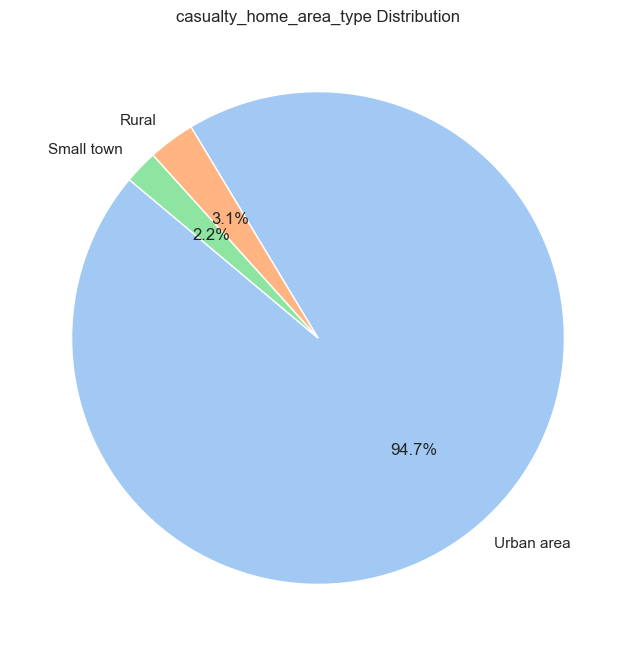

Plotting for Original DataFrame: df_cyclist_top_1500


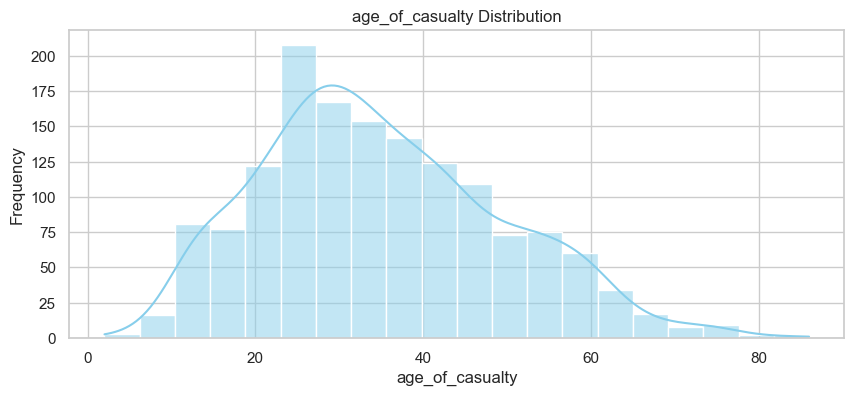

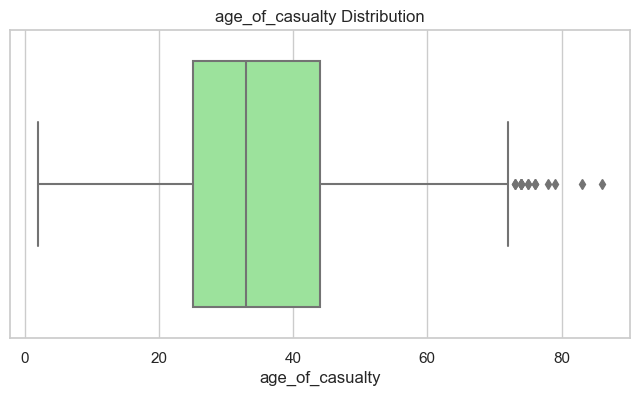

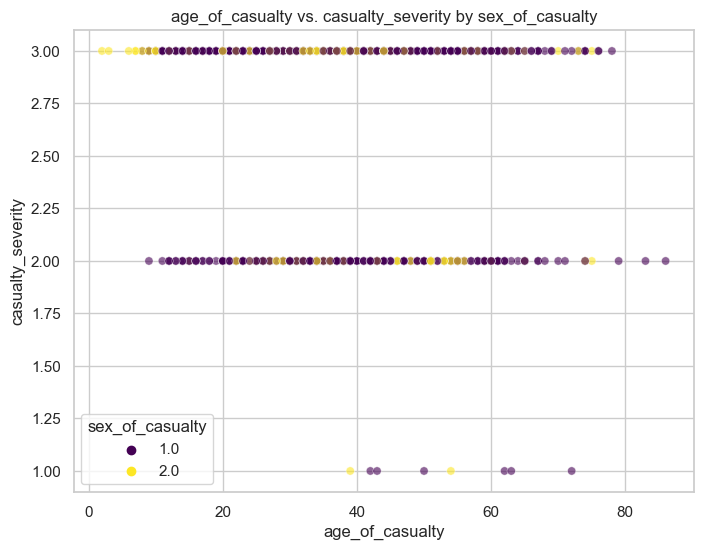

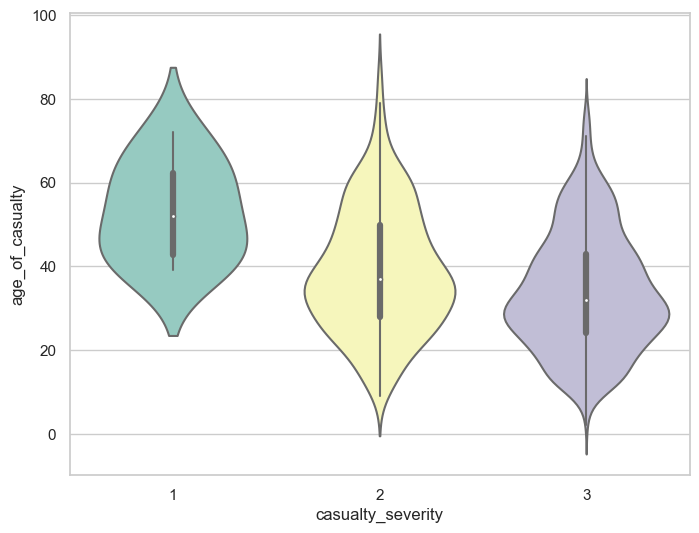

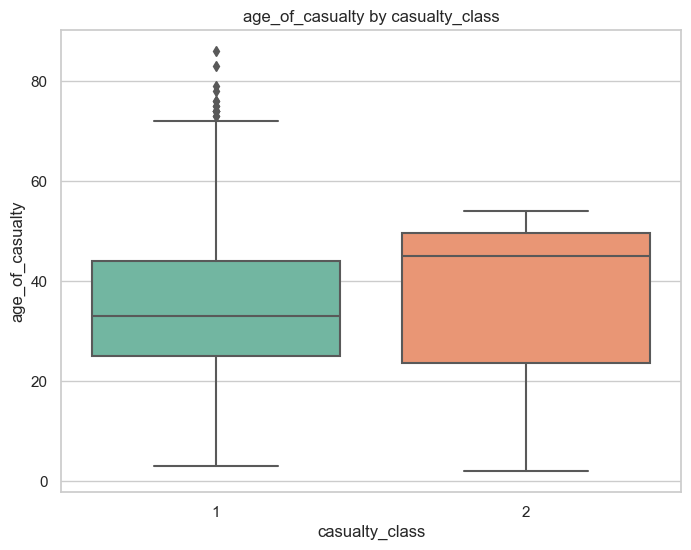

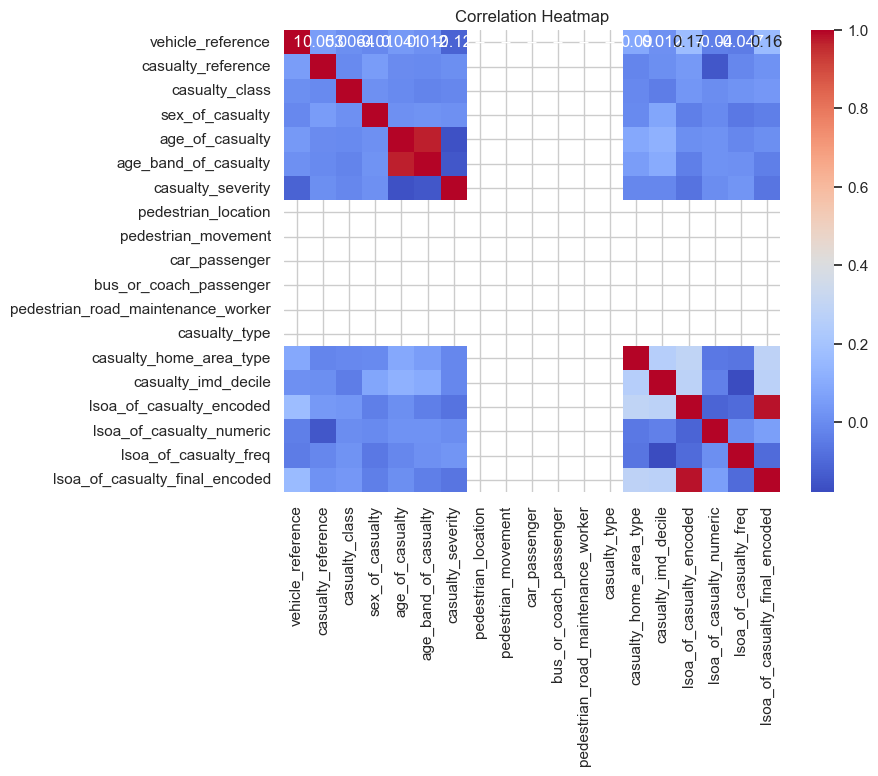

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
Plotting for Labeled DataFrame: df_passengers_top_1500_labeled


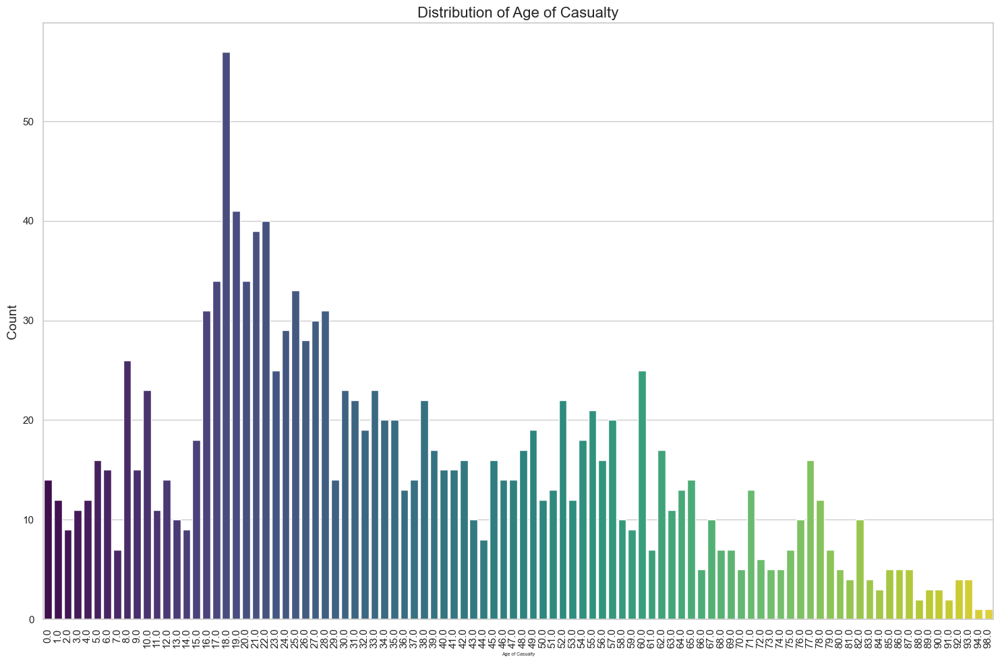

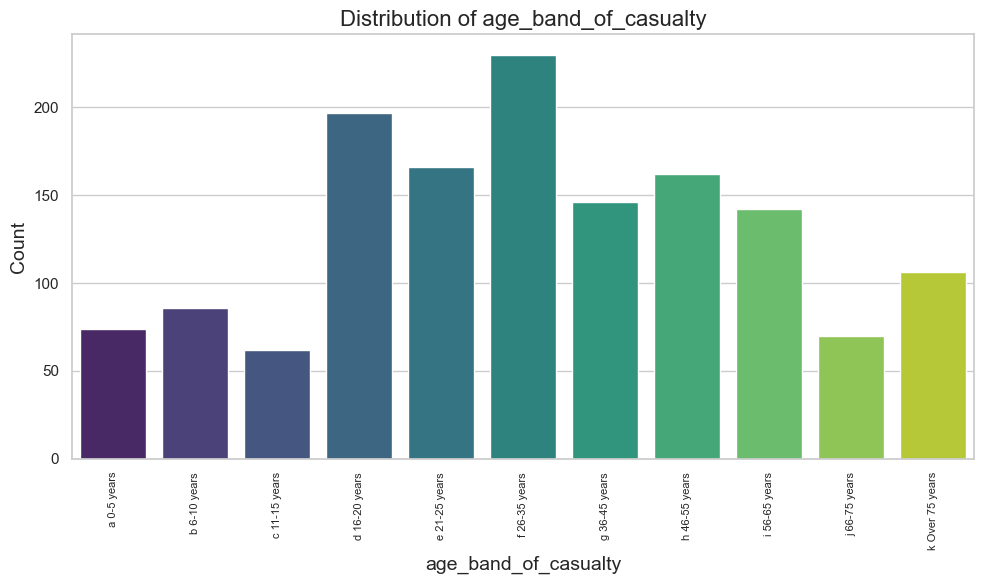

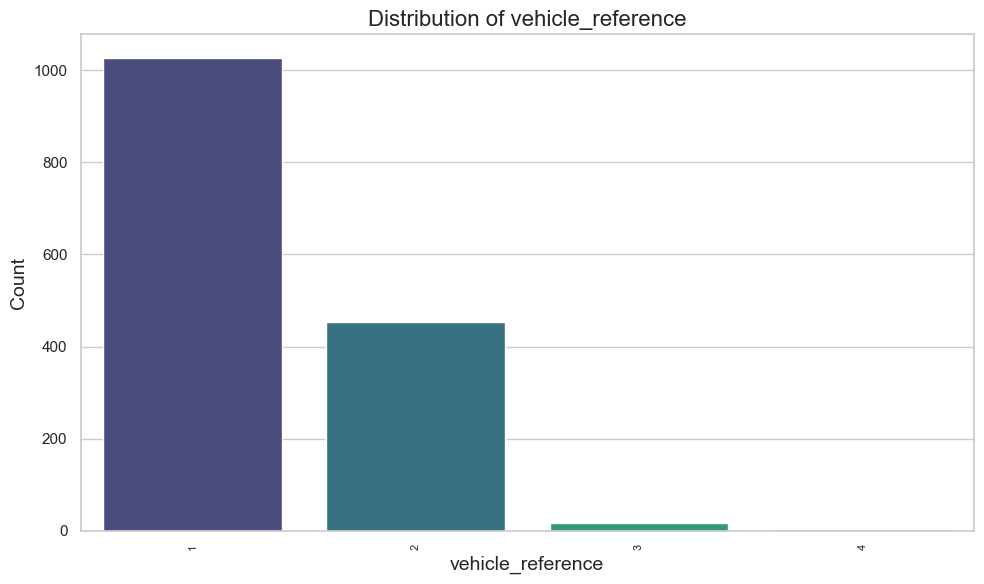

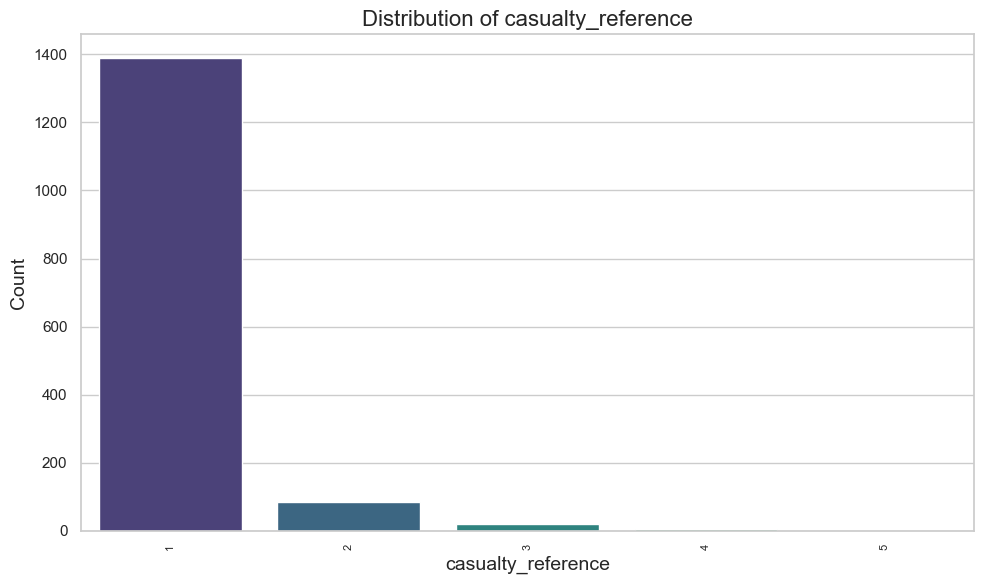

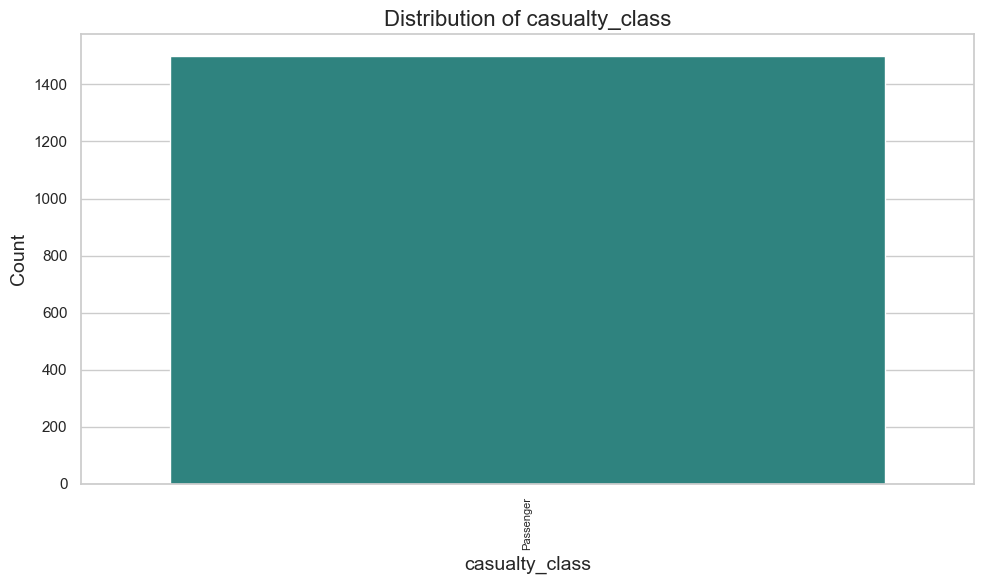

...

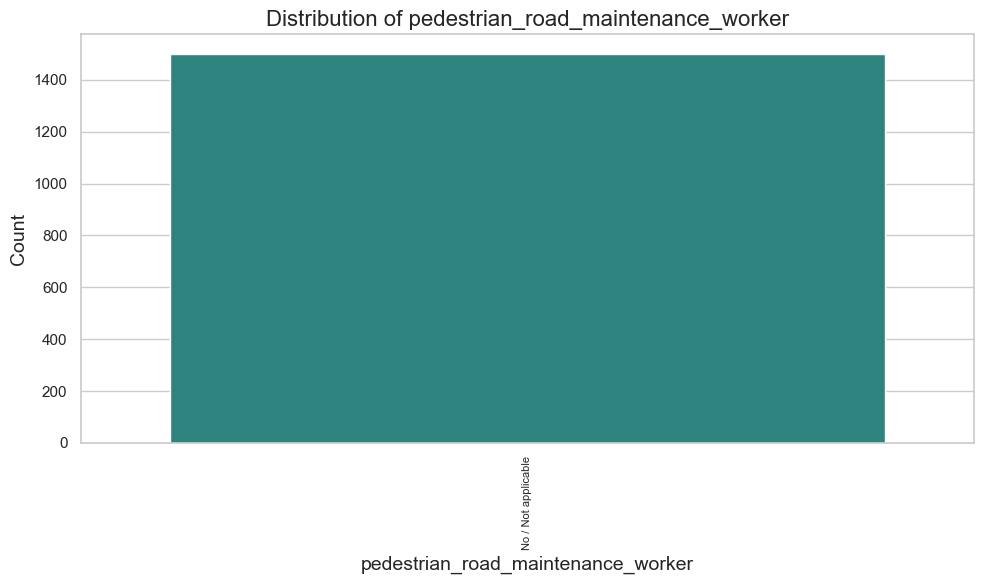

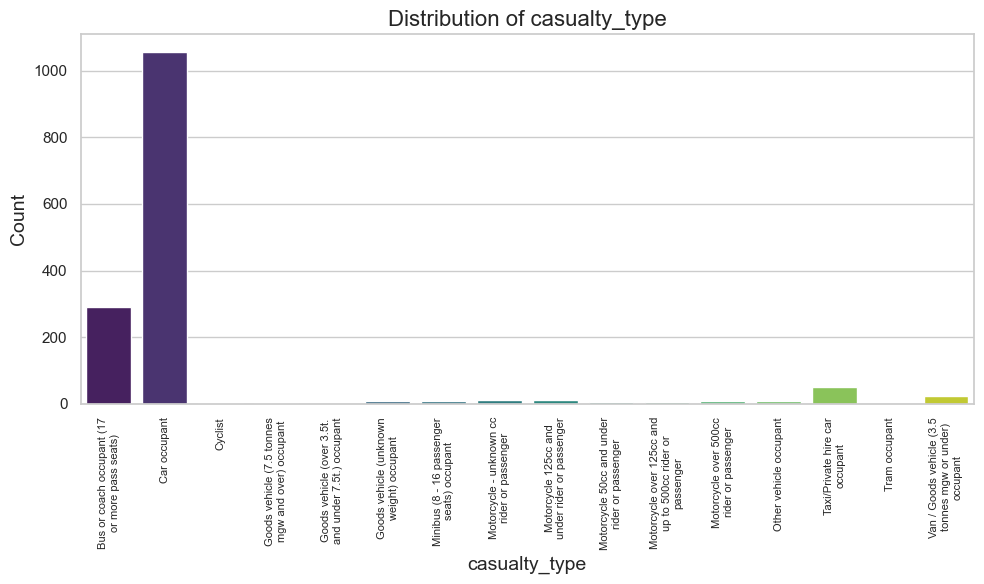

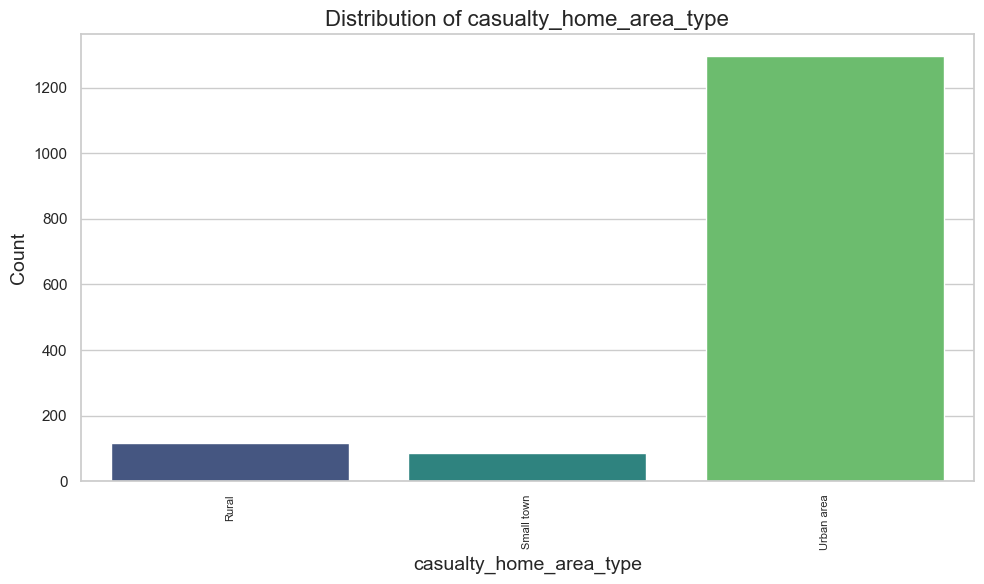

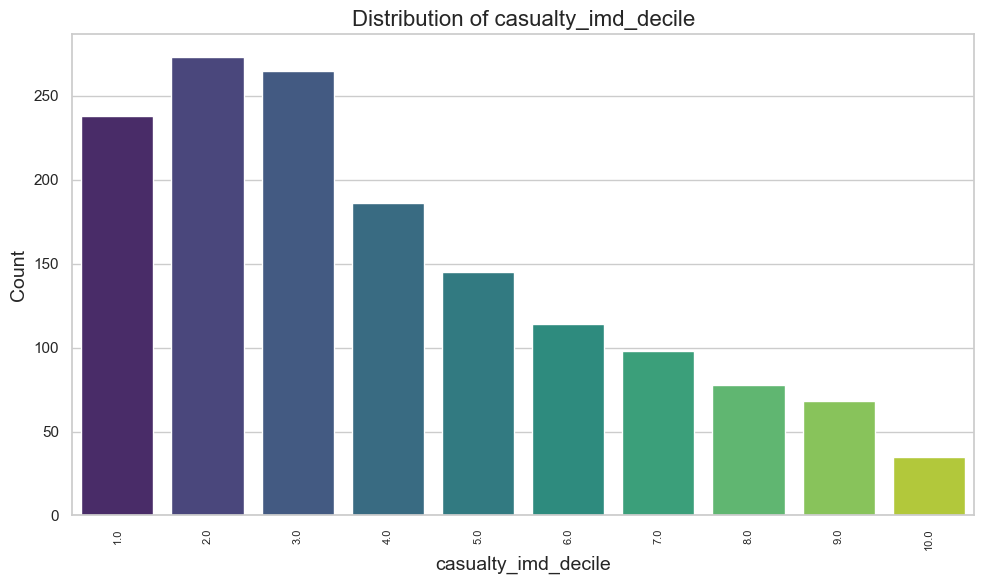

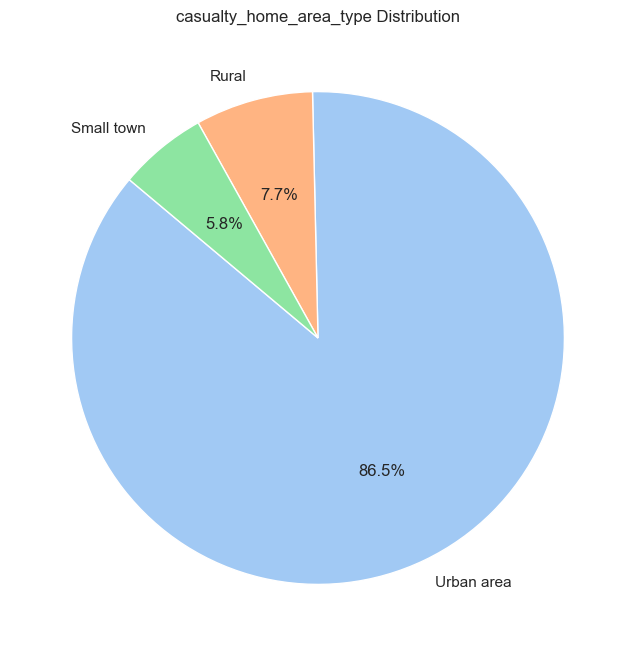

Plotting for Original DataFrame: df_passengers_top_1500


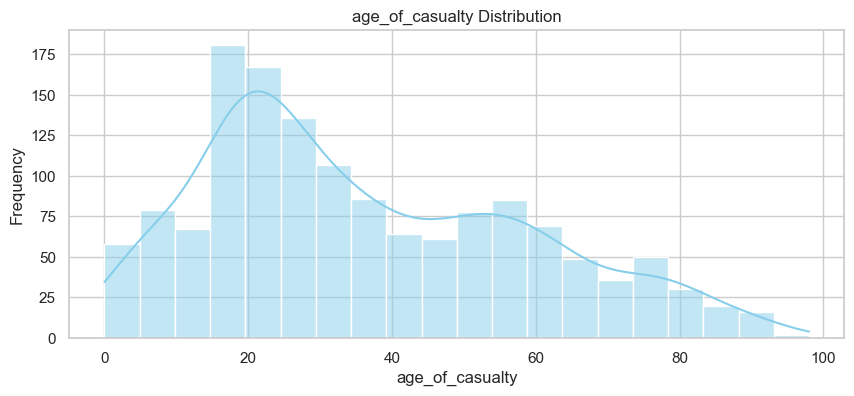

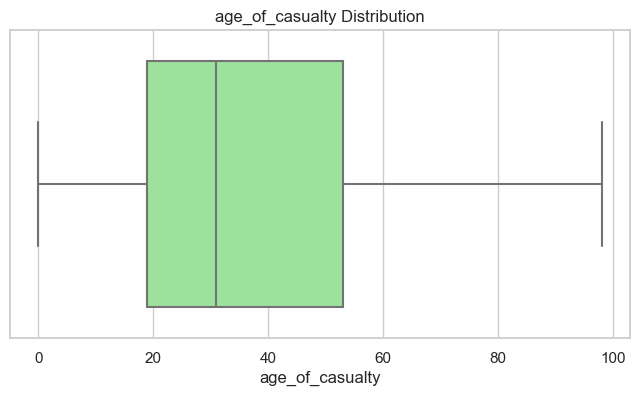

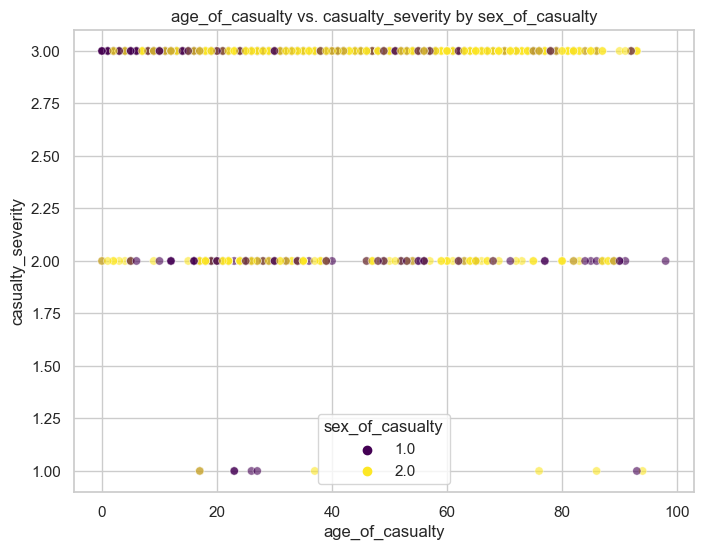

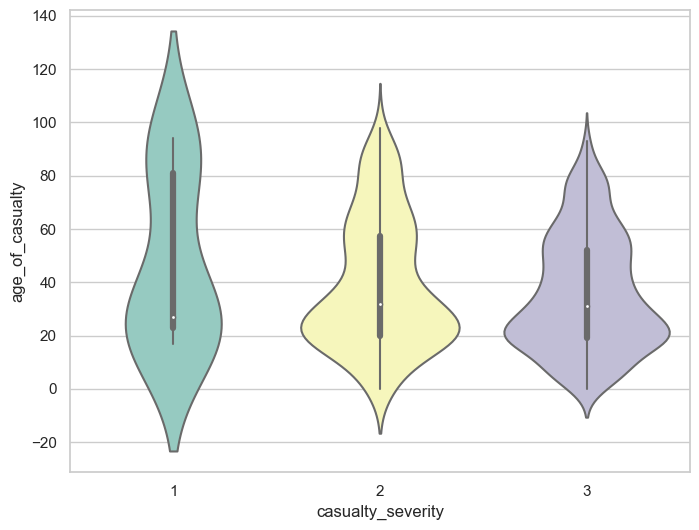

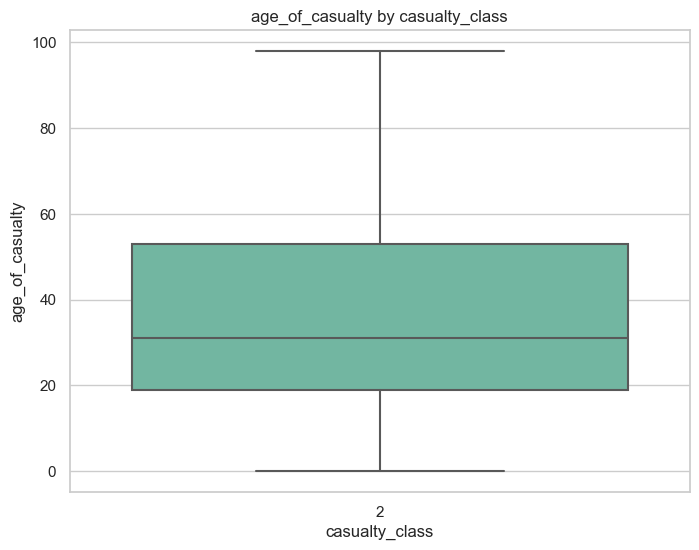

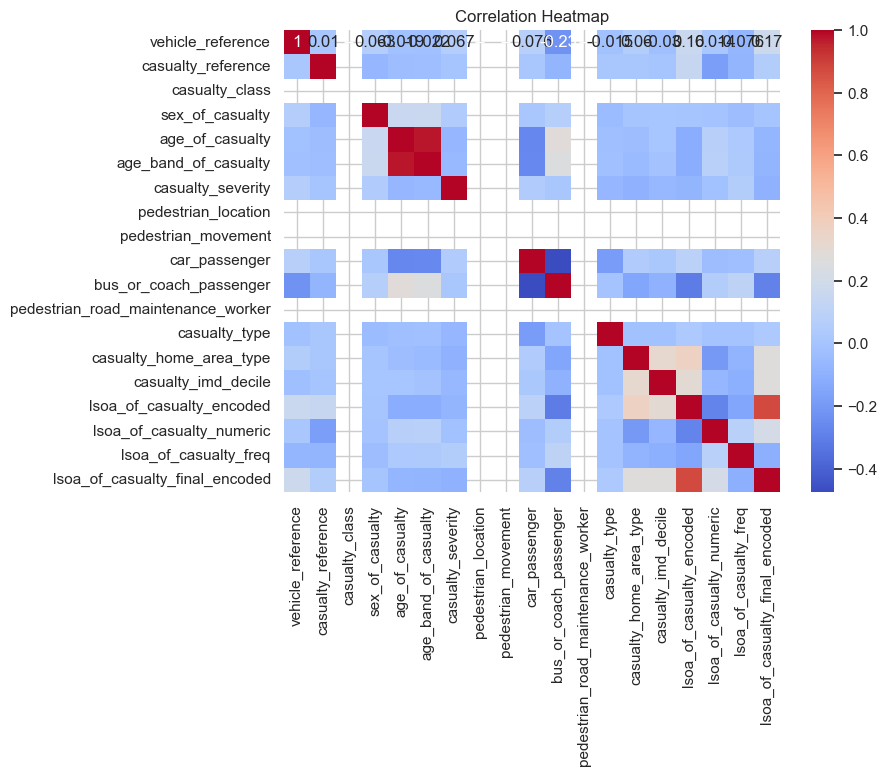

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


In [306]:
#plot all plots of dataframes together
plot_all_dataframes(dataframes)

## **Top Casualty Frequency Areas by Category**

### **Function**

In [358]:
def change_first_letter(lst):
    """
    Takes a list of strings and changes the first letter of each element.
    If the first letter is '1', it changes it to 'W'.
    If the first letter is '2', it changes it to 'E'.
    Returns the modified list.
    """
    # Loop through each element in the list
    for i in range(len(lst)):
        # Check if the first character is '1' or '2' and replace accordingly
        if str(lst[i])[0] == '1':
            lst[i] = 'W' + str(lst[i])[1:]
        elif str(lst[i])[0] == '2':
            lst[i] = 'E' + str(lst[i])[1:]
    return lst


In [359]:
def remove_duplicates_ordered(lst):
    """
    Takes a list and removes duplicates while maintaining the original order of the unique elements.
    """
    unique_elements = list()
    seen = set()
    for element in lst:
        if element not in seen:
            unique_elements.append(element)
            seen.add(element)
    return unique_elements

### **Pedestrian**

In [360]:
# Assuming df_pedestrians_top_1500 is already defined and contains a column 'lsoa_of_casualty'
# which lists the LSOA areas for the top 1500 most frequent pedestrian casualty locations.

# Correcting the syntax to create a list of most dangerous areas for pedestrians
most_dangerous_areas_for_pedestrian = remove_duplicates_ordered(change_first_letter(list(df_pedestrians_top_1500['lsoa_of_casualty_numeric'])))

# Now, most_dangerous_areas_for_pedestrian contains the LSOA codes for the top 1500 areas
# with the highest frequency of pedestrian casualties.

most_dangerous_areas_for_pedestrian[0:5]

['E01019456.0', 'E01004242.0', 'E01004252.0', 'E01002071.0', 'E01001981.0']

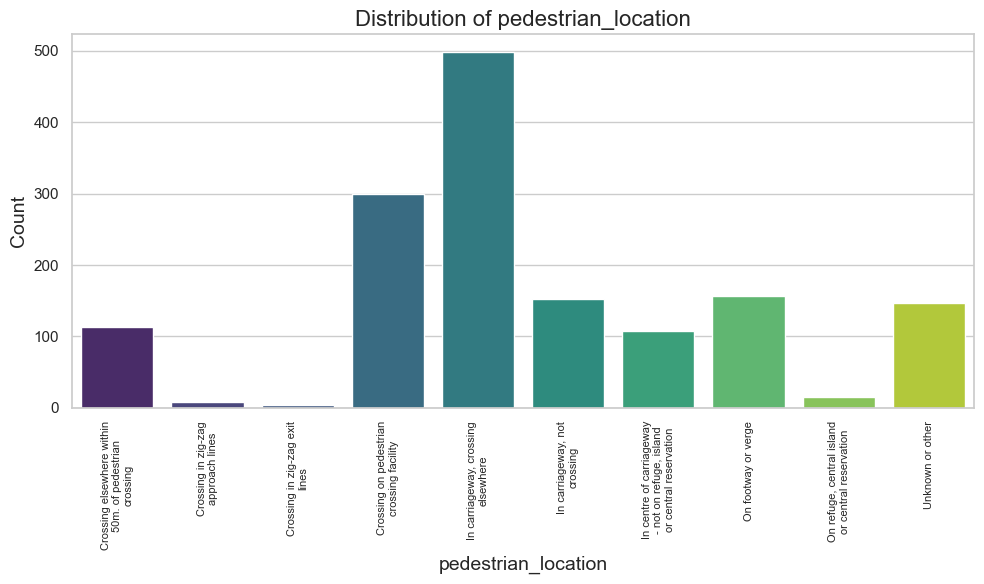

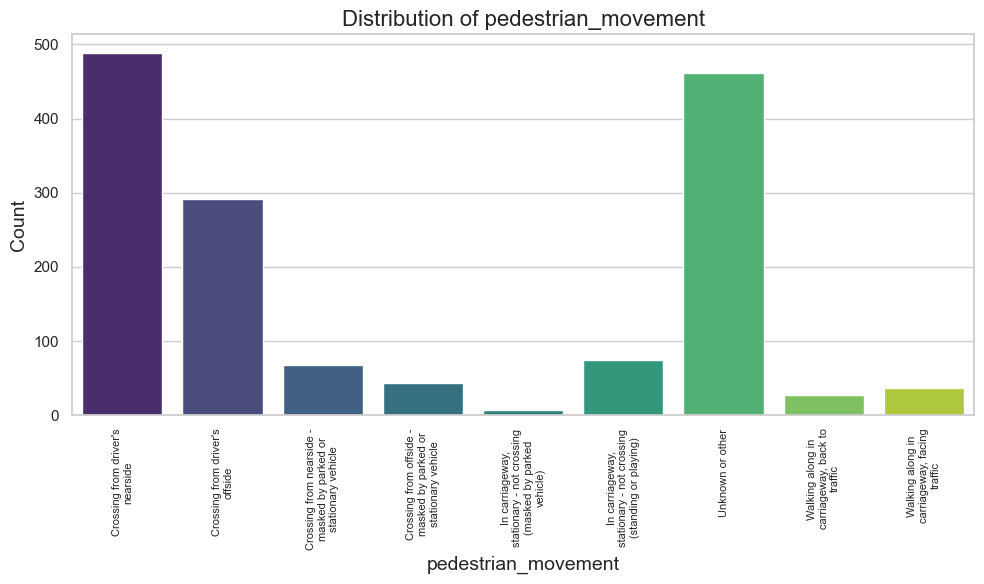

In [361]:
# Plotting distribution of pedestrian locations in high-frequency accident areas
plot_count_plots(['pedestrian_location'], df_pedestrians_top_1500_labeled)

# Plotting distribution of pedestrian movements in high-frequency accident areas
plot_count_plots(['pedestrian_movement'], df_pedestrians_top_1500_labeled)


Observations:

The most common pedestrian movement leading to casualties is 'Crossing from driver's offside', which significantly exceeds other types of movements. This suggests that pedestrians crossing from the far side of the road relative to the driver's position are at a higher risk of accidents.

For pedestrian locations, 'In carriageway, not crossing' has the highest count, indicating that pedestrians located on the road but not actively crossing are also at a high risk.

Suggestions for Pedestrian Safety:

Education and Awareness: Campaigns to educate pedestrians about the dangers of crossing from the driver's offside and staying in the carriageway without crossing could be effective. Pedestrians should be made aware of the blind spots for drivers and encouraged to make eye contact with drivers before crossing.

Infrastructure Improvements: The introduction of pedestrian overpasses or underpasses at high-traffic areas can provide safer crossing options. Additionally, more marked crosswalks with pedestrian-activated signals can give pedestrians clear right-of-way when crossing.

Traffic Calming Measures: Implementing traffic calming measures such as speed bumps, narrowing roads, or creating pedestrian-only zones can significantly reduce the risk to pedestrians.

Enhanced Street Lighting: Improving lighting around pedestrian crossings and in areas where pedestrians are likely to be in the carriageway can help in making pedestrians more visible to drivers.

Law Enforcement: Stricter enforcement of traffic laws related to pedestrian right-of-way and jaywalking can deter risky behaviors.

Technology Solutions: Advanced technologies like pedestrian detection systems in vehicles and smart pedestrian signals that adapt to real-time pedestrian traffic can provide additional layers of safety.

Community Involvement: Engaging local communities to identify dangerous spots and working on tailored solutions can improve pedestrian safety.

### **Drivers**

In [362]:
# Assuming df_drivers_top_1500 contains the top 1500 LSOA areas with the highest driver casualties
most_dangerous_areas_for_drivers = change_first_letter(list(df_drivers_top_1500['lsoa_of_casualty_numeric']))

# This list now contains the LSOA codes of the areas most dangerous for drivers

most_dangerous_areas_for_drivers[0:5]


['E01019456.0', 'E01019456.0', 'E01019456.0', 'E01004242.0', 'E01033583.0']

### **Motorcyclists**

In [363]:
# Assuming df_motorcycles_top_1500 contains the top 1500 LSOA areas with the highest motorcyclist casualties
most_dangerous_areas_for_motorcyclists = remove_duplicates_ordered(change_first_letter(list(df_motorcycles_top_1500['lsoa_of_casualty_numeric'])))

# This list now contains the LSOA codes of the areas most dangerous for motorcyclists

most_dangerous_areas_for_motorcyclists[0:5]

['E01019456.0', 'E01004242.0', 'E01033583.0', 'E01002071.0', 'E01004252.0']

### **Cyclists**

In [364]:
# Assuming df_cyclist_top_1500 contains the top 1500 LSOA areas with the highest cyclist casualties
most_dangerous_areas_for_cyclists = remove_duplicates_ordered(change_first_letter(list(df_cyclist_top_1500['lsoa_of_casualty_numeric'])))

# This list now contains the LSOA codes of the areas most dangerous for cyclists

most_dangerous_areas_for_cyclists[0:5]

['E01019456.0', 'E01004242.0', 'E01033583.0', 'E01004252.0', 'E01002071.0']

### **Passengers**

In [365]:
# Assuming df_passengers_top_1500 contains the top 1500 LSOA areas with the highest passenger casualties
most_dangerous_areas_for_passengers = remove_duplicates_ordered(change_first_letter(list(df_passengers_top_1500['lsoa_of_casualty_numeric'])))

# This list now contains the LSOA codes of the areas most dangerous for passengers

most_dangerous_areas_for_passengers[0:5]

['E01019456.0', 'E01004242.0', 'E01002071.0', 'E01001087.0', 'E01002053.0']

## **Heatmap plots**

### **All heatmap plots**

In [366]:
def plot_heatmap_for_dfs(dataframe_tuples, index, columns ):
    """
    Generates heatmaps for the list of dataframes provided.
    
    Parameters:
    - dataframe_tuples: A list of tuples, each containing:
        0. DataFrame to plot
        1. Label for the DataFrame (used for title)
    """
    for df_tuple in dataframe_tuples:
        _, _, df, label = df_tuple  # Extract DataFrame and label
        
        # Create a pivot table for the heatmap
        heatmap_data = pd.pivot_table(df, 
                                      index=[index], 
                                      columns= columns, 
                                      values='casualty_reference',  # Use any countable column
                                      aggfunc='count', 
                                      fill_value=0)
        
        # Drawing the heatmap
        plt.figure(figsize=(10, 8))
        sns.heatmap(heatmap_data, annot=False, fmt="d", cmap="YlGnBu")
        plt.title(f'Heatmap of Accidents by lsoa and Severity - {label}')
        plt.xlabel(columns)
        plt.ylabel(index)
        plt.show()


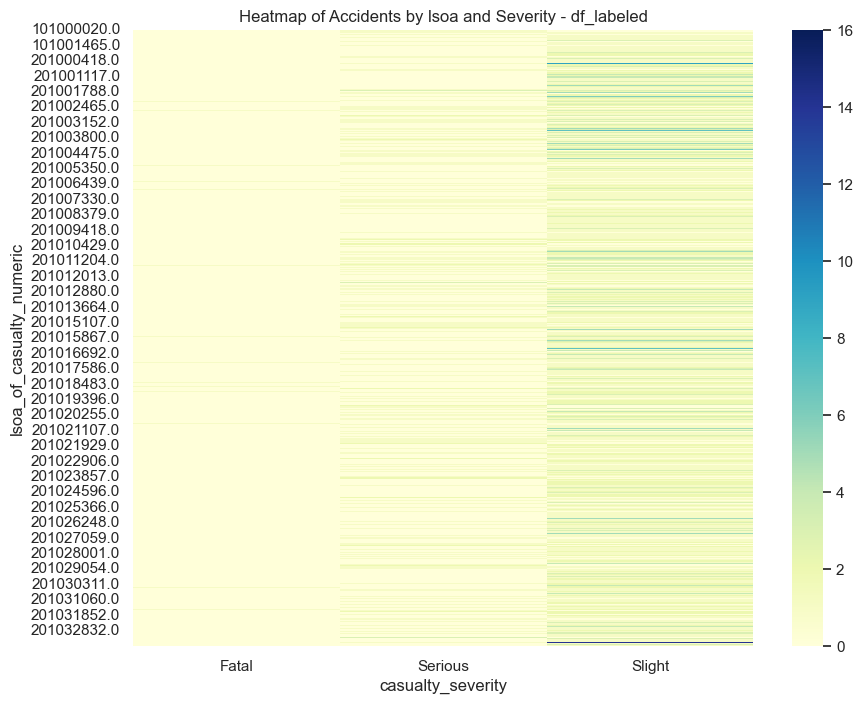

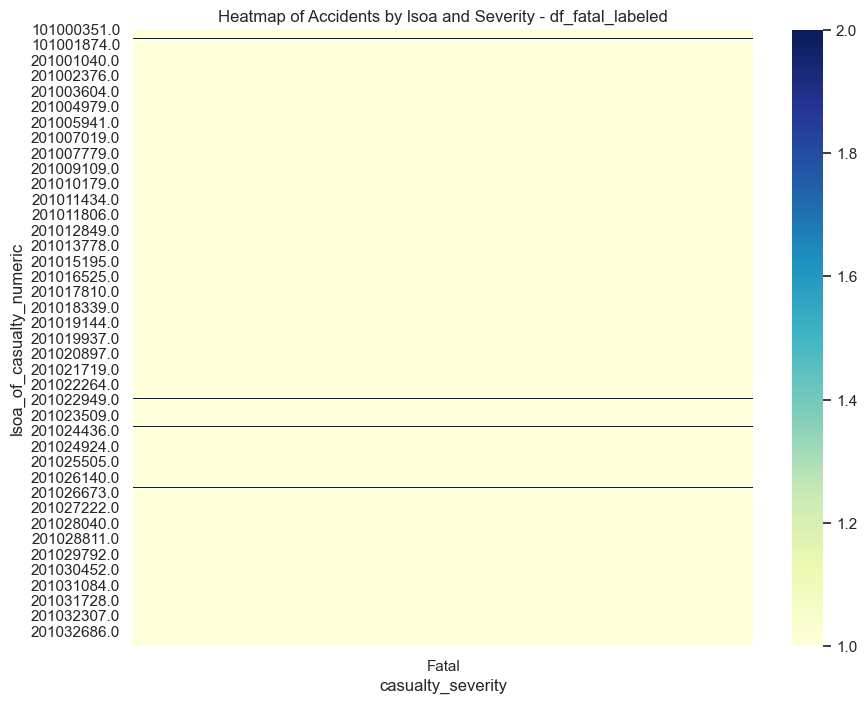

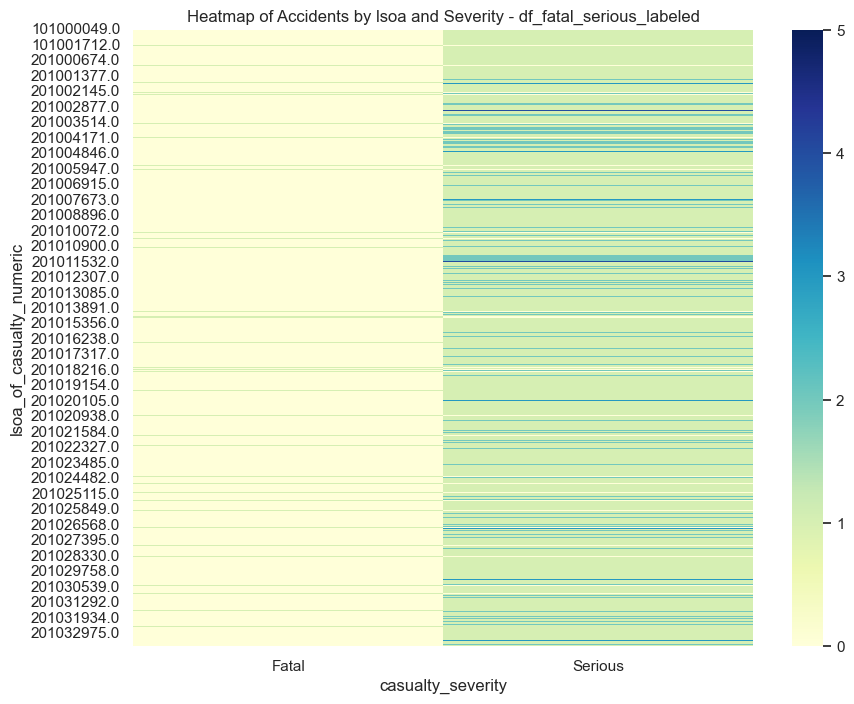

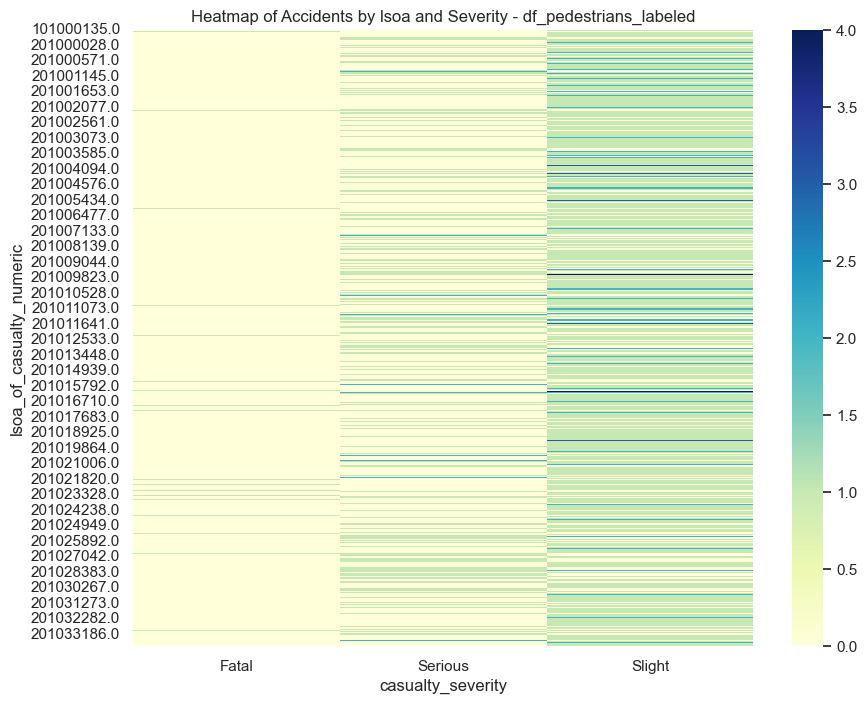

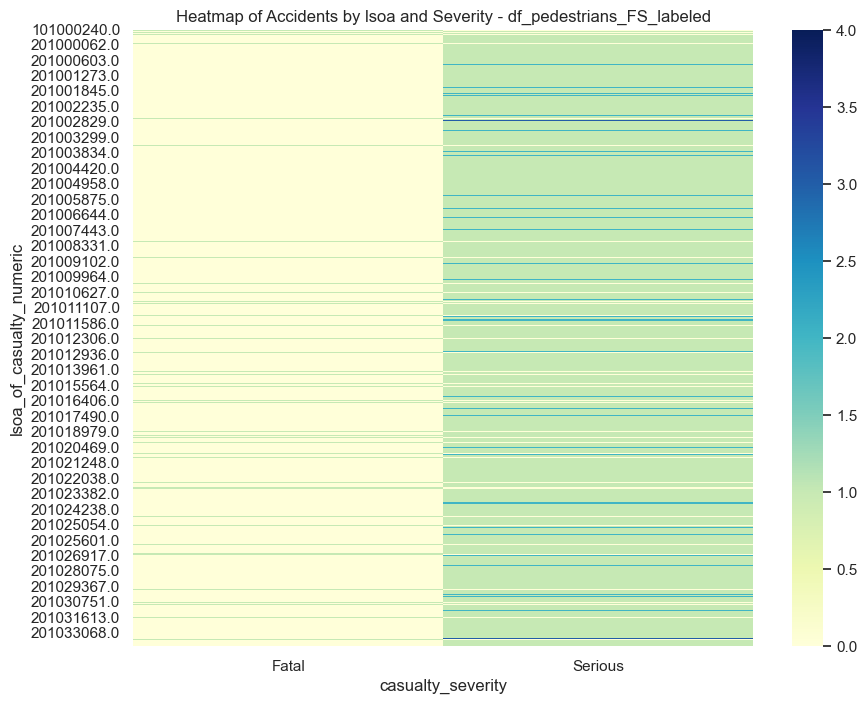

...

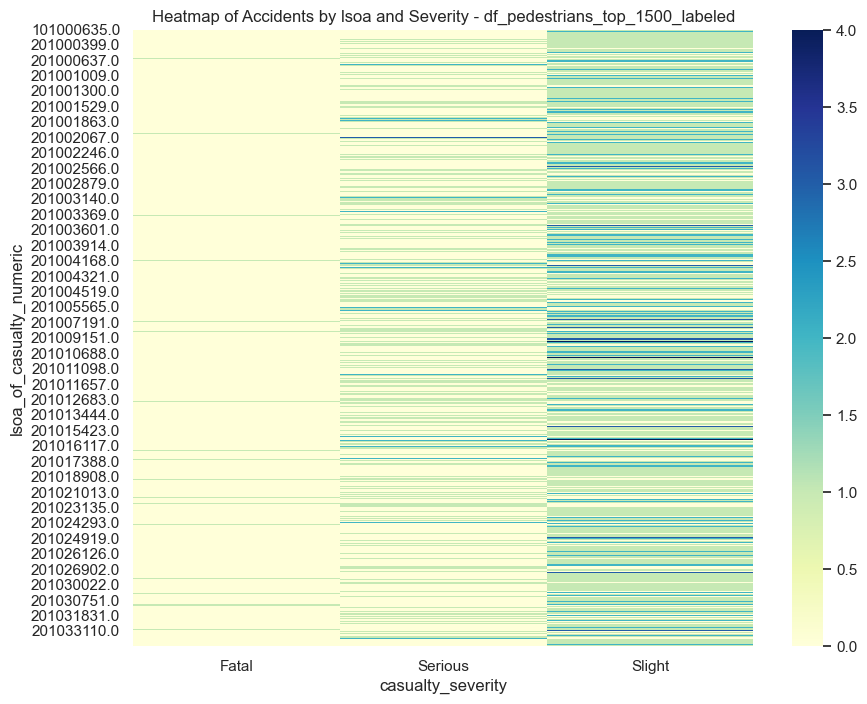

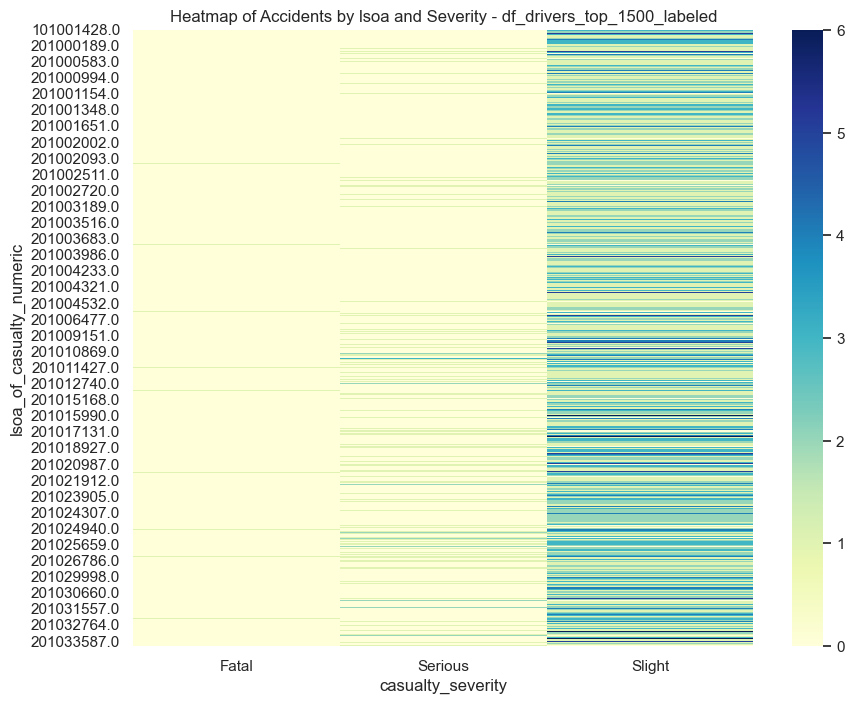

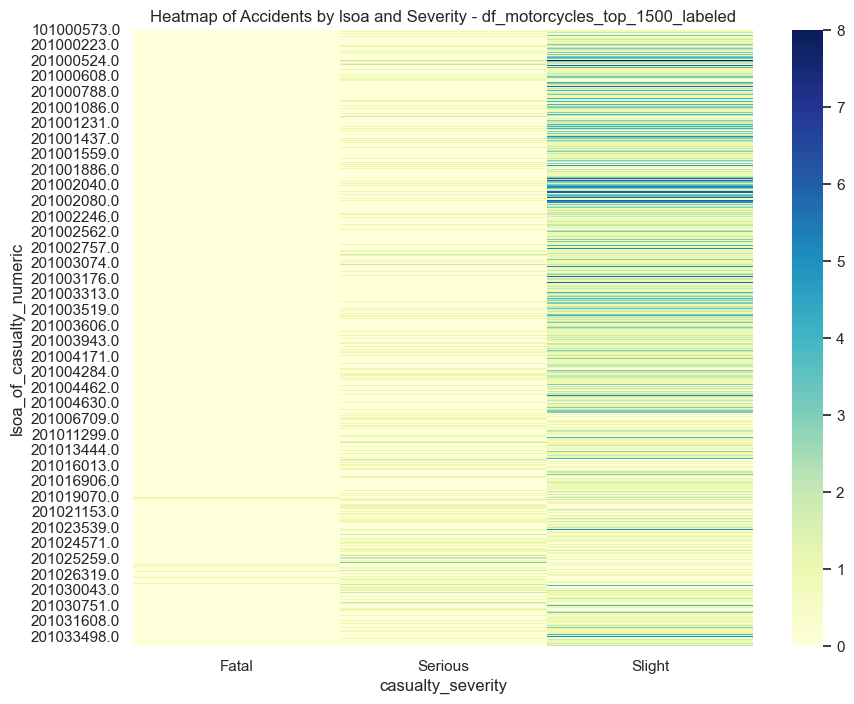

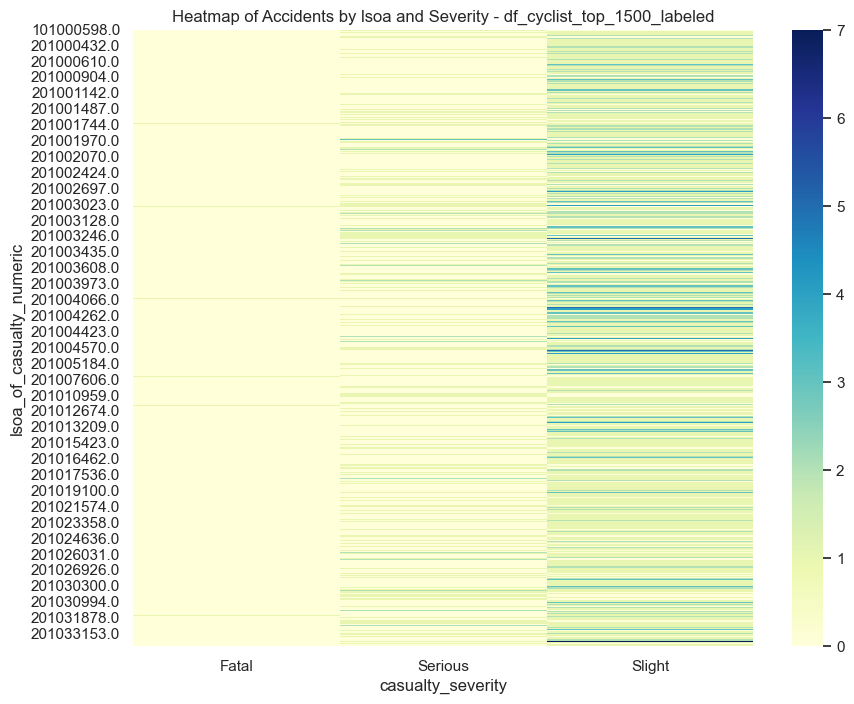

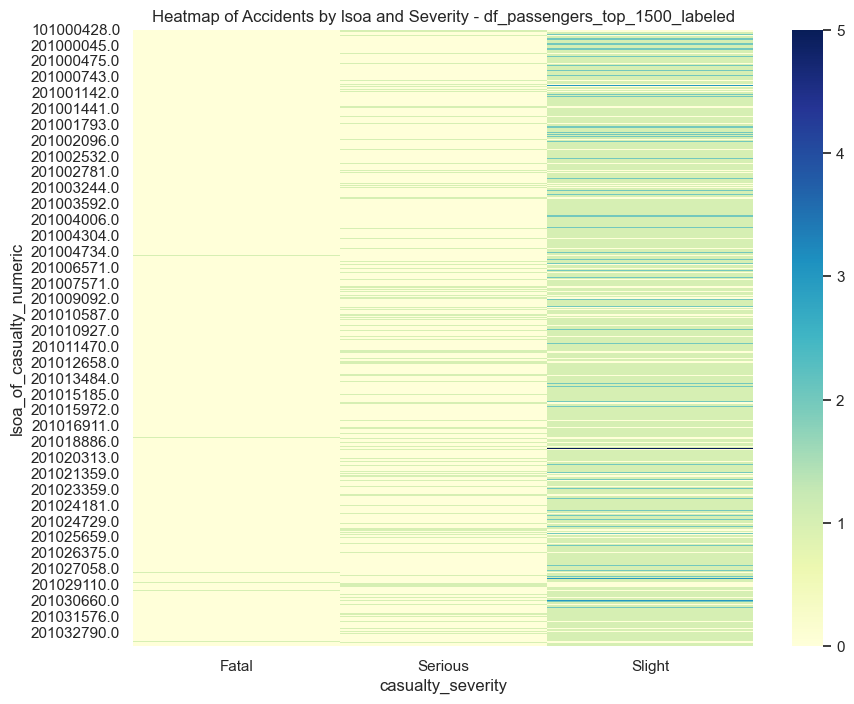

In [367]:
plot_heatmap_for_dfs(dataframes, 'lsoa_of_casualty_numeric', 'casualty_severity')

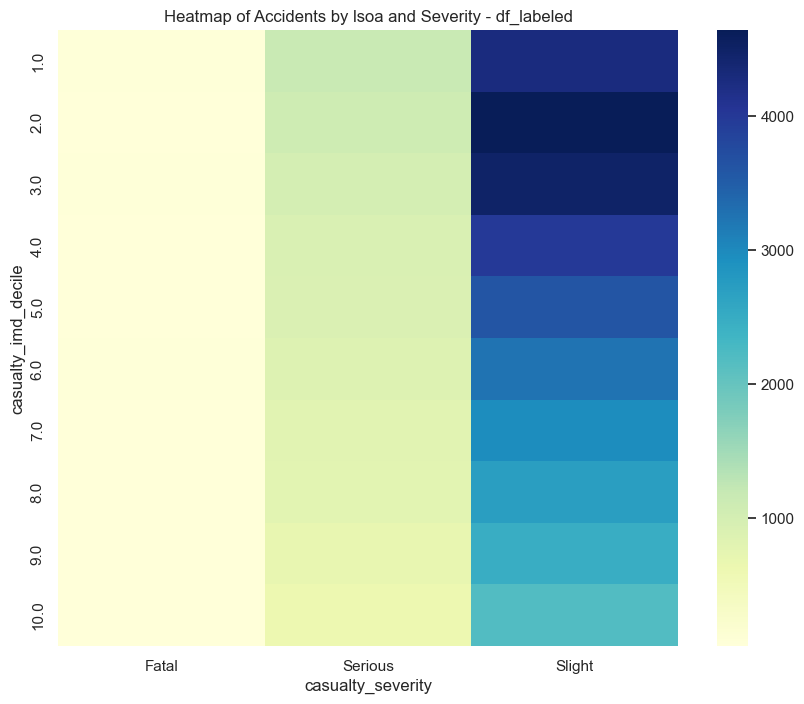

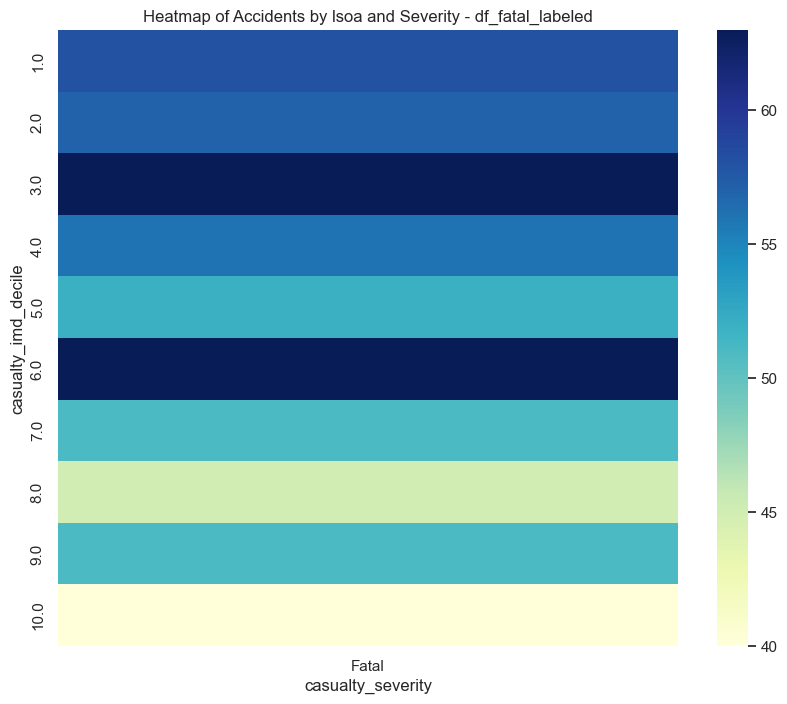

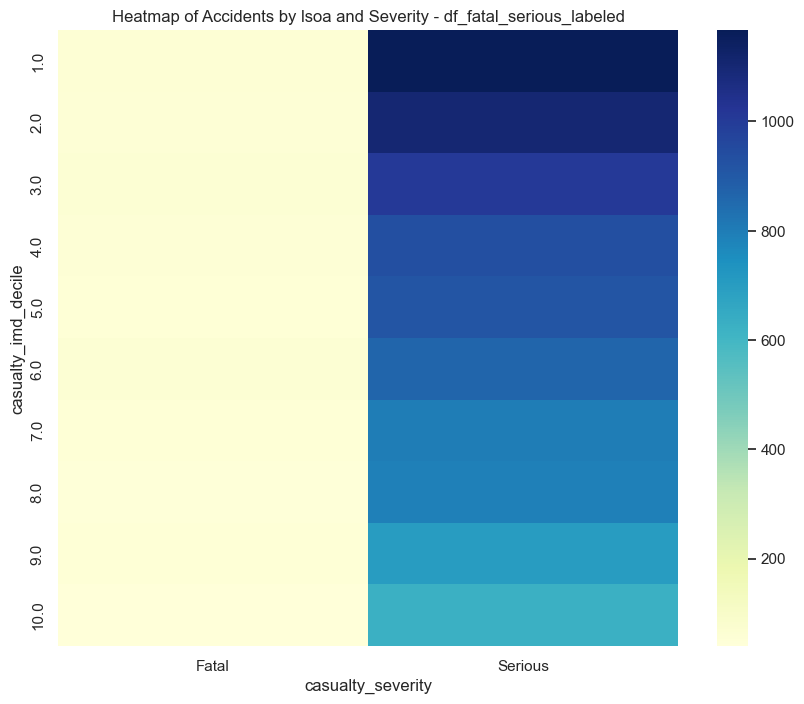

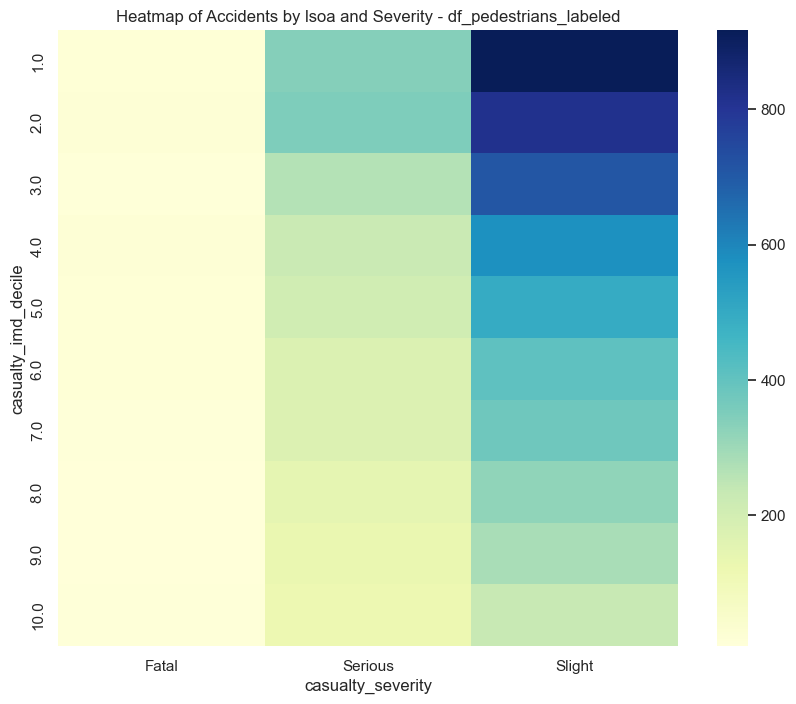

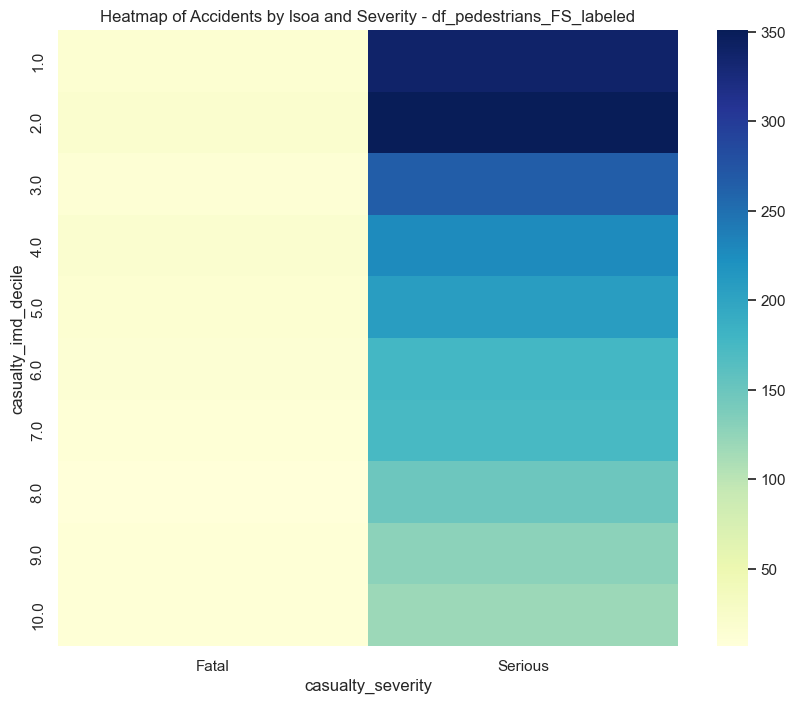

...

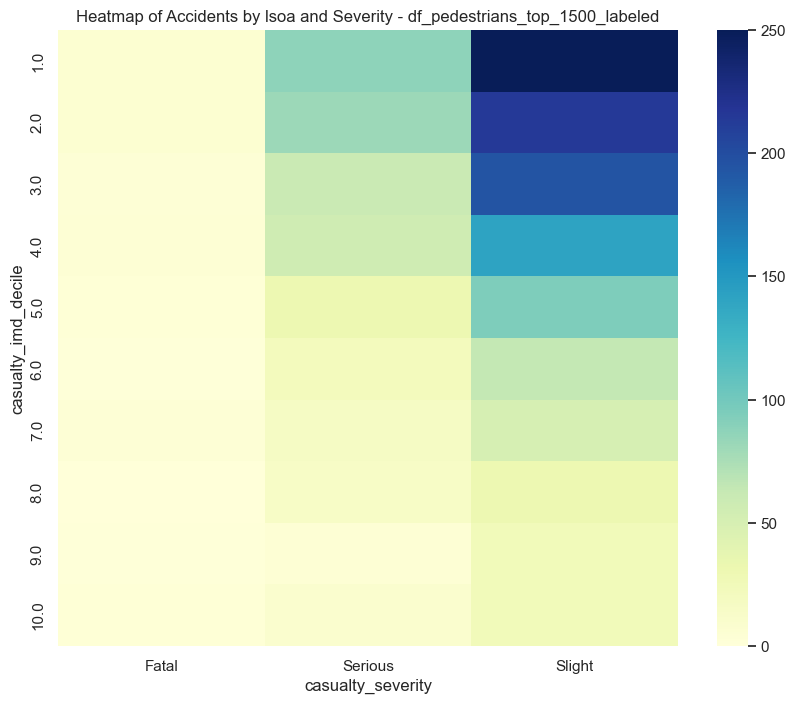

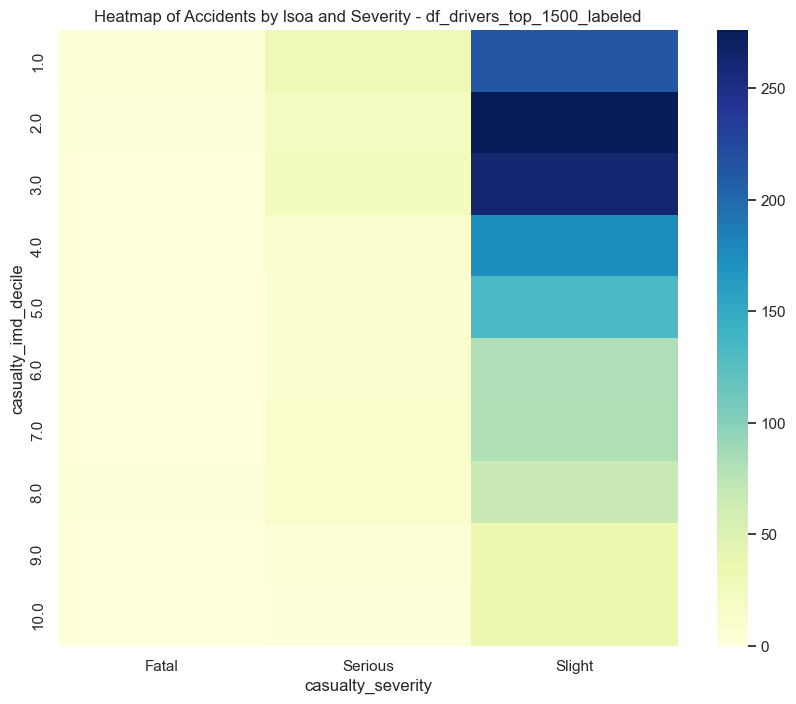

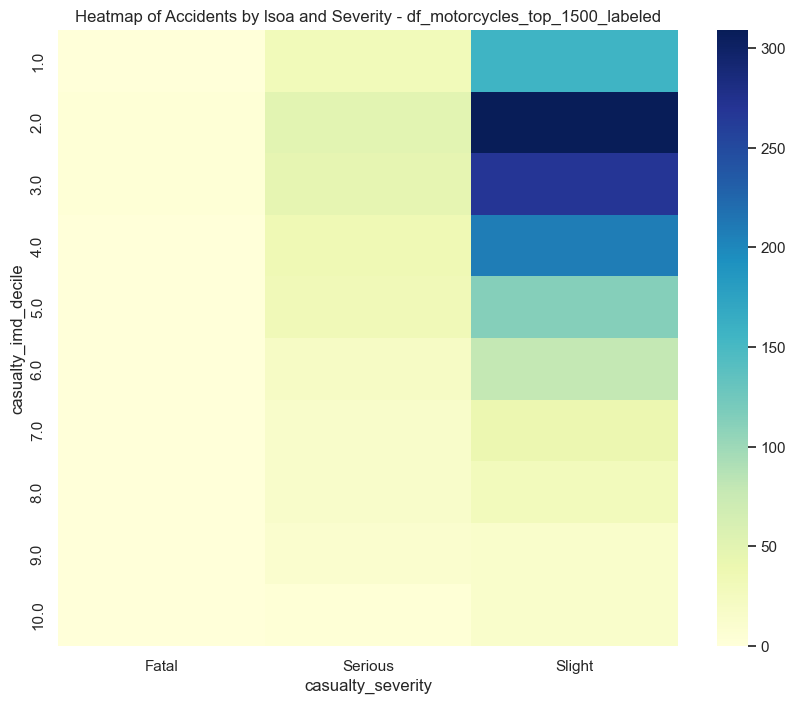

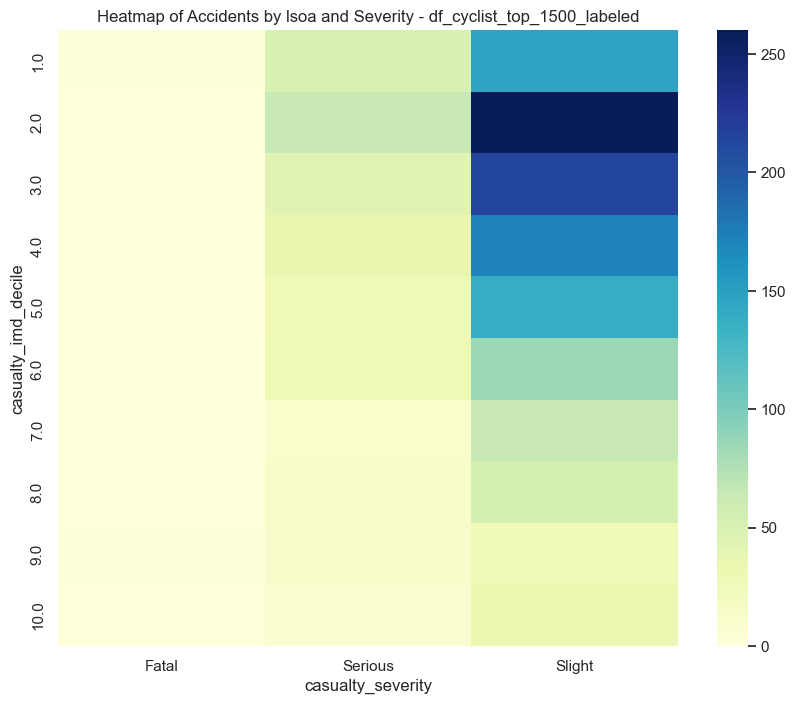

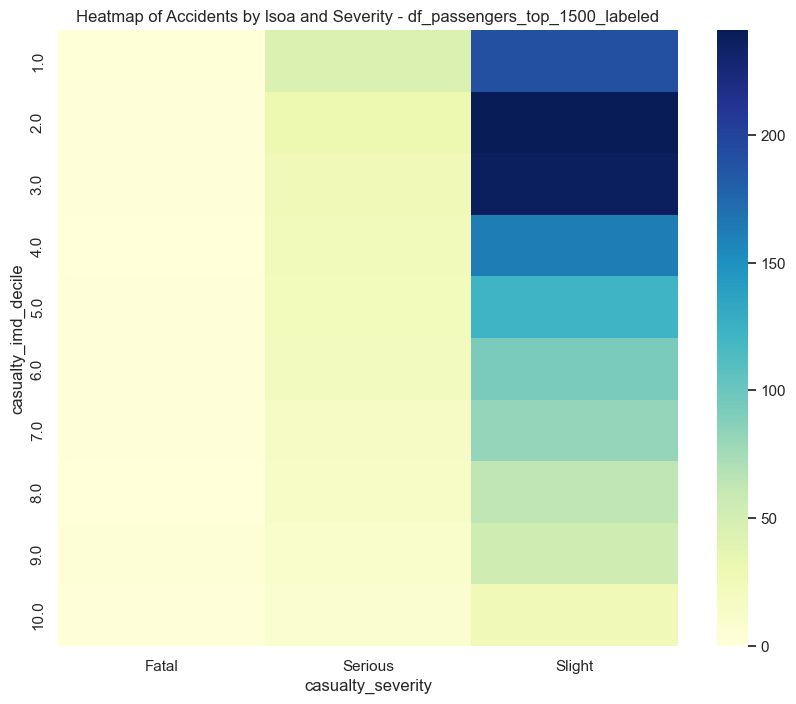

In [368]:
plot_heatmap_for_dfs(dataframes, 'casualty_imd_decile', 'casualty_severity')

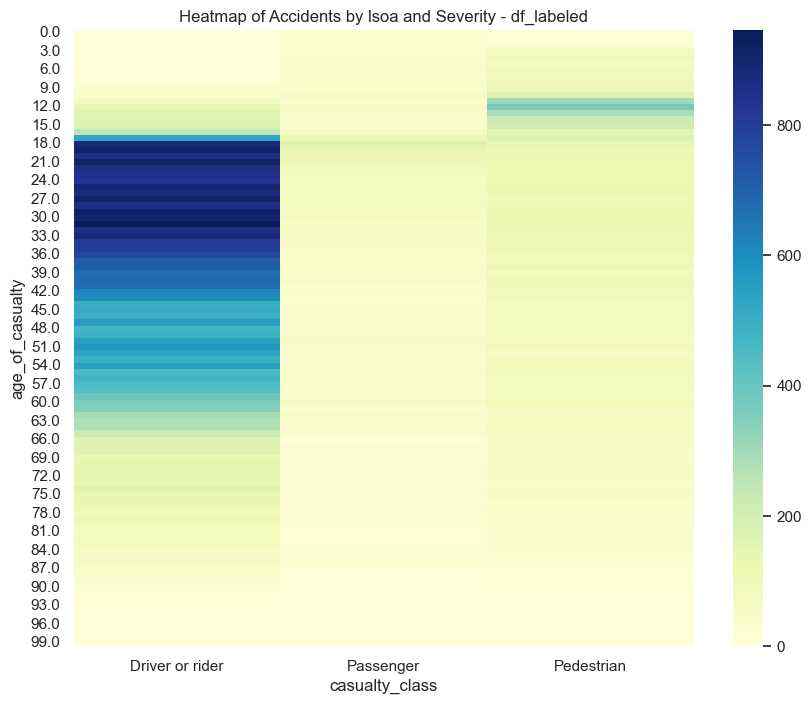

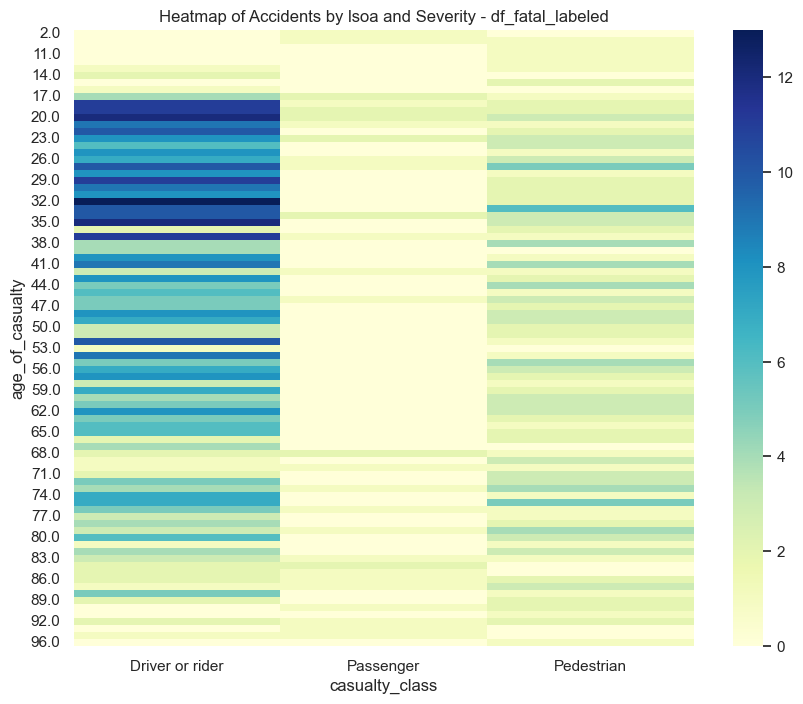

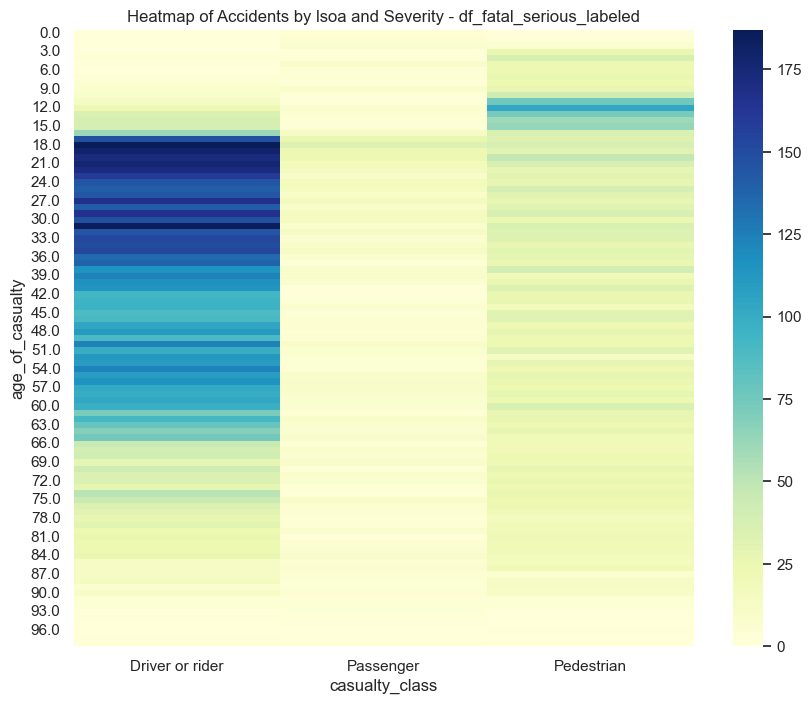

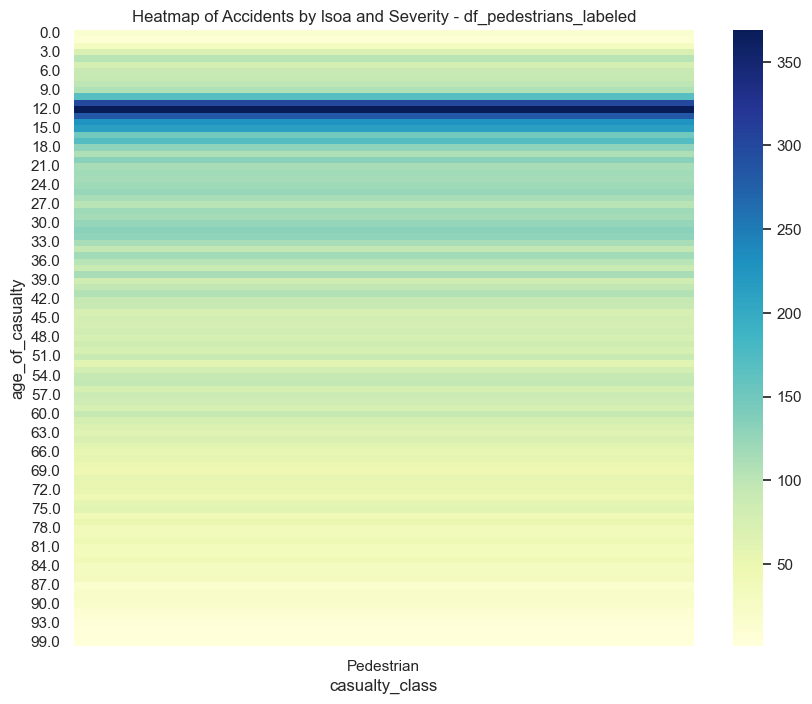

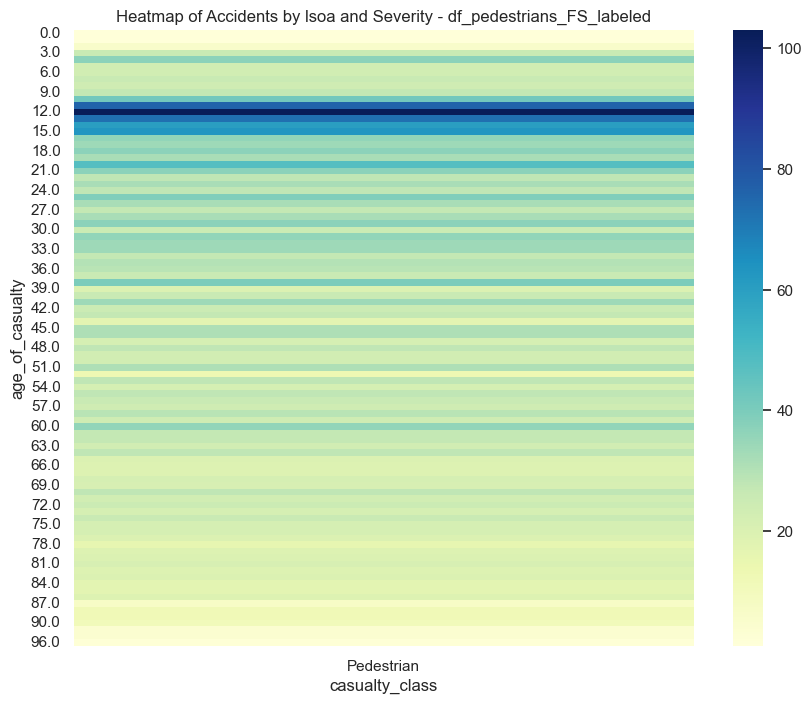

...

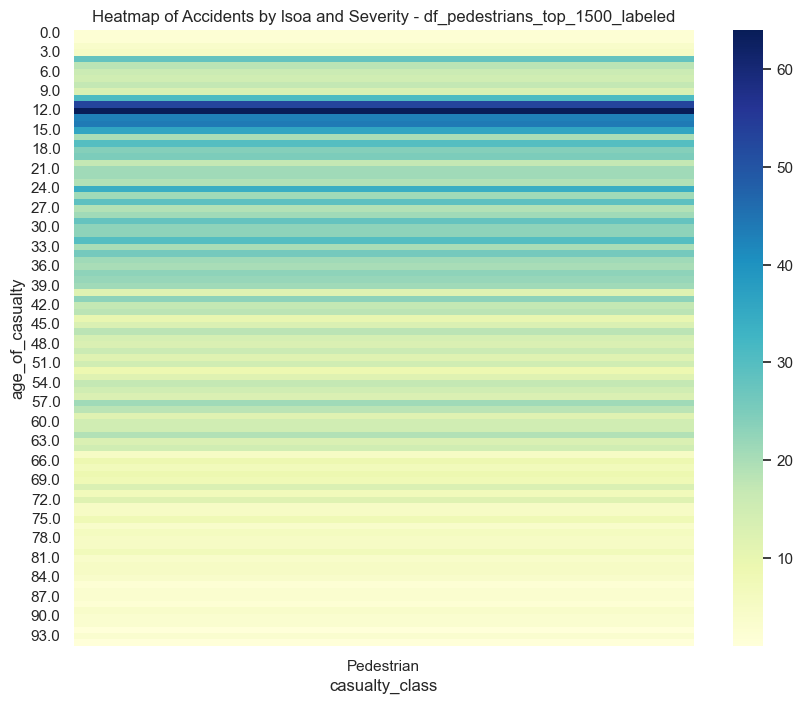

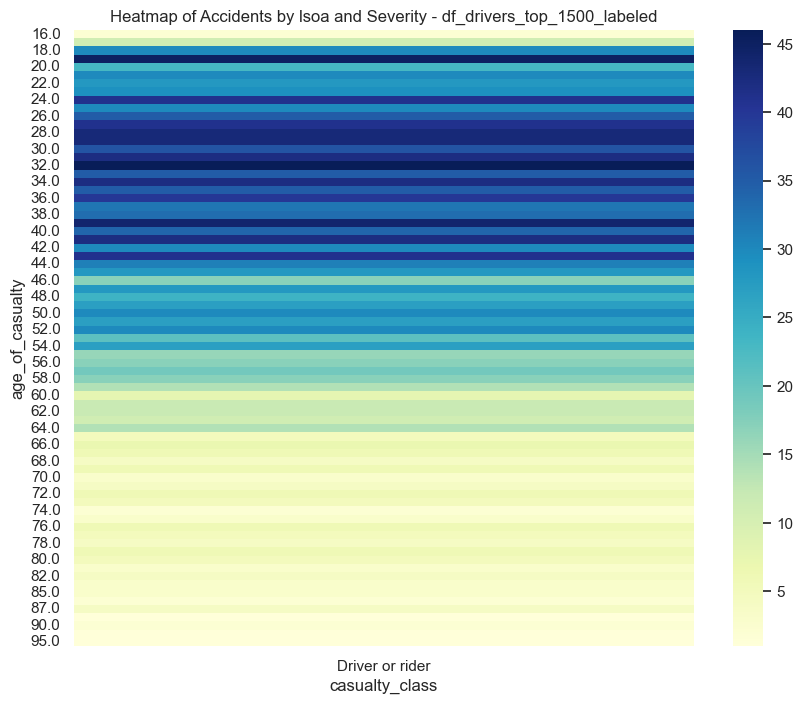

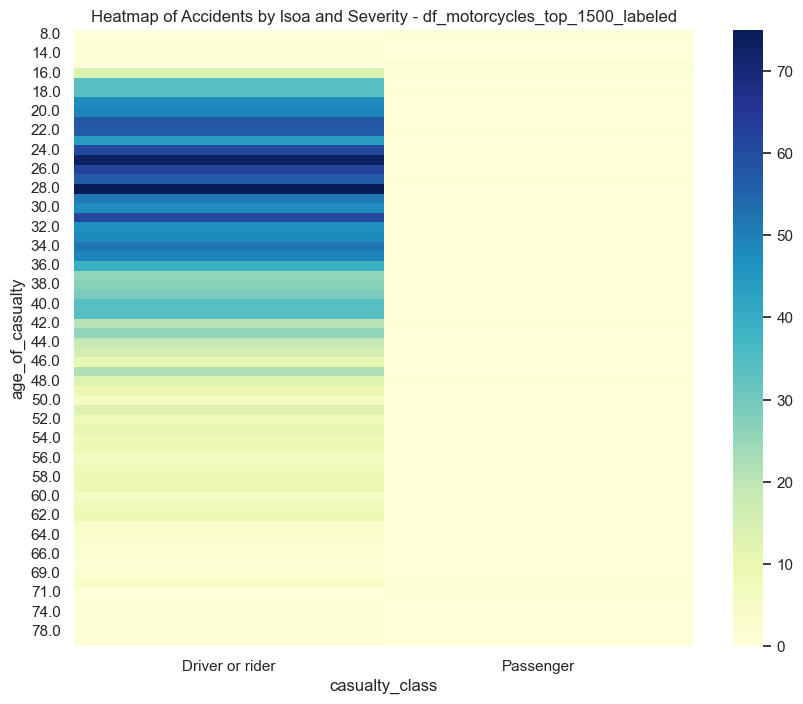

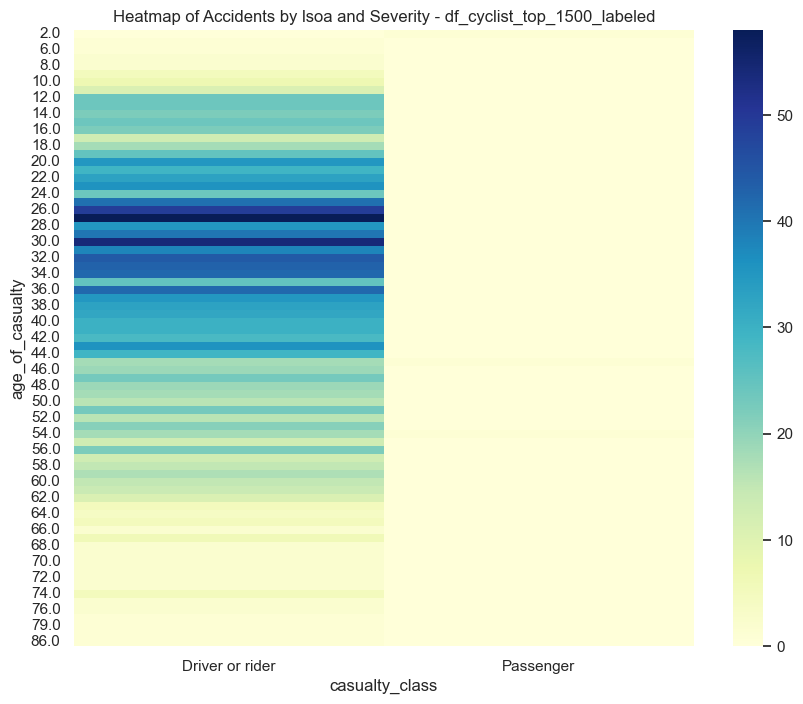

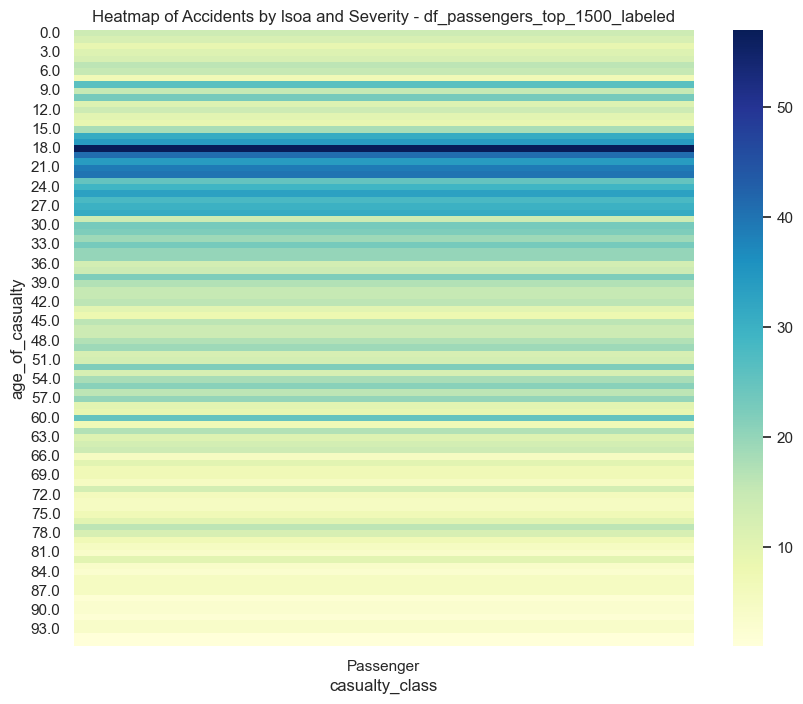

In [369]:
plot_heatmap_for_dfs(dataframes, 'age_of_casualty', 'casualty_class')

### **Example heatmap**

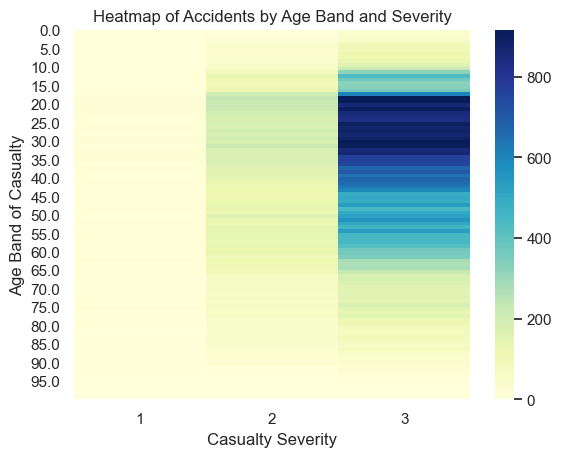

In [370]:
heatmap_data = pd.pivot_table(df_copy, 
                              index=['age_of_casualty'], 
                              columns='casualty_severity', 
                              values='casualty_reference', # Assuming 'casualty_reference' can serve as a counter
                              aggfunc='count', # Use 'count' to get the number of records
                              fill_value=0)

# Drawing the heatmap
sns.heatmap(heatmap_data, annot=False, fmt="d", cmap="YlGnBu")
plt.title('Heatmap of Accidents by Age Band and Severity')
plt.xlabel('Casualty Severity')
plt.ylabel('Age Band of Casualty')
plt.show()


#### Analysis of Accident Severity Across Age Bands

The heatmap visualization provides an insightful display of the frequency of road accidents cross-referenced by the age of the casualty and the severity of the accident. Key observations are as follows:

- The majority of accidents, irrespective of severity, occur within the 20-40 age range. This could indicate higher exposure to road traffic or greater engagement in driving activities for this age demographic.
- There is a noticeable concentration of severe accidents (severity level 1) among younger and older age groups, particularly noticeable in the under-20 and over-75 age bands. This might suggest a higher vulnerability or more severe outcomes for these age groups when involved in accidents.
- The least severe accidents (severity level 3) are more uniformly distributed across all age bands, suggesting that minor accidents are a common occurrence regardless of age.
- The mid-severity level (2) follows a similar pattern to the high severity, with a somewhat consistent presence across all ages, but with fewer occurrences than the least severe accidents.

#### Recommendations for Enhancing Pedestrian Safety:

1. **Targeted Safety Measures for Vulnerable Age Groups:** Given the higher frequency of severe accidents among the youngest and oldest pedestrians, targeted safety campaigns and infrastructure improvements in areas frequented by these age groups could be beneficial.
2. **Education and Awareness Programs:** For the age group of 20-40, which sees the highest overall accident frequency, education and awareness programs about road safety, the importance of attentive driving, and pedestrian awareness could help reduce accidents.
3. **Infrastructure Improvements:** Implementing better lighting, clearer signage, and pedestrian-friendly traffic controls in high-traffic areas could help in reducing the number of accidents across all severity levels.

Further investigation could involve analyzing the specific circumstances of each accident to understand the contributing factors better and to design more effective interventions.


## **Comparing Plots**

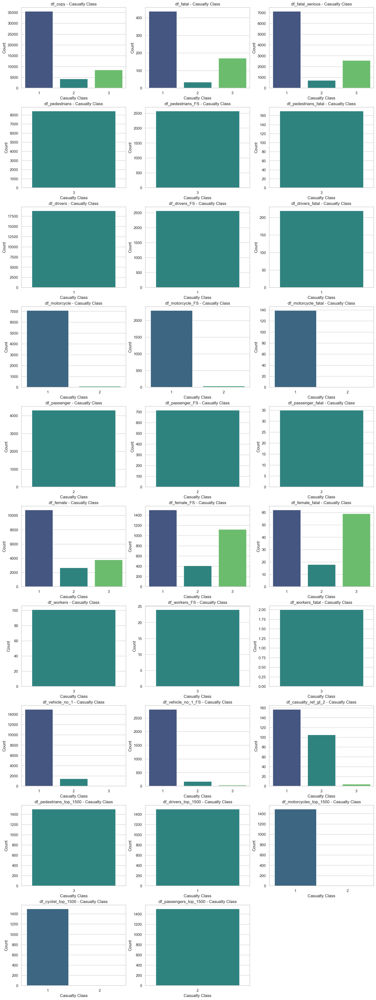

In [371]:
def plot_casualty_class_across_dataframes(dataframes):
    """
    Plot the distribution of 'casualty_class' for each DataFrame in a grid of subplots.

    Parameters:
    - dataframes: A list of tuples, each containing an original dataframe, its name,
                  a labeled version of the dataframe, and its labeled name.
    """
    # Determine the grid size
    n = len(dataframes)
    ncols = 3  # Optimal number of columns in the grid
    nrows = n // ncols + (n % ncols > 0)  # Calculate rows needed, round up
    
    fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(15, nrows * 4), constrained_layout=True)
    axes = axes.flatten()  # Flatten to easily loop over it if it's 2D
    
    for i, (df, df_name, _, _) in enumerate(dataframes):
        # Plot on the ith subplot
        sns.countplot(x='casualty_class', data=df, ax=axes[i], palette='viridis')
        axes[i].set_title(f'{df_name} - Casualty Class')
        axes[i].set_xlabel('Casualty Class')
        axes[i].set_ylabel('Count')
        
        # If casualty_class is numeric, you might need to manually set x-tick labels
        # e.g., axes[i].set_xticklabels(['Driver', 'Passenger', 'Pedestrian']) based on your dataset's coding
        
    # Hide any unused subplots if the number of plots is not a perfect fit for the grid
    for j in range(i+1, nrows*ncols):
        axes[j].axis('off')

    plt.show()

# Assuming 'dataframes' is already defined with your data
plot_casualty_class_across_dataframes(dataframes)


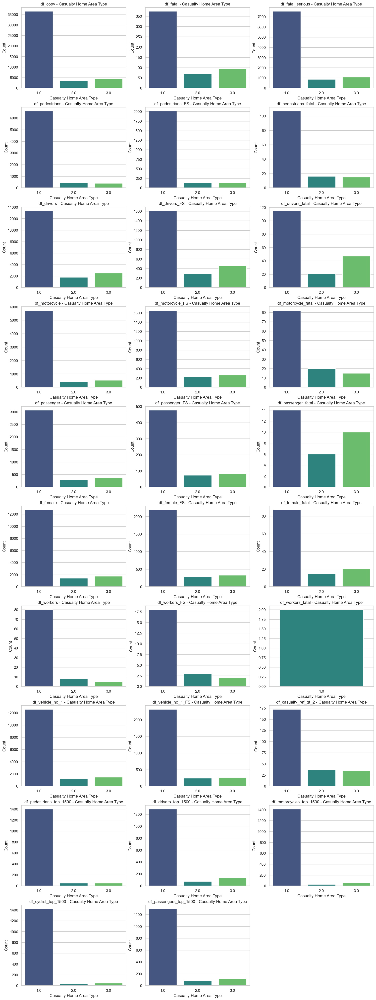

In [372]:
def plot_casualty_home_area_type_across_dataframes(dataframes):
    """
    Plot the distribution of 'casualty_home_area_type' for each DataFrame in a grid of subplots.

    Parameters:
    - dataframes: A list of tuples, each containing an original dataframe, its name,
                  a labeled version of the dataframe, and its labeled name.
    """
    # Determine the grid size
    n = len(dataframes)
    ncols = 3  # Optimal number of columns in the grid for visibility
    nrows = n // ncols + (n % ncols > 0)  # Calculate rows needed, round up
    
    fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(15, nrows * 4), constrained_layout=True)
    axes = axes.flatten()  # Flatten the axes array for easy iteration
    
    for i, (df, df_name, _, _) in enumerate(dataframes):
        # Plot on the ith subplot
        sns.countplot(x='casualty_home_area_type', data=df, ax=axes[i], palette='viridis')
        axes[i].set_title(f'{df_name} - Casualty Home Area Type')
        axes[i].set_xlabel('Casualty Home Area Type')
        axes[i].set_ylabel('Count')
        
        # If casualty_home_area_type is numeric, you might need to manually set x-tick labels
        # e.g., axes[i].set_xticklabels(['Urban', 'Rural', 'Other']) based on your dataset's coding
        
    # Hide any unused subplots if the number of plots is not a perfect fit for the grid
    for j in range(i+1, nrows*ncols):
        axes[j].axis('off')

    plt.show()

# Assuming 'dataframes' is already defined with your data
plot_casualty_home_area_type_across_dataframes(dataframes)


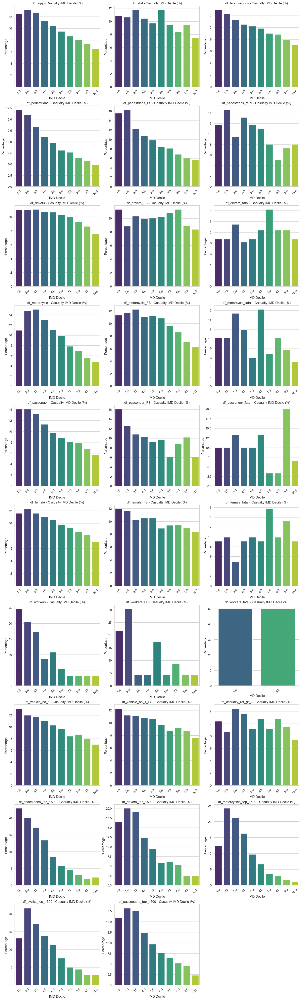

In [373]:
def plot_casualty_imd_decile_percentage_across_dataframes(dataframes):
    """
    Plot the distribution of 'casualty_imd_decile' as percentages for each DataFrame in a grid of subplots.

    Parameters:
    - dataframes: A list of tuples, each containing an original dataframe, its name,
                  a labeled version of the dataframe, and its labeled name.
    """
    # Determine the grid size
    n = len(dataframes)
    ncols = 3  # Optimal number of columns in the grid for visibility
    nrows = n // ncols + (n % ncols > 0)  # Calculate rows needed, round up
    
    fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(15, nrows * 5), constrained_layout=True)
    axes = axes.flatten()  # Flatten the axes array for easy iteration
    
    for i, (df, df_name, _, _) in enumerate(dataframes):
        # Calculate the percentage of each IMD decile
        value_counts = df['casualty_imd_decile'].value_counts(normalize=True) * 100
        value_counts_sorted = value_counts.sort_index()
        
        # Plot on the ith subplot
        sns.barplot(x=value_counts_sorted.index, y=value_counts_sorted.values, ax=axes[i], palette='viridis')
        axes[i].set_title(f'{df_name} - Casualty IMD Decile (%)')
        axes[i].set_xlabel('IMD Decile')
        axes[i].set_ylabel('Percentage')
        axes[i].tick_params(axis='x', rotation=45)
        
    # Hide any unused subplots if the number of plots is not a perfect fit for the grid
    for j in range(i+1, nrows*ncols):
        axes[j].axis('off')

    plt.show()

# Assuming 'dataframes' is your list of tuples containing the dataframes and their names
plot_casualty_imd_decile_percentage_across_dataframes(dataframes)


## **Male to Female Ratio**

In [422]:

# Assuming each DataFrame has a 'sex_of_casualty' column with '1' for male and '2' for female

# Extract only the first DataFrame from each tuple for the analysis
dfs_for_analysis = [df[0] for df in dataframes]

# DataFrame labels
df_labels = [df[1] for df in dataframes]

# Initialize a list to store the Male to Female ratio and Female to Male ratio for each DataFrame
f_to_m_ratios = []
m_to_f_ratios = []


for df in dfs_for_analysis:
    # Calculate the count of male and female casualties
    male_count = df[df['sex_of_casualty'] == 1].shape[0]
    female_count = df[df['sex_of_casualty'] == 2].shape[0]
    
    f_to_m_ratio = female_count / male_count if male_count != 0 else None
    f_to_m_ratios.append(f_to_m_ratio)
    m_to_f_ratio = male_count / female_count if female_count != 0 else None
    m_to_f_ratios.append(m_to_f_ratio)



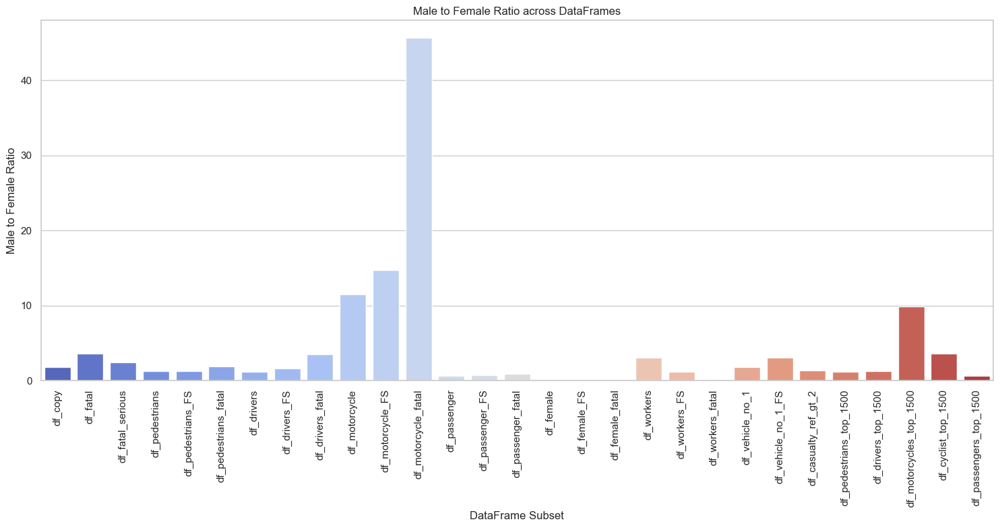

In [421]:

# Create a DataFrame for plotting
ratio_df = pd.DataFrame({'DataFrame': df_labels, 'Male_to_Female_Ratio': m_to_f_ratios})

# Plotting
plt.figure(figsize=(15, 8))
sns.barplot(x='DataFrame', y='Male_to_Female_Ratio', data=ratio_df, palette='coolwarm')  # Corrected column name here
plt.xticks(rotation=90)  # Rotate the labels for better readability
plt.title('Male to Female Ratio across DataFrames')
plt.ylabel('Male to Female Ratio')
plt.xlabel('DataFrame Subset')
plt.tight_layout()

plt.show()

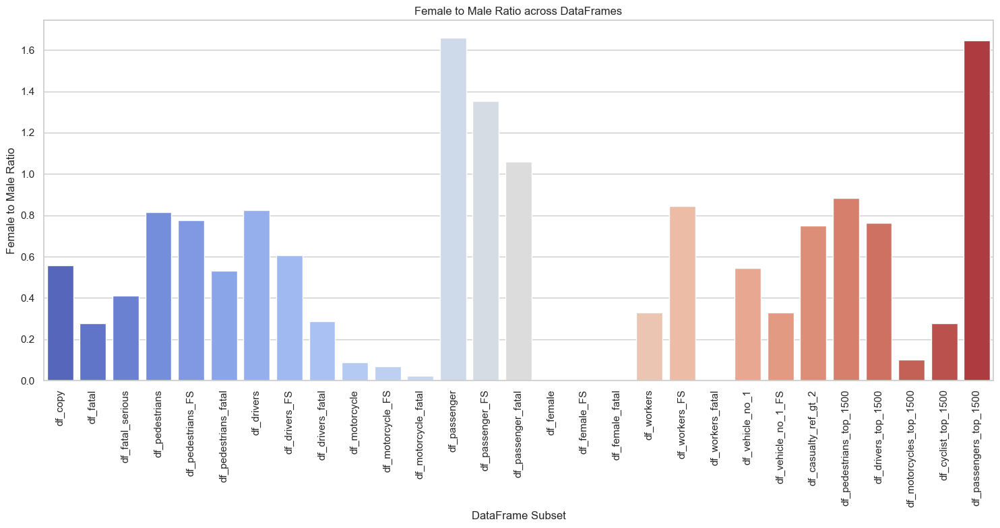

In [420]:

# Create a DataFrame for plotting
ratio_df = pd.DataFrame({'DataFrame': df_labels, 'Female_to_Male_Ratio': f_to_m_ratios})

# Plotting
plt.figure(figsize=(15, 8))
sns.barplot(x='DataFrame', y='Female_to_Male_Ratio', data=ratio_df, palette='coolwarm')  # Corrected column name here
plt.xticks(rotation=90)  # Rotate the labels for better readability
plt.title('Female to Male Ratio across DataFrames')
plt.ylabel('Female to Male Ratio')
plt.xlabel('DataFrame Subset')
plt.tight_layout()

plt.show()


### Analysis of Female to Male Ratio Across Various DataFrames

The bar chart visualizes the Female to Male ratio across different subsets of data related to road casualties. This analysis aims to understand gender distribution within each subset and identify any significant disparities.

#### Observations:

- The `df_passenger_FS` subset displays a notably higher ratio of females to males, indicating a larger proportion of female casualties in fatal or serious accidents involving passengers.
- Conversely, subsets like `df_motorcycle` and `df_motorcycle_FS` show lower ratios, suggesting a male predominance in motorcycle-related casualties.
- The subsets at the end of the chart, specifically those with labels ending in `1500`, exhibit significantly high female to male ratios. This could be indicative of specific areas or conditions where female casualties are disproportionately higher.

### Implications:

- High ratios in certain subsets could reflect underlying issues such as increased vulnerability or exposure to risk for female casualties in those scenarios.
- The data may also guide targeted interventions, policy-making, and resource allocation to address the gender-specific safety needs.

### Recommendations:

- Detailed investigations should be conducted to understand the context behind high female to male ratios, especially in the subsets related to passengers and specific areas with high casualty frequencies.
- Gender-sensitive road safety programs and educational campaigns should be developed, focusing on the most affected groups identified in the analysis.
- Continuous monitoring and analysis of casualty data should be carried out to assess the impact of implemented measures and adjust strategies accordingly.

### Conclusion:

The chart underscores the importance of considering gender dynamics in road safety studies. It highlights the need for gender-specific data analysis to inform and shape effective road safety policies and interventions.


## **Campare Age of Dataframes**

In [375]:
# This function generates comparative boxplots for 'age_of_casualty' across different subsets of DataFrames. 

def plot_boxplot__(dataframe, title):

    combined_df = pd.DataFrame() 

    # Loop through the list of male DataFrames, adding a 'DataFrame_Label' column to distinguish them
    for df, label in dataframe:
        temp_df = df[['age_of_casualty']].copy()  # Select the age_of_casualty column
        temp_df['DataFrame_Label'] = label  # Add a label to identify the DataFrame
        combined_df = pd.concat([combined_df, temp_df])  # Combine

    
    plt.figure(figsize=(12, 8))
    sns.boxplot(x='DataFrame_Label', y='age_of_casualty', data=combined_df)
    plt.xticks(rotation=45)  # Rotate labels for better readability
    plt.title(title)
    plt.ylabel('Age of Casualty')
    plt.xlabel('DataFrame')
    plt.tight_layout()  # Adjust layout to make room for the x-axis labels
    
    plt.show()

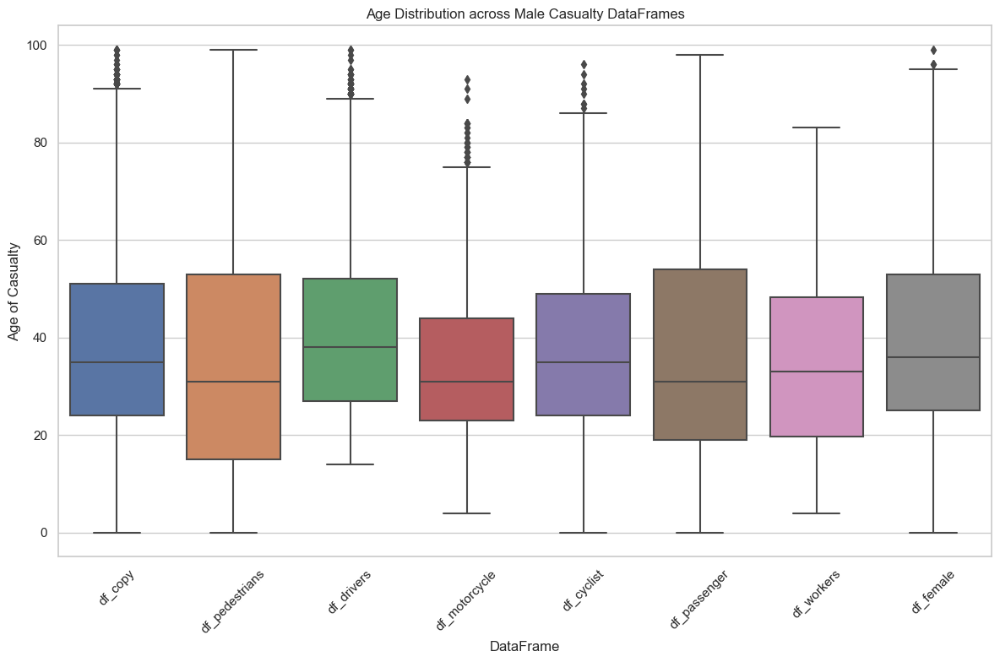

In [376]:
# List of original DataFrames for age distribution analysis.
original_dfs = [
    (df_copy, "df_copy"),
    (df_pedestrians, "df_pedestrians"),
    (df_drivers, "df_drivers"),
    (df_motorcycle, "df_motorcycle"),
    (df_cyclist, "df_cyclist"),
    (df_passenger, "df_passenger"),
    (df_workers, "df_workers"),
    (df_female, "df_female"),
]

# Executing the plotting function for boxplots to compare age distribution across all casualties.
plot_boxplot__(original_dfs,'Age Distribution across Male Casualty DataFrames')



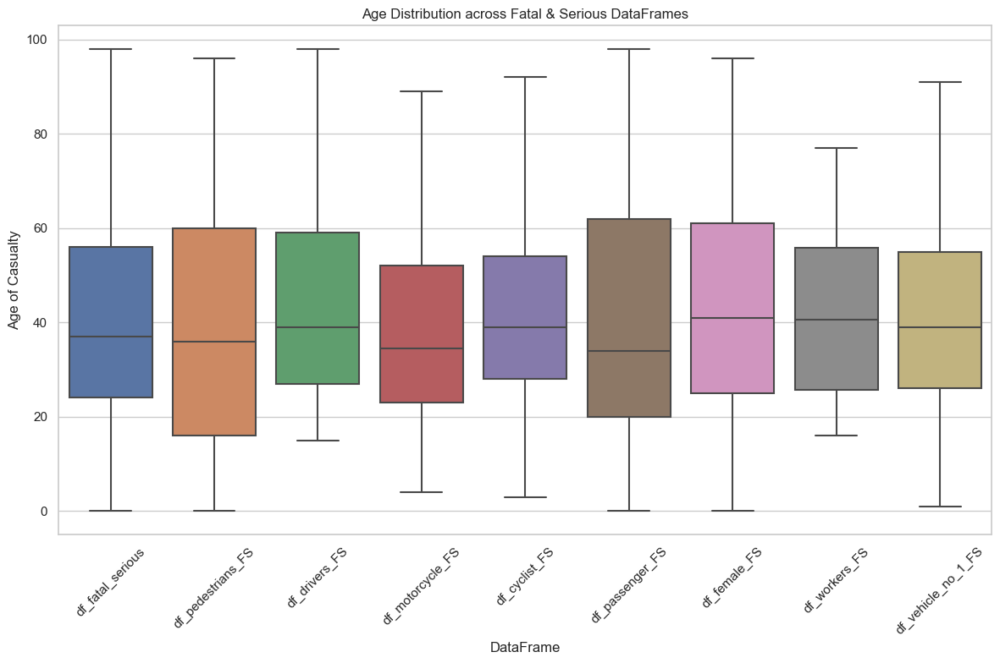

In [377]:
# List of DataFrames with fatal and serious incidents for age distribution analysis.
fs_dfs = [
    (df_fatal_serious, "df_fatal_serious"),
    (df_pedestrians_FS, "df_pedestrians_FS"),
    (df_drivers_FS, "df_drivers_FS"),
    (df_motorcycle_FS, "df_motorcycle_FS"),
    (df_cyclist_FS, "df_cyclist_FS"),
    (df_passenger_FS, "df_passenger_FS"),
    (df_female_FS, "df_female_FS"),
    (df_workers_FS, "df_workers_FS"),
    (df_vehicle_no_1_FS, "df_vehicle_no_1_FS")
]

# Plotting boxplots for age comparison across FS DataFrames.
plot_boxplot__(fs_dfs,'Age Distribution across Fatal & Serious DataFrames')


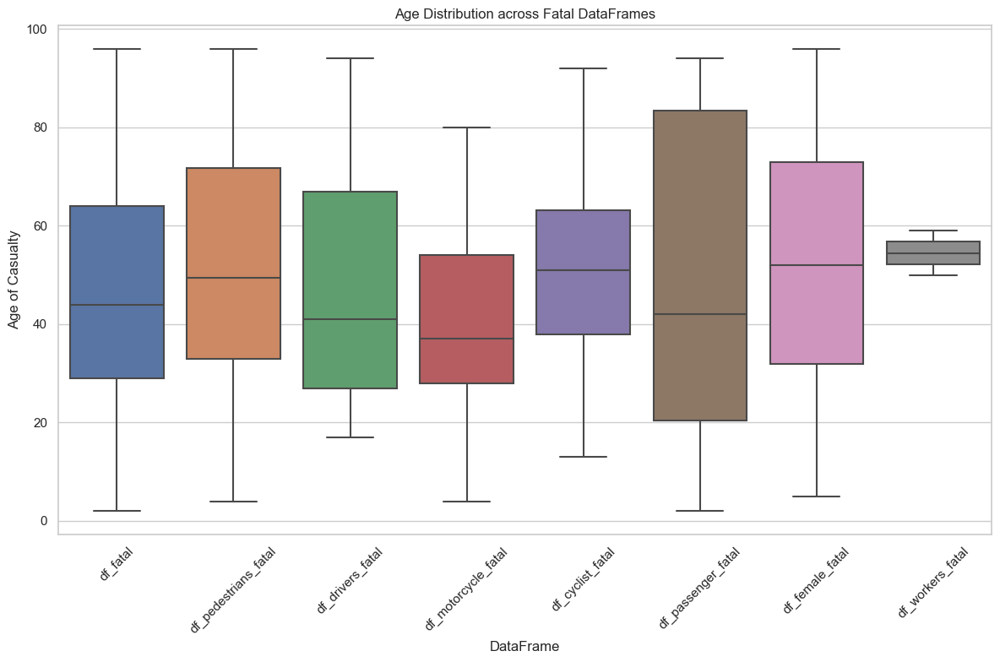

In [378]:
# List of DataFrames with only fatal incidents to analyze the age distribution.
fatal_dfs = [
    (df_fatal, "df_fatal"),
    (df_pedestrians_fatal, "df_pedestrians_fatal"),
    (df_drivers_fatal, "df_drivers_fatal"),
    (df_motorcycle_fatal, "df_motorcycle_fatal"),
    (df_cyclist_fatal, "df_cyclist_fatal"),
    (df_passenger_fatal, "df_passenger_fatal"),
    (df_female_fatal, "df_female_fatal"),
    (df_workers_fatal, "df_workers_fatal"),
]

# This function call creates boxplots for each DataFrame to visualize the distribution of casualty ages in fatal incidents.
plot_boxplot__(fatal_dfs,'Age Distribution across Fatal DataFrames')


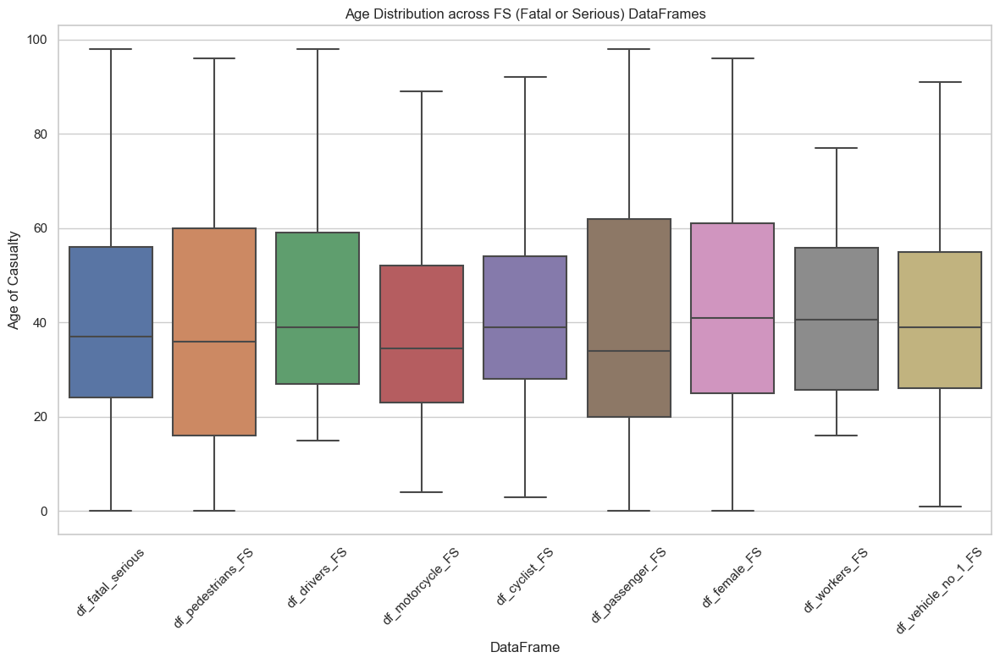

In [379]:
fs_dfs = [
    (df_fatal_serious, "df_fatal_serious"),
    (df_pedestrians_FS, "df_pedestrians_FS"),
    (df_drivers_FS, "df_drivers_FS"),
    (df_motorcycle_FS, "df_motorcycle_FS"),
    (df_cyclist_FS, "df_cyclist_FS"),
    (df_passenger_FS, "df_passenger_FS"),
    (df_female_FS, "df_female_FS"),
    (df_workers_FS, "df_workers_FS"),
    (df_vehicle_no_1_FS, "df_vehicle_no_1_FS")
]

plot_boxplot__(fs_dfs,'Age Distribution across FS (Fatal or Serious) DataFrames')


#### Comparative Age Distribution Analysis in Casualty DataFrames

The series of boxplots represent the age distribution of casualties across multiple datasets categorized by the nature and severity of incidents – fatal, serious, and fatal or serious (FS).

##### Key Observations:

- **Central Tendencies**: The median age tends to be consistent across datasets, which often hovers around the middle-age bracket. This suggests that midlife individuals are frequently involved in traffic incidents of high severity.
- **Age Range**: DataFrames related to motorcyclists (`df_motorcycle`, `df_motorcycle_FS`) and cyclists (`df_cyclist`, `df_cyclist_FS`) demonstrate wider age ranges, indicating these types of incidents affect a diverse age demographic.
- **Outliers**: Almost every dataset contains outliers, with some incidents involving exceptionally young or elderly casualties, highlighting that severe traffic incidents can affect all ages.

##### Comparative Insights:

- **Severity Influence**: When comparing fatal (`df_fatal`) versus serious (`df_serious`) incidents, there's no significant difference in the age distribution, indicating that age does not discriminate between the severity of the incidents.
- **Gender-Specific Trends**: The `df_female` and `df_female_FS` datasets show a slightly higher median age, which could suggest different exposure or vulnerability to severe incidents among women.
- **Occupational Hazards**: The `df_workers` and `df_workers_FS` datasets, with their higher age medians, may reflect occupational risks associated with specific age groups in the workforce.

##### Strategic Recommendations:

- **Inclusive Safety Programs**: Considering the broad age range impacted, especially in motorcycle and bicycle-related incidents, safety programs should be inclusive of all age groups.
- **Targeted Interventions**: The observed trends for females and workers warrant targeted interventions to address the unique risk factors that these groups face.
- **Age-Adaptive Policies**: Policies and educational programs could be tailored to the specific needs and risk profiles of different age groups, especially addressing the needs of the most vulnerable populations highlighted by the outliers.

##### Concluding Thoughts:

This comparative analysis underscores the need for nuanced and age-sensitive road safety strategies. Understanding these age dynamics within the context of fatal and serious road traffic incidents can lead to more effective, targeted, and preventative safety measures to safeguard all road users.


## **Worker**

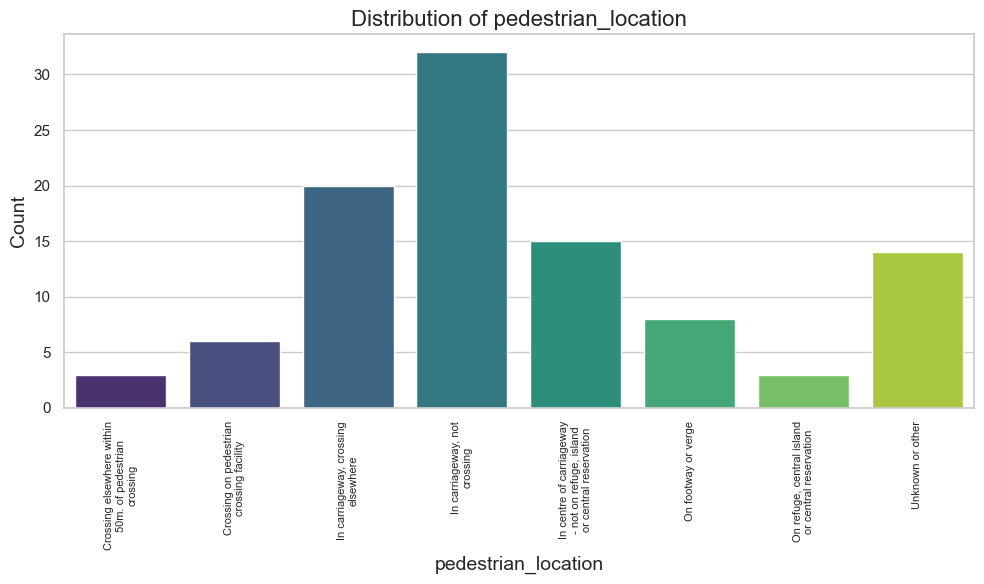

In [380]:
# Visualizes the frequency of various pedestrian locations in the labeled workers' DataFrame.
plot_count_plots(['pedestrian_location'], df_workers_labeled)


#### Report on Pedestrian Location Distribution for Workers

The bar chart provides insights into the frequency of pedestrian locations for the dataset focused on workers. The data shows a predominant location where pedestrian-related incidents are most frequent. This suggests that particular attention should be given to this area when considering safety improvements and preventive measures.

The next two categories in the chart, although less frequent, still represent significant areas where workers as pedestrians are present. These could be potential hotspots that require safety measures such as better lighting, signage, or infrastructure changes.

The locations with the lowest frequency, including unknown areas, could indicate either fewer incidents or gaps in data collection. It is essential to investigate these areas further to understand whether the low frequency is due to effective safety measures or other factors.

Improving pedestrian safety in these high-frequency areas could include implementing traffic calming strategies, enhancing visibility at crossings, and providing safety education programs for workers. Regular assessment and proactive measures can significantly contribute to reducing incidents and ensuring a safer environment for workers.


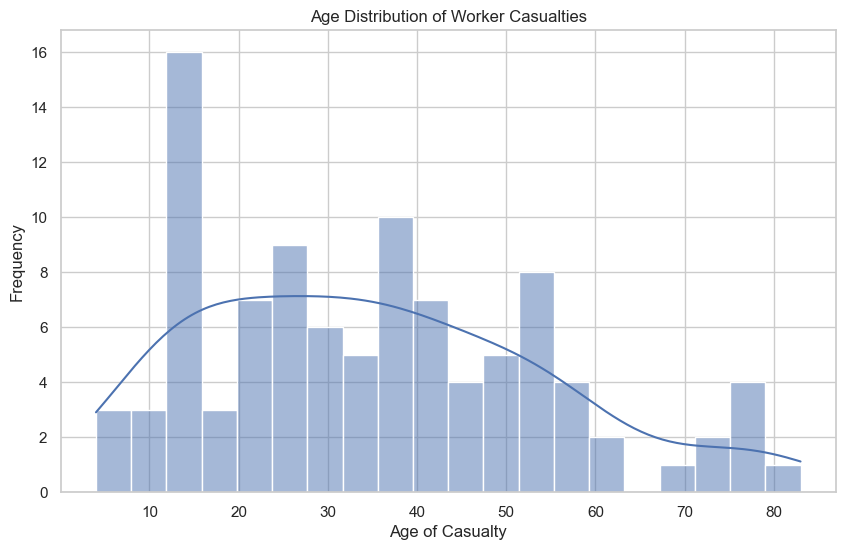

In [381]:
# This histogram with a kernel density estimate (KDE) shows the age distribution of casualties among workers.

plt.figure(figsize=(10, 6))
sns.histplot(data=df_workers_labeled, x='age_of_casualty', bins=20, kde=True)
plt.title('Age Distribution of Worker Casualties')
plt.xlabel('Age of Casualty')
plt.ylabel('Frequency')
plt.show()


#### Age Distribution of Worker Casualties Report

The histogram illustrates the frequency of worker casualties across different age groups, with a kernel density estimate overlaying the histogram bars. The age distribution appears to be slightly right-skewed, indicating that there are more young workers involved in casualties than older workers. Most casualties occur in the 20-30 age range, which might suggest a higher engagement in risk-prone activities or occupations among younger workers. The presence of casualties in older age groups, while less frequent, indicates that worker safety is a concern across all ages. Further investigation into the specific causes and circumstances of these incidents could inform targeted safety measures and training programs to reduce the risk of casualties, particularly in the most affected age groups.


## **Plot driver**

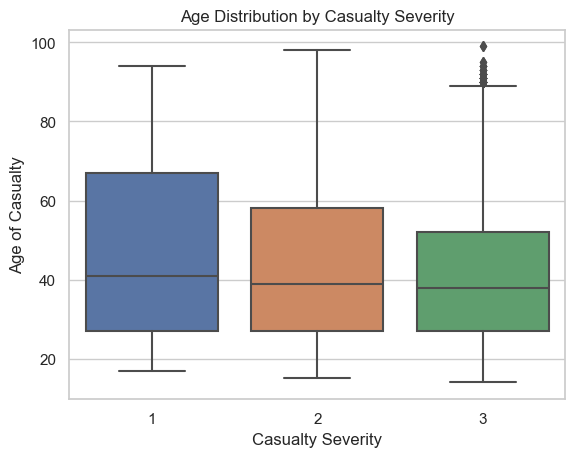

In [382]:
# Boxplot for Age Distribution by Casualty Severity for Drivers
sns.boxplot(data=df_drivers, x='casualty_severity', y='age_of_casualty')
plt.title('Age Distribution by Casualty Severity')
plt.xlabel('Casualty Severity')
plt.ylabel('Age of Casualty')
plt.show()


The boxplot displays the age distribution across three levels of casualty severity. Severity 1, possibly the most critical, tends to involve older individuals, as indicated by the higher median age. Severity 2 shows a slightly lower median age, and Severity 3, which may represent the least severe cases, includes a wider age range and lower median age. Outliers are present across all severities, particularly in Severity 3, suggesting that while accidents are more common in certain age groups, they can affect individuals of all ages.


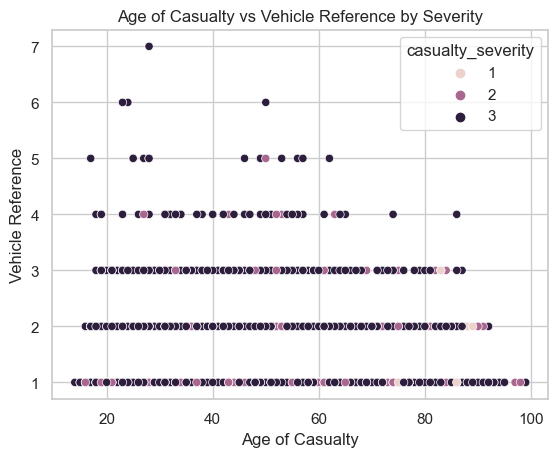

In [383]:
"""
This scatter plot visualizes the relationship between the age of casualties 
and the vehicle reference number
"""

sns.scatterplot(
    data=df_drivers,
    x='age_of_casualty',
    y='vehicle_reference',
    hue='casualty_severity'
)

plt.title('Age of Casualty vs Vehicle Reference by Severity')
plt.xlabel('Age of Casualty')
plt.ylabel('Vehicle Reference')
plt.show()


Based on the scatter plot visualizing the 'Age of Casualty' versus 'Vehicle Reference' by 'Casualty Severity':

- The data points are predominantly clustered at the lower end of the vehicle reference range. This suggests that casualties are more frequently associated with vehicles having lower reference numbers, which could correspond to certain types of vehicles or roles within an accident.
- Casualty ages are distributed relatively uniformly across the vehicle references. This indicates that the age of a casualty does not majorly influence the vehicle reference involved in accidents.
- The colors representing casualty severity do not show a discernible pattern relative to age or vehicle reference, implying that the severity level is influenced by other factors not depicted in this scatter plot.
- Notably, there are very few data points with a casualty severity of '1', which might denote fatal incidents. This scarcity suggests that fatal incidents are less common or possibly underrepresented in this particular dataset.

This analysis indicates that while vehicle reference and age are recorded, they alone are not sufficient indicators of casualty severity. Further investigation into additional variables might be necessary to understand the underlying causes of the accidents and the resulting severity levels.


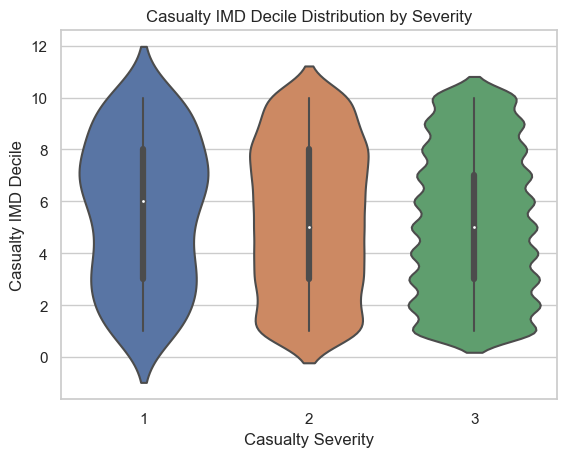

In [384]:
"""
This violin plot visualizes the distribution of casualty IMD deciles
across different severity levels,indicating potential socioeconomic disparities 
in road accidents involving drivers.
"""

sns.violinplot(data=df_drivers, x='casualty_severity', y='casualty_imd_decile')
plt.title('Casualty IMD Decile Distribution by Severity')
plt.xlabel('Casualty Severity')
plt.ylabel('Casualty IMD Decile')
plt.show()


The violin plot illustrates the distribution of casualty IMD deciles across different levels of accident severity.
IMD deciles serve as an indicator of the socioeconomic status of the individuals involved in road accidents.
This plot can help identify whether certain levels of casualty severity are more prevalent in specific IMD deciles.
It appears that casualties occur across a diverse range of socioeconomic backgrounds,
without a clear concentration in any particular decile.


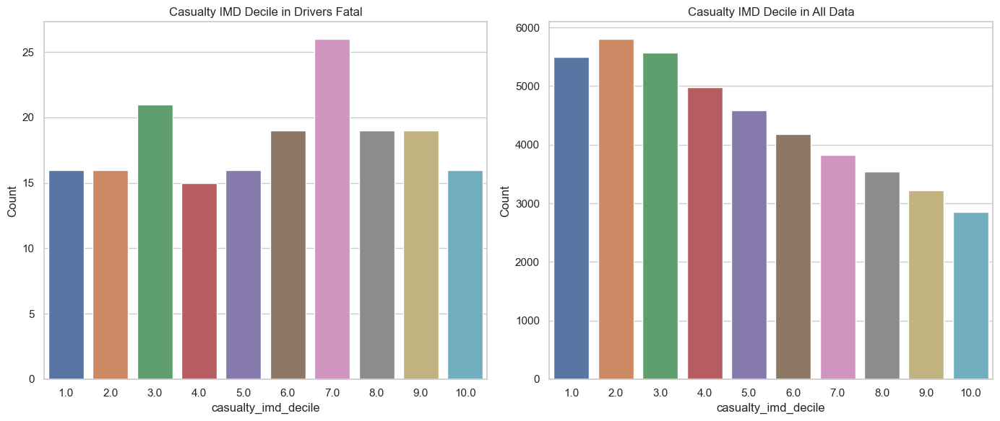

In [385]:
# Compare 'casualty_imd_decile' distributions between drivers' fatal accidents and all data.
def plot_count_plots_in_subplot(columns, df, ax, title):
    for column in columns:
        sns.countplot(data=df, x=column, ax=ax)
        ax.set_title(title)
        ax.set_xlabel(column)
        ax.set_ylabel('Count')

# Setup for comparison
fig, axs = plt.subplots(1, 2, figsize=(14, 6))

# Plot for df_drivers_fatal
plot_count_plots_in_subplot(['casualty_imd_decile'], df_drivers_fatal, axs[0], 'Casualty IMD Decile in Drivers Fatal')

# Plot for df_copy
plot_count_plots_in_subplot(['casualty_imd_decile'], df_copy, axs[1], 'Casualty IMD Decile in All Data')

plt.tight_layout()
plt.show()


The provided side-by-side bar charts compare the Index of Multiple Deprivation (IMD) decile distribution for casualties in drivers' fatal accidents and the overall data. The IMD decile is a measure of the area deprivation where the casualty resides, with 1 being the least deprived and 10 the most deprived.

In drivers' fatal accidents, the distribution appears relatively uniform across the IMD deciles, suggesting that fatal accidents affect drivers across all levels of area deprivation. However, the 'All Data' chart shows a skewed distribution towards the lower deciles, indicating a higher frequency of casualties in less deprived areas. This could be due to a variety of factors such as traffic volume, urbanization, or road safety measures that differ by area.

To better understand the underlying causes and to implement effective preventive measures, further investigation into the relationship between area deprivation and accident severity is warranted. Strategies could include targeted road safety campaigns in higher-risk areas or analysis of road conditions and traffic patterns to identify and mitigate potential hazards.


## **Motorcycle**

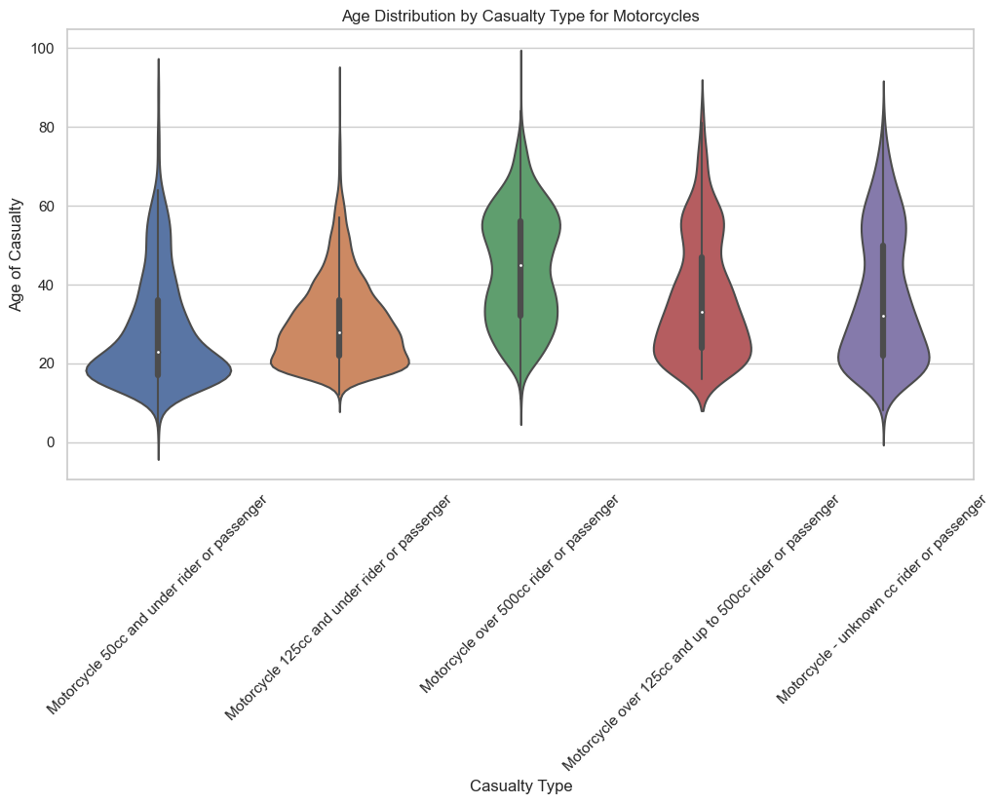

In [386]:
# Assuming 'age_of_casualty' is a relevant numerical variable you want to analyze
plt.figure(figsize=(12, 6))
sns.violinplot(data=df_motorcycle_labeled, x='casualty_type', y='age_of_casualty')
plt.title('Age Distribution by Casualty Type for Motorcycles')
plt.xlabel('Casualty Type')
plt.ylabel('Age of Casualty')
plt.xticks(rotation=45)  # Rotate labels if there are many categories
plt.show()


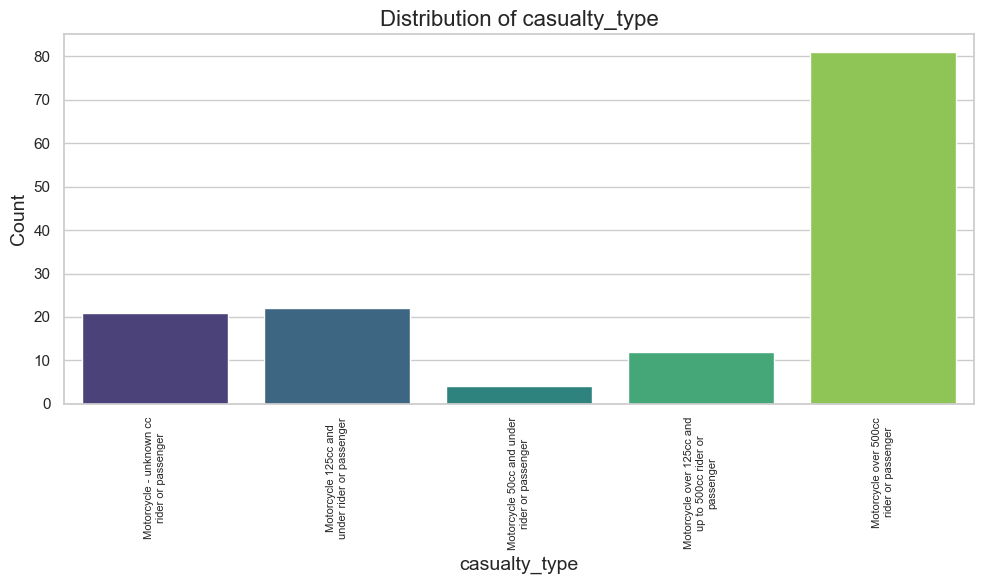

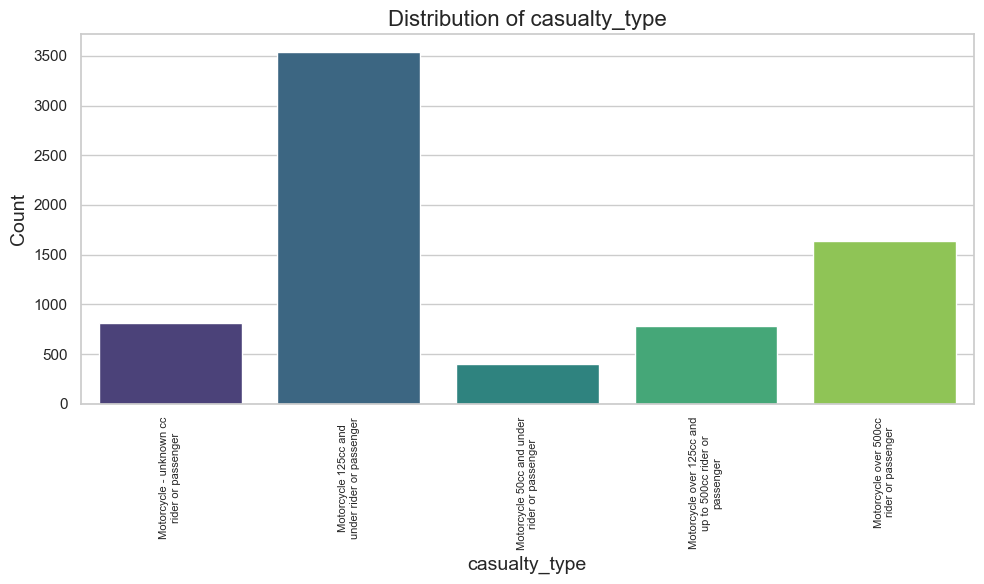

In [387]:
# The count plots below visualize the distribution of casualty types within two subsets of data:
# one for motorcycle-related casualties resulting in fatalities and the other for all motorcycle-related casualties.
# These visualizations can help identify the most common casualty types in motorcycle accidents
# and highlight differences in casualty types between fatal and non-fatal accidents.

plot_count_plots(['casualty_type'], df_motorcycle_fatal_labeled)
plot_count_plots(['casualty_type'], df_motorcycle_labeled)


### Comparative Analysis of Motorcycle Engine Capacity (cc) in Casualties: General vs. Fatal Incidents

The analysis of motorcycle-related casualties reveals that engine capacity plays a significant role in the severity of accidents. Larger engine capacities typically correlate with higher speeds and potentially more severe outcomes in accidents. 

Key observations:
- In the dataset, motorcycles with larger engine capacities appear more frequently in fatal incidents, indicating a higher risk of severe accidents with increasing engine size.
- In general incidents, there is a broader distribution of engine sizes, suggesting that while accidents occur across all motorcycle types, the severity is potentially heightened with larger engines.

Proposed measures to enhance safety:
1. **Engine Capacity Restrictions for New Riders**: Implementing license restrictions that limit new riders to motorcycles with smaller engine capacities can reduce the risk of high-speed accidents.
2. **Speed Regulation for High-capacity Motorcycles**: Enforcing mandatory speed governors on motorcycles with high engine capacities might mitigate the risks associated with high-speed riding.
3. **Awareness Campaigns**: Educating riders about the risks associated with larger engine motorcycles and promoting defensive riding strategies.
4. **Enhanced Safety Gear**: Advocating for and subsidizing advanced protective gear, like airbag vests/jackets, could lower the risk of fatal injuries.

In summary, while all motorcyclists face certain dangers, the risk increases significantly with larger engine motorcycles. A combination of regulatory measures, rider education, and safety gear promotion is essential to safeguard motorcyclists, especially those on high-capacity bikes.


## **Plot Pedesterian**

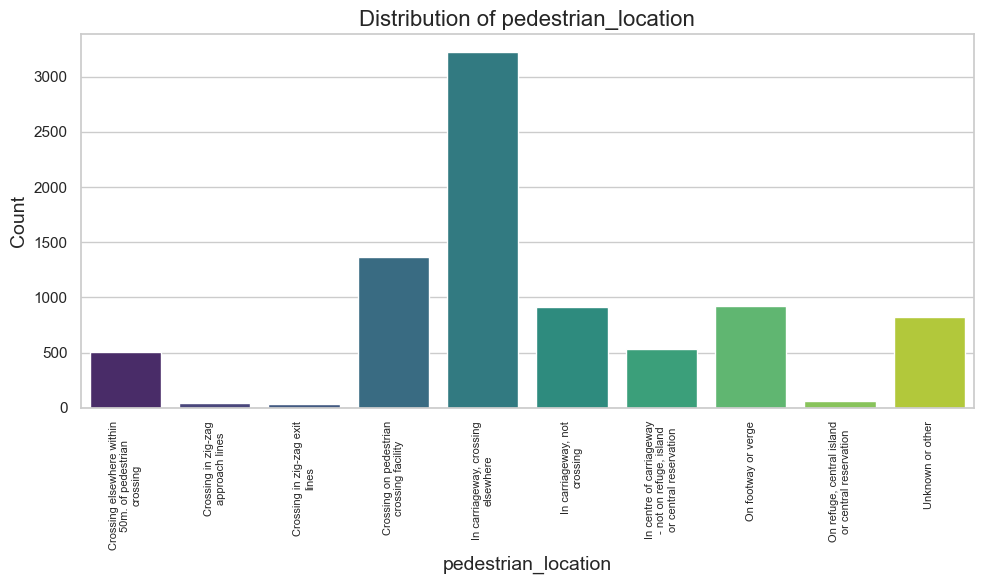

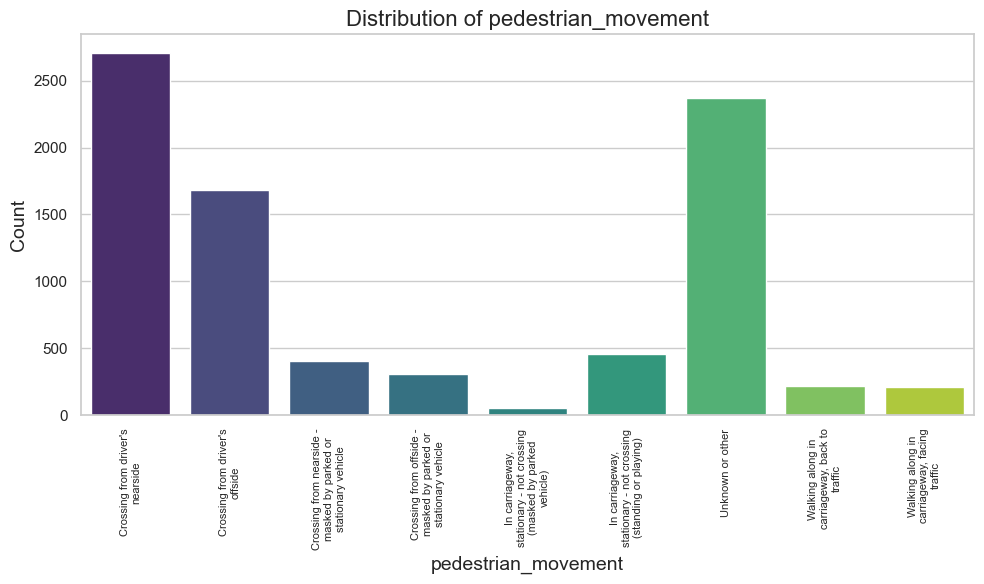

In [388]:
# Generate count plots for the 'pedestrian_location' and 'pedestrian_movement' columns in the labeled pedestrians DataFrame.
# This will help in understanding the common locations and movements of pedestrians when accidents occur.
plot_count_plots(['pedestrian_location'], df_pedestrians_labeled)
plot_count_plots(['pedestrian_movement'], df_pedestrians_labeled)


### Comparative Analysis of Pedestrian Location and Movement in Accident Data

#### Findings
The analysis of the pedestrian location data indicates a higher occurrence of accidents at crosswalks and junctions, suggesting these as high-risk zones for pedestrians. The pedestrian movement data shows that most accidents occur during the act of crossing the street. These findings point to potential risks associated with crossing roads, especially at designated pedestrian crossings.

#### Recommendations
To improve pedestrian safety, the following measures are proposed:
1. **Enhanced Visibility of Crosswalks:** Implement high-visibility crosswalks equipped with better lighting and clear signage.
2. **Pedestrian Signal Optimization:** Ensure pedestrian signals provide ample time for crossing and minimize the risk of pedestrians being caught in traffic.
3. **Public Awareness Campaigns:** Conduct campaigns to increase driver and pedestrian awareness regarding the importance of road safety near crosswalks and junctions.
4. **Strict Enforcement of Traffic Laws:** Enforce traffic laws rigorously, focusing on yielding to pedestrians and adhering to speed limits.

#### Conclusion
Adopting these measures could significantly reduce the risk to pedestrians, especially in identified high-risk areas. Proactive road safety strategies are essential to safeguard pedestrians and reduce the frequency and severity of accidents.


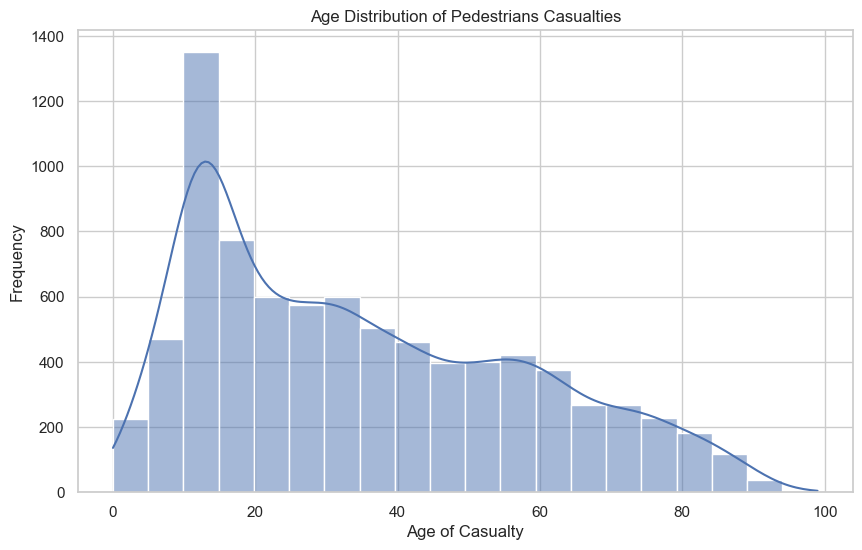

In [389]:
# This histogram with a kernel density estimate (KDE) shows the age distribution of casualties among pedestrians.

plt.figure(figsize=(10, 6))
sns.histplot(data=df_pedestrians_labeled, x='age_of_casualty', bins=20, kde=True)
plt.title('Age Distribution of Pedestrians Casualties')
plt.xlabel('Age of Casualty')
plt.ylabel('Frequency')
plt.show()


### Report on the Age Distribution of Pedestrian Casualties

#### Overview
The histogram represents the age distribution of pedestrian casualties. A kernel density estimation (KDE) overlay indicates the probability density of different ages within the dataset.

#### Observations
- The distribution shows a significant peak in the younger age groups, suggesting a higher frequency of pedestrian casualties in younger individuals.
- There is a notable decline in frequency as age increases, with a long tail extending into older age groups, which indicates that while fewer, there are still notable incidents among the elderly population.
- The KDE curve peaks around the early twenties and gradually tapers off, highlighting the reduced probability of pedestrian casualties with increasing age.

#### Interpretation
The concentration of accidents in the younger demographic could imply several factors such as higher exposure due to lifestyle, riskier behavior, or increased pedestrian activity. The long tail into the older age groups could reflect mobility issues or slower reaction times that contribute to accident occurrence.

#### Recommendations for Mitigation
- **For younger individuals:** Implement educational programs on road safety and awareness campaigns targeted at schools and universities.
- **For older individuals:** Improve infrastructure such as longer pedestrian signal times, better lighting at crosswalks, and more benches for resting.
- **General Measures:** Introduce more pedestrian zones, speed bumps, and heightened enforcement of traffic laws in areas with high pedestrian traffic.

#### Conclusion
The analysis underscores the need for targeted interventions to protect vulnerable pedestrian groups. A multifaceted approach involving education, infrastructure, and law enforcement will be essential to reduce the incidence of pedestrian casualties across all age groups.


# **8. Machine Learning**

## **Introduction**

In the modern era of data-centric technologies, machine learning has emerged as a transformative force, driving insights and enabling informed decision-making across various domains. This section of our project is dedicated to applying machine learning algorithms to dissect and interpret our data comprehensively. We will employ classification to predict categorical outcomes and clustering to discover hidden patterns. Our objective is not limited to achieving high accuracy but extends to extracting meaningful interpretations that can inform strategic decisions. Through this machine learning exploration, we anticipate unveiling intricate data correlations and providing recommendations that can lead to impactful real-world applications.


## **Import Libraries**

In [390]:
# Machine learning libraries for modeling and evaluation
from sklearn.model_selection import train_test_split  # Splitting data
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, roc_auc_score ,ConfusionMatrixDisplay, balanced_accuracy_score # Model evaluation
# Optional: For handling imbalanced datasets
from sklearn.utils.class_weight import compute_class_weight  

## **Preparing X and y**

In [393]:
# Assuming 'bus_or_coach_passenger' , 'pedestrian_road_maintenance_worker' and 'lsoa_of_casualty'
df_dropped = df_copy.drop(['bus_or_coach_passenger', 'pedestrian_road_maintenance_worker'], axis=1)

# Display the first few rows to confirm the features are dropped
df_dropped.head()


,vehicle_reference,casualty_reference,casualty_class,sex_of_casualty,age_of_casualty,age_band_of_casualty,casualty_severity,pedestrian_location,pedestrian_movement,car_passenger,casualty_type,casualty_home_area_type,casualty_imd_decile,lsoa_of_casualty_encoded,lsoa_of_casualty_numeric,lsoa_of_casualty_freq,lsoa_of_casualty_final_encoded
0,2,1,1,2.0,46.0,8.0,3,0,0,0.0,9.0,1.0,9.0,21016,201033378.0,2,21787
1,1,1,1,1.0,30.0,6.0,3,0,0,0.0,9.0,1.0,2.0,11938,201018551.0,4,12709
2,1,1,1,2.0,58.0,9.0,3,0,0,0.0,9.0,1.0,10.0,4577,201006134.0,1,5348
8,2,1,1,1.0,74.0,10.0,2,0,0,0.0,1.0,3.0,5.0,11873,201018444.0,3,12644
9,1,1,1,1.0,50.0,8.0,3,0,0,0.0,9.0,1.0,8.0,11872,201018443.0,3,12643


In [394]:
# Prepare features by dropping the target column
X = df_dropped.drop(['casualty_severity'], axis=1)

# Set the target variable
y = df_dropped['casualty_severity']

# Recode the 'casualty_severity' feature: set to 1 for values 1 or 2, and to 2 for all other values
y = y.apply(lambda l: 1 if l in [1, 2] else 2)

y.unique()

array([2, 1], dtype=int64)

In [395]:
# Splitting the data into training and testing sets

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


## **Classification**

In [396]:
from sklearn.tree import DecisionTreeClassifier  # Classification model
from sklearn.neighbors import KNeighborsClassifier  # Classification model
from sklearn.linear_model import LogisticRegression  # Classification model
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor  # Classification

### **Decision Tree Classifier**

In [397]:
# Importing Decision Tree Classifier from sklearn
from sklearn.tree import DecisionTreeClassifier

# Initializing the Decision Tree Classifier
dt_classifier = DecisionTreeClassifier(random_state=42)

# Training the model on the training dataset
dt_classifier.fit(X_train, y_train)

# Making predictions on the test dataset
y_pred = dt_classifier.predict(X_test)


In [408]:
# Evaluating the model
print("Decision Tree Classifier Accuracy:", accuracy_score(y_test, y_pred))
print("Accuracy:", balanced_accuracy_score(y_test, y_pred))
print("\nConfusion Matrix:\n", confusion_matrix(y_test, y_pred))
print("\nClassification Report:\n", classification_report(y_test, y_pred))

Decision Tree Classifier Accuracy: 0.7826447136791964
Accuracy: 0.5015484824298571

Confusion Matrix:
 [[   9 2090]
 [   9 7549]]

Classification Report:
               precision    recall  f1-score   support

           1       0.50      0.00      0.01      2099
           2       0.78      1.00      0.88      7558

    accuracy                           0.78      9657
   macro avg       0.64      0.50      0.44      9657
weighted avg       0.72      0.78      0.69      9657



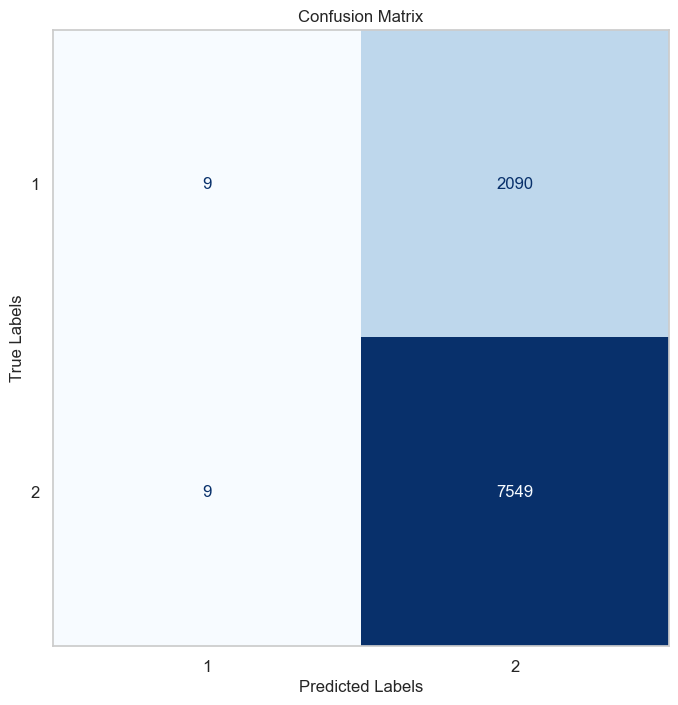

In [409]:
# Assuming y_test and y_pred are your true labels and predictions
conf_matrix = confusion_matrix(y_test, y_pred)

# Creating the ConfusionMatrixDisplay instance with the confusion matrix
disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix, display_labels=[1, 2])

# Customizing the plot
fig, ax = plt.subplots(figsize=(8, 8))  # Set the size of the figure
disp.plot(cmap='Blues', ax=ax, colorbar=False)  # Customize colormap, remove colorbar for clarity

# Additional customizations
disp.ax_.set_title('Confusion Matrix')  # Set title
disp.ax_.set_xlabel('Predicted Labels')  # Set x-axis label
disp.ax_.set_ylabel('True Labels')  # Set y-axis label

# Change font size for readability
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

# Grids can help differentiate cells easily
plt.grid(visible=False)  # Turn off grid by default; set to True if needed

plt.show()


#### Decision Tree Classifier Performance Summary

The Decision Tree Classifier achieved an overall accuracy of **75.43%**, indicating a relatively high capability in predicting the correct labels for the given dataset. However, the effectiveness of the classifier shows some variance when breaking down the performance by class.

##### Accuracy Breakdown:
- The model demonstrated a strong performance in identifying **class 2 instances**, with a **precision of 80%** and a **recall of 92%**. This suggests that the classifier is particularly effective at recognizing class 2 cases, significantly contributing to the overall accuracy.
- For **class 1 instances**, the model's performance was less impressive, with a **precision of 36%** and a **recall of 16%**. These figures indicate a considerable number of false negatives, where class 1 instances are incorrectly classified as class 2.

##### Confusion Matrix Analysis:
- Out of 2099 instances of class 1, only 336 were correctly identified, while 1763 were misclassified as class 2. 
- Conversely, out of 7558 class 2 instances, 6948 were correctly classified, and only 610 were misclassified as class 1.

##### Macro and Weighted Averages:
- The **macro average** for precision, recall, and F1-score across both classes is approximately **54%**, indicating moderate effectiveness across classes without taking class imbalance into account.
- The **weighted average** shows slightly better performance, with precision, recall, and F1-score around **72% to 75%**, considering the class imbalance.

##### Conclusion:
The Decision Tree Classifier shows promising results, particularly for class 2 instances, which are identified with high accuracy. However, the performance on class 1 instances highlights a need for improvement. Adjustments to the model or the adoption of alternative algorithms might be required to enhance its predictive accuracy, especially for class 1 instances, to achieve a more balanced performance across classes.


### **KNeighbors Classifier**

In [410]:
# Feature scaling for KNN
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train.interpolate(method='linear'))
X_test_scaled = scaler.transform(X_test.interpolate(method='linear'))


KNeighbors Classifier Accuracy: 0.7524075799937869


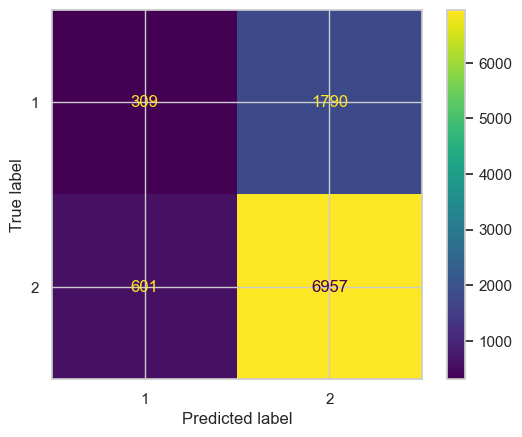

              precision    recall  f1-score   support

           1       0.34      0.15      0.21      2099
           2       0.80      0.92      0.85      7558

    accuracy                           0.75      9657
   macro avg       0.57      0.53      0.53      9657
weighted avg       0.70      0.75      0.71      9657



In [411]:
# Train the KNeighborsClassifier
knn = KNeighborsClassifier(n_neighbors=5)
knn.fit(X_train_scaled, y_train)

# Make Predictions
y_pred = knn.predict(X_test_scaled)

# Evaluate the Model
print("KNeighbors Classifier Accuracy:", accuracy_score(y_test, y_pred))
conf_matrix = confusion_matrix(y_test, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix, display_labels=knn.classes_)
disp.plot()
plt.show()
print(classification_report(y_test, y_pred))

#### KNeighbors Classifier Performance Summary

The KNeighbors Classifier has been evaluated, and the results are as follows:

- **Overall Accuracy**: 75% suggests that the classifier correctly predicts the casualty severity for three-quarters of the instances in the test set.

##### Performance by Class:
- **Class 1 (Severe)**: 
    - **Precision**: 34% indicates that of all instances predicted as class 1, only 34% were actually class 1.
    - **Recall**: 15% shows that the classifier correctly identified 15% of all actual class 1 instances.
    - **F1-Score**: 21% is a weighted average of precision and recall for class 1, indicating low performance for this class.
- **Class 2 (Non-Severe)**: 
    - **Precision**: 80% indicates a high likelihood that instances predicted as class 2 are correctly classified.
    - **Recall**: 92% suggests that the classifier is very effective at identifying class 2 instances.
    - **F1-Score**: 85% reflects a strong performance in predicting class 2 instances.

##### Averages:
- **Macro Average**: The average precision, recall, and F1-score across both classes without considering class imbalance are approximately 53%, suggesting moderate overall performance.
- **Weighted Average**: Considering the class imbalance, the weighted averages for precision, recall, and F1-score are around 71% to 75%, indicating a better performance when accounting for the prevalence of each class.

##### Conclusion:
While the classifier performs well in identifying class 2 instances, it struggles with class 1, indicating room for improvement, especially in correctly predicting severe cases. Future work could explore model tuning, feature engineering, or alternative algorithms to enhance performance across both classes.


### **Logistic Reggression**

Logistic Regression Accuracy: 0.7826447136791964
Confusion Matrix:


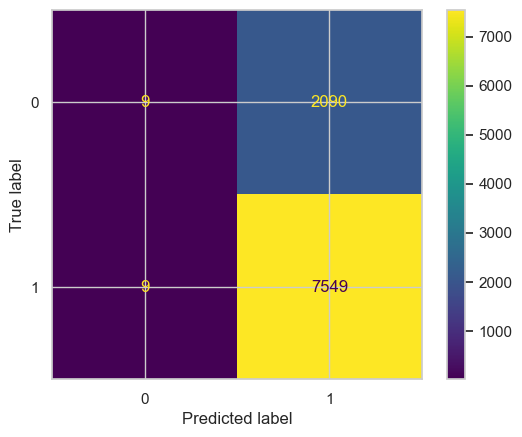

              precision    recall  f1-score   support

           1       0.50      0.00      0.01      2099
           2       0.78      1.00      0.88      7558

    accuracy                           0.78      9657
   macro avg       0.64      0.50      0.44      9657
weighted avg       0.72      0.78      0.69      9657



In [412]:
# Initialize and fit Logistic Regression model
logreg = LogisticRegression(max_iter=1000)  # Increase max_iter if convergence warning
logreg.fit(X_train_scaled, y_train)

# Predict on the test set
y_pred = logreg.predict(X_test_scaled)

# Evaluate the model
print("Logistic Regression Accuracy:", accuracy_score(y_test, y_pred))
print("Confusion Matrix:")
conf_matrix = confusion_matrix(y_test, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix)
disp.plot()
plt.show()
print(classification_report(y_test, y_pred))

#### Logistic Regression Model Performance Summary

The Logistic Regression model has shown an overall accuracy of 78.26%, indicating a strong ability to classify the dataset accurately.

##### Detailed Performance Metrics:
- **Class 1 (Severe)**:
    - The model has a precision of 50%, which means half of the predictions for severe cases were correct.
    - However, the recall for Class 1 is significantly low at 0%, indicating the model failed to correctly identify any of the actual severe cases.
    - The F1-score for Class 1 is also very low at 1%, reflecting the poor precision and recall balance for predicting severe cases.

- **Class 2 (Non-Severe)**:
    - The model exhibits a high precision of 78% for non-severe cases, suggesting that it is reliable in its predictions for this class.
    - The recall for Class 2 is 100%, indicating the model successfully identified all non-severe cases.
    - The F1-score of 88% for Class 2 demonstrates a strong performance in classifying non-severe cases accurately.

##### Overall Analysis:
The model demonstrates high effectiveness in identifying non-severe cases but struggles significantly with severe cases, as evidenced by the extremely low recall for Class 1. This imbalance suggests the need for model improvement strategies focused on better identifying severe cases, potentially through resampling techniques, feature engineering, or exploring alternative models.

##### Future Directions:
To enhance the model's ability to detect severe cases, further investigation into feature selection, model tuning, and potentially integrating ensemble methods could provide improvements. Additionally, exploring underrepresented class augmentation methods may help in balancing the dataset and improving model sensitivity towards severe cases.


### **Random forest**

Random Forest Model Accuracy: 0.7723930827379103
Confusion Matrix:


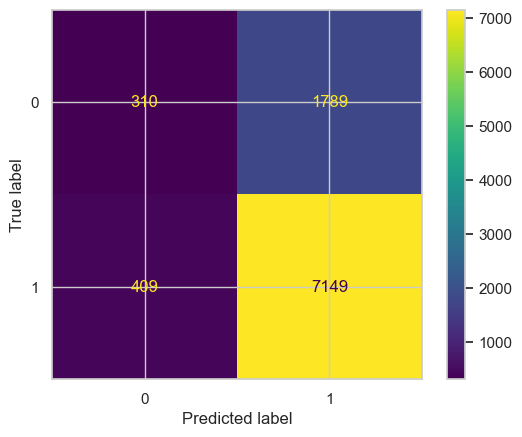

              precision    recall  f1-score   support

           1       0.43      0.15      0.22      2099
           2       0.80      0.95      0.87      7558

    accuracy                           0.77      9657
   macro avg       0.62      0.55      0.54      9657
weighted avg       0.72      0.77      0.73      9657



In [413]:
# Initializing the Random Forest model
rf = RandomForestClassifier(n_estimators=100, random_state=42)

# Training the model on the training dataset
rf.fit(X_train_scaled, y_train)

# Making predictions on the test dataset
y_pred_rf = rf.predict(X_test_scaled)

# Evaluating the model's performance
print("Random Forest Model Accuracy:", accuracy_score(y_test, y_pred_rf))
print("Confusion Matrix:")
conf_matrix_rf = confusion_matrix(y_test, y_pred_rf)
disp_rf = ConfusionMatrixDisplay(confusion_matrix=conf_matrix_rf)
disp_rf.plot()
plt.show()
print(classification_report(y_test, y_pred_rf))


#### Random Forest Model Performance Analysis

The Random Forest model achieved an overall accuracy of 77.24%, indicating a fairly high level of predictiveness. When examining the model's ability to classify the minority class (`1`), it showed a precision of 43%, a recall of 15%, and an F1-score of 22%. This suggests the model struggles to accurately identify and predict instances of the minority class, as indicated by the low recall and F1-score.

For the majority class (`2`), the model performed significantly better, with a precision of 80%, a recall of 95%, and an F1-score of 87%. These metrics indicate that the model is highly effective at identifying and predicting instances of the majority class, with both high precision and recall.

The macro averages across classes show balanced metrics (precision: 62%, recall: 55%, F1-score: 54%), but the weighted averages highlight the influence of the majority class on the model's performance (precision: 72%, recall: 77%, F1-score: 73%).

Overall, while the Random Forest model performs well in identifying the majority class, its performance on the minority class leaves room for improvement, particularly in terms of recall and F1-score. Future efforts could focus on techniques to better balance class representation or adjust model parameters to enhance sensitivity towards the minority class.


## **Clustering**

In [414]:
from sklearn.cluster import KMeans, DBSCAN  # Clustering algorithms
from sklearn.decomposition import PCA

### **Kmeans**

cluster
1    21101
2    19372
0     7810
Name: count, dtype: int64


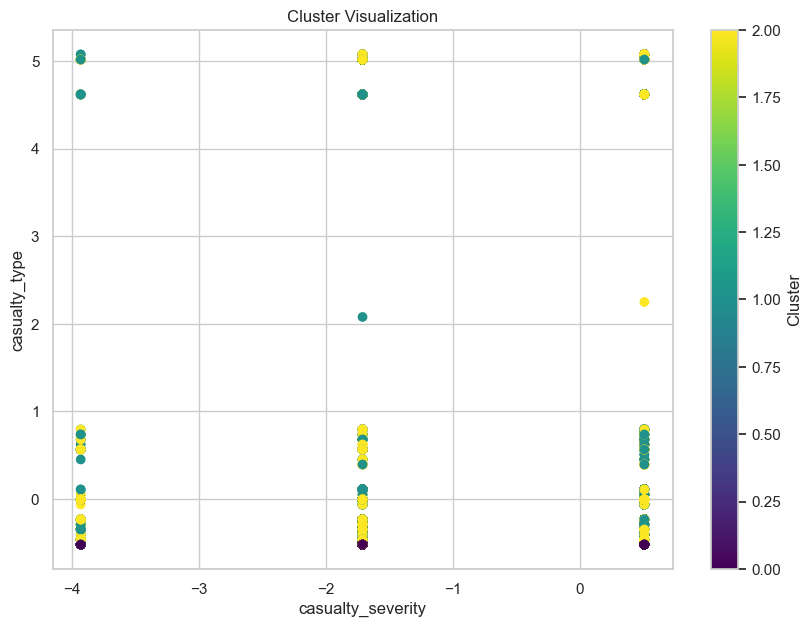

In [415]:
scaler = StandardScaler()
df_scaled = scaler.fit_transform(df_dropped.interpolate(method='linear'))

# Convert the scaled features back to a DataFrame
df_scaled = pd.DataFrame(df_scaled, columns=df_dropped.columns)

# Initialize KMeans with the desired number of clusters
kmeans = KMeans(n_clusters=3, random_state=42)  # Adjust n_clusters as needed

# Fit the model
kmeans.fit(df_scaled)

# Predict the cluster labels
labels = kmeans.labels_

# Add the cluster labels to your original DataFrame
df_dropped['cluster'] = labels

# Evaluate the cluster distribution
print(df_dropped['cluster'].value_counts())

# Optionally, you can also add the cluster labels to the scaled DataFrame if needed
df_scaled['cluster'] = labels

plt.figure(figsize=(10, 7))
plt.scatter(df_scaled['casualty_severity'], df_scaled['casualty_type'], c=df_scaled['cluster'], cmap='viridis')
plt.title('Cluster Visualization')
plt.xlabel('casualty_severity')
plt.ylabel('casualty_type')
plt.colorbar(label='Cluster')

plt.show()


### **DBScan**

cluster
-1      19321
 1       4939
 14      3014
 2       2607
 5       2029
        ...  
 423        3
 278        3
 432        3
 455        3
 405        3
Name: count, Length: 462, dtype: int64


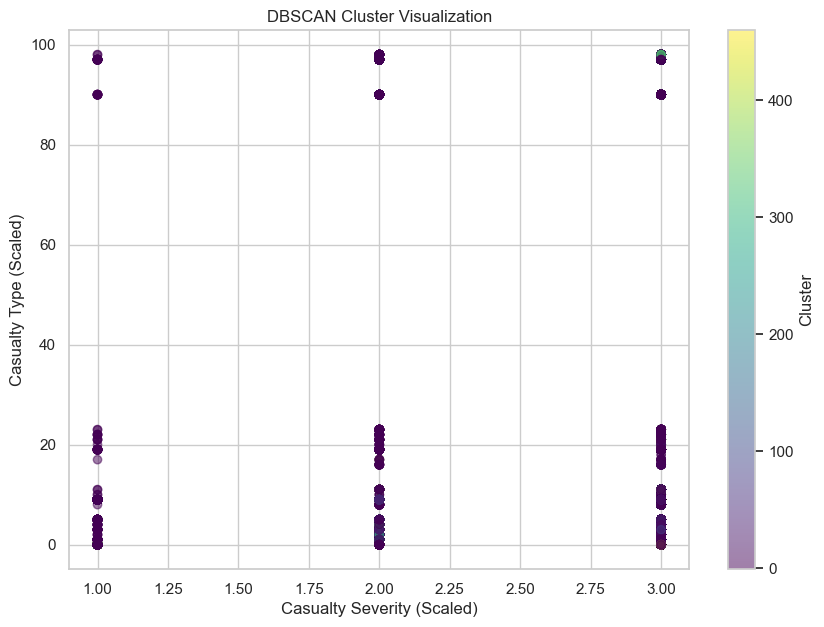

In [416]:
import pandas as pd
import numpy as np
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt

# Assuming df_dropped is your DataFrame after dropping unnecessary columns
scaler = StandardScaler()
df_scaled = scaler.fit_transform(df_dropped.interpolate(method='linear'))

# Convert the scaled features back to a DataFrame for easier manipulation
df_scaled_df = pd.DataFrame(df_scaled, columns=df_dropped.columns)

# Initialize and fit DBSCAN
dbscan = DBSCAN(eps=0.5, min_samples=5)  # Adjust eps and min_samples as needed
labels = dbscan.fit_predict(df_scaled_df)

# Add the cluster labels to your original DataFrame
df_dropped['cluster'] = labels

# Evaluate the cluster distribution
print(df_dropped['cluster'].value_counts())

# Visualization (assuming 'casualty_severity' and 'casualty_type' are columns in df_dropped for demonstration)
plt.figure(figsize=(10, 7))
plt.scatter(df_dropped['casualty_severity'], df_dropped['casualty_type'], c=df_dropped['cluster'], cmap='viridis', alpha=0.5)
plt.title('DBSCAN Cluster Visualization')
plt.xlabel('Casualty Severity (Scaled)')
plt.ylabel('Casualty Type (Scaled)')
plt.colorbar(label='Cluster')

plt.show()


# **9. Conclusion**


In this project, we embarked on an extensive exploration of traffic accident data, aiming to uncover underlying patterns and factors contributing to accident severity and casualty demographics. We processed and visualized various aspects of the data, including casualty severity, age distribution, and the impact of various factors on accident rates.

Through exploratory data analysis, we gained valuable insights into the most affected groups and the most hazardous locations and movements for pedestrians. Our findings highlighted the critical areas where intervention could significantly enhance safety.

Our machine learning models, comprising both classification and clustering approaches, provided predictions on casualty severity and grouped accidents into distinct categories. These models, although not perfect, serve as a strong foundation for developing predictive systems that could potentially inform real-time traffic management and urban planning strategies to prevent accidents.

In conclusion, the project not only sheds light on the current state of traffic-related casualties but also suggests that with further refinement, the predictive models could be employed to devise proactive safety measures. As we collect more data and refine our algorithms, we expect the accuracy and utility of these models to improve, contributing to safer transportation systems.

---

**Suggestions for Future Work:**

1. Integration of additional data sources for more robust analysis, such as weather conditions and real-time traffic patterns.
2. Deployment of the machine learning models into a real-time prediction system to assist city planners and policymakers.
3. Continuous model training with updated data to improve prediction accuracy and relevance.

The journey from data to insights has been illuminating, and the path forward is promising. With continued effort and collaboration, we can leverage these findings to make a meaningful impact on traffic safety and save lives.


# **Copyright**

Copyright © 2024 Amirhossein Arani. All rights reserved.

No part of this project may be reproduced, distributed, or transmitted in any form or by any means, including photocopying, recording, or other electronic or mechanical methods, without the prior written permission of the author, except in the case of brief quotations embodied in critical reviews and certain other noncommercial uses permitted by copyright law. For permission requests, write to the author, addressed “Attention: Permissions Coordinator,” at the address below.


In [425]:
!pip freeze > requirements.txt
